In [1]:
import numpy as np
np.__version__

'1.19.5'

In [2]:
import pandas as pd
pd.__version__

'1.1.5'

In [3]:
import matplotlib
matplotlib.__version__

'3.3.4'

In [4]:
import matplotlib.pyplot as plt

In [5]:
# Adjust plot size
#options(repr.plot.width=16, repr.plot.height=6)

# For some reason, if this is in the same cell as the import command, it doesn't work.
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [6]:
import scipy
scipy.__version__

'1.5.4'

In [7]:
from scipy import stats

In [8]:
import seaborn as sns

In [9]:
default_max_columns=pd.get_option('display.max_columns')

In [10]:
default_max_rows=pd.get_option('display.max_rows')

In [11]:
default_precision=pd.get_option('display.precision')

In [12]:
pd.set_option('display.precision', 2)

In [13]:
default_threshold=np.get_printoptions()['threshold']

In [14]:
np.set_printoptions(threshold=10000000)

# Read meta data

In [15]:
meta = pd.read_csv('20210428-EV/metadata.csv')

In [16]:
meta.head()

,Rand 2 Batch_order,D-plex Sequencing ID,Lexogen Sequencing ID,Diagnosis
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"


In [17]:
meta.rename(columns={"Rand 2 Batch_order": "subject"},inplace=True)
meta.rename(columns={"D-plex Sequencing ID": "dplex"},inplace=True)
meta.rename(columns={"Lexogen Sequencing ID": "lexogen"},inplace=True)
meta.rename(columns={"Diagnosis": "diag"},inplace=True)
#meta.set_index('subject',inplace=True)

In [18]:
meta

,subject,dplex,lexogen,diag
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,"
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,"
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,"
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,"


In [19]:
meta[['disease','idh','x1p19q']] = meta['diag'].str.split(",", 2, expand=True)
#meta.drop('diag',axis='columns',inplace=True)

In [20]:
meta

,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,",GBM,IDH-mutant,
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,


# Read raw matrix

In [21]:
df = pd.read_csv('20210428-EV/dplexonlyreport.csv',index_col=0,header=None)

In [22]:
df.shape

(364, 264)

In [23]:
df.head(12)

,1,2,3,4,5,6,7,8,9,10,...,255,256,257,258,259,260,261,262,263,264
0,,,,,,,,,,,,,,,,,,,,,
,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH005y,SFHH005y,SFHH005y,SFHH005y,SFHH005z,SFHH005z,SFHH005z,SFHH005z,SFHH005z,SFHH005z
---,---,---,---,---,---,---,---,---,---,---,...,---,---,---,---,---,---,---,---,---,---
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,7706323,7706323,7706323,7706323,7706323,7706323,10555114,10555114,10555114,10555114,...,6410347,6410347,6410347,6410347,8936774,8936774,8936774,8936774,8936774,8936774
Raw Read Length,201,201,201,201,201,201,201,201,201,201,...,201,201,201,201,201,201,201,201,201,201
Consolidated Read Count,389715,389715,389715,389715,389715,389715,670890,670890,670890,670890,...,449629,449629,449629,449629,491703,491703,491703,491703,491703,491703
Consolidated Read %,5.05,5.05,5.05,5.05,5.05,5.05,6.35,6.35,6.35,6.35,...,7.01,7.01,7.01,7.01,5.50,5.50,5.50,5.50,5.50,5.50


In [24]:
df.drop("---",inplace=True)

In [25]:
df.shape

(363, 264)

In [26]:
df.rename({'  ':'sample'},axis='rows',inplace=True)

In [27]:
df

,1,2,3,4,5,6,7,8,9,10,...,255,256,257,258,259,260,261,262,263,264
0,,,,,,,,,,,,,,,,,,,,,
sample,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH005y,SFHH005y,SFHH005y,SFHH005y,SFHH005z,SFHH005z,SFHH005z,SFHH005z,SFHH005z,SFHH005z
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,7706323,7706323,7706323,7706323,7706323,7706323,10555114,10555114,10555114,10555114,...,6410347,6410347,6410347,6410347,8936774,8936774,8936774,8936774,8936774,8936774
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
rnL1M2,49,263,278,64,61,59,108,530,578,153,...,369,128,123,117,90,376,393,120,118,110
rnL1MEc,74,205,210,97,96,96,162,348,351,211,...,347,195,183,170,115,267,276,166,161,160
rnL1MC1,43,224,230,58,59,59,136,402,419,186,...,366,147,134,125,110,296,297,111,109,108


In [28]:
df=df.T

In [29]:
df.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Consolidated Read Count,Consolidated Read %,Trimmed Read Count,Trimmed Ave Read Length,...,rnL1MA2,rnL1PA6,rnA-rich,rnL1MA7,rnHAL1,rnL1M2,rnL1MEc,rnL1MC1,rnL1MC4,rnL1MA9
1,SFHH005aa,3_5,D-plex,bbduk1,7706323,201,389715,5.05,99564,34.9853,...,101,68,3,29,62,49,74,43,57,52
2,SFHH005aa,3_5,D-plex,bbduk2,7706323,201,389715,5.05,285676,35.8717,...,228,276,399,254,238,263,205,224,178,206
3,SFHH005aa,3_5,D-plex,bbduk3,7706323,201,389715,5.05,286024,36.0344,...,232,274,406,272,243,278,210,230,193,208
4,SFHH005aa,3_5,D-plex,cutadapt1,7706323,201,389715,5.05,129407,52.4444,...,124,74,28,41,82,64,97,58,72,72
5,SFHH005aa,3_5,D-plex,cutadapt2,7706323,201,389715,5.05,130588,53.2184,...,125,74,25,42,82,61,96,59,71,71


In [30]:
df=df.merge(meta,left_on='Subject',right_on='subject')

In [31]:
df.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Consolidated Read Count,Consolidated Read %,Trimmed Read Count,Trimmed Ave Read Length,...,rnL1MC1,rnL1MC4,rnL1MA9,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,7706323,201,389715,5.05,99564,34.9853,...,43,57,52,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,7706323,201,389715,5.05,285676,35.8717,...,224,178,206,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,7706323,201,389715,5.05,286024,36.0344,...,230,193,208,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,7706323,201,389715,5.05,129407,52.4444,...,58,72,72,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,7706323,201,389715,5.05,130588,53.2184,...,59,71,71,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [32]:
df.columns

Index(['sample', 'Subject', 'Lab kit', 'Trimmer', 'Raw Read Count',
       'Raw Read Length', 'Consolidated Read Count', 'Consolidated Read %',
       'Trimmed Read Count', 'Trimmed Ave Read Length',
       ...
       'rnL1MC1', 'rnL1MC4', 'rnL1MA9', 'subject', 'dplex', 'lexogen', 'diag',
       'disease', 'idh', 'x1p19q'],
      dtype='object', length=370)


---
Subject
Lab kit
Trimmer
Raw Read Count
Raw Read Length
Trimmed Read Count
Trimmed Ave Read Length
STAR Aligned to Transcriptome
STAR Aligned to Transcriptome %
STAR Aligned to Genome
STAR Aligned to Genome %
STAR Unaligned
STAR Unaligned %
STAR Unmapped
STAR Unmapped %
Bowtie2 Aligned to hg38 (1)
Bowtie2 Aligned to hg38 (1) %
STAR Aligned to mirna
STAR Aligned to mirna %
Bowtie Aligned to mirna
Bowtie Aligned to mirna %
Bowtie2 Aligned to mirna
Bowtie2 Aligned to mirna %
Bowtie2 Aligned to phiX
Bowtie2 Aligned to phiX %
Bowtie2 Aligned to Salmonella
Bowtie2 Aligned to Salmonella %
Bowtie2 Aligned to Burkholderia
Bowtie2 Aligned to Burkholderia %
STAR Gene Counts
LOC102724859
RPH3A
PLCE1
ADGRG6
CCDC151
IGF2
P2RX6
PIGG
MAPT
MIR486-1
MIR486-2
RO60
RWDD2A
RARS2
LOC100335030
NAALADL2
HASPIN
NOL4L
GOLGA2P10
KCNN3
RNA45SN2
GREM2
RNA45SN3
RNA45SN4
RNA45SN1
RNA45SN5
PACS2
MECP2
CASP1P2
FGD2
KIF18B
MIRLET7BHG
FRMD4A
ZMYM2
GRB10
RNA28SN2
RNA28SN3
RNA28SN1
RNA28SN5
RNA28SN4
AHDC1
INS-IGF2
MICAL2
NOTCH2NLB
TTN
TTC21A
TUBGCP4
WSB1
EDEM3
NACC2
STAR miRNA Counts
hsa-mir-4329-hairpin
hsa-mir-5588-hairpin
hsa-mir-92b-hairpin
hsa-mir-4271-hairpin
hsa-mir-548u-hairpin
hsa-mir-1260a-hairpin
hsa-mir-944-hairpin
hsa-mir-10226-hairpin
hsa-mir-4538-hairpin
hsa-mir-4538-mature
hsa-mir-552-hairpin
hsa-mir-486-1-hairpin
hsa-mir-486-2-hairpin
hsa-mir-3908-hairpin
hsa-mir-3168-hairpin
hsa-mir-3168-mature
hsa-mir-4314-hairpin
hsa-mir-3613-hairpin
hsa-mir-6735-hairpin
hsa-mir-8086-hairpin
hsa-mir-137-hairpin
hsa-mir-552-3p-mature
hsa-mir-4668-hairpin
hsa-mir-4668-5p-mature
hsa-mir-484-hairpin
hsa-mir-486-5p-mature
hsa-mir-216b-hairpin
hsa-mir-3658-hairpin
hsa-mir-4283-2-hairpin
hsa-mir-4283-1-hairpin
hsa-mir-1273c-hairpin
hsa-mir-567-hairpin
hsa-mir-3183-hairpin
hsa-mir-1303-hairpin
hsa-mir-662-hairpin
hsa-mir-184-hairpin
hsa-mir-7110-hairpin
hsa-mir-8052-hairpin
hsa-mir-3613-5p-mature
hsa-mir-8052-mature
hsa-mir-509-1-hairpin
hsa-mir-892b-hairpin
hsa-mir-509-2-hairpin
hsa-mir-509-3-hairpin
hsa-mir-6787-hairpin
hsa-mir-6787-5p-mature
hsa-mir-1281-hairpin
hsa-mir-6887-hairpin
hsa-mir-6887-5p-mature
hsa-mir-3613-3p-mature

In [33]:
mrnas=df.columns[41:91]
mrnas

Index(['NR_027103.1', 'NM_001271606.2', 'NM_006317.5', 'NM_000612.6',
       'NM_001291862.3', 'NM_001007139.6', 'NM_001291861.3', 'NR_003512.4',
       'NM_001127598.3', 'NM_001018138.1', 'NR_027072.2', 'XM_017015817.1',
       'NM_001328124.1', 'NM_001145873.1', 'NM_002621.2', 'XR_942832.2',
       'NM_005880.4', 'NM_018362.4', 'NR_003680.1', 'NM_031445.2',
       'NR_002728.3', 'NM_001165920.1', 'NR_134241.1', 'NR_027262.1',
       'NM_001987.5', 'XM_011520611.2', 'XM_011520608.2', 'XM_011520607.2',
       'XM_011520609.2', 'XM_011520612.2', 'XM_017018990.1', 'XM_017018991.1',
       'NM_014271.4', 'NM_005885.4', 'NM_001270660.2', 'NM_001270661.2',
       'XM_011513932.2', 'NM_006352.4', 'NR_134282.1', 'XM_017029241.1',
       'XM_017029240.1', 'NR_135253.1', 'NR_033201.2', 'NR_026594.1',
       'NR_033204.2', 'NR_039980.1', 'NM_001145266.1', 'NM_020142.3',
       'NR_146117.1', 'NM_001371928.1'],
      dtype='object')

In [34]:
genes=df.columns[92:142]
genes

Index(['IGF2', 'P2RX6', 'NAALADL2', 'INS-IGF2', 'FGD2', 'PACS2', 'MECP2',
       'AHDC1', 'GRB10', 'RO60', 'CASP1P2', 'WSB1', 'FOXO3', 'RNA45SN2',
       'RNA45SN4', 'RNA45SN3', 'RNA45SN1', 'RNA45SN5', 'FRMD4A', 'TTN',
       'EDEM3', 'ESRRB', 'ZNF3', 'SORBS1', 'L1CAM', 'ADGRB2', 'TNS1', 'FBXO32',
       'RNA28SN2', 'SLC22A1', 'RNA28SN3', 'RNA28SN4', 'RNA28SN1', 'RNA28SN5',
       'GLG1', 'POU6F1', 'PHKA2', 'PPP6R3', 'ILDR2', 'SIK3', 'DNAJB14',
       'KCNMA1', 'POLR3E', 'NRXN3', 'MICAL2', 'SLC1A2', 'MARCHF6', 'HDGFL2',
       'TTC21A', 'NUDT16P1'],
      dtype='object')

In [35]:
mirnas=df.columns[143:193]
mirnas

Index(['hsa-mir-5588-hairpin', 'hsa-mir-4329-hairpin', 'hsa-mir-3908-hairpin',
       'hsa-mir-92b-hairpin', 'hsa-mir-548u-hairpin', 'hsa-mir-4271-hairpin',
       'hsa-mir-3613-hairpin', 'hsa-mir-8086-hairpin', 'hsa-mir-4668-hairpin',
       'hsa-mir-4668-5p-mature', 'hsa-mir-3613-5p-mature',
       'hsa-mir-1273c-hairpin', 'hsa-mir-3658-hairpin', 'hsa-mir-567-hairpin',
       'hsa-mir-1303-hairpin', 'hsa-mir-9983-hairpin', 'hsa-mir-7110-hairpin',
       'hsa-mir-1281-hairpin', 'hsa-mir-3613-3p-mature',
       'hsa-mir-320c-1-hairpin', 'hsa-mir-6887-hairpin',
       'hsa-mir-6887-5p-mature', 'hsa-mir-548ai-hairpin',
       'hsa-mir-525-hairpin', 'hsa-mir-1225-hairpin', 'hsa-mir-4472-2-hairpin',
       'hsa-mir-196a-2-hairpin', 'hsa-mir-6773-hairpin',
       'hsa-mir-1289-2-hairpin', 'hsa-mir-644a-hairpin', 'hsa-mir-328-hairpin',
       'hsa-mir-638-hairpin', 'hsa-mir-193b-hairpin', 'hsa-mir-578-hairpin',
       'hsa-mir-4516-hairpin', 'hsa-mir-6886-hairpin', 'hsa-mir-1262-hairpin',
  

In [36]:
diamond_families=df.columns[194:244]
diamond_families

Index(['Burkholderiaceae', 'no family', 'Enterobacteriaceae', 'Hominidae',
       'Cercopithecidae', 'Streptococcaceae', 'Chlamydiaceae',
       'Pseudomonadaceae', 'Alcaligenaceae', 'Fabaceae', 'Bacillaceae',
       'Peptostreptococcaceae', 'Lactobacillaceae', 'Vibrionaceae',
       'Neisseriaceae', 'Staphylococcaceae', 'Rhodobacteraceae',
       'Moraxellaceae', 'Enterococcaceae', 'Comamonadaceae',
       'Xanthomonadaceae', 'Microviridae', 'Mycobacteriaceae',
       'Paenibacillaceae', 'Onchocercidae', 'Hylobatidae', 'Legionellaceae',
       'Helicobacteraceae', 'Microbacteriaceae', 'Sutterellaceae',
       'Spirochaetaceae', 'Saccharomycetaceae', 'Lachnospiraceae',
       'Clostridiaceae', 'Listeriaceae', 'Morganellaceae', 'Moritellaceae',
       'Phyllobacteriaceae', 'Flavobacteriaceae', 'Oscillospiraceae',
       'Sphingomonadaceae', 'Trichinellidae', 'Coriobacteriaceae',
       'Rhodospirillaceae', 'Yersiniaceae', 'Erwiniaceae', 'Rhodocyclaceae',
       'Chromobacteriaceae', 'Ce

In [37]:
rmsk_families=df.columns[245:295]
rmsk_families

Index(['rfAlu', 'rfL1', 'rfSimple_repeat', 'rfL2', 'rfERVL-MaLR', 'rfERV1',
       'rfMIR', 'rfERVL', 'rfhAT-Charlie', 'rfTcMar-Tigger', 'rfcentr',
       'rfLow_complexity', 'rfrRNA', 'rfSatellite', 'rfCR1', 'rfhAT-Tip100',
       'rfERVK', 'rfSVA', 'rfRTE-X', 'rfGypsy', 'rfTcMar-Mariner',
       'rfhAT-Blackjack', 'rfTcMar-Tc2', 'rfhAT', 'rfhAT?', 'rfGypsy?',
       'rftRNA', 'rfRTE-BovB', 'rfscRNA', 'rfMULE-MuDR', 'rfsnRNA', 'rfsrpRNA',
       'rftRNA-RTE', 'rfUnknown', 'rfPiggyBac', 'rfLTR', 'rfacro', 'rfERVL?',
       'rfhAT-Ac', 'rfHelitron', 'rftelo', 'rfhAT-Tip100?', 'rfDNA',
       'rf5S-Deu-L2', 'rfERV1?', 'rfRNA', 'rfDong-R4', 'rfPenelope',
       'rfTcMar?', 'rftRNA-Deu'],
      dtype='object')

In [38]:
rmsk_classes=df.columns[296:312]
rmsk_classes

Index(['rcSINE', 'rcLINE', 'rcSimple_repeat', 'rcLTR', 'rcDNA', 'rcSatellite',
       'rcLow_complexity', 'rcrRNA', 'rcRetroposon', 'rcscRNA', 'rctRNA',
       'rcsnRNA', 'rcsrpRNA', 'rcUnknown', 'rcRC', 'rcRNA'],
      dtype='object')

In [39]:
rmsk_names=df.columns[313:363]
rmsk_names

Index(['rnAluY', 'rn(T)n', 'rnAluSz', 'rnAluJb', 'rnAluSx1', 'rnAluSx',
       'rnL1P4', 'rnAluJr', 'rnAluJo', 'rnAluSg', 'rnAluSq2', 'rnL2a',
       'rn(A)n', 'rnAluSp', 'rnAluSx3', 'rnL1PA7', 'rnAluSz6', 'rnAluSc',
       'rnL2c', 'rnL1ME1', 'rnAluSc8', 'rnALR/Alpha', 'rnMIRb', 'rnAluJr4',
       'rnL1PB1', 'rnMIR', 'rnL1PA8', 'rnL2', 'rnL1M4', 'rnL1M5', 'rnL1PA3',
       'rnL1PA4', 'rnAluSg7', 'rnL1PA5', 'rnL1PA16', 'rnL1M1', 'rnL2b',
       'rnAluSq', 'rnL1MA3', 'rnL1MB7', 'rnL1MA2', 'rnL1PA6', 'rnA-rich',
       'rnL1MA7', 'rnHAL1', 'rnL1M2', 'rnL1MEc', 'rnL1MC1', 'rnL1MC4',
       'rnL1MA9'],
      dtype='object')

In [40]:
pd.set_option('display.max_rows',None)

In [41]:
df[['subject','sample','Raw Read Count']].drop_duplicates().sort_values(by='Raw Read Count')

,subject,sample,Raw Read Count
72,4_6,SFHH005am,10062593
30,3_10,SFHH005af,10094714
222,2_9,SFHH005t,10263895
42,4_1,SFHH005ah,10278745
180,2_2,SFHH005m,10481781
6,3_6,SFHH005ab,10555114
54,4_3,SFHH005aj,10888095
12,3_7,SFHH005ac,10952810
96,4_10,SFHH005aq,11443471
24,3_9,SFHH005ae,11581885


In [42]:
df[['subject','sample','Trimmer','Trimmed Read Count']].drop_duplicates().sort_values(by='Trimmed Read Count')

,subject,sample,Trimmer,Trimmed Read Count
195,2_4,SFHH005o,cutadapt1,104069
196,2_4,SFHH005o,cutadapt2,105367
197,2_4,SFHH005o,cutadapt3,105888
240,3_1,SFHH005w,bbduk1,109312
198,2_5,SFHH005p,bbduk1,109819
219,2_8,SFHH005s,cutadapt1,112081
249,3_2,SFHH005x,cutadapt1,112894
220,2_8,SFHH005s,cutadapt2,112992
221,2_8,SFHH005s,cutadapt3,113401
250,3_2,SFHH005x,cutadapt2,113909


In [43]:
pd.set_option('display.max_rows',default_max_rows)

# Prepping to ttest all items against all other items

In [44]:
df['diag'].unique()

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'V01 control (S1),,', 'GBM, IDH1R132H WT,', 'blank 2 (C1),,',
       'blank1 (C1),,'], dtype=object)

In [45]:
u=df['diag'].unique()
diags=u[0:3]
diags=np.append(diags,u[4])

In [46]:
diags

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'GBM, IDH1R132H WT,'], dtype=object)

In [47]:
type(diags)

numpy.ndarray

In [48]:
diags=diags.tolist()

In [49]:
type(diags)

list

In [50]:
d=diags.copy()

In [51]:
diags

['GBM, IDH-mutant,',
 'Diffuse Astrocytoma, IDH-mutant,',
 'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
 'GBM, IDH1R132H WT,']

In [52]:
d.remove(d[2])

In [53]:
d

['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,', 'GBM, IDH1R132H WT,']

In [54]:
import warnings
warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning) 

# Normalize by Raw Read Count

In [55]:
dfn=df.copy()

In [56]:
dfn.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Consolidated Read Count,Consolidated Read %,Trimmed Read Count,Trimmed Ave Read Length,...,rnL1MC1,rnL1MC4,rnL1MA9,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,7706323,201,389715,5.05,99564,34.9853,...,43,57,52,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,7706323,201,389715,5.05,285676,35.8717,...,224,178,206,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,7706323,201,389715,5.05,286024,36.0344,...,230,193,208,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,7706323,201,389715,5.05,129407,52.4444,...,58,72,72,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,7706323,201,389715,5.05,130588,53.2184,...,59,71,71,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [57]:
dfn[mirnas].head()

,hsa-mir-5588-hairpin,hsa-mir-4329-hairpin,hsa-mir-3908-hairpin,hsa-mir-92b-hairpin,hsa-mir-548u-hairpin,hsa-mir-4271-hairpin,hsa-mir-3613-hairpin,hsa-mir-8086-hairpin,hsa-mir-4668-hairpin,hsa-mir-4668-5p-mature,...,hsa-mir-378d-1-hairpin,hsa-mir-3128-hairpin,hsa-mir-328-5p-mature,hsa-mir-3162-hairpin,hsa-mir-3938-hairpin,hsa-mir-4516-mature,hsa-mir-548ac-hairpin,hsa-mir-10398-hairpin,hsa-mir-10398-5p-mature,hsa-mir-1237-hairpin
0,NaN,6,73,13,2,36,6,301,NaN,NaN,...,138,NaN,3,31,13,55,1,410,409,137
1,38162,18253,12955,5663,5915,5185,4264,2281,2582,2468,...,137,380,108,37,249,NaN,244,NaN,NaN,23
2,38455,17624,12938,5433,5718,4953,4273,2224,2473,2363,...,135,365,108,37,249,NaN,242,NaN,NaN,23
3,17,12,87,32,18,107,13,305,13,9,...,139,6,35,176,8,165,2,157,156,168
4,798,13,318,32,18,108,24,312,15,9,...,139,6,35,176,8,165,2,157,156,168


In [58]:
dfn[mirnas]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[mirnas])/pd.to_numeric(row['Raw Read Count']), axis=1 )
dfn[genes]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[genes])/pd.to_numeric(row['Raw Read Count']), axis=1 )
dfn[mrnas]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[mrnas])/pd.to_numeric(row['Raw Read Count']), axis=1 )
dfn[diamond_families]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[diamond_families])/pd.to_numeric(row['Raw Read Count']), axis=1 )
dfn[rmsk_families]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmsk_families])/pd.to_numeric(row['Raw Read Count']), axis=1 )
dfn[rmsk_classes]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmsk_classes])/pd.to_numeric(row['Raw Read Count']), axis=1 )
dfn[rmsk_names]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmsk_names])/pd.to_numeric(row['Raw Read Count']), axis=1 )


In [59]:
dfn[mirnas].head()

,hsa-mir-5588-hairpin,hsa-mir-4329-hairpin,hsa-mir-3908-hairpin,hsa-mir-92b-hairpin,hsa-mir-548u-hairpin,hsa-mir-4271-hairpin,hsa-mir-3613-hairpin,hsa-mir-8086-hairpin,hsa-mir-4668-hairpin,hsa-mir-4668-5p-mature,...,hsa-mir-378d-1-hairpin,hsa-mir-3128-hairpin,hsa-mir-328-5p-mature,hsa-mir-3162-hairpin,hsa-mir-3938-hairpin,hsa-mir-4516-mature,hsa-mir-548ac-hairpin,hsa-mir-10398-hairpin,hsa-mir-10398-5p-mature,hsa-mir-1237-hairpin
0,NaN,7.79e+02,9.47e+03,1686.93,259.53,4671.49,778.58,39058.84,NaN,NaN,...,17907.37,NaN,389.29,4022.67,1686.93,7137.00,129.76,53203.06,53073.30,17777.61
1,4.95e+06,2.37e+06,1.68e+06,734851.11,767551.53,672824.12,553311.87,295990.71,335049.54,320256.50,...,17777.61,49310.16,14014.47,4801.25,32311.13,NaN,31662.31,NaN,NaN,2984.56
2,4.99e+06,2.29e+06,1.68e+06,705005.49,741988.11,642718.97,554479.74,288594.18,320905.31,306631.32,...,17518.08,47363.70,14014.47,4801.25,32311.13,NaN,31402.78,NaN,NaN,2984.56
3,2.21e+03,1.56e+03,1.13e+04,4152.43,2335.74,13884.70,1686.93,39577.89,1686.93,1167.87,...,18037.14,778.58,4541.73,22838.39,1038.11,21410.99,259.53,20372.88,20243.12,21800.28
4,1.04e+05,1.69e+03,4.13e+04,4152.43,2335.74,14014.47,3114.33,40486.23,1946.45,1167.87,...,18037.14,778.58,4541.73,22838.39,1038.11,21410.99,259.53,20372.88,20243.12,21800.28


hsa-mir-5588-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.3527455888218887
	p = 0.03021090170613592
hsa-mir-5588-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.3527455888218887
	p = 0.03021090170613592


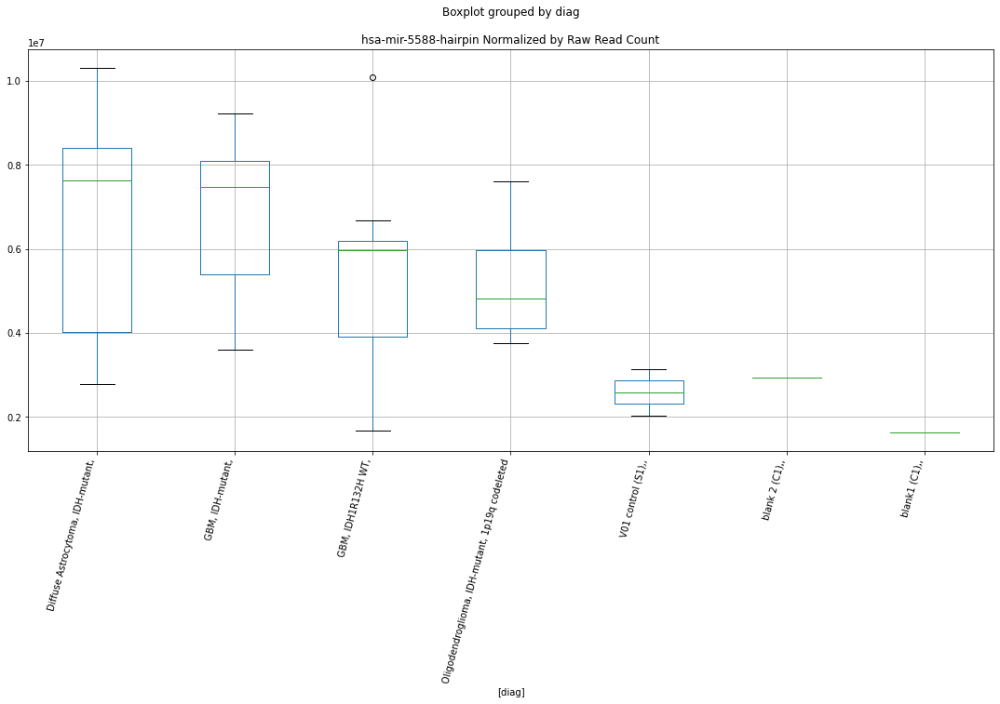

hsa-mir-5588-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.314740661213706
	p = 0.03263866355656056
hsa-mir-5588-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.314740661213706
	p = 0.03263866355656056


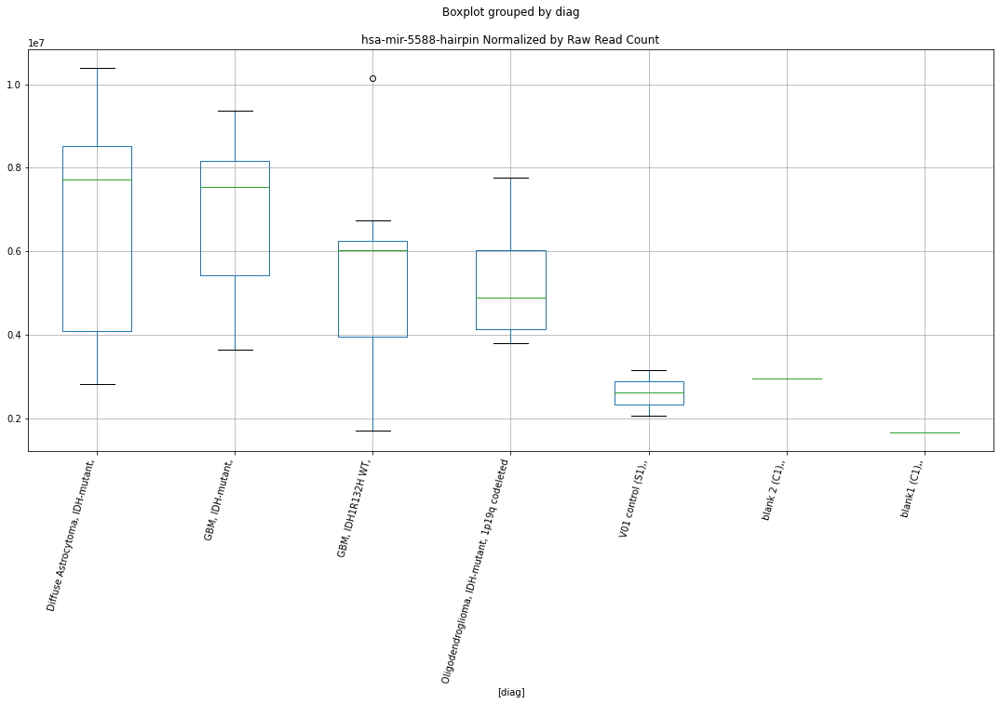

hsa-mir-5588-hairpin D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0529344124068194
	p = 0.05490705127789016
hsa-mir-5588-hairpin D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0529344124068194
	p = 0.05490705127789016


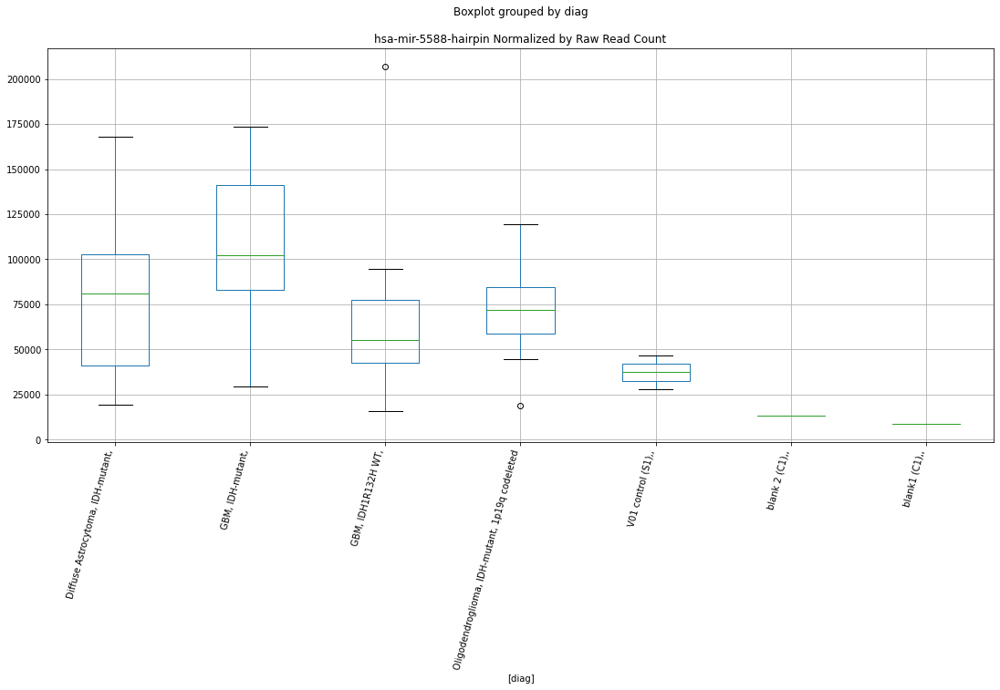

hsa-mir-5588-hairpin D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9917197968666662
	p = 0.06179675223996934
hsa-mir-5588-hairpin D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7408630162820005
	p = 0.09877340337011133
hsa-mir-5588-hairpin D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9917197968666662
	p = 0.06179675223996934
hsa-mir-5588-hairpin D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7408630162820005
	p = 0.09877340337011133


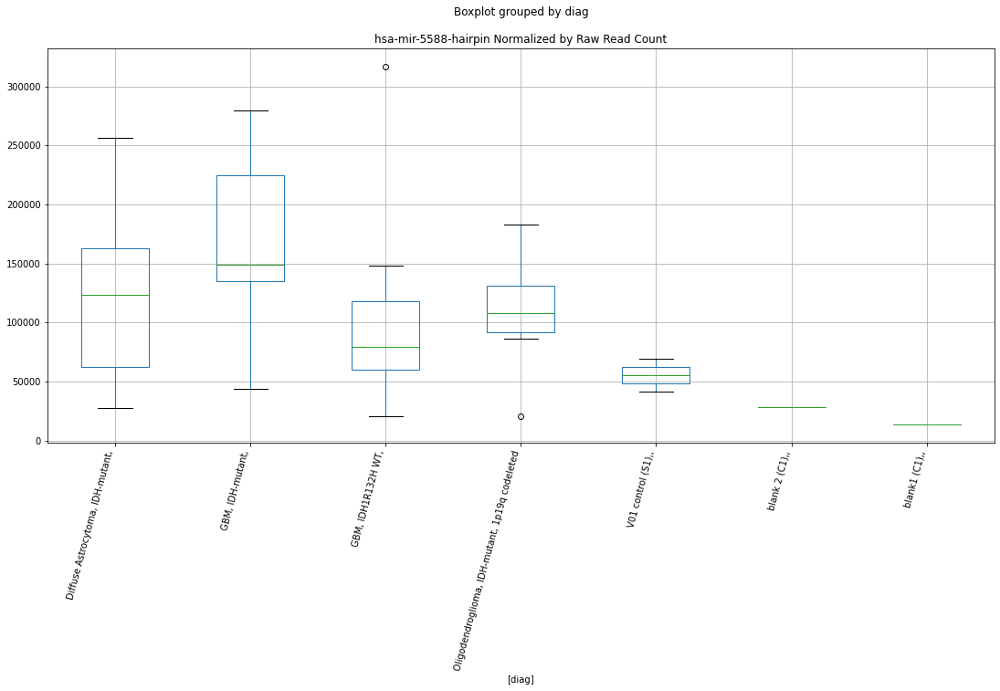

hsa-mir-3908-hairpin D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9736527646244262
	p = 0.06397364718973894
hsa-mir-3908-hairpin D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9736527646244262
	p = 0.06397364718973894


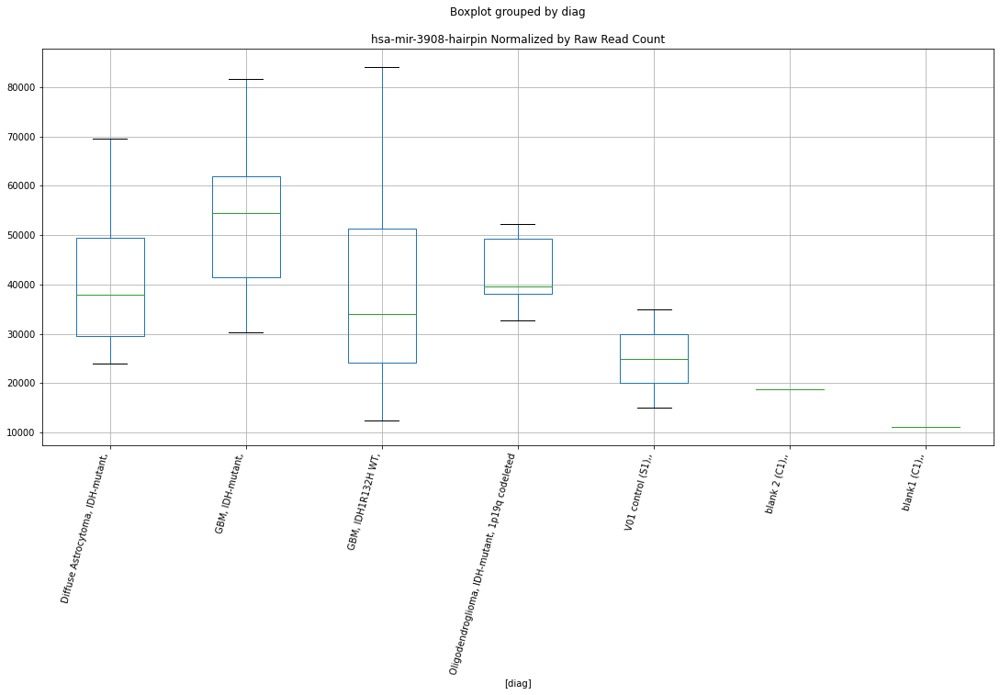

hsa-mir-3908-hairpin D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.1591518387911663
	p = 0.04458262628190975
hsa-mir-3908-hairpin D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.1591518387911663
	p = 0.04458262628190975


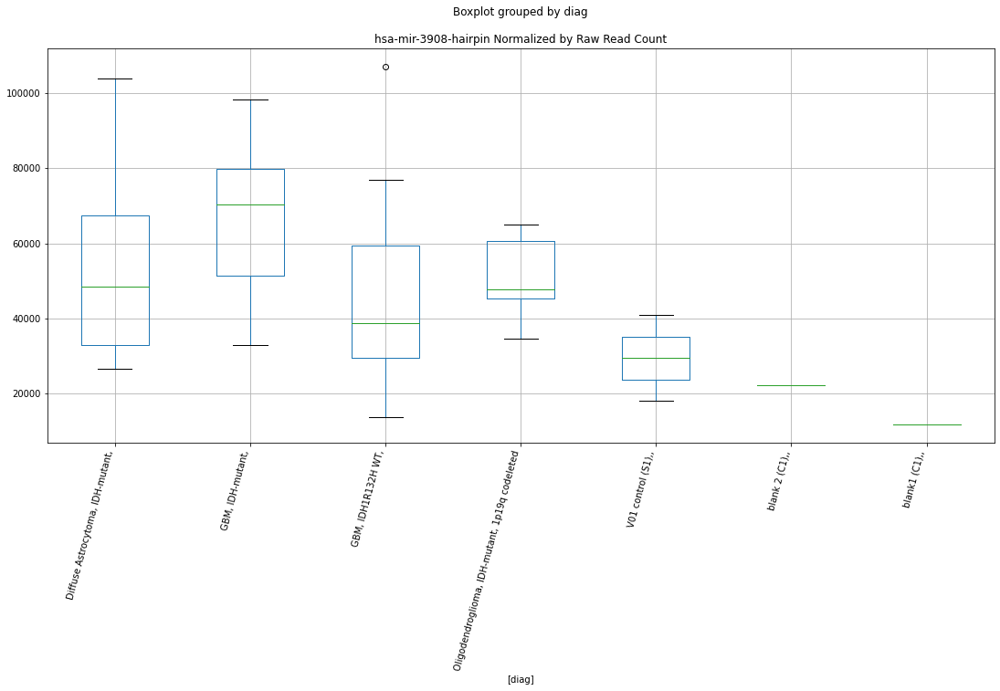

hsa-mir-3613-5p-mature D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7679736618758548
	p = 0.09401141198541417
hsa-mir-3613-5p-mature D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.7679736618758548
	p = 0.09401141198541417


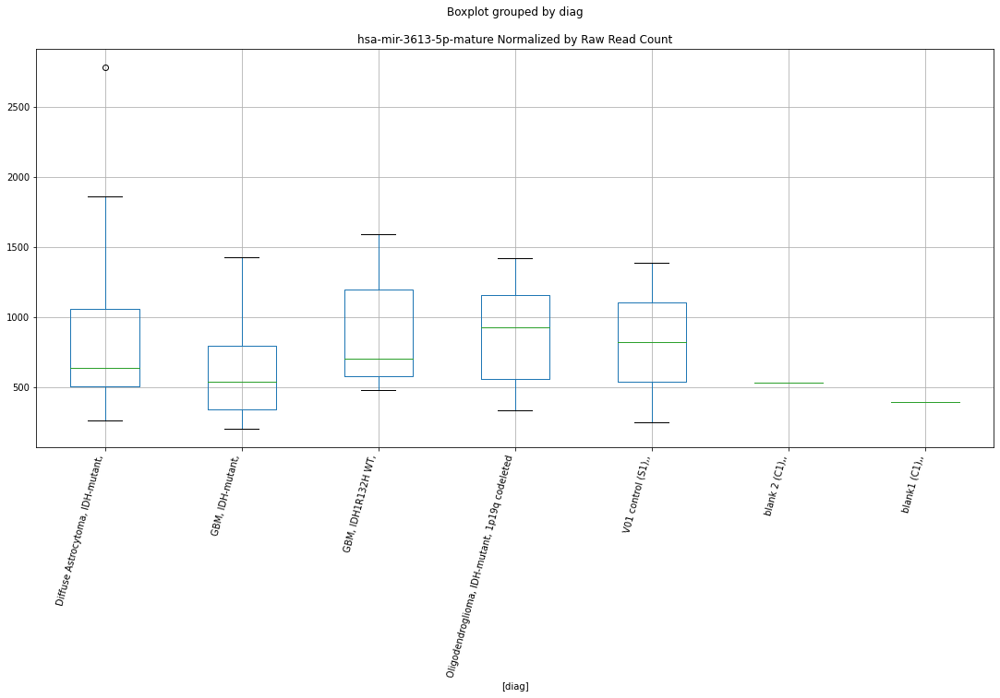

hsa-mir-3613-5p-mature D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7418052643209343
	p = 0.09860445580742834
hsa-mir-3613-5p-mature D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.8020701496744103
	p = 0.08830679877027074
hsa-mir-3613-5p-mature D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.7418052643209343
	p = 0.09860445580742834
hsa-mir-3613-5p-mature D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.8020701496744103
	p = 0.08830679877027074


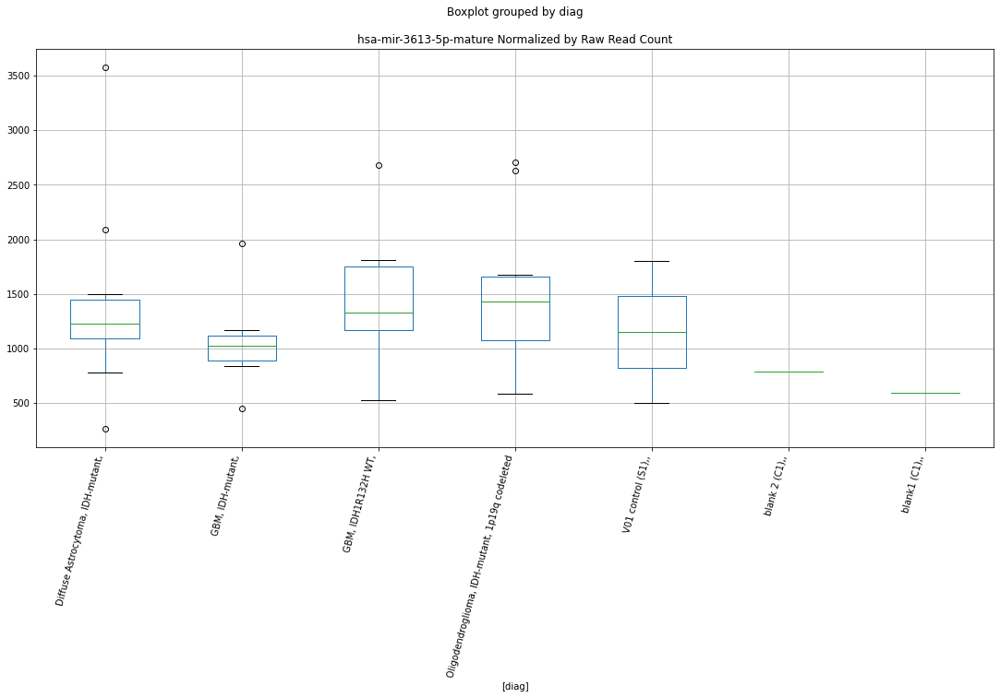

hsa-mir-3613-5p-mature D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.1325932648253616
	p = 0.04698333407799229
hsa-mir-3613-5p-mature D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.1325932648253616
	p = 0.04698333407799229


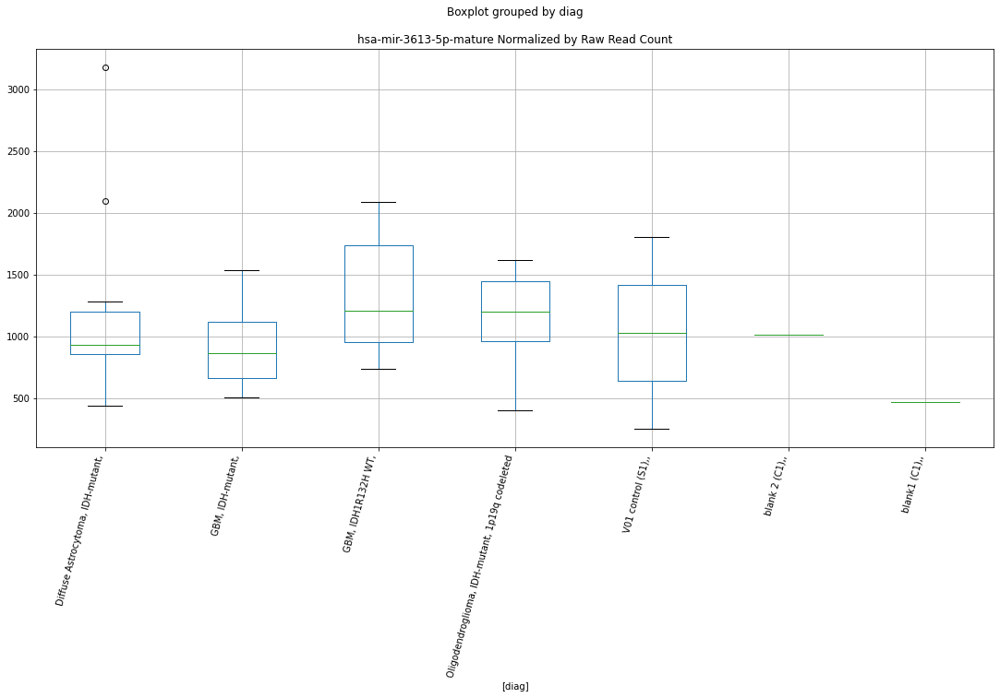

hsa-mir-9983-hairpin D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.816047420435771
	p = 0.0860571439696569
hsa-mir-9983-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.816047420435771
	p = 0.0860571439696569


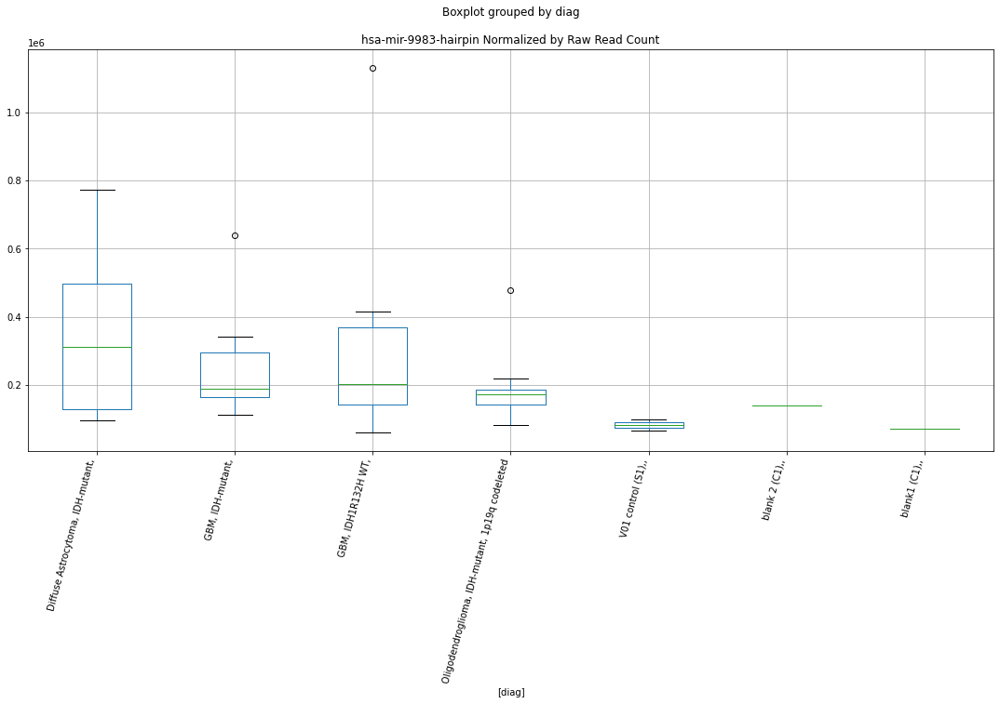

hsa-mir-9983-hairpin D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.816261586836824
	p = 0.08602306771981658
hsa-mir-9983-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.816261586836824
	p = 0.08602306771981658


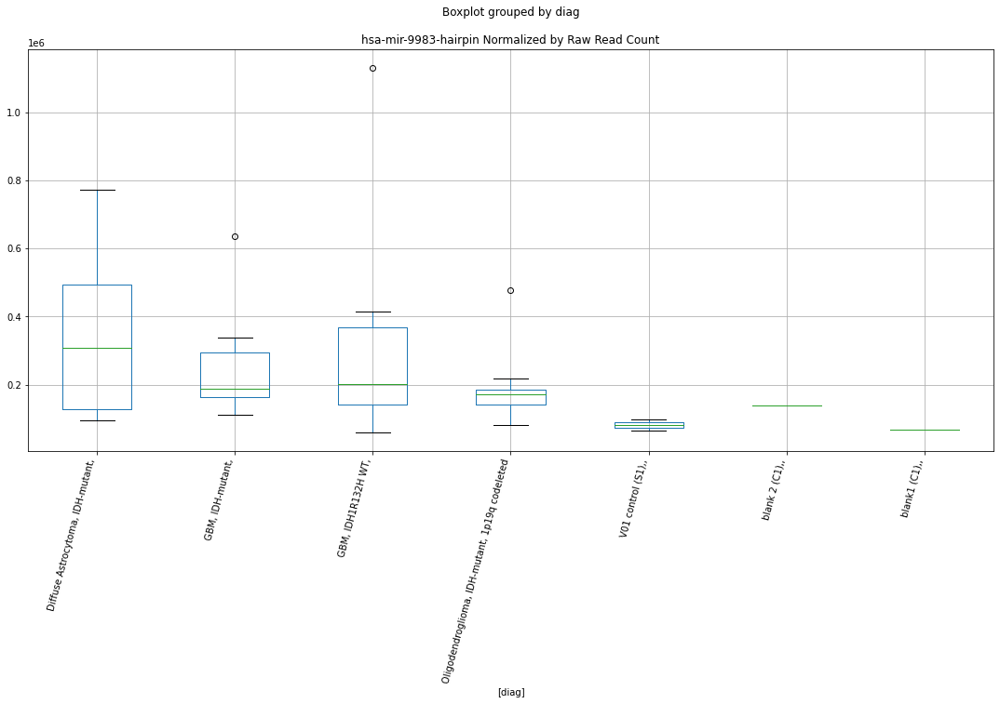

hsa-mir-6887-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8523664364212973
	p = 0.0804448828012243
hsa-mir-6887-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8523664364212973
	p = 0.0804448828012243


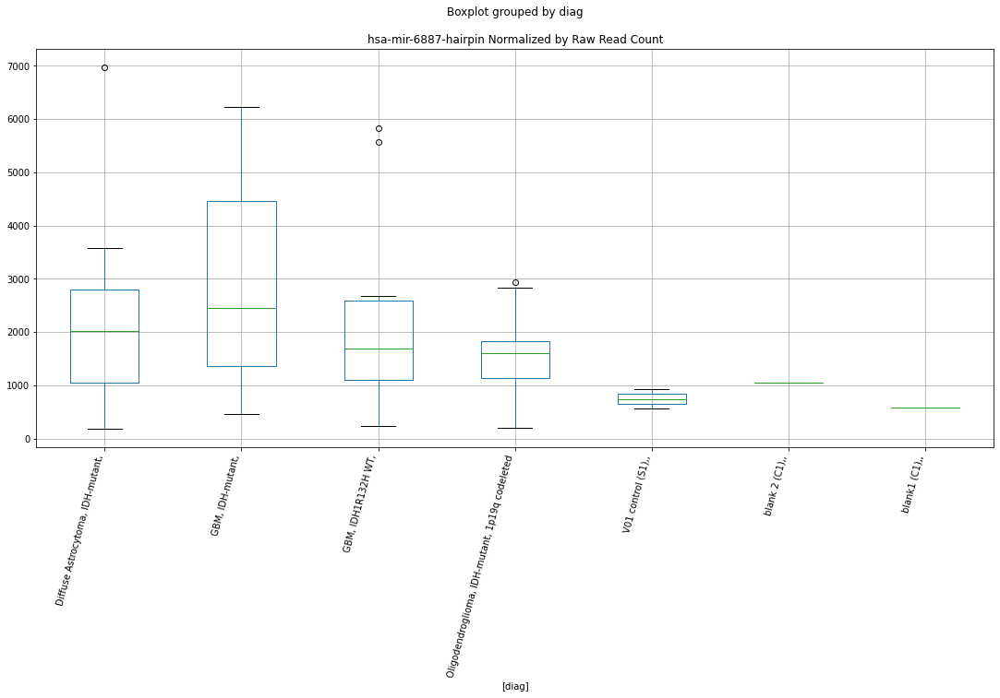

hsa-mir-6887-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.823797684031785
	p = 0.08483149552806872
hsa-mir-6887-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.823797684031785
	p = 0.08483149552806872


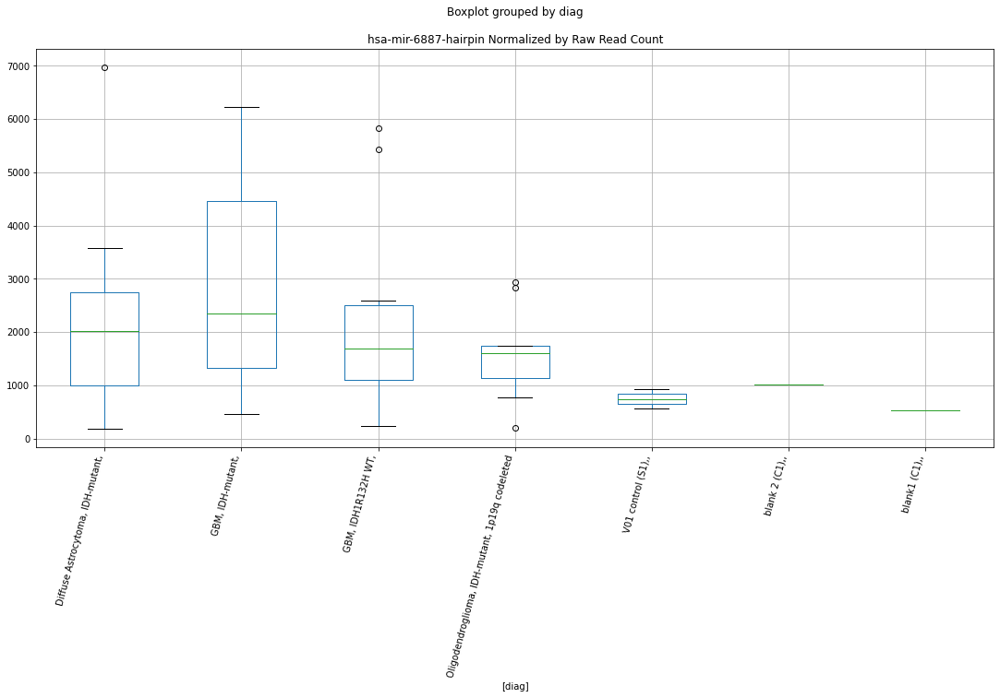

hsa-mir-6887-5p-mature D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8924096582429863
	p = 0.07463314665128558
hsa-mir-6887-5p-mature D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8924096582429863
	p = 0.07463314665128558


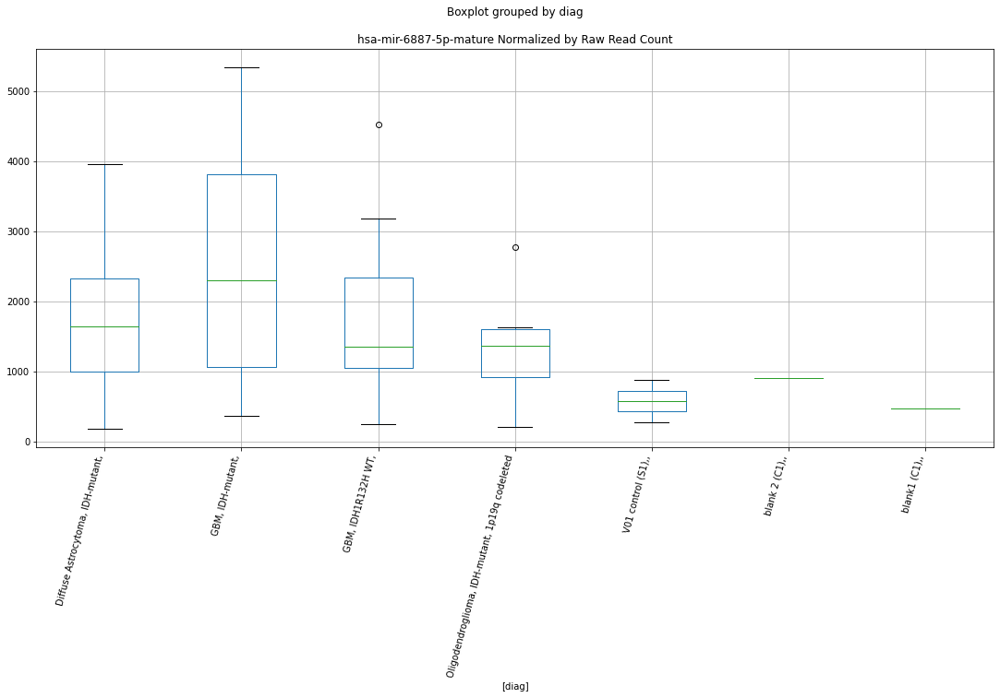

hsa-mir-6887-5p-mature D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.837617216652608
	p = 0.08268399754174546
hsa-mir-6887-5p-mature D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.837617216652608
	p = 0.08268399754174546


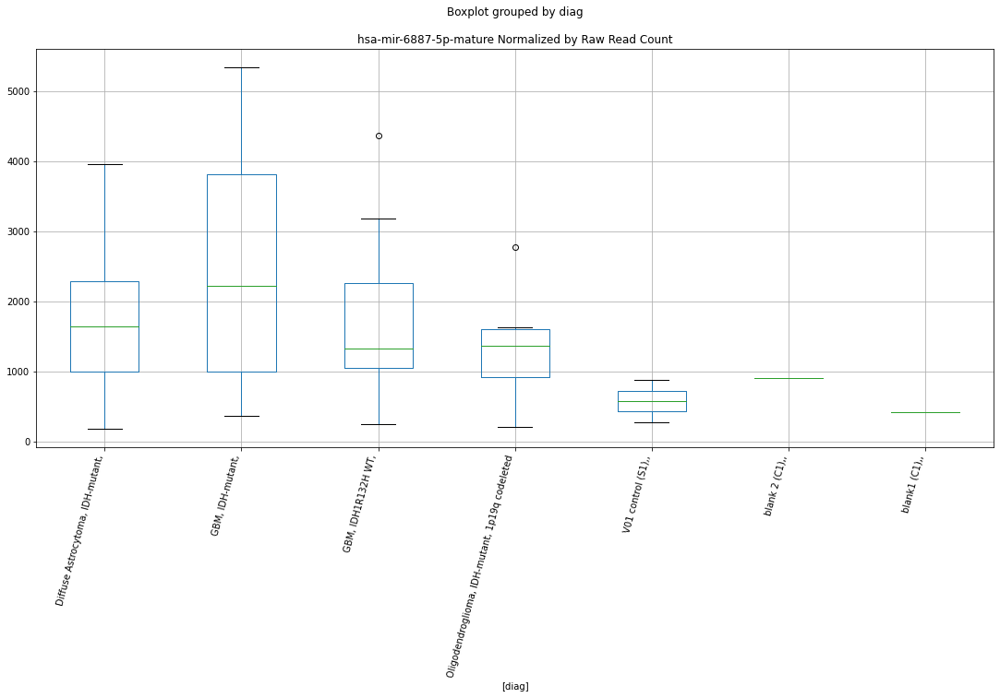

hsa-mir-644a-hairpin D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7354078838863771
	p = 0.09975645603533226
hsa-mir-644a-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7354078838863771
	p = 0.09975645603533226


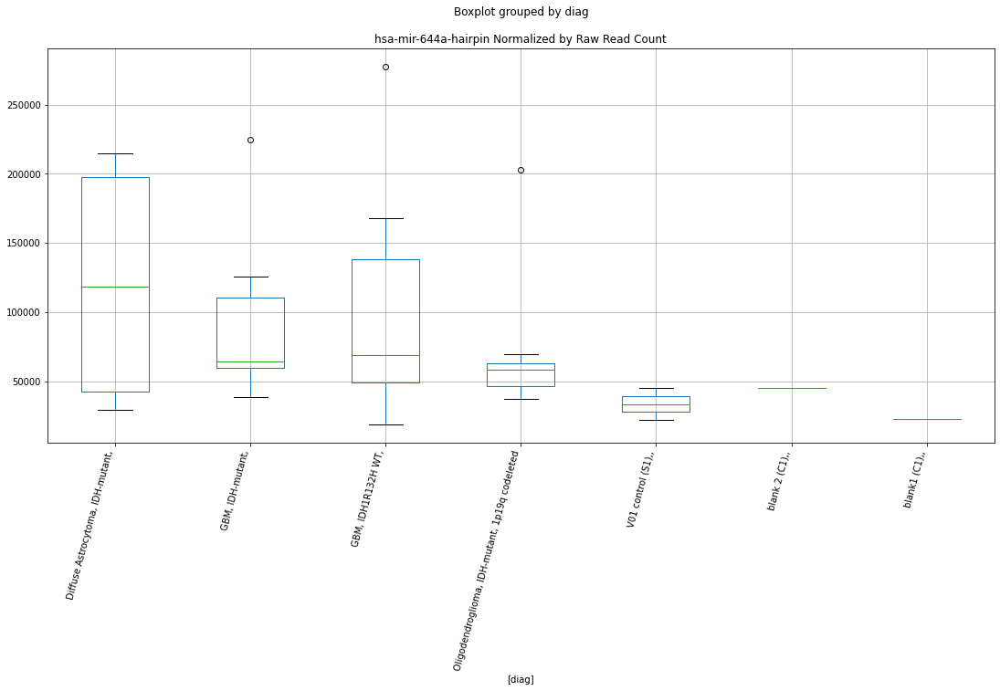

hsa-mir-644a-hairpin D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7550142008363554
	p = 0.09626228009254631
hsa-mir-644a-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7550142008363554
	p = 0.09626228009254631


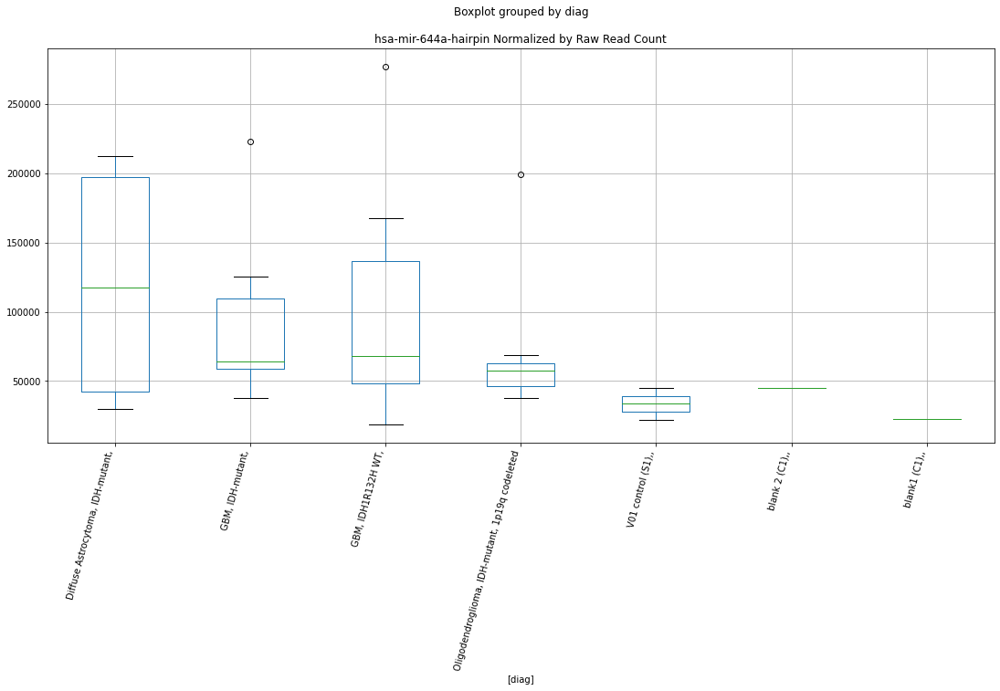

hsa-mir-4516-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.3990004301516694
	p = 0.027483191156612834
hsa-mir-4516-hairpin D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7801209850202266
	p = 0.09194329590780864
hsa-mir-4516-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.3990004301516694
	p = 0.027483191156612834
hsa-mir-4516-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7801209850202266
	p = 0.09194329590780864


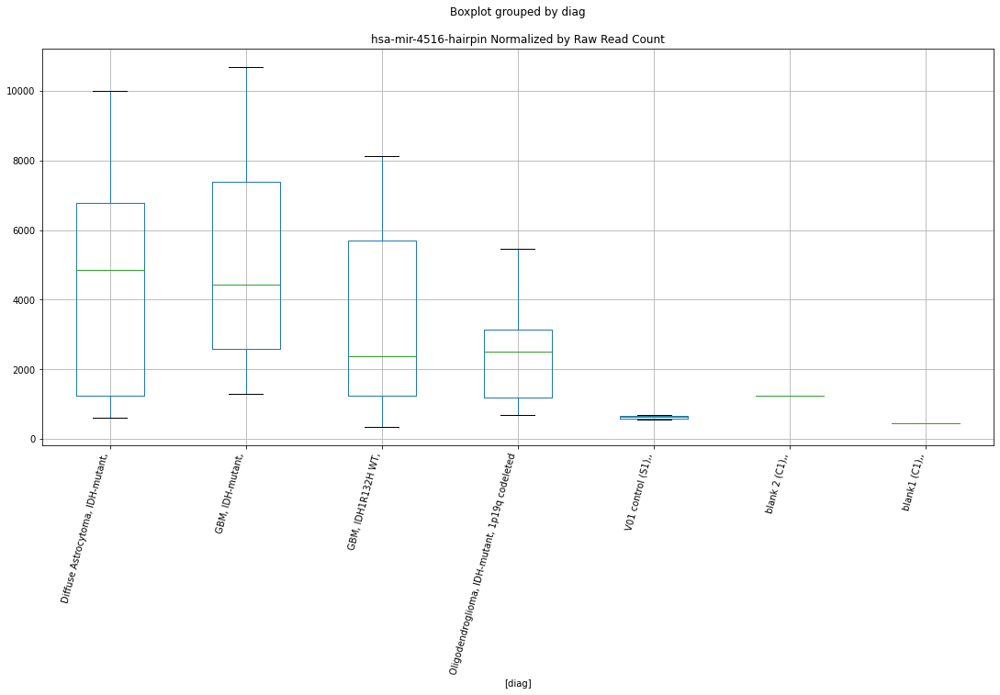

hsa-mir-4516-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.383399846775603
	p = 0.028376376942352923
hsa-mir-4516-hairpin D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7638999368190156
	p = 0.09471397747919372
hsa-mir-4516-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.383399846775603
	p = 0.028376376942352923
hsa-mir-4516-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7638999368190156
	p = 0.09471397747919372


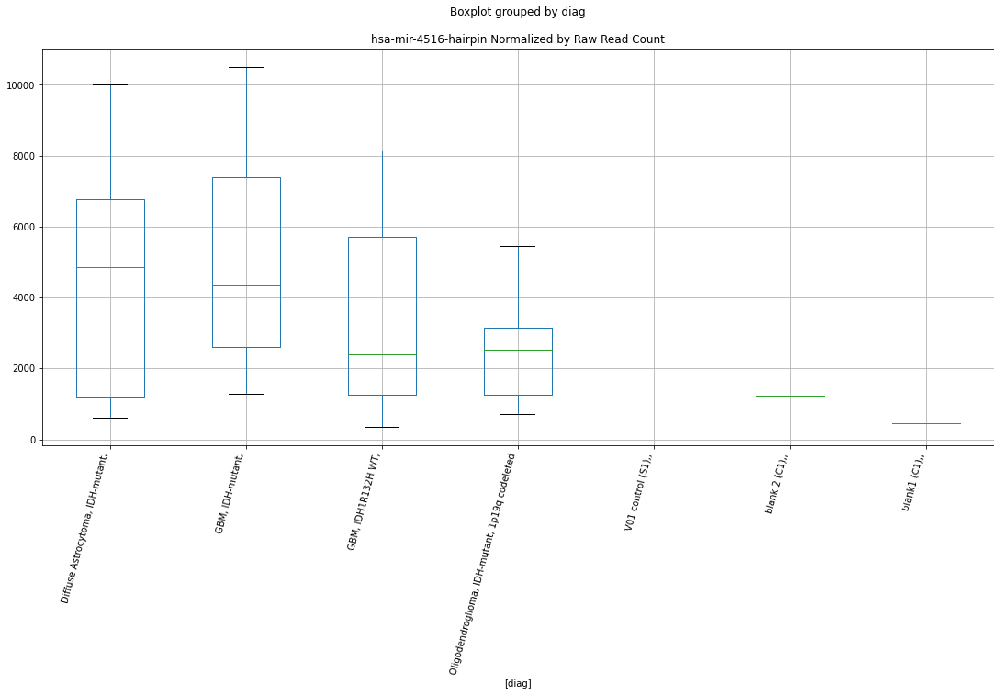

hsa-mir-3938-hairpin D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8186685209435702
	p = 0.0856409101246511
hsa-mir-3938-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8186685209435702
	p = 0.0856409101246511


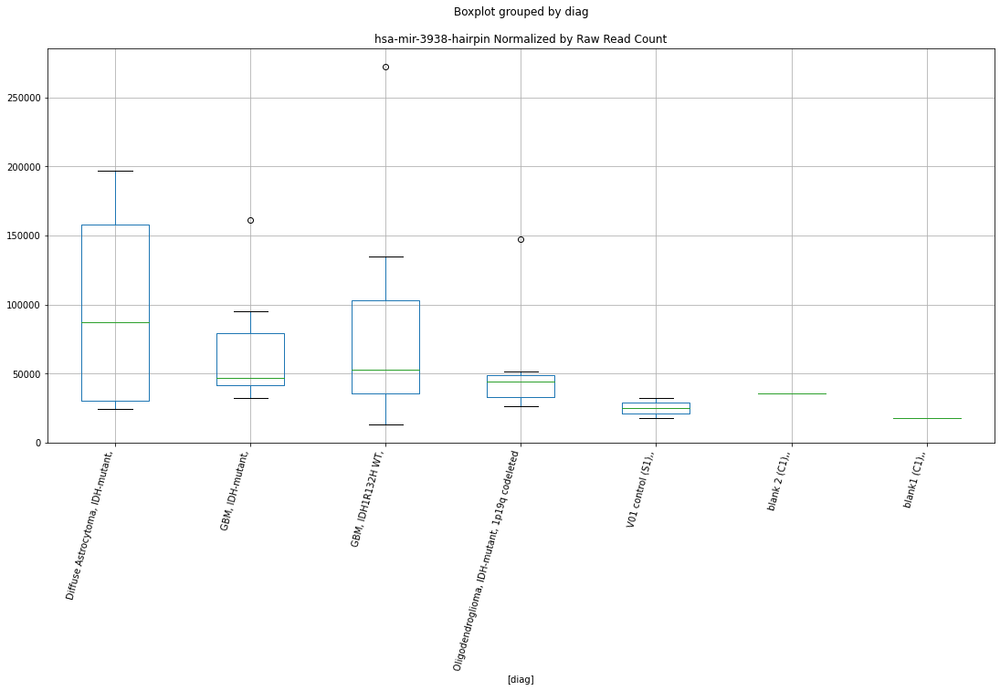

hsa-mir-3938-hairpin D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8265991042291903
	p = 0.08439225283919383
hsa-mir-3938-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8265991042291903
	p = 0.08439225283919383


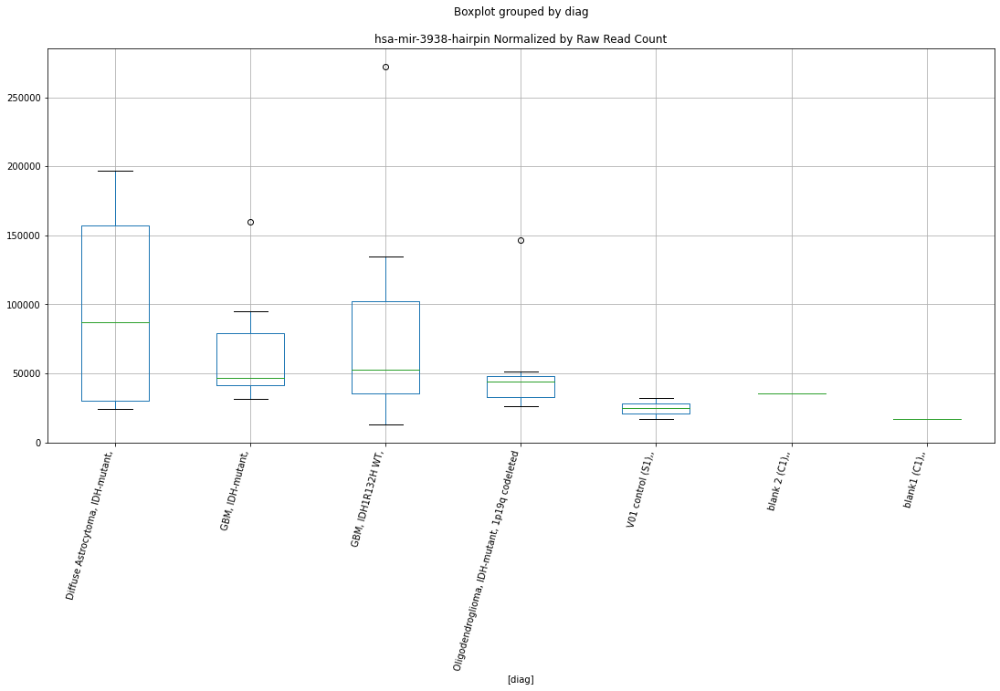

hsa-mir-548ac-hairpin D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8578604345339835
	p = 0.07962457641360393
hsa-mir-548ac-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8578604345339835
	p = 0.07962457641360393


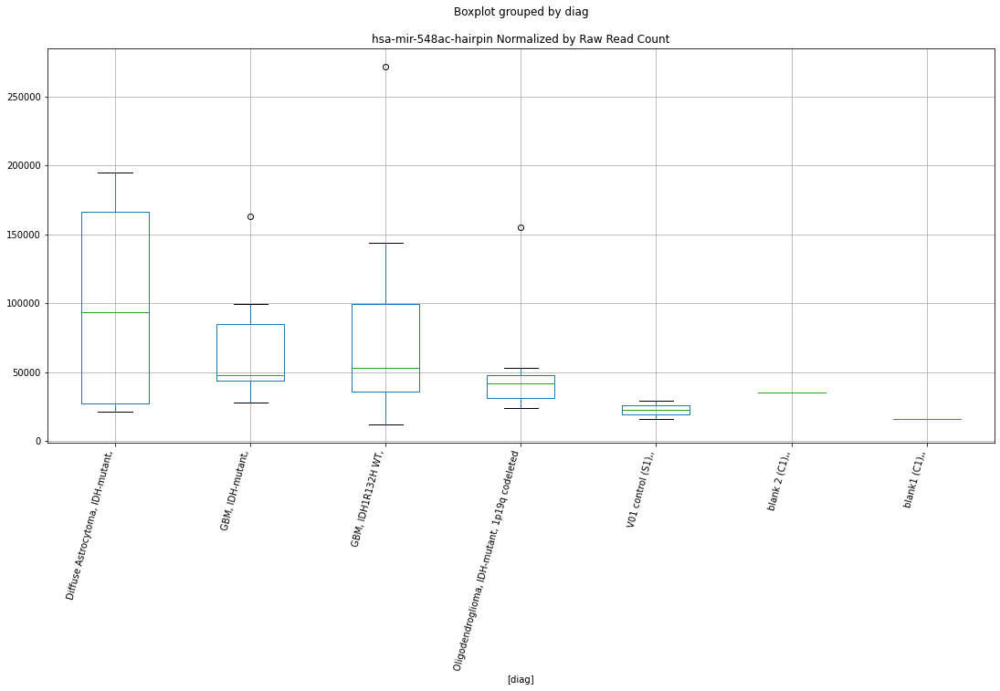

hsa-mir-548ac-hairpin D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.860666979106056
	p = 0.07920838468776044
hsa-mir-548ac-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.860666979106056
	p = 0.07920838468776044


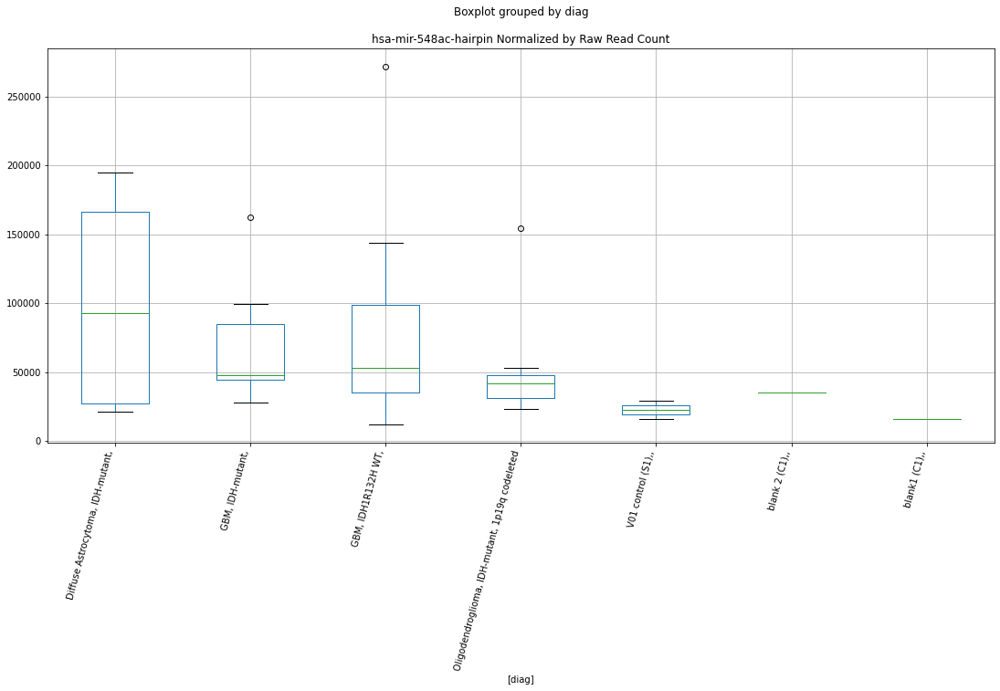

hsa-mir-1237-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.866584838069406
	p = 0.0783370888249232
hsa-mir-1237-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.866584838069406
	p = 0.0783370888249232


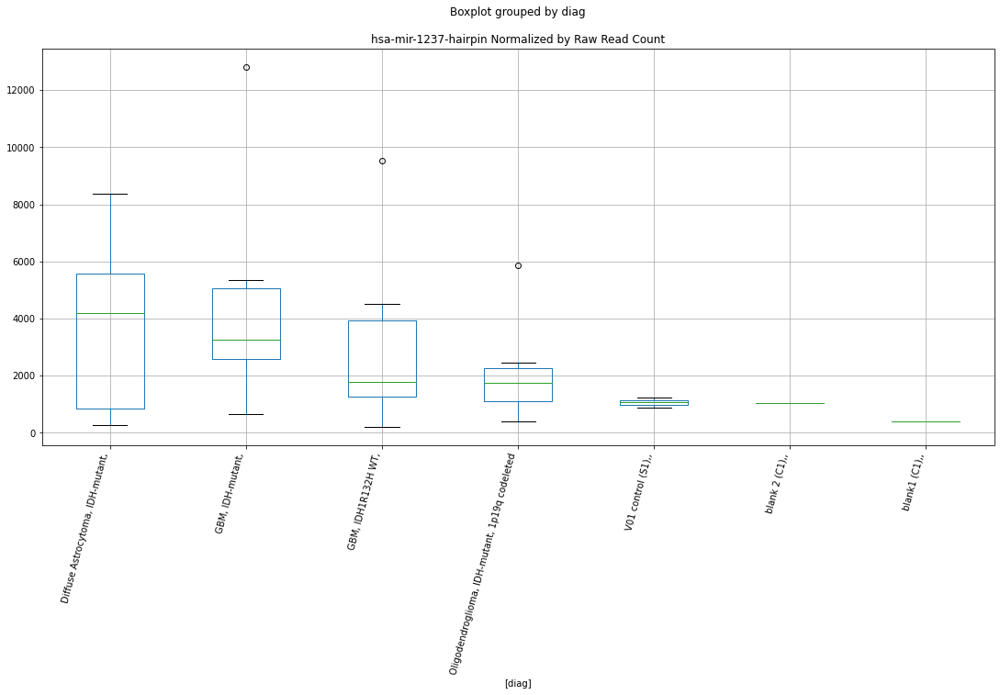

hsa-mir-1237-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8717470729567158
	p = 0.07758396390612185
hsa-mir-1237-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8717470729567158
	p = 0.07758396390612185


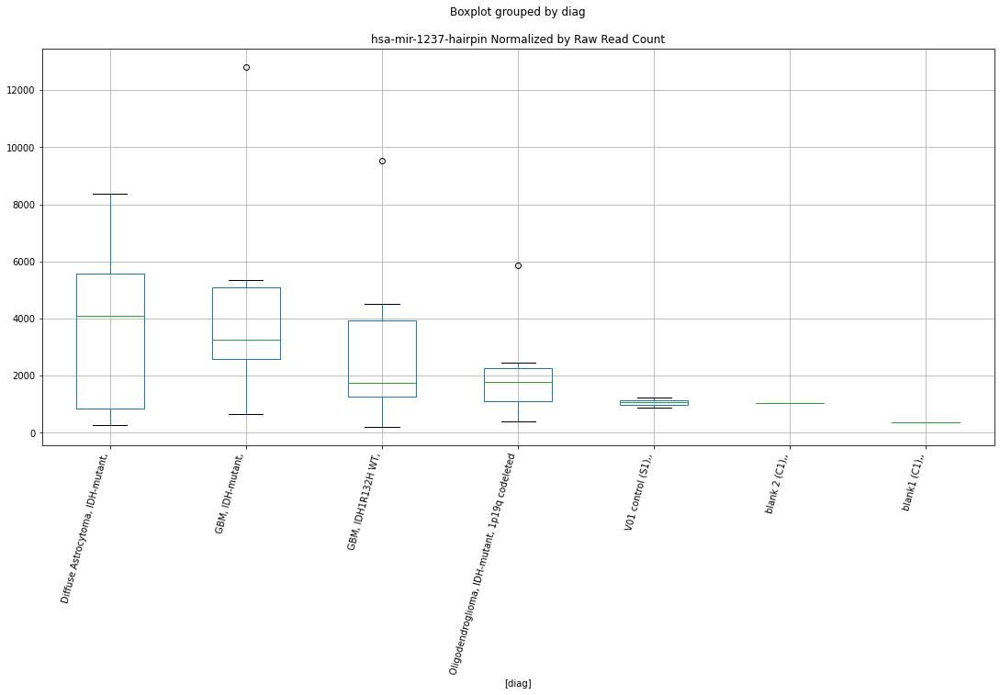

In [60]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in mirnas:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Raw Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


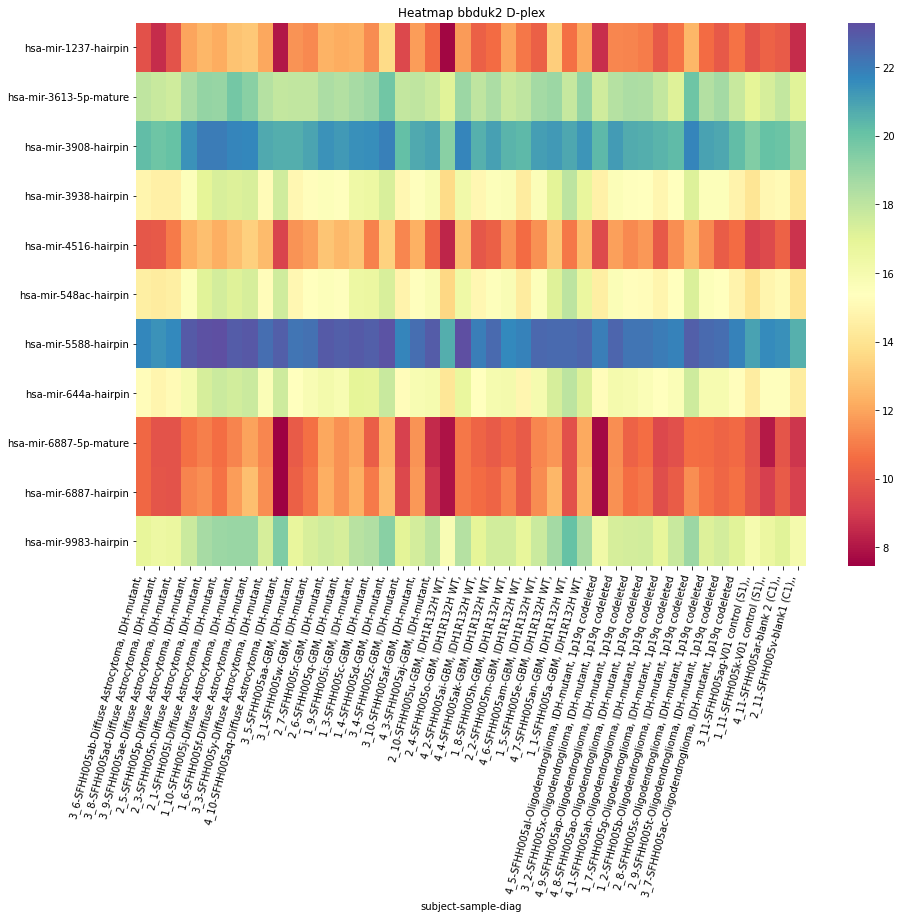

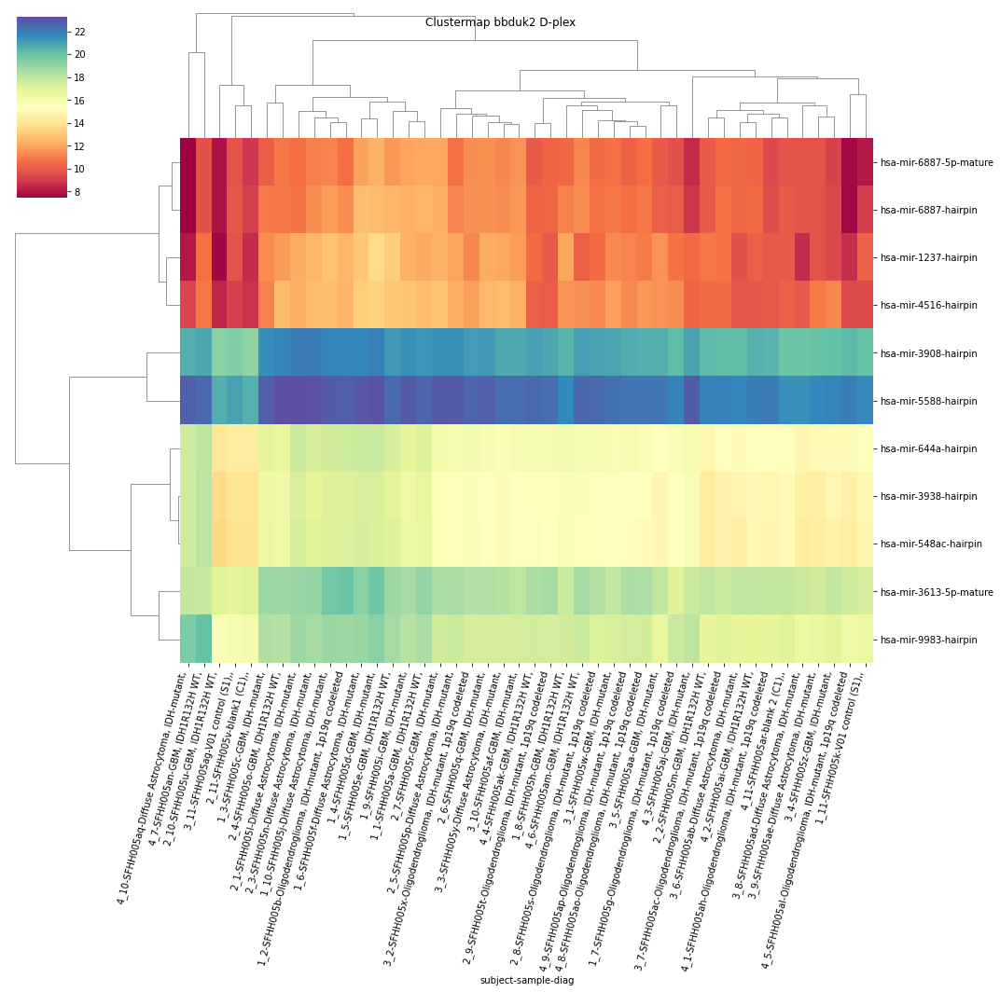

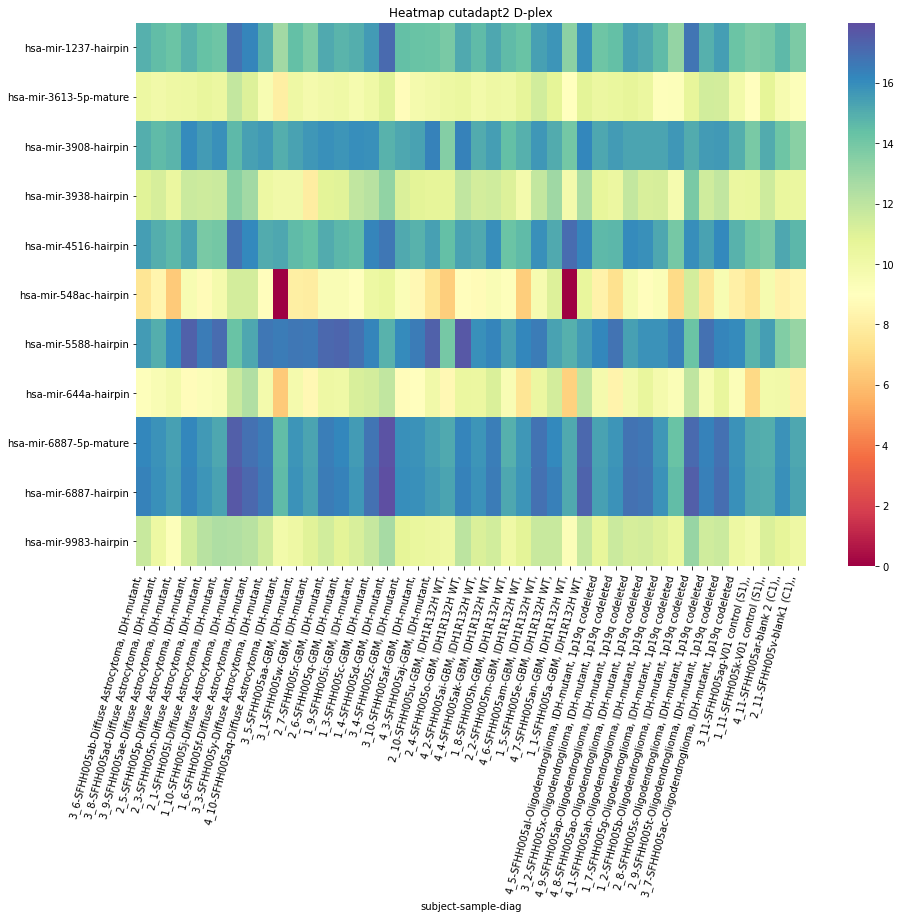

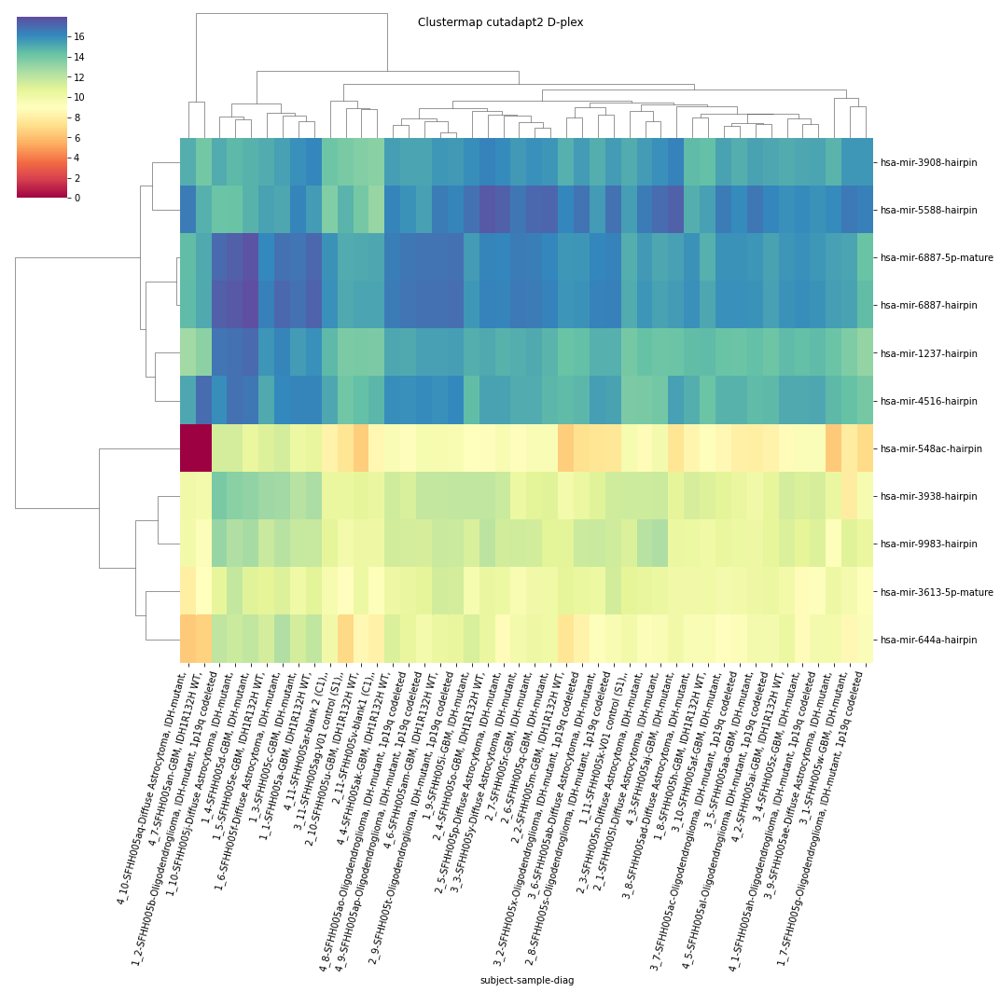

In [61]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

IGF2 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.8007293211633453
	p = 0.0885252861890129
IGF2 D-plex cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8007293211633453
	p = 0.0885252861890129


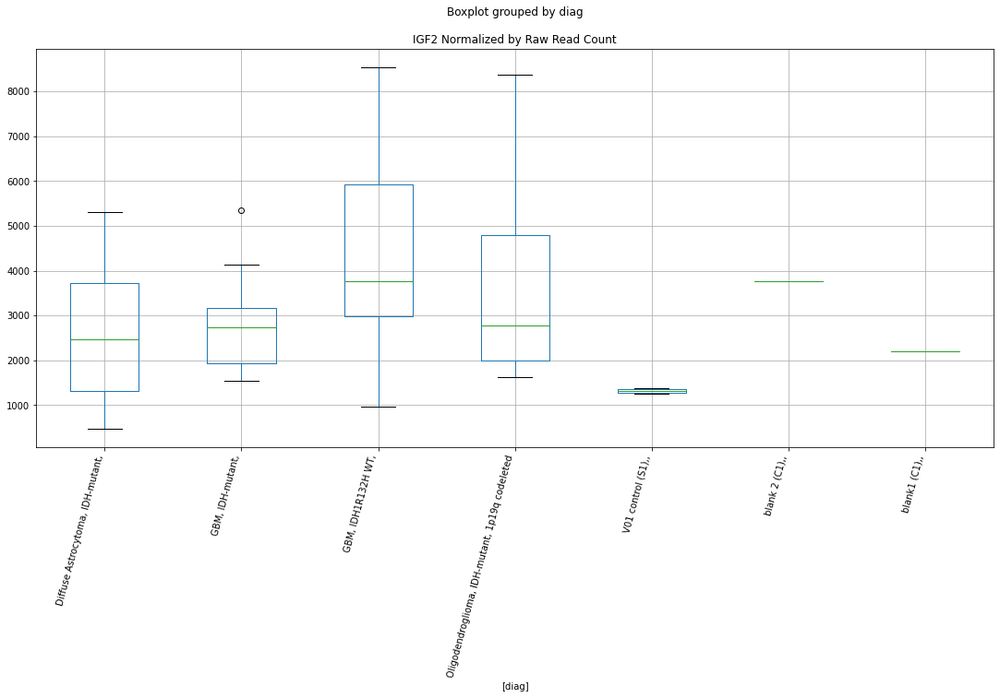

HDGFL2 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8597716931760517
	p = 0.07934094074649116
HDGFL2 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8597716931760517
	p = 0.07934094074649116


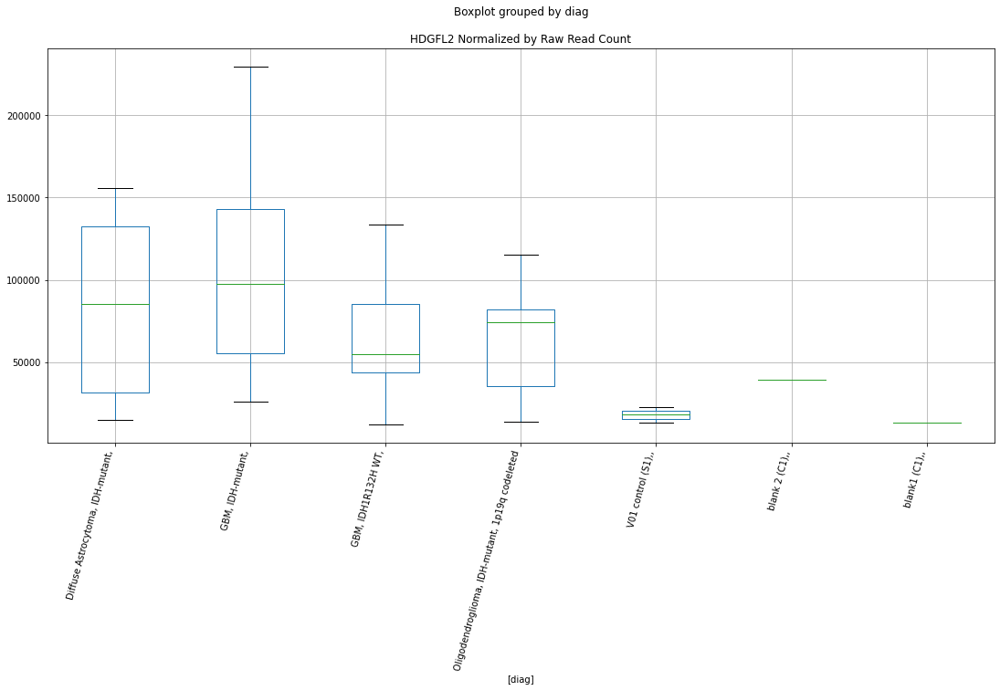

HDGFL2 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8597716931760517
	p = 0.07934094074649116
HDGFL2 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8597716931760517
	p = 0.07934094074649116


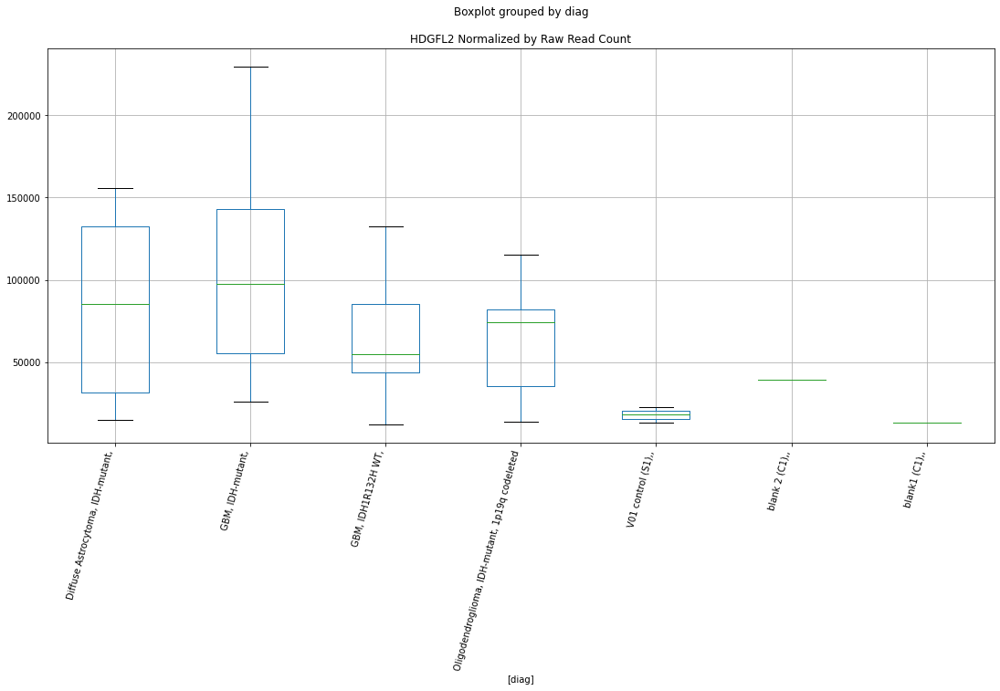

In [62]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in genes:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Raw Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


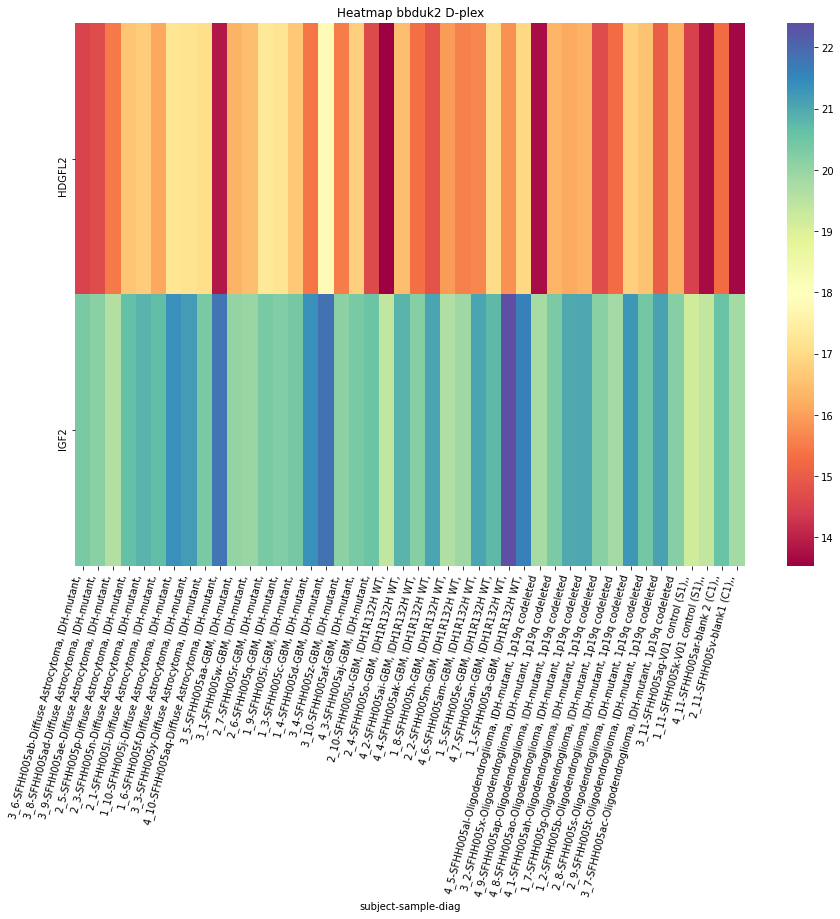

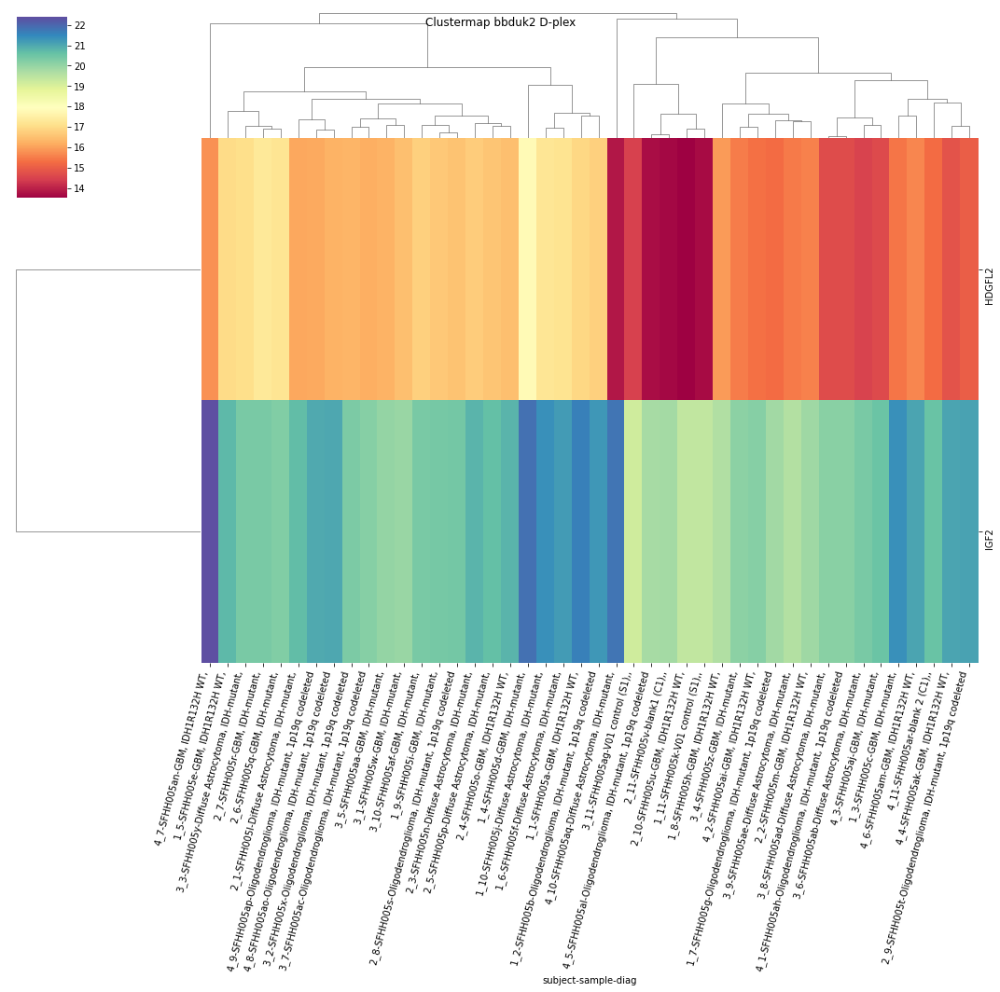

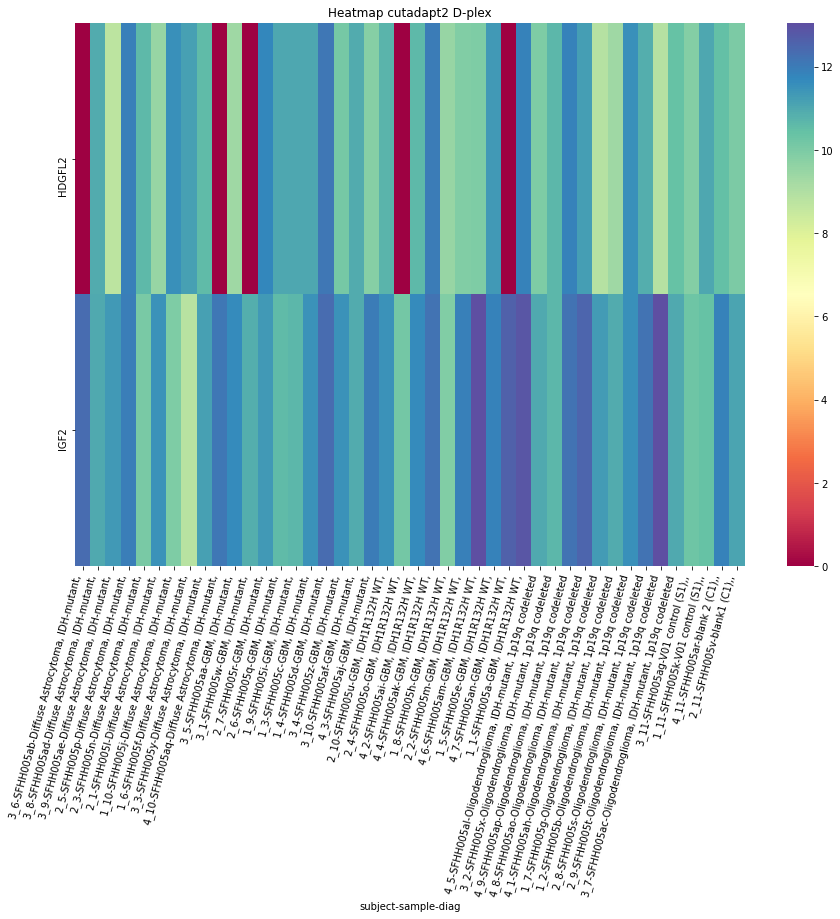

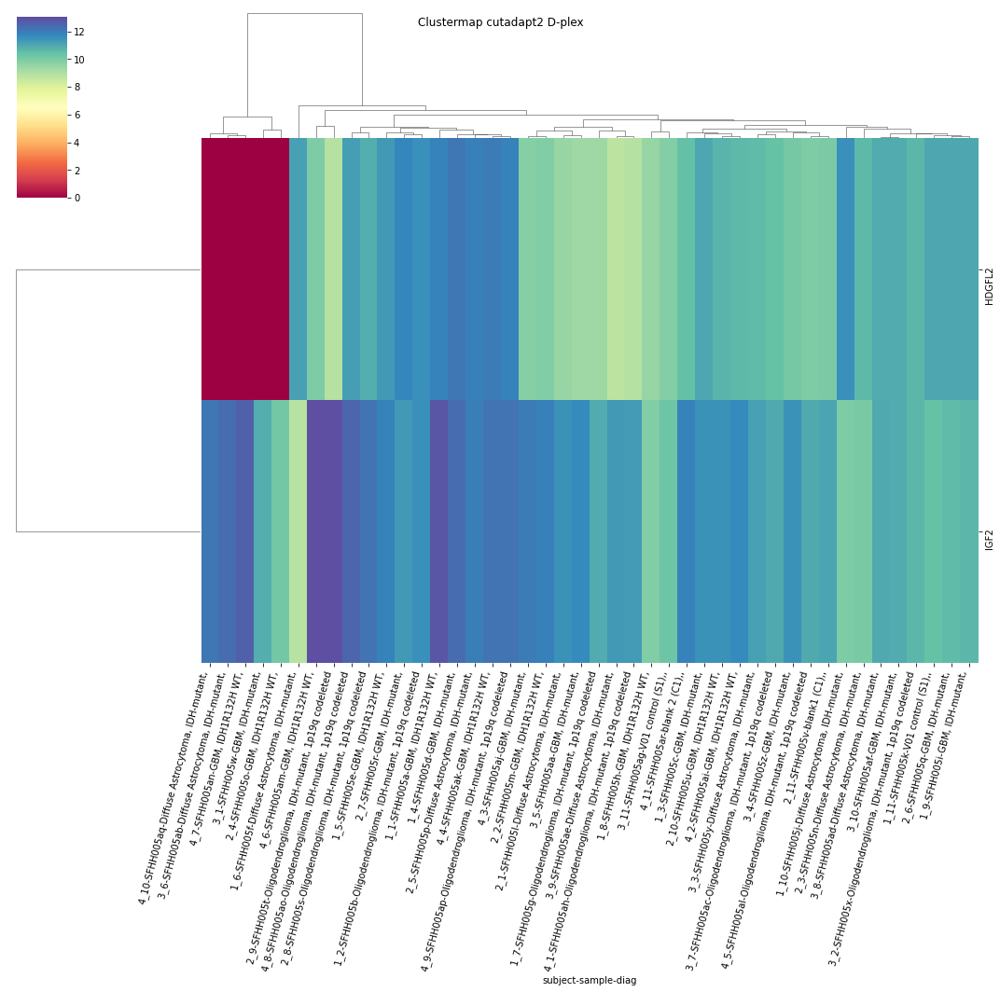

In [63]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

NR_027072.2 D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.3941008715369216
	p = 0.027760837055312532
NR_027072.2 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.9074922866925972
	p = 0.07254239967711607
NR_027072.2 D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.3941008715369216
	p = 0.027760837055312532
NR_027072.2 D-plex cutadapt3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9074922866925972
	p = 0.07254239967711607


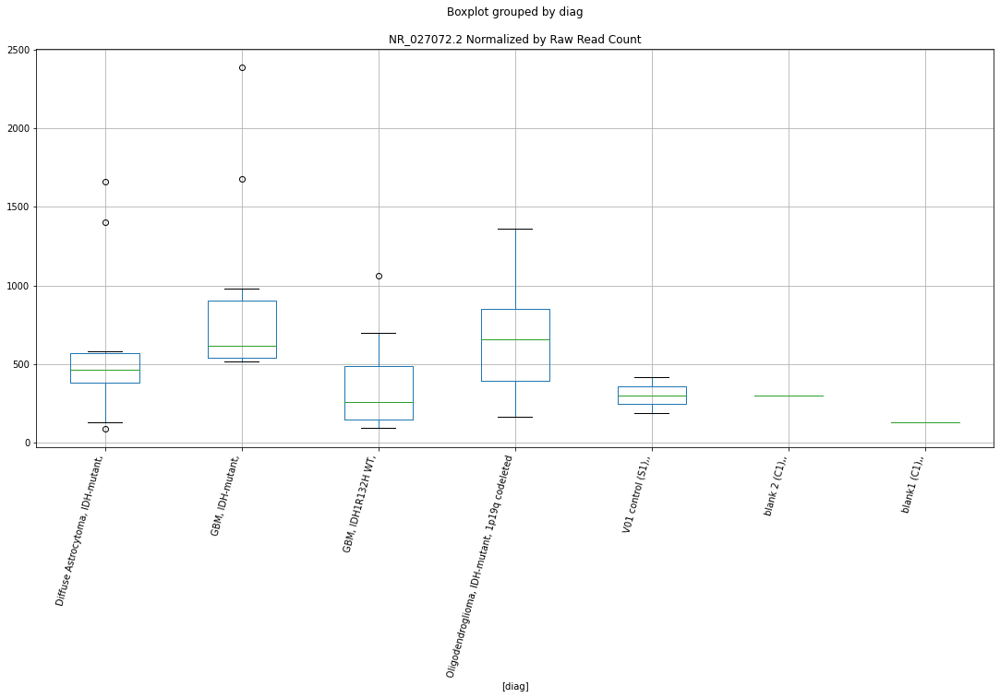

NM_001145873.1 D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.037683819006159
	p = 0.007080049971252635
NM_001145873.1 D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.809321248235095
	p = 0.08713338655329328
NM_001145873.1 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.464544444541659
	p = 0.0240103956989794
NM_001145873.1 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.755533599601204
	p = 0.09617117614912064
NM_001145873.1 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.037683819006159
	p = 0.007080049971252635
NM_001145873.1 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.464544444541659
	p = 0.0240103956989794
NM_001145873.1 D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.809321248235095
	p = 0.087133386553293

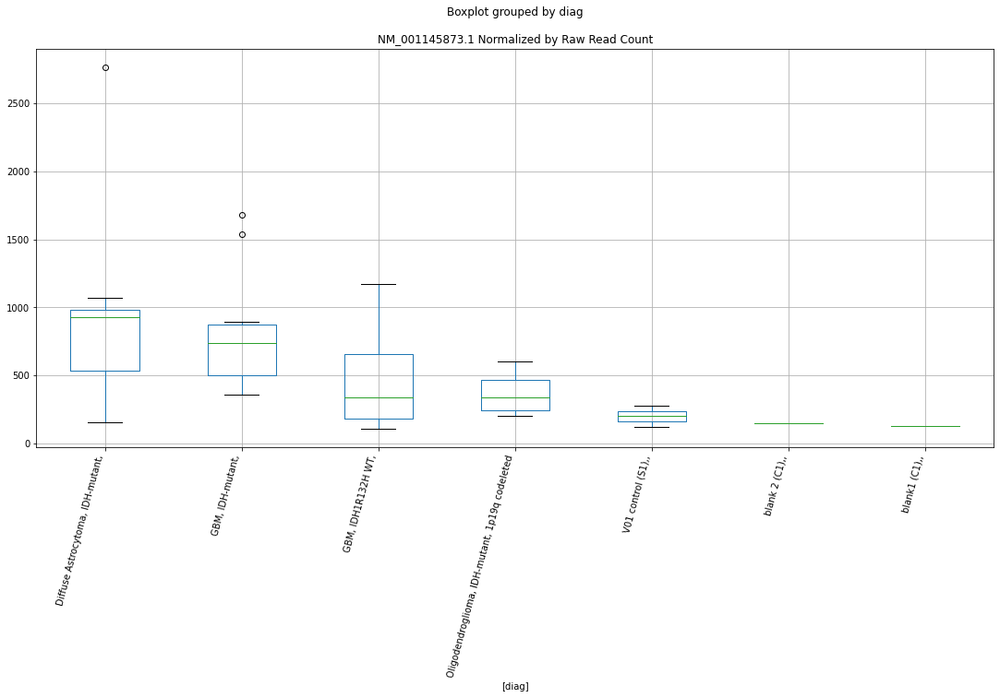

NR_002728.3 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.1216465167907517
	p = 0.04800672512482568
NR_002728.3 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.1216465167907517
	p = 0.04800672512482568


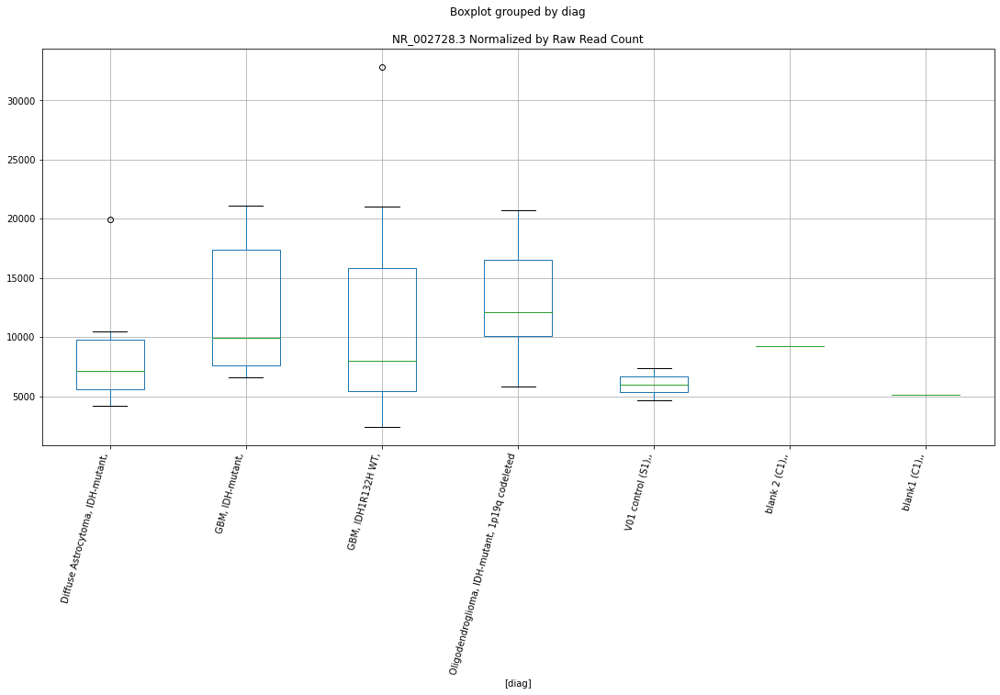

NR_002728.3 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0800542207194828
	p = 0.05208278832602012
NR_002728.3 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0800542207194828
	p = 0.05208278832602012


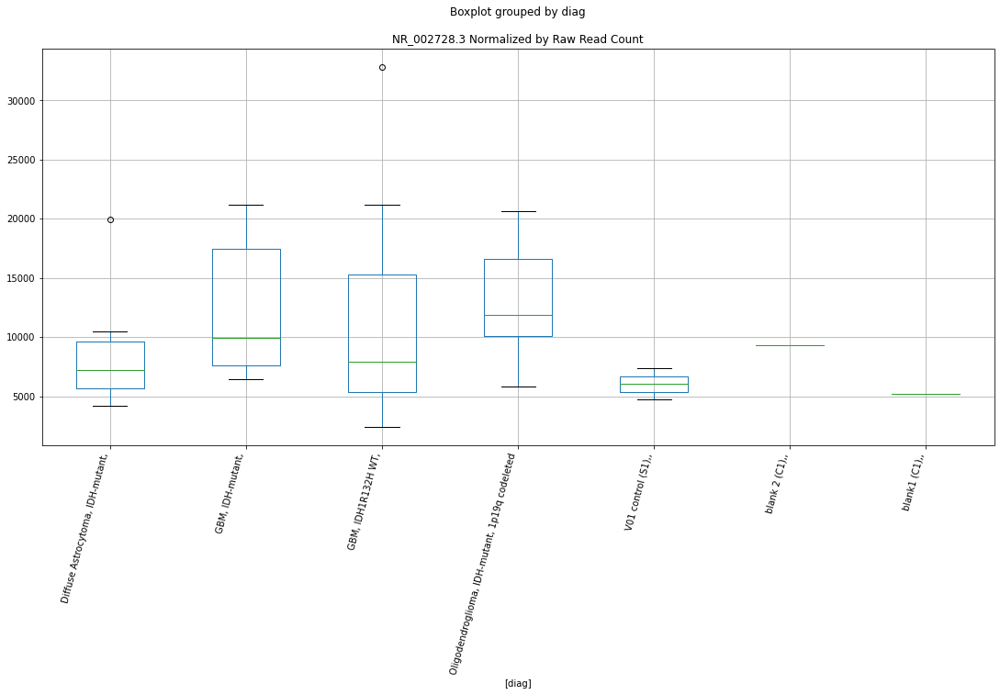

NR_002728.3 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.1282639389313194
	p = 0.047385673255037127
NR_002728.3 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.1282639389313194
	p = 0.047385673255037127


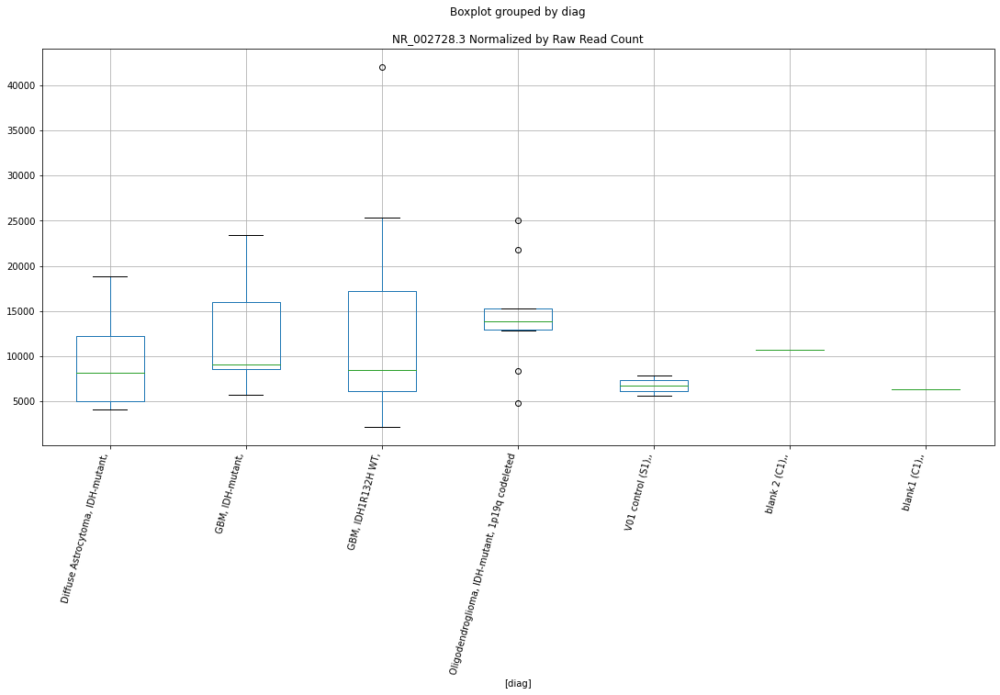

NR_002728.3 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.048684696064232
	p = 0.055361961973274476
NR_002728.3 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.048684696064232
	p = 0.055361961973274476


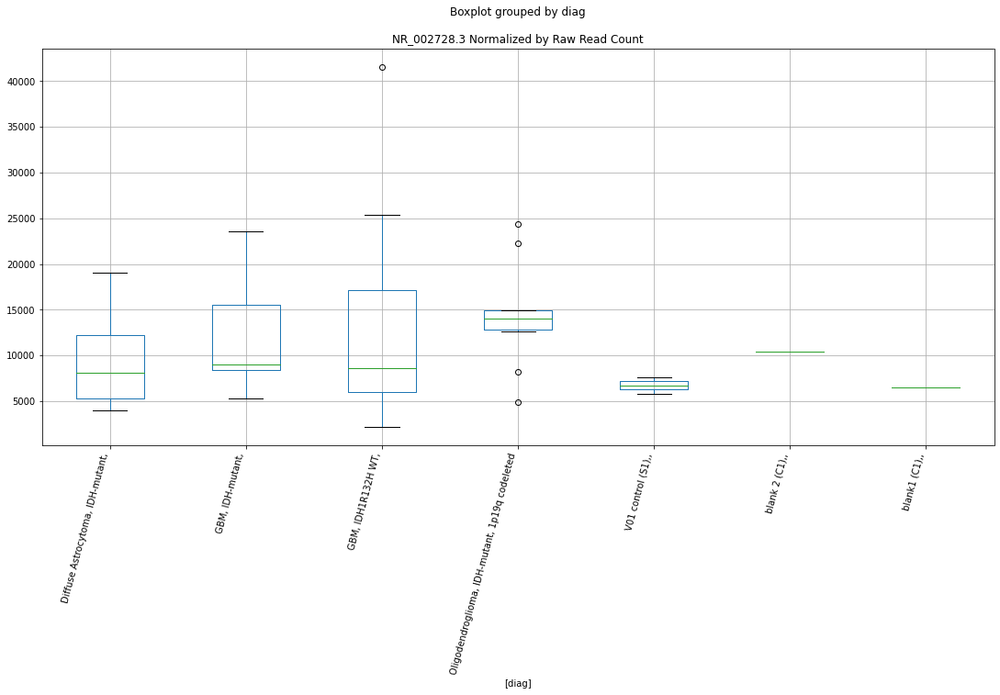

NR_002728.3 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0812883800780497
	p = 0.05195745180840449
NR_002728.3 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0812883800780497
	p = 0.05195745180840449


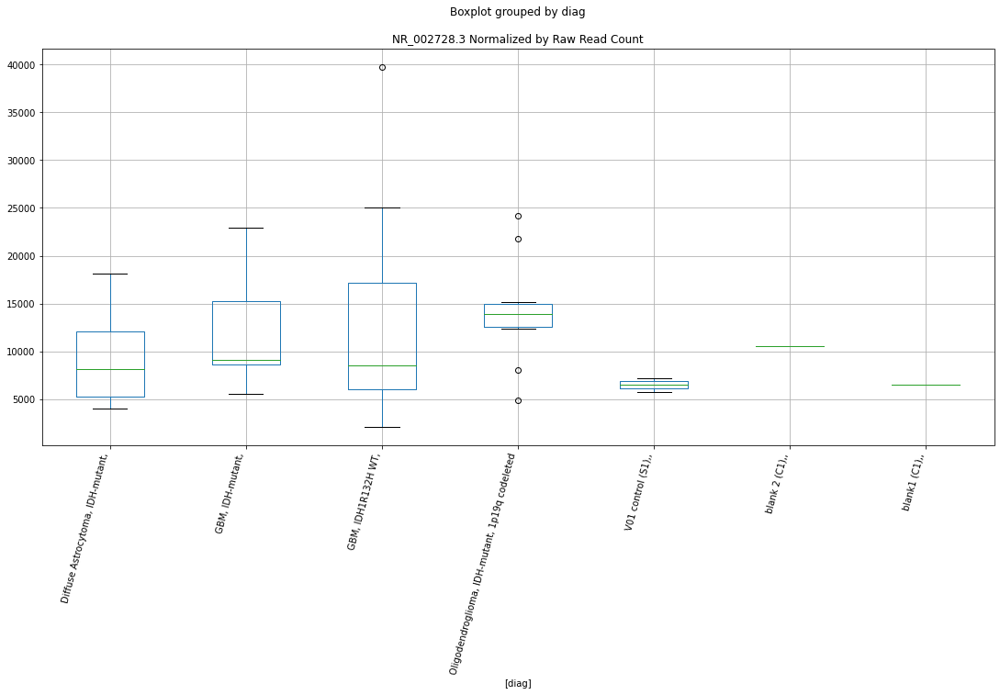

NR_134282.1 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7472666083669528
	p = 0.09763014311812572
NR_134282.1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7472666083669528
	p = 0.09763014311812572


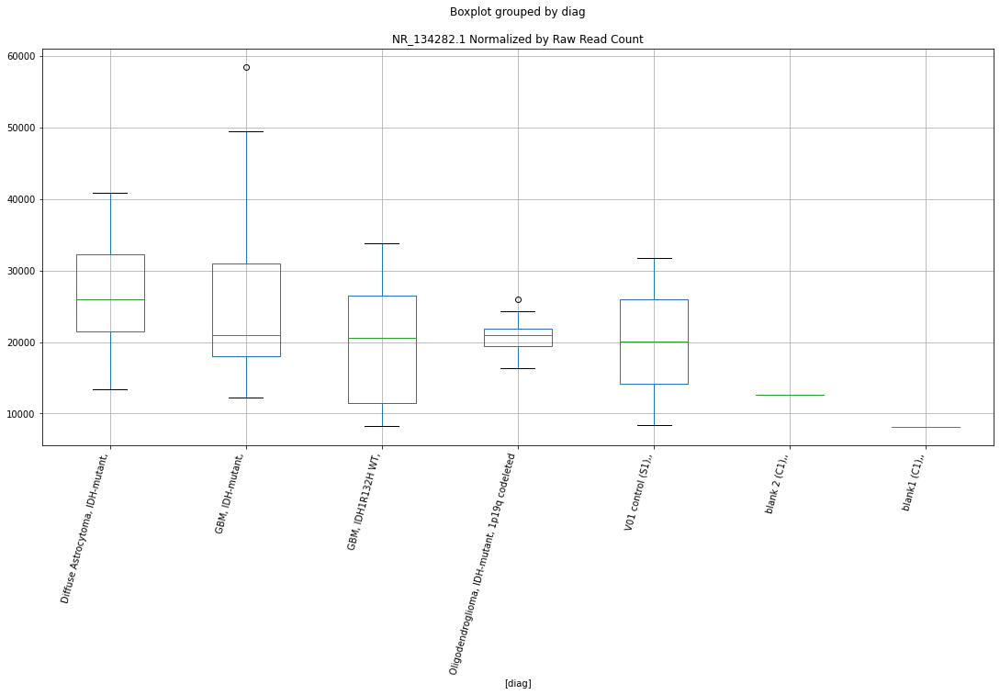

NR_134282.1 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7405464216198854
	p = 0.09883022585250527
NR_134282.1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7405464216198854
	p = 0.09883022585250527


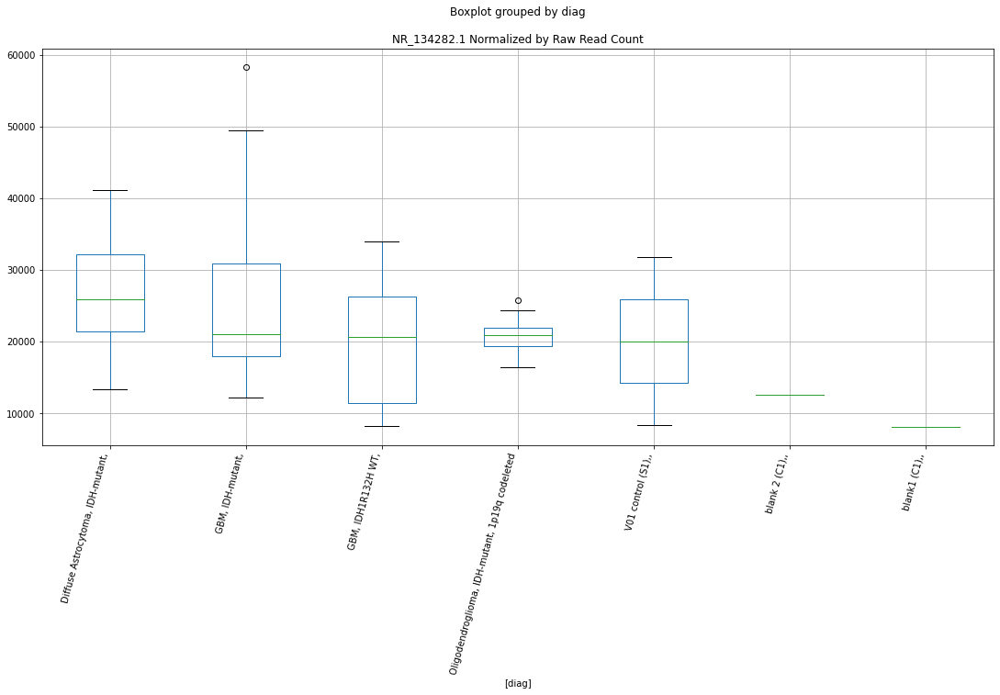

NR_039980.1 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.368207009157365
	p = 0.02927220838913988
NR_039980.1 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.8463807492655078
	p = 0.08134706723983981
NR_039980.1 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.368207009157365
	p = 0.02927220838913988
NR_039980.1 D-plex cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8463807492655078
	p = 0.08134706723983981


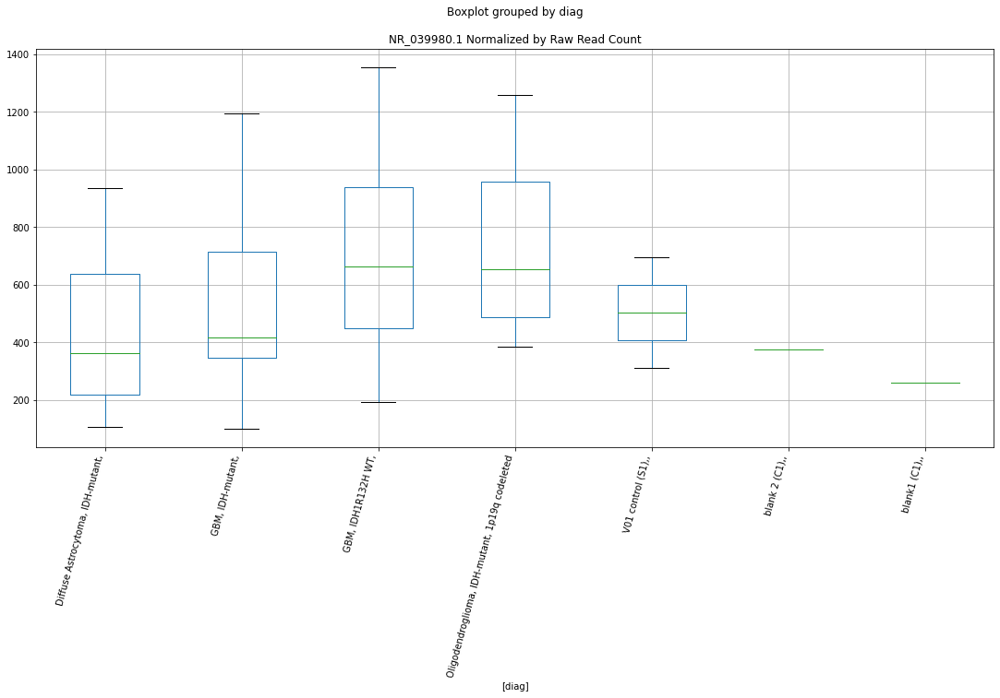

NR_039980.1 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.3137659833246524
	p = 0.0327032463347627
NR_039980.1 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.101820833633396
	p = 0.0499120164068731
NR_039980.1 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.3137659833246524
	p = 0.0327032463347627
NR_039980.1 D-plex cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.101820833633396
	p = 0.0499120164068731


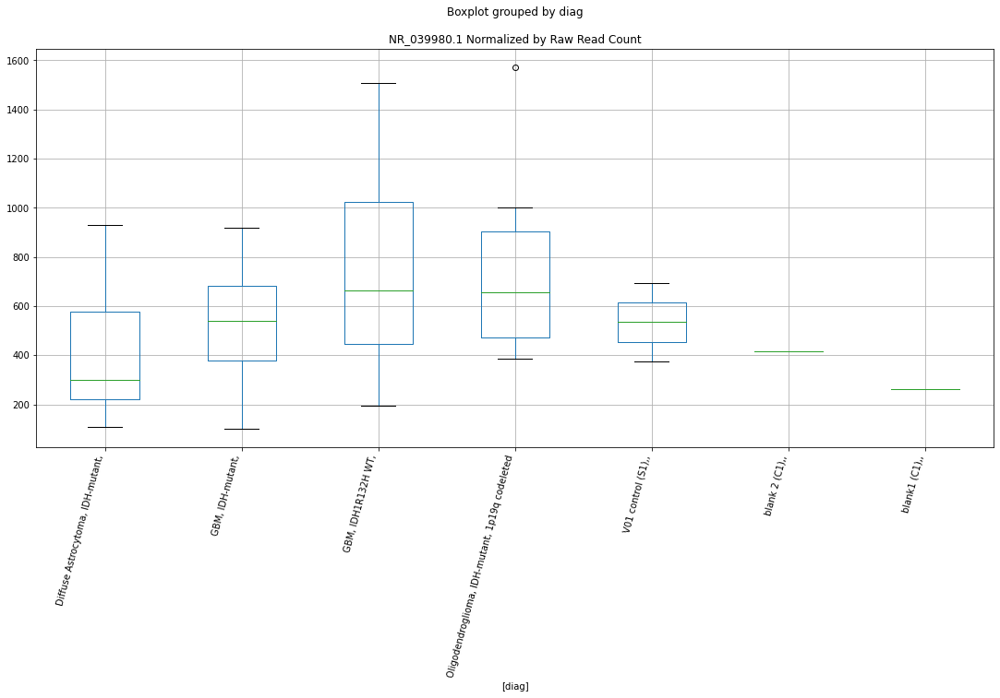

In [64]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in mrnas:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Raw Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


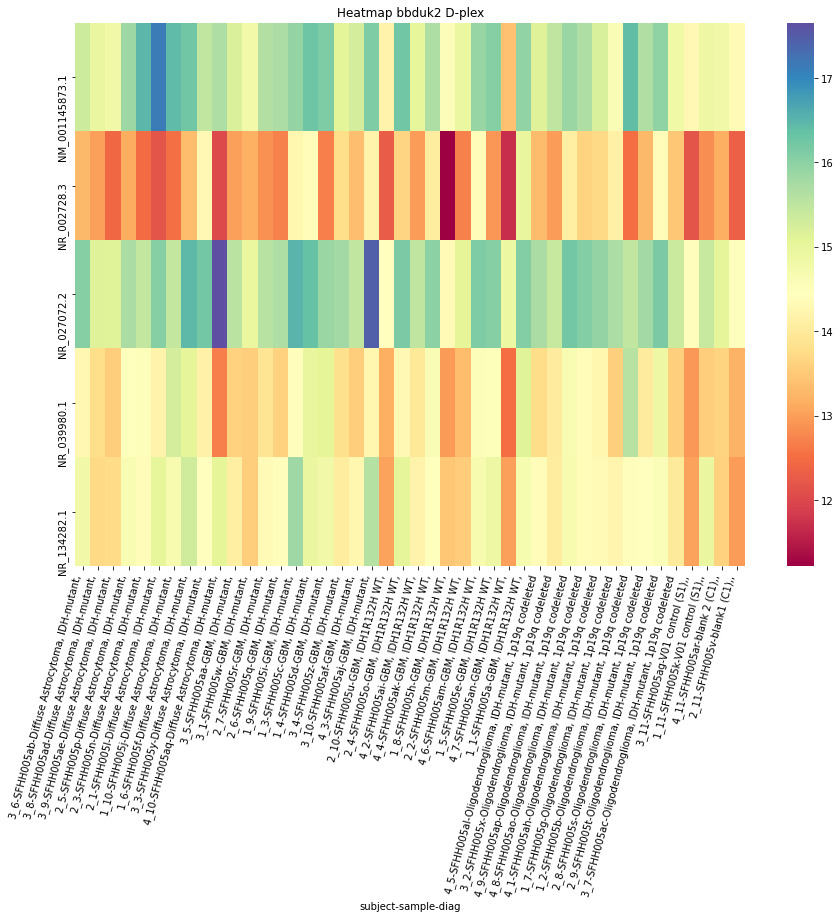

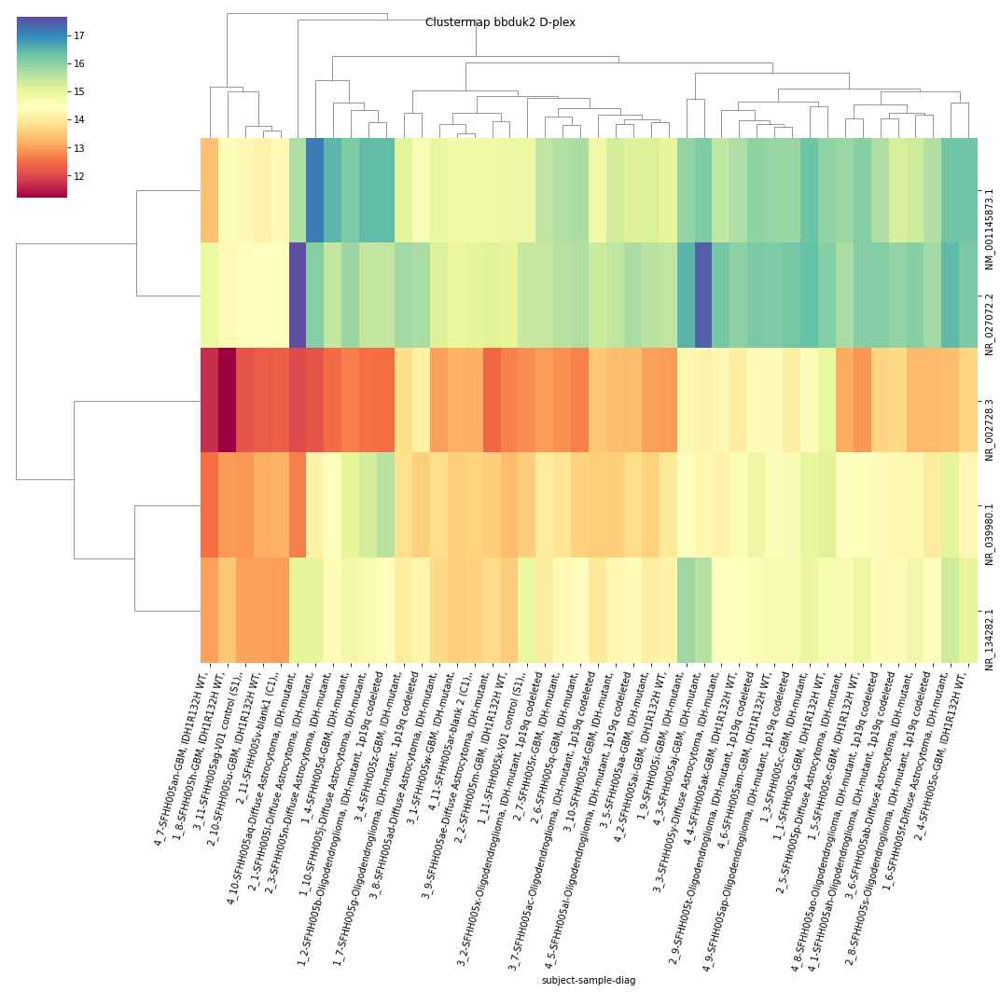

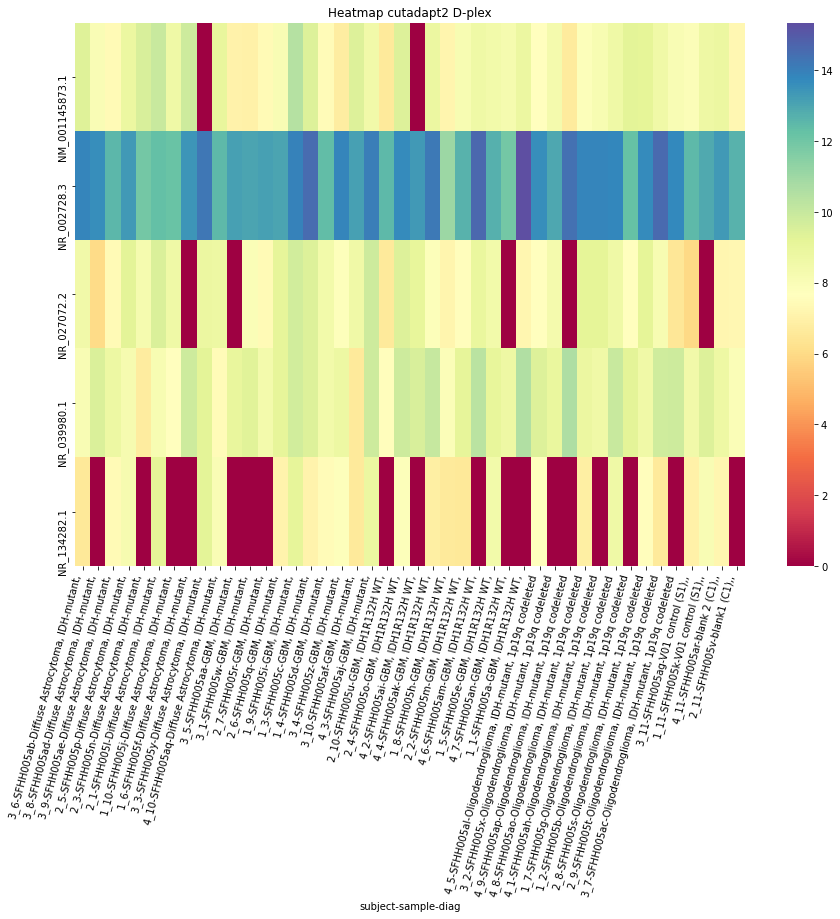

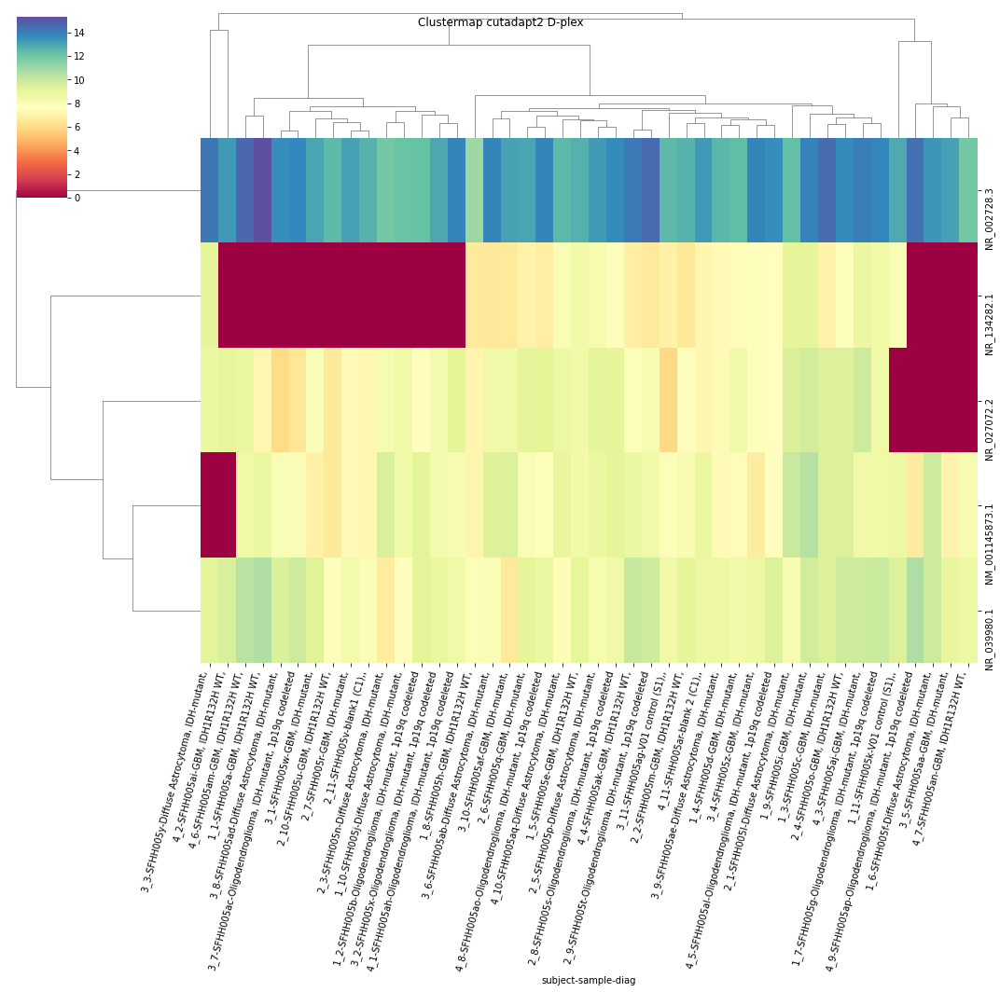

In [65]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

Hominidae D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7553801831551596
	p = 0.09619807801747506
Hominidae D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7553801831551596
	p = 0.09619807801747506


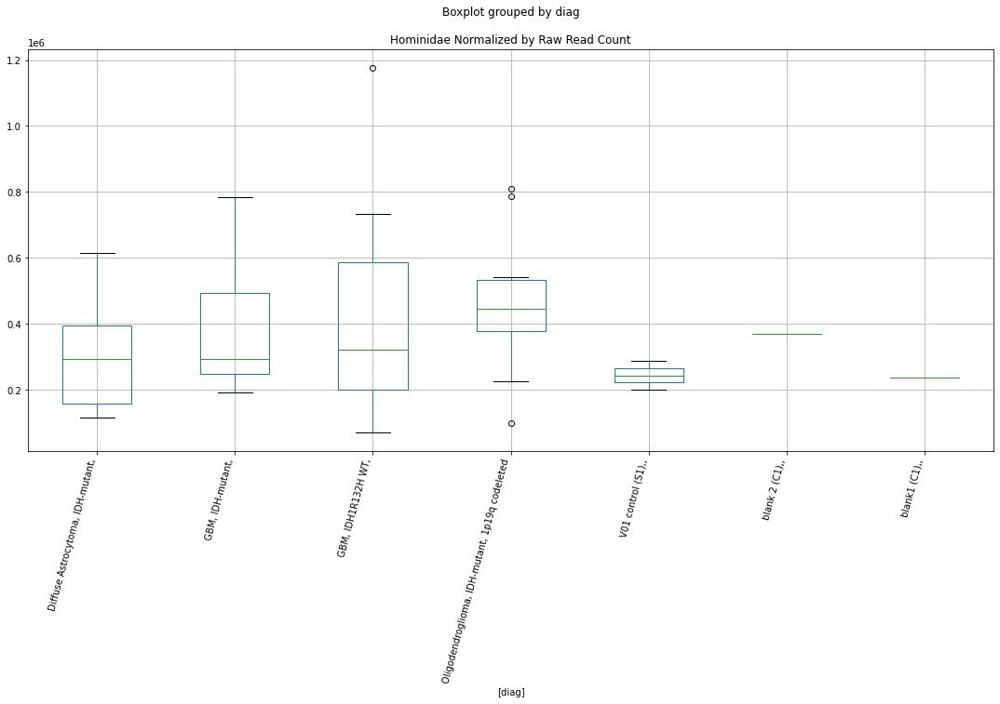

Hominidae D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.753832209978298
	p = 0.09646988365093884
Hominidae D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.753832209978298
	p = 0.09646988365093884


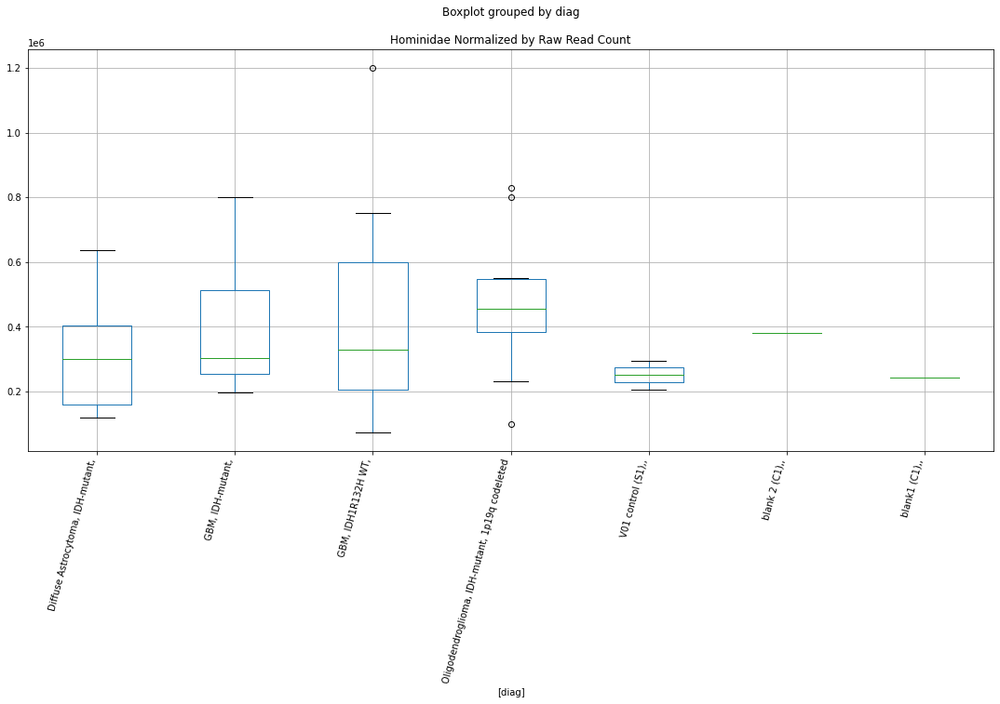

Hominidae D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7540186241705924
	p = 0.09643711629039653
Hominidae D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7540186241705924
	p = 0.09643711629039653


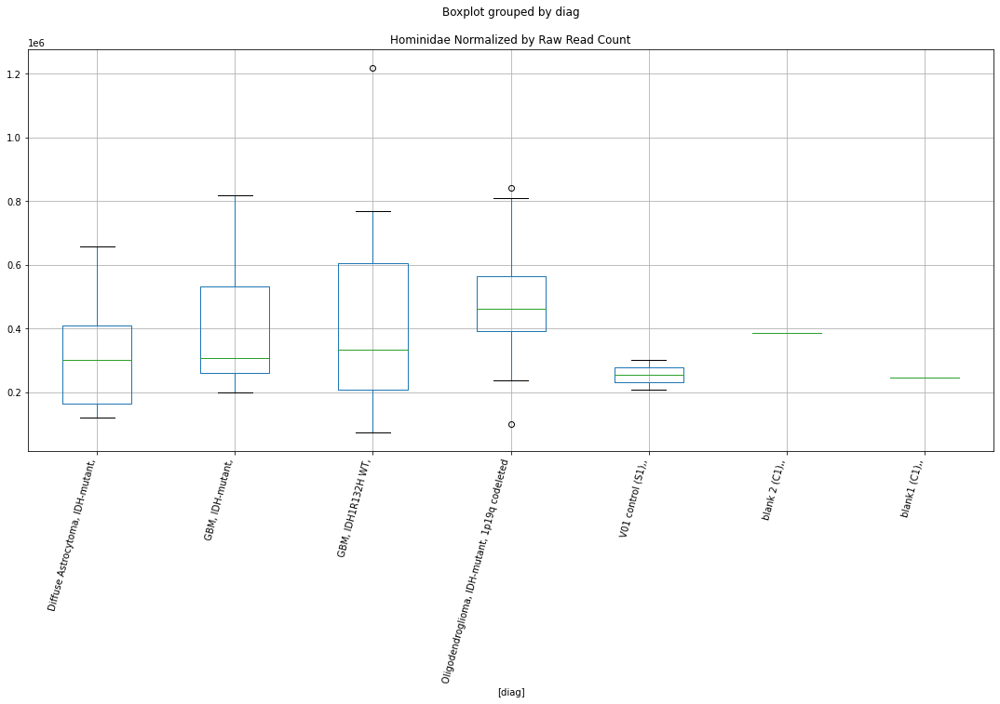

Cercopithecidae D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7361841930115922
	p = 0.09961604520811344
Cercopithecidae D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7361841930115922
	p = 0.09961604520811344


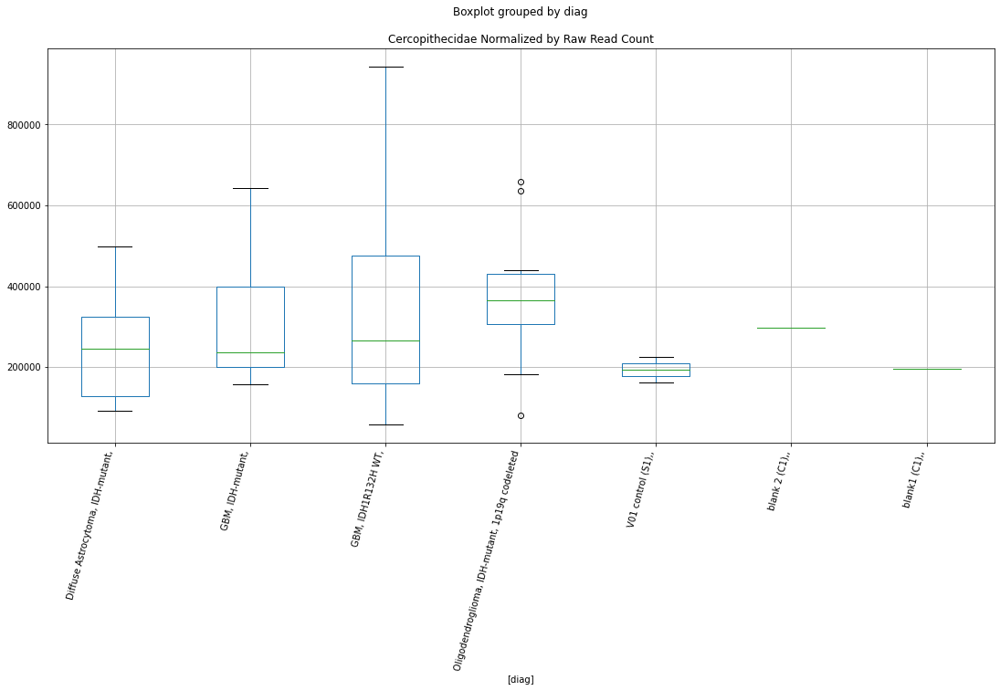

Cercopithecidae D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.738961545355728
	p = 0.09911510540897318
Cercopithecidae D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.738961545355728
	p = 0.09911510540897318


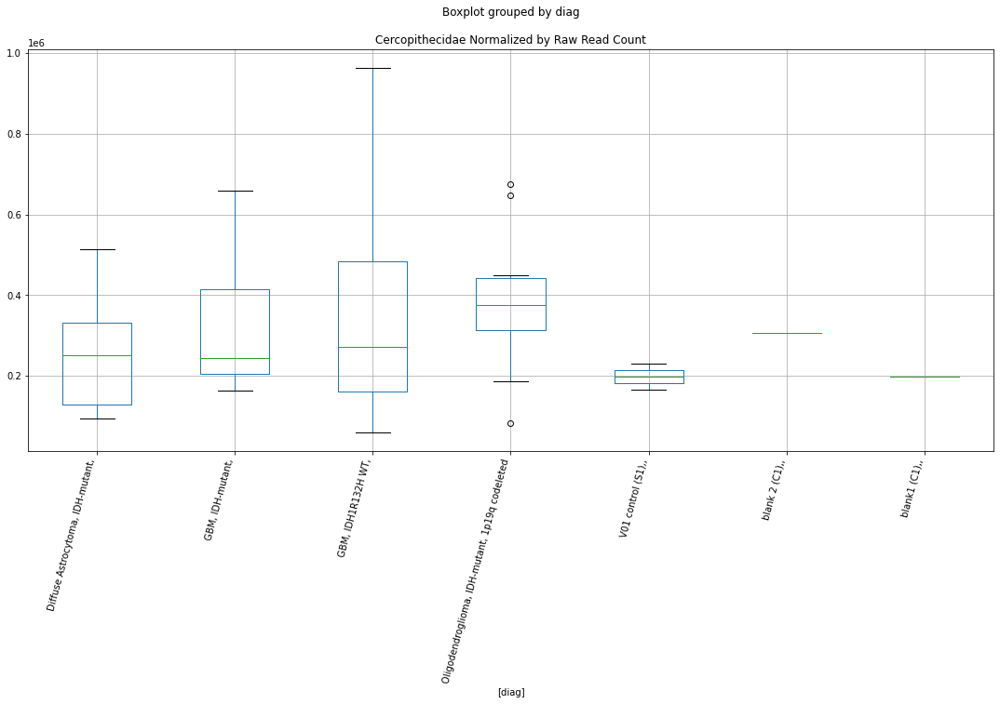

Cercopithecidae D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7463939823388976
	p = 0.09778525882550337
Cercopithecidae D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7463939823388976
	p = 0.09778525882550337


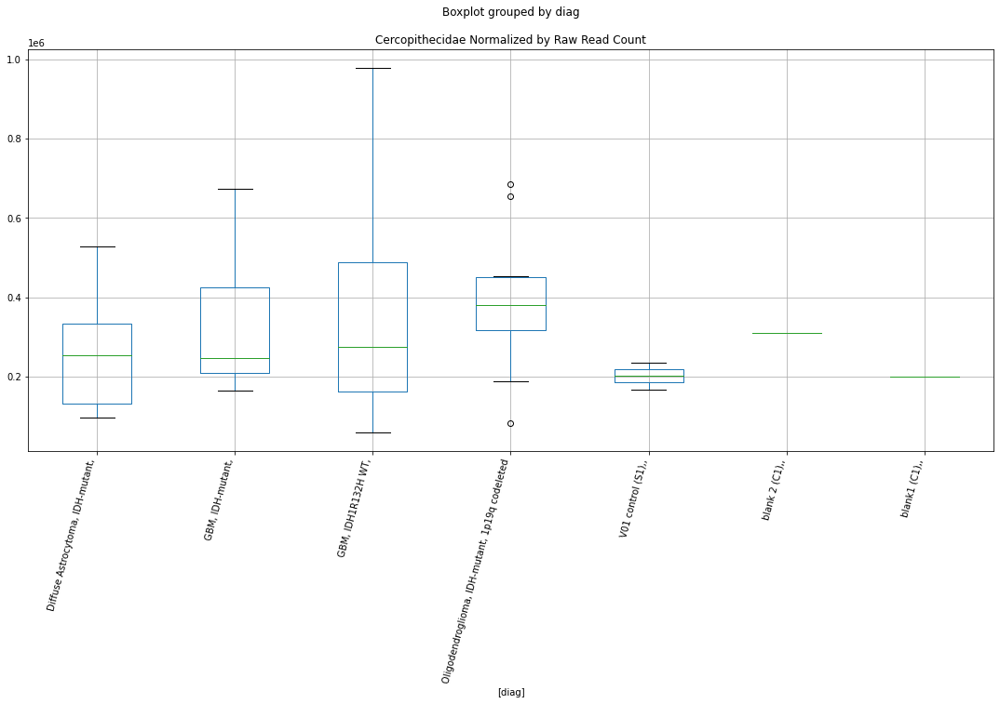

Bacillaceae D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7475824228716326
	p = 0.09757405734033389
Bacillaceae D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7475824228716326
	p = 0.09757405734033389


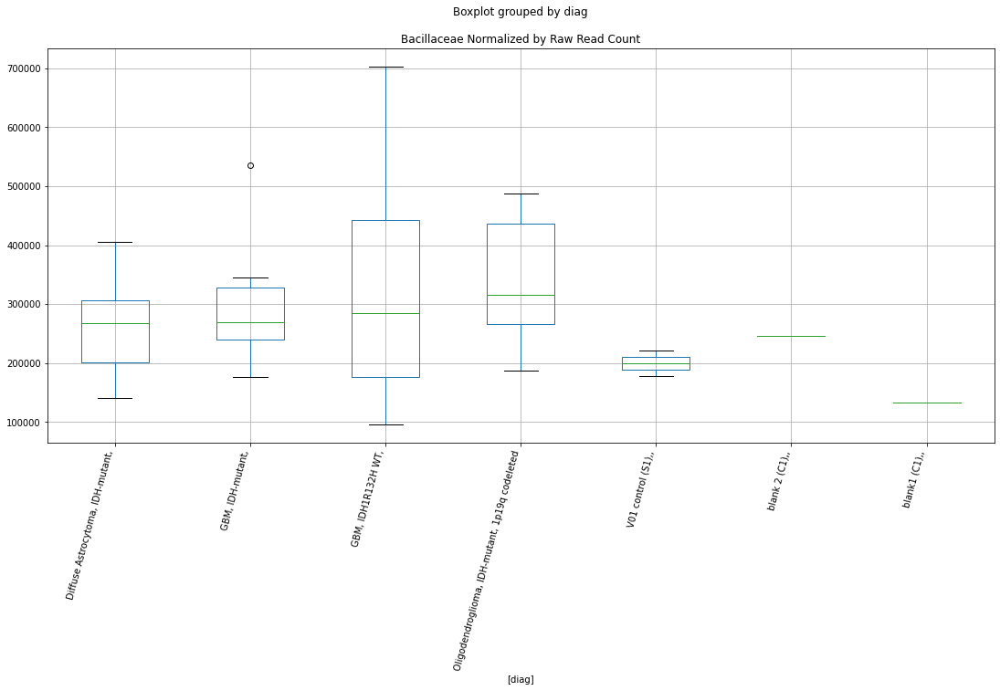

Enterococcaceae D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8812854273958204
	p = 0.07620921374528046
Enterococcaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8812854273958204
	p = 0.07620921374528046


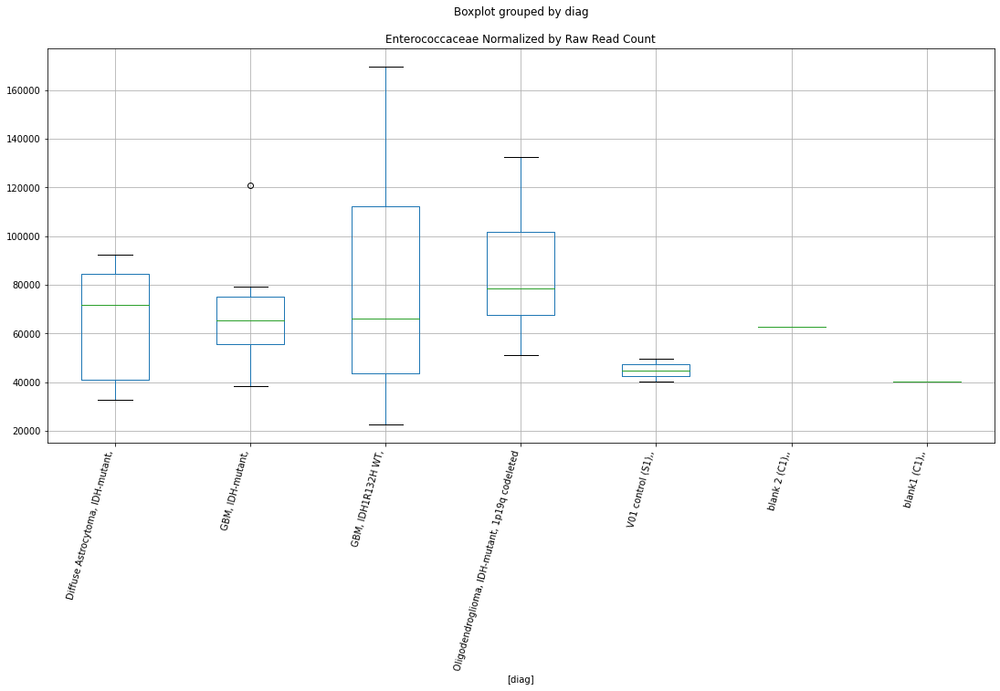

Enterococcaceae D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8768688005516754
	p = 0.07684307601833548
Enterococcaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8768688005516754
	p = 0.07684307601833548


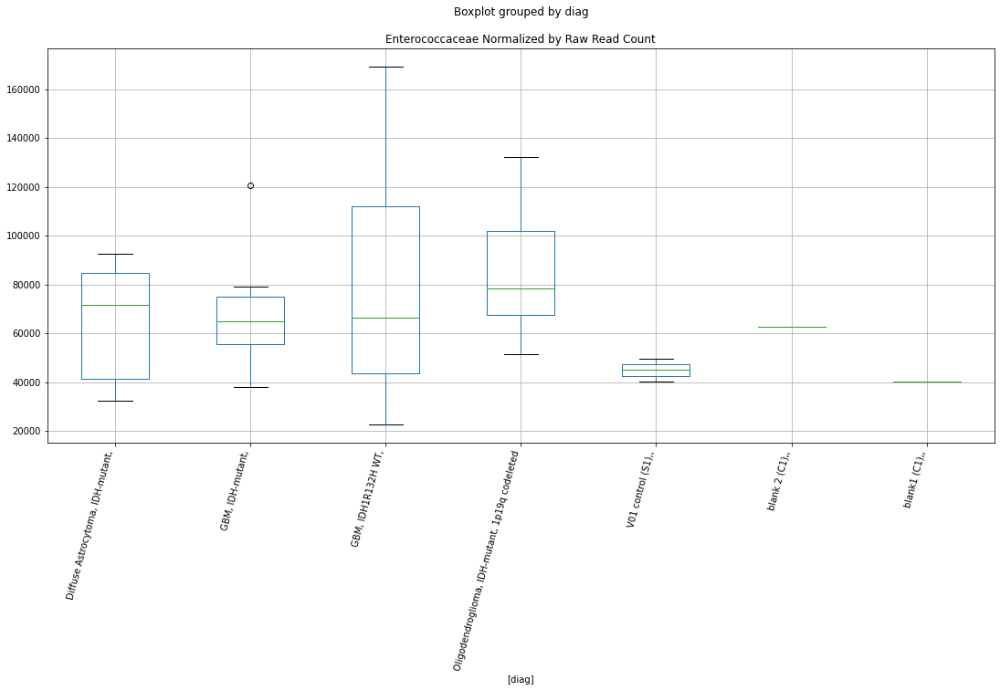

Enterococcaceae D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.017846598070575
	p = 0.0587662805379098
Enterococcaceae D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.017846598070575
	p = 0.0587662805379098


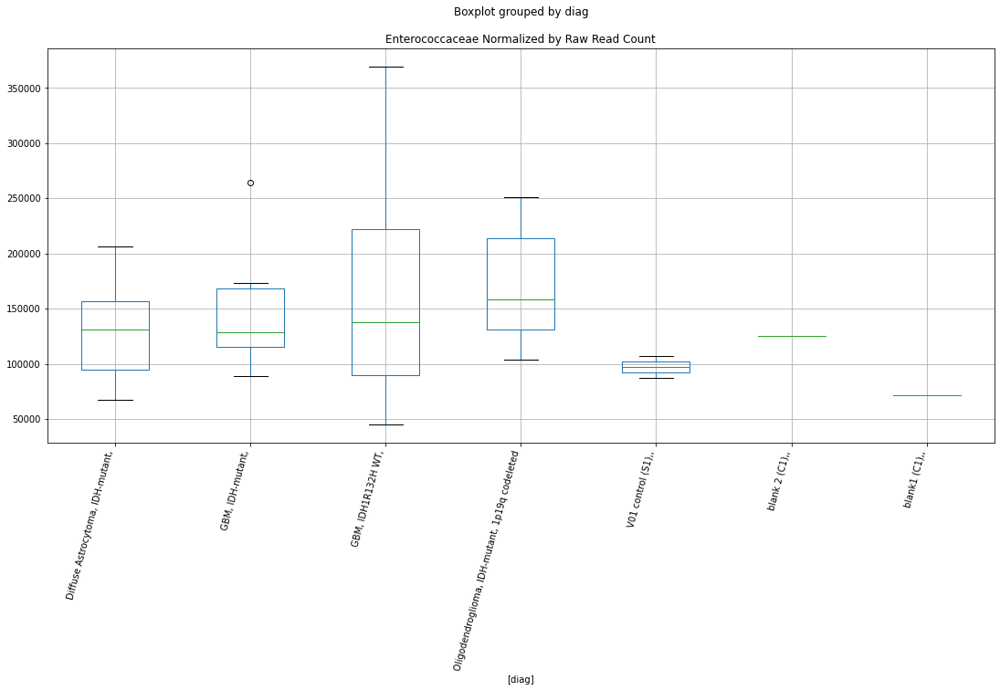

Enterococcaceae D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.031118310575437
	p = 0.05727869149902353
Enterococcaceae D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.031118310575437
	p = 0.05727869149902353


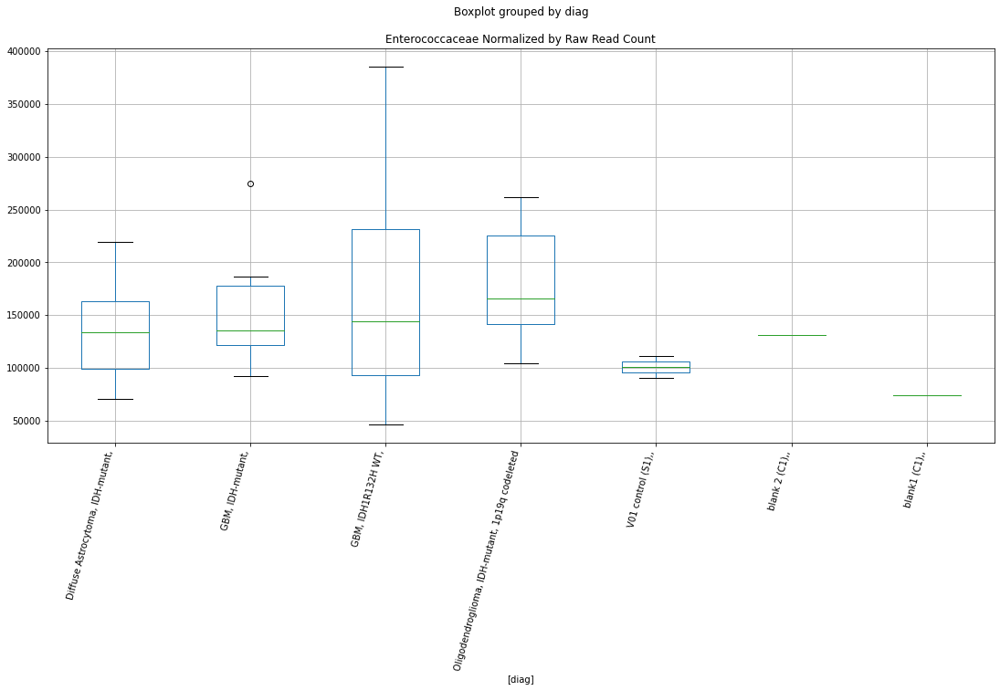

Enterococcaceae D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.038953244241659
	p = 0.05641651648166928
Enterococcaceae D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.038953244241659
	p = 0.05641651648166928


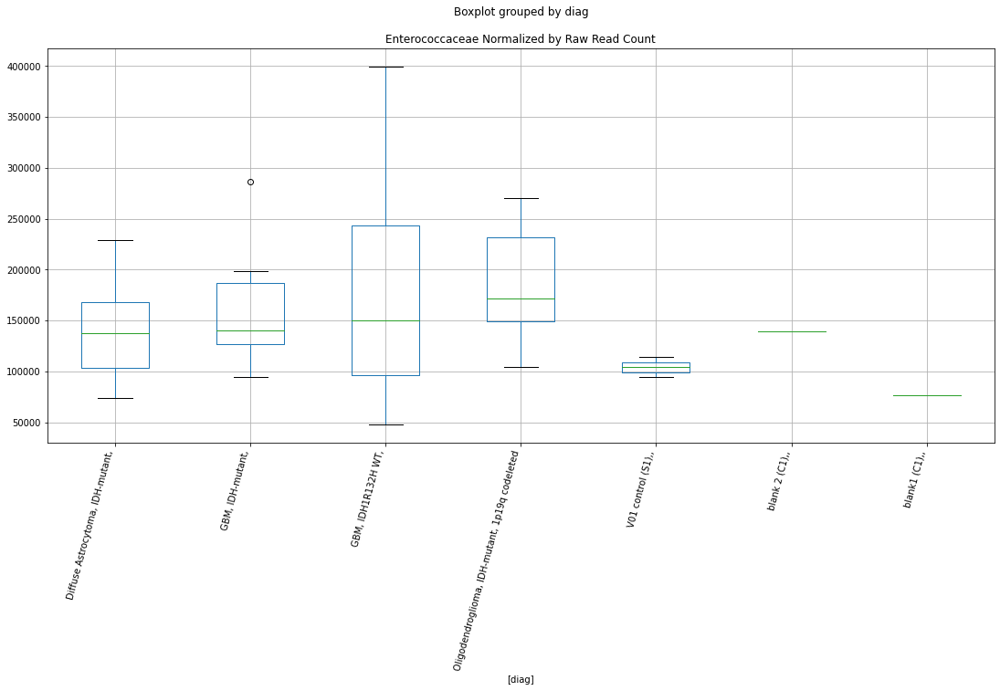

Mycobacteriaceae D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7375051738529361
	p = 0.09937751272927658
Mycobacteriaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7375051738529361
	p = 0.09937751272927658


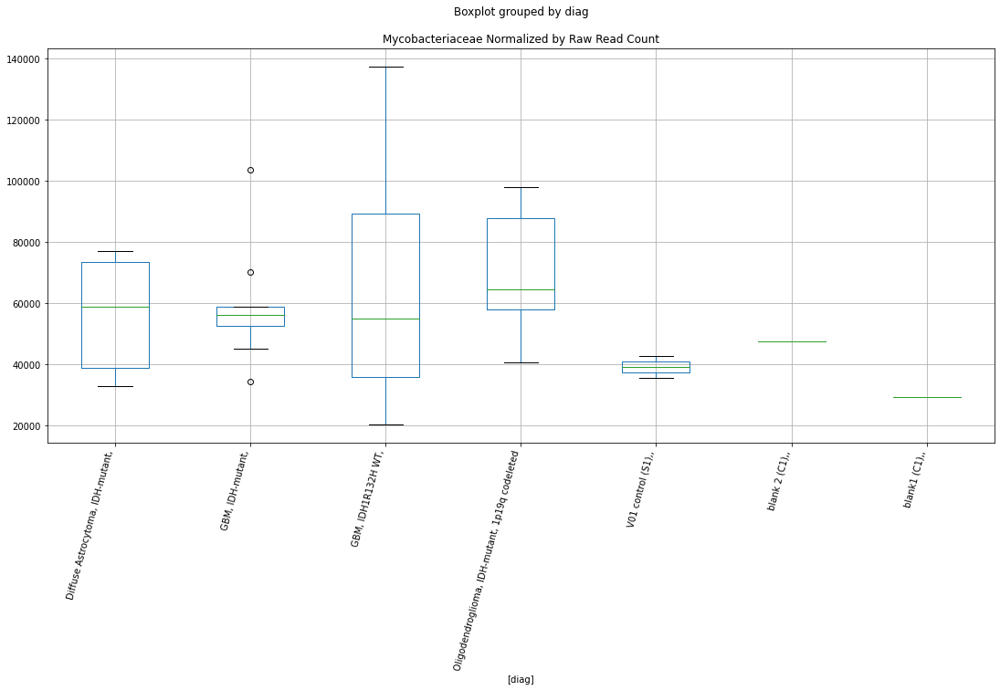

Mycobacteriaceae D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7548386739113575
	p = 0.09629308491495307
Mycobacteriaceae D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7548386739113575
	p = 0.09629308491495307


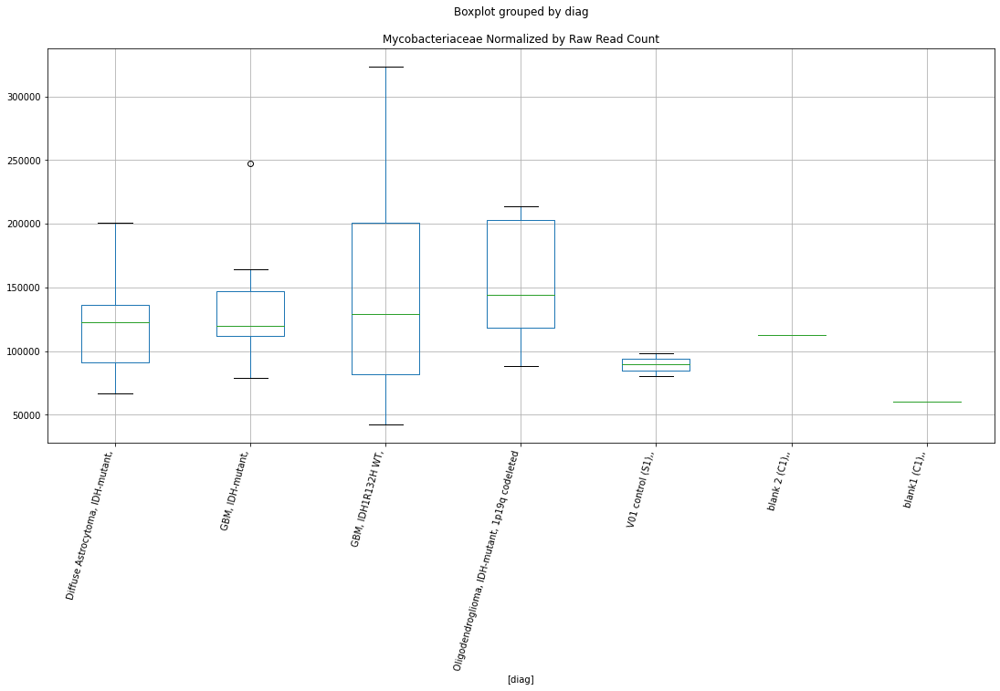

Hylobatidae D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.802336274299533
	p = 0.08826348999057552
Hylobatidae D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.802336274299533
	p = 0.08826348999057552


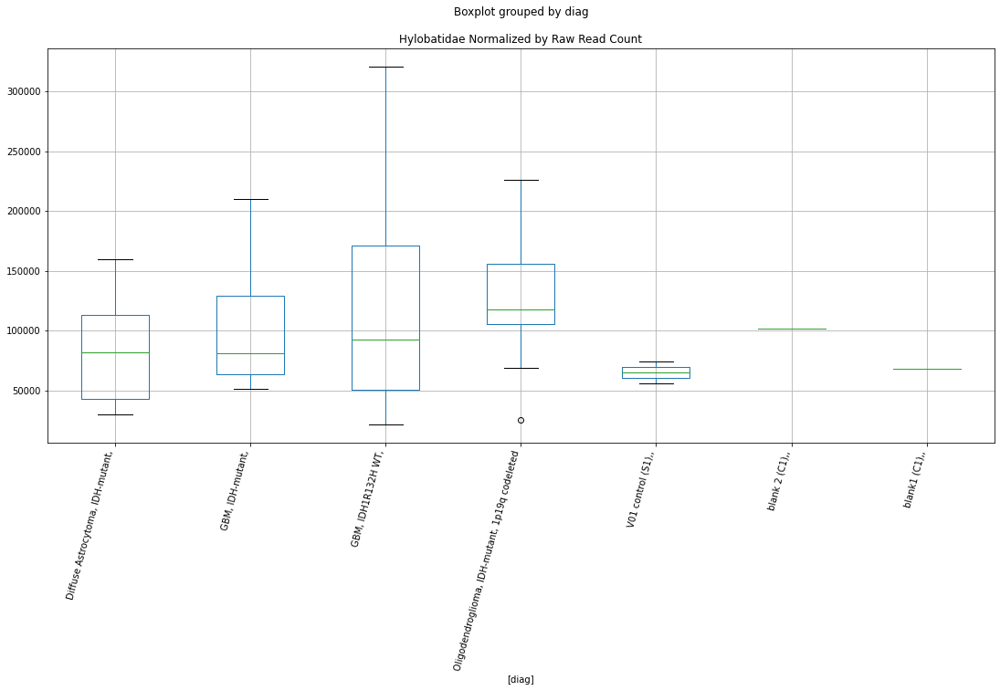

Hylobatidae D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8258567493451785
	p = 0.08450845402374871
Hylobatidae D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8258567493451785
	p = 0.08450845402374871


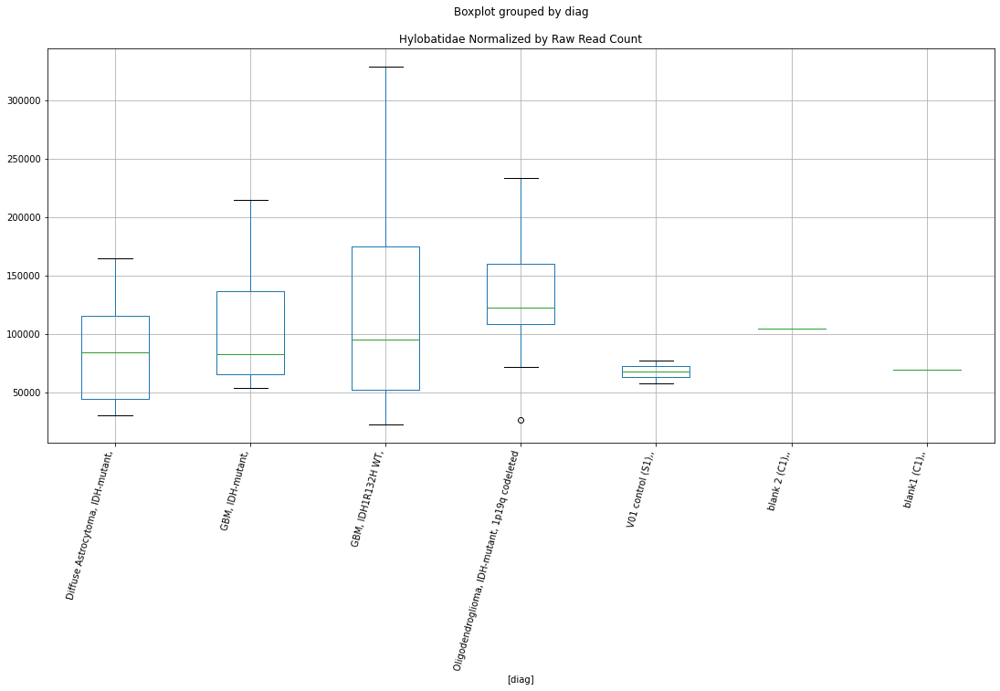

Hylobatidae D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7892257420654882
	p = 0.09041928033456655
Hylobatidae D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7892257420654882
	p = 0.09041928033456655


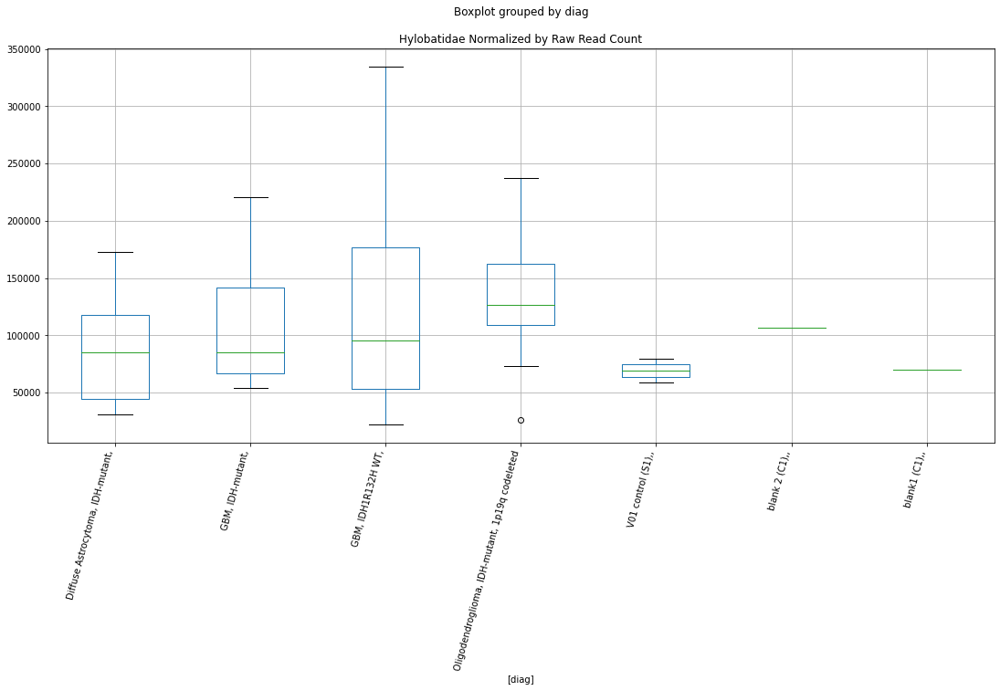

Listeriaceae D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7990694933983735
	p = 0.0887964087641889
Listeriaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7990694933983735
	p = 0.0887964087641889


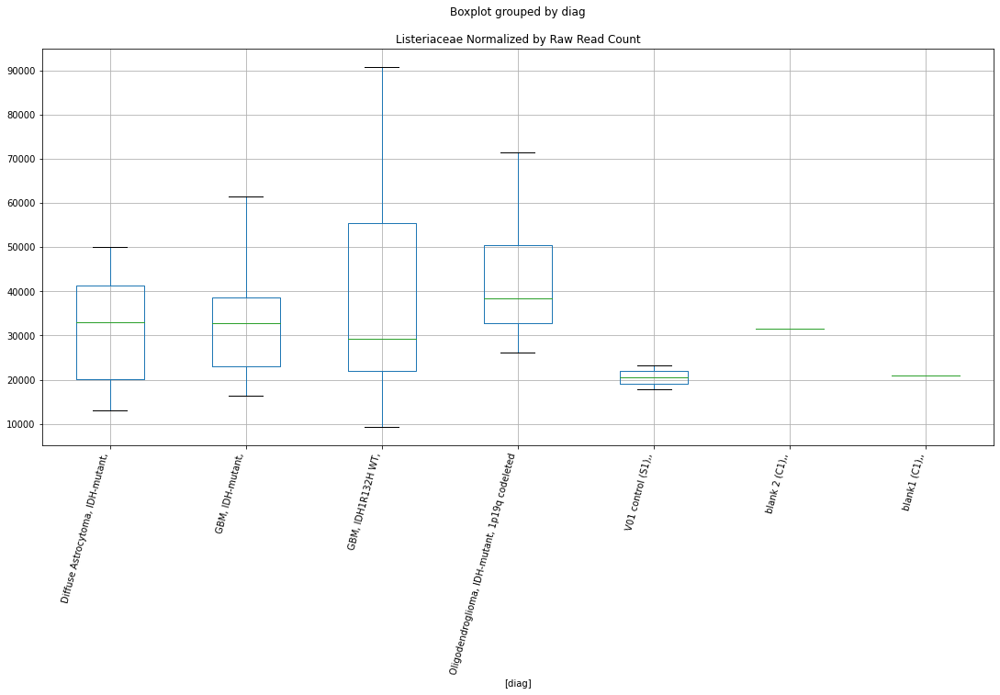

Listeriaceae D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.798207070481931
	p = 0.08893756644444627
Listeriaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.798207070481931
	p = 0.08893756644444627


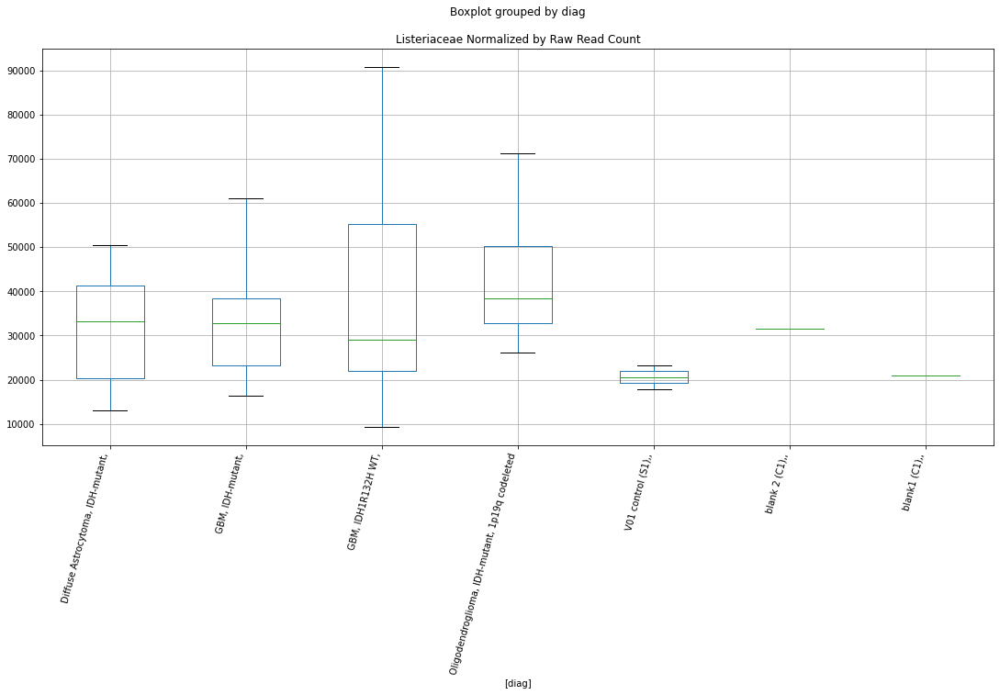

Listeriaceae D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.913674971727064
	p = 0.0717004893390145
Listeriaceae D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.913674971727064
	p = 0.0717004893390145


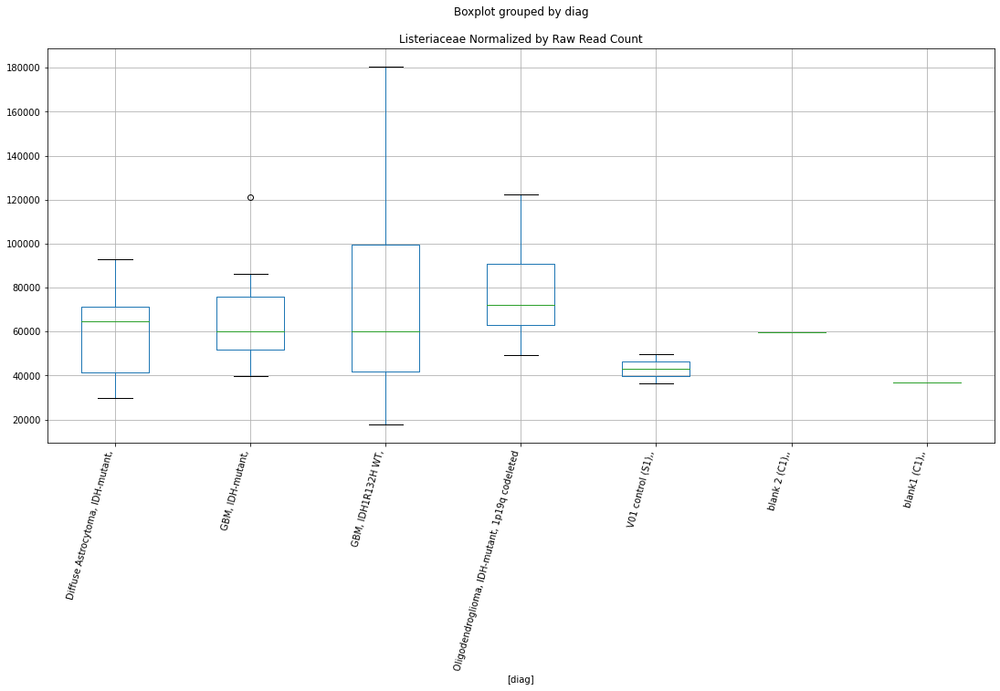

Listeriaceae D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9884120253875261
	p = 0.062190266791074776
Listeriaceae D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9884120253875261
	p = 0.062190266791074776


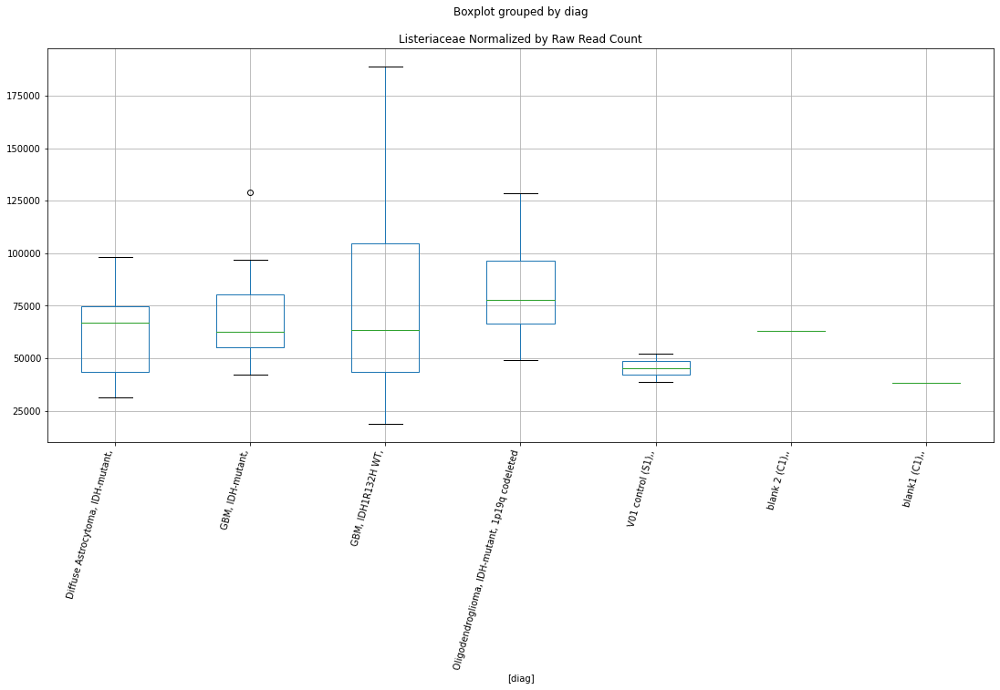

Listeriaceae D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0294096107935444
	p = 0.05746829203580208
Listeriaceae D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0294096107935444
	p = 0.05746829203580208


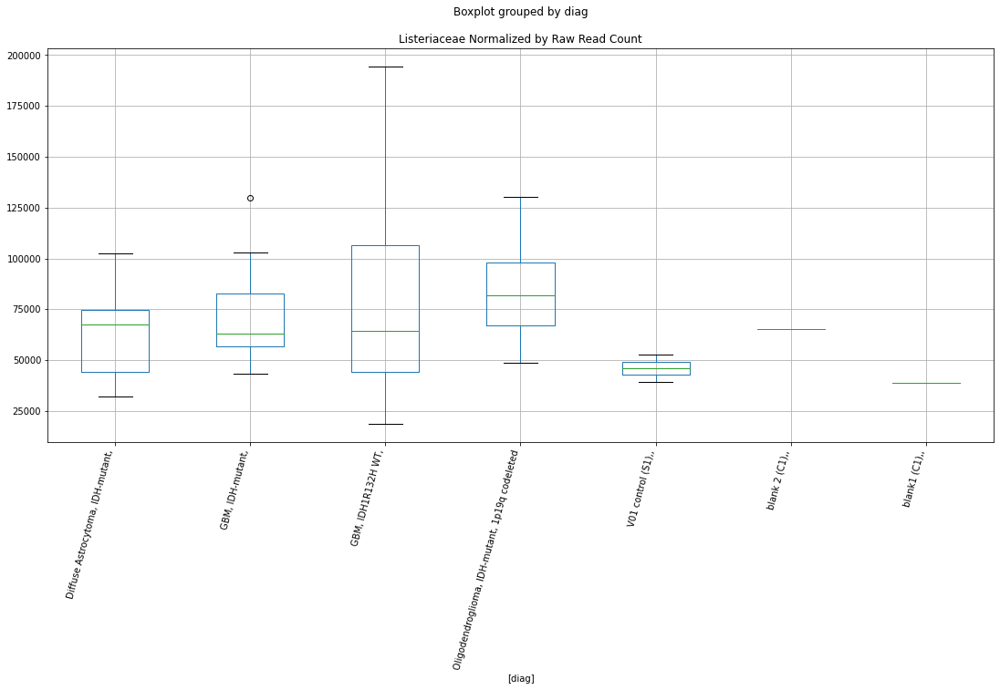

In [66]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in diamond_families:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Raw Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


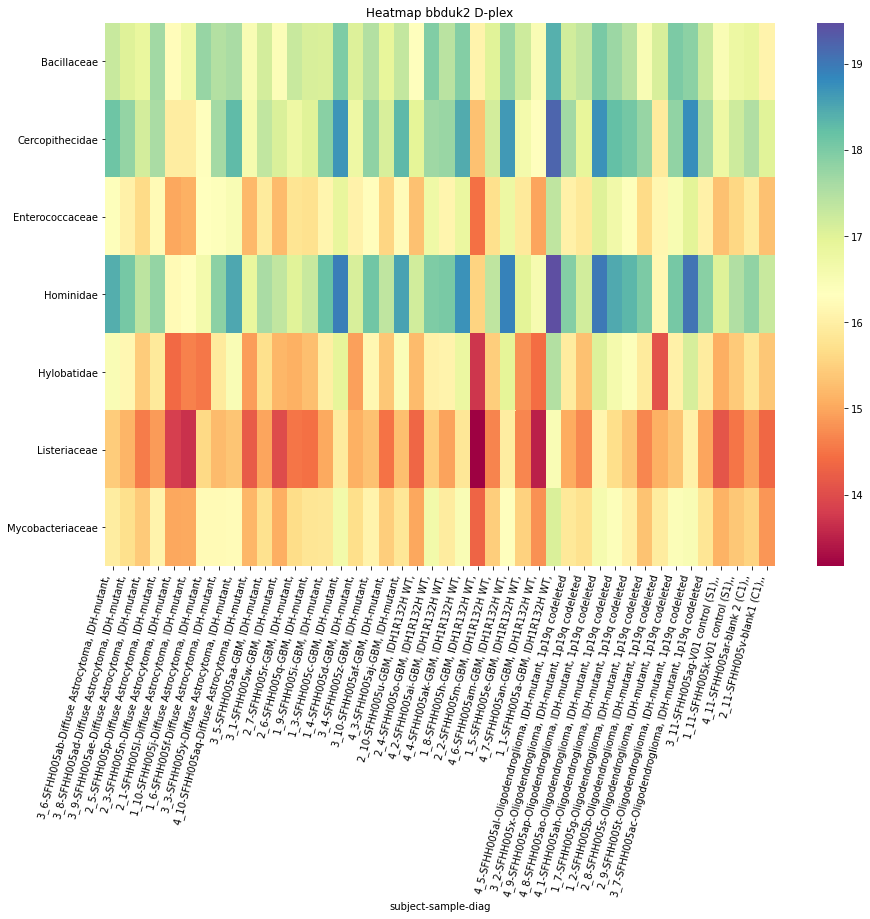

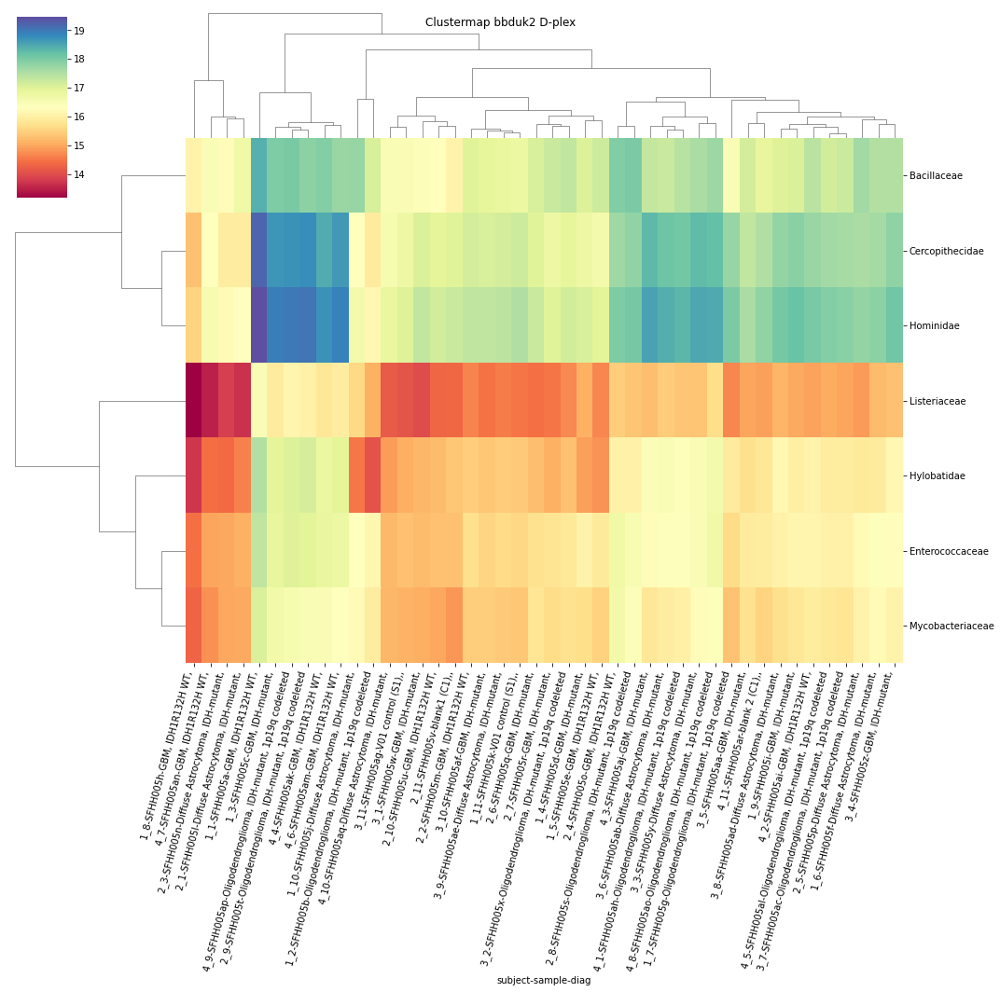

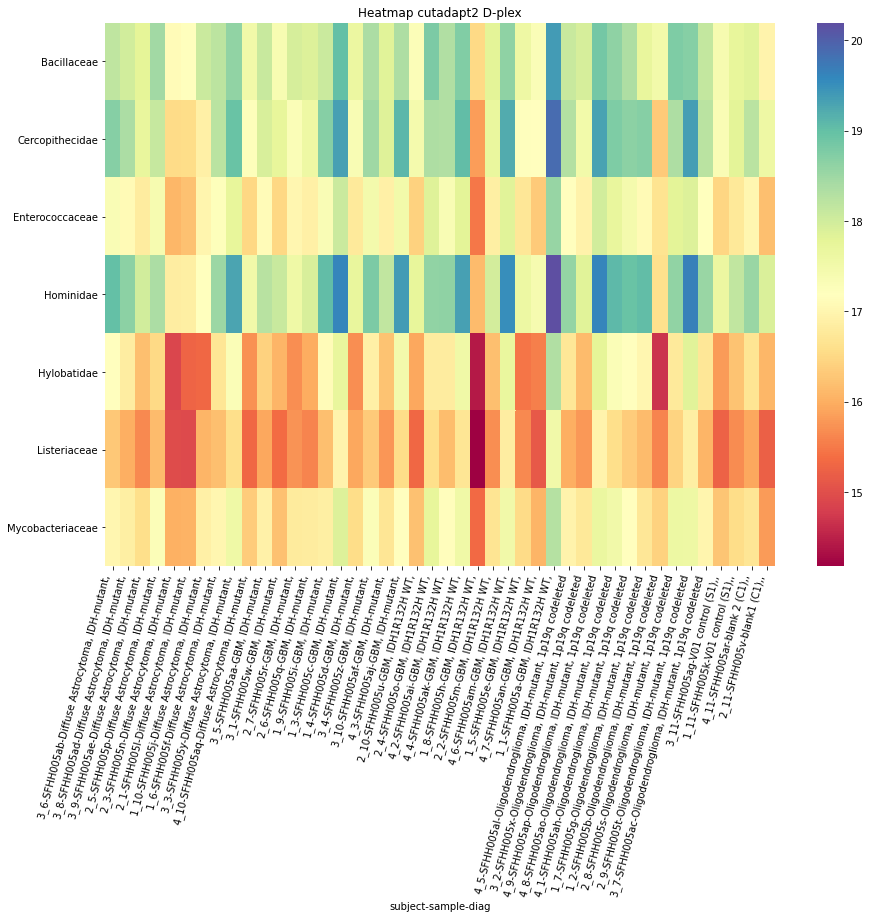

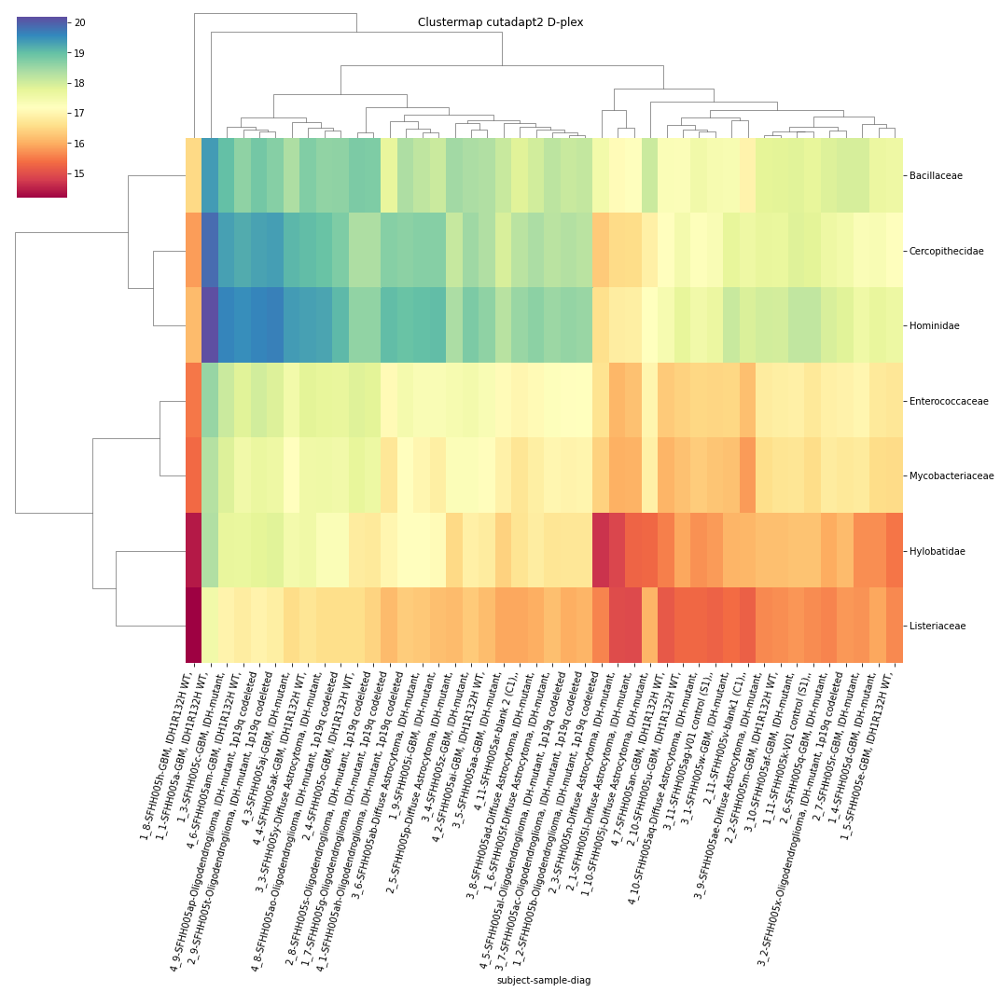

In [67]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

rfMIR D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.745886443535924
	p = 0.09787557578111238
rfMIR D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.745886443535924
	p = 0.09787557578111238


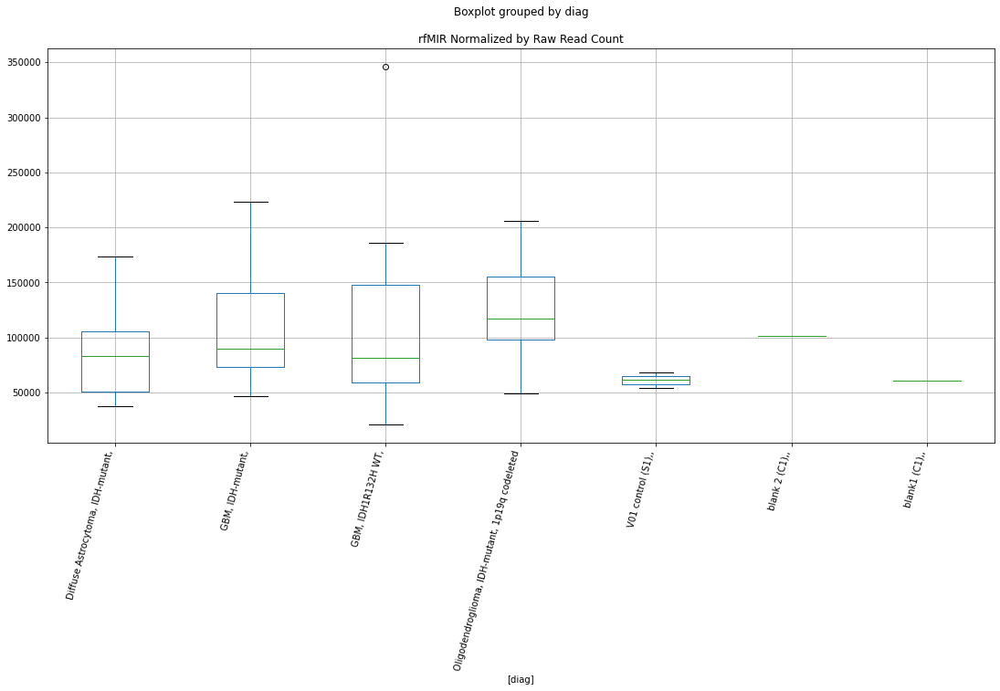

rfTcMar-Tigger D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8203081668512167
	p = 0.08538143044625025
rfTcMar-Tigger D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8203081668512167
	p = 0.08538143044625025


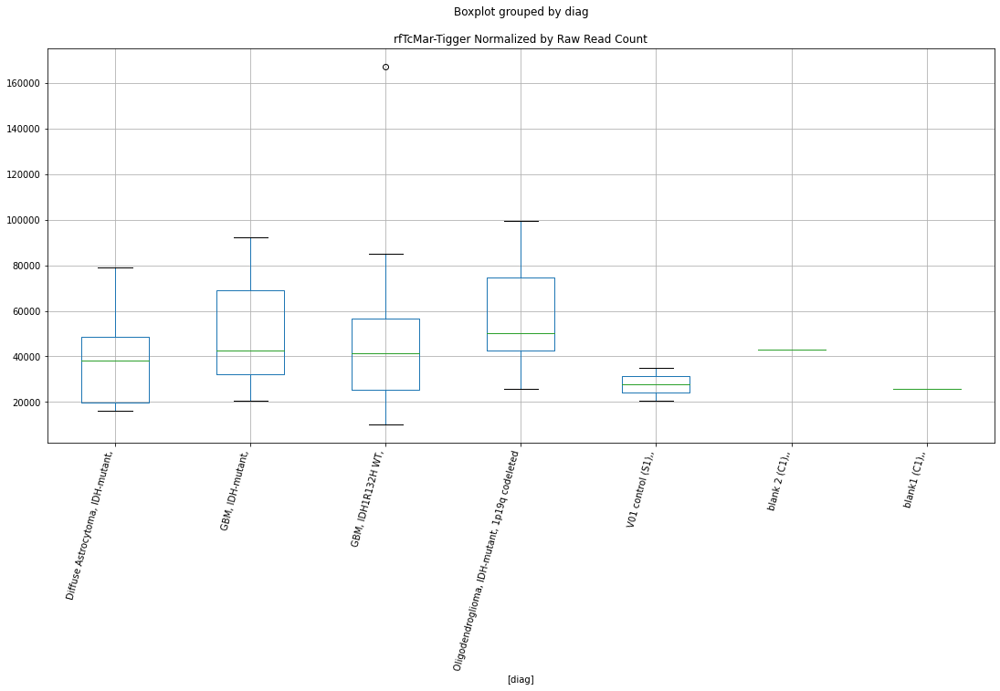

rfTcMar-Tigger D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.845444483283143
	p = 0.08148898715979447
rfTcMar-Tigger D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.845444483283143
	p = 0.08148898715979447


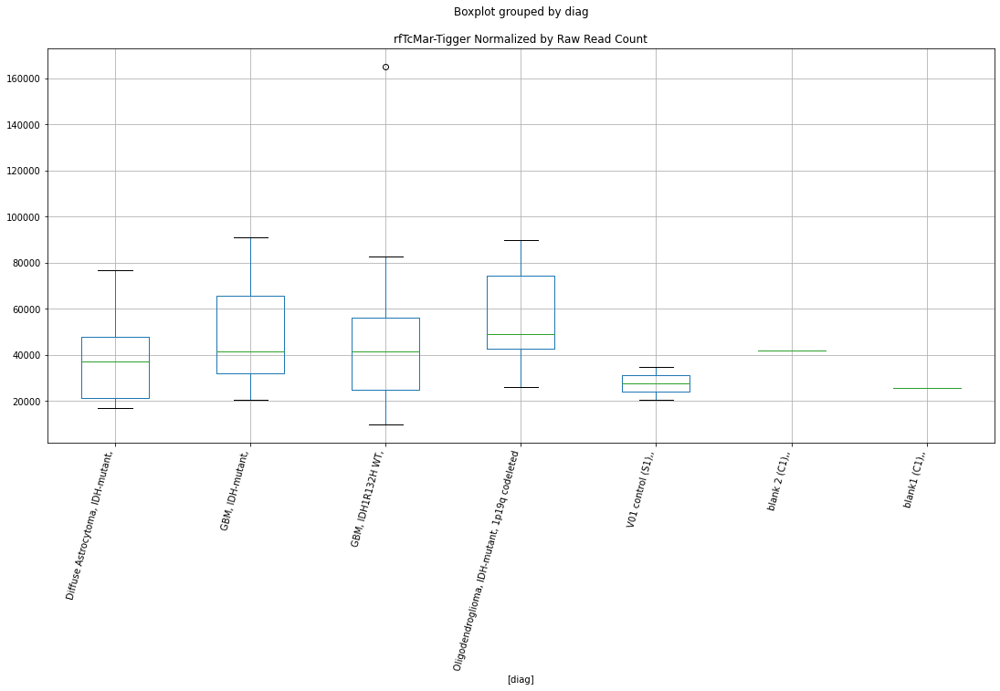

rfTcMar-Tigger D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.90547847675877
	p = 0.07281851338155877
rfTcMar-Tigger D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.90547847675877
	p = 0.07281851338155877


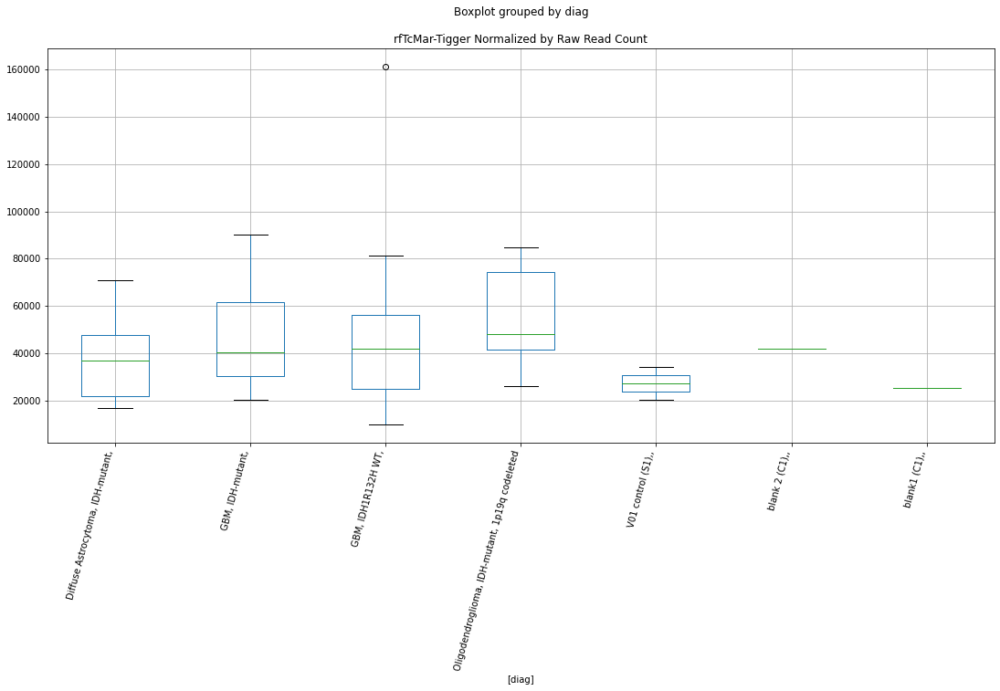

rfGypsy D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9880638247329545
	p = 0.06223182156401764
rfGypsy D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9880638247329545
	p = 0.06223182156401764


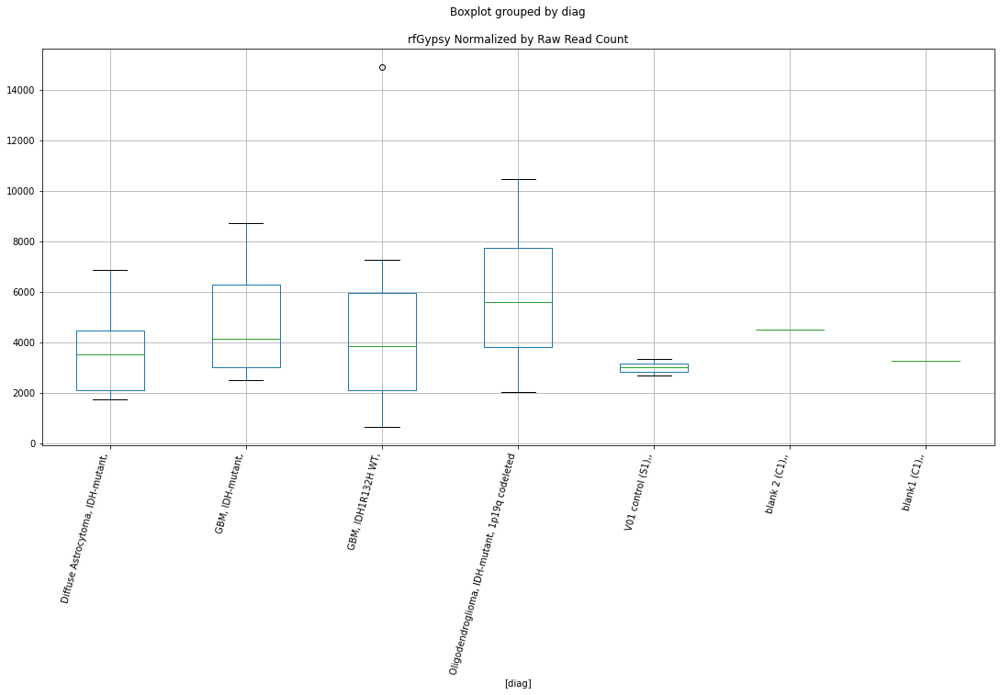

rfGypsy D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9225236089905227
	p = 0.07051065399080132
rfGypsy D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9225236089905227
	p = 0.07051065399080132


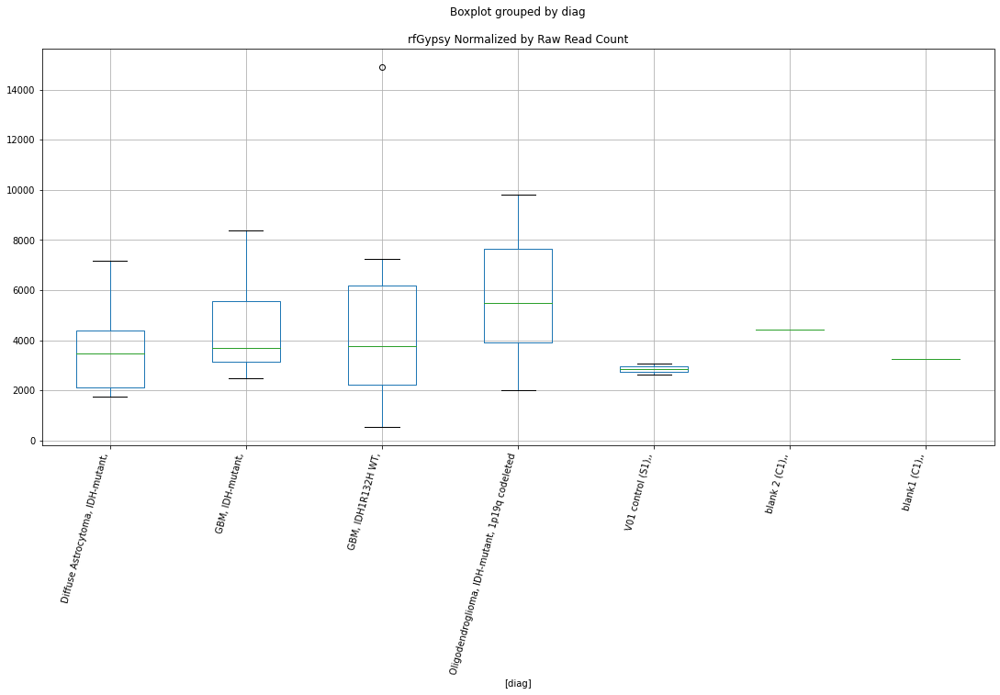

rfGypsy D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0475502822488676
	p = 0.05548396978857456
rfGypsy D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0475502822488676
	p = 0.05548396978857456


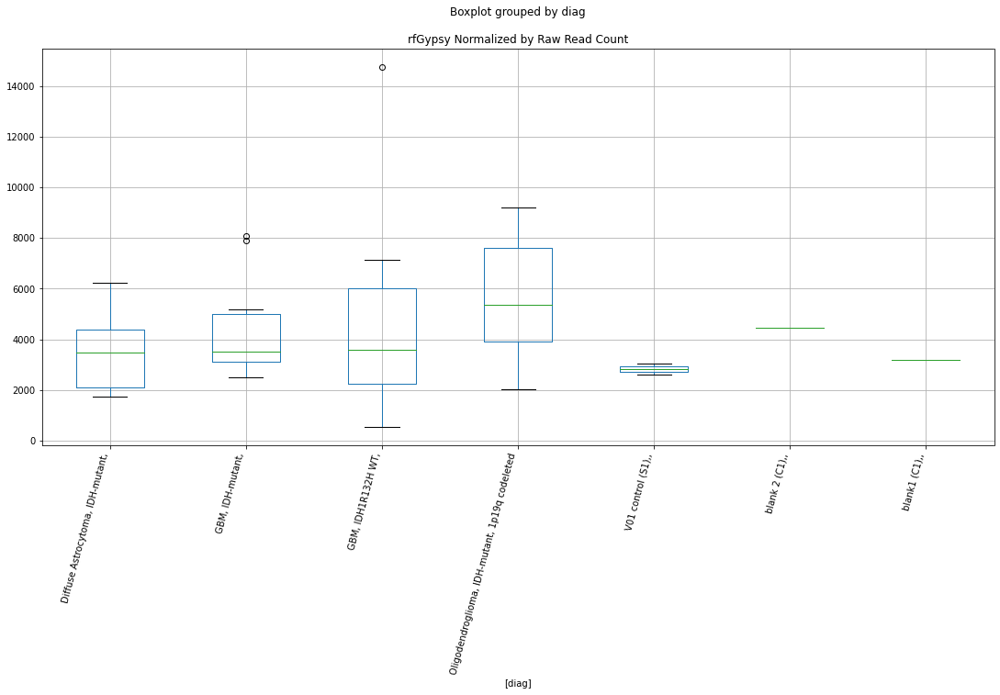

rfhAT-Blackjack D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.1892997264490983
	p = 0.0419937790529031
rfhAT-Blackjack D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.1892997264490983
	p = 0.0419937790529031


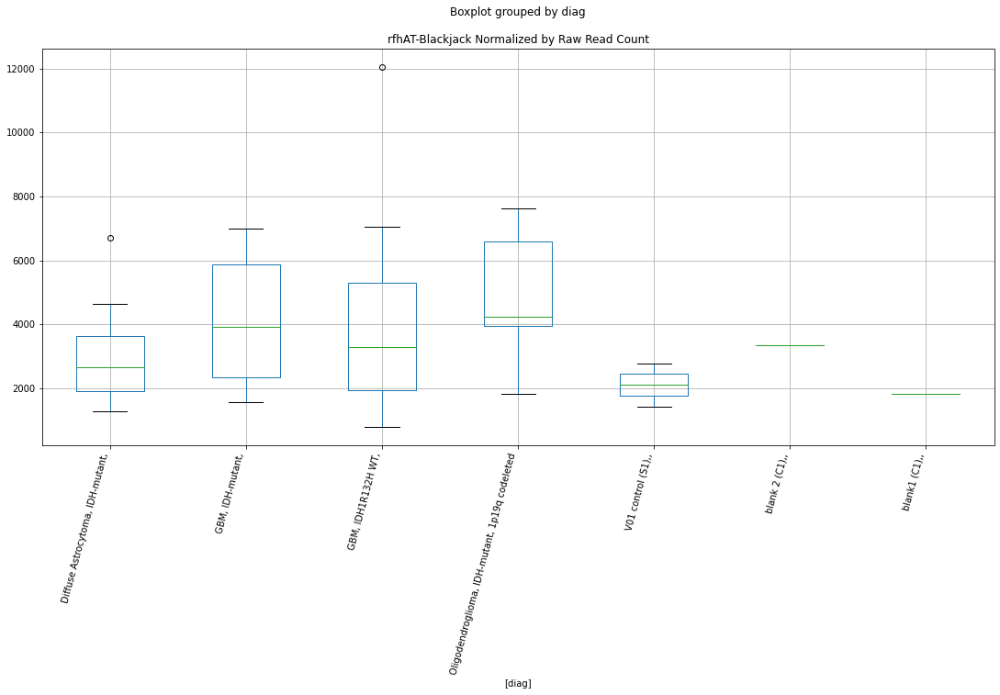

rfhAT-Blackjack D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.195674499899407
	p = 0.04146433577315895
rfhAT-Blackjack D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.195674499899407
	p = 0.04146433577315895


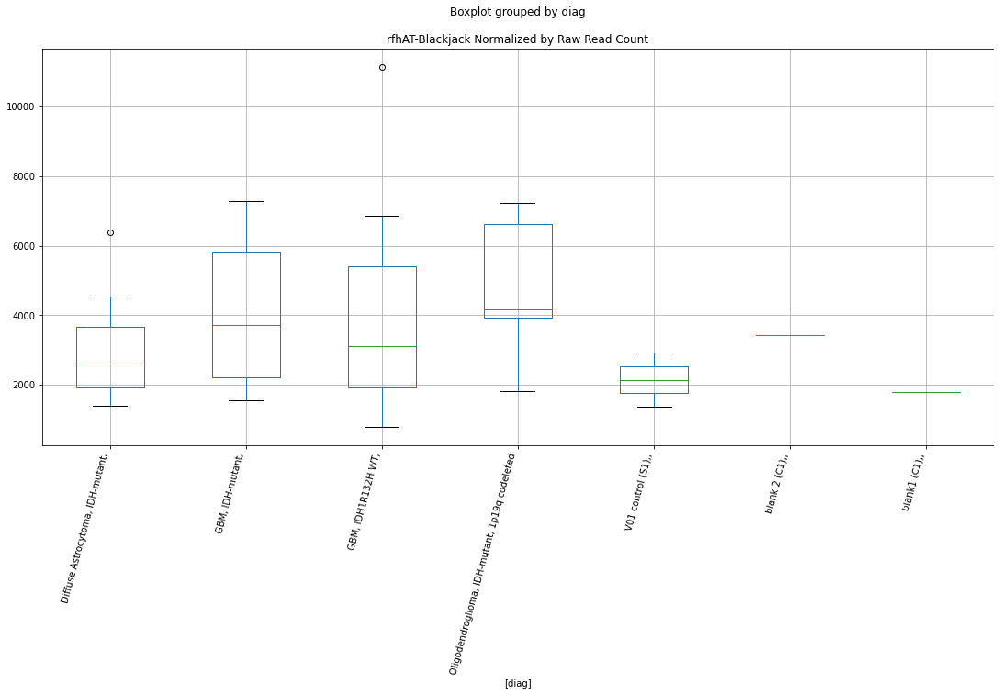

rfhAT-Blackjack D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.2496414696891183
	p = 0.03722198171362518
rfhAT-Blackjack D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.2496414696891183
	p = 0.03722198171362518


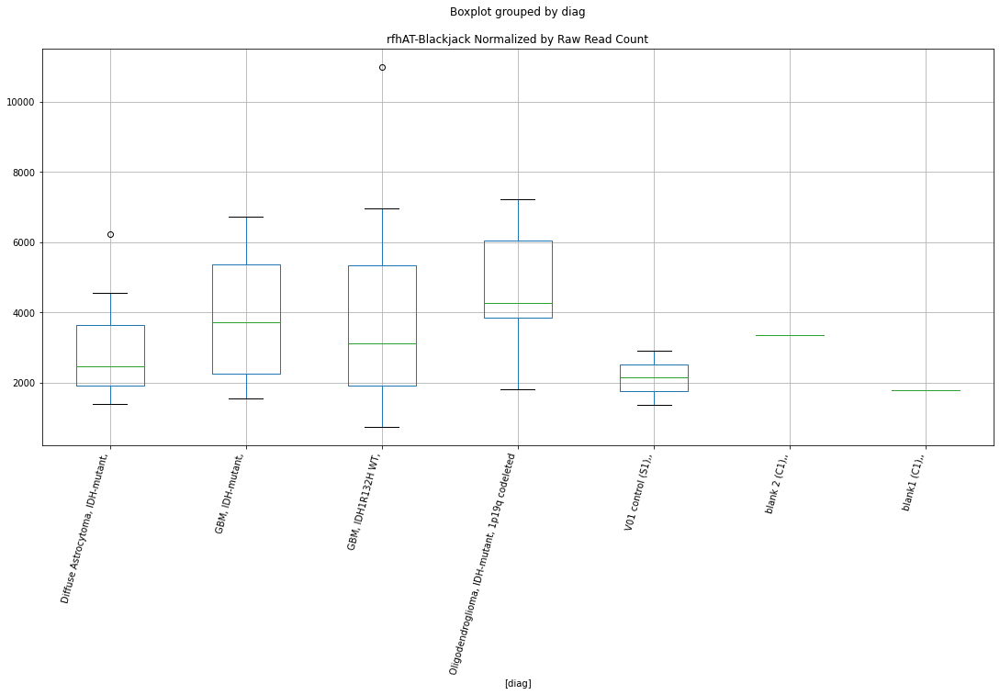

rfhAT D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8396885909123388
	p = 0.08236626529765004
rfhAT D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8396885909123388
	p = 0.08236626529765004


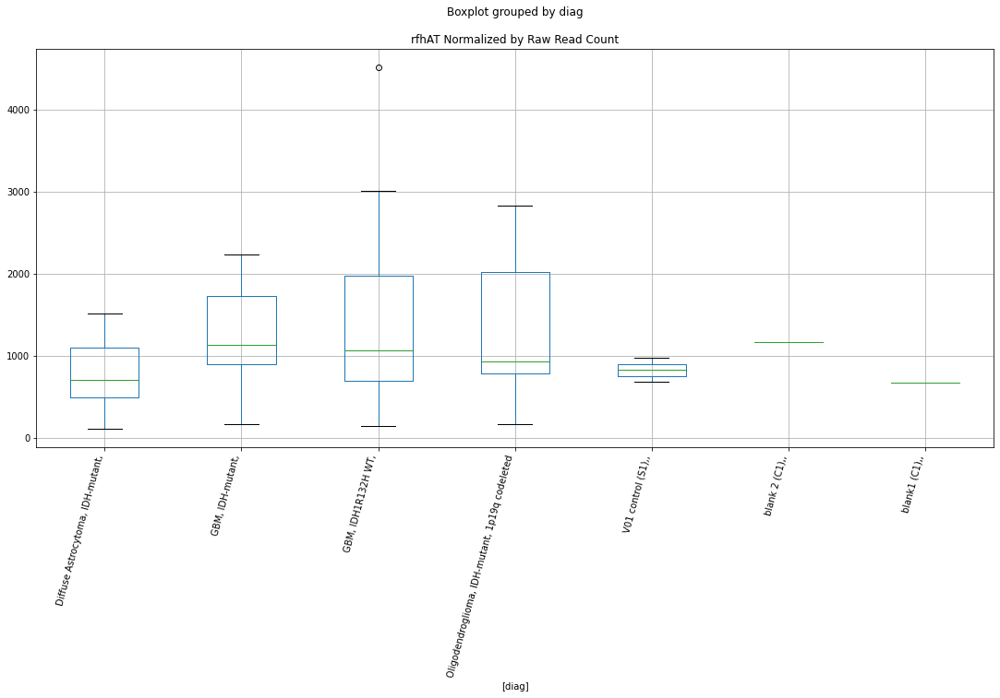

rfGypsy? D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7560029527019196
	p = 0.09608891471903253
rfGypsy? D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7560029527019196
	p = 0.09608891471903253


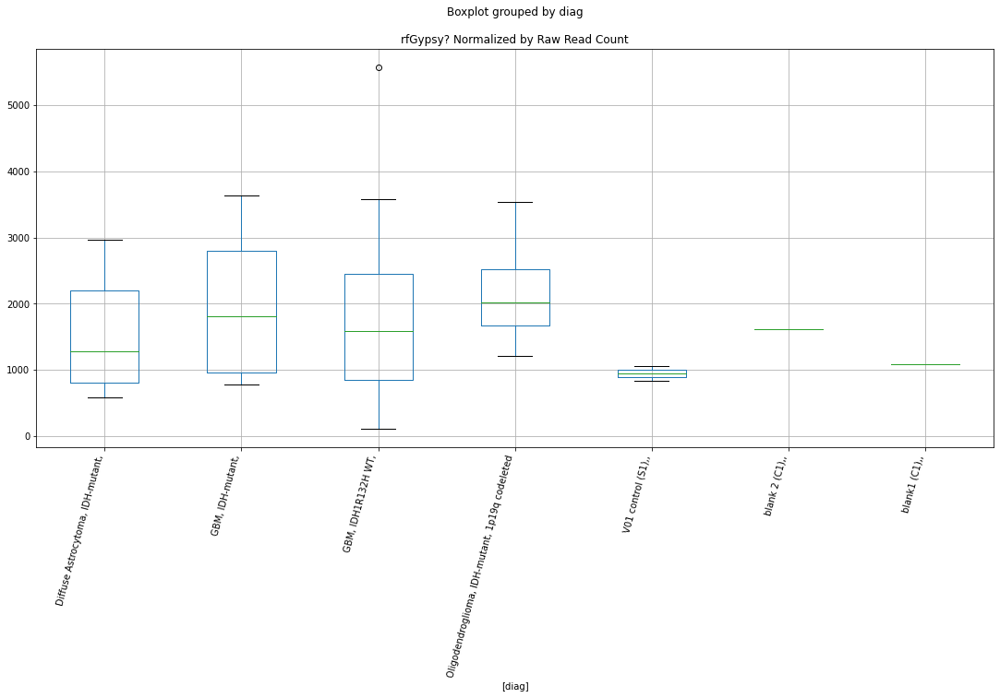

rfGypsy? D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8961404726007216
	p = 0.07411107122511265
rfGypsy? D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8961404726007216
	p = 0.07411107122511265


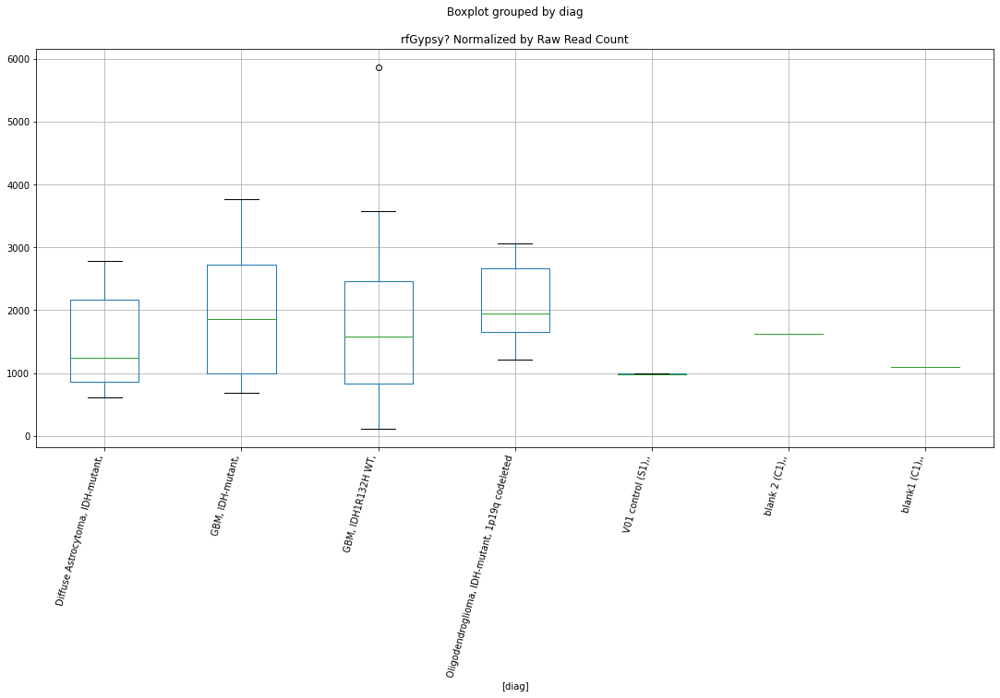

rfGypsy? D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.772301646258672
	p = 0.09326996544331016
rfGypsy? D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.772301646258672
	p = 0.09326996544331016


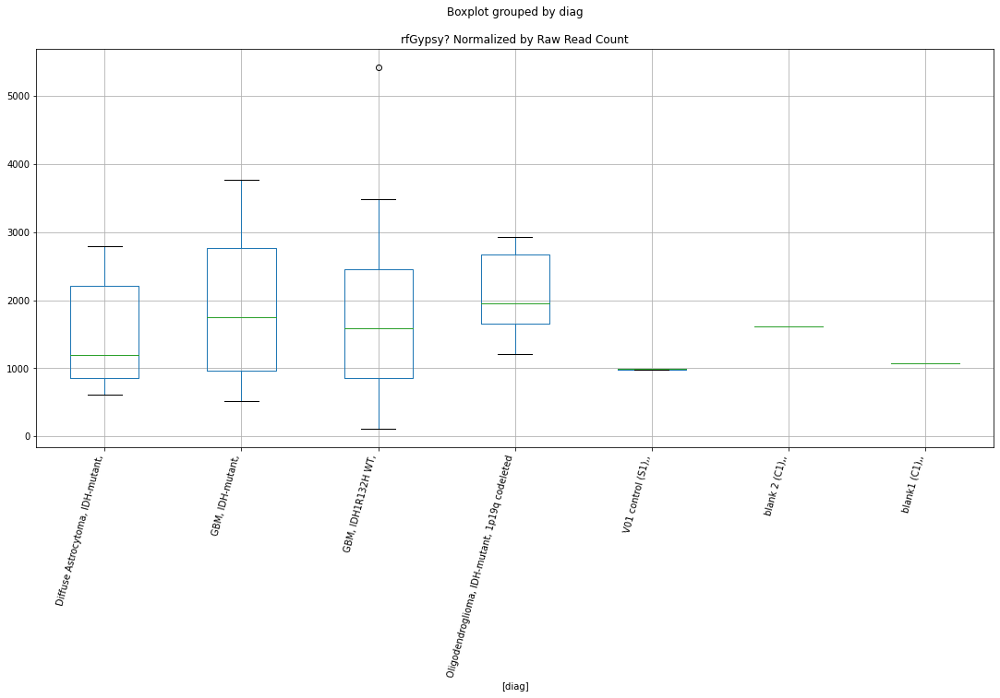

rfRTE-BovB D-plex bbduk1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.790239605903941
	p = 0.09025094416448426
rfRTE-BovB D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.790239605903941
	p = 0.09025094416448426
rfRTE-BovB D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8545857046655203
	p = 0.08011263276588483
rfRTE-BovB D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8545857046655203
	p = 0.08011263276588483


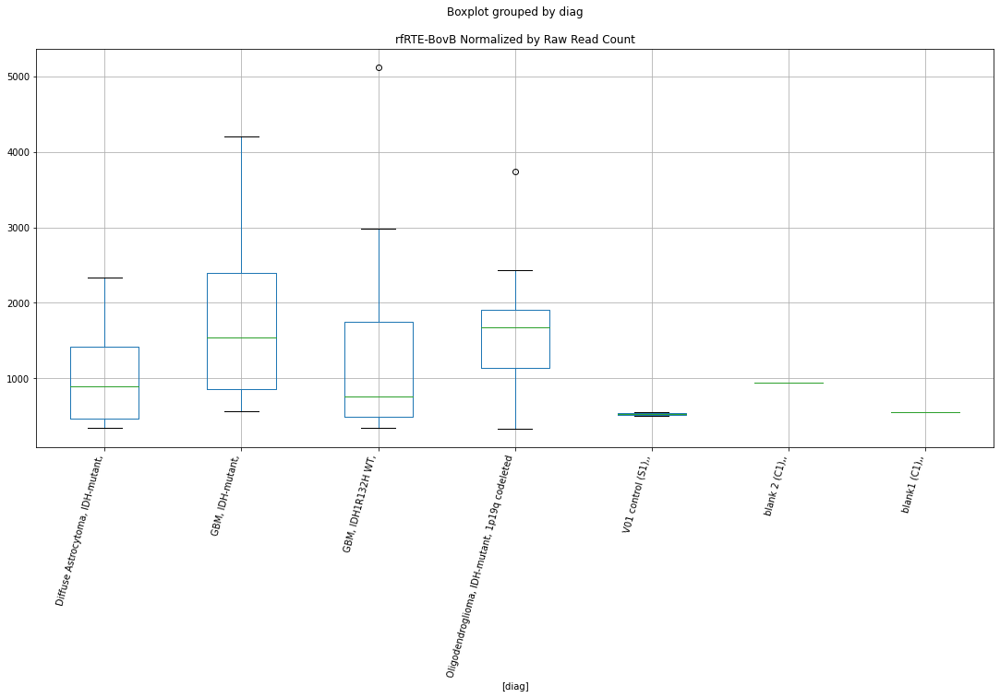

rfRTE-BovB D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.1224039625773456
	p = 0.0479352640897364
rfRTE-BovB D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.1224039625773456
	p = 0.0479352640897364


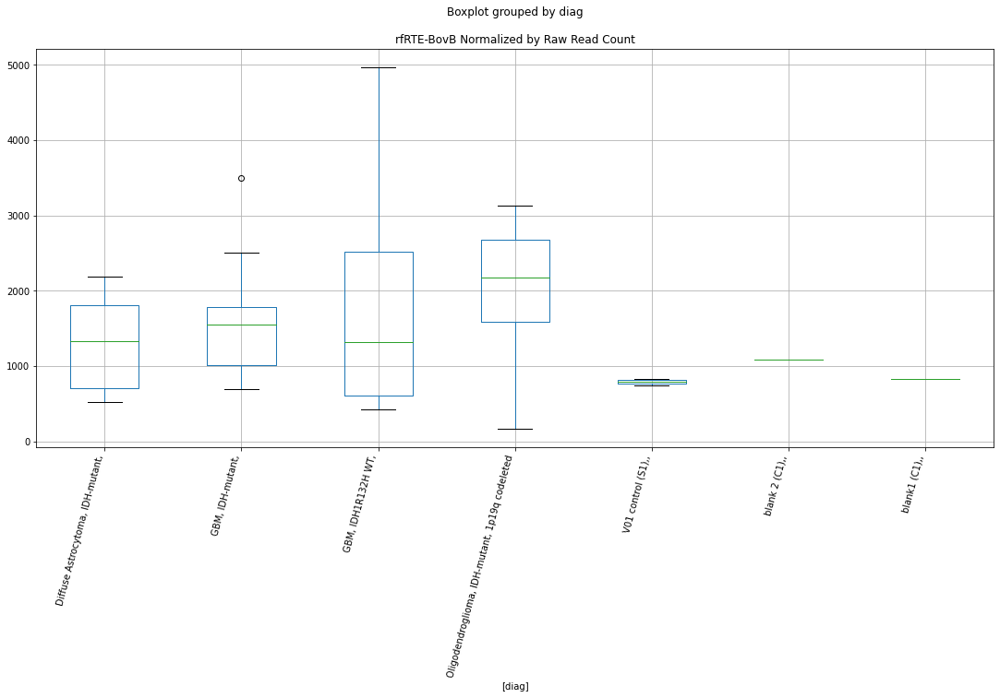

rfRTE-BovB D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9768725435776422
	p = 0.06358073609237606
rfRTE-BovB D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9768725435776422
	p = 0.06358073609237606


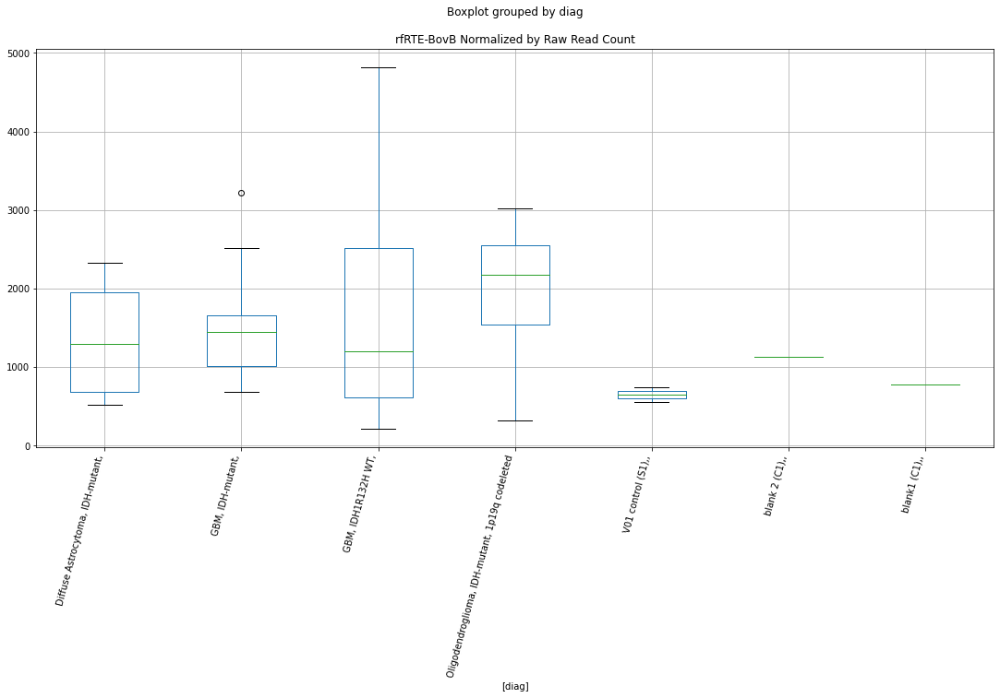

rfRTE-BovB D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0678728578809045
	p = 0.053334665297707314
rfRTE-BovB D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0678728578809045
	p = 0.053334665297707314


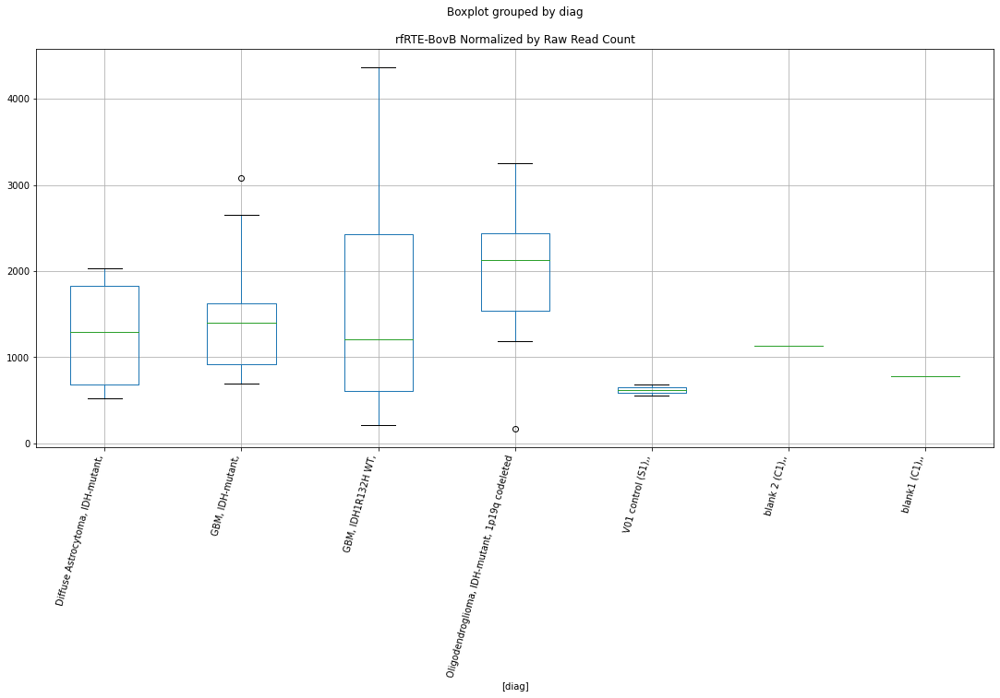

rfMULE-MuDR D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.2108355816083196
	p = 0.040229693780559954
rfMULE-MuDR D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.2108355816083196
	p = 0.040229693780559954


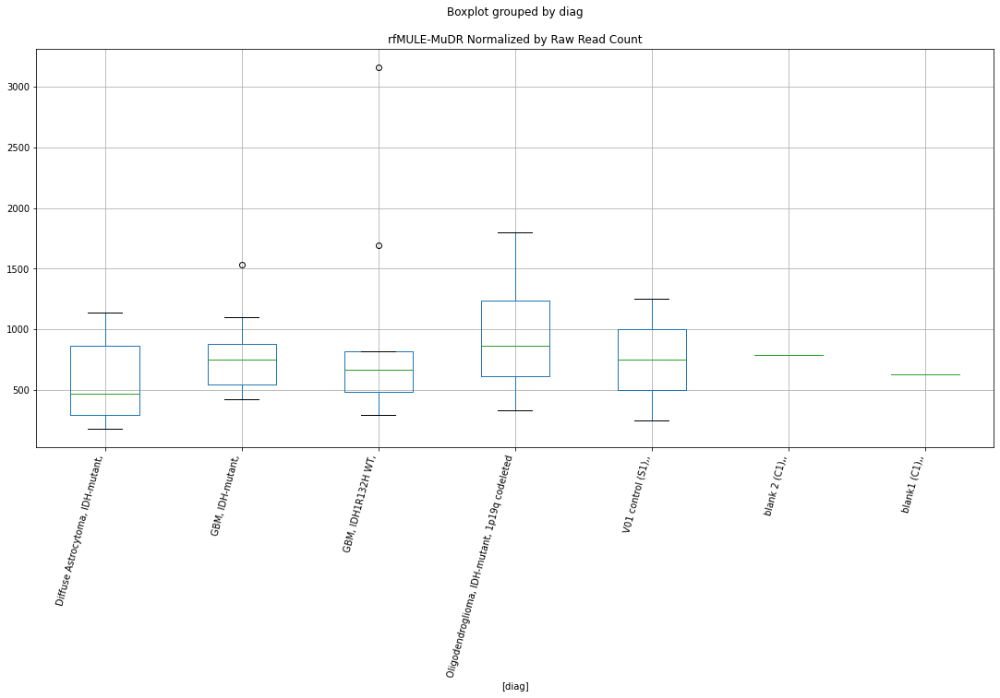

rfMULE-MuDR D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.3795219100664413
	p = 0.02860257136627763
rfMULE-MuDR D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.3795219100664413
	p = 0.02860257136627763


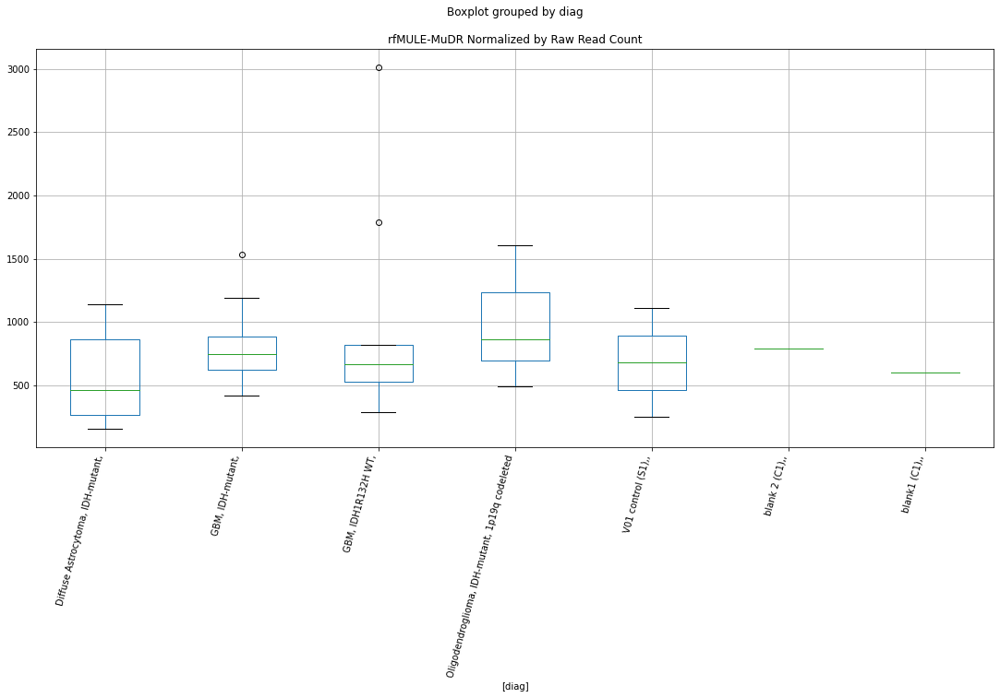

rfMULE-MuDR D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.2245943924899896
	p = 0.03913859169405683
rfMULE-MuDR D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.2245943924899896
	p = 0.03913859169405683


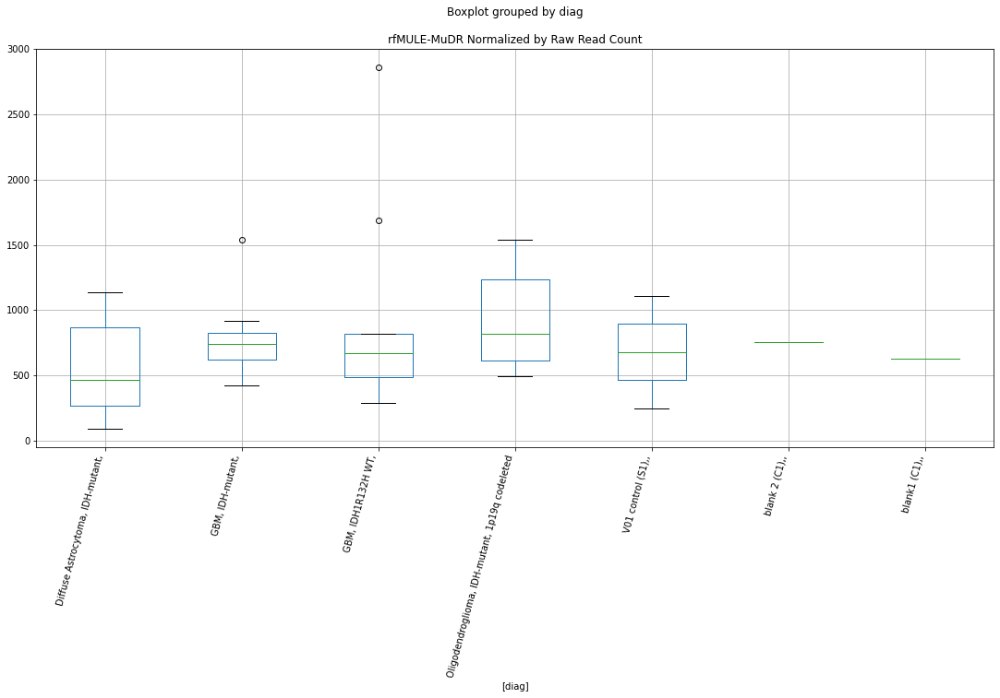

rftRNA-RTE D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.904699650193783
	p = 0.07292554822545205
rftRNA-RTE D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.904699650193783
	p = 0.07292554822545205


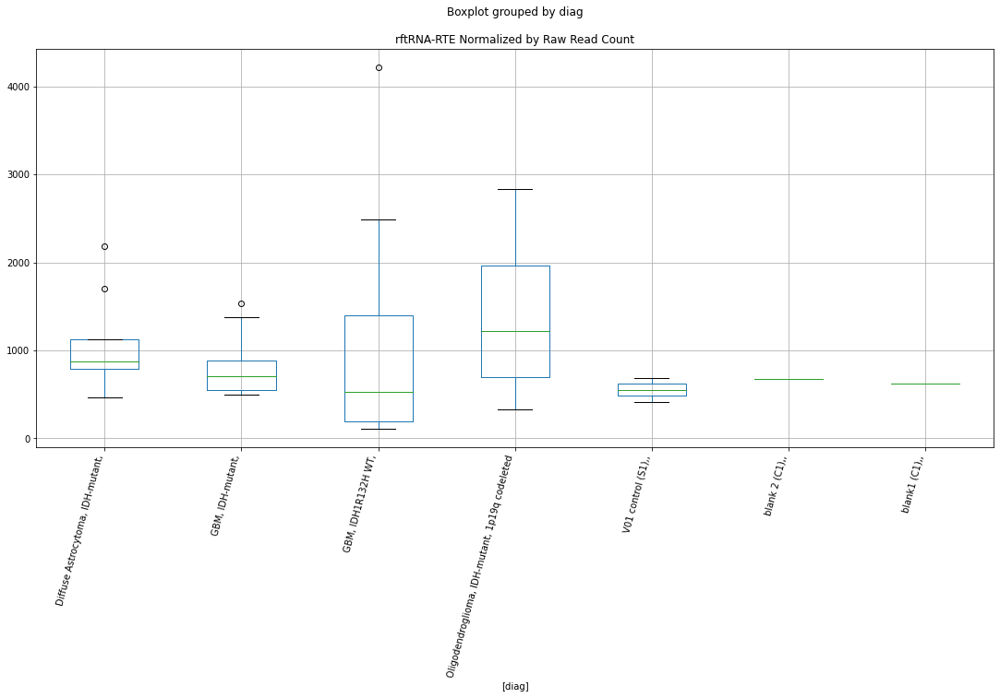

rftRNA-RTE D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.84107301941509
	p = 0.0821545039770214
rftRNA-RTE D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.84107301941509
	p = 0.0821545039770214


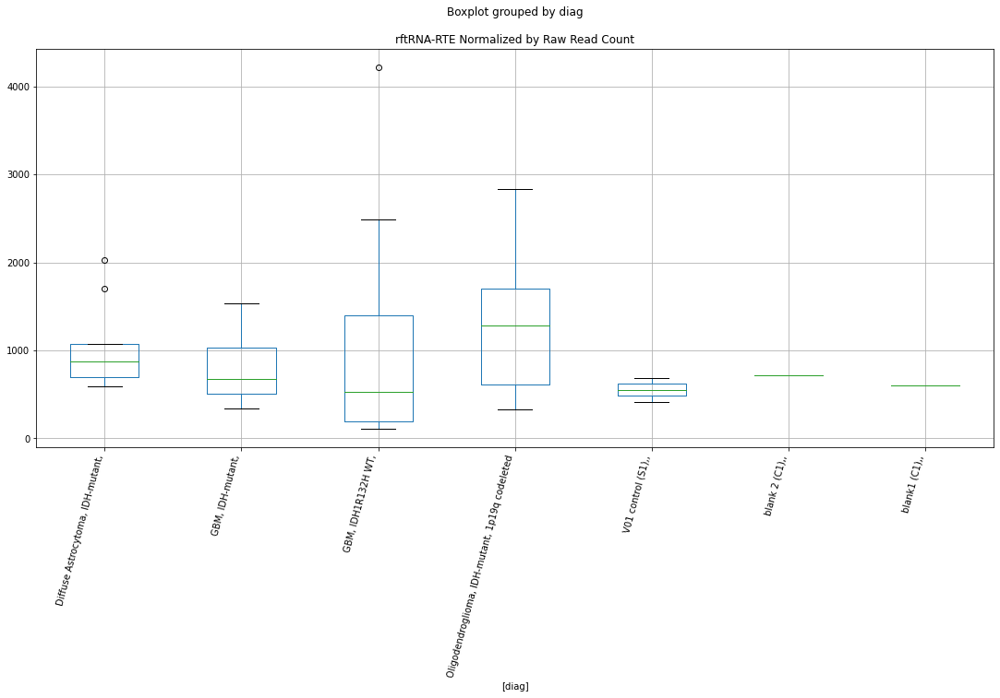

rftRNA-RTE D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7839505688089698
	p = 0.09129956738777378
rftRNA-RTE D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.7839505688089698
	p = 0.09129956738777378


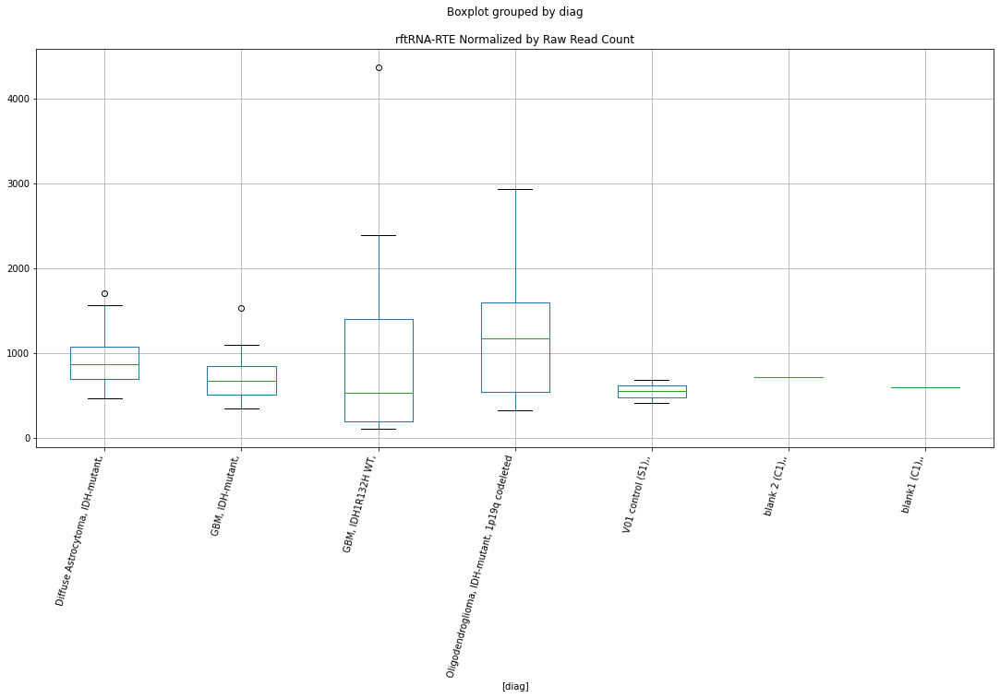

rfacro D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7836244594556243
	p = 0.0913542308424482
rfacro D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7836244594556243
	p = 0.0913542308424482


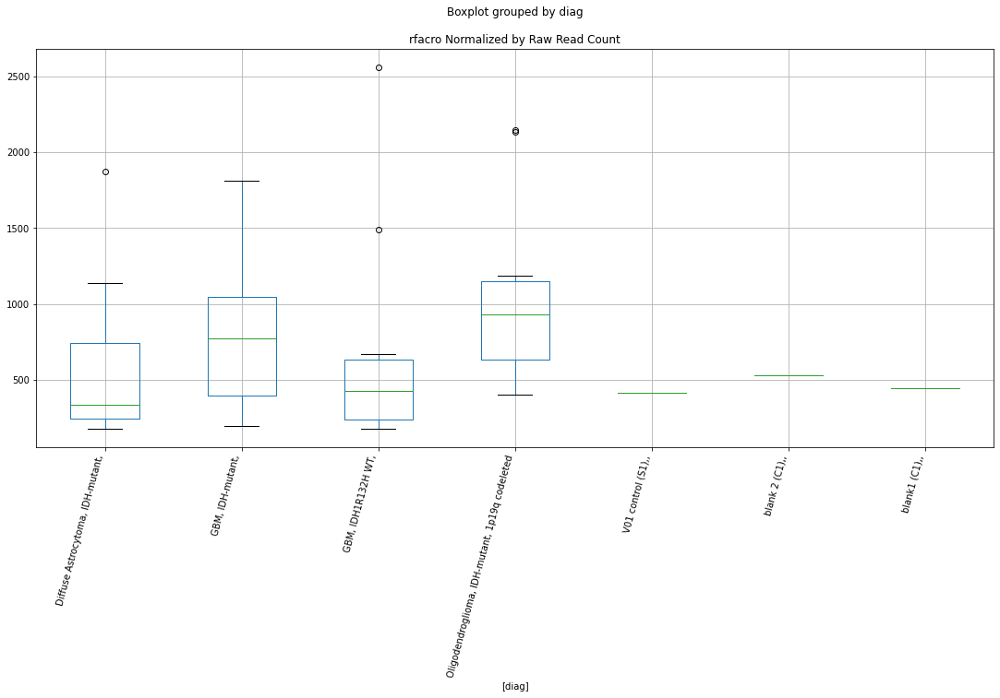

rfacro D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8245338295753544
	p = 0.08471587933985826
rfacro D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8245338295753544
	p = 0.08471587933985826


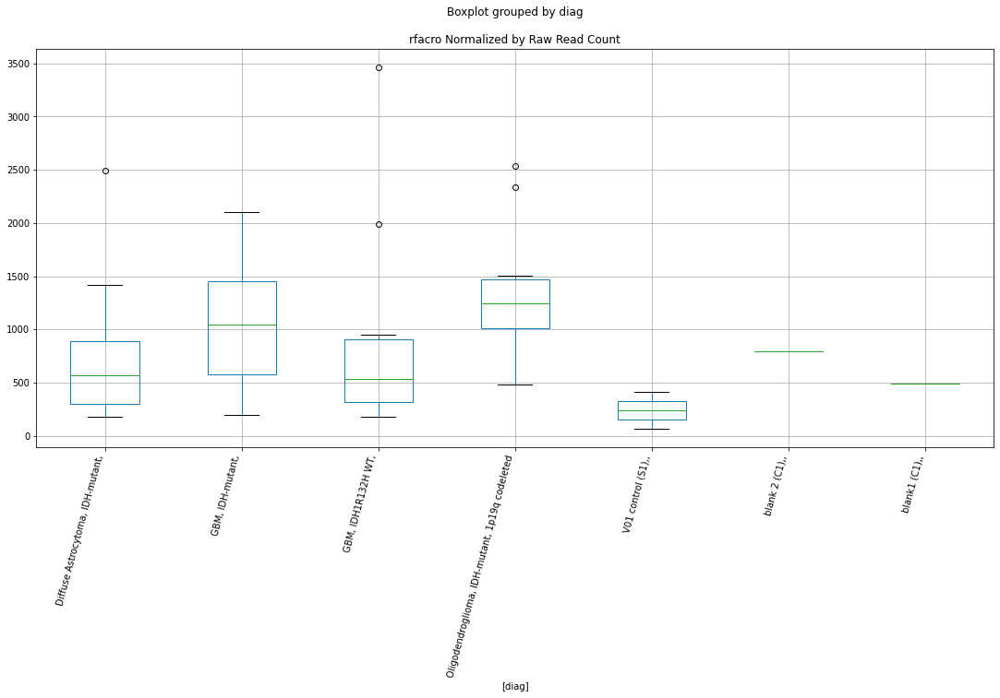

rfacro D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8245338295753544
	p = 0.08471587933985826
rfacro D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8245338295753544
	p = 0.08471587933985826


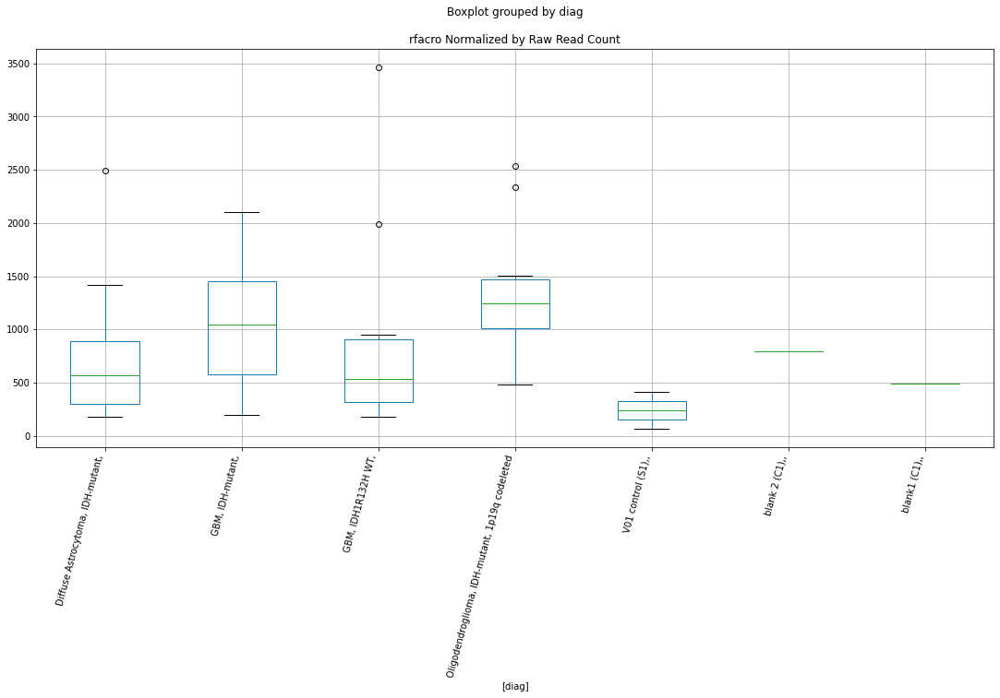

rfacro D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.5065544109413596
	p = 0.022006034692651055
rfacro D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.5065544109413596
	p = 0.022006034692651055


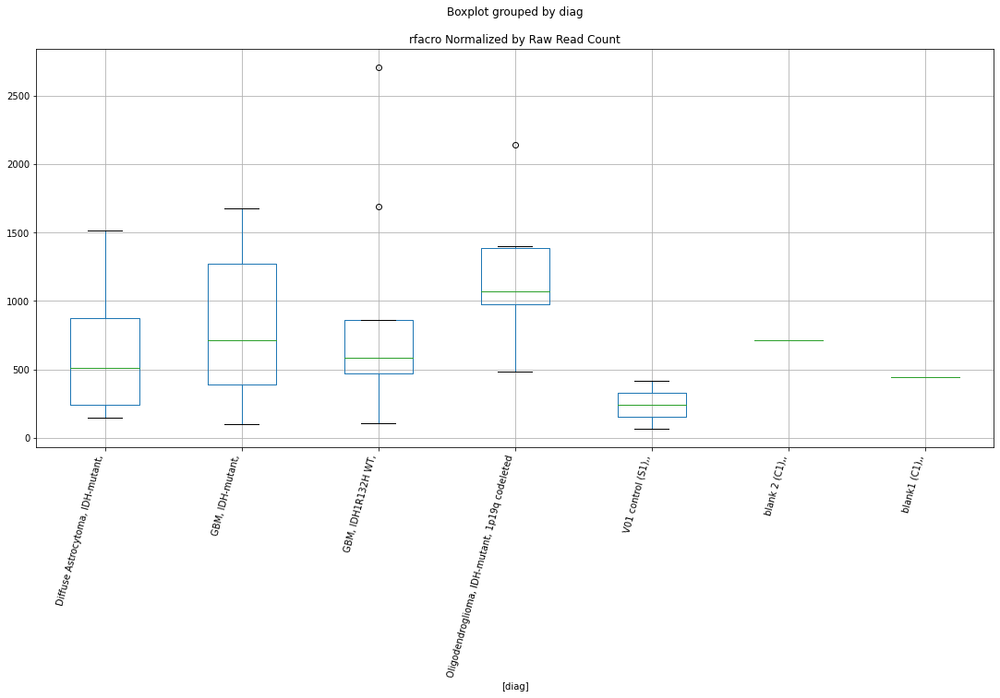

rfacro D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -3.015484485111767
	p = 0.007430812385298079
rfacro D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 3.015484485111767
	p = 0.007430812385298079


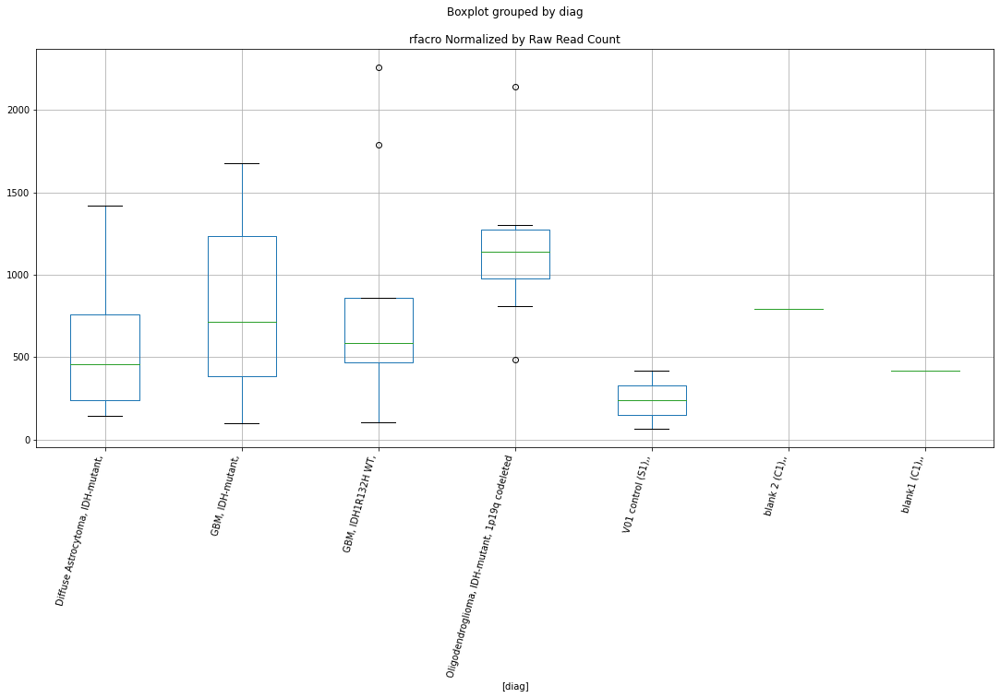

rfacro D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8028435389894442
	p = 0.08818098981692832
rfacro D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.977870471964795
	p = 0.008064022216068575
rfacro D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8028435389894442
	p = 0.08818098981692832
rfacro D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.977870471964795
	p = 0.008064022216068575


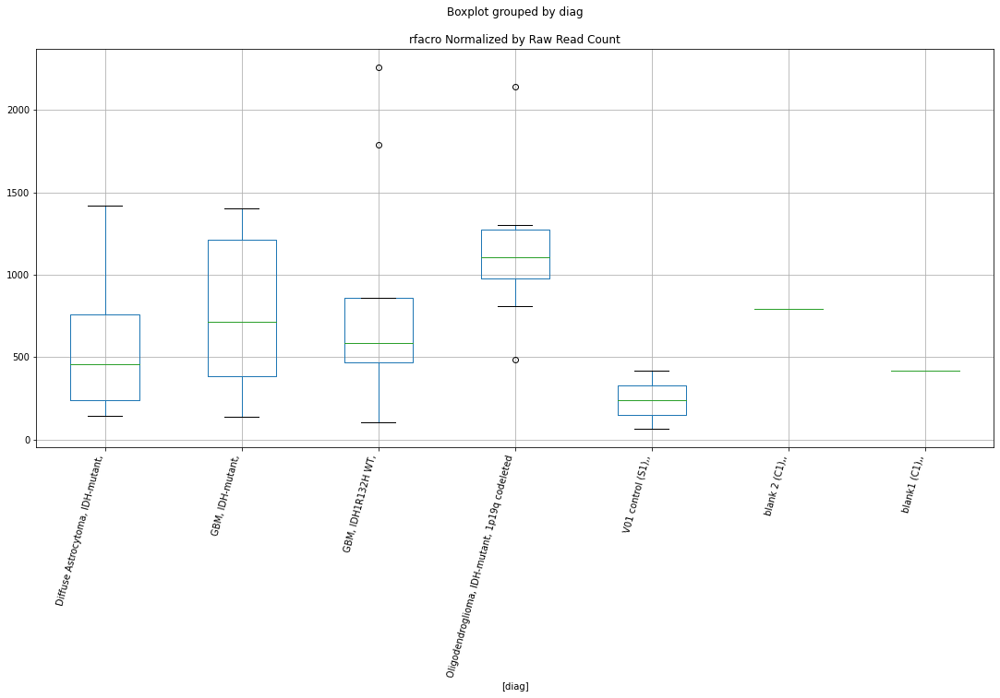

In [68]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmsk_families:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Raw Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


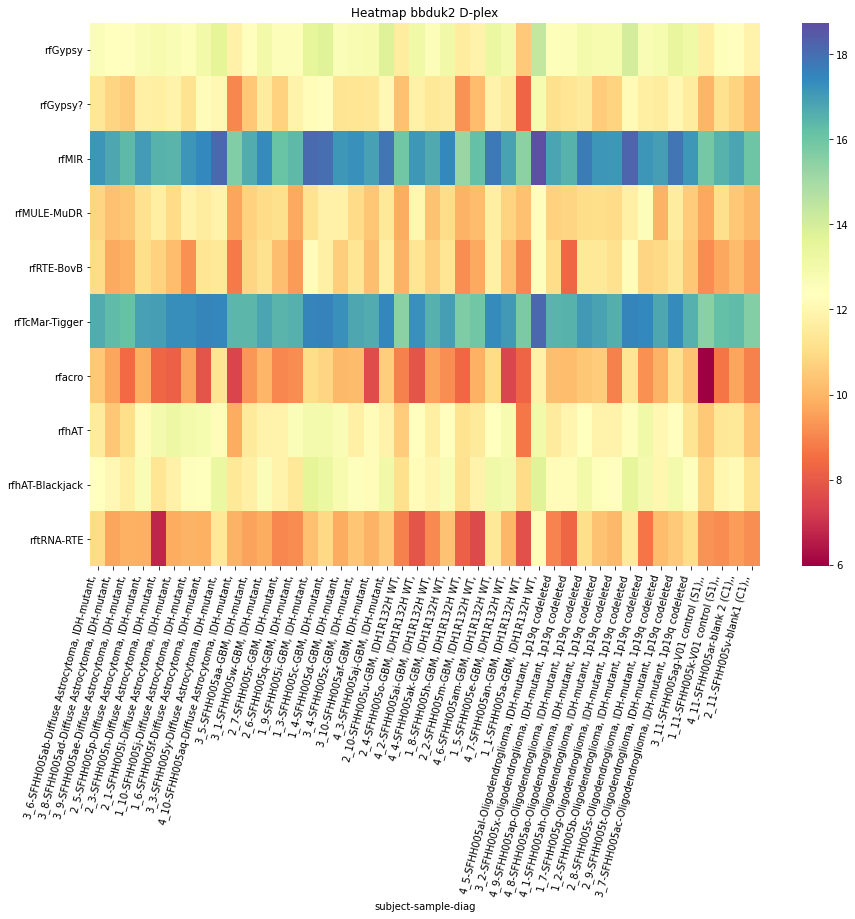

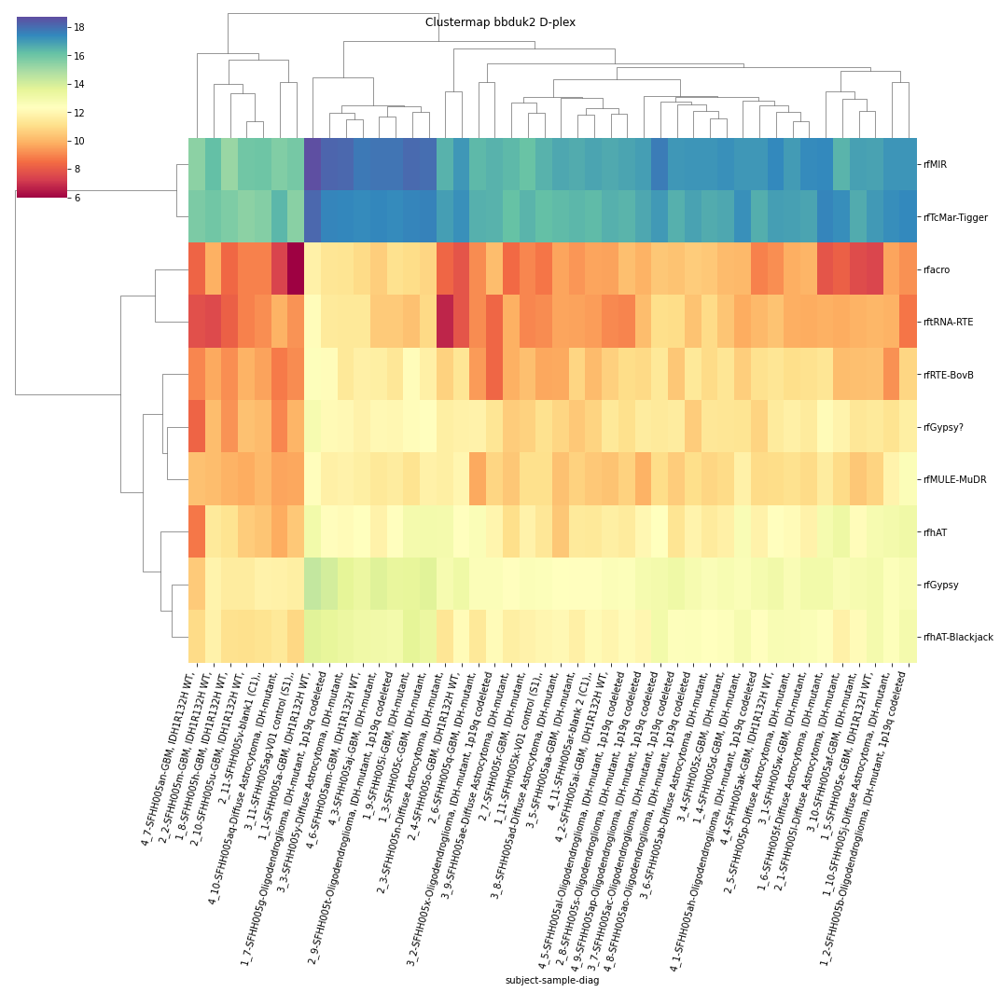

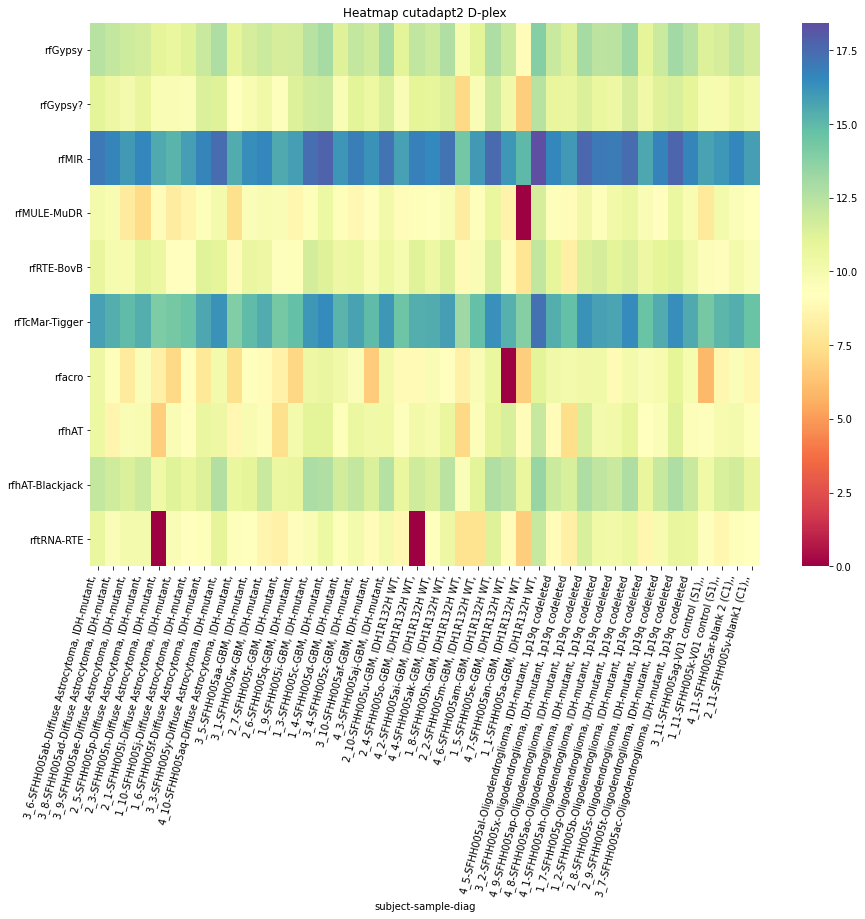

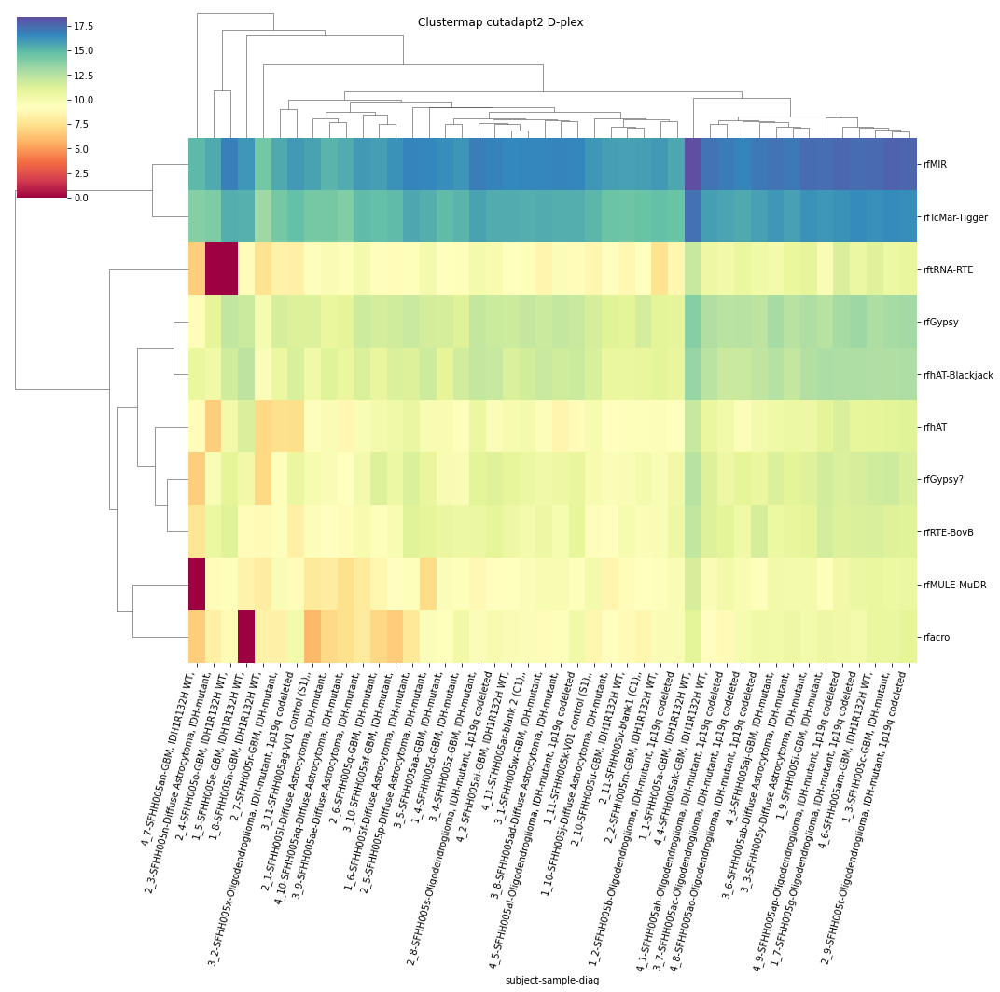

In [69]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

rcDNA D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7389298322646496
	p = 0.09912081304376713
rcDNA D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7389298322646496
	p = 0.09912081304376713


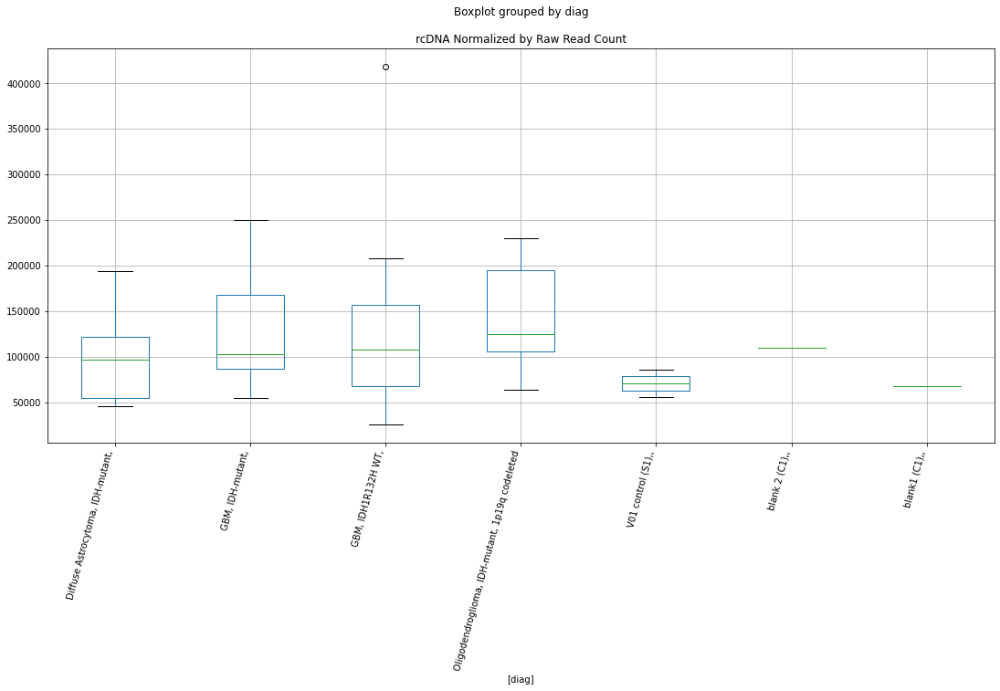

In [70]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmsk_classes:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Raw Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


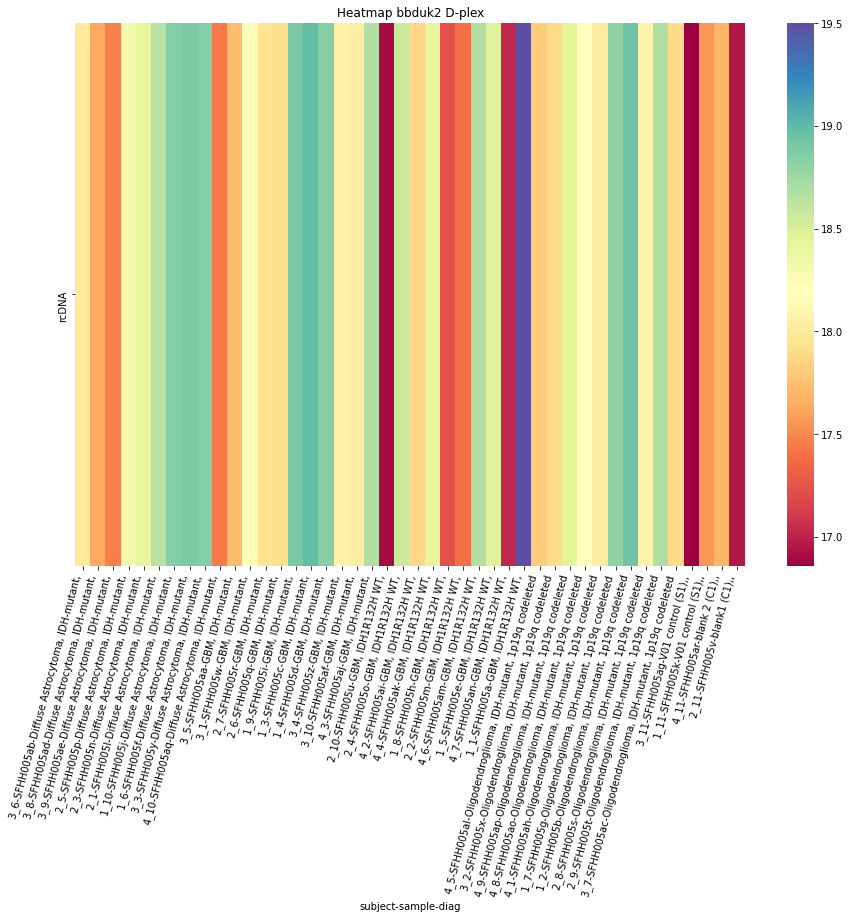

ValueError: Linkage must be computed on at least two observations.

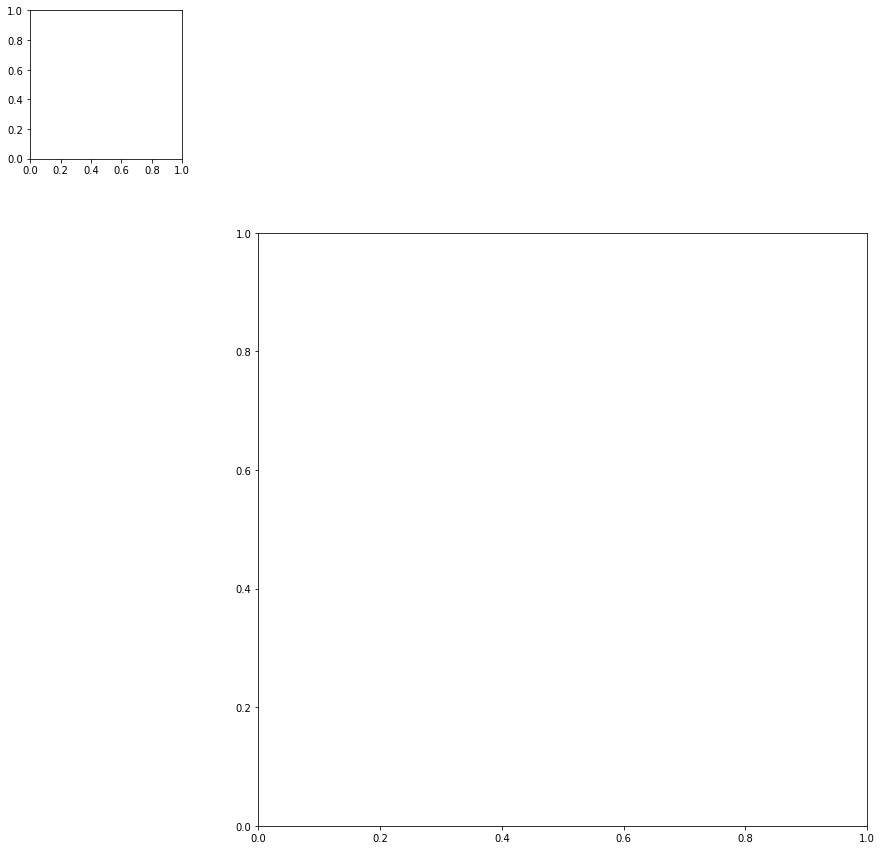

In [71]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

rn(T)n D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.881714842691135
	p = 0.0761478325600379
rn(T)n D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.881714842691135
	p = 0.0761478325600379


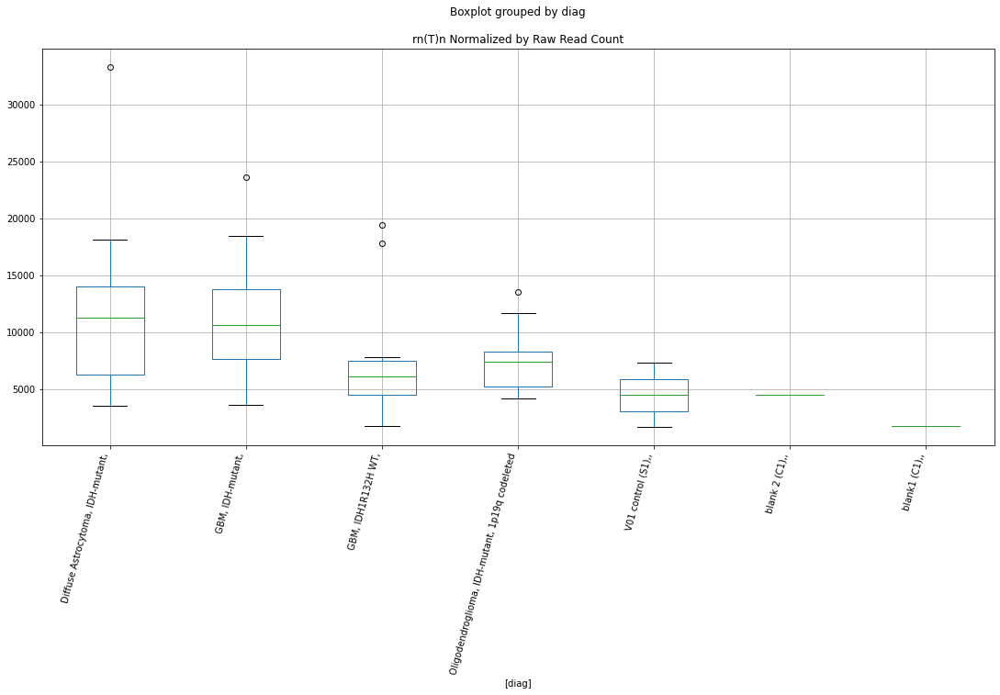

rnL1P4 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8103959663047802
	p = 0.08696063589503812
rnL1P4 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8103959663047802
	p = 0.08696063589503812


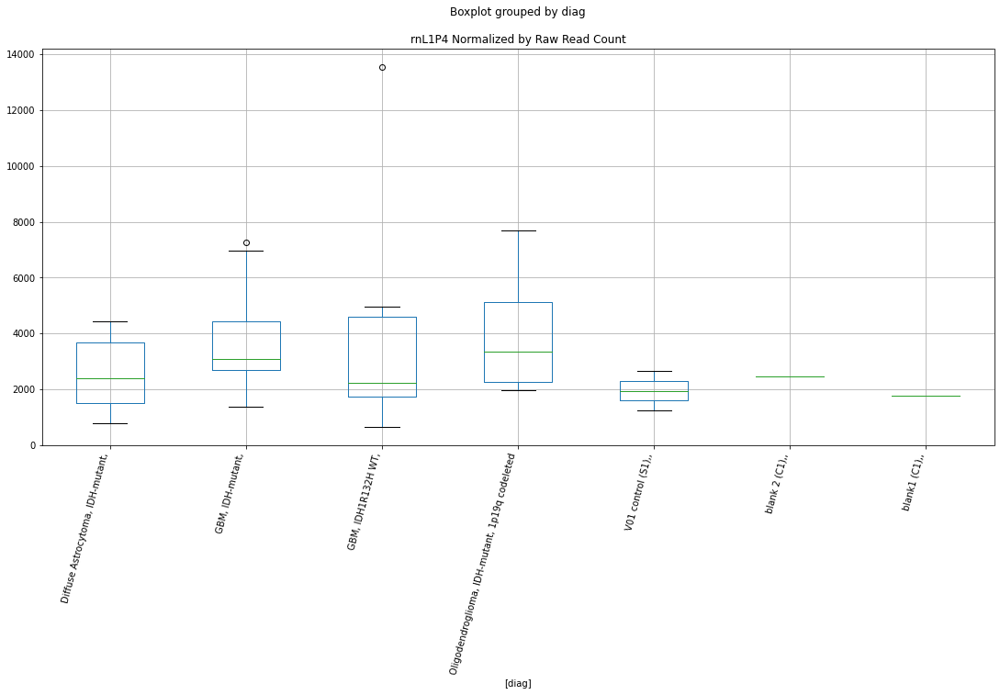

rnAluJo D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7381396846436332
	p = 0.09926311350262063
rnAluJo D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7381396846436332
	p = 0.09926311350262063


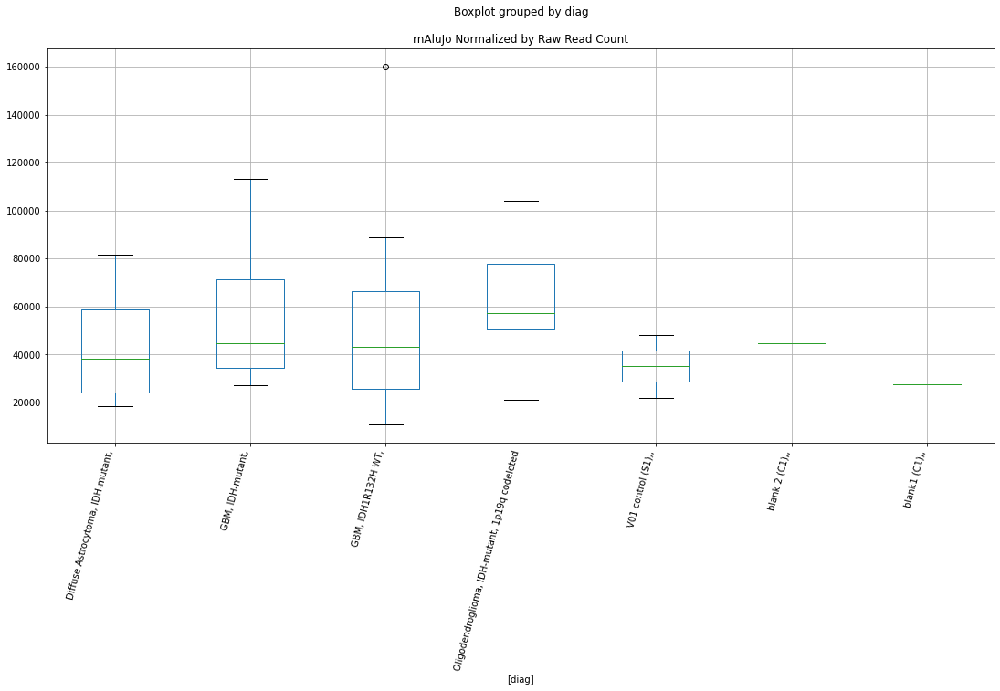

rnAluSq2 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8053890297444342
	p = 0.0877680153326152
rnAluSq2 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8053890297444342
	p = 0.0877680153326152


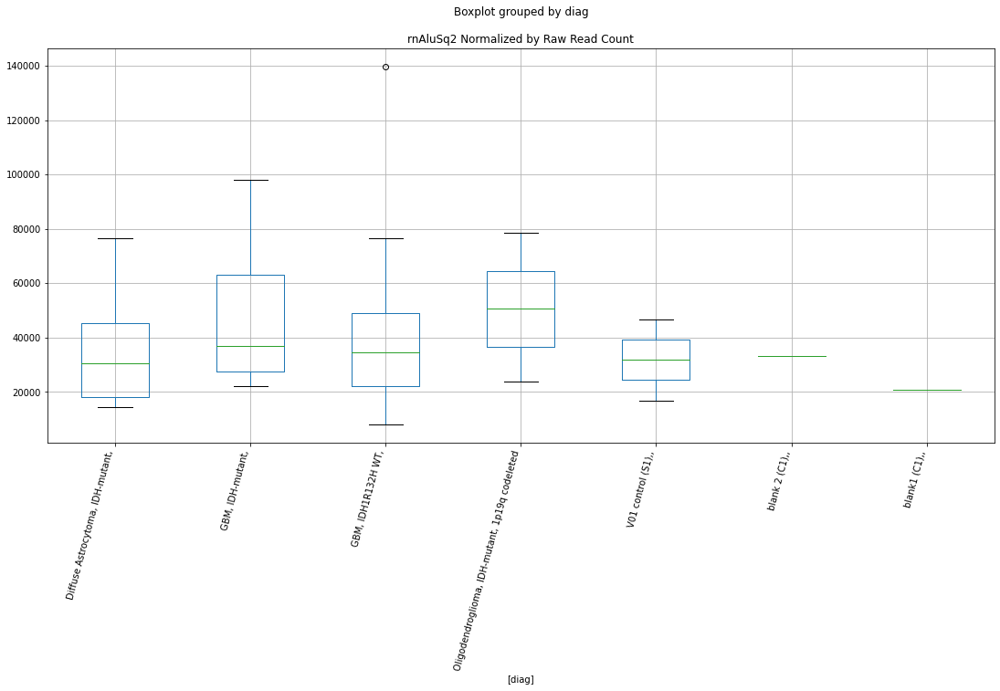

rnAluSq2 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8635187762915344
	p = 0.0787874485479142
rnAluSq2 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8635187762915344
	p = 0.0787874485479142


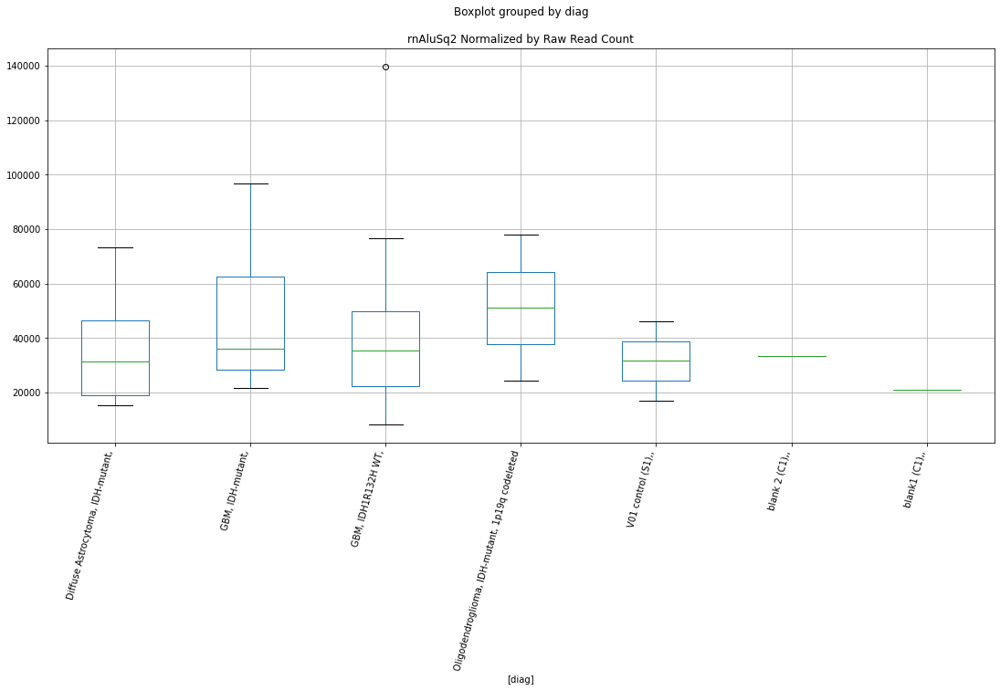

rnAluSq2 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9135054119399717
	p = 0.07172346243767967
rnAluSq2 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9135054119399717
	p = 0.07172346243767967


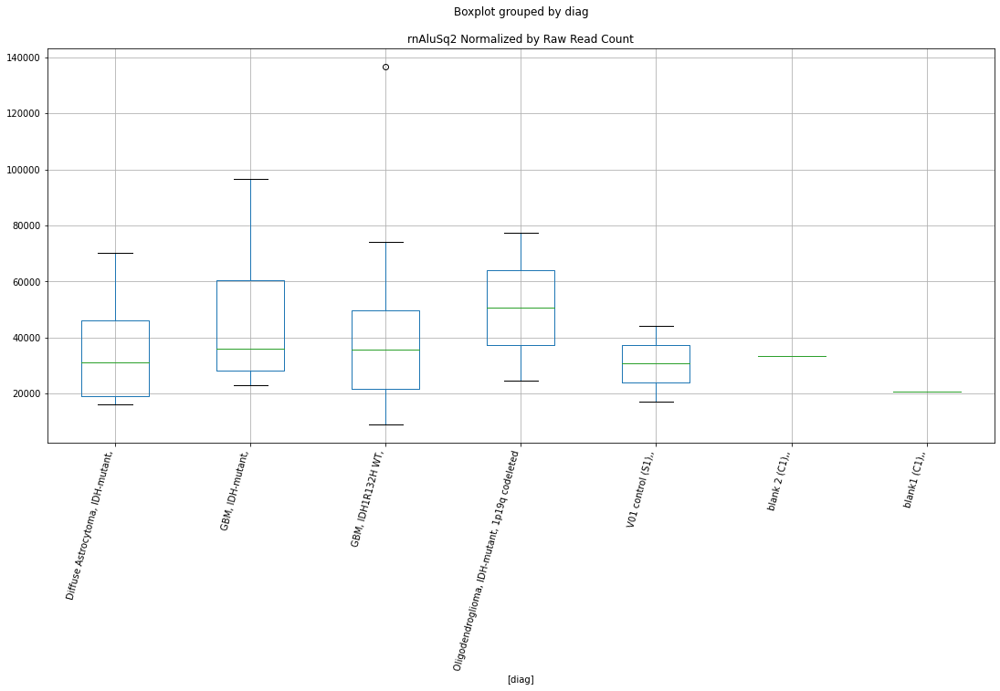

rnMIRb D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7457132873758308
	p = 0.09790640559733348
rnMIRb D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7457132873758308
	p = 0.09790640559733348


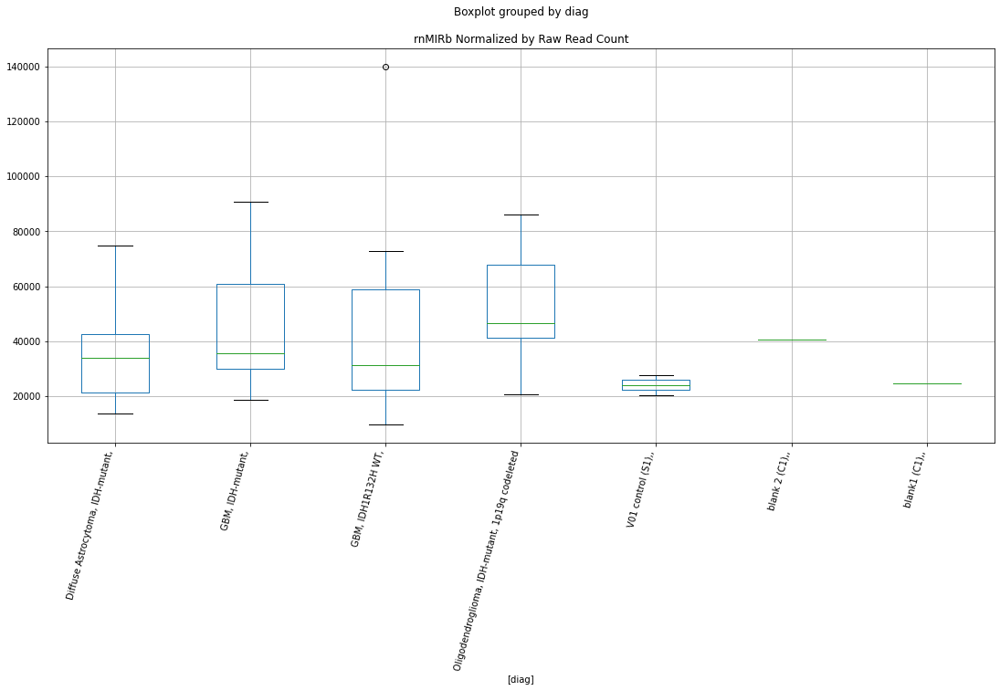

rnMIRb D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.770757911244915
	p = 0.0935338438850486
rnMIRb D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.770757911244915
	p = 0.0935338438850486


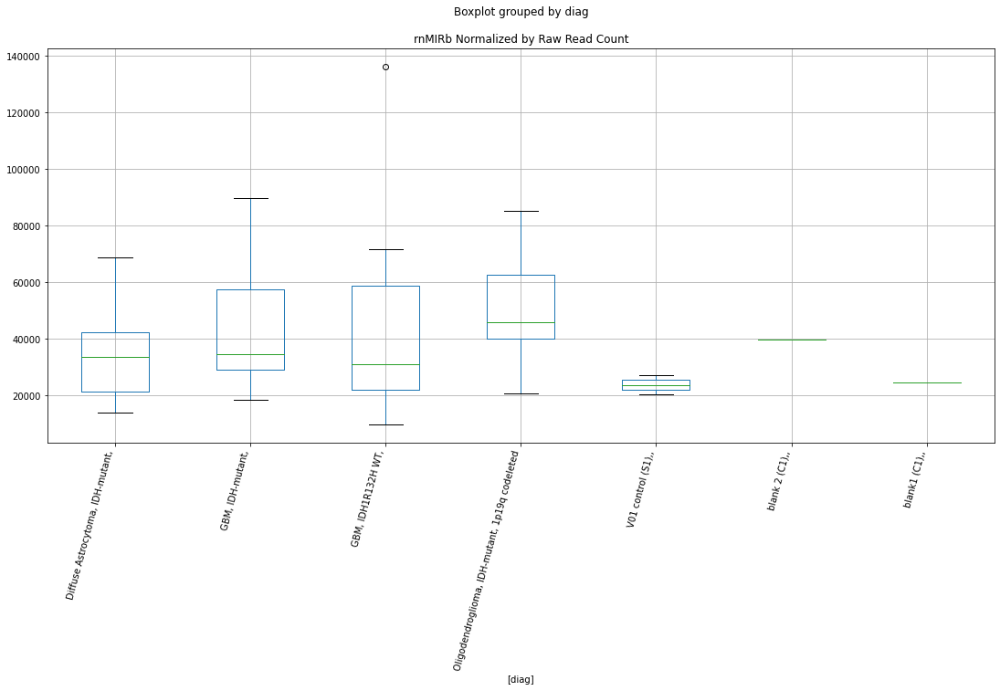

rnL1PB1 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.182430384514752
	p = 0.04257123446705544
rnL1PB1 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.182430384514752
	p = 0.04257123446705544


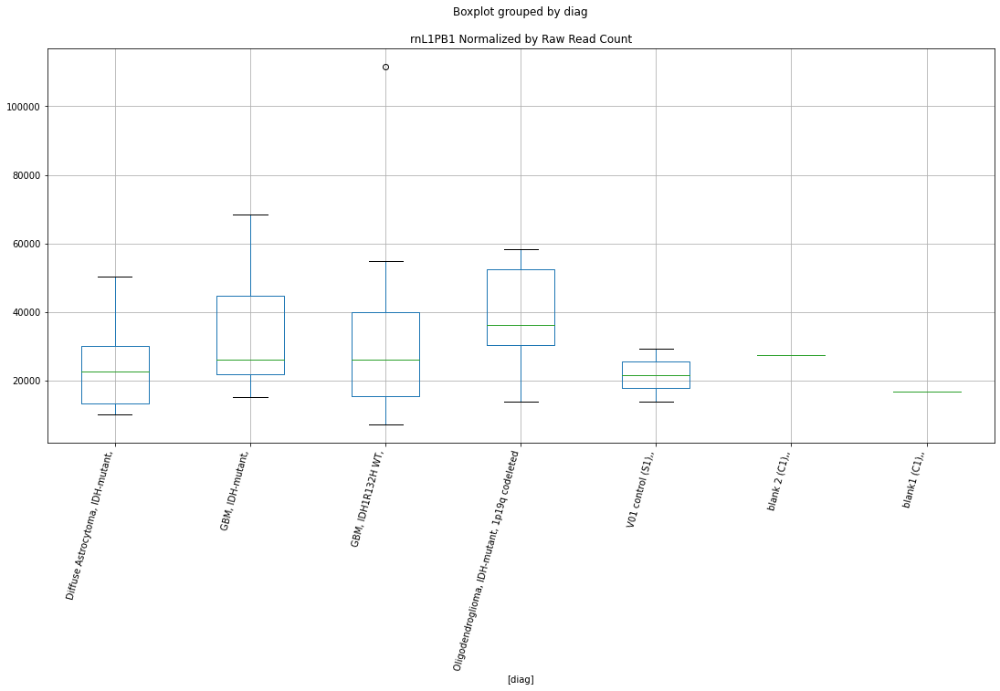

rnL1PB1 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.239866514403508
	p = 0.03795942697724976
rnL1PB1 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.239866514403508
	p = 0.03795942697724976


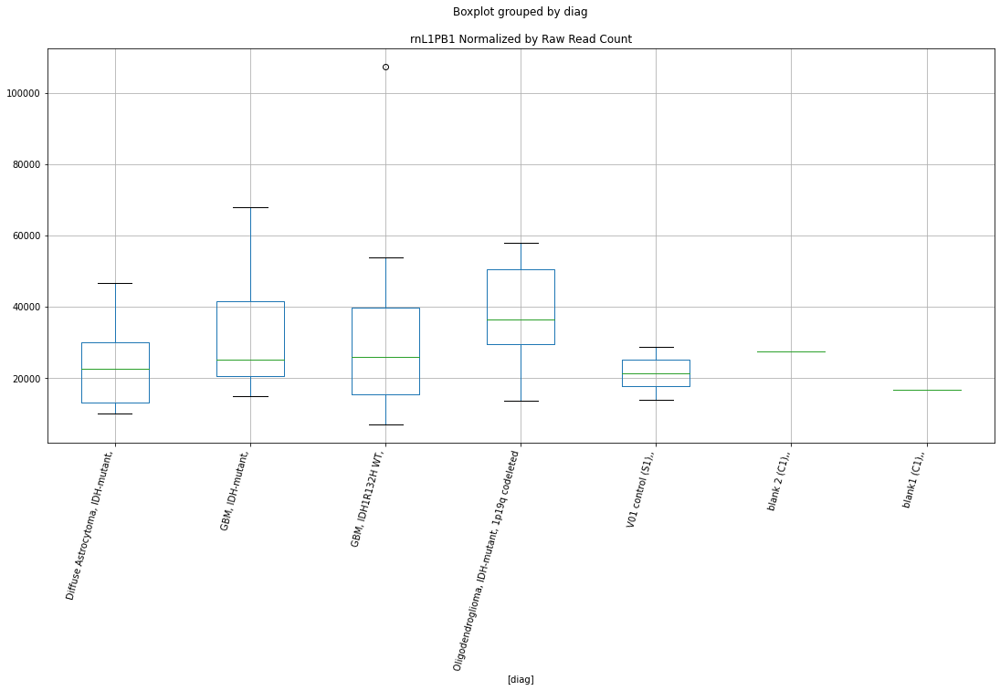

rnL1PB1 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.3038914170917266
	p = 0.033364261668986275
rnL1PB1 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.3038914170917266
	p = 0.033364261668986275


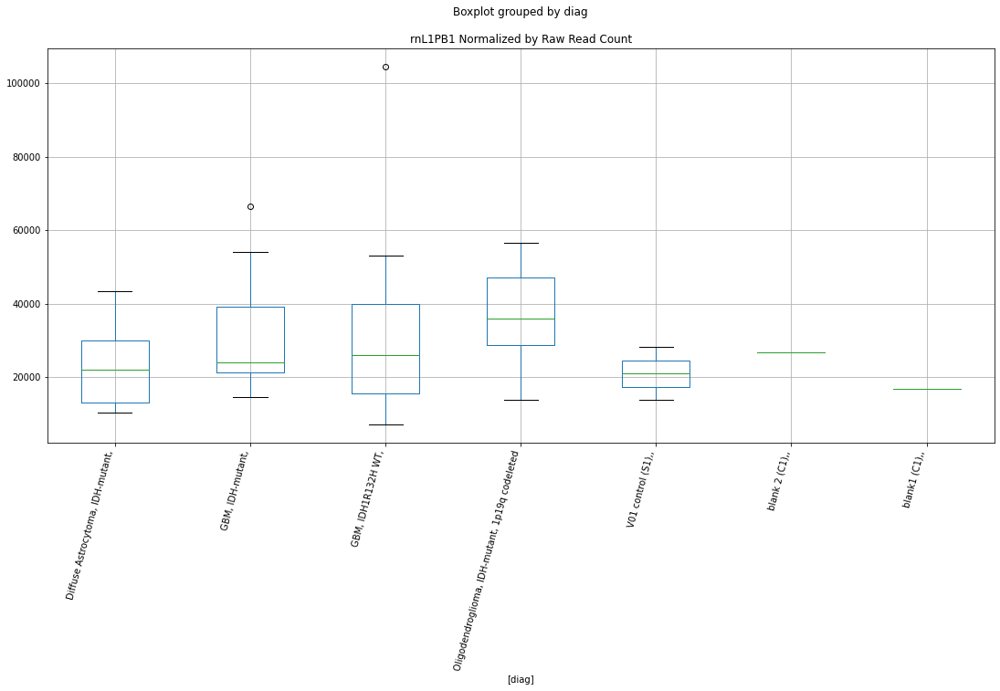

rnMIR D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.742814488331625
	p = 0.09842377686815894
rnMIR D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.742814488331625
	p = 0.09842377686815894


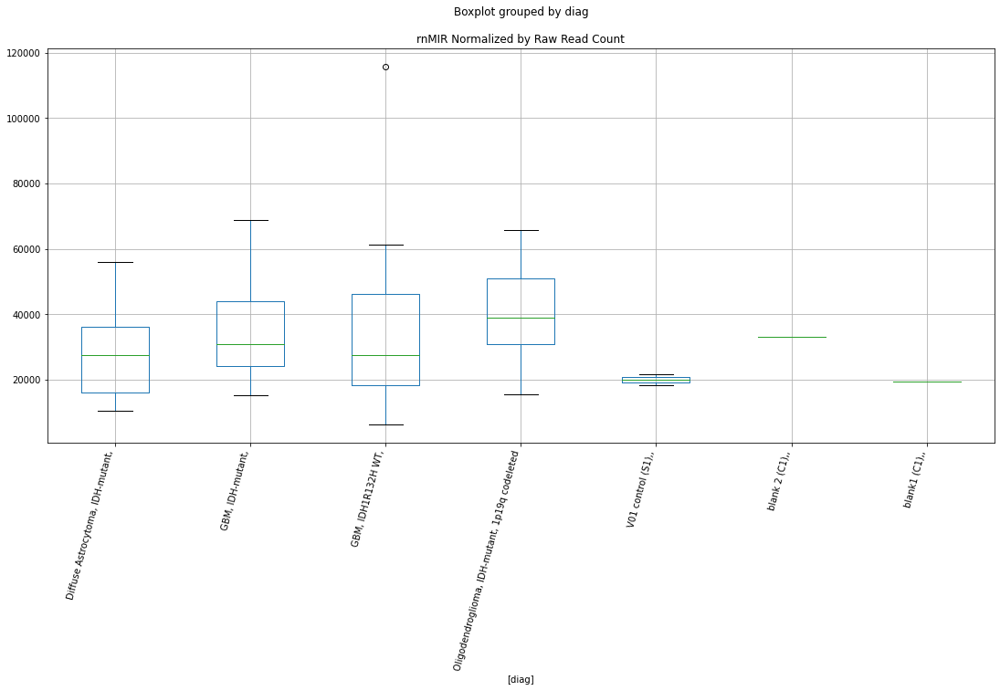

rnL1M5 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7384029503925353
	p = 0.09921568142287591
rnL1M5 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7384029503925353
	p = 0.09921568142287591


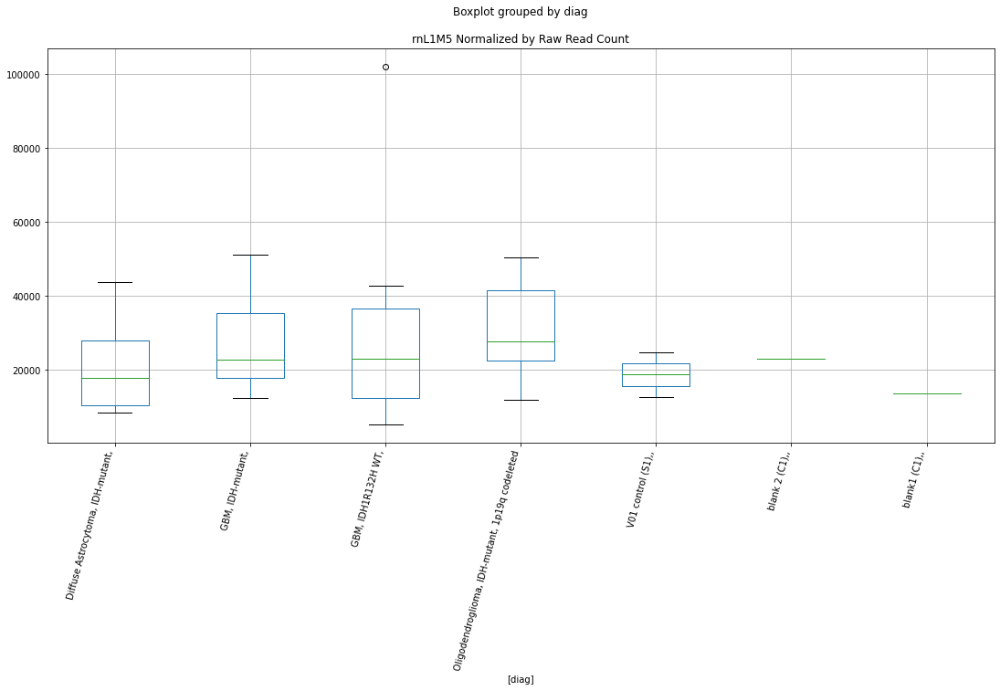

rnL1M5 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7557043300306887
	p = 0.09614124591645327
rnL1M5 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7557043300306887
	p = 0.09614124591645327


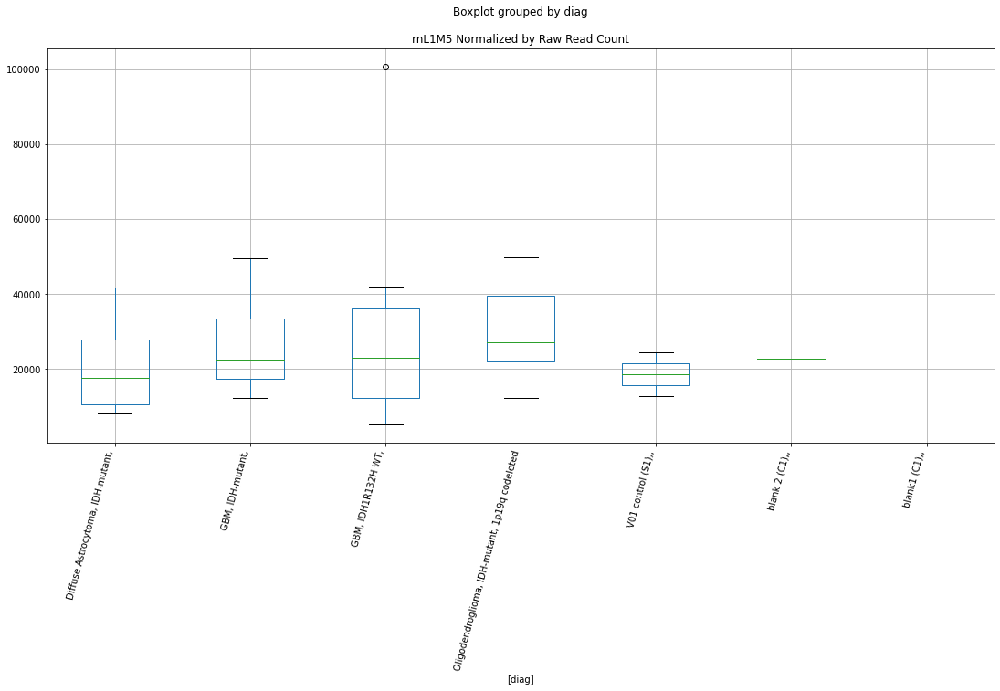

rnL1PA3 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.779991021016718
	p = 0.09196521123655027
rnL1PA3 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.779991021016718
	p = 0.09196521123655027


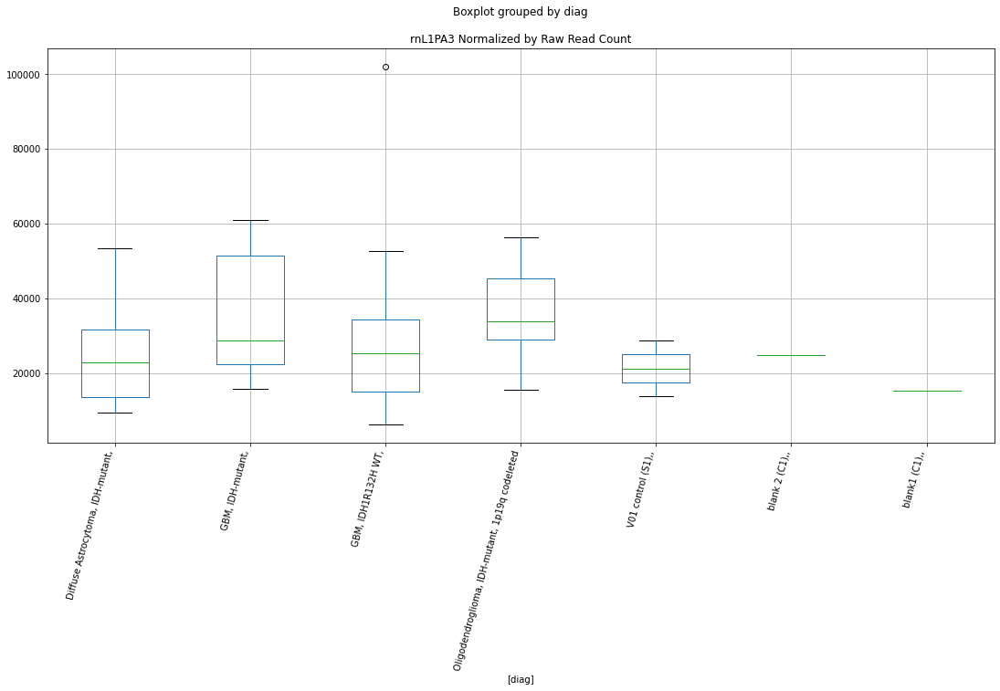

rnL1PA3 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7439831801771817
	p = 0.09821490710790545
rnL1PA3 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7439831801771817
	p = 0.09821490710790545


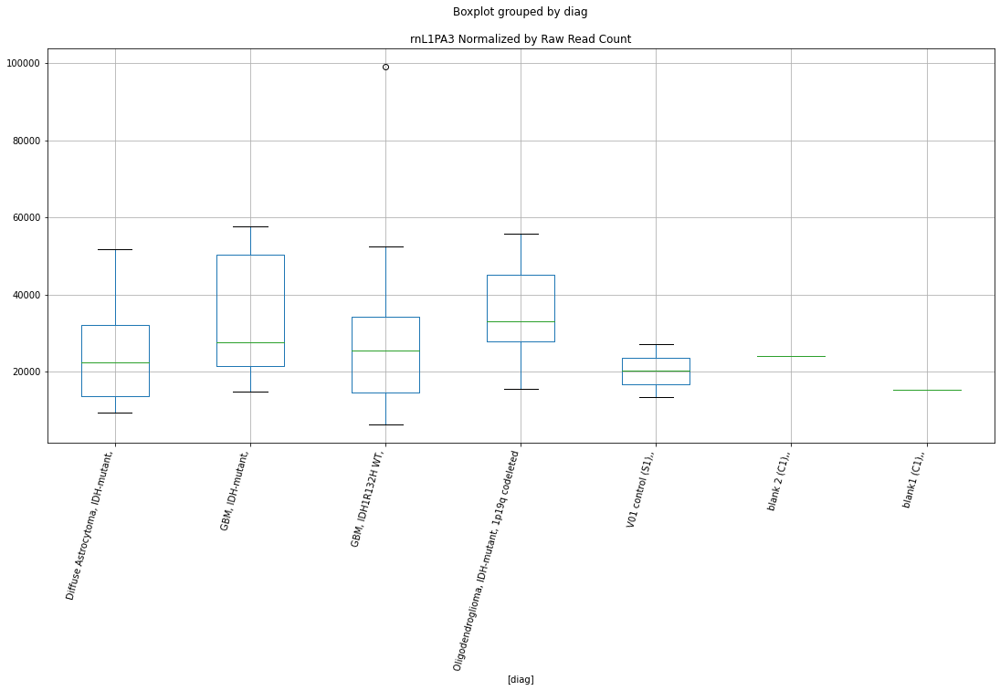

rnL1PA3 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8362493734140326
	p = 0.08289440387394968
rnL1PA3 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8362493734140326
	p = 0.08289440387394968


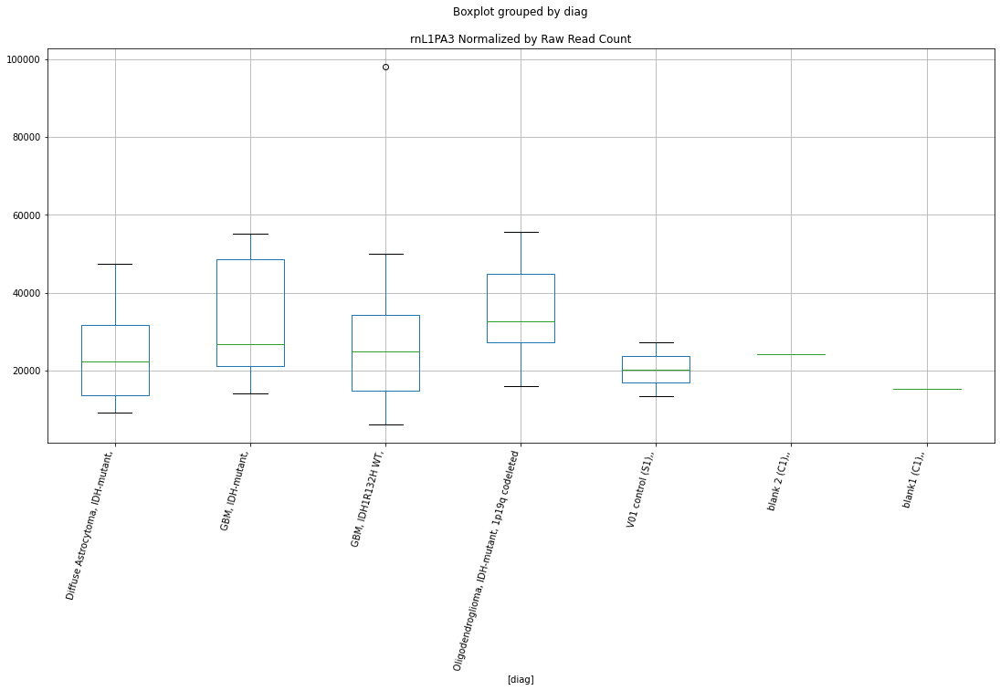

rnL1PA16 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7875283693644528
	p = 0.09070171567353684
rnL1PA16 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7875283693644528
	p = 0.09070171567353684


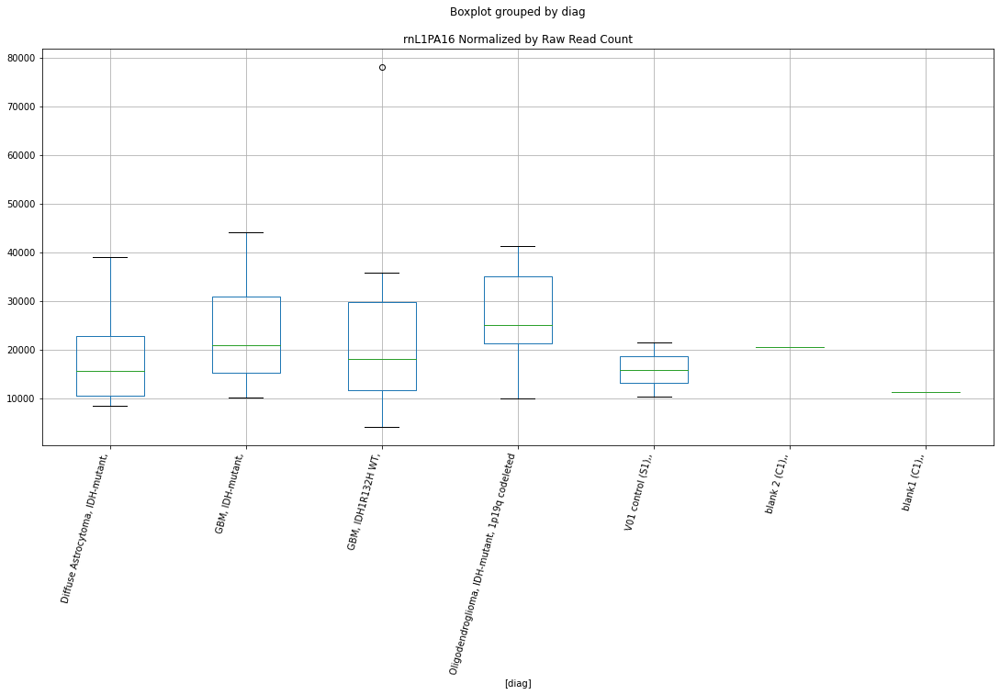

rnL1PA16 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.770559447413837
	p = 0.09356781538635538
rnL1PA16 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.770559447413837
	p = 0.09356781538635538


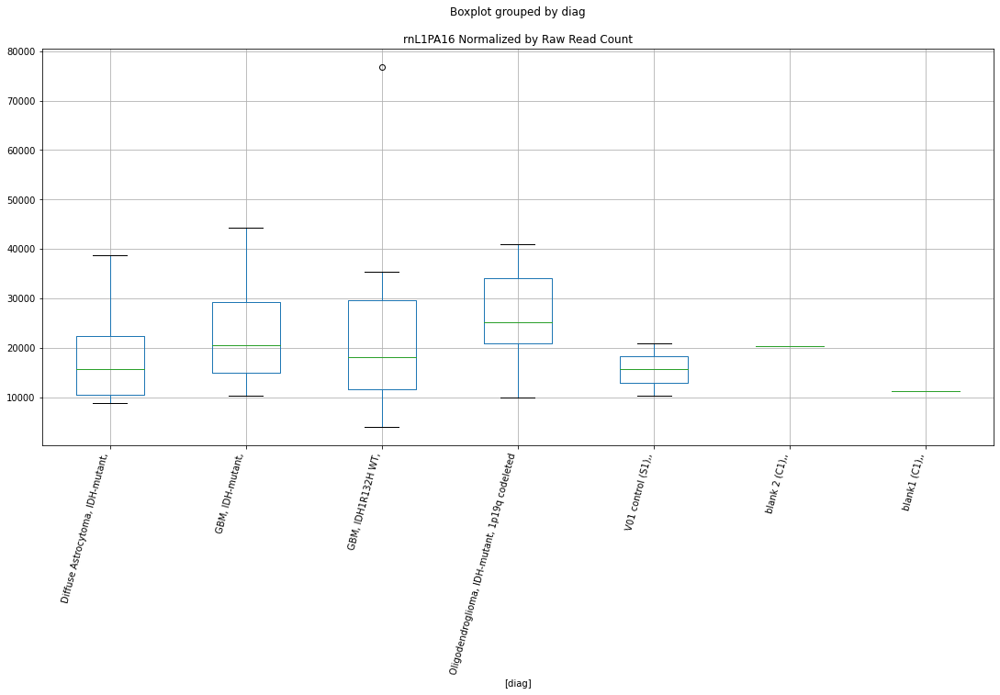

rnL1MB7 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.766507597896713
	p = 0.0942637296482821
rnL1MB7 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.766507597896713
	p = 0.0942637296482821


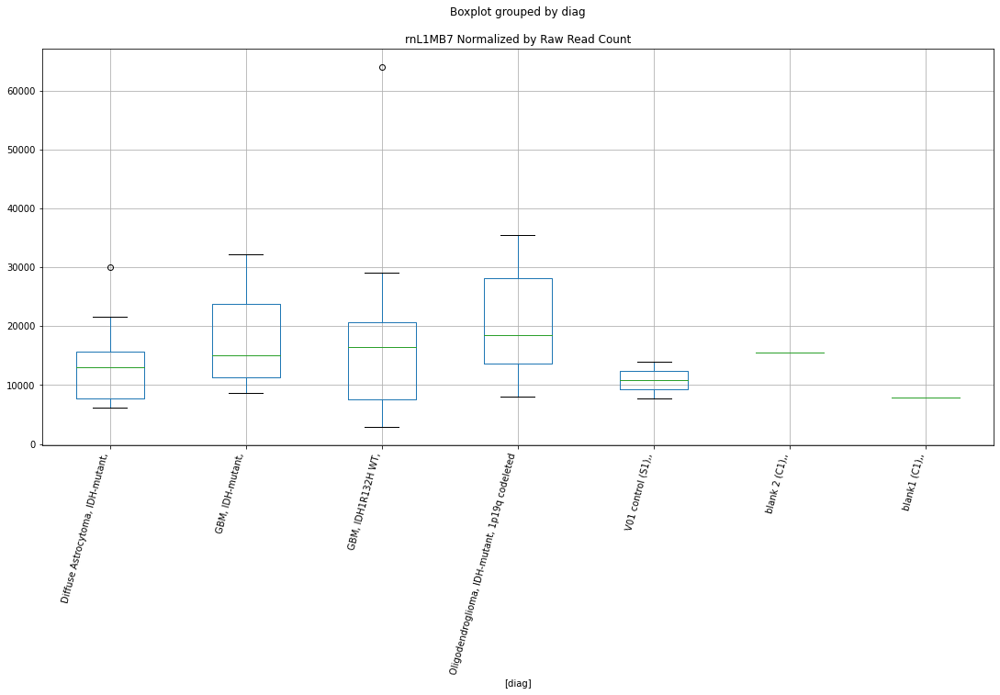

rnL1MC1 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7430744194059773
	p = 0.09837728849278583
rnL1MC1 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7430744194059773
	p = 0.09837728849278583


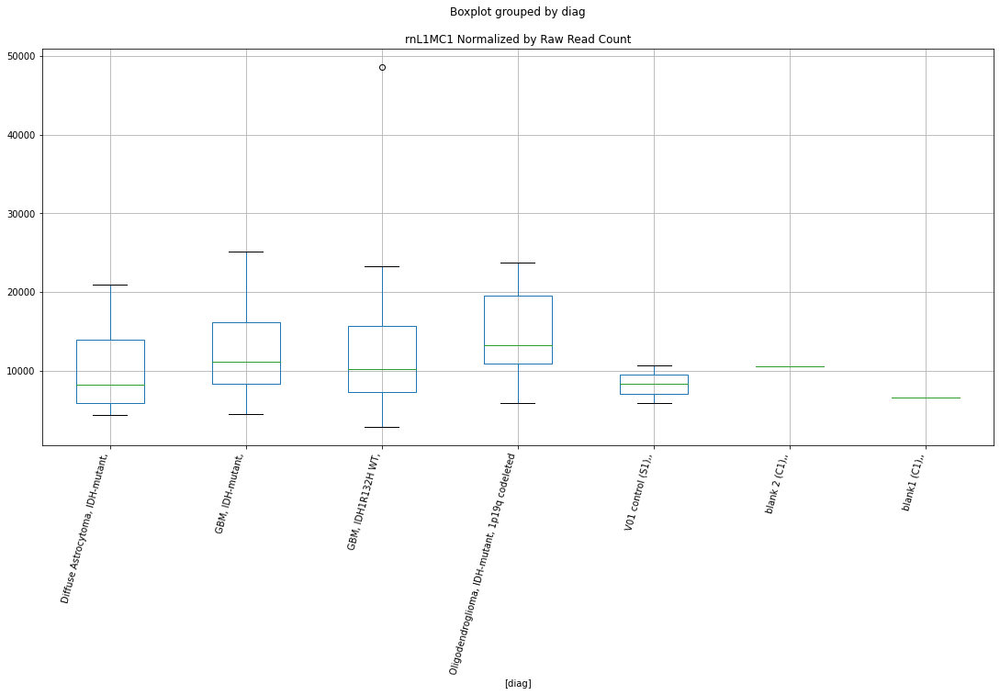

rnL1MC1 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.827790923514037
	p = 0.08420598999345295
rnL1MC1 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.827790923514037
	p = 0.08420598999345295


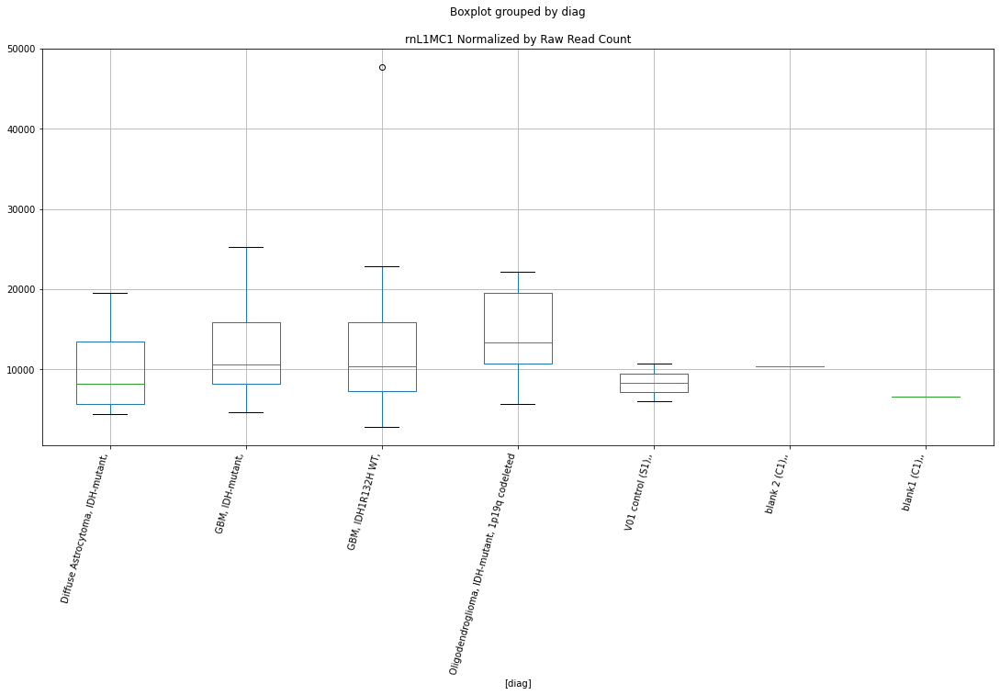

rnL1MC4 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.753230093640482
	p = 0.09657578795779251
rnL1MC4 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.753230093640482
	p = 0.09657578795779251


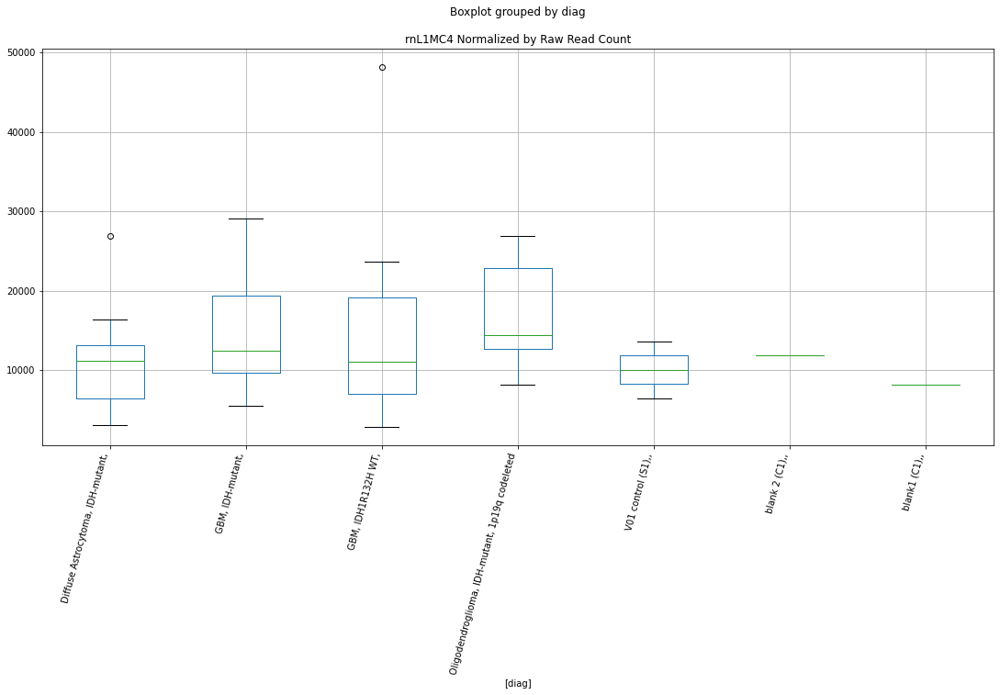

rnL1MC4 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.789596347934814
	p = 0.09035771530769872
rnL1MC4 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.789596347934814
	p = 0.09035771530769872


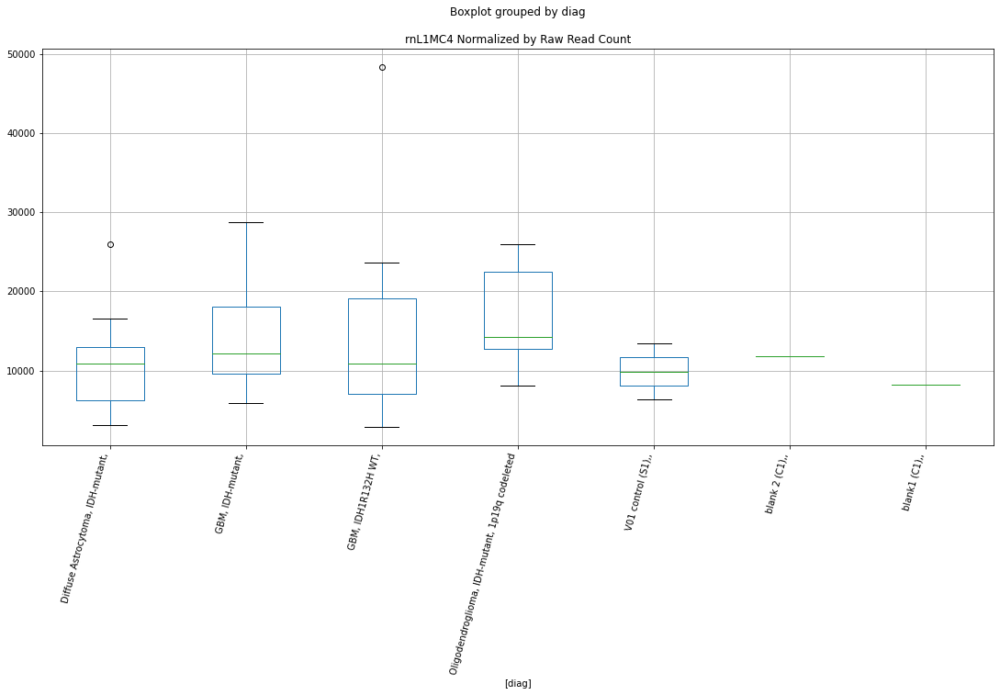

rnL1MC4 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7809468920479248
	p = 0.09180413269842759
rnL1MC4 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7809468920479248
	p = 0.09180413269842759


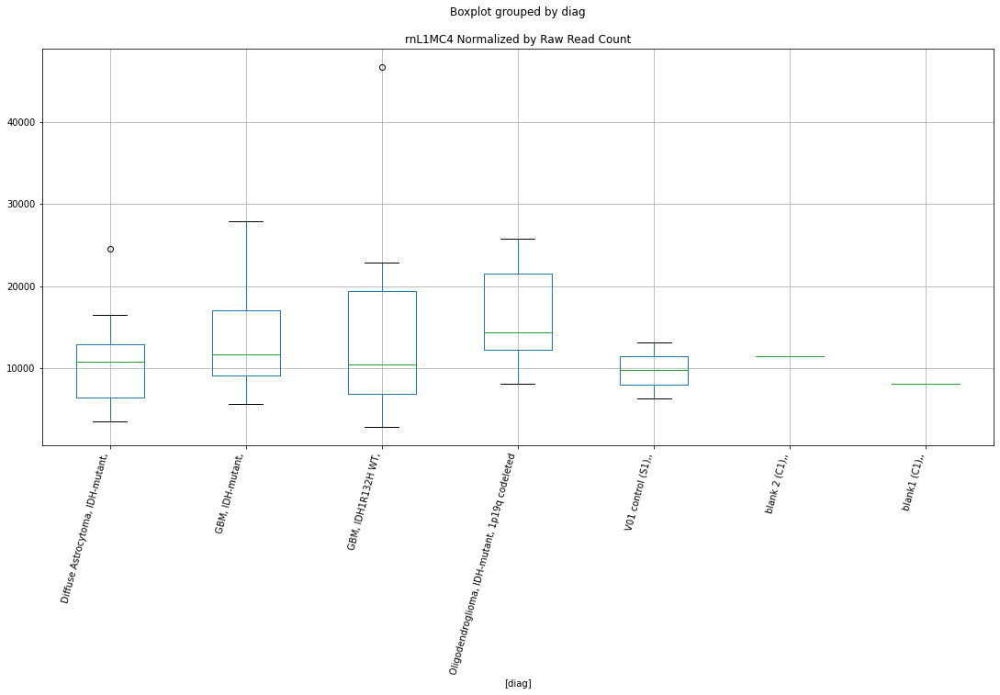

rnL1MA9 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9010682124393123
	p = 0.0734264650107361
rnL1MA9 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9010682124393123
	p = 0.0734264650107361


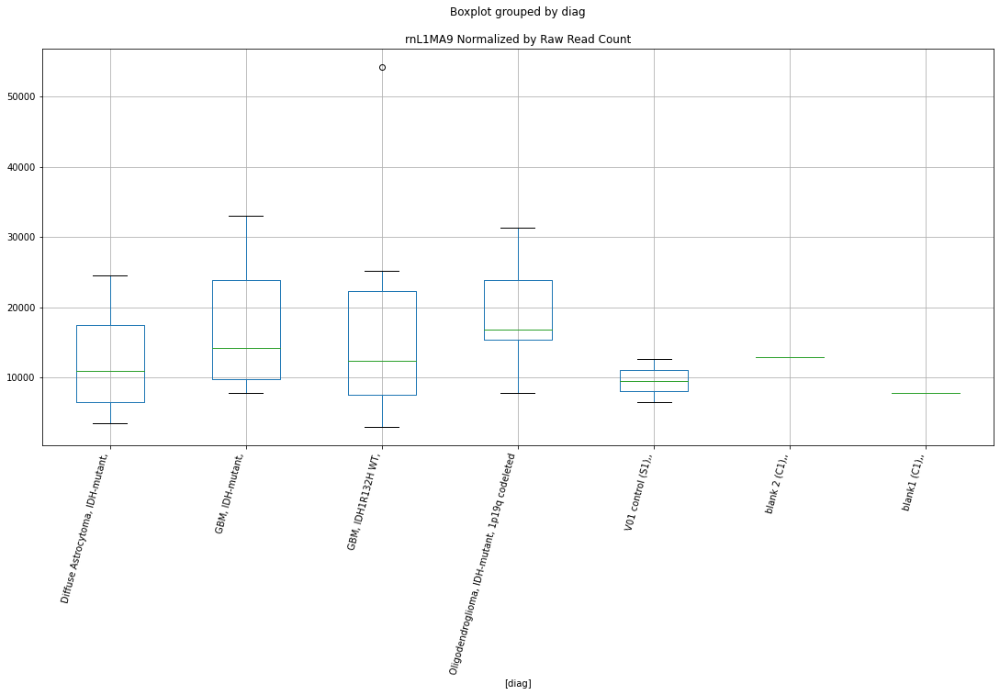

rnL1MA9 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9834143185195188
	p = 0.06278909174650242
rnL1MA9 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9834143185195188
	p = 0.06278909174650242


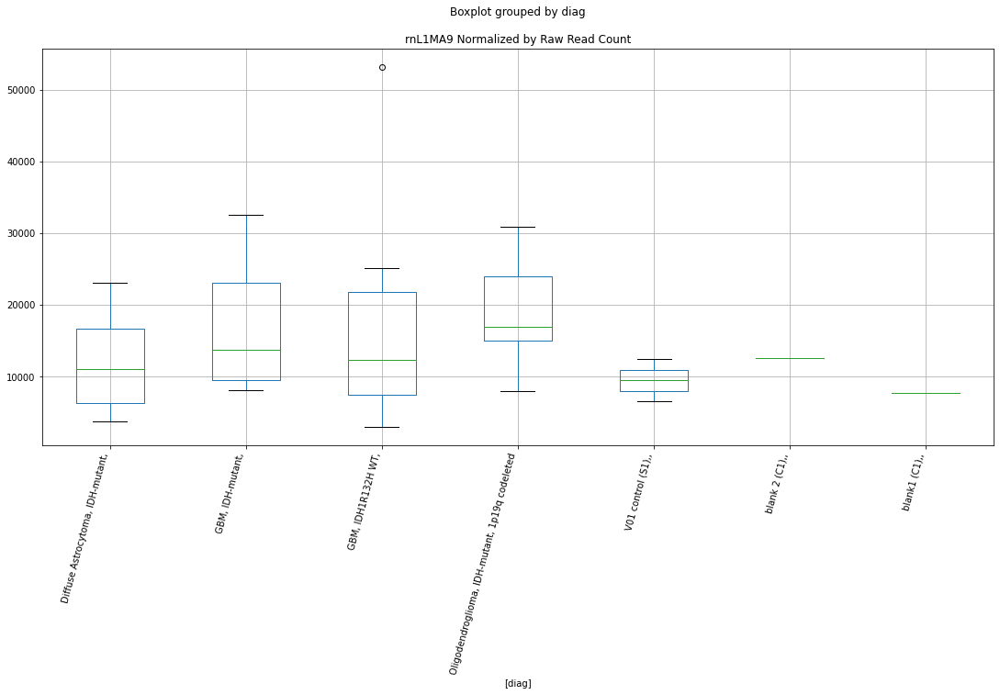

rnL1MA9 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9827624487225957
	p = 0.06286757868720852
rnL1MA9 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9827624487225957
	p = 0.06286757868720852


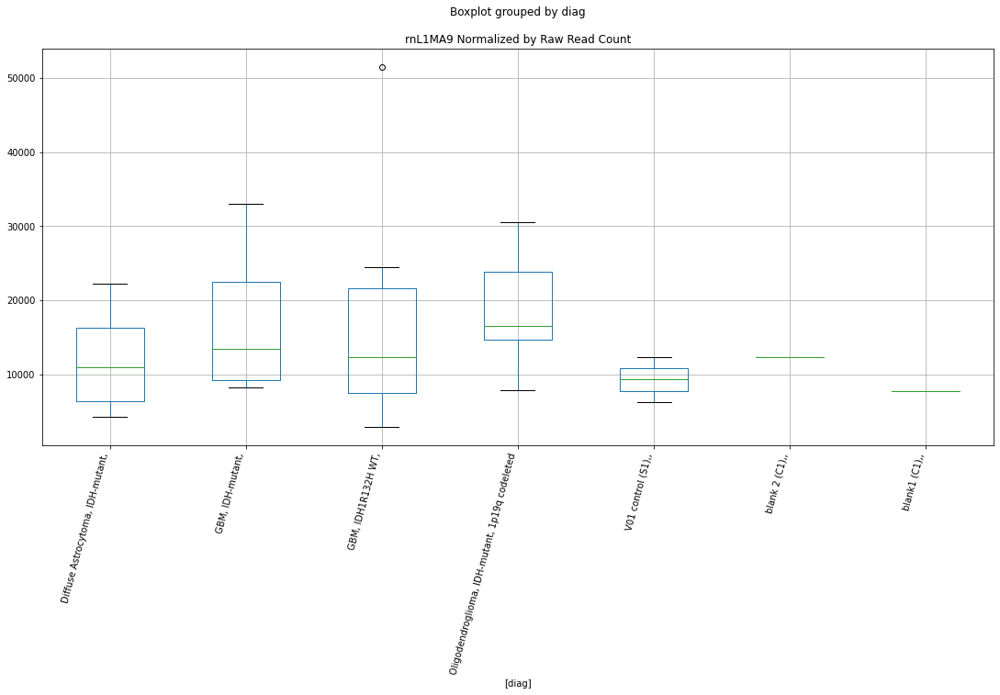

In [72]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmsk_names:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Raw Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


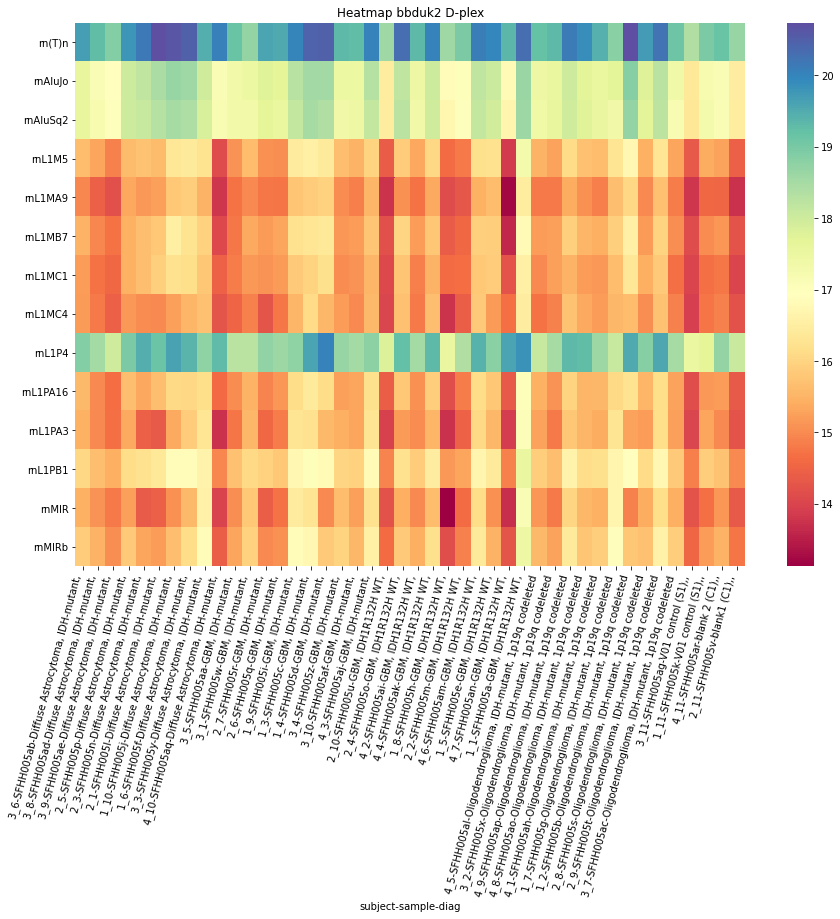

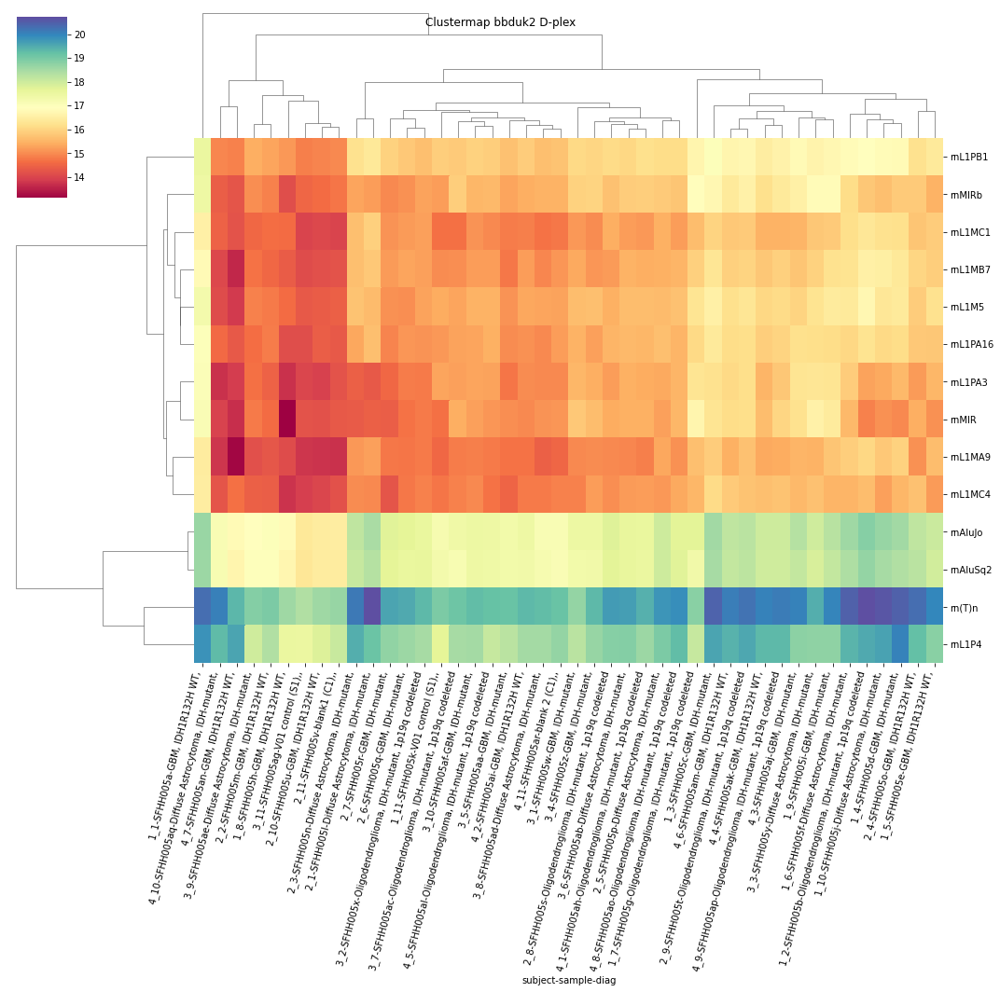

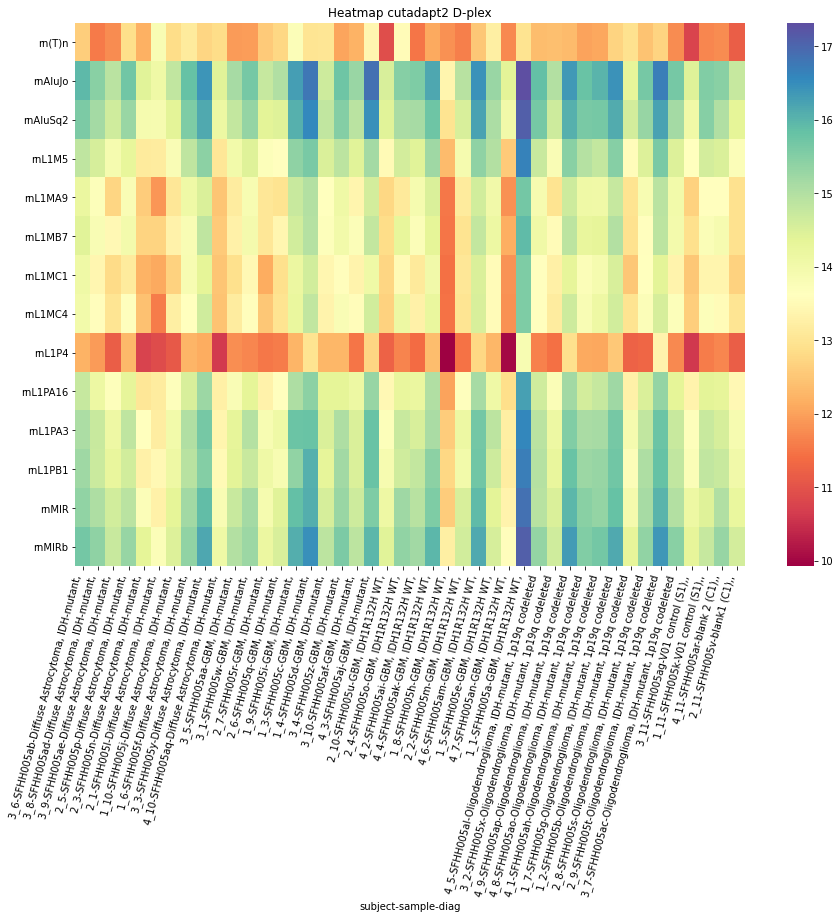

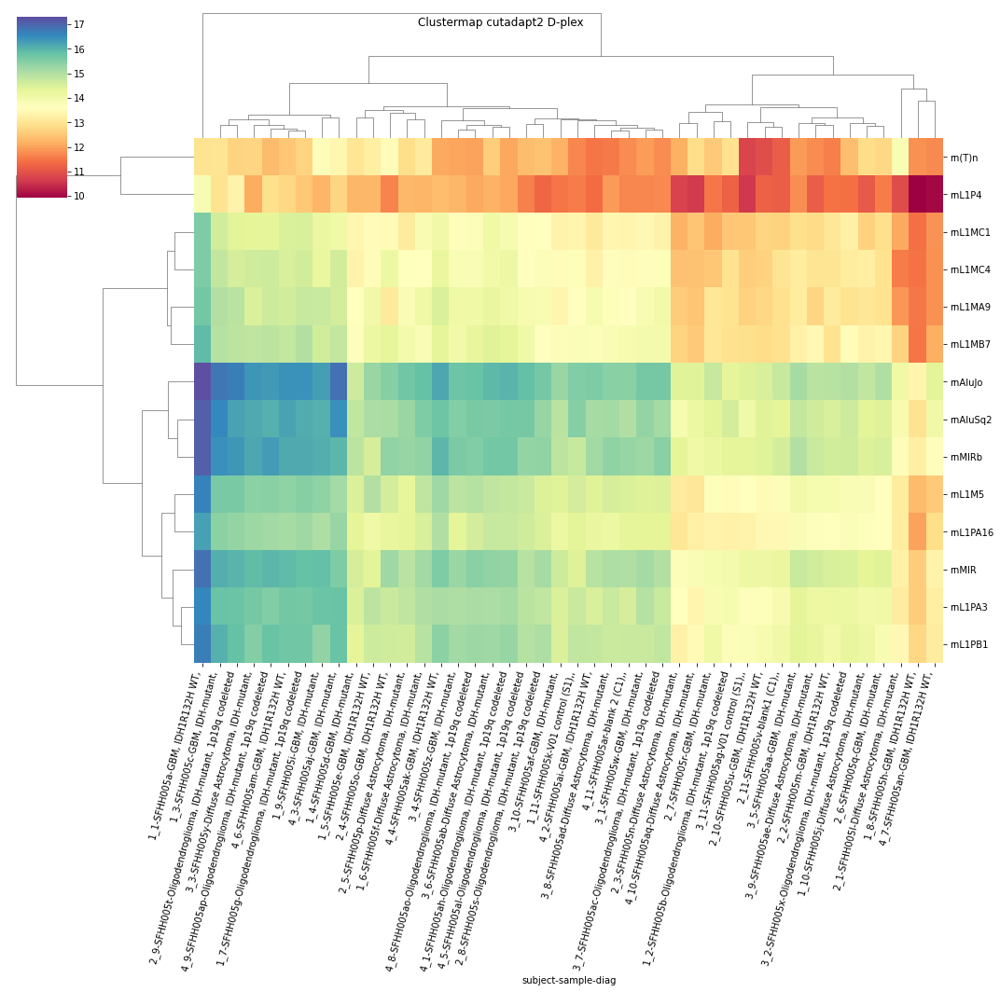

In [73]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

# Normalize by Trimmed Read Count

In [74]:
dfn=df.copy()

In [75]:
dfn.head()

,sample,Subject,Lab kit,Trimmer,Raw Read Count,Raw Read Length,Consolidated Read Count,Consolidated Read %,Trimmed Read Count,Trimmed Ave Read Length,...,rnL1MC1,rnL1MC4,rnL1MA9,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,7706323,201,389715,5.05,99564,34.9853,...,43,57,52,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,7706323,201,389715,5.05,285676,35.8717,...,224,178,206,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,7706323,201,389715,5.05,286024,36.0344,...,230,193,208,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,7706323,201,389715,5.05,129407,52.4444,...,58,72,72,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,7706323,201,389715,5.05,130588,53.2184,...,59,71,71,3_5,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [76]:
dfn[mirnas]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[mirnas])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[genes]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[genes])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[mrnas]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[mrnas])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[diamond_families]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[diamond_families])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[rmsk_families]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmsk_families])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[rmsk_classes]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmsk_classes])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )
dfn[rmsk_names]=dfn.apply(lambda row: 1e9*pd.to_numeric(row[rmsk_names])/pd.to_numeric(row['Trimmed Read Count']), axis=1 )


hsa-mir-5588-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9964055297138819
	p = 0.061243130988625834
hsa-mir-5588-hairpin D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8980230917176026
	p = 0.07384885565022031
hsa-mir-5588-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9964055297138819
	p = 0.061243130988625834
hsa-mir-5588-hairpin D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8980230917176026
	p = 0.07384885565022031


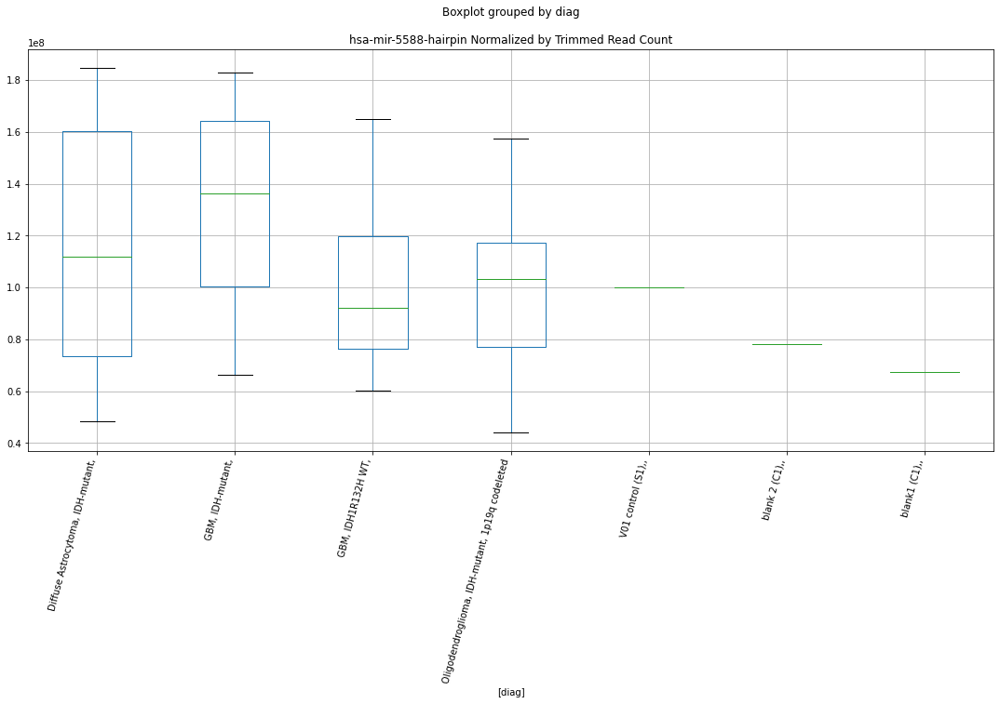

hsa-mir-5588-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9988695326177979
	p = 0.0609537982180714
hsa-mir-5588-hairpin D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9022732346260642
	p = 0.07325990818453294
hsa-mir-5588-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9988695326177979
	p = 0.0609537982180714
hsa-mir-5588-hairpin D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9022732346260642
	p = 0.07325990818453294


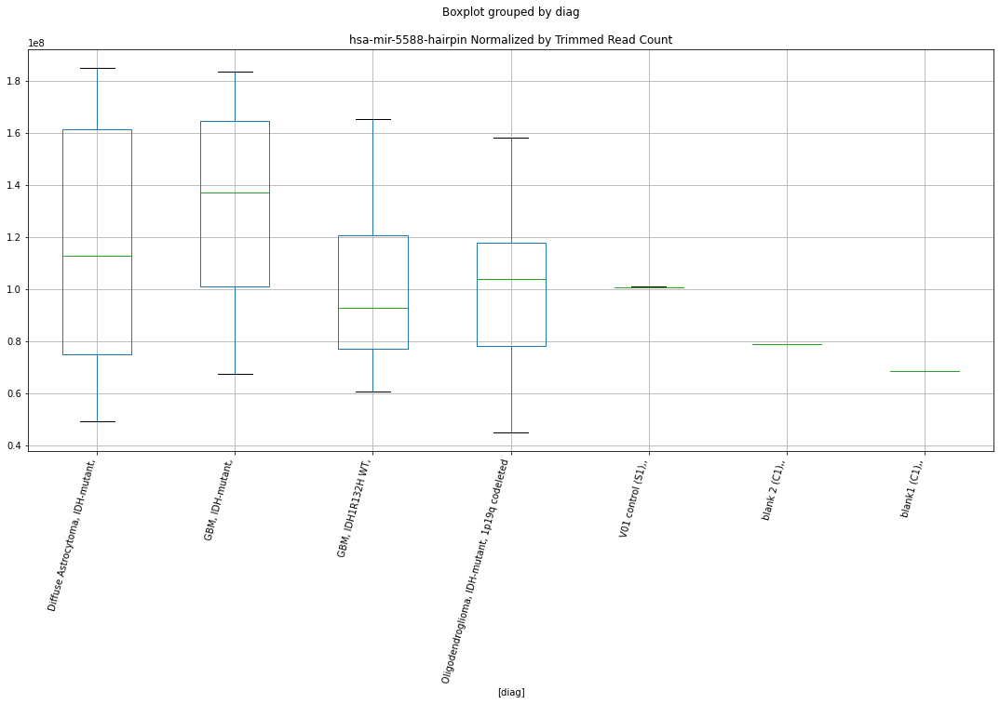

hsa-mir-4329-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9065225923123617
	p = 0.07267523836934207
hsa-mir-4329-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.9065225923123617
	p = 0.07267523836934207


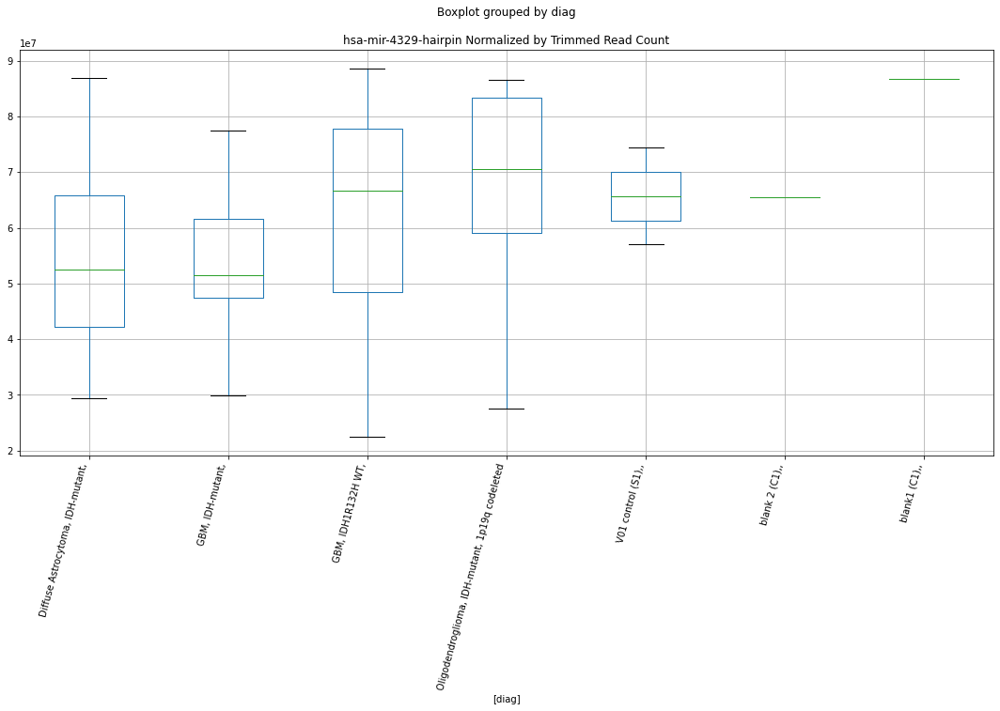

hsa-mir-4329-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9144929407123032
	p = 0.07158975721695791
hsa-mir-4329-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.9144929407123032
	p = 0.07158975721695791


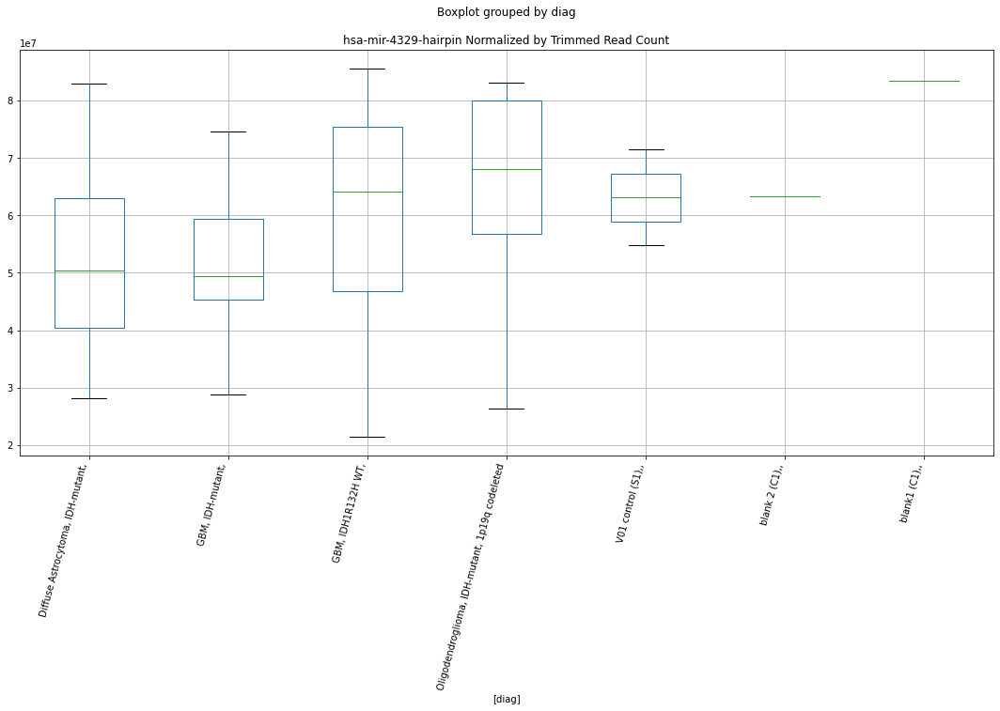

hsa-mir-3908-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.1462400561424086
	p = 0.045735399788350374
hsa-mir-3908-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.1462400561424086
	p = 0.045735399788350374


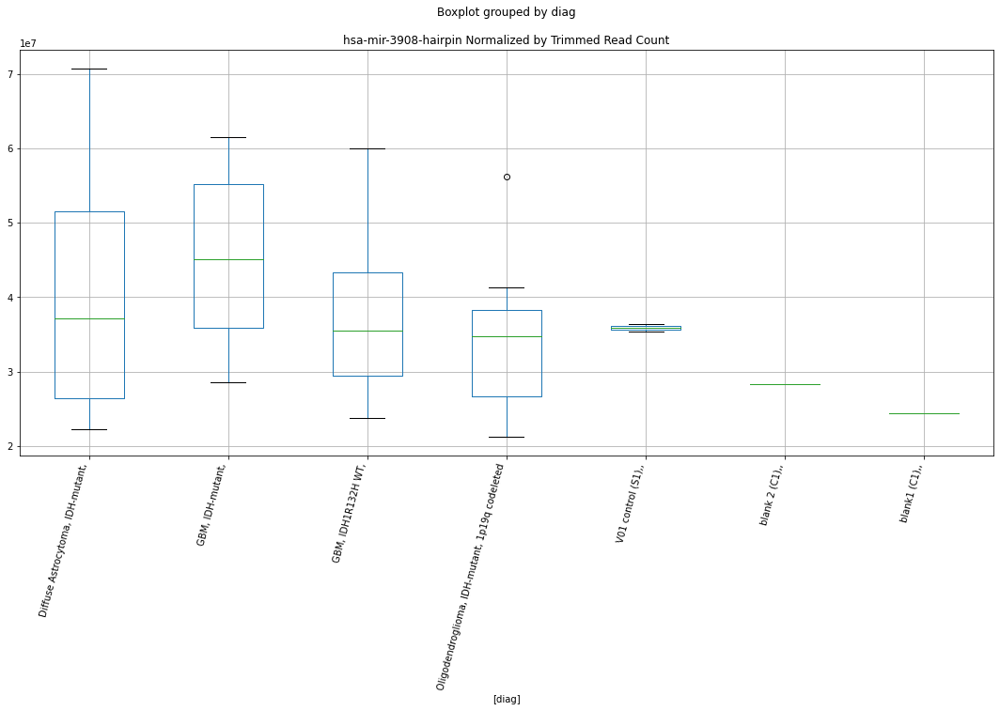

hsa-mir-3908-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.1501851462327397
	p = 0.04538032202295487
hsa-mir-3908-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.1501851462327397
	p = 0.04538032202295487


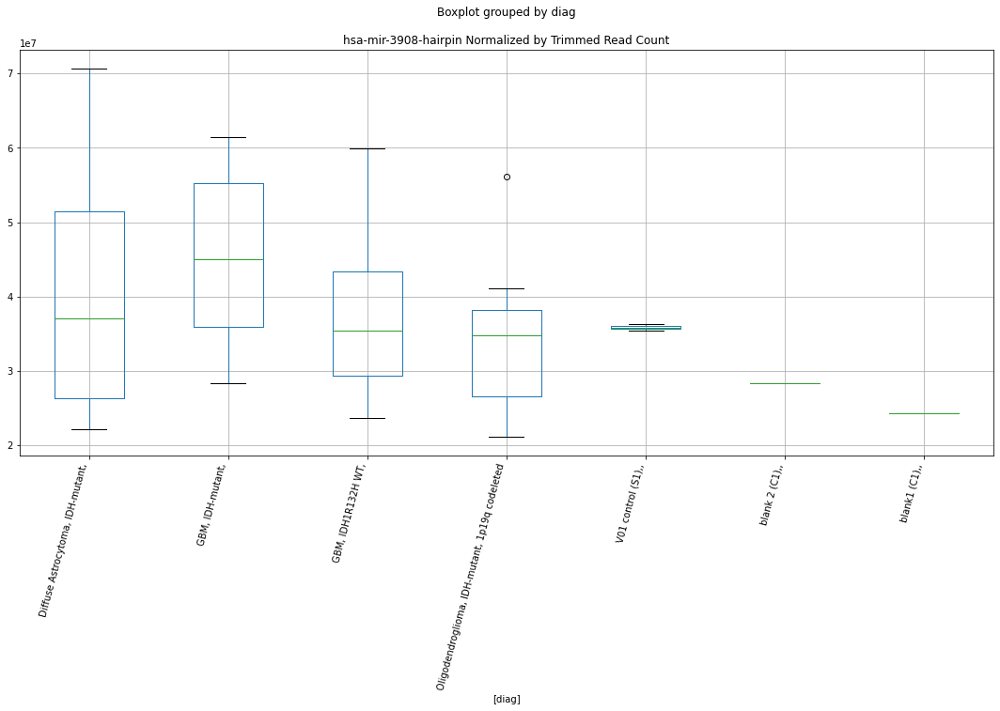

hsa-mir-548u-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0580291688249615
	p = 0.05436613892740814
hsa-mir-548u-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.0580291688249615
	p = 0.05436613892740814


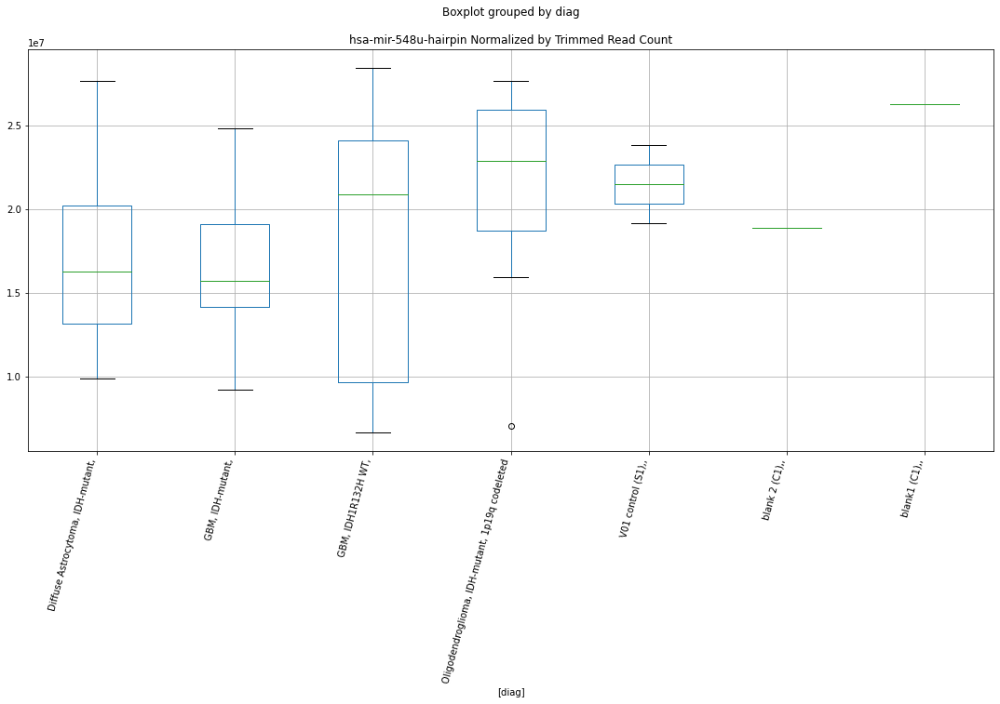

hsa-mir-548u-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0614180113173384
	p = 0.05400901825310873
hsa-mir-548u-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.0614180113173384
	p = 0.05400901825310873


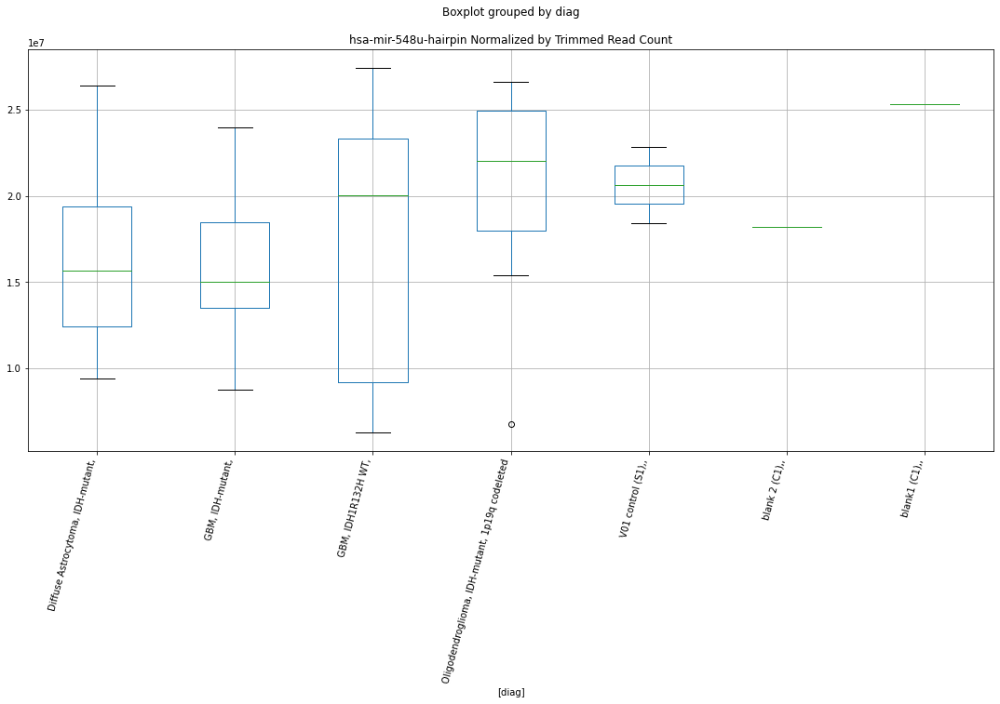

hsa-mir-3613-hairpin D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 2.563001482697737
	p = 0.01956035727067927
hsa-mir-3613-hairpin D-plex bbduk1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.563001482697737
	p = 0.01956035727067927


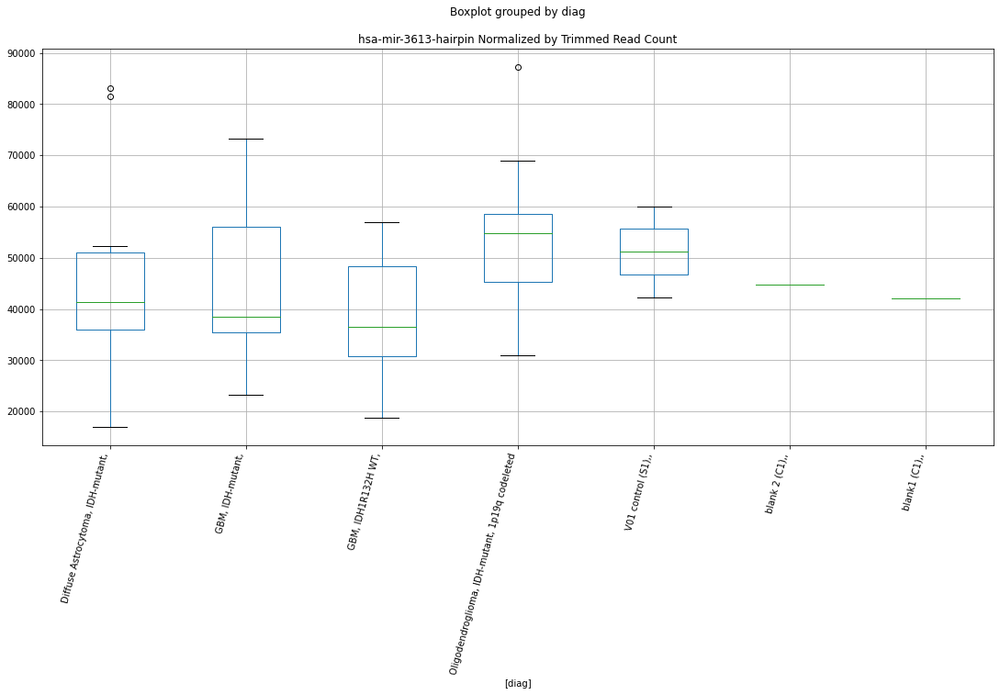

hsa-mir-3613-hairpin D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -3.0624768179890203
	p = 0.006707332455097195
hsa-mir-3613-hairpin D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 3.0624768179890203
	p = 0.006707332455097195


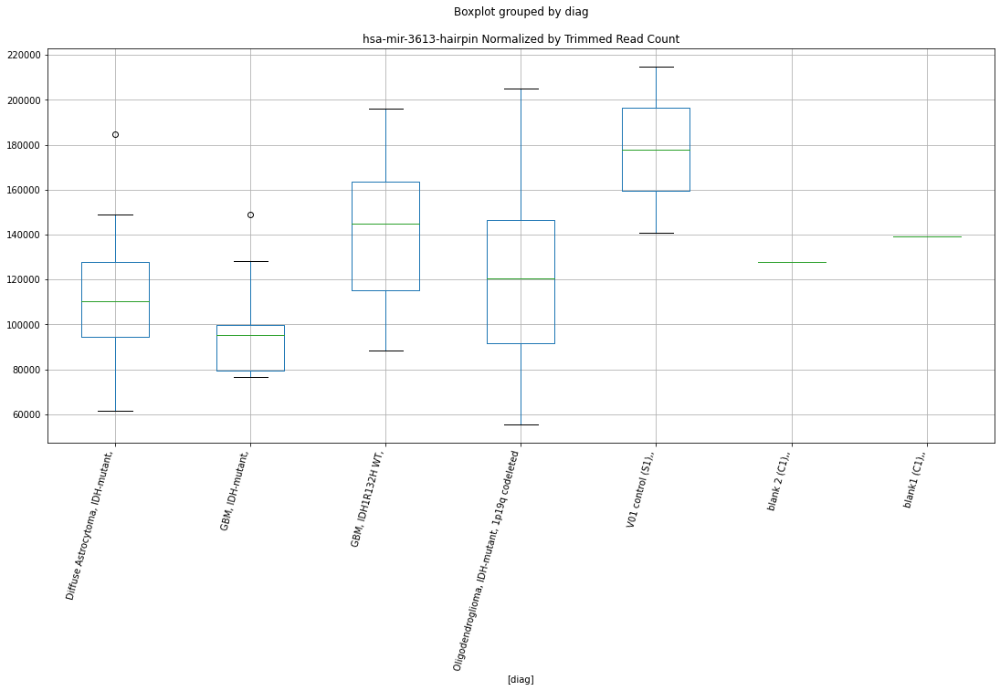

hsa-mir-3613-hairpin D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.0611301872171564
	p = 0.05403926684603248
hsa-mir-3613-hairpin D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.0611301872171564
	p = 0.05403926684603248


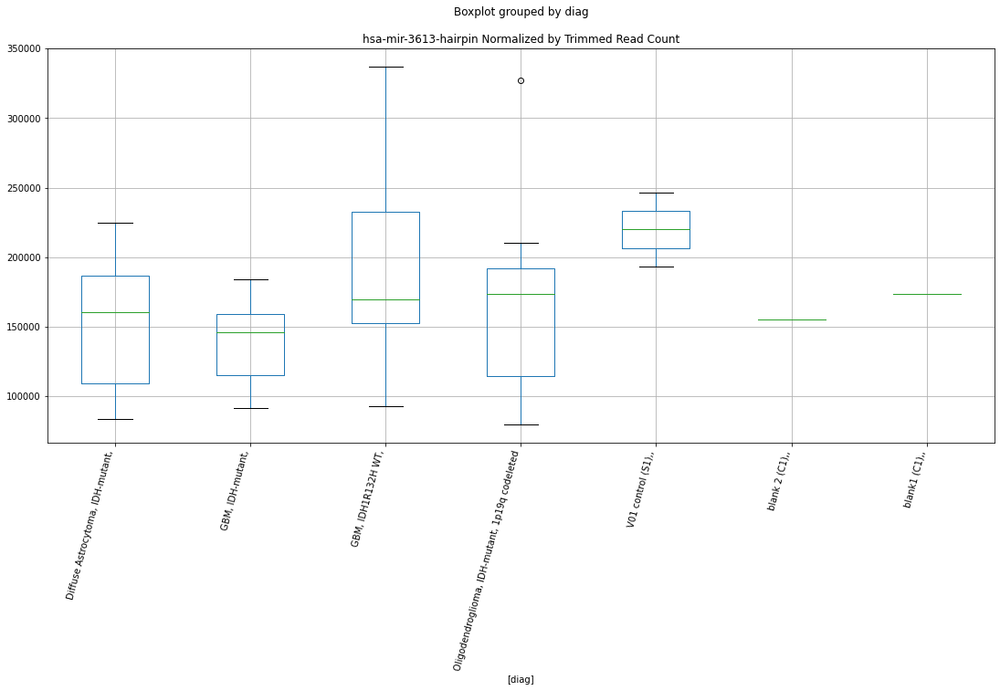

hsa-mir-3613-hairpin D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.5530203727573464
	p = 0.019973216600105814
hsa-mir-3613-hairpin D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.9953288351480567
	p = 0.06136994737098322
hsa-mir-3613-hairpin D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.5530203727573464
	p = 0.019973216600105814
hsa-mir-3613-hairpin D-plex cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9953288351480567
	p = 0.06136994737098322


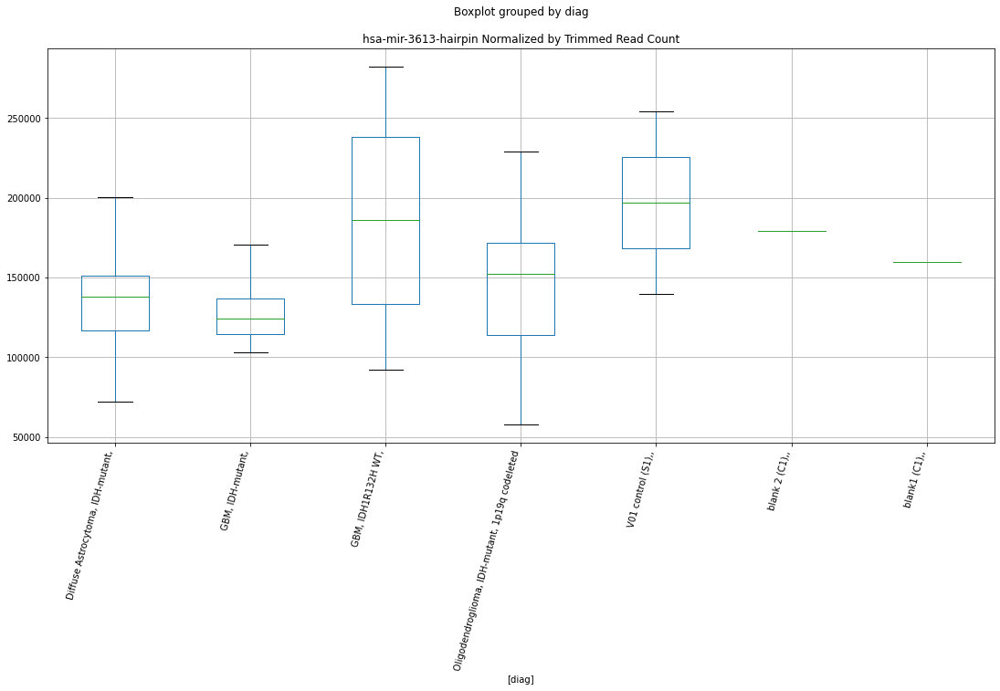

hsa-mir-3613-5p-mature D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.139245371639048
	p = 0.04637119985339525
hsa-mir-3613-5p-mature D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.268340283337833
	p = 0.035848014488328896
hsa-mir-3613-5p-mature D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.5366357868589122
	p = 0.020668870516977748
hsa-mir-3613-5p-mature D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 2.139245371639048
	p = 0.04637119985339525
hsa-mir-3613-5p-mature D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.268340283337833
	p = 0.035848014488328896
hsa-mir-3613-5p-mature D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.5366357868589122
	p = 0.020668870516977748


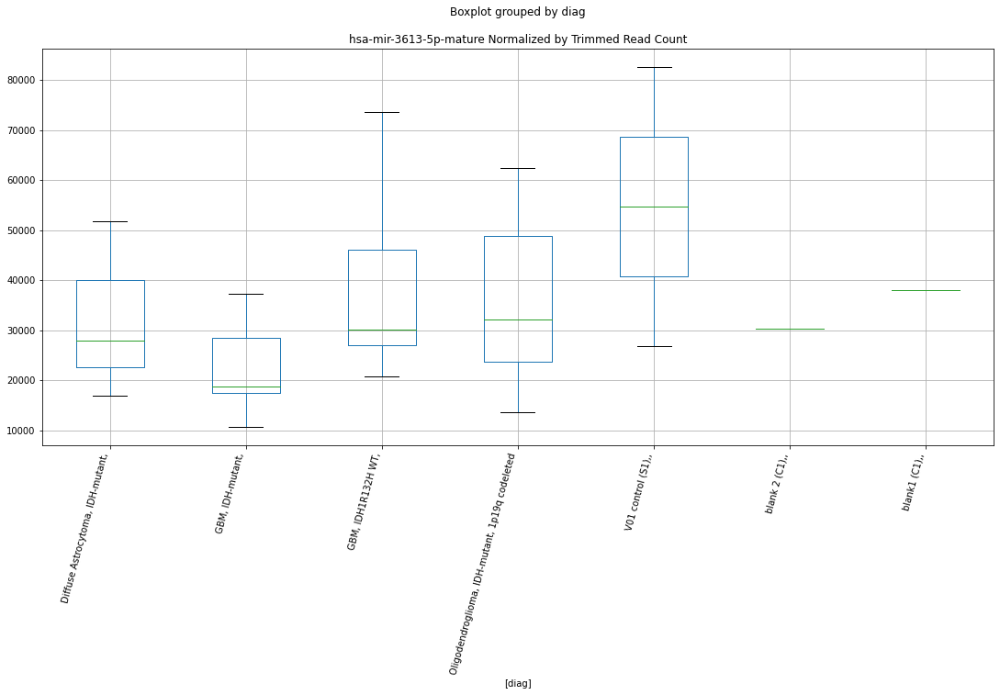

hsa-mir-3613-5p-mature D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.8685911943296212
	p = 0.07804361564663226
hsa-mir-3613-5p-mature D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.8685911943296212
	p = 0.07804361564663226


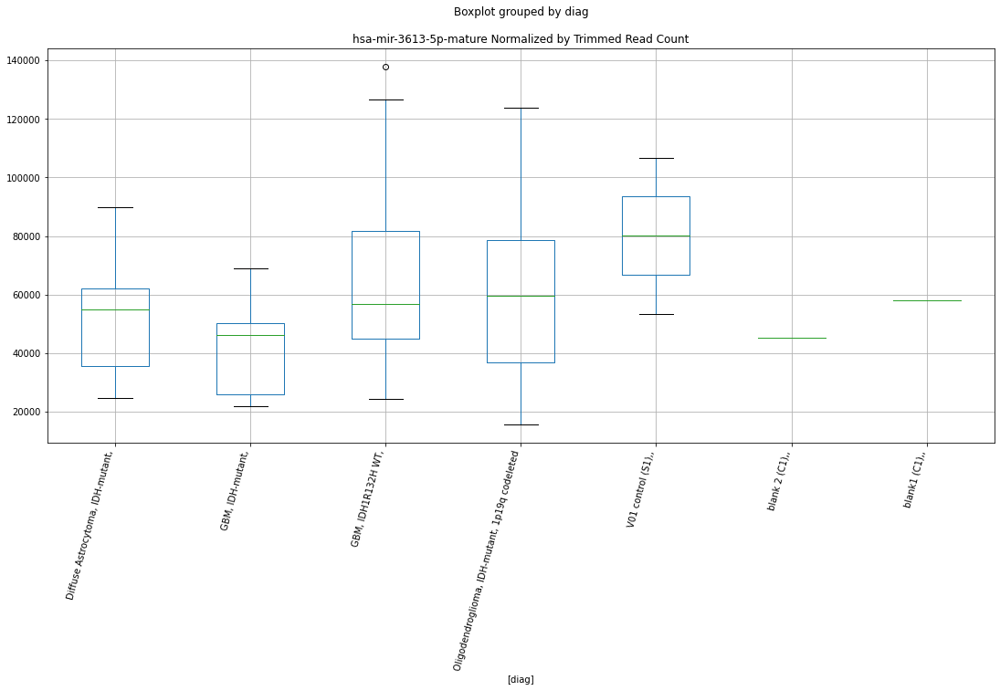

hsa-mir-3613-5p-mature D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.6067699617265188
	p = 0.01784349922805234
hsa-mir-3613-5p-mature D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.6067699617265188
	p = 0.01784349922805234


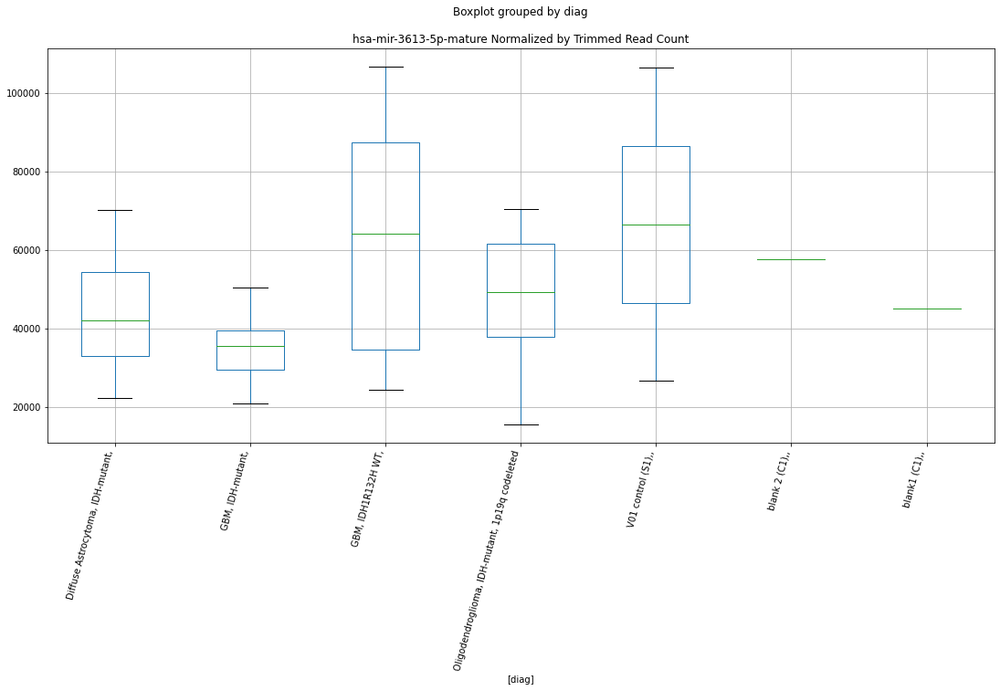

hsa-mir-3658-hairpin D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.745326398346187
	p = 0.09797532016756948
hsa-mir-3658-hairpin D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.745326398346187
	p = 0.09797532016756948


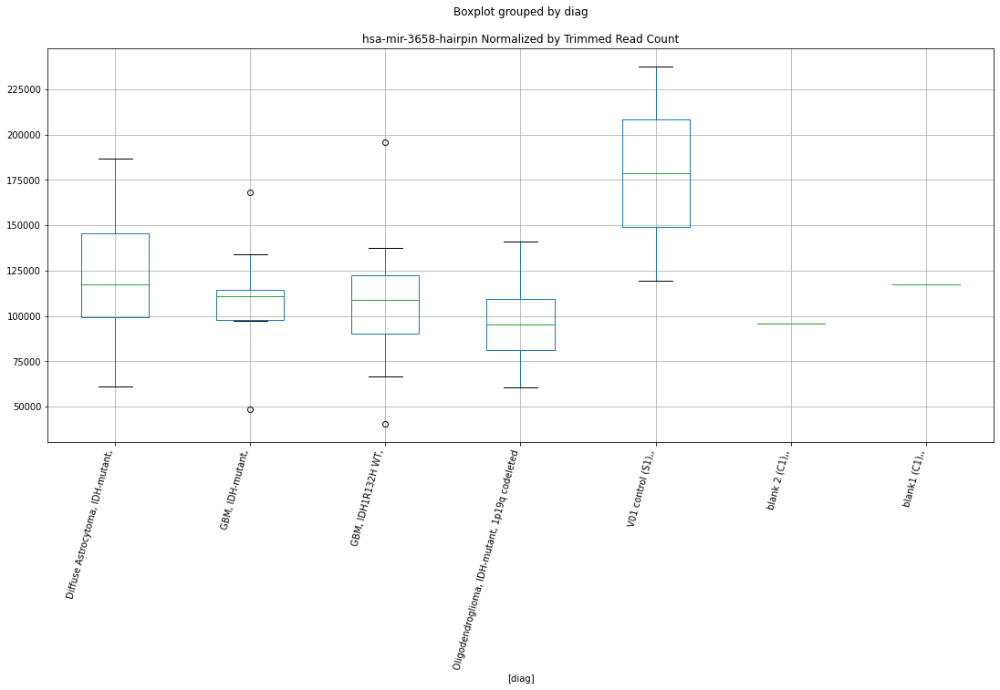

hsa-mir-1303-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8532785588418663
	p = 0.08030818092319594
hsa-mir-1303-hairpin D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 1.8532785588418663
	p = 0.08030818092319594


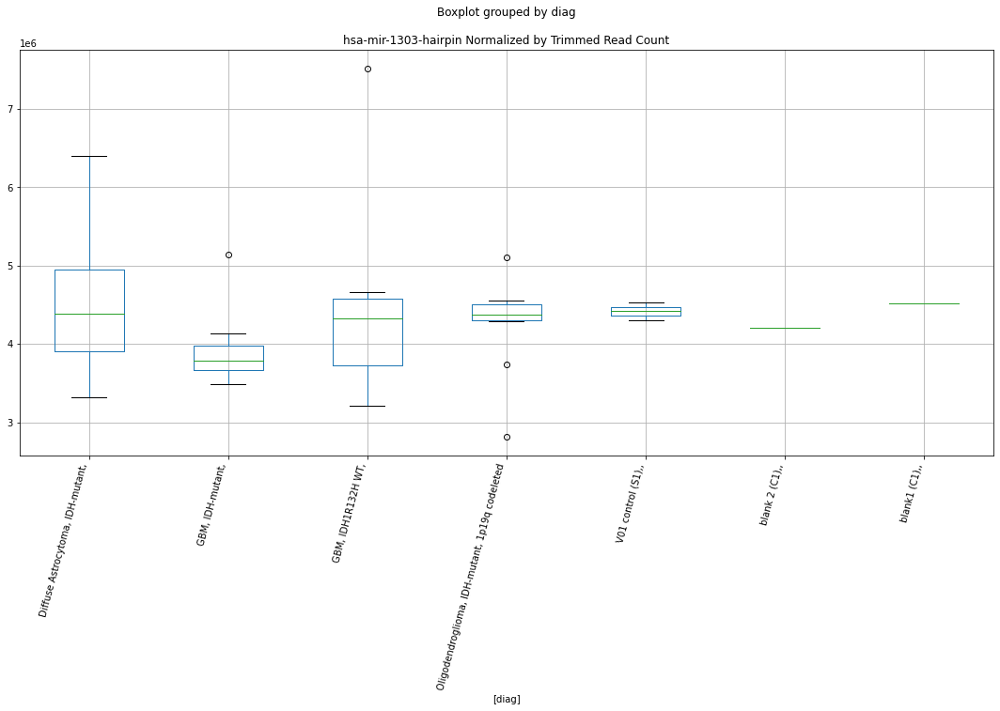

hsa-mir-1303-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8395051664924464
	p = 0.08239435775584161
hsa-mir-1303-hairpin D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 1.8395051664924464
	p = 0.08239435775584161


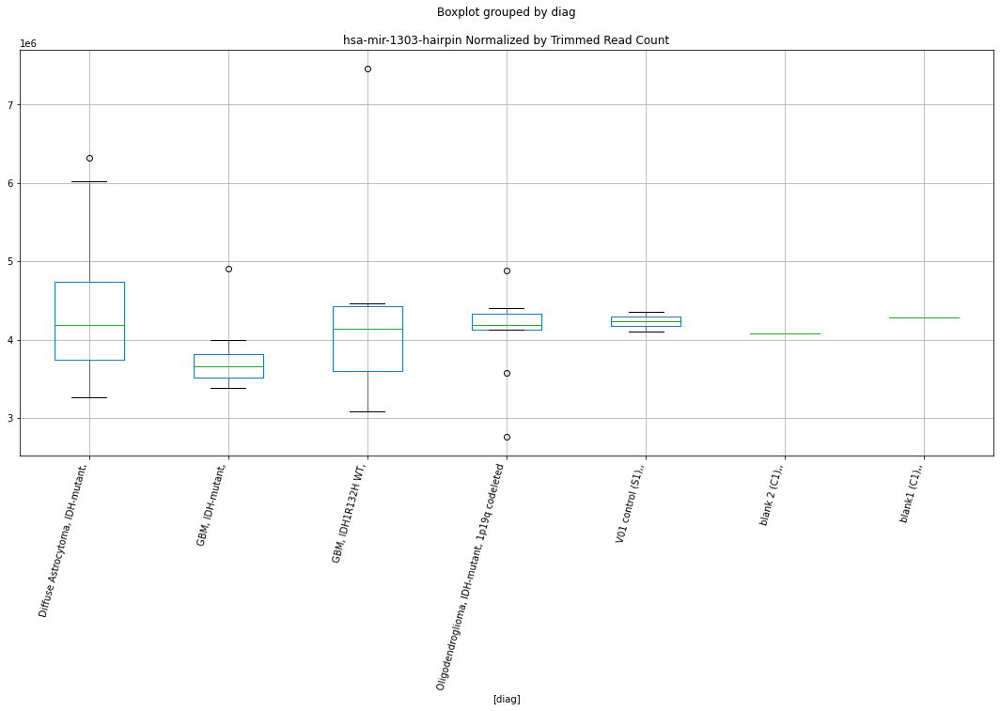

hsa-mir-9983-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9232697967486985
	p = 0.07041112489220837
hsa-mir-9983-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9232697967486985
	p = 0.07041112489220837


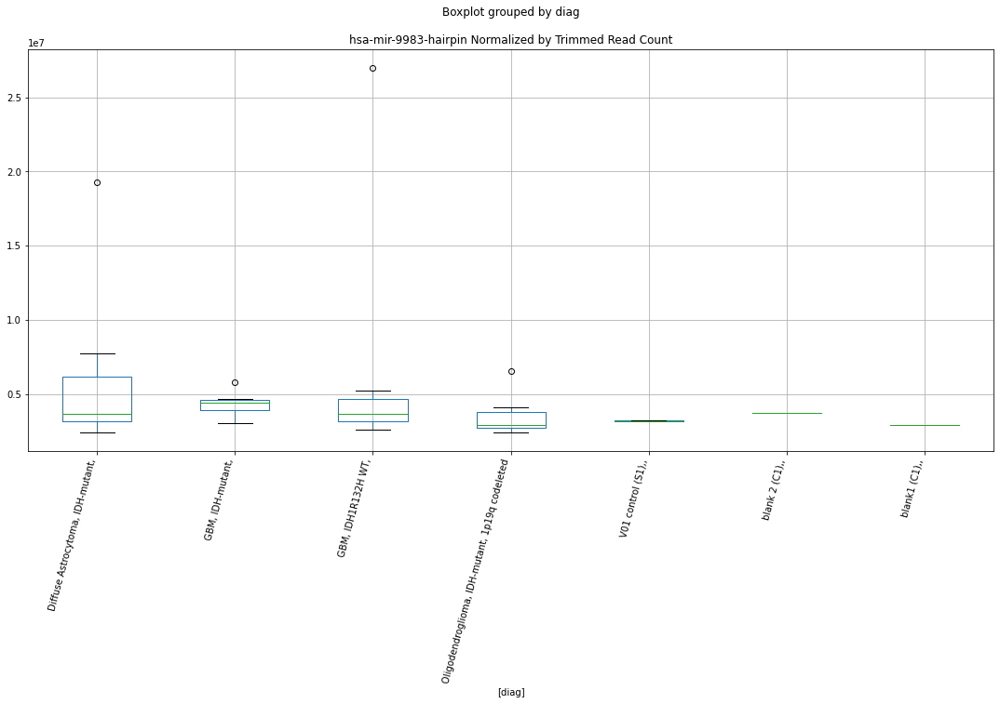

hsa-mir-9983-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.939432916613973
	p = 0.06828569772363074
hsa-mir-9983-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.939432916613973
	p = 0.06828569772363074


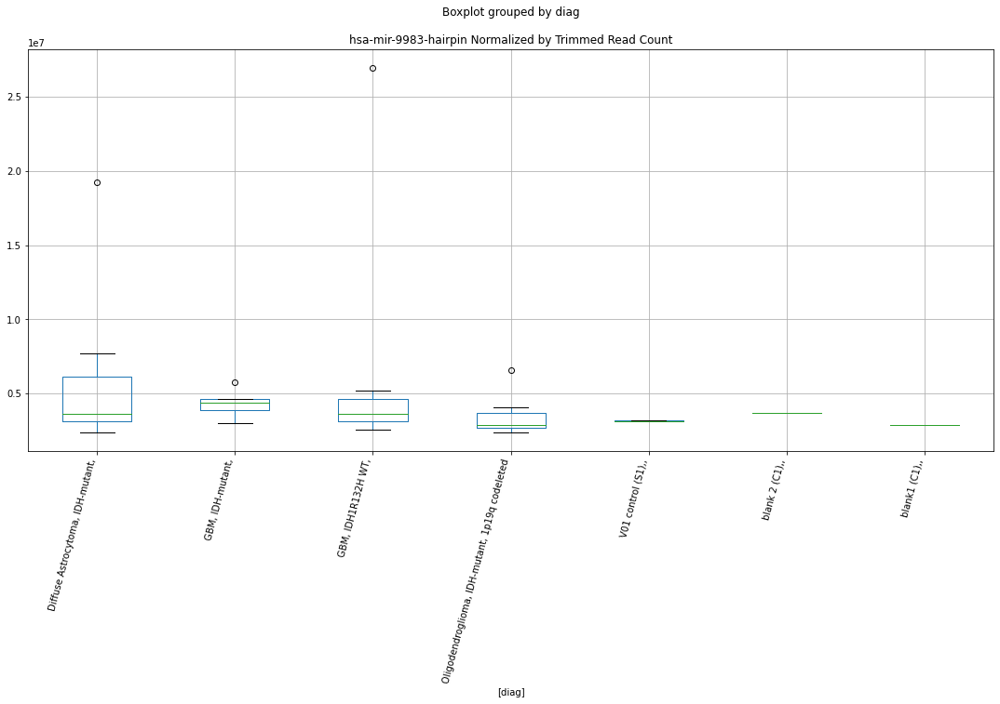

hsa-mir-3613-3p-mature D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.750972740647814
	p = 0.09697372482794389
hsa-mir-3613-3p-mature D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.750972740647814
	p = 0.09697372482794389


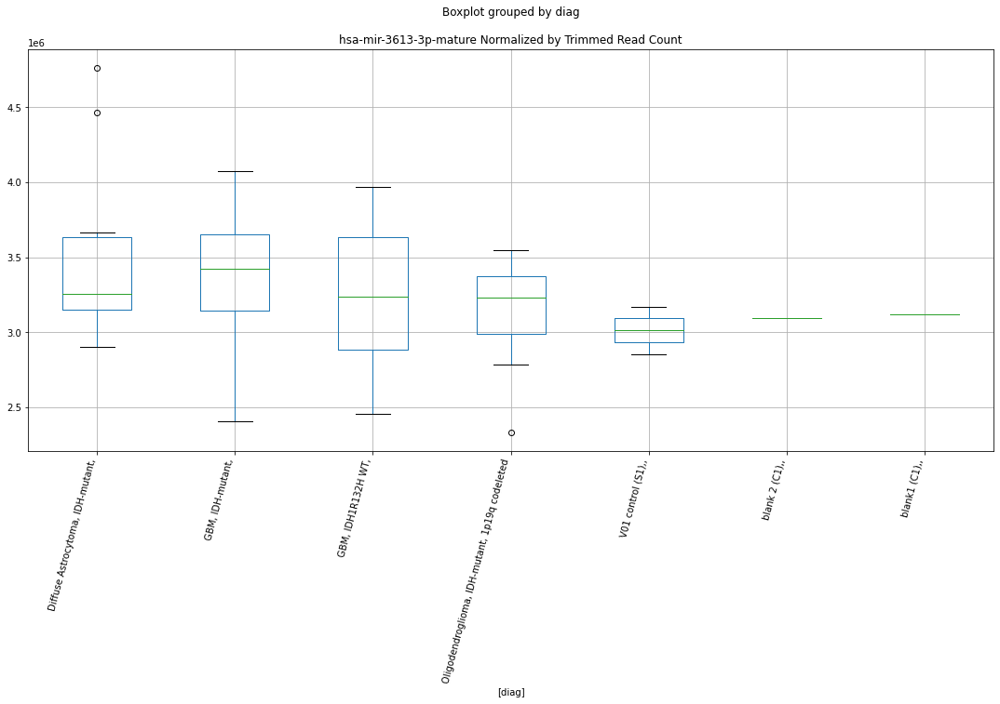

hsa-mir-3613-3p-mature D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.459894479359016
	p = 0.024242514214129873
hsa-mir-3613-3p-mature D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.1574544305407555
	p = 0.04473264035196629
hsa-mir-3613-3p-mature D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -2.588928031045384
	p = 0.018525359222346445
hsa-mir-3613-3p-mature D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.459894479359016
	p = 0.024242514214129873
hsa-mir-3613-3p-mature D-plex cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.1574544305407555
	p = 0.04473264035196629
hsa-mir-3613-3p-mature D-plex cutadapt1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.588928031045384
	p = 0.018525359222346445


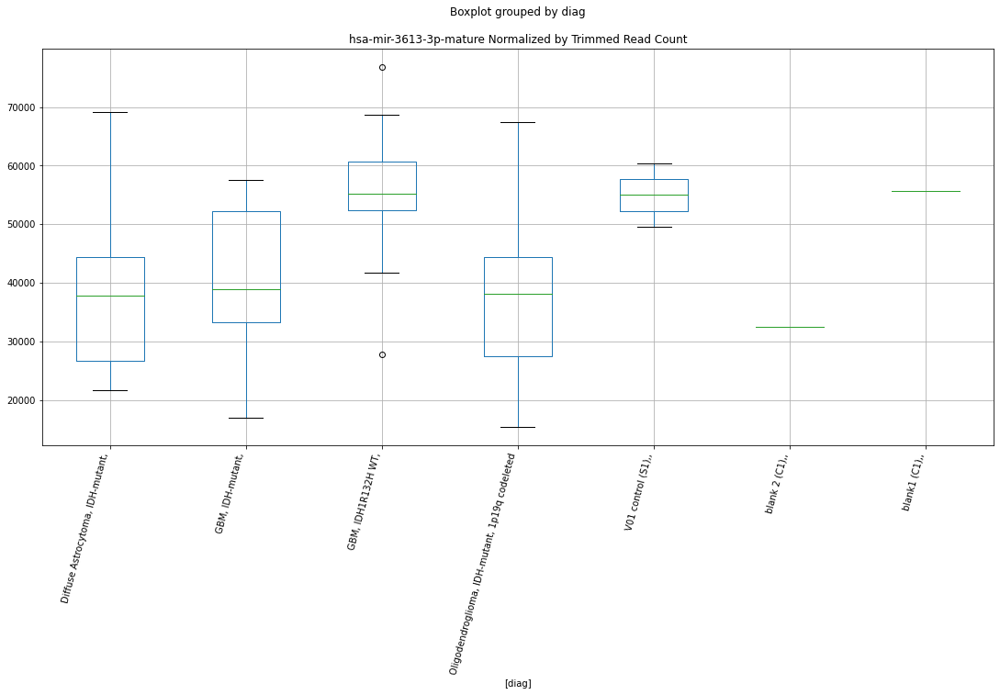

hsa-mir-3613-3p-mature D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.379072971123345
	p = 0.028628865759207384
hsa-mir-3613-3p-mature D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.279324509297735
	p = 0.035062918154785475
hsa-mir-3613-3p-mature D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -2.509797934071441
	p = 0.021858023219252783
hsa-mir-3613-3p-mature D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.379072971123345
	p = 0.028628865759207384
hsa-mir-3613-3p-mature D-plex cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.279324509297735
	p = 0.035062918154785475
hsa-mir-3613-3p-mature D-plex cutadapt2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.509797934071441
	p = 0.021858023219252783


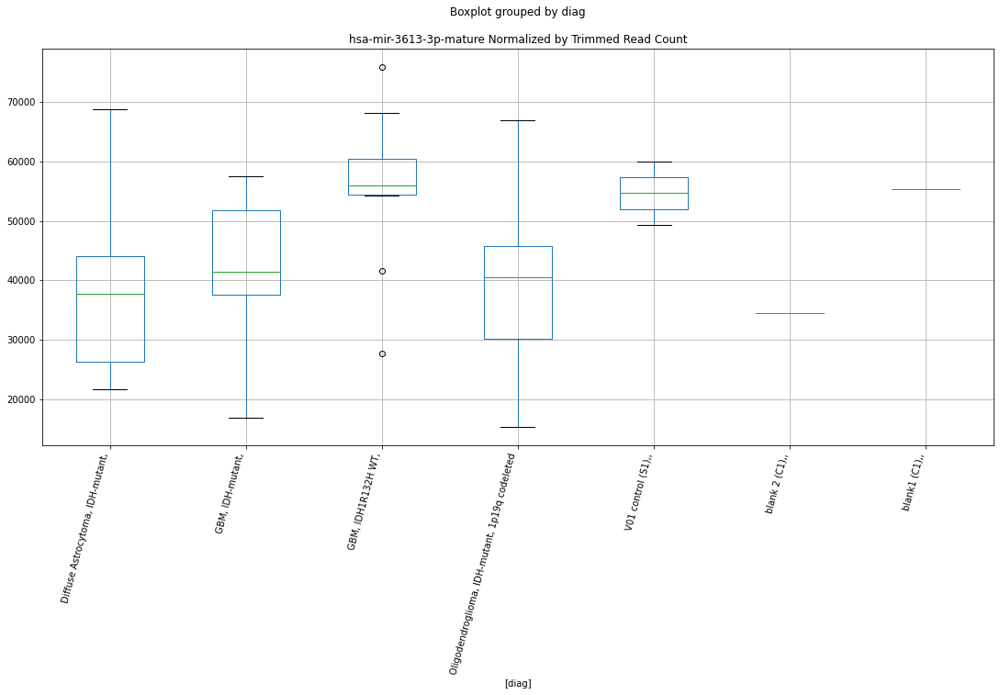

hsa-mir-3613-3p-mature D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.594348893811572
	p = 0.018315620230996484
hsa-mir-3613-3p-mature D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.5204371254332516
	p = 0.021379089578620347
hsa-mir-3613-3p-mature D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -2.8684129951141872
	p = 0.010218492473596243
hsa-mir-3613-3p-mature D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.594348893811572
	p = 0.018315620230996484
hsa-mir-3613-3p-mature D-plex cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.5204371254332516
	p = 0.021379089578620347
hsa-mir-3613-3p-mature D-plex cutadapt3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.8684129951141872
	p = 0.010218492473596243


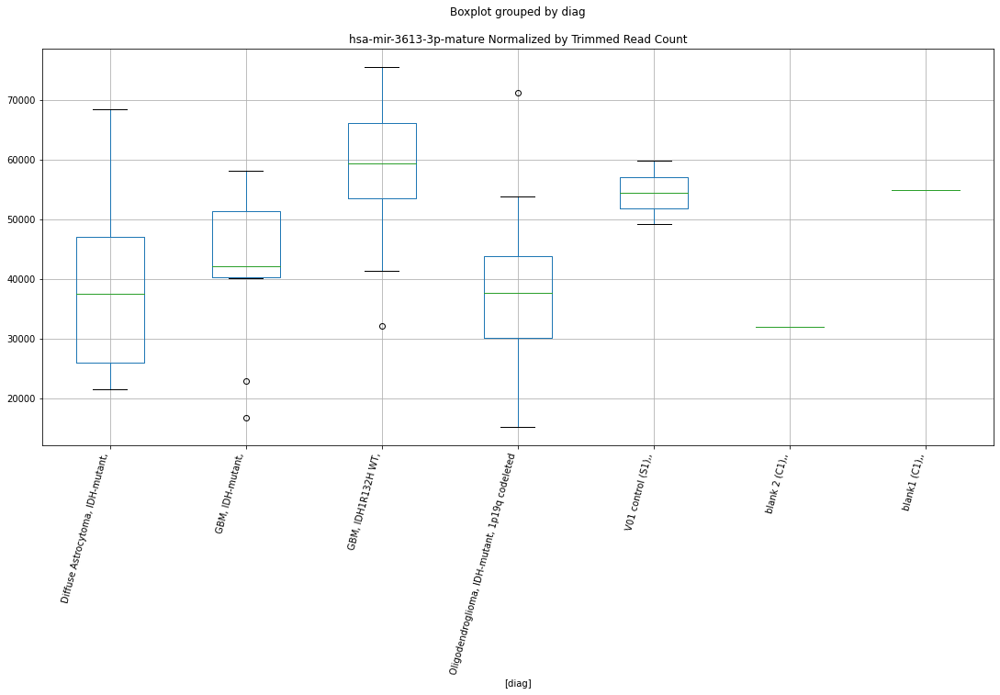

hsa-mir-320c-1-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.5859109227028356
	p = 0.018643078966113613
hsa-mir-320c-1-hairpin D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7465721864596215
	p = 0.09775356438750325
hsa-mir-320c-1-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.5859109227028356
	p = 0.018643078966113613
hsa-mir-320c-1-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7465721864596215
	p = 0.09775356438750325


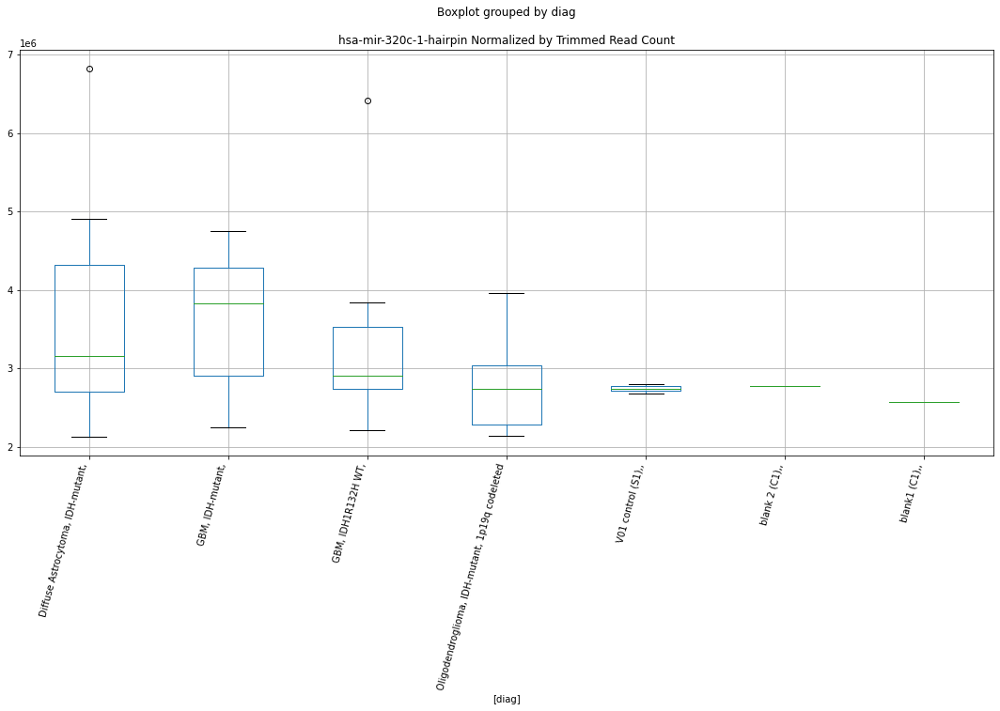

hsa-mir-320c-1-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.6741961952368984
	p = 0.015475934960621504
hsa-mir-320c-1-hairpin D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8880433468152185
	p = 0.07524828634617907
hsa-mir-320c-1-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.6741961952368984
	p = 0.015475934960621504
hsa-mir-320c-1-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8880433468152185
	p = 0.07524828634617907


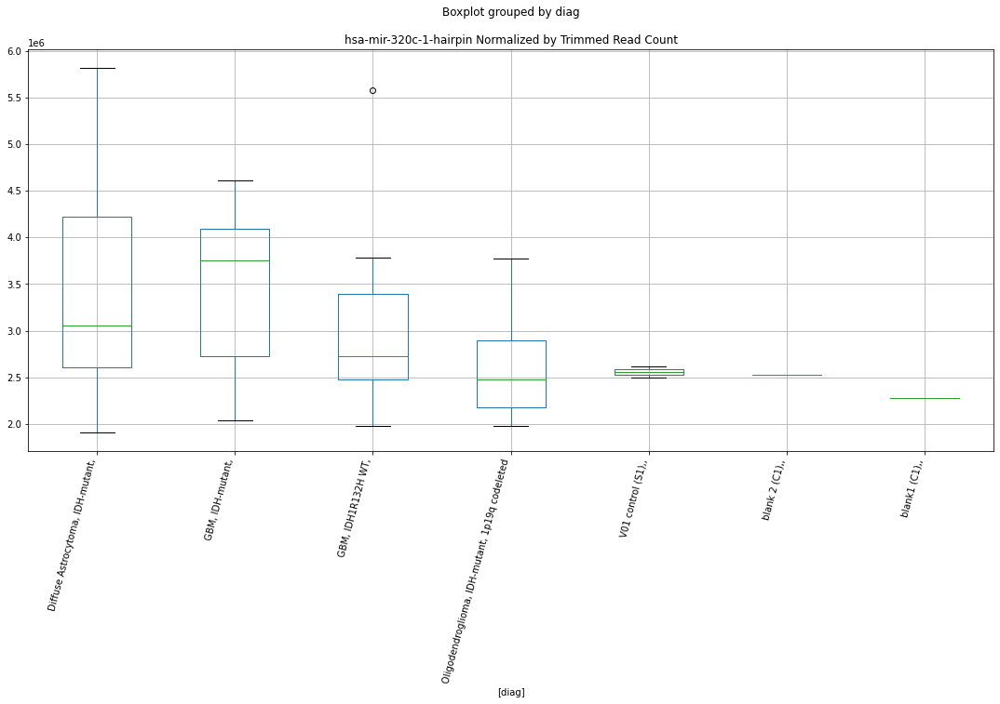

hsa-mir-320c-1-hairpin D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.067825324359269
	p = 0.05333960324684916
hsa-mir-320c-1-hairpin D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.067825324359269
	p = 0.05333960324684916


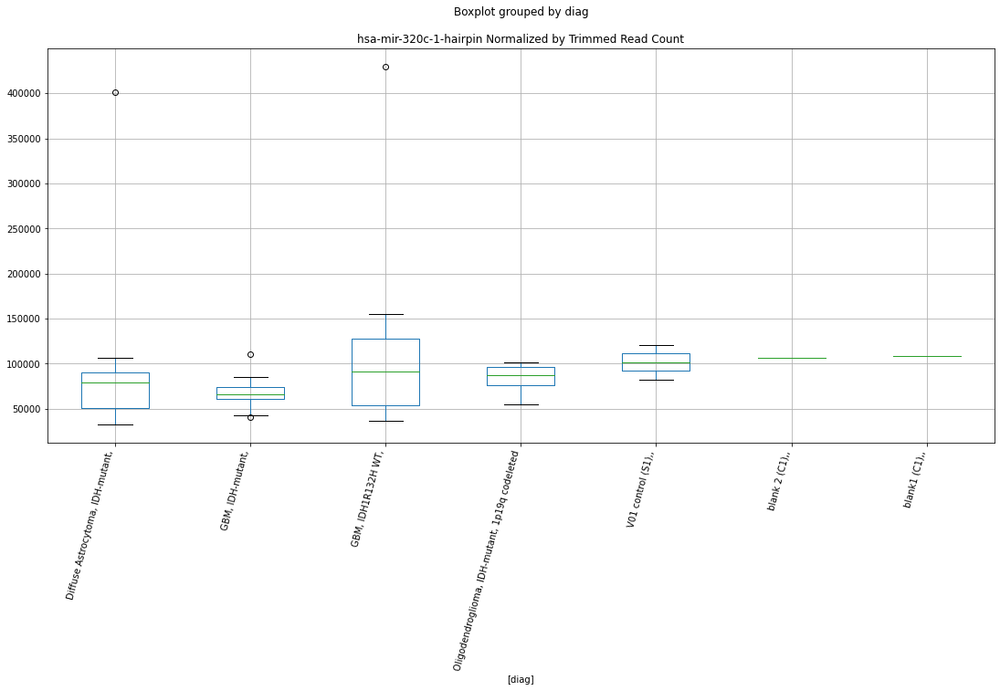

hsa-mir-320c-1-hairpin D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.150818818817269
	p = 0.045323523680571826
hsa-mir-320c-1-hairpin D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.150818818817269
	p = 0.045323523680571826


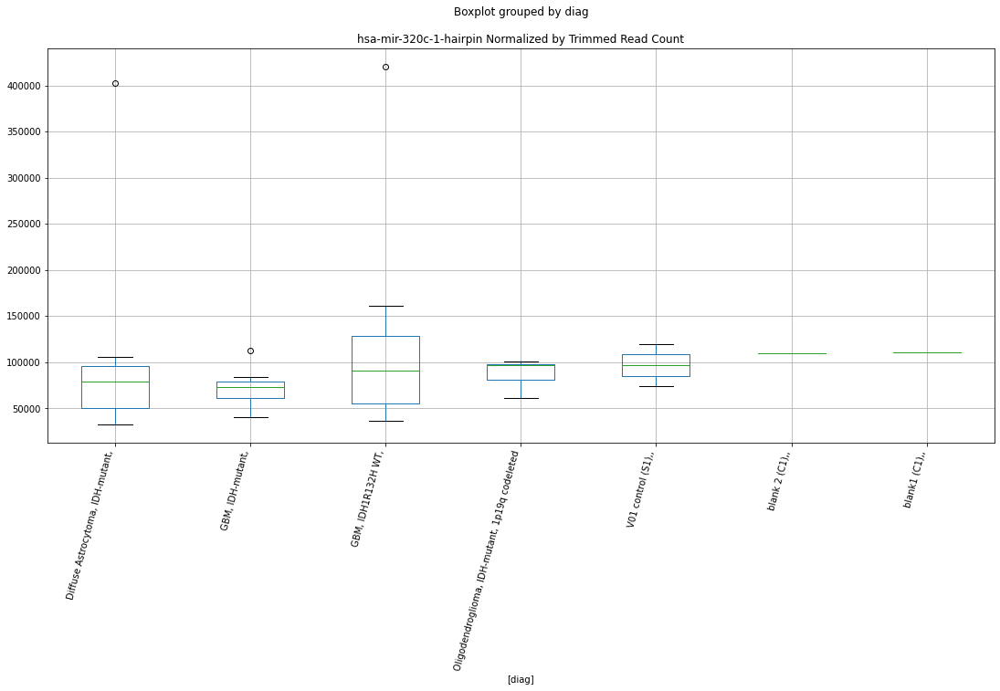

hsa-mir-320c-1-hairpin D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0220235285336026
	p = 0.05829439003962051
hsa-mir-320c-1-hairpin D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.0220235285336026
	p = 0.05829439003962051


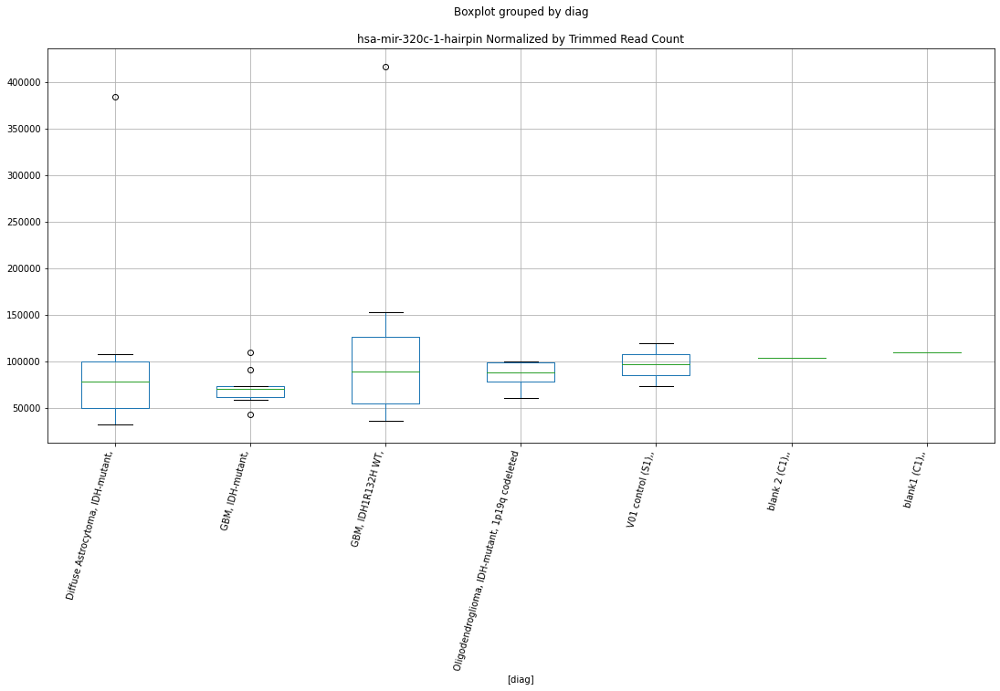

hsa-mir-6887-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8847813941598741
	p = 0.07571076547974395
hsa-mir-6887-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8847813941598741
	p = 0.07571076547974395


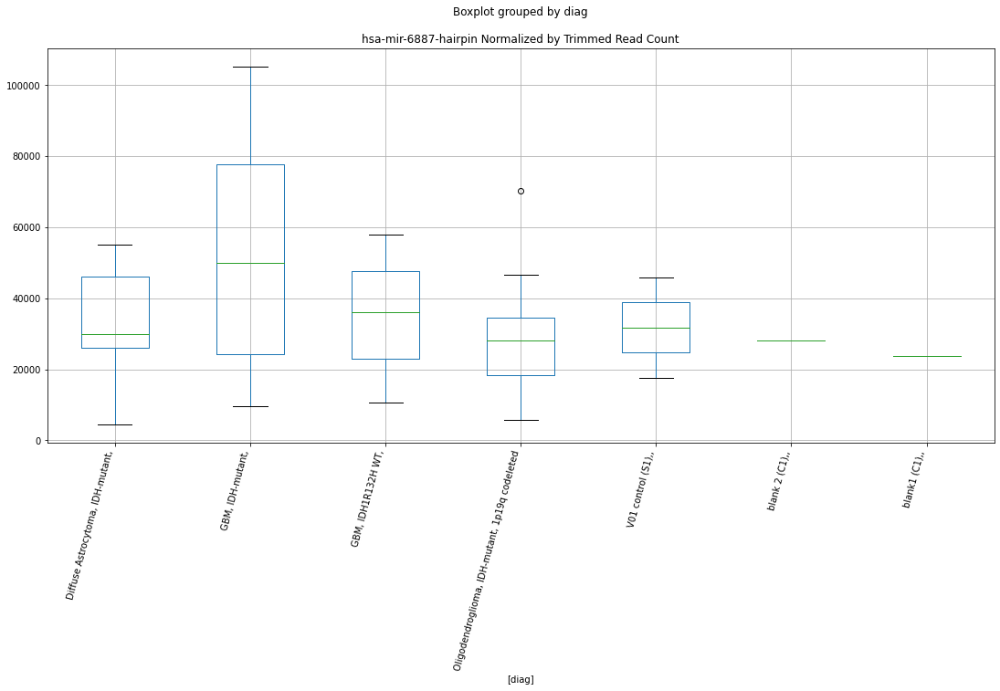

hsa-mir-6887-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8627268757106092
	p = 0.07890413773944623
hsa-mir-6887-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8627268757106092
	p = 0.07890413773944623


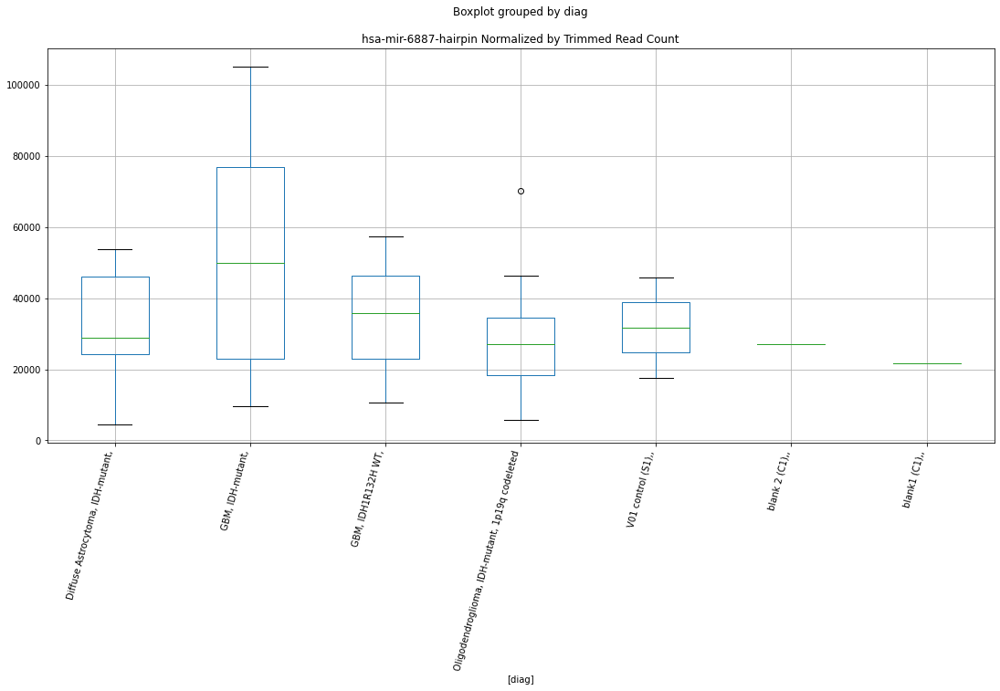

hsa-mir-6887-5p-mature D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7373859532994316
	p = 0.09939902034529319
hsa-mir-6887-5p-mature D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7639349557914568
	p = 0.09470791862187831
hsa-mir-6887-5p-mature D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7373859532994316
	p = 0.09939902034529319
hsa-mir-6887-5p-mature D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7639349557914568
	p = 0.09470791862187831


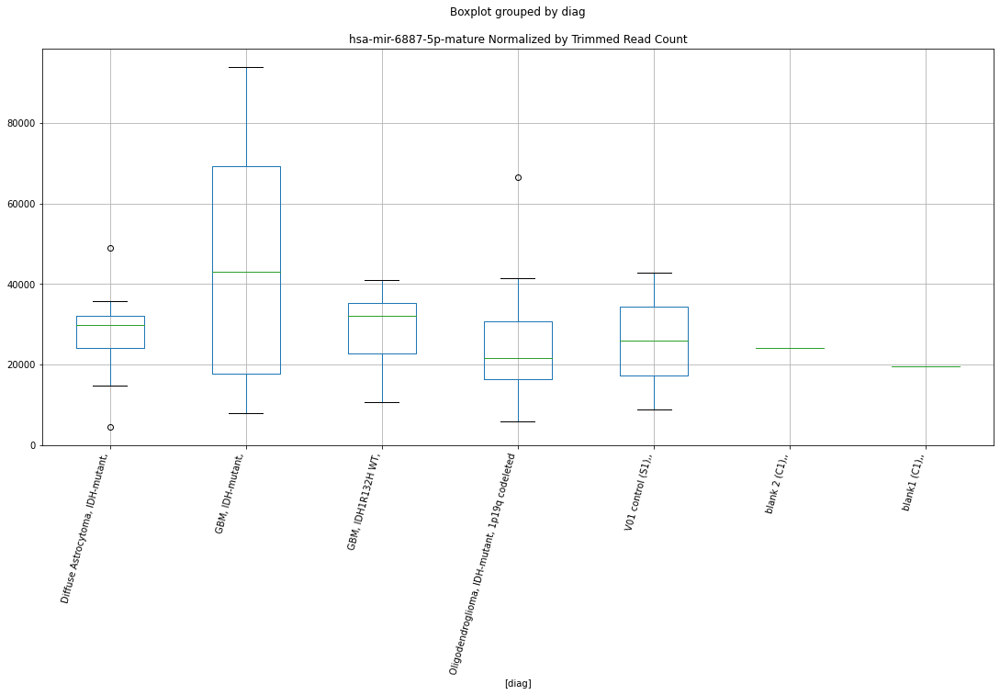

hsa-mir-6887-5p-mature D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7659596098498203
	p = 0.09435819244995439
hsa-mir-6887-5p-mature D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7659596098498203
	p = 0.09435819244995439


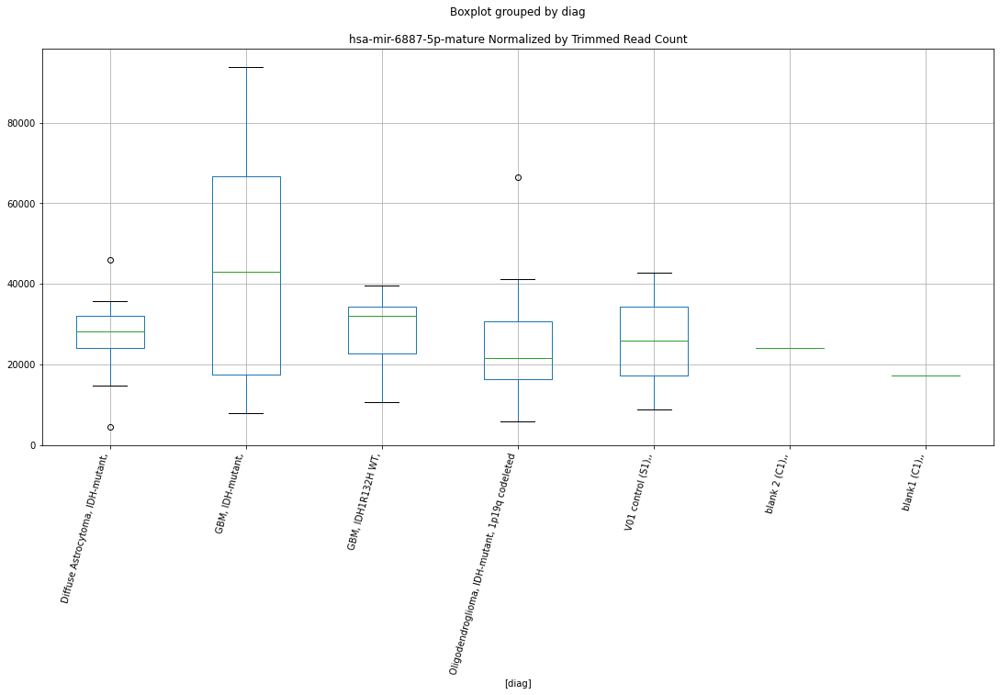

hsa-mir-548ai-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9465538273711043
	p = 0.06736759159317114
hsa-mir-548ai-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9465538273711043
	p = 0.06736759159317114


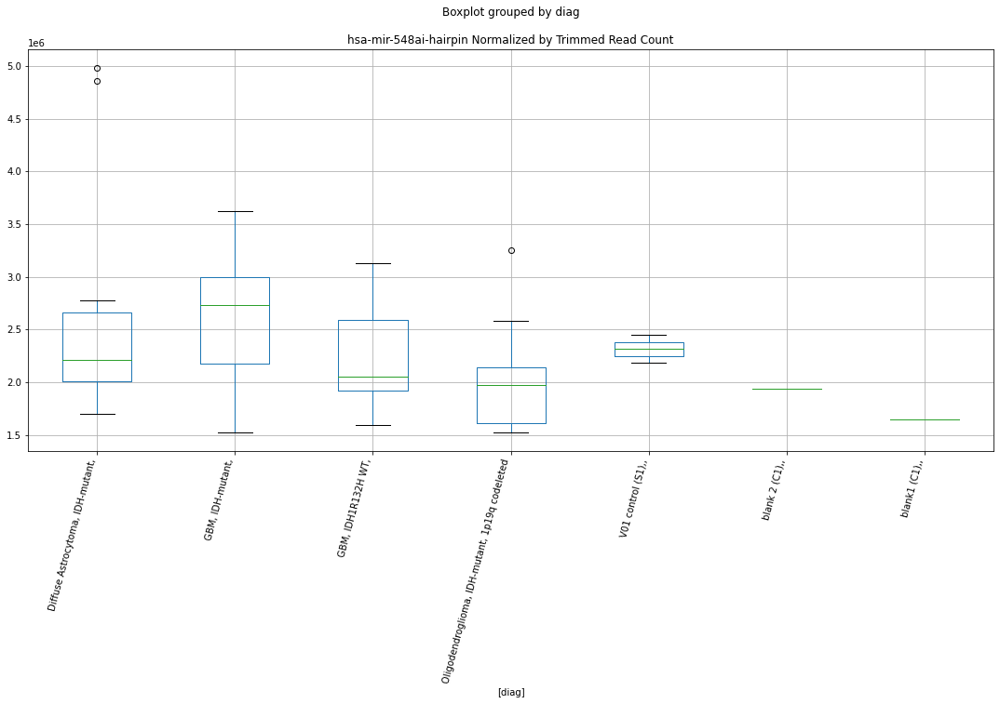

hsa-mir-548ai-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.973102713920807
	p = 0.06404098714743175
hsa-mir-548ai-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.973102713920807
	p = 0.06404098714743175


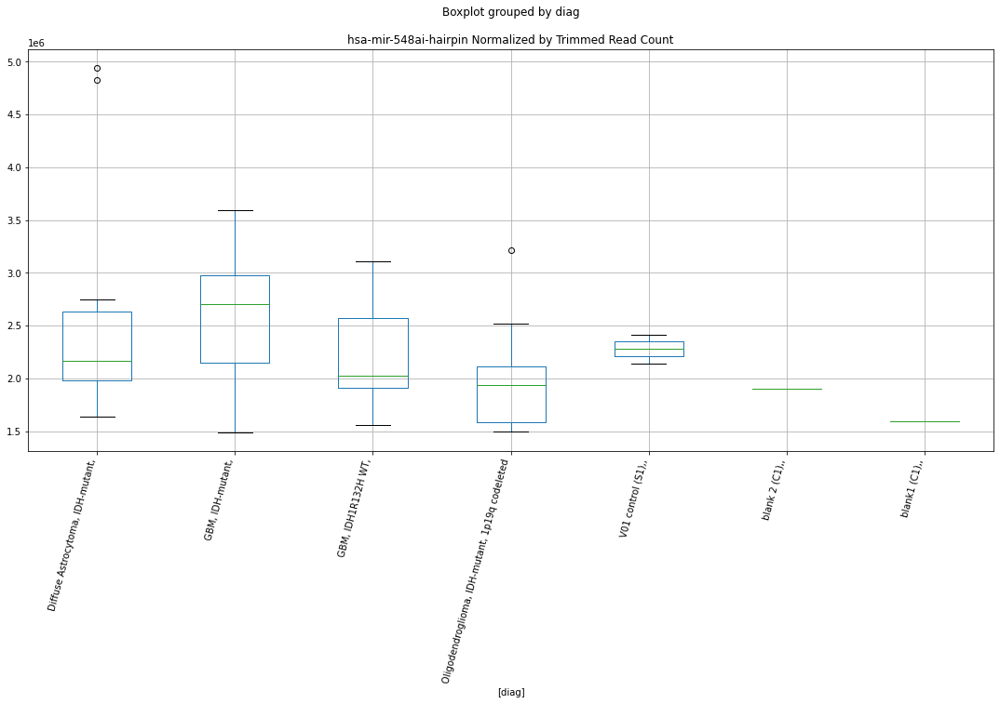

hsa-mir-525-hairpin D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.9726581139525083
	p = 0.008155797968289268
hsa-mir-525-hairpin D-plex bbduk1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.9726581139525083
	p = 0.008155797968289268


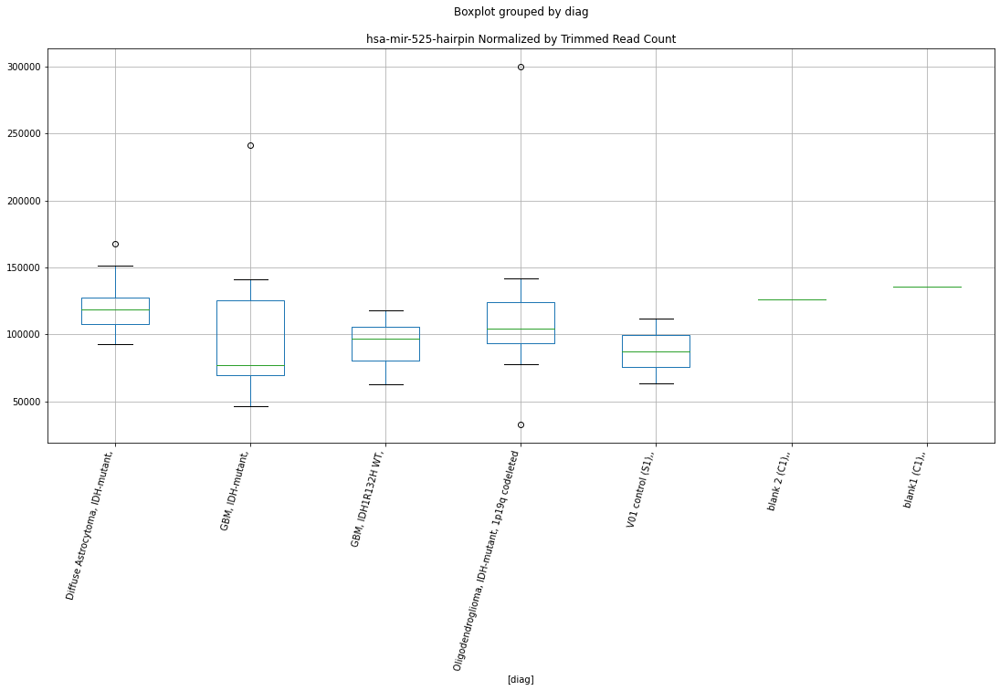

hsa-mir-525-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.4552356970000546
	p = 0.024477185844644665
hsa-mir-525-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.4552356970000546
	p = 0.024477185844644665


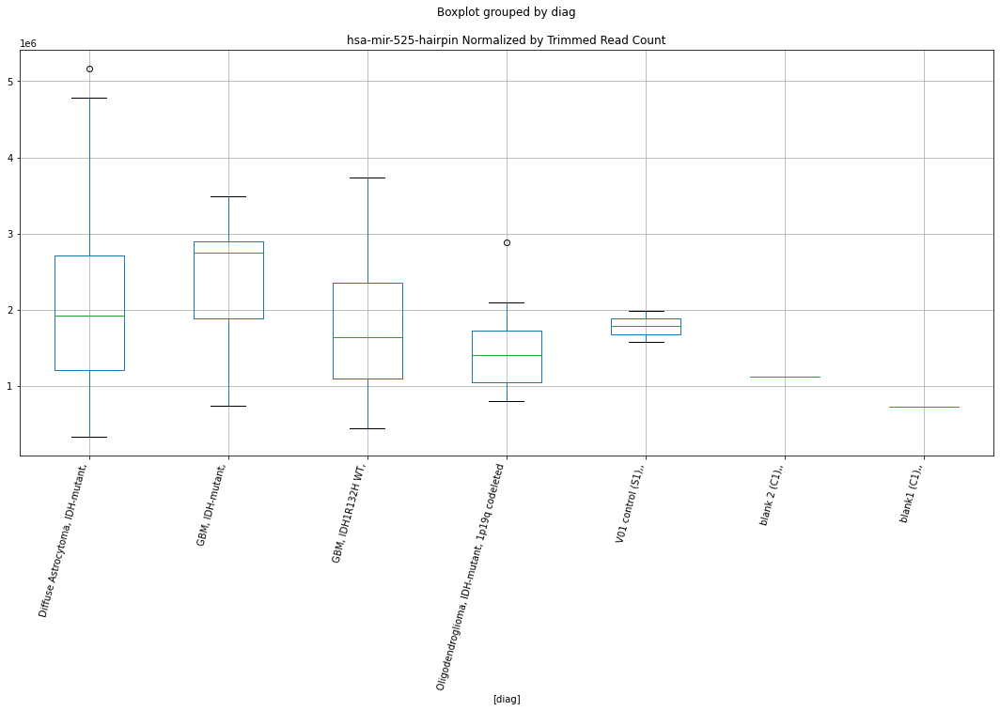

hsa-mir-525-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.446672300388393
	p = 0.024914114442006786
hsa-mir-525-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.446672300388393
	p = 0.024914114442006786


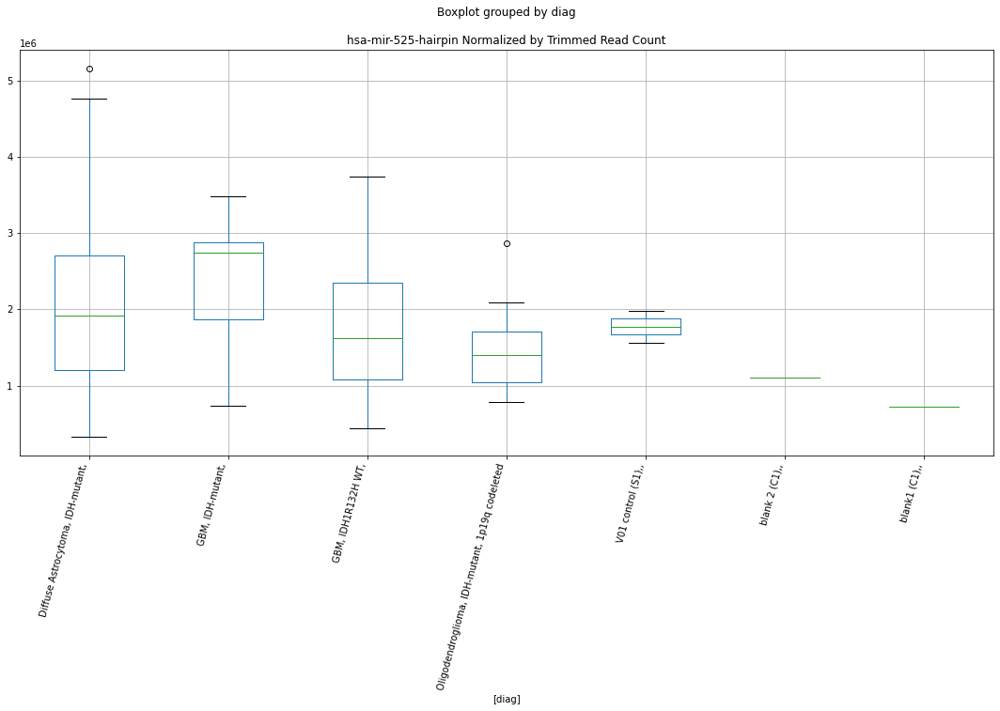

hsa-mir-4472-2-hairpin D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7553733705503896
	p = 0.09619927277222275
hsa-mir-4472-2-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7553733705503896
	p = 0.09619927277222275


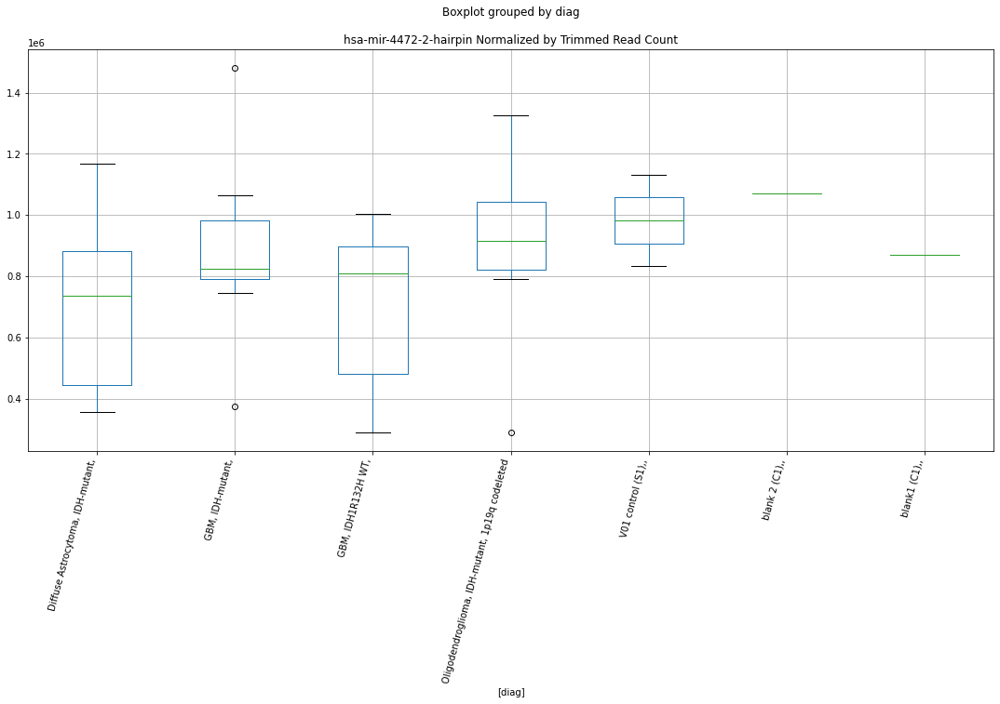

hsa-mir-1289-2-hairpin D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.8122185548385246
	p = 0.08666835749553715
hsa-mir-1289-2-hairpin D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.8122185548385246
	p = 0.08666835749553715


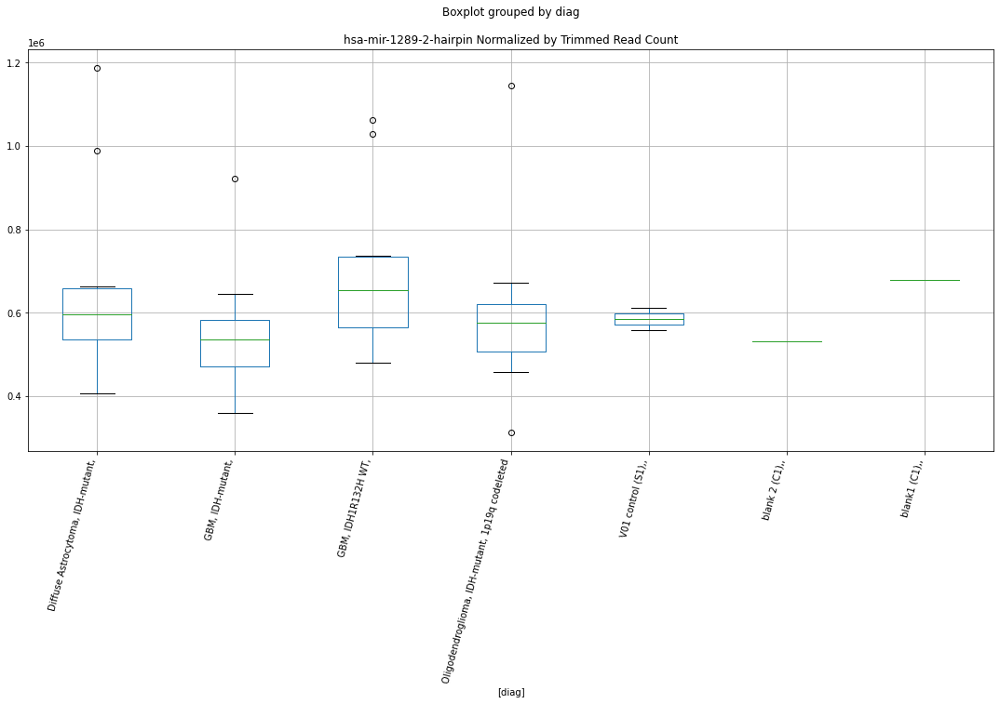

hsa-mir-1289-2-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9913373919575899
	p = 0.061842131173326986
hsa-mir-1289-2-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.9913373919575899
	p = 0.061842131173326986


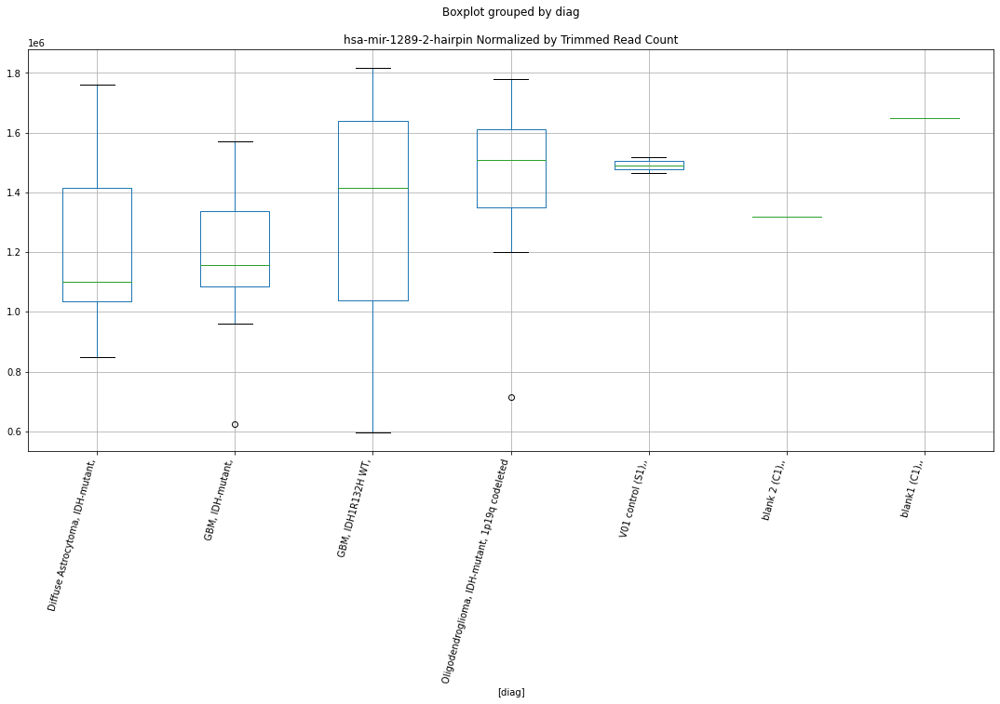

hsa-mir-1289-2-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9877633329877031
	p = 0.06226770270586524
hsa-mir-1289-2-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.9877633329877031
	p = 0.06226770270586524


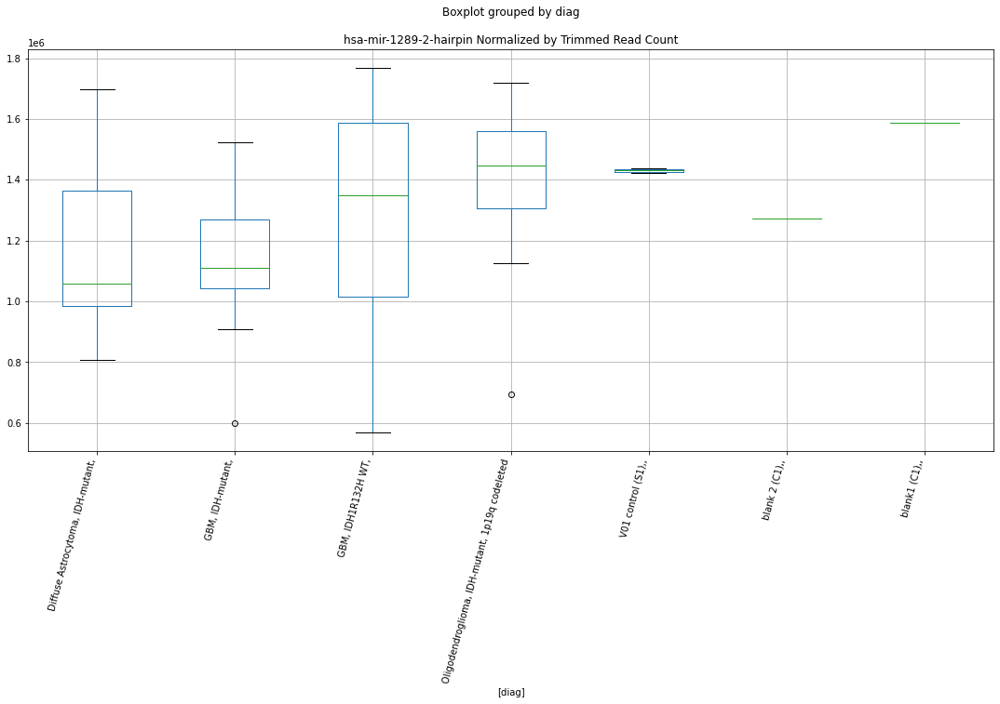

hsa-mir-644a-hairpin D-plex bbduk1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.4111519953712235
	p = 0.026805757717063575
hsa-mir-644a-hairpin D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.4111519953712235
	p = 0.026805757717063575


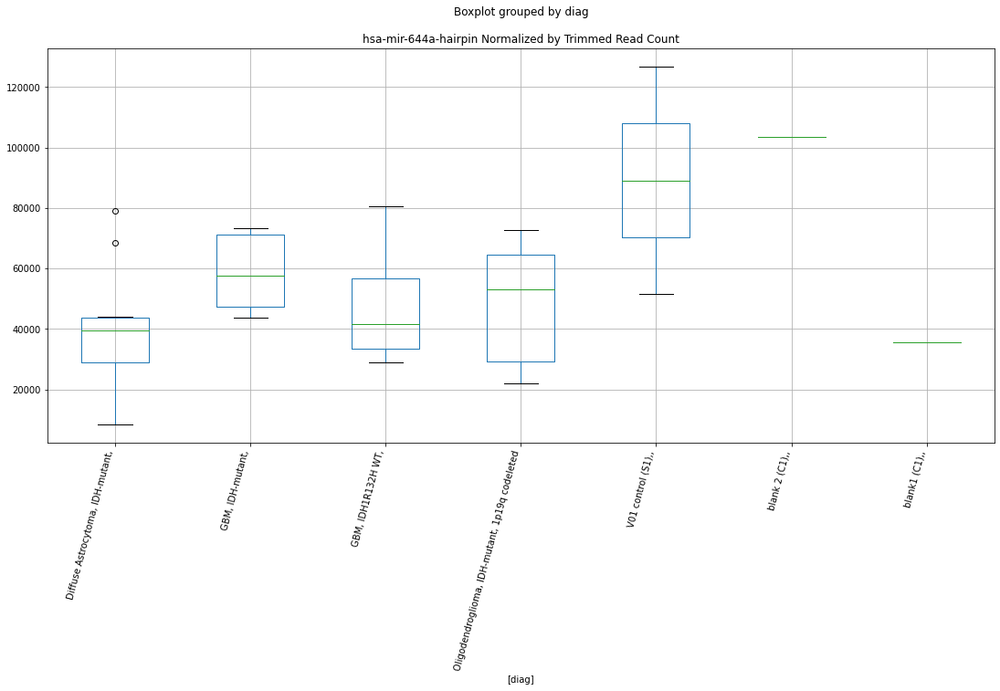

hsa-mir-644a-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.5563340754778645
	p = 0.01983524260068053
hsa-mir-644a-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.5563340754778645
	p = 0.01983524260068053


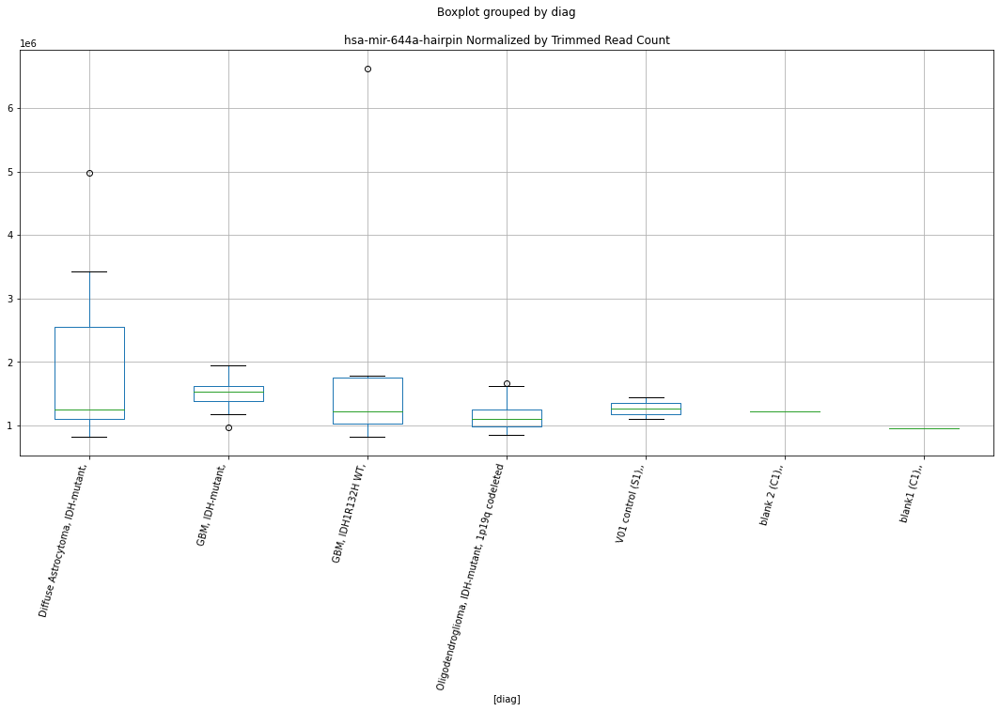

hsa-mir-644a-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.5341223550178036
	p = 0.020777590057359116
hsa-mir-644a-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.5341223550178036
	p = 0.020777590057359116


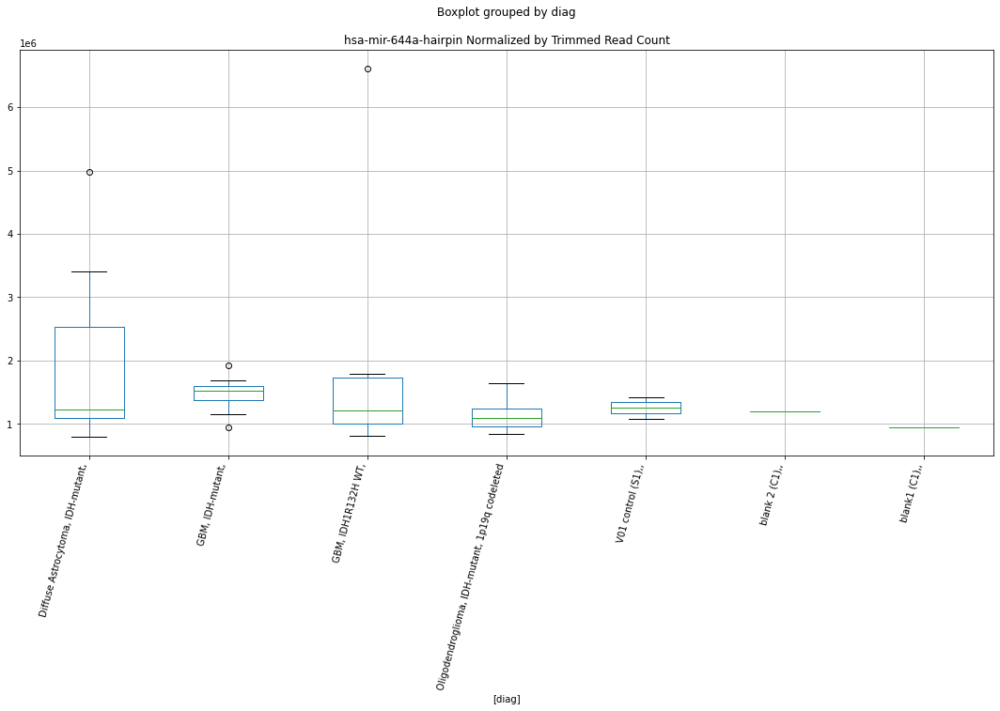

hsa-mir-638-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.8775126116868193
	p = 0.01002002675632226
hsa-mir-638-hairpin D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.6305373607629554
	p = 0.01697213680090675
hsa-mir-638-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.8775126116868193
	p = 0.01002002675632226
hsa-mir-638-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.6305373607629554
	p = 0.01697213680090675


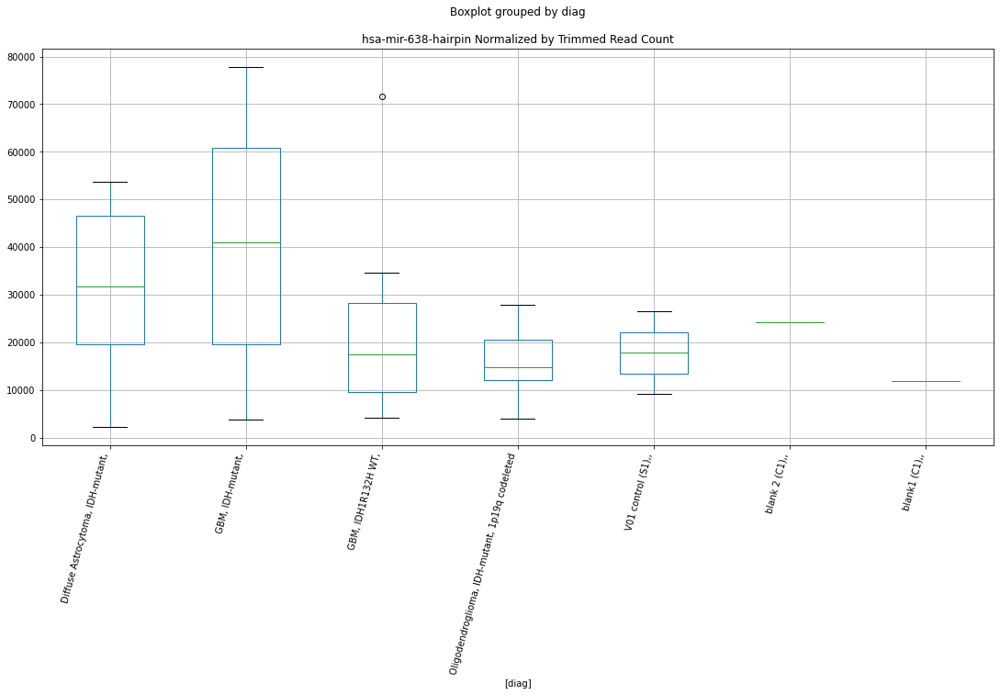

hsa-mir-638-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.8404170502402653
	p = 0.010853145714061848
hsa-mir-638-hairpin D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.5162577990243737
	p = 0.021566033132134437
hsa-mir-638-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.8404170502402653
	p = 0.010853145714061848
hsa-mir-638-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.5162577990243737
	p = 0.021566033132134437


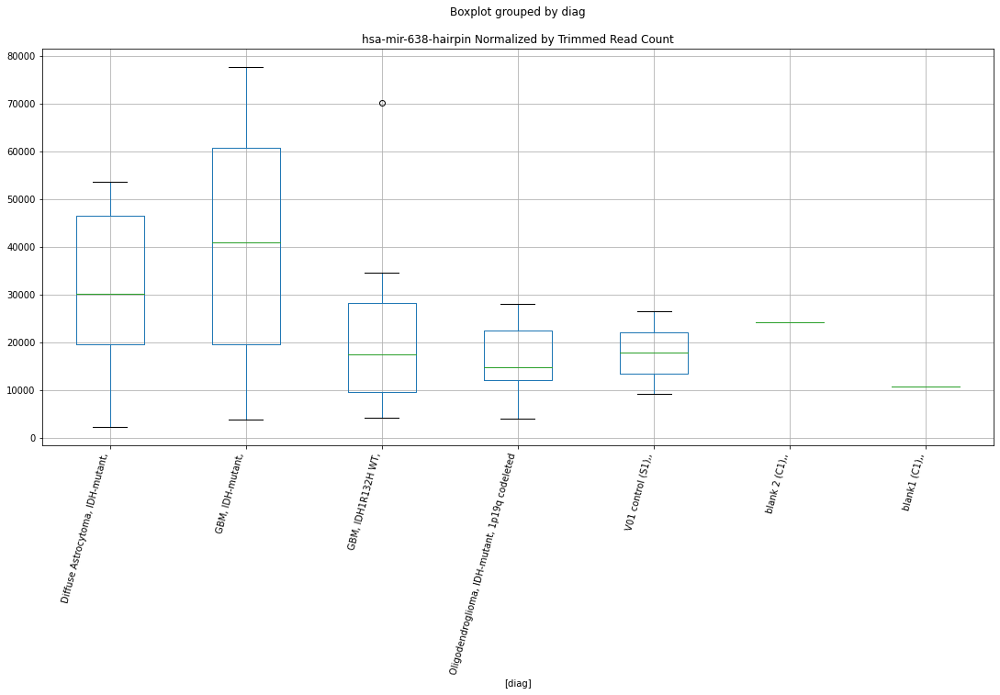

hsa-mir-193b-hairpin D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7633886664251153
	p = 0.09480247401854505
hsa-mir-193b-hairpin D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7633886664251153
	p = 0.09480247401854505


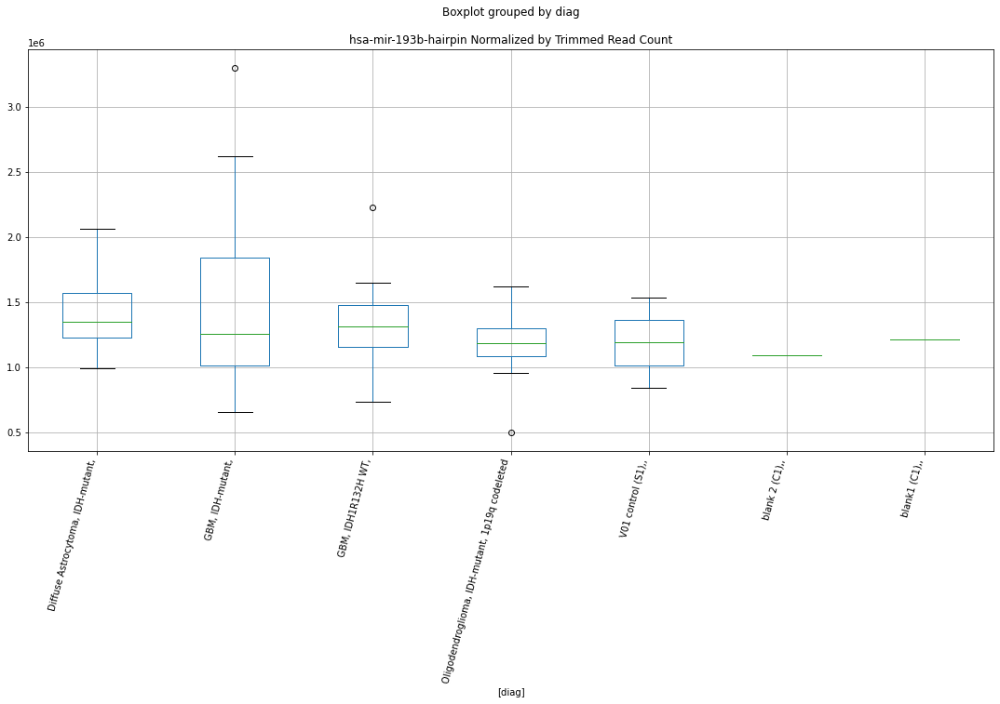

hsa-mir-4516-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.818691427211877
	p = 0.011371644545710458
hsa-mir-4516-hairpin D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.356548409566742
	p = 0.029977458691405983
hsa-mir-4516-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.818691427211877
	p = 0.011371644545710458
hsa-mir-4516-hairpin D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.356548409566742
	p = 0.029977458691405983


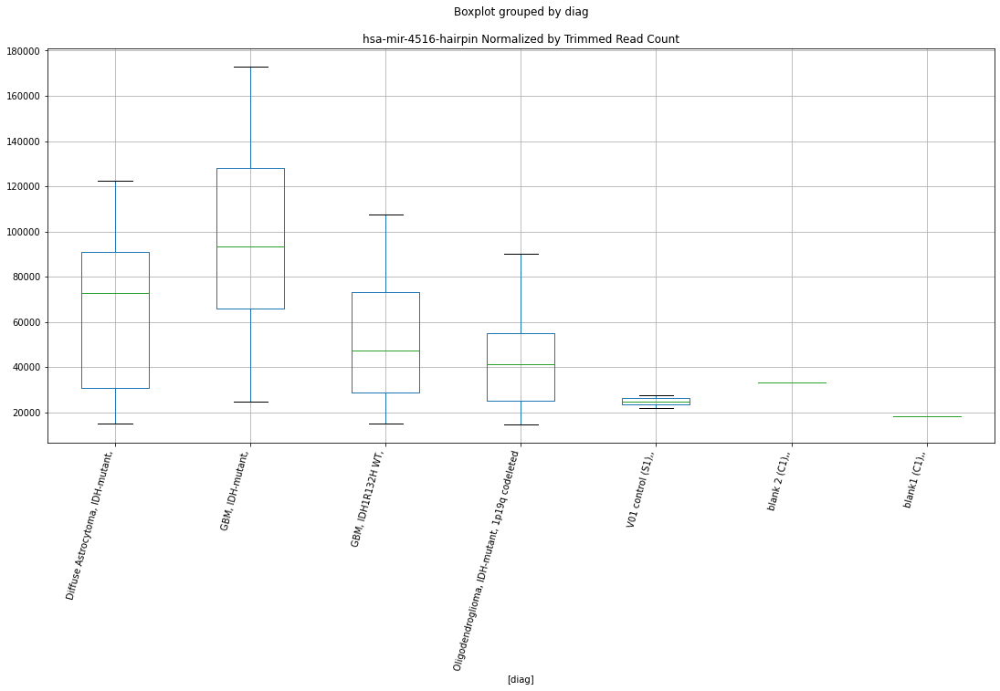

hsa-mir-4516-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.78869008350016
	p = 0.012126954966300799
hsa-mir-4516-hairpin D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.330071277970839
	p = 0.03163830361137203
hsa-mir-4516-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.78869008350016
	p = 0.012126954966300799
hsa-mir-4516-hairpin D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.330071277970839
	p = 0.03163830361137203


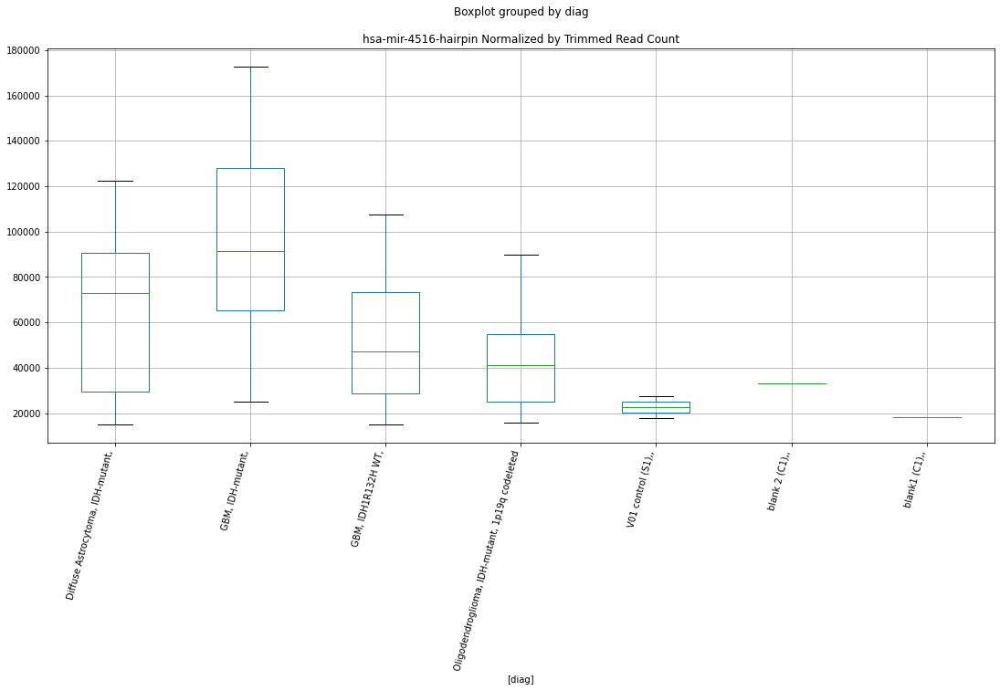

hsa-mir-4307-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9120284529654026
	p = 0.07192384745921122
hsa-mir-4307-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.9120284529654026
	p = 0.07192384745921122


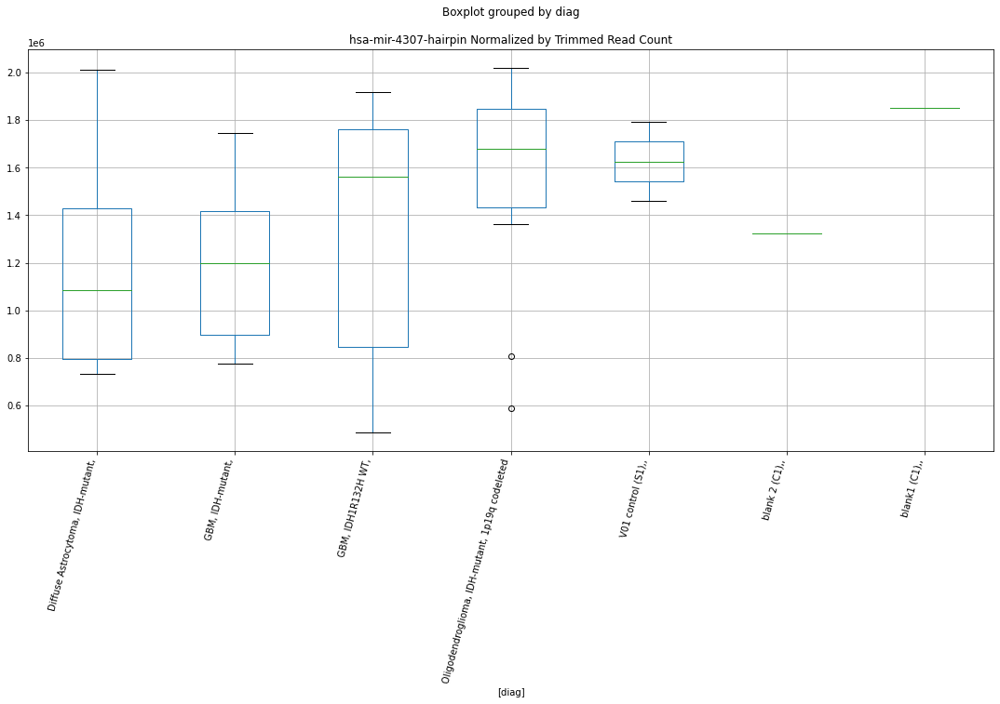

hsa-mir-4307-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.948587069011737
	p = 0.0671074727760709
hsa-mir-4307-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.948587069011737
	p = 0.0671074727760709


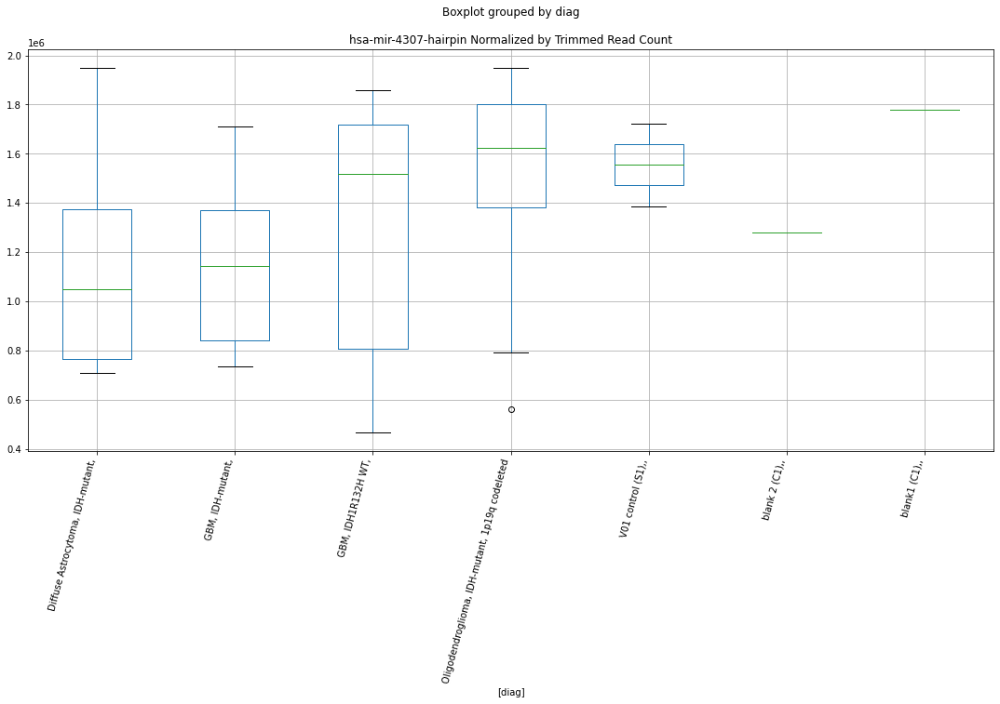

hsa-mir-3128-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0037672040717927
	p = 0.06038233780983273
hsa-mir-3128-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.0037672040717927
	p = 0.06038233780983273


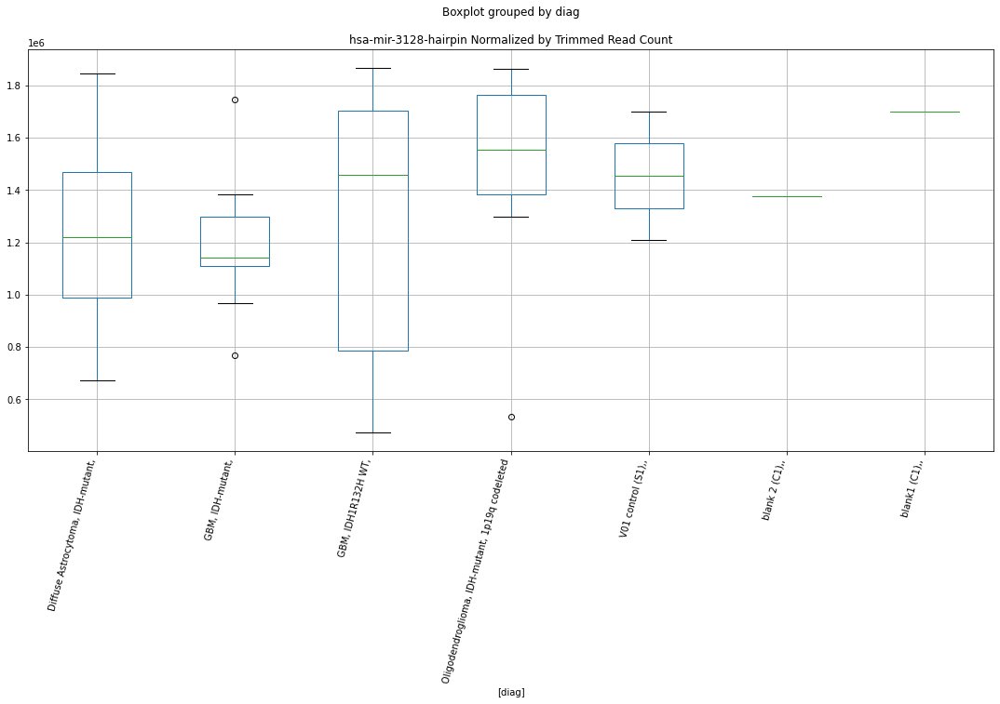

hsa-mir-3128-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9902923309181064
	p = 0.061966298239064896
hsa-mir-3128-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.9902923309181064
	p = 0.061966298239064896


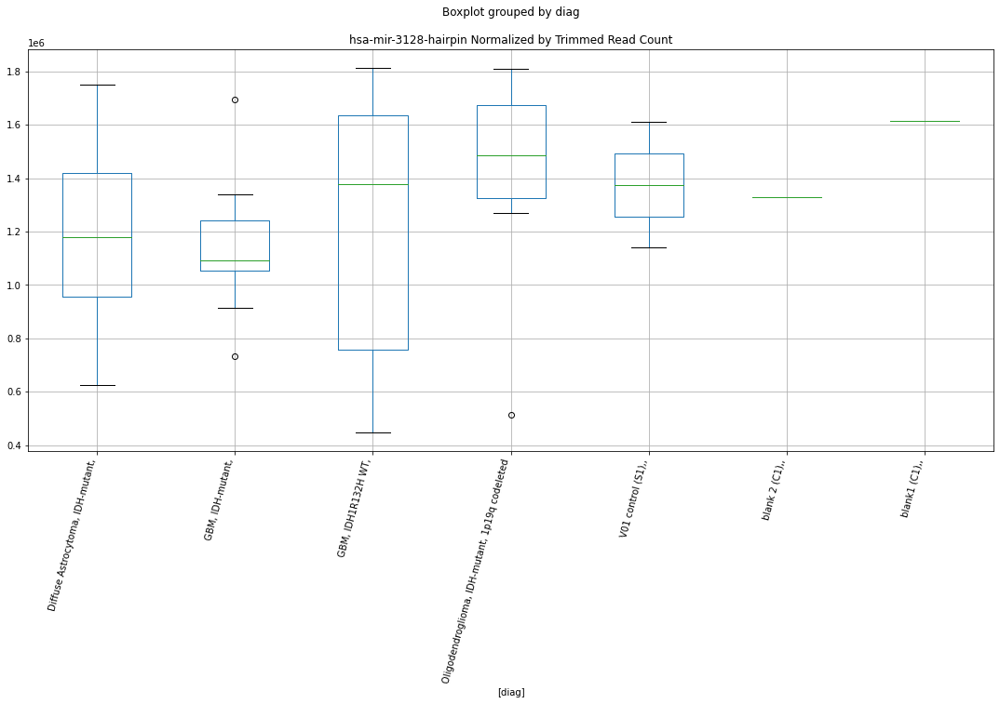

hsa-mir-3162-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.8228601337575574
	p = 0.08497894392746519
hsa-mir-3162-hairpin D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8228601337575574
	p = 0.08497894392746519


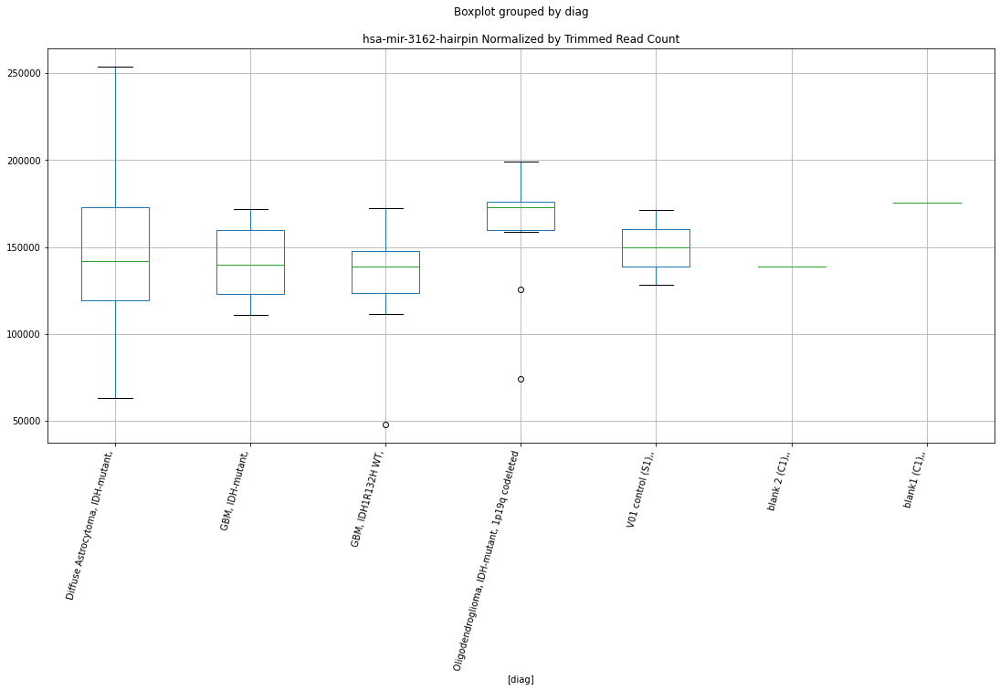

hsa-mir-3938-hairpin D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8340811826033034
	p = 0.08322888642041554
hsa-mir-3938-hairpin D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8340811826033034
	p = 0.08322888642041554
hsa-mir-3938-hairpin D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -1.9216171199560537
	p = 0.070631732960193
hsa-mir-3938-hairpin D-plex bbduk1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9216171199560537
	p = 0.070631732960193


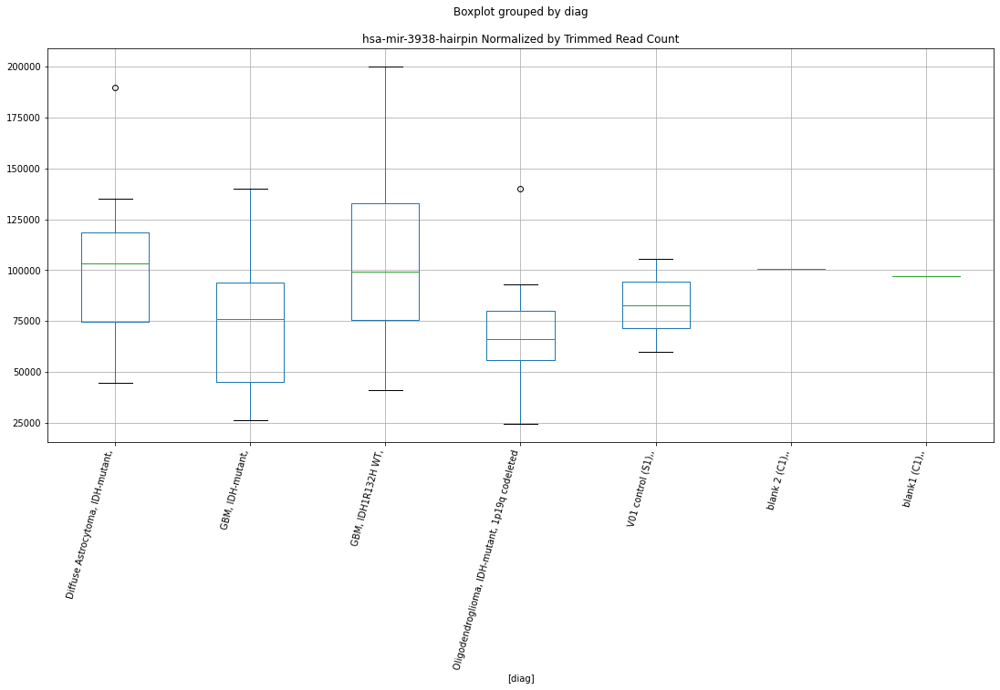

hsa-mir-3938-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.5834839573859294
	p = 0.018738287217081102
hsa-mir-3938-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.5834839573859294
	p = 0.018738287217081102


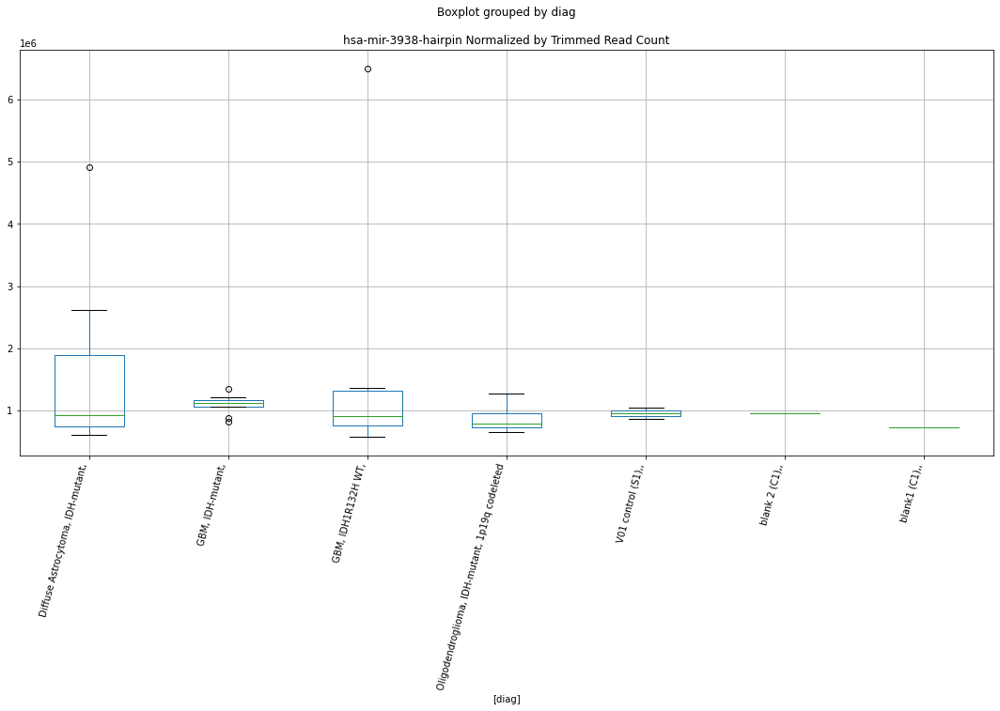

hsa-mir-3938-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.6113159838499143
	p = 0.017673612228015816
hsa-mir-3938-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.6113159838499143
	p = 0.017673612228015816


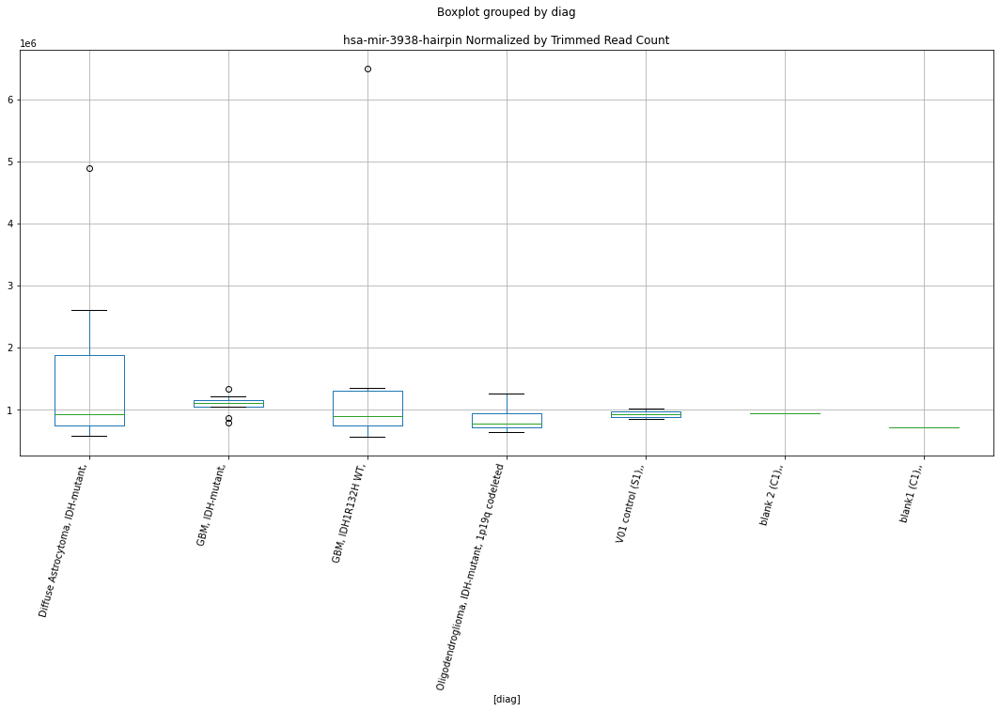

hsa-mir-3938-hairpin D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.7477759562885655
	p = 0.09753970137089414
hsa-mir-3938-hairpin D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.7477759562885655
	p = 0.09753970137089414


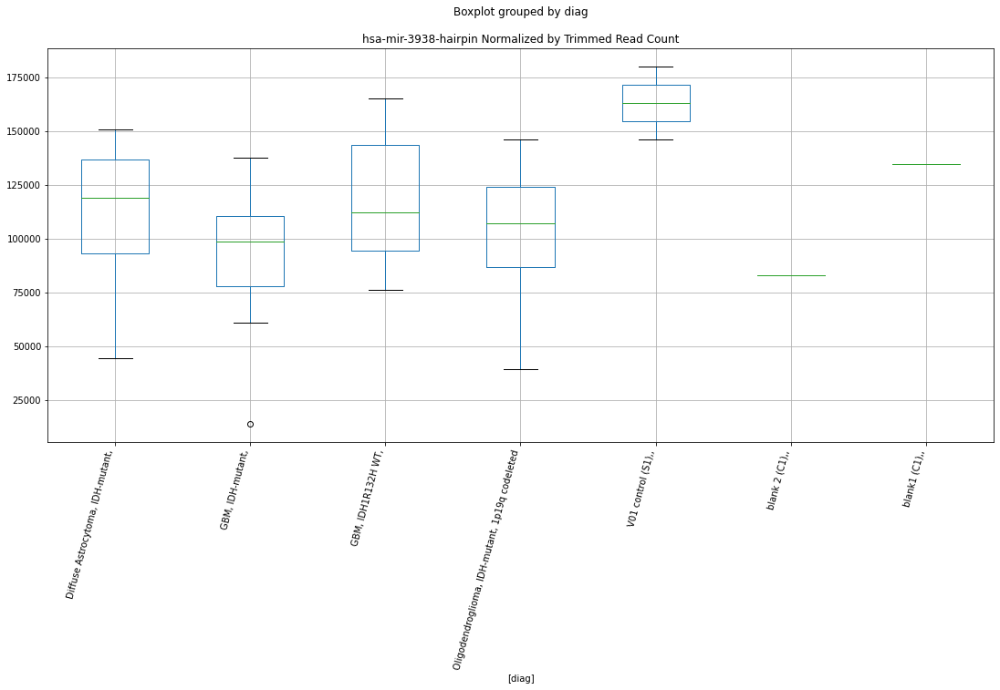

hsa-mir-548ac-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.5151837359275797
	p = 0.021614325085003012
hsa-mir-548ac-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.5151837359275797
	p = 0.021614325085003012


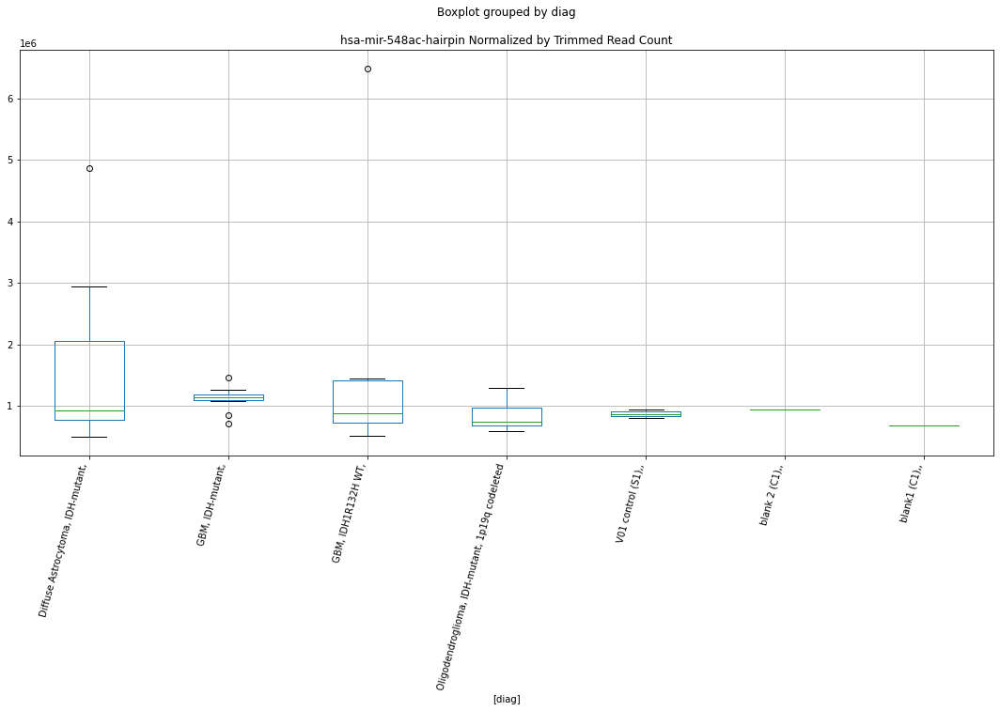

hsa-mir-548ac-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.5198995638443766
	p = 0.021403049016434146
hsa-mir-548ac-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.5198995638443766
	p = 0.021403049016434146


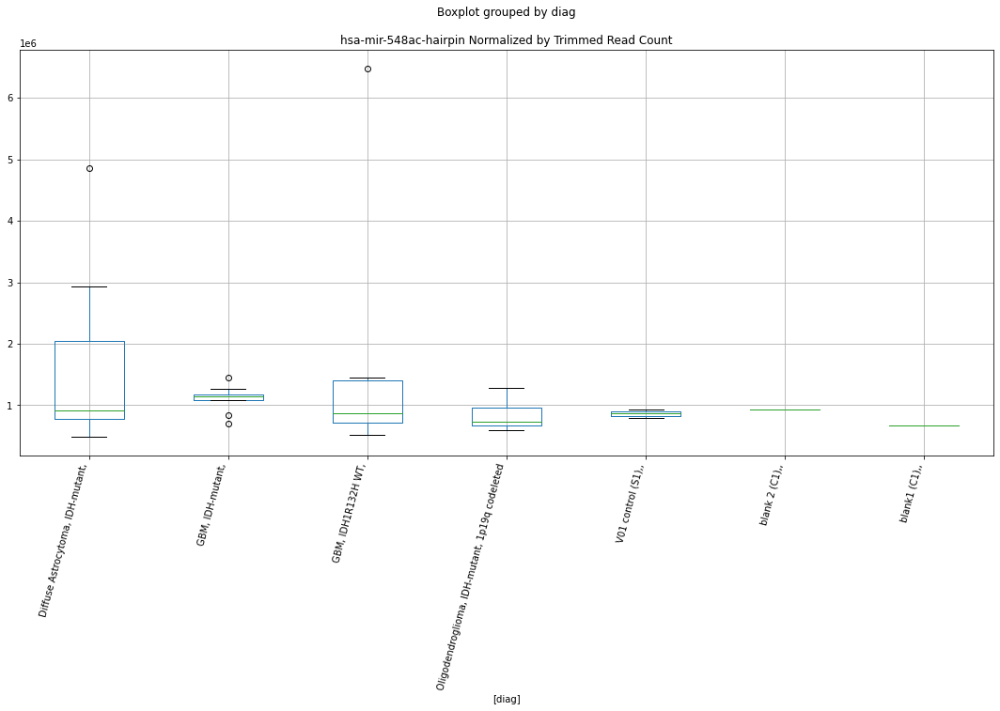

hsa-mir-1237-hairpin D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.1194916492713407
	p = 0.005921262895521503
hsa-mir-1237-hairpin D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.1194916492713407
	p = 0.005921262895521503


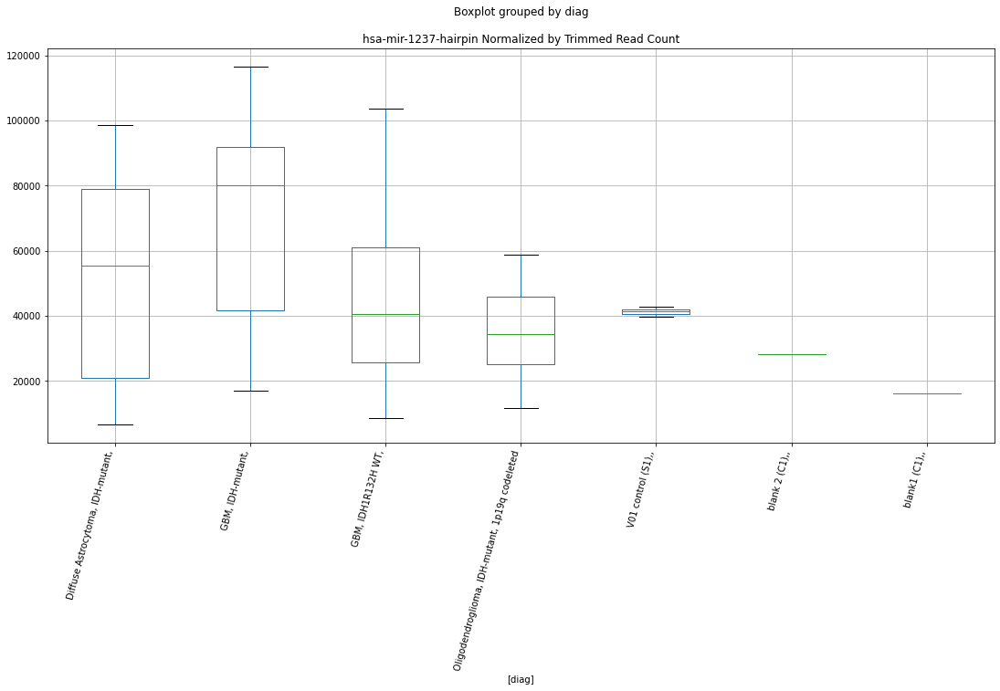

hsa-mir-1237-hairpin D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.088601996089389
	p = 0.006335269507322871
hsa-mir-1237-hairpin D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.088601996089389
	p = 0.006335269507322871


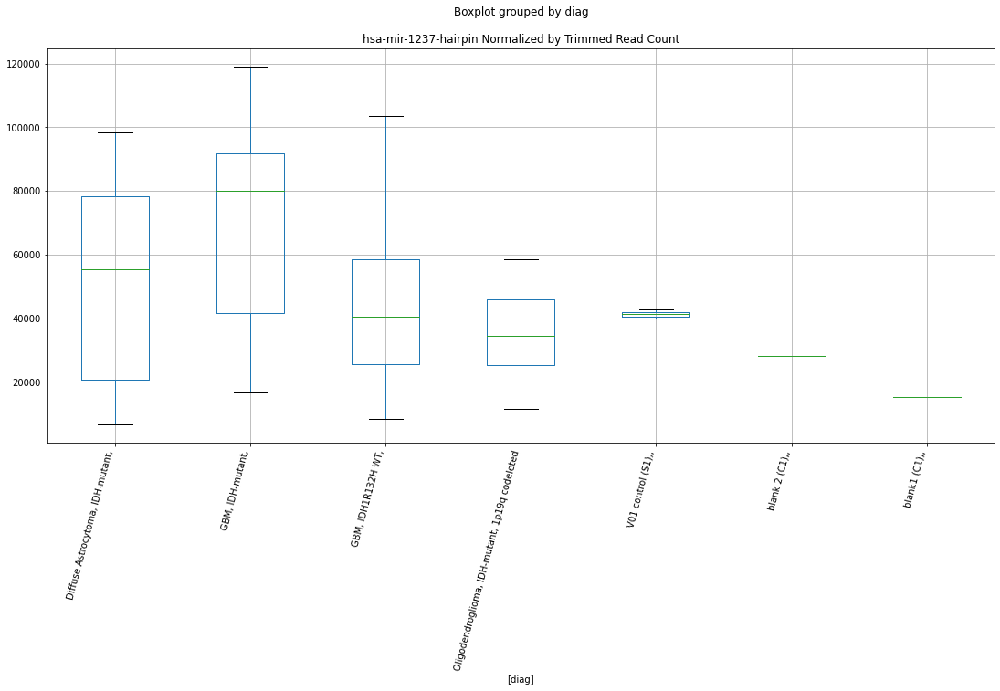

In [77]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in mirnas:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Trimmed Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


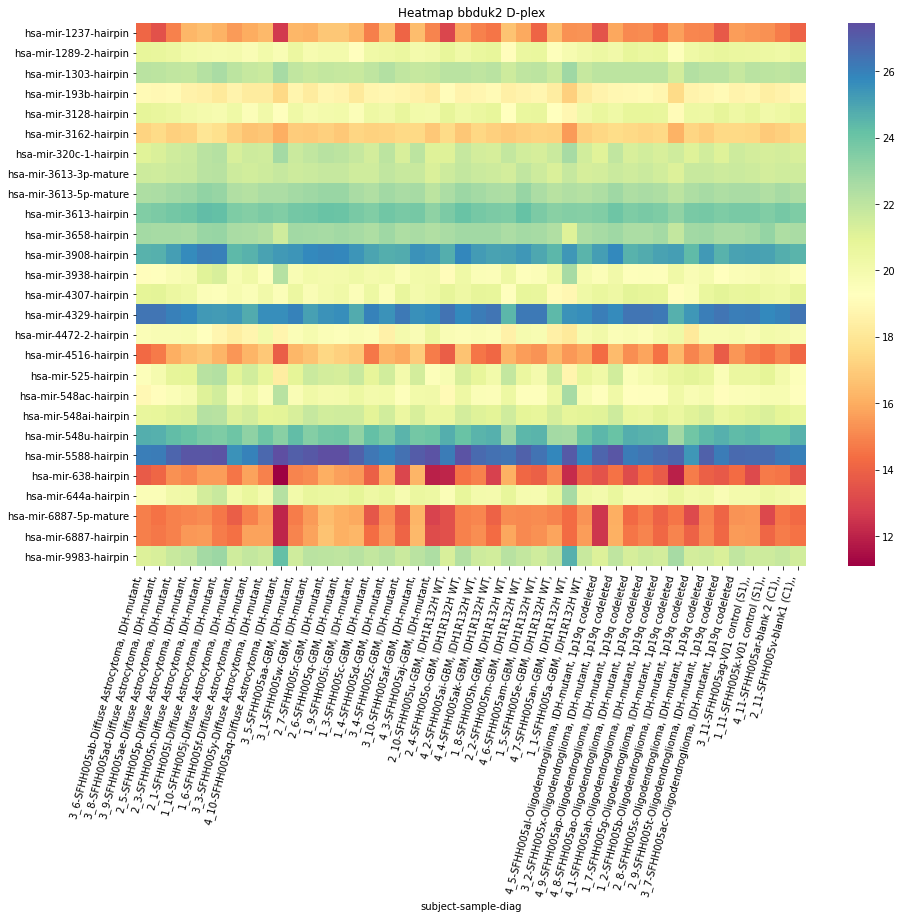

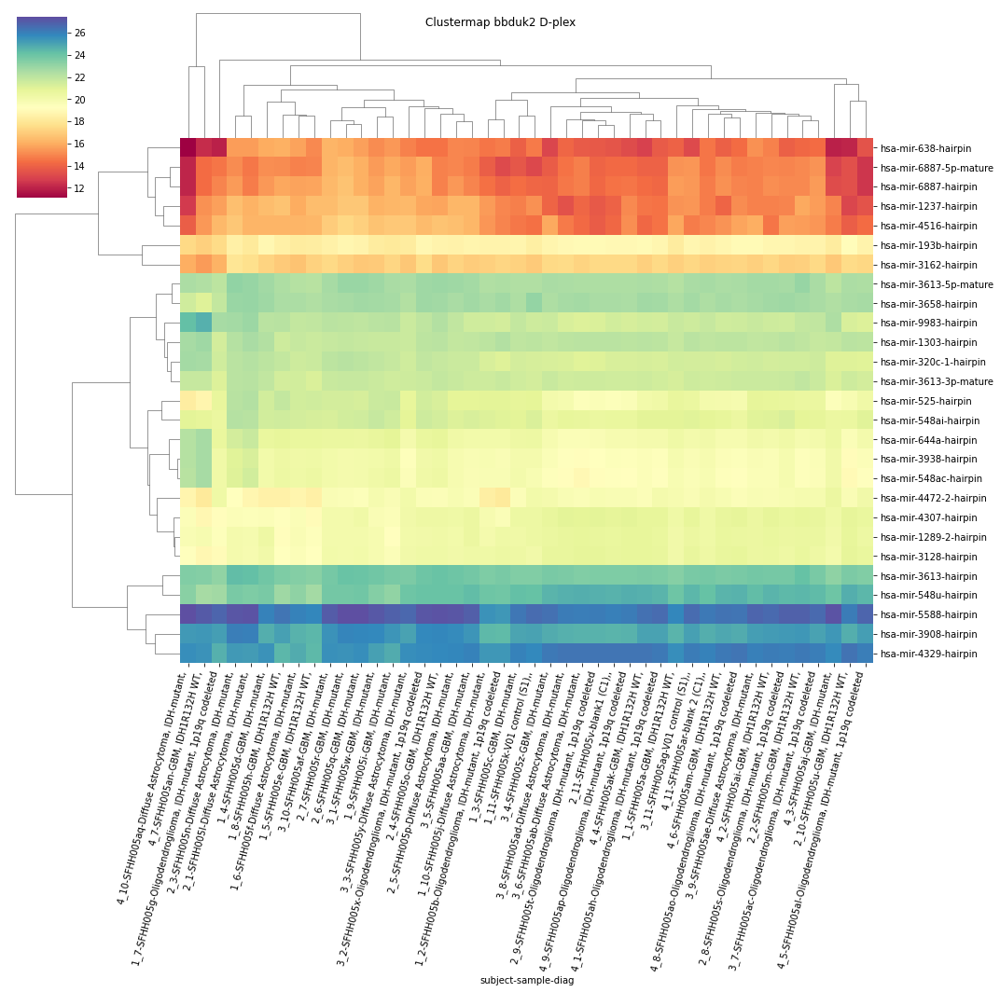

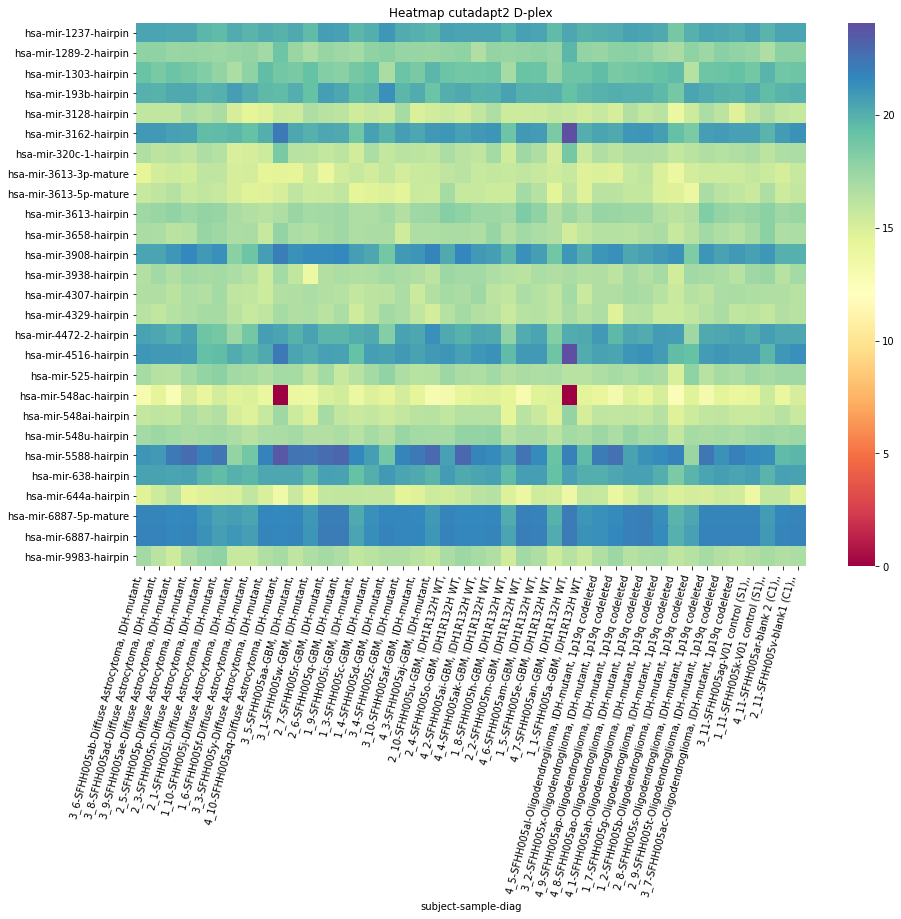

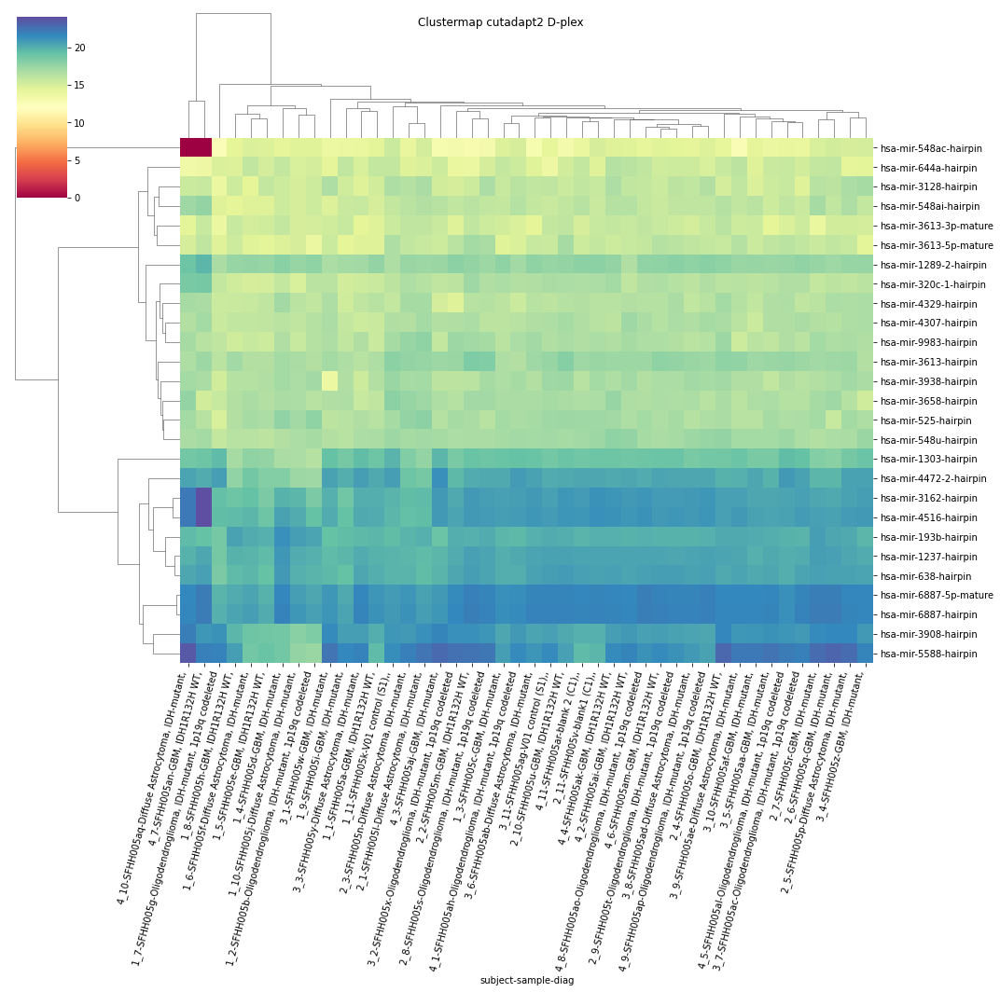

In [78]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

P2RX6 D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.4841125603996916
	p = 0.023056293985382087
P2RX6 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.558223610775696
	p = 0.019756971463166295
P2RX6 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.4841125603996916
	p = 0.023056293985382087
P2RX6 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.558223610775696
	p = 0.019756971463166295


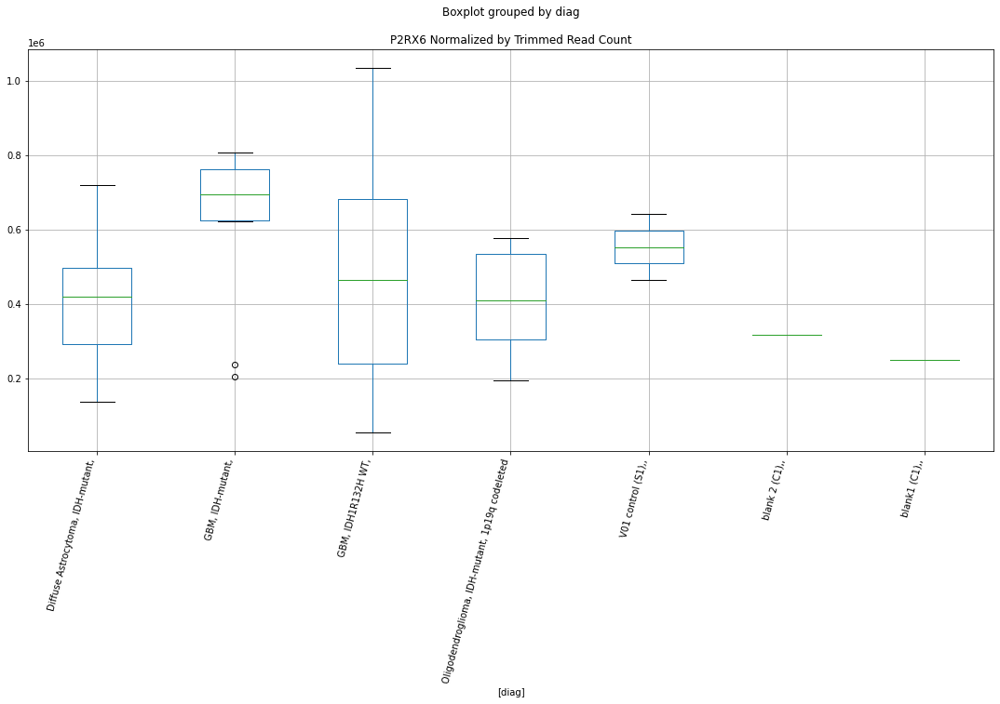

P2RX6 D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.429029167211646
	p = 0.025837489691937936
P2RX6 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.479661224777988
	p = 0.023270145025637342
P2RX6 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -2.429029167211646
	p = 0.025837489691937936
P2RX6 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.479661224777988
	p = 0.023270145025637342


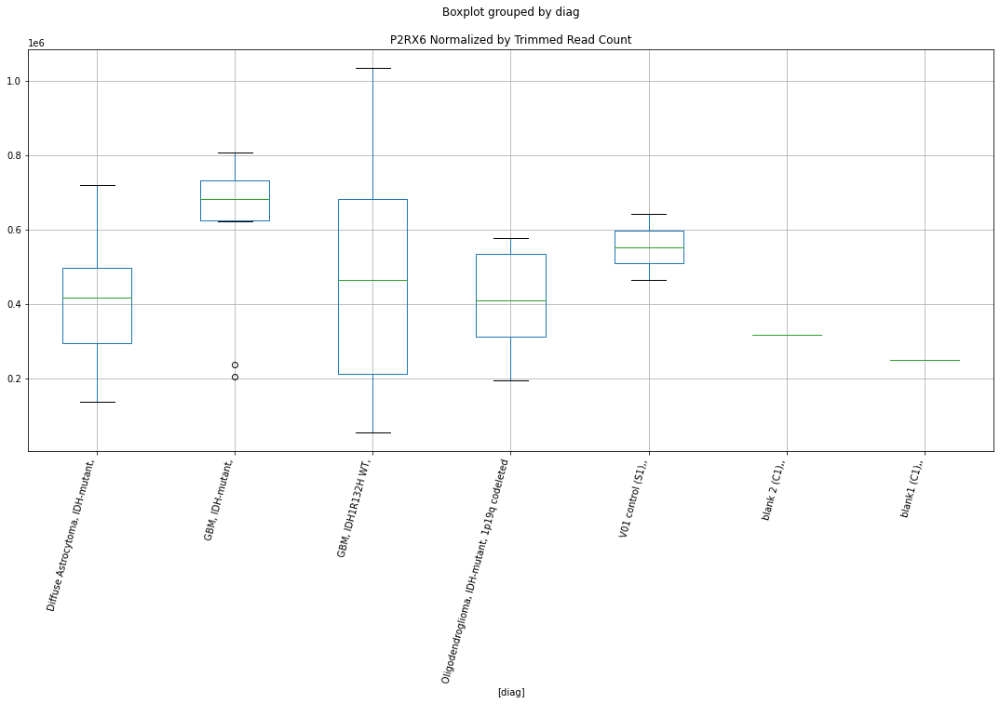

NAALADL2 D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7428273205958948
	p = 0.09842148138600987
NAALADL2 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7428273205958948
	p = 0.09842148138600987


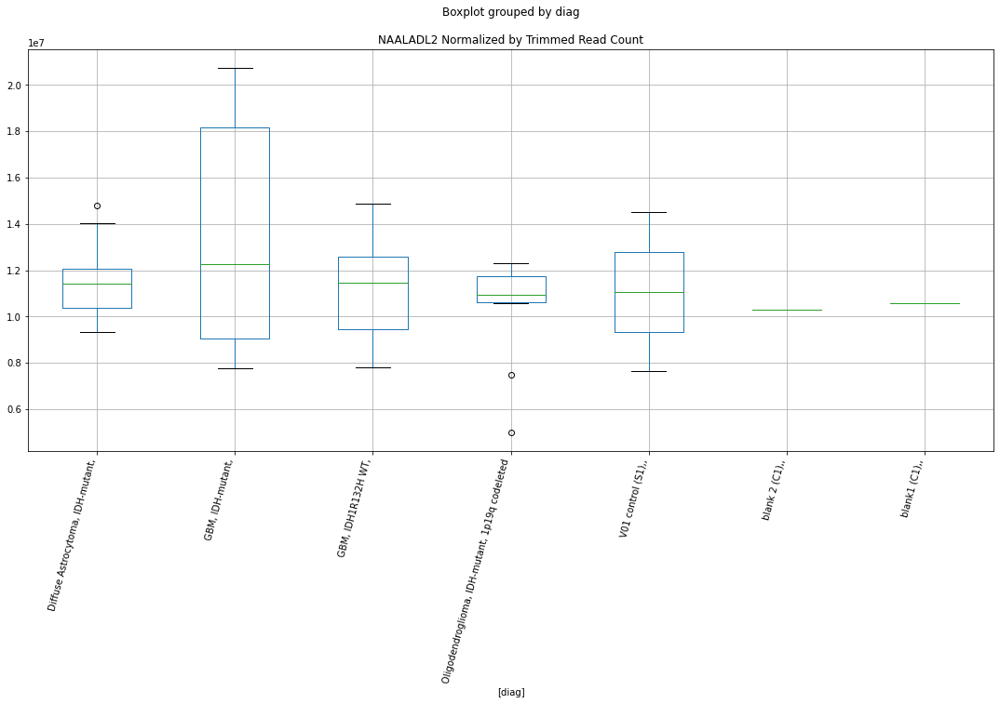

NAALADL2 D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7341923232240768
	p = 0.09997665805246678
NAALADL2 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7341923232240768
	p = 0.09997665805246678


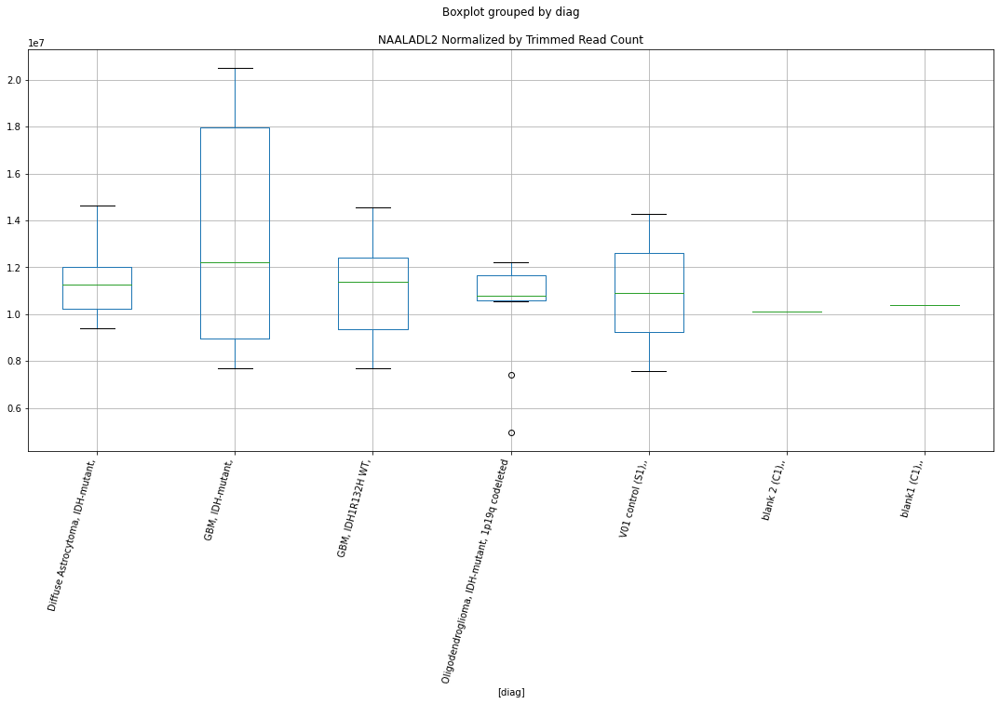

ZNF3 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.043461856436771
	p = 0.05592570360937313
ZNF3 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.043461856436771
	p = 0.05592570360937313


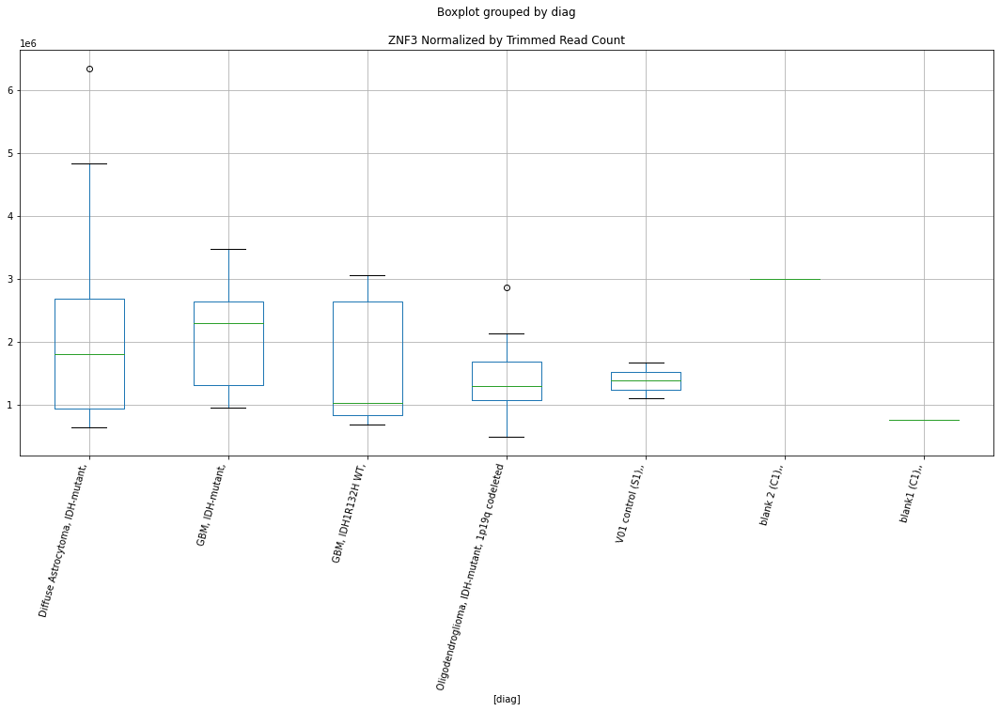

ZNF3 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9971746360605331
	p = 0.061152687415877434
ZNF3 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.9971746360605331
	p = 0.061152687415877434


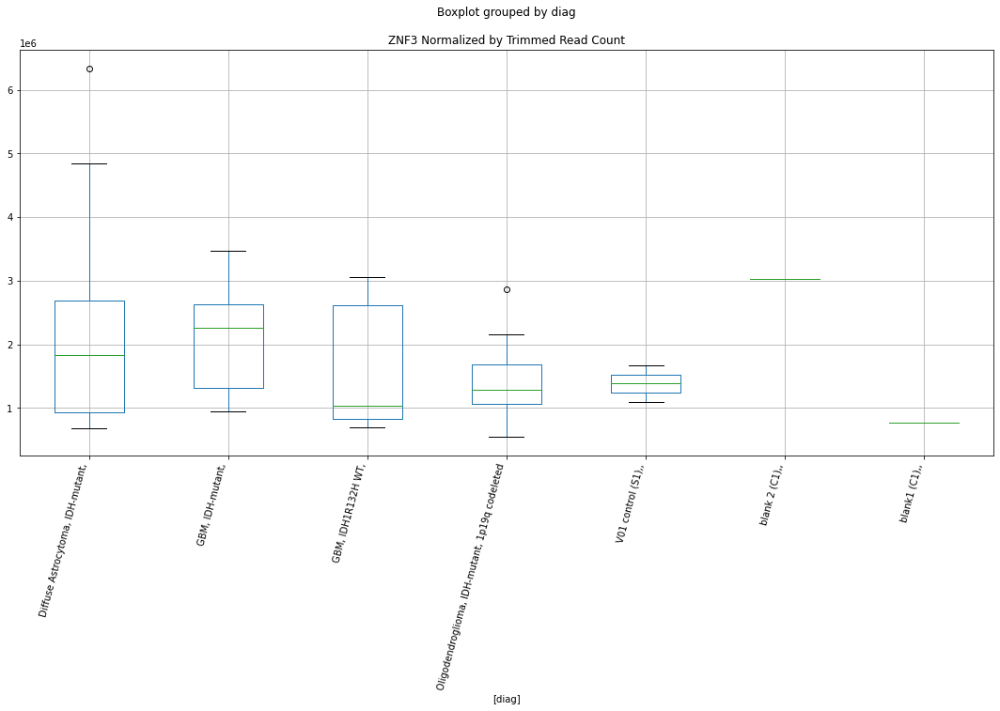

L1CAM D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.128162261140622
	p = 0.04739516016330721
L1CAM D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 2.128162261140622
	p = 0.04739516016330721


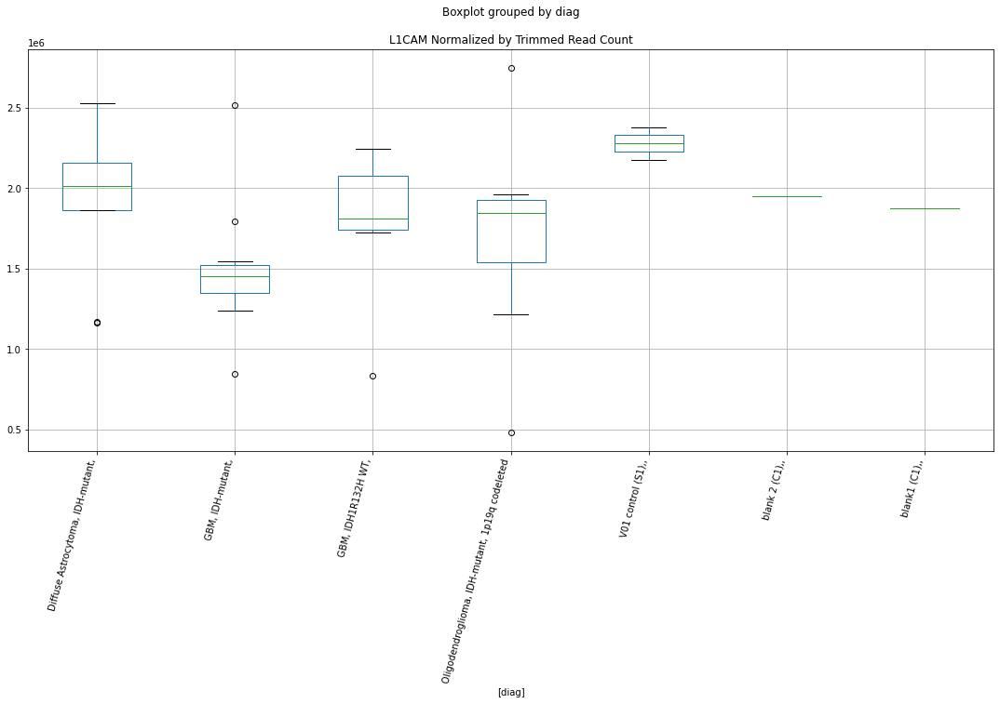

L1CAM D-plex cutadapt2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.087016436515535
	p = 0.05137930627950904
L1CAM D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 2.087016436515535
	p = 0.05137930627950904


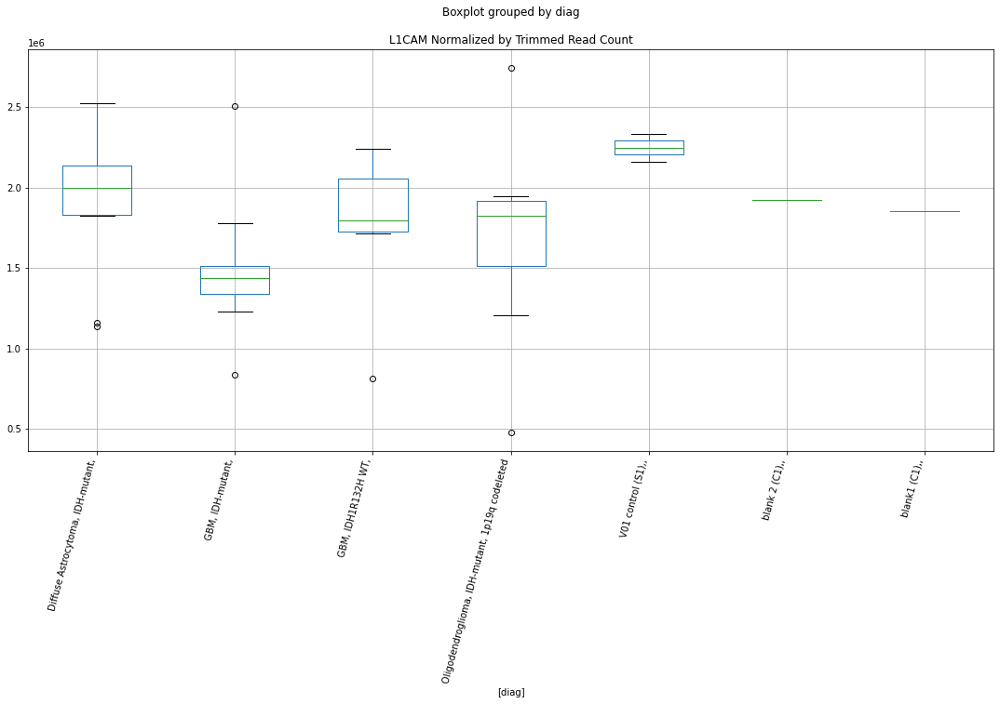

L1CAM D-plex cutadapt3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.1093999494971114
	p = 0.0491756701781167
L1CAM D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 2.1093999494971114
	p = 0.0491756701781167


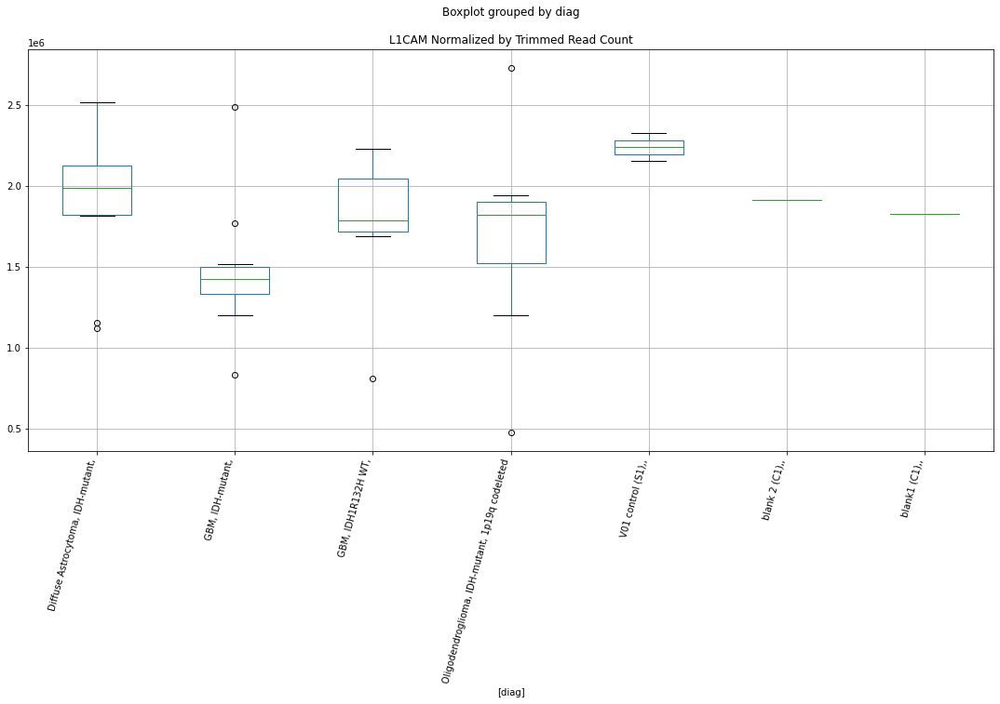

FBXO32 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.816832569905327
	p = 0.08593227574801396
FBXO32 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.816832569905327
	p = 0.08593227574801396


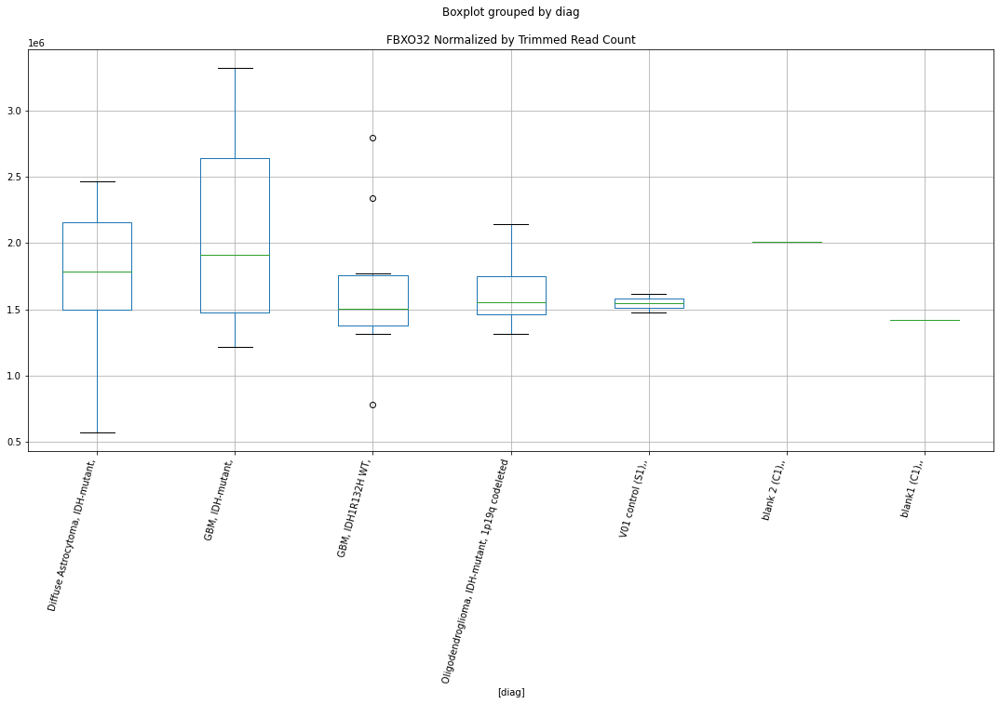

FBXO32 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8443618766387244
	p = 0.08165336107877537
FBXO32 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8443618766387244
	p = 0.08165336107877537


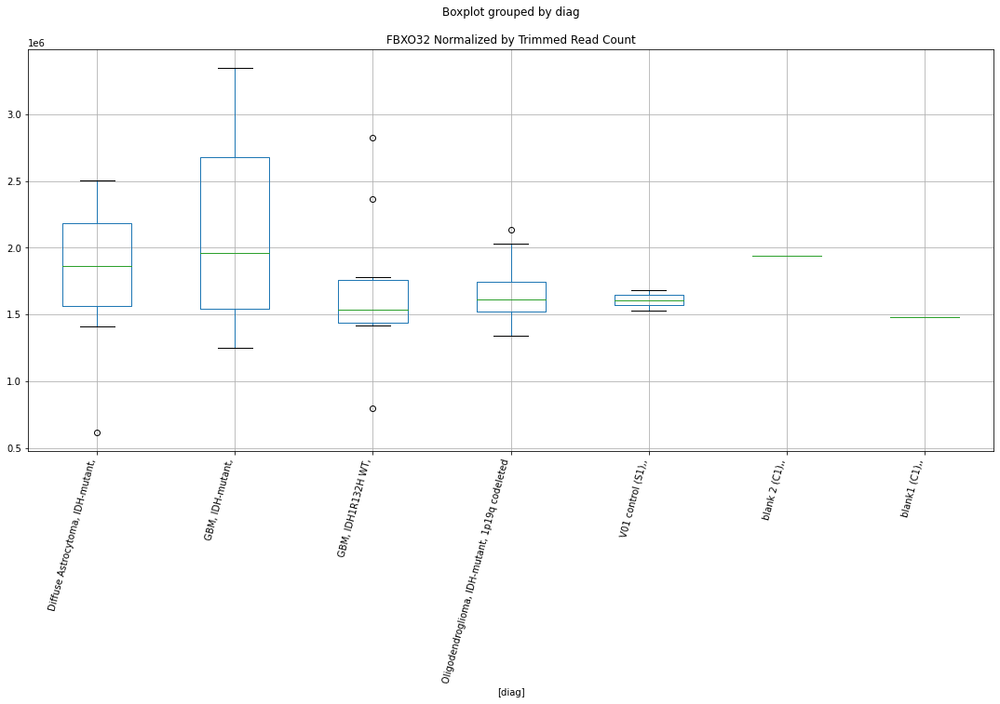

GLG1 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.939445651964674
	p = 0.008764804742476352
GLG1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.939445651964674
	p = 0.008764804742476352


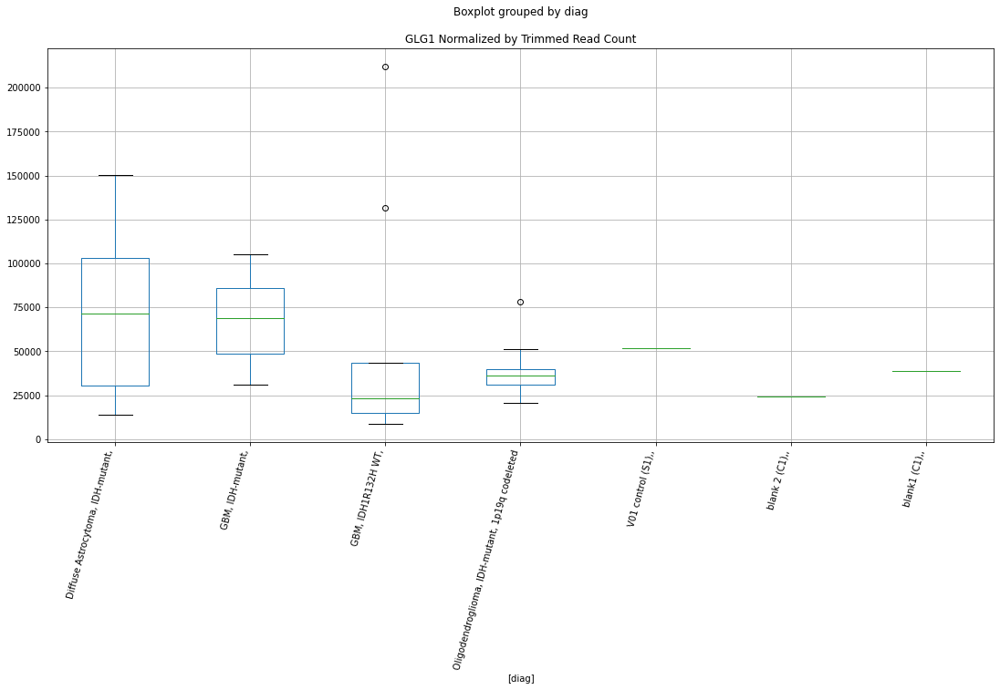

GLG1 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.9400432721682455
	p = 0.00875346702959591
GLG1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.9400432721682455
	p = 0.00875346702959591


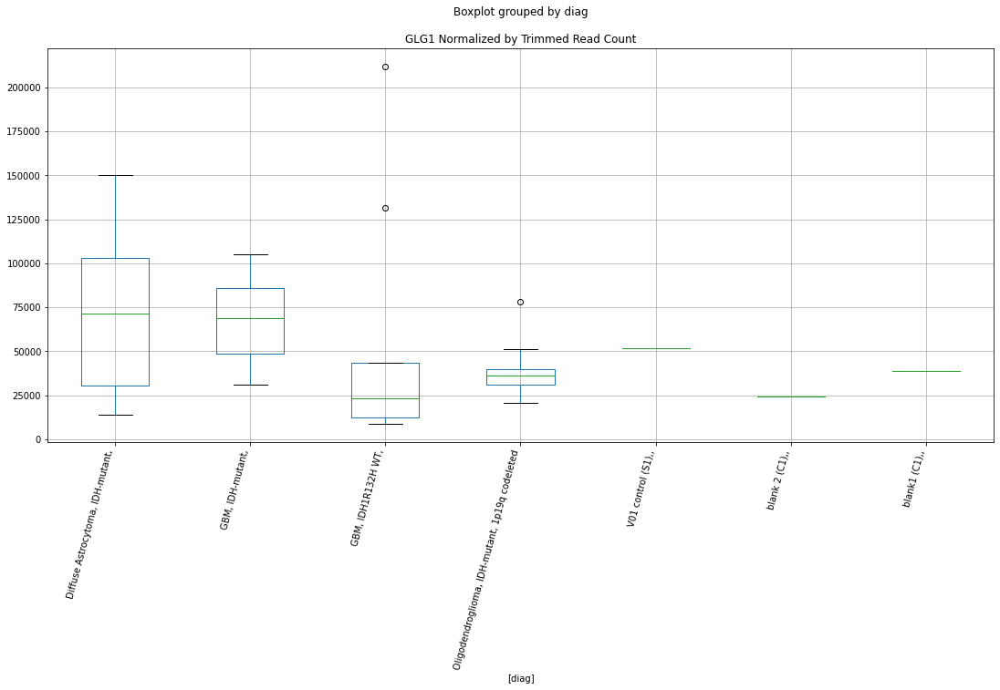

ILDR2 D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.1132315807325575
	p = 0.04880718266003111
ILDR2 D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.1132315807325575
	p = 0.04880718266003111
ILDR2 D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -1.7604027168985843
	p = 0.09532075278381436
ILDR2 D-plex bbduk1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7604027168985843
	p = 0.09532075278381436


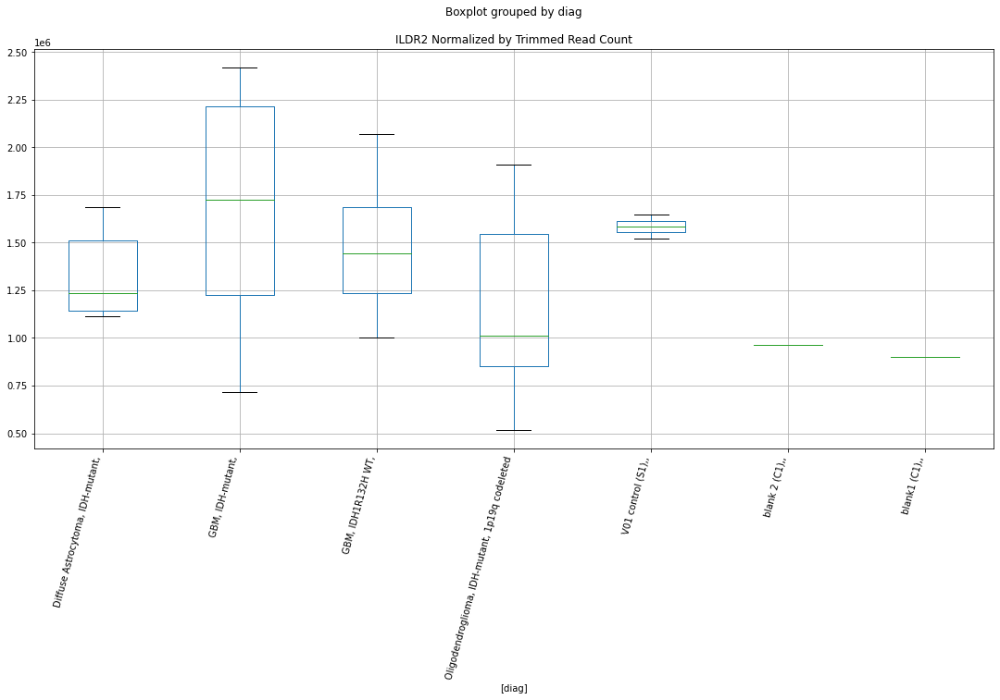

ILDR2 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.2491355133694597
	p = 0.03725982551255145
ILDR2 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.2491355133694597
	p = 0.03725982551255145


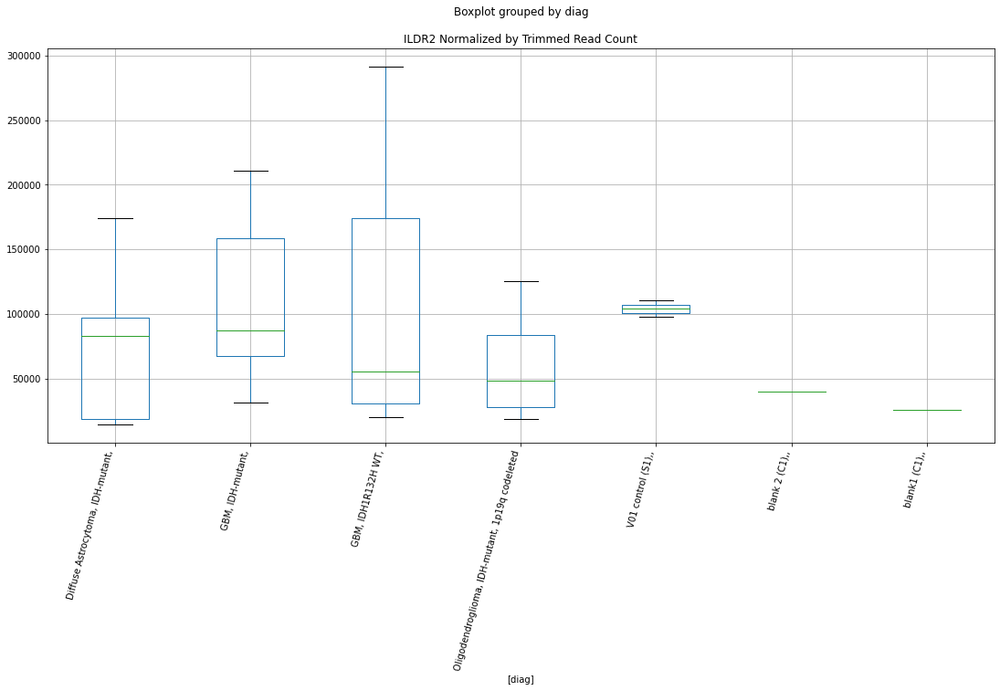

ILDR2 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.2229213635268783
	p = 0.03926979636072517
ILDR2 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.2229213635268783
	p = 0.03926979636072517


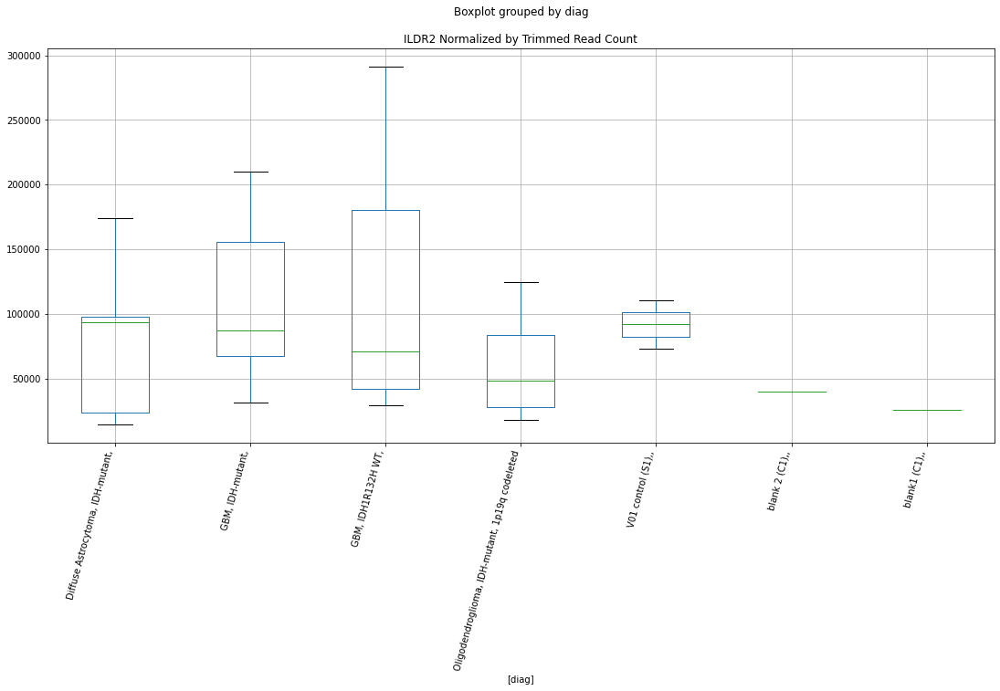

KCNMA1 D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -3.0854993182697474
	p = 0.006378381314709019
KCNMA1 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -4.324758604914797
	p = 0.0004080777767239241
KCNMA1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.4700641876516687
	p = 0.023737570868693842
KCNMA1 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 3.0854993182697474
	p = 0.006378381314709019
KCNMA1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 4.324758604914797
	p = 0.0004080777767239241
KCNMA1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.4700641876516687
	p = 0.023737570868693842


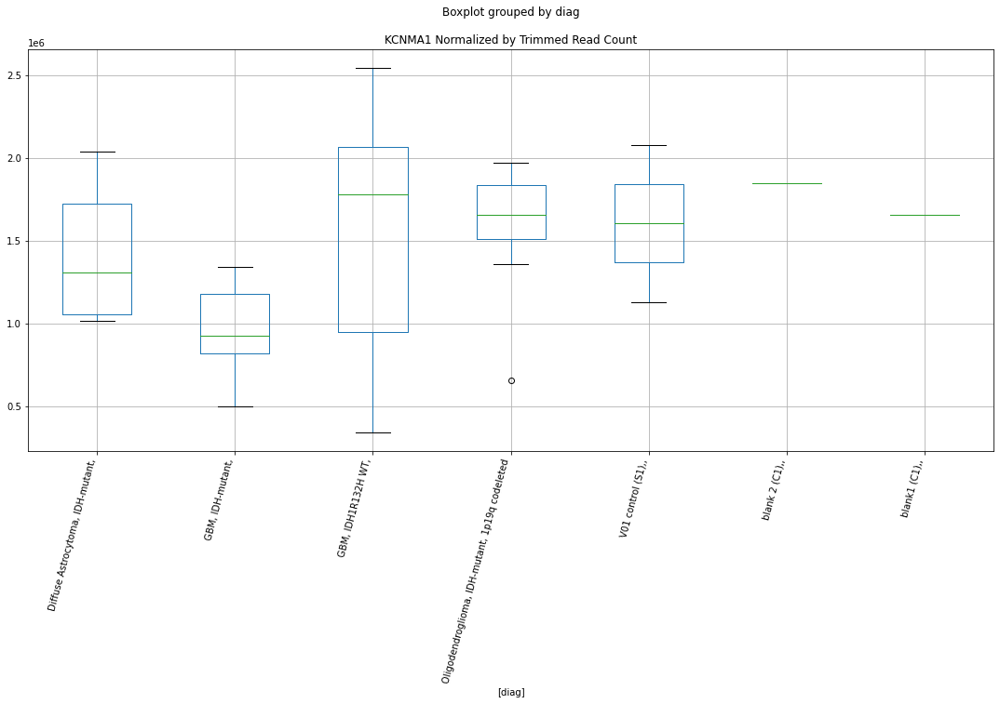

KCNMA1 D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -3.153989296508616
	p = 0.005490087884908314
KCNMA1 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -4.281008949620528
	p = 0.00044963942751984895
KCNMA1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.2707543627367994
	p = 0.03567408753360672
KCNMA1 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 3.153989296508616
	p = 0.005490087884908314
KCNMA1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 4.281008949620528
	p = 0.00044963942751984895
KCNMA1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.2707543627367994
	p = 0.03567408753360672


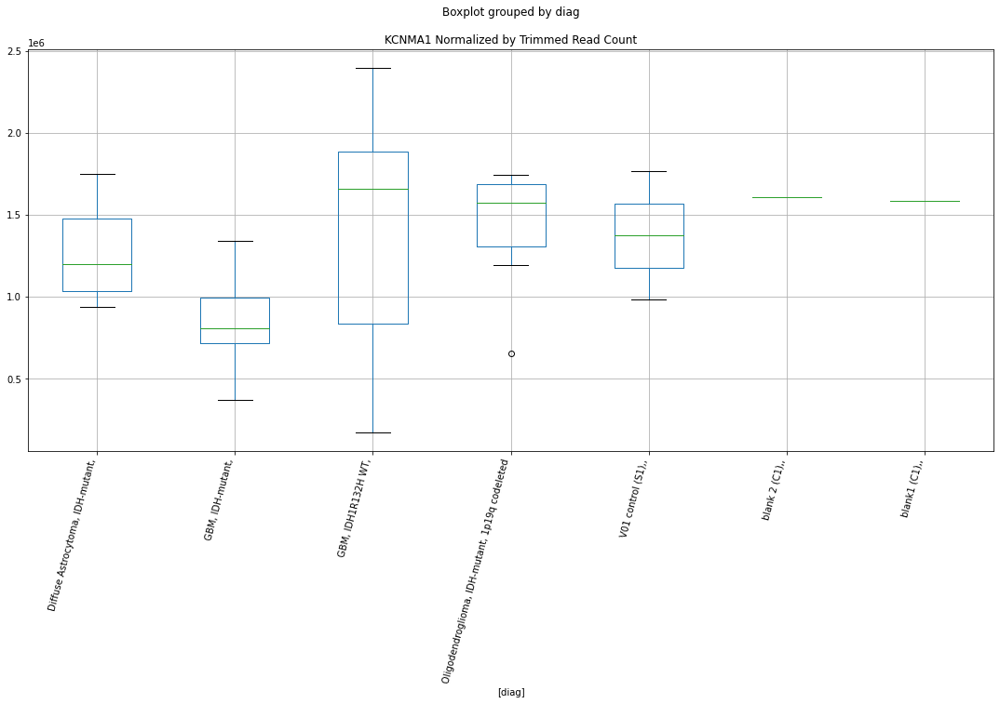

MICAL2 D-plex bbduk1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -3.0008871041479446
	p = 0.007670600187628118
MICAL2 D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.7809648544112389
	p = 0.09180110812676562
MICAL2 D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 3.0008871041479446
	p = 0.007670600187628118
MICAL2 D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.7809648544112389
	p = 0.09180110812676562


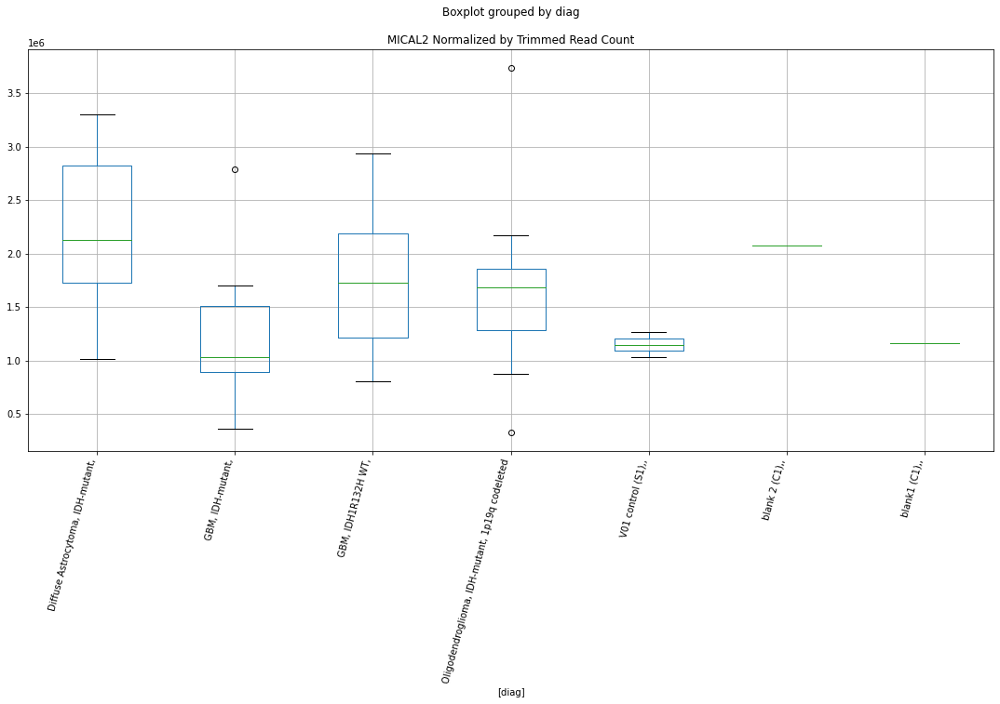

MICAL2 D-plex cutadapt1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -3.0728160009898677
	p = 0.006557608812683248
MICAL2 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 3.0728160009898677
	p = 0.006557608812683248
MICAL2 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.2556821104238325
	p = 0.03677289431047139
MICAL2 D-plex cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.2556821104238325
	p = 0.03677289431047139


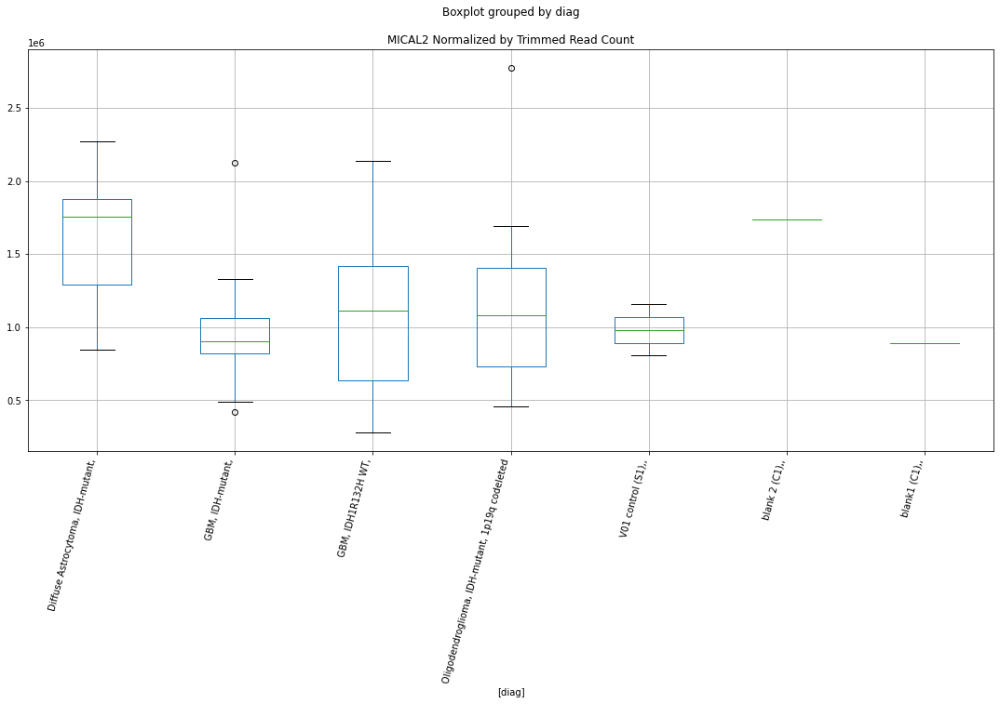

MICAL2 D-plex cutadapt2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -3.125814639223645
	p = 0.0058398329337598694
MICAL2 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 3.125814639223645
	p = 0.0058398329337598694
MICAL2 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.256491580715966
	p = 0.036713096323797025
MICAL2 D-plex cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.256491580715966
	p = 0.036713096323797025


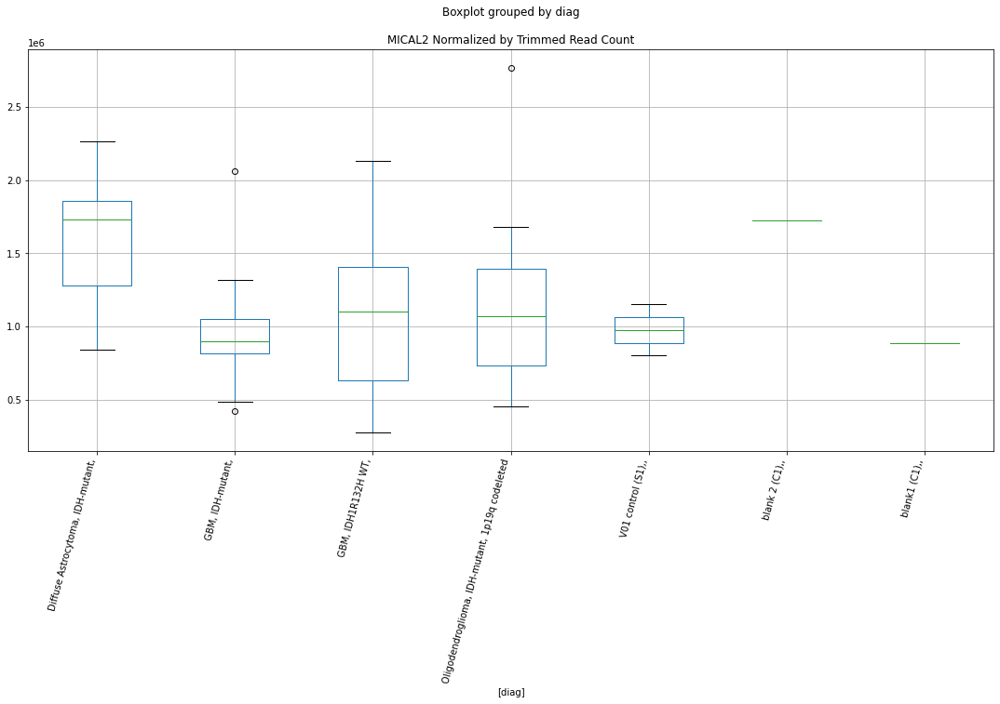

MICAL2 D-plex cutadapt3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -3.0460621919079838
	p = 0.006951896463259855
MICAL2 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 3.0460621919079838
	p = 0.006951896463259855
MICAL2 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.247790685903388
	p = 0.037360586665279485
MICAL2 D-plex cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -2.247790685903388
	p = 0.037360586665279485


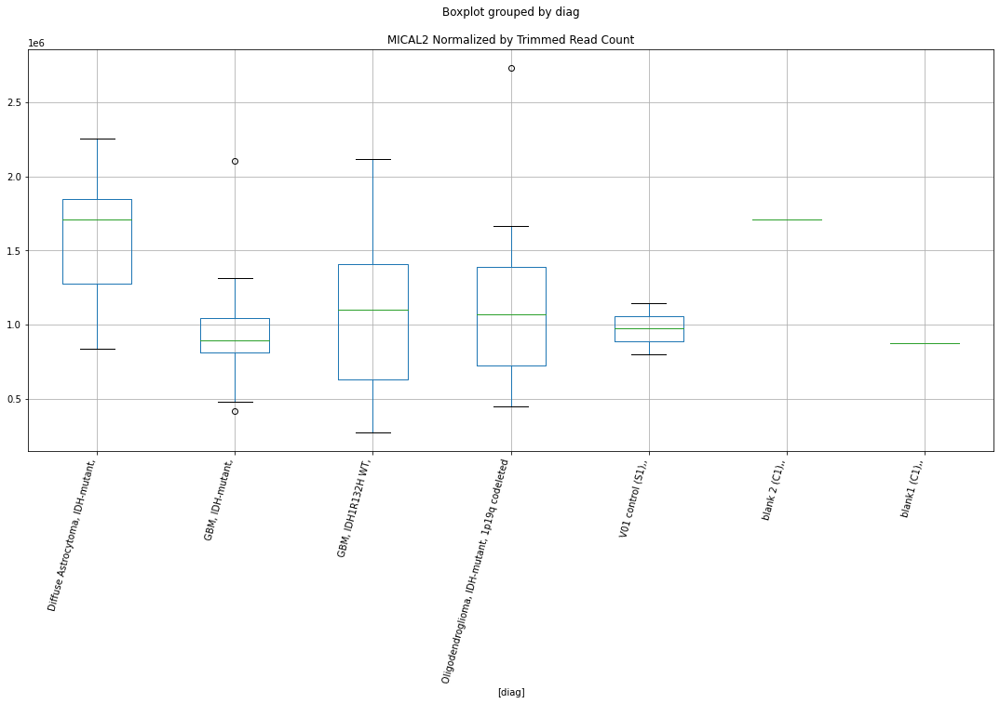

HDGFL2 D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7504251617861821
	p = 0.09707046865903644
HDGFL2 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0388890473372285
	p = 0.056423533020544696
HDGFL2 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.3526782694881674
	p = 0.030215049436747986
HDGFL2 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7504251617861821
	p = 0.09707046865903644
HDGFL2 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0388890473372285
	p = 0.056423533020544696
HDGFL2 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.3526782694881674
	p = 0.030215049436747986


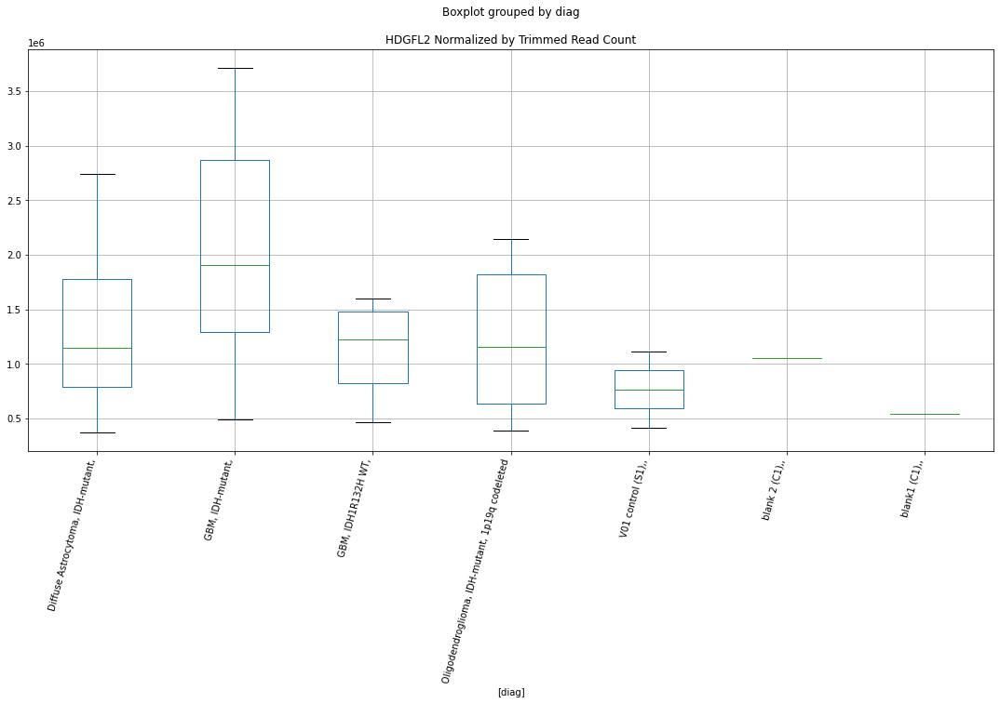

HDGFL2 D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7486417144103998
	p = 0.09738614069209384
HDGFL2 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0396899283230177
	p = 0.05633605536070515
HDGFL2 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.3550589124477876
	p = 0.030068693244943035
HDGFL2 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7486417144103998
	p = 0.09738614069209384
HDGFL2 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -2.0396899283230177
	p = 0.05633605536070515
HDGFL2 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.3550589124477876
	p = 0.030068693244943035


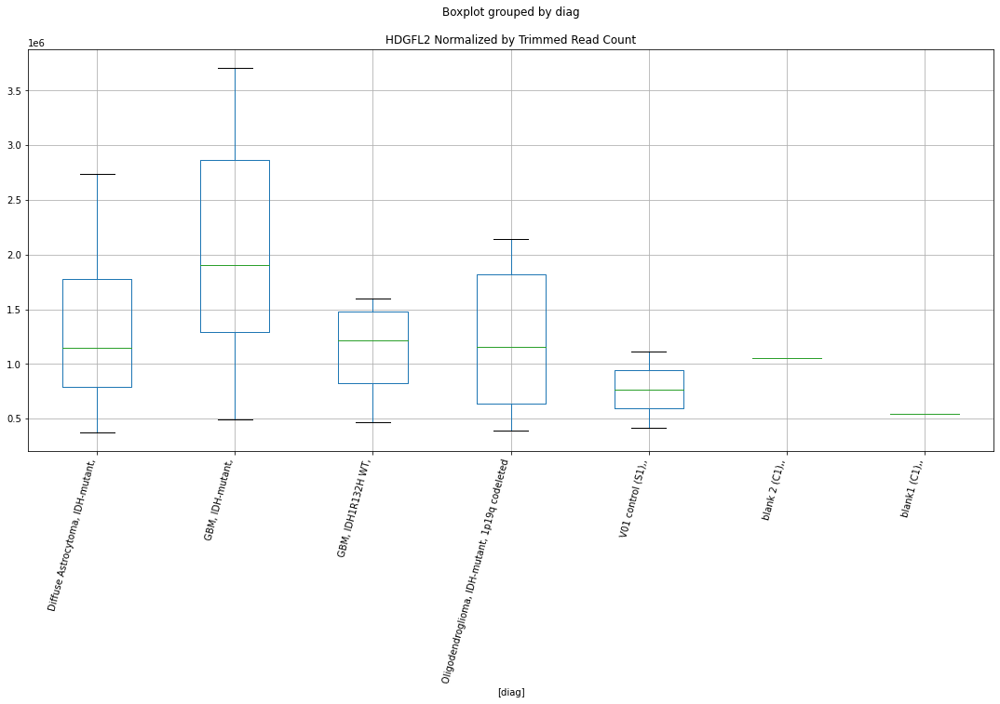

In [79]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in genes:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Trimmed Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


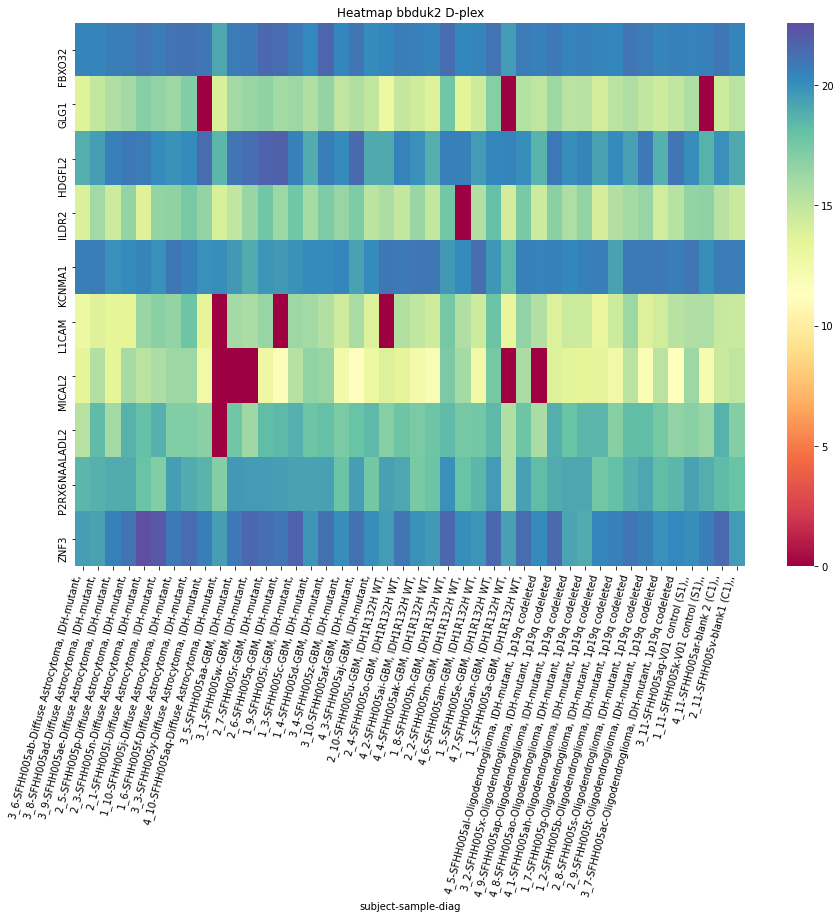

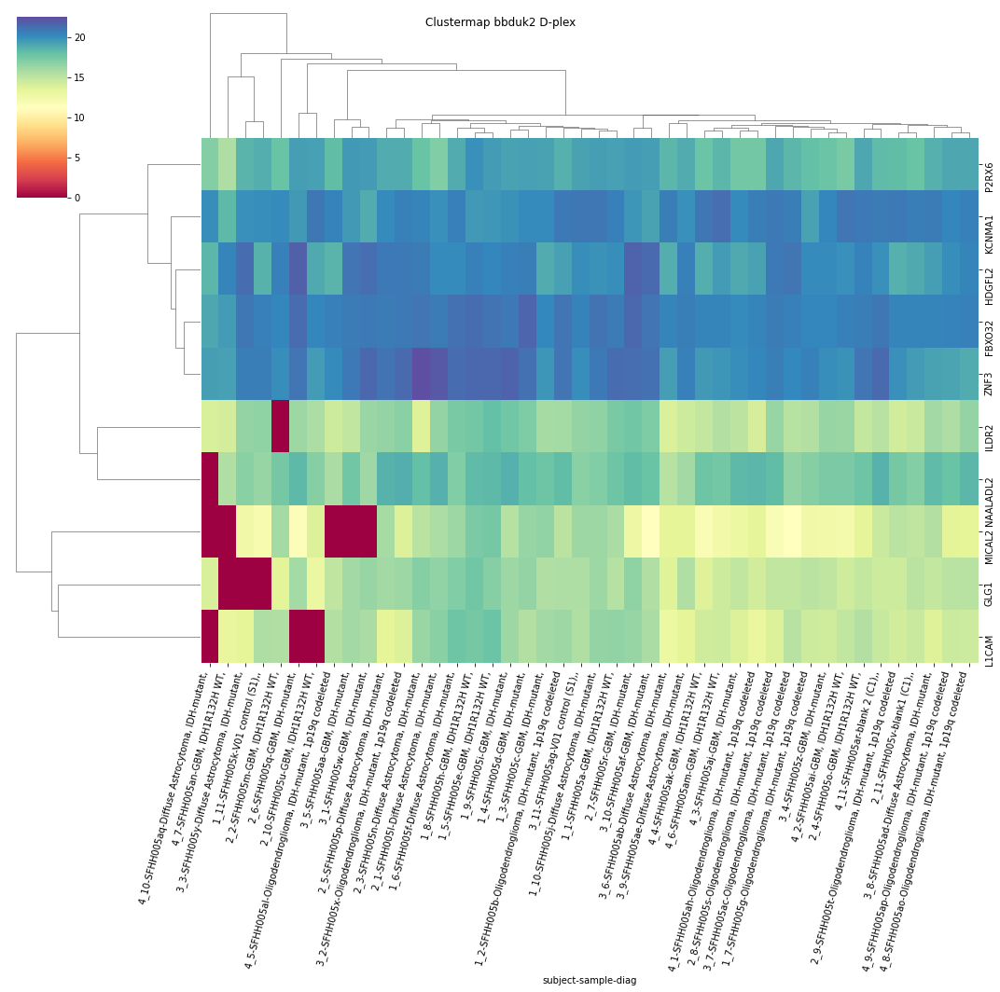

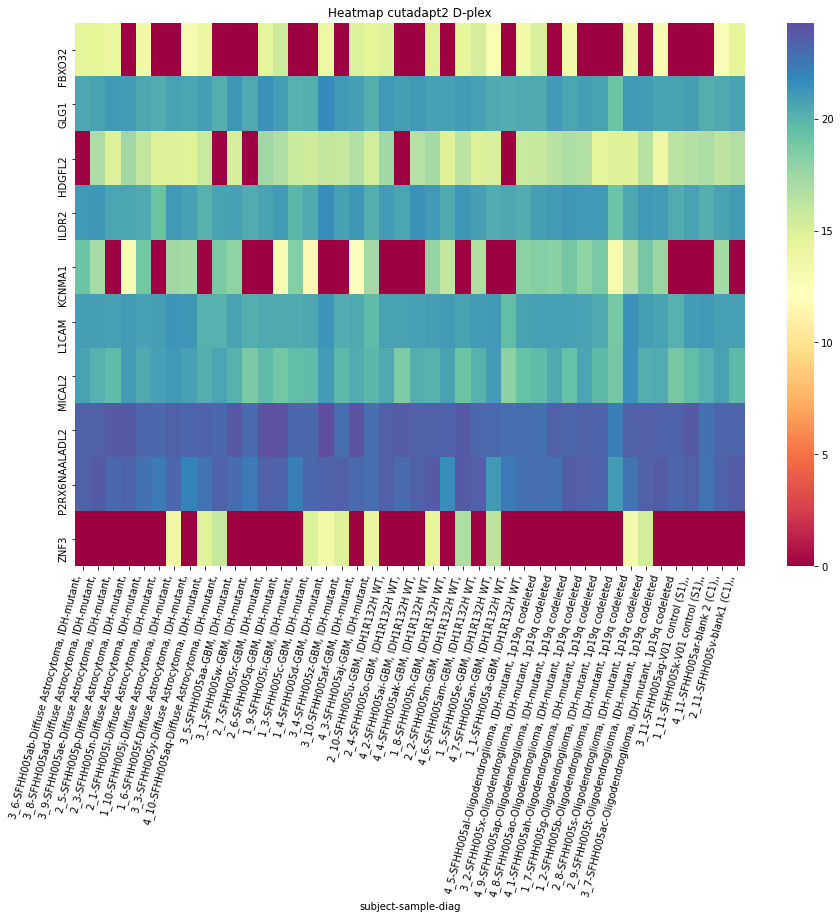

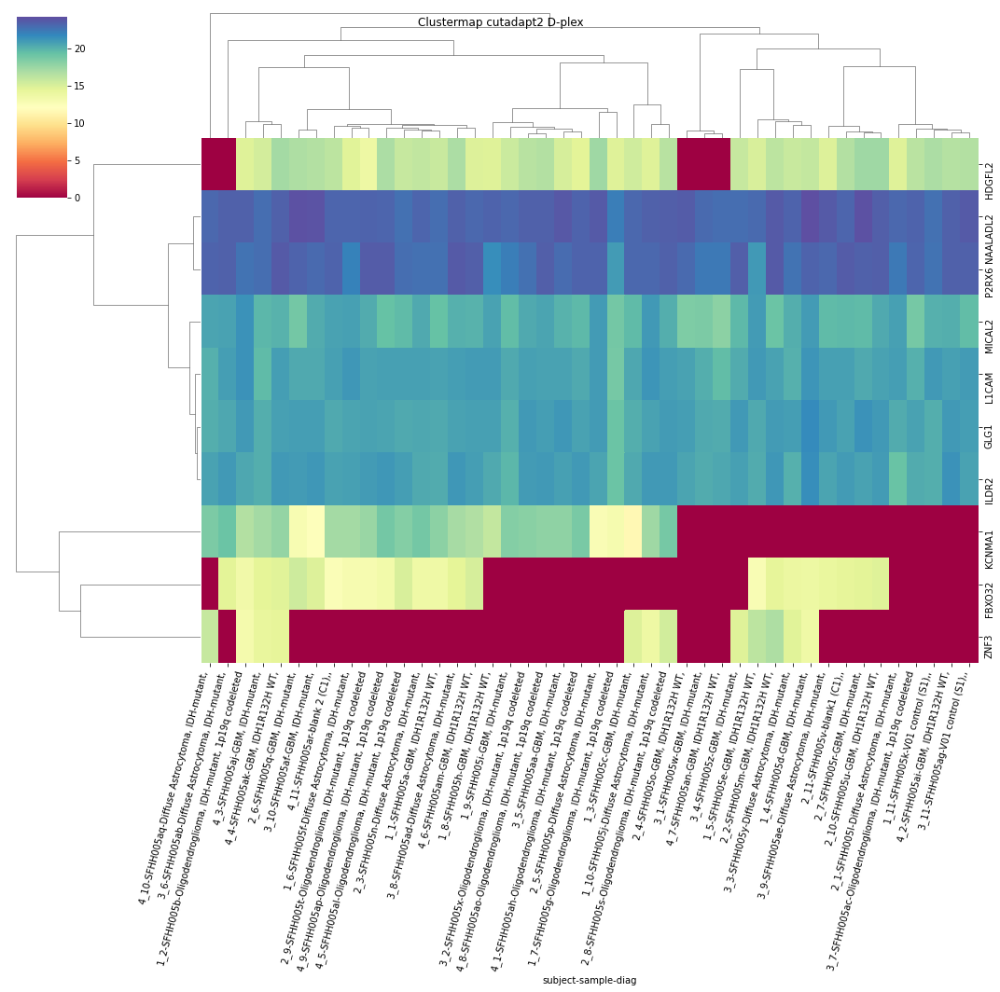

In [80]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

NM_001018138.1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7535317978684477
	p = 0.09652270957014215
NM_001018138.1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.783998590481097
	p = 0.09129152025624619
NM_001018138.1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7535317978684477
	p = 0.09652270957014215
NM_001018138.1 D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.783998590481097
	p = 0.09129152025624619


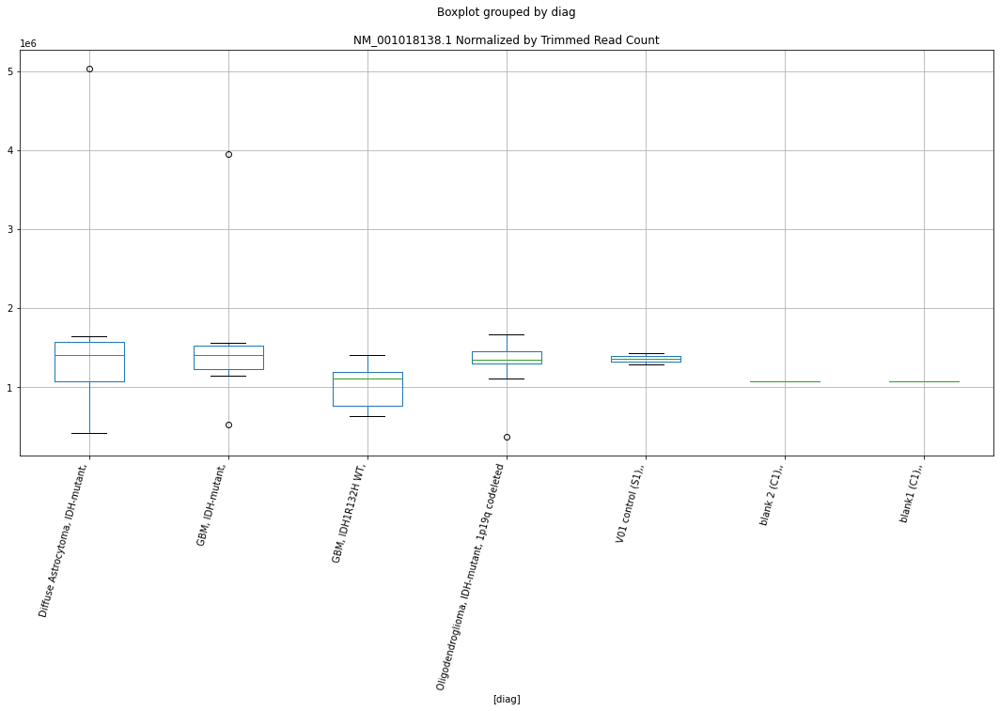

NM_001018138.1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7579201571415983
	p = 0.09575352874405607
NM_001018138.1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.78223520617731
	p = 0.09158742153272016
NM_001018138.1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7579201571415983
	p = 0.09575352874405607
NM_001018138.1 D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.78223520617731
	p = 0.09158742153272016


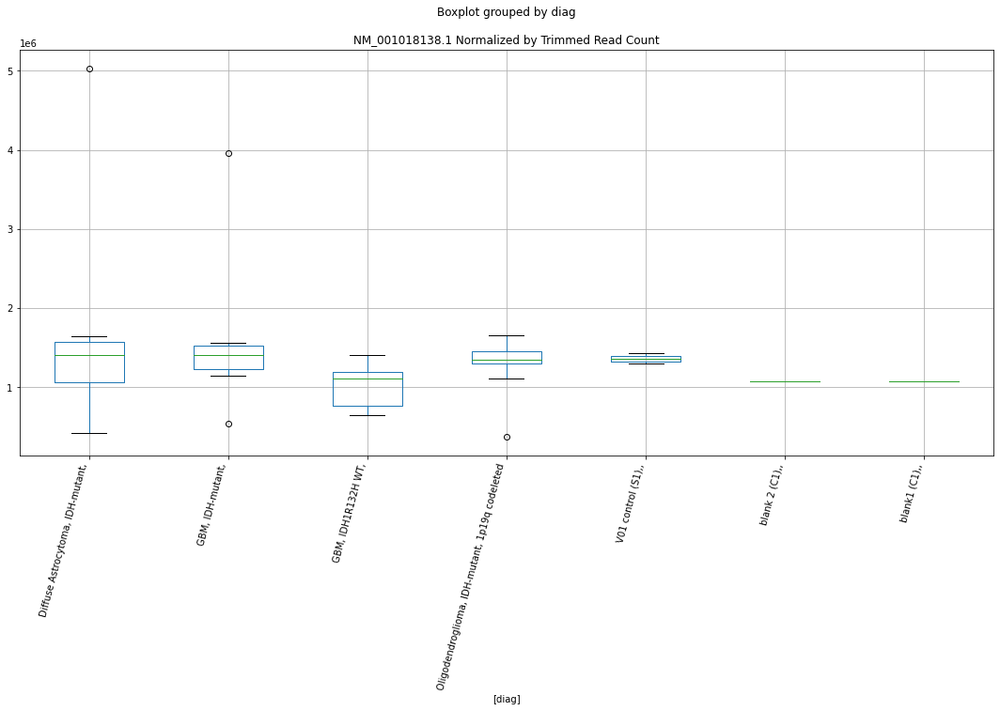

NR_027072.2 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7956219614439748
	p = 0.08936186121045928
NR_027072.2 D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7956219614439748
	p = 0.08936186121045928


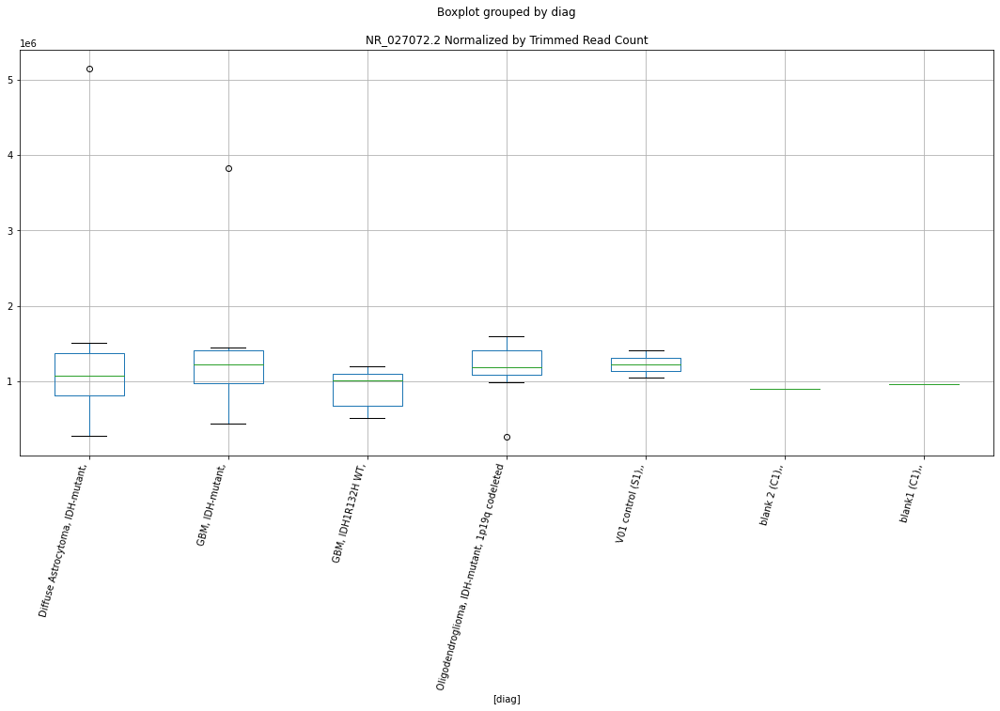

NR_027072.2 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7954608398876495
	p = 0.0893883645757815
NR_027072.2 D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7954608398876495
	p = 0.0893883645757815


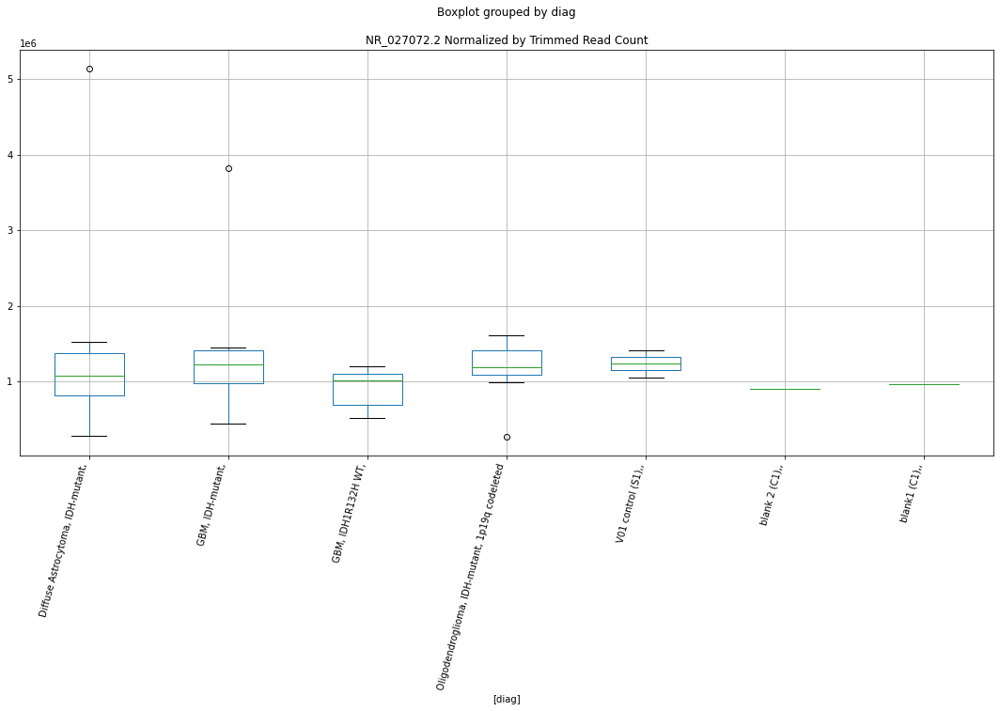

NR_027072.2 D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.711101276295729
	p = 0.014310097462900372
NR_027072.2 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.980782138385729
	p = 0.06310655323888281
NR_027072.2 D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.711101276295729
	p = 0.014310097462900372
NR_027072.2 D-plex cutadapt3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.980782138385729
	p = 0.06310655323888281


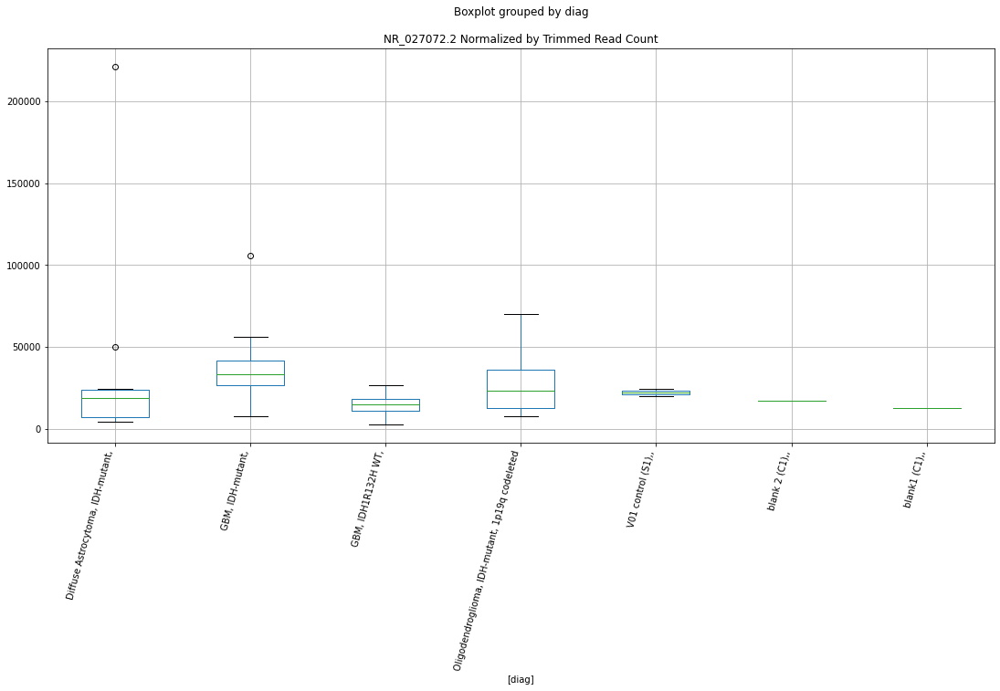

NM_001145873.1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8187582266898386
	p = 0.08562669602524671
NM_001145873.1 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7579529072749034
	p = 0.09574780844191272
NM_001145873.1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8187582266898386
	p = 0.08562669602524671
NM_001145873.1 D-plex bbduk2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7579529072749034
	p = 0.09574780844191272


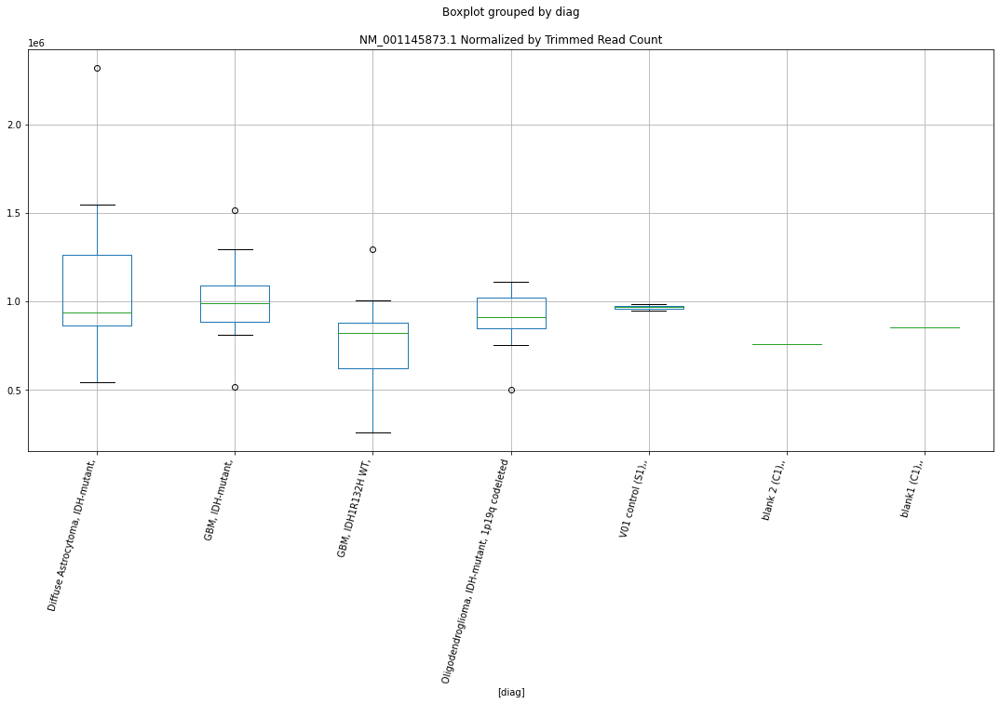

NM_001145873.1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8344674848061
	p = 0.08316920567073335
NM_001145873.1 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.761937664711345
	p = 0.09505402143615312
NM_001145873.1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8344674848061
	p = 0.08316920567073335
NM_001145873.1 D-plex bbduk3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.761937664711345
	p = 0.09505402143615312


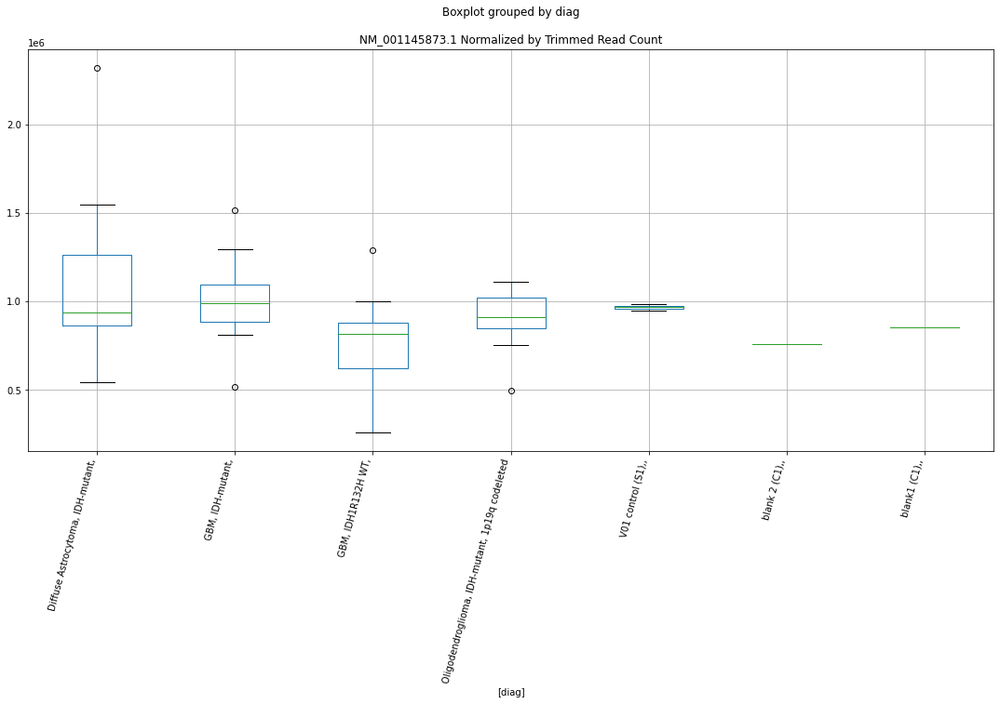

NM_001145873.1 D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 3.251629366789892
	p = 0.004429481197374402
NM_001145873.1 D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.2049499955068415
	p = 0.04070491837502656
NM_001145873.1 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0297771589291944
	p = 0.05742746050431641
NM_001145873.1 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.750339298016834
	p = 0.09708564628116914
NM_001145873.1 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -3.251629366789892
	p = 0.004429481197374402
NM_001145873.1 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.0297771589291944
	p = 0.05742746050431641
NM_001145873.1 D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.2049499955068415
	p = 0.040704918

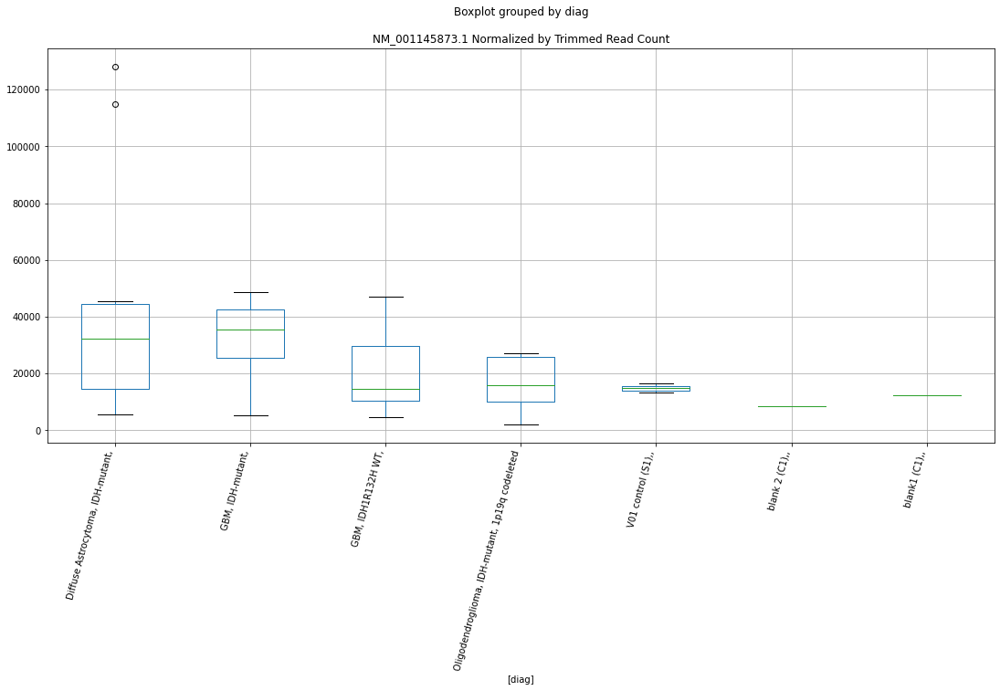

NR_002728.3 D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.804281571939495
	p = 0.08794747837601444
NR_002728.3 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.804281571939495
	p = 0.08794747837601444
NR_002728.3 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.1074298208265323
	p = 0.0493661208870534
NR_002728.3 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.1074298208265323
	p = 0.0493661208870534


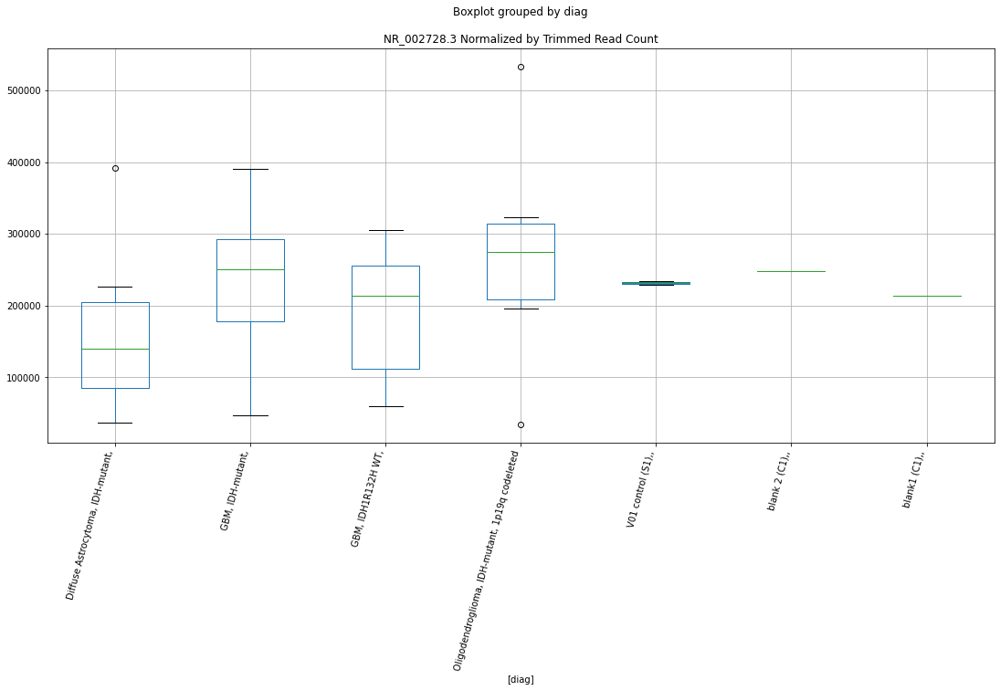

NR_002728.3 D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7826323542061904
	p = 0.09152070604277433
NR_002728.3 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.7826323542061904
	p = 0.09152070604277433
NR_002728.3 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.064876396090132
	p = 0.05364675896205514
NR_002728.3 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.064876396090132
	p = 0.05364675896205514


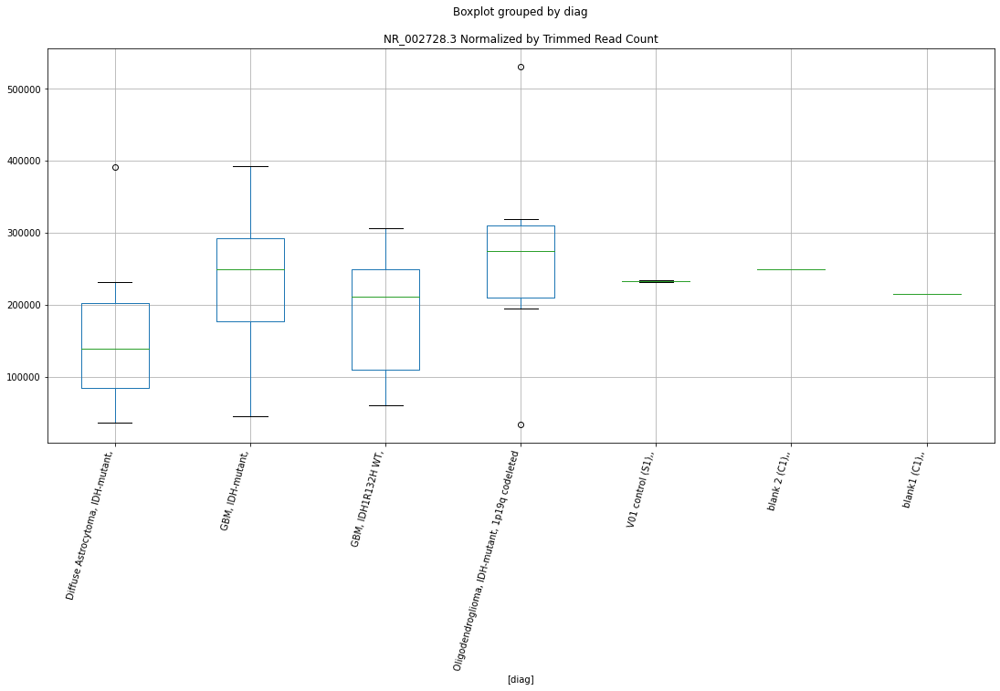

NM_001987.5 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.96305727002906
	p = 0.06528201137226051
NM_001987.5 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.96305727002906
	p = 0.06528201137226051


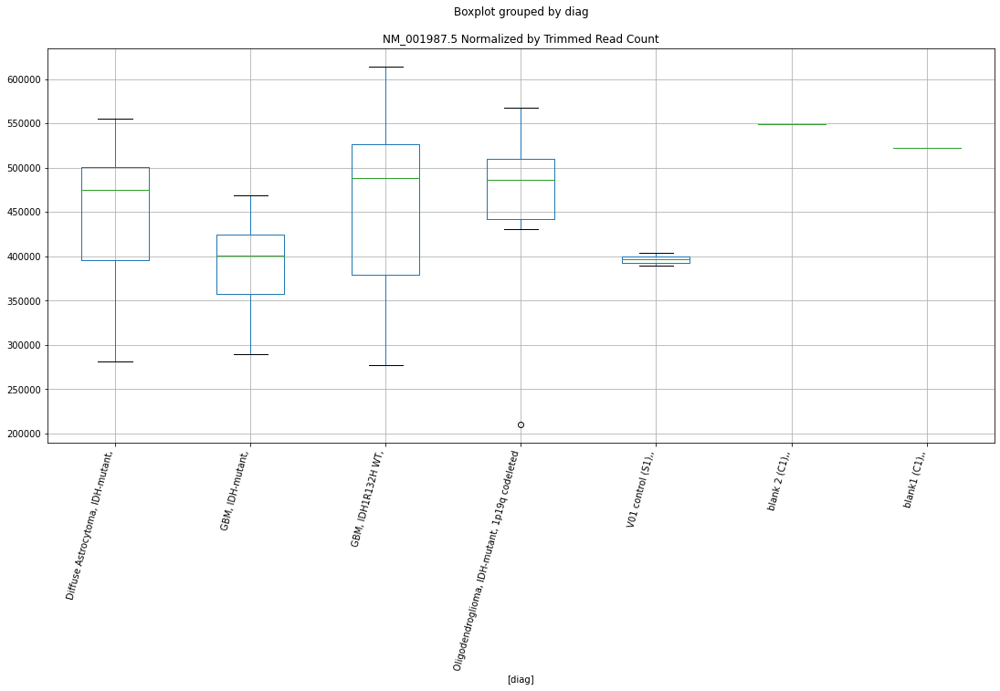

NM_001987.5 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.009959328993675
	p = 0.059666735116874196
NM_001987.5 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.009959328993675
	p = 0.059666735116874196


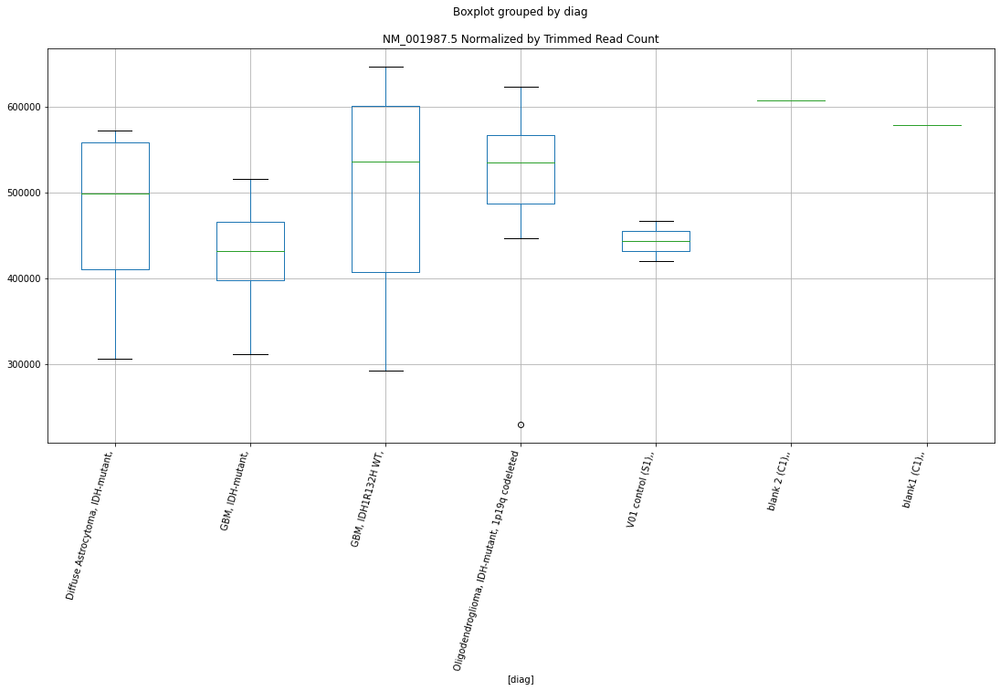

XM_011520608.2 D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8274317488600802
	p = 0.0842620853968364
XM_011520608.2 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0570252855966142
	p = 0.054472338816019046
XM_011520608.2 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 1.8274317488600802
	p = 0.0842620853968364
XM_011520608.2 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.0570252855966142
	p = 0.054472338816019046


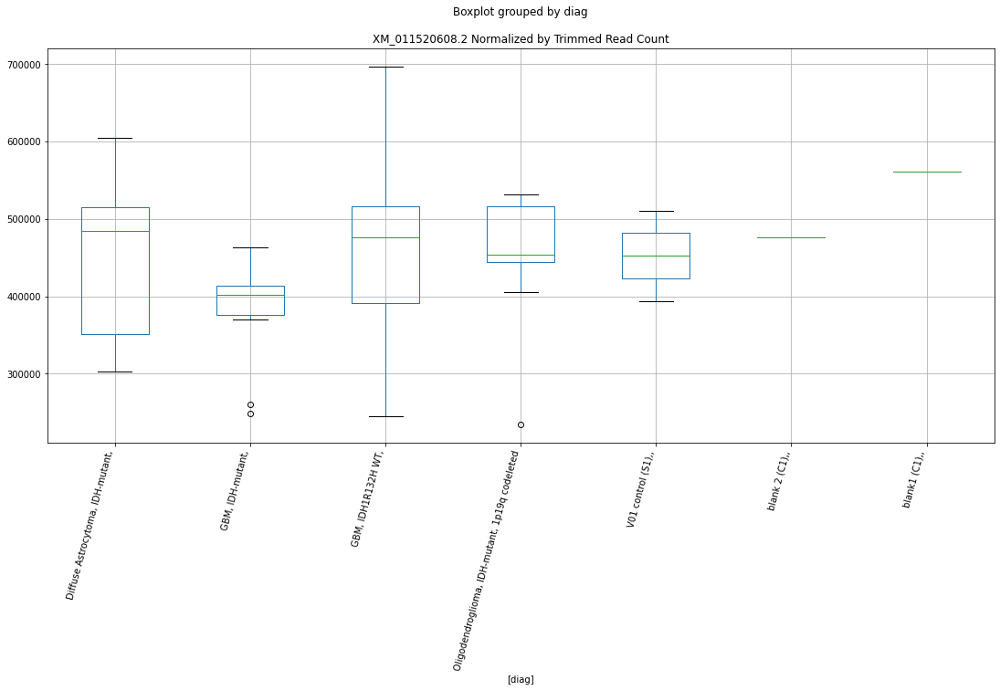

XM_011520608.2 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.472983817933543
	p = 0.02359444323553693
XM_011520608.2 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.472983817933543
	p = 0.02359444323553693


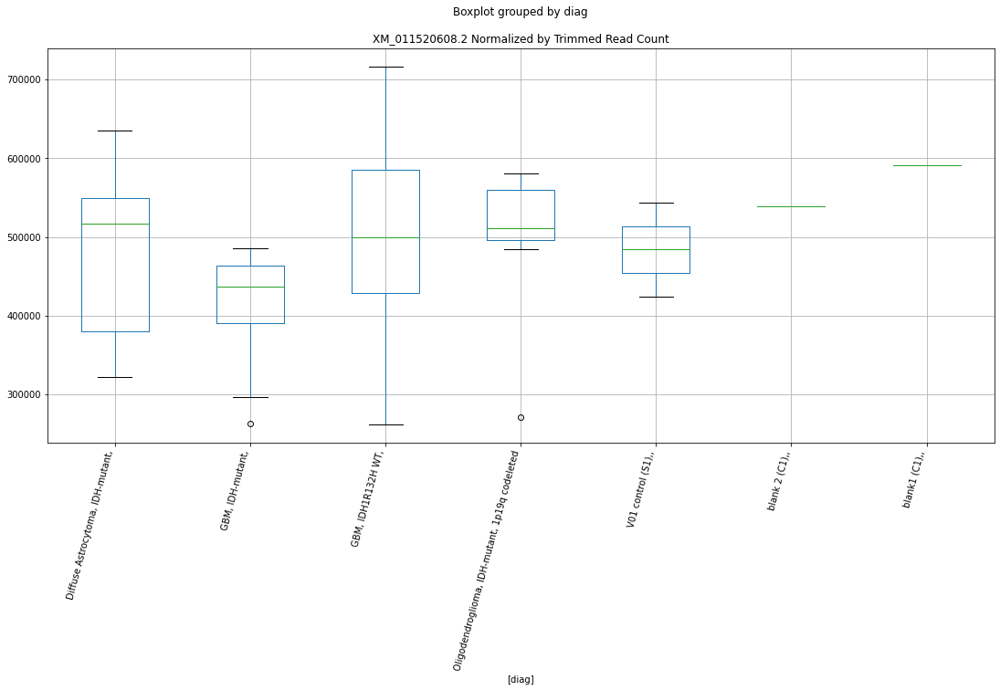

XM_011520607.2 D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8060728794292287
	p = 0.08765735782889947
XM_011520607.2 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 1.8060728794292287
	p = 0.08765735782889947


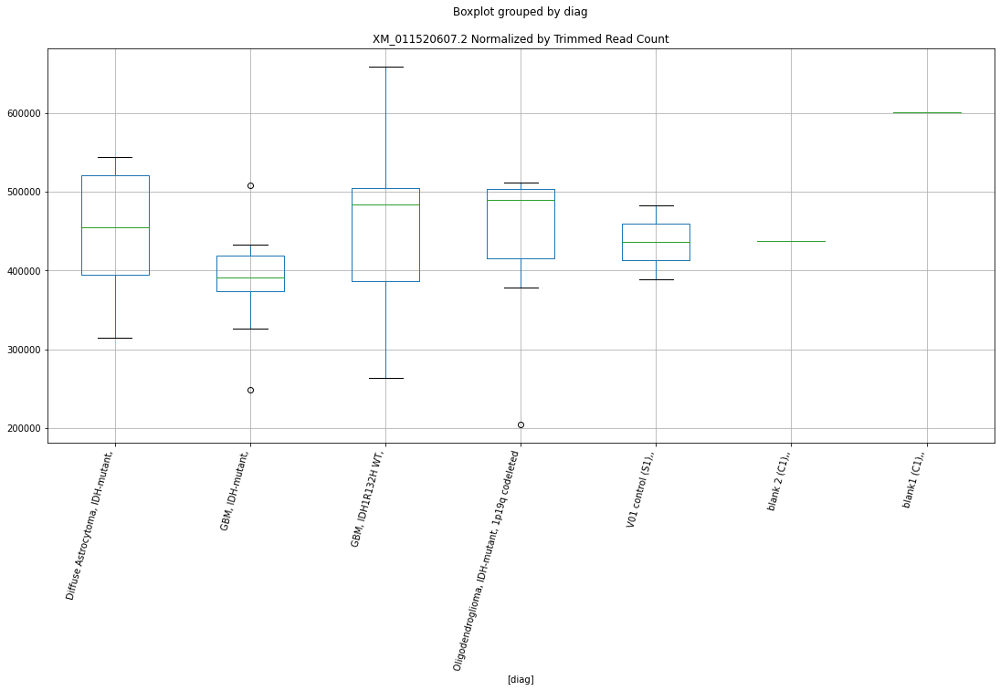

XM_011520607.2 D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7715504681025296
	p = 0.09339828710679081
XM_011520607.2 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8225689973741175
	p = 0.0850247766173479
XM_011520607.2 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 1.7715504681025296
	p = 0.09339828710679081
XM_011520607.2 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8225689973741175
	p = 0.0850247766173479


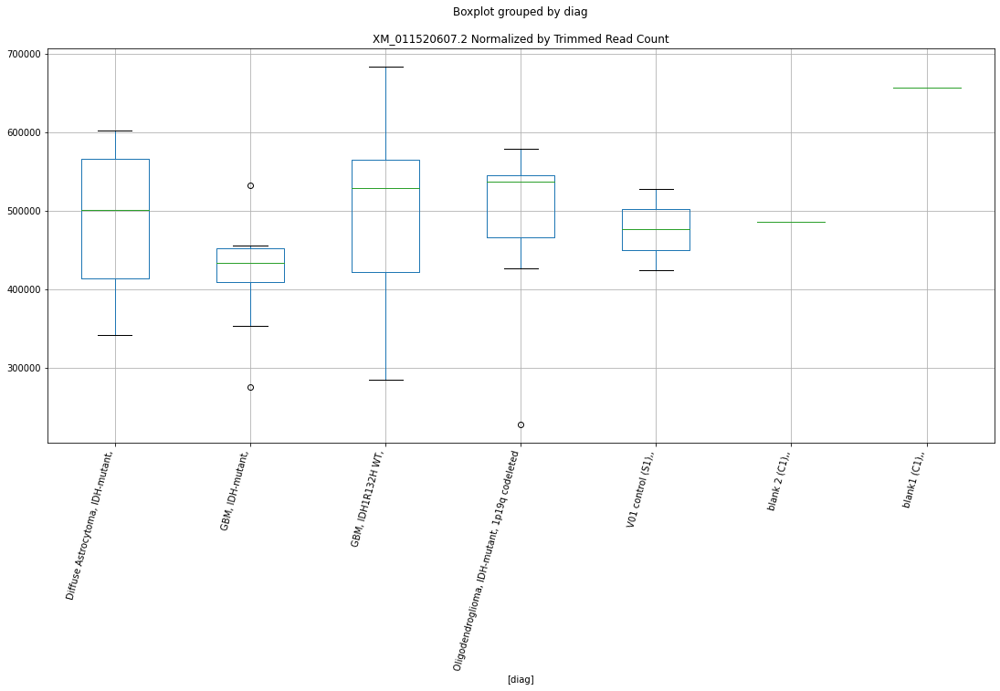

XM_017018990.1 D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.8557408659068917
	p = 0.07994017072939133
XM_017018990.1 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.2124308858096073
	p = 0.040101764340731955
XM_017018990.1 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 1.8557408659068917
	p = 0.07994017072939133
XM_017018990.1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.2124308858096073
	p = 0.040101764340731955


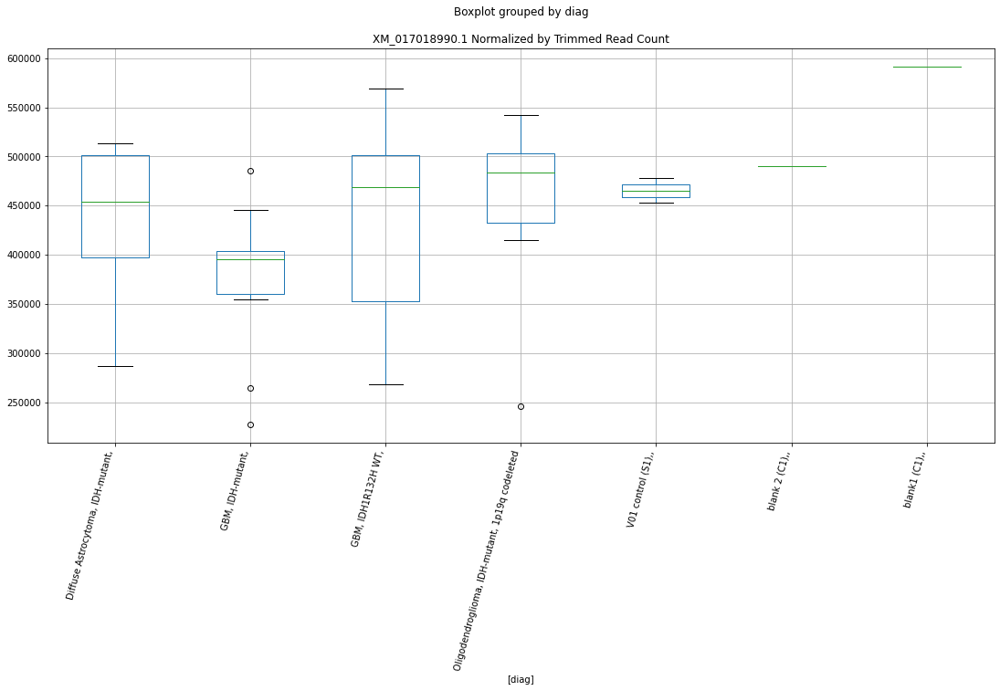

XM_017018990.1 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.4612700517586417
	p = 0.02417362924502446
XM_017018990.1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.4612700517586417
	p = 0.02417362924502446


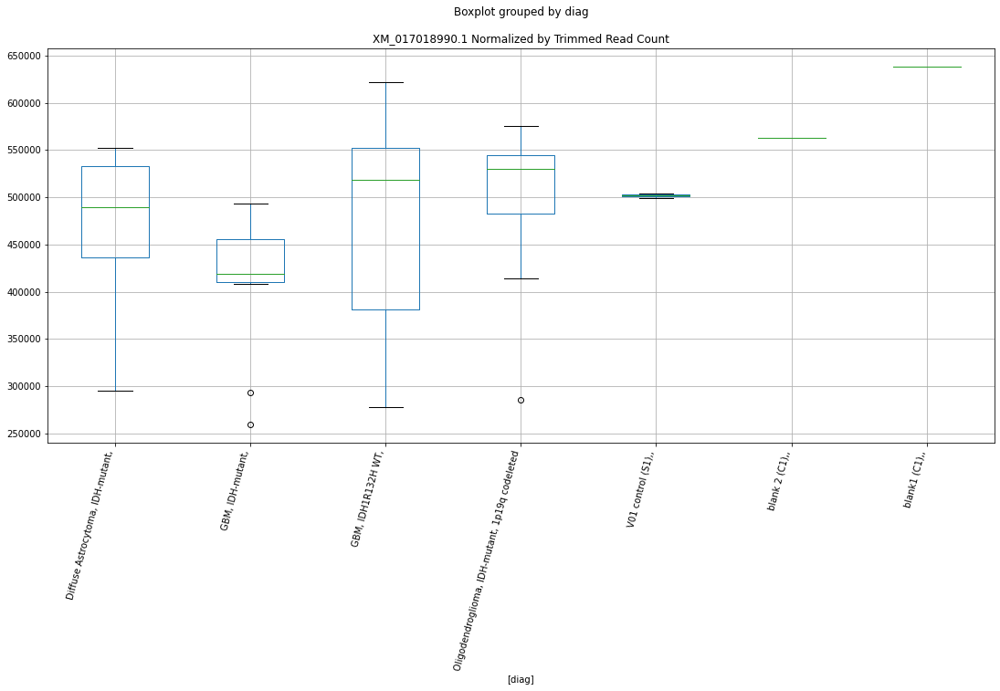

XM_017018991.1 D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.843774465621047
	p = 0.08174267066723723
XM_017018991.1 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 1.843774465621047
	p = 0.08174267066723723


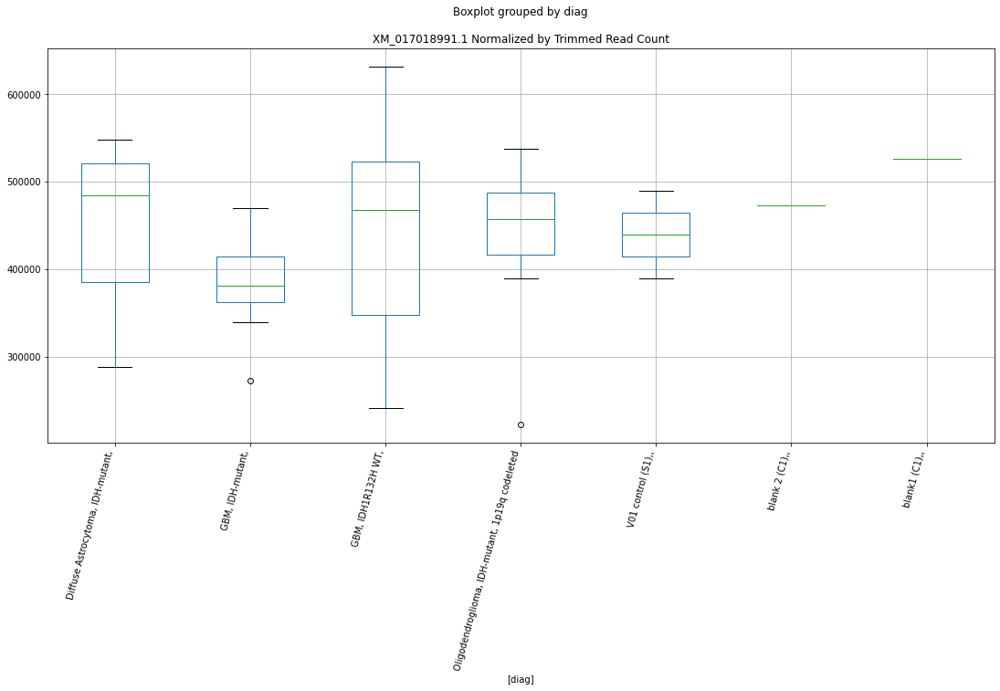

XM_017018991.1 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.92726535087563
	p = 0.06988030752156262
XM_017018991.1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.92726535087563
	p = 0.06988030752156262


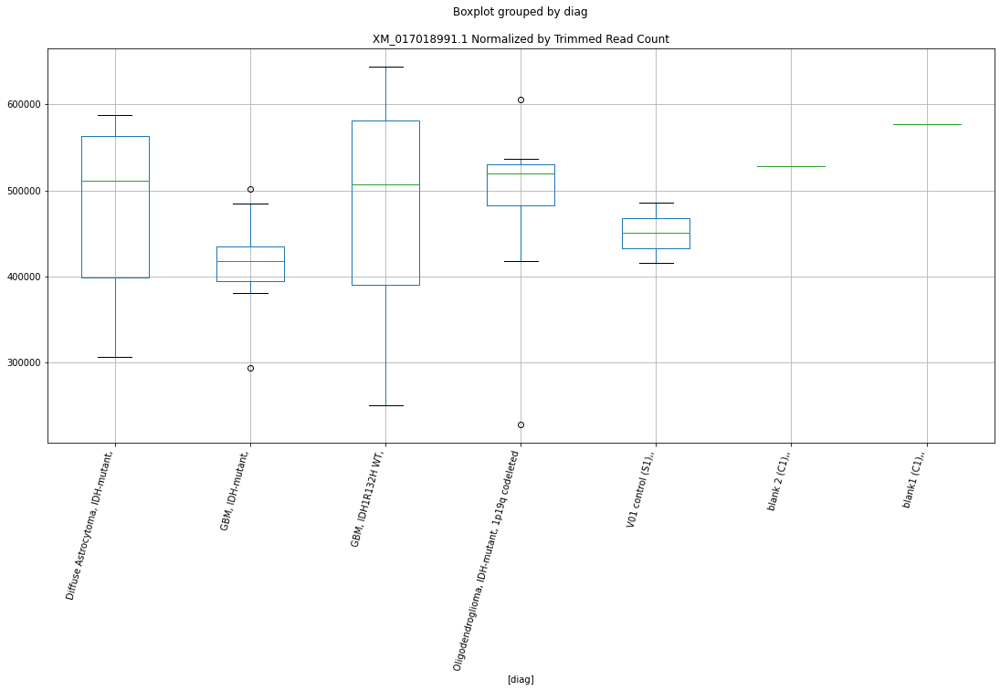

NM_006352.4 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9192434288411895
	p = 0.07094966130447125
NM_006352.4 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9192434288411895
	p = 0.07094966130447125


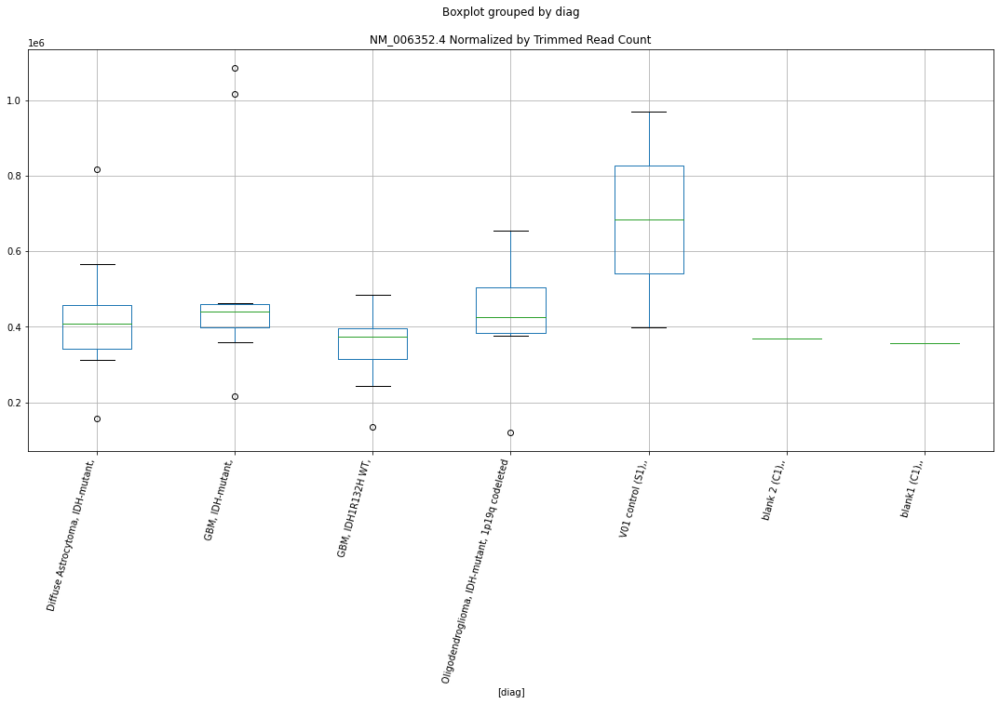

NM_006352.4 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9204885430953085
	p = 0.07078273439755041
NM_006352.4 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9204885430953085
	p = 0.07078273439755041


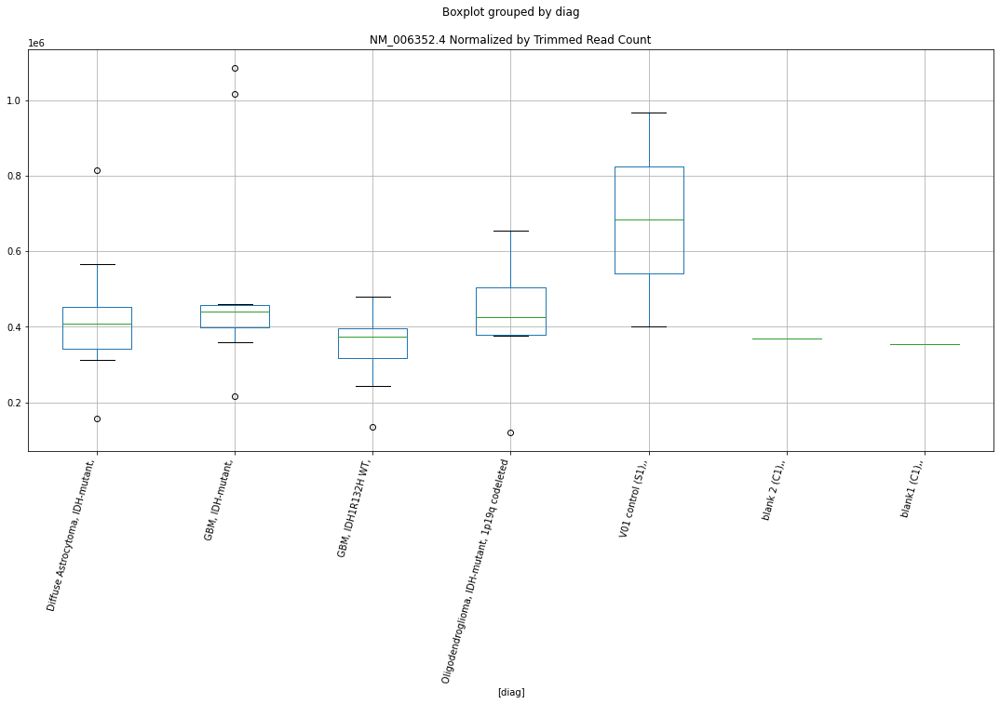

NR_134282.1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9168374571070923
	p = 0.07127321101075161
NR_134282.1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9168374571070923
	p = 0.07127321101075161


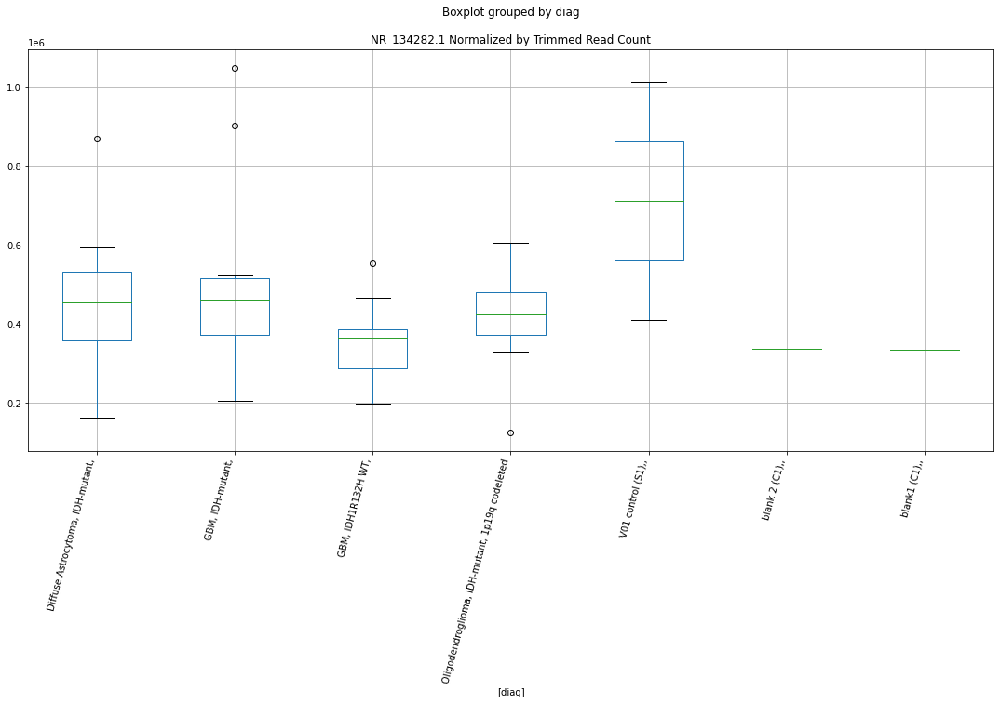

NR_134282.1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9039097014956627
	p = 0.07303425417642866
NR_134282.1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9039097014956627
	p = 0.07303425417642866


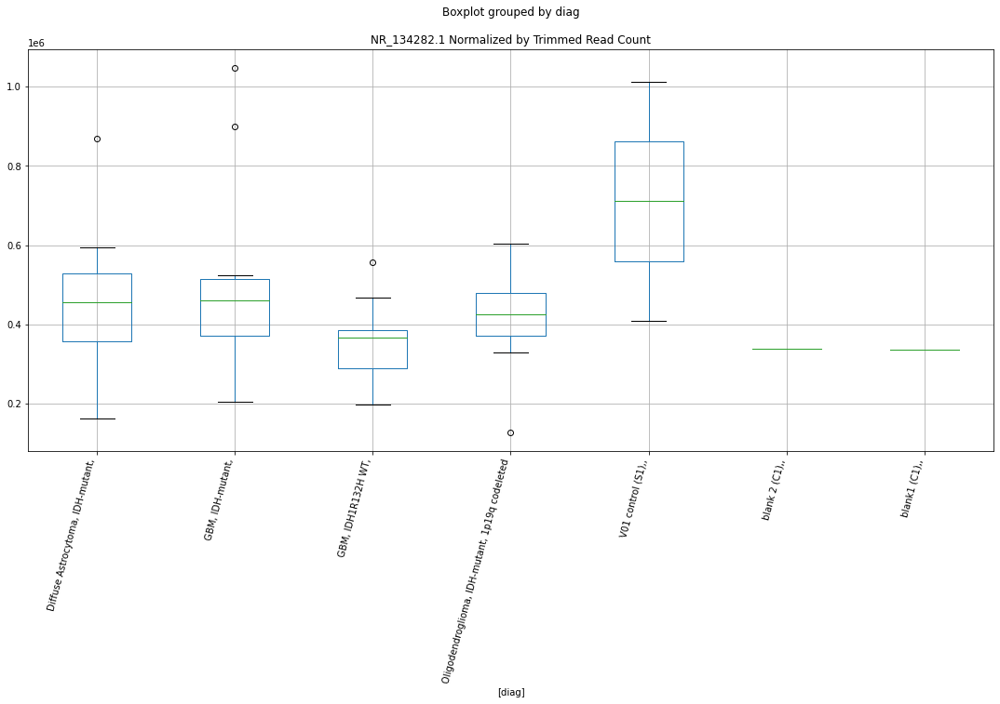

NR_135253.1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.860421377312787
	p = 0.07924472904296714
NR_135253.1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.8431814200812744
	p = 0.0818329240876521
NR_135253.1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.860421377312787
	p = 0.07924472904296714
NR_135253.1 D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8431814200812744
	p = 0.0818329240876521


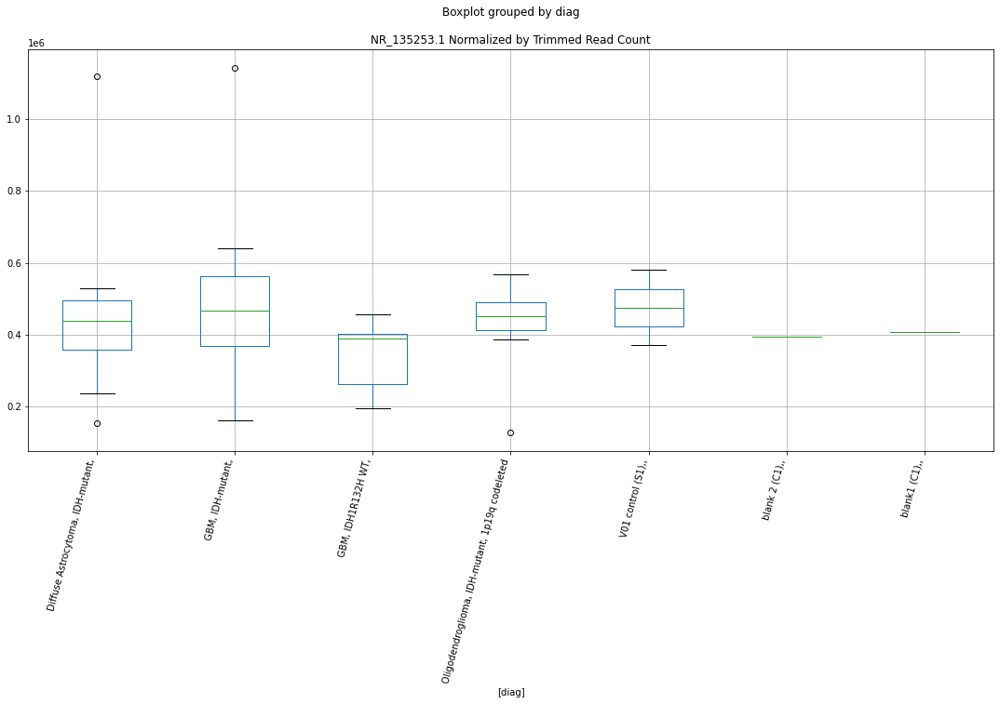

NR_135253.1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8539246019237214
	p = 0.0802114808076881
NR_135253.1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.8303992502607809
	p = 0.083799607489118
NR_135253.1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8539246019237214
	p = 0.0802114808076881
NR_135253.1 D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8303992502607809
	p = 0.083799607489118


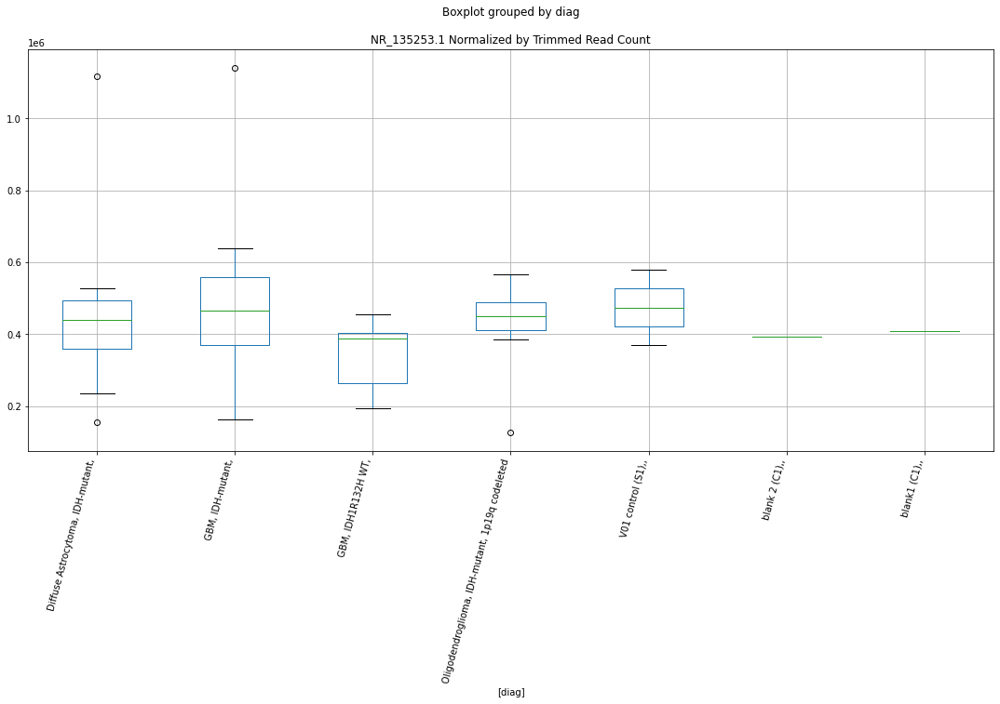

NR_033201.2 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7549642189293655
	p = 0.0962710510027169
NR_033201.2 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7549642189293655
	p = 0.0962710510027169


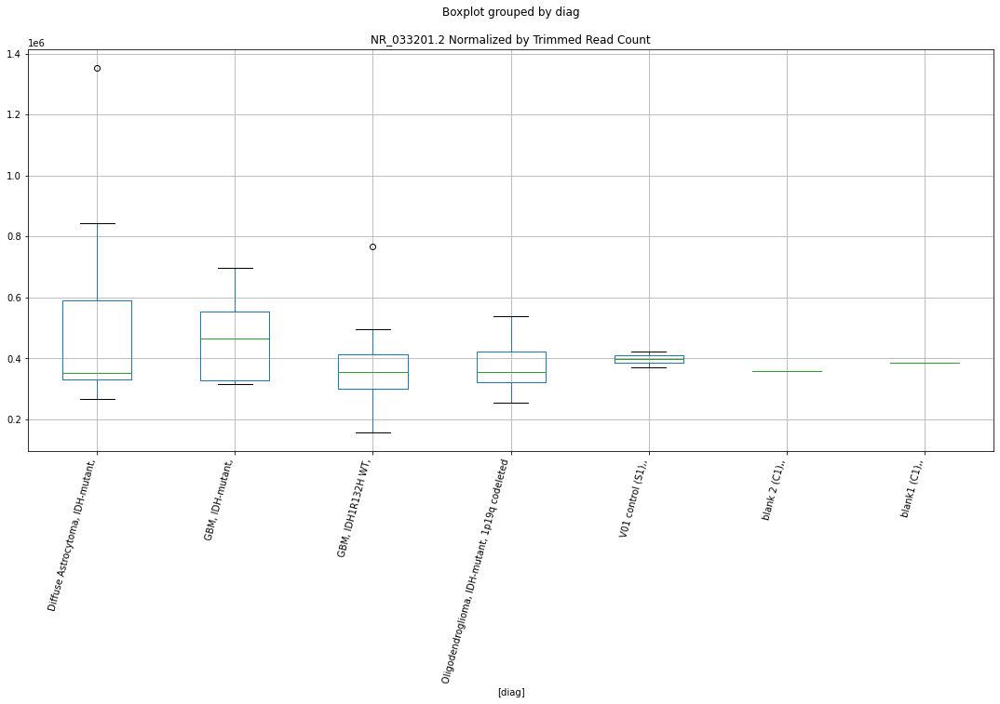

NR_033201.2 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7581380227684715
	p = 0.09571548082119288
NR_033201.2 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7581380227684715
	p = 0.09571548082119288


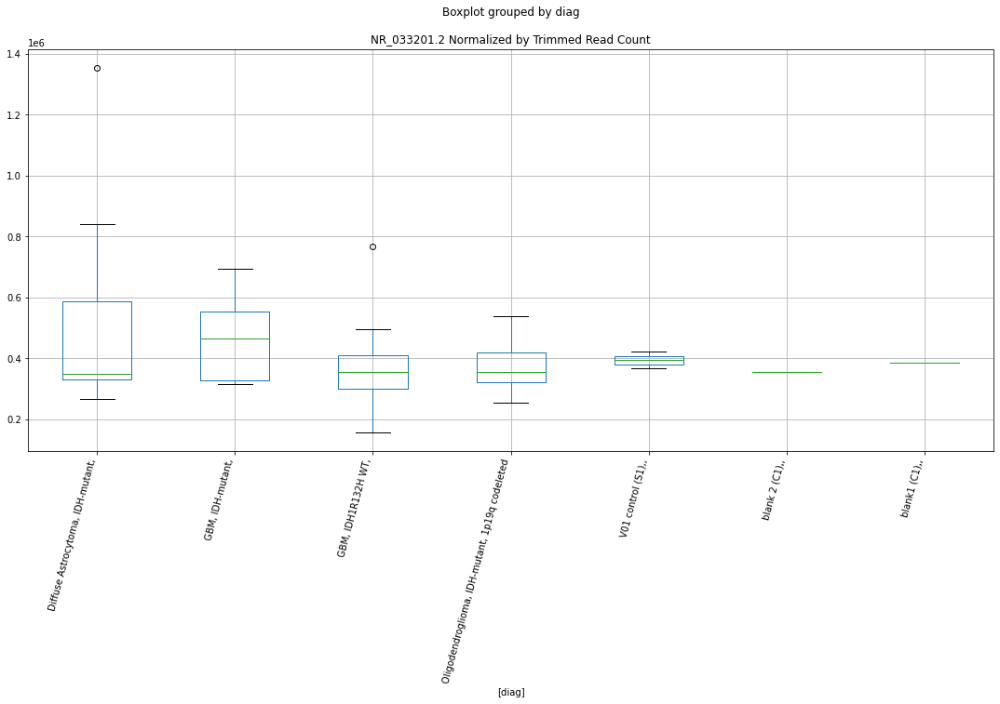

NR_026594.1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0289872861622857
	p = 0.05751524109164799
NR_026594.1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0289872861622857
	p = 0.05751524109164799


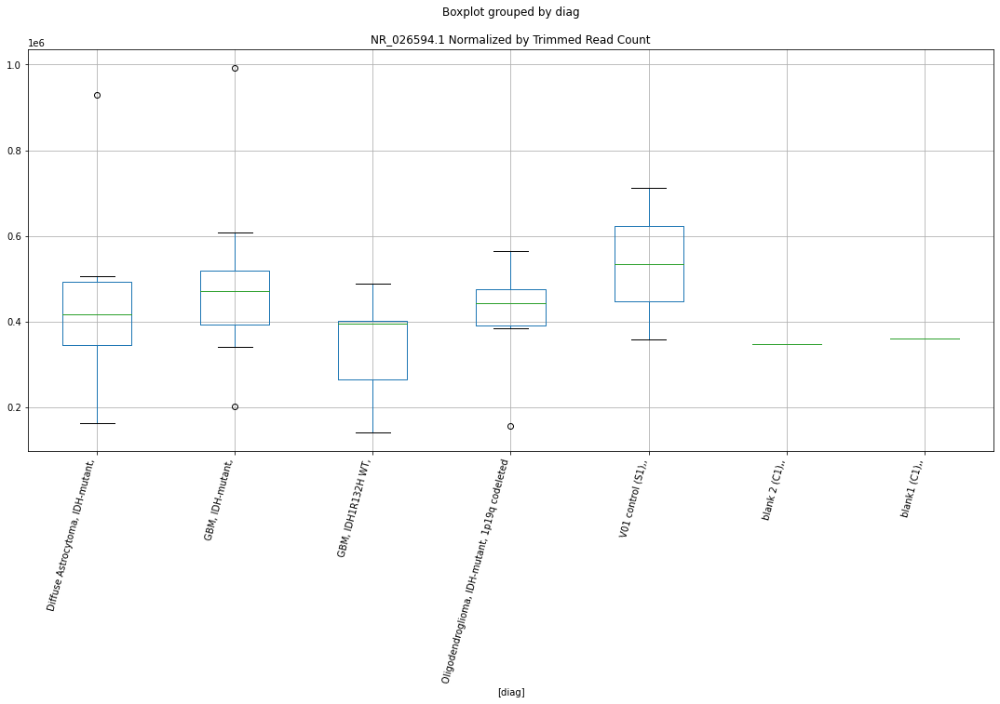

NR_026594.1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0370259902557337
	p = 0.05662750323807759
NR_026594.1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0370259902557337
	p = 0.05662750323807759


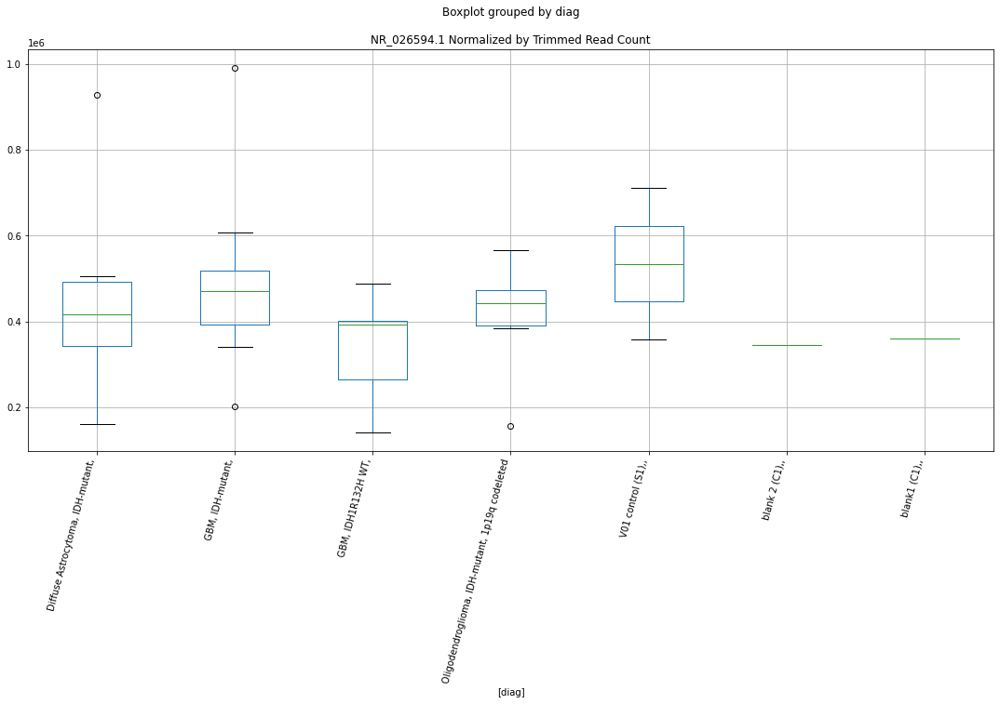

NR_033204.2 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7644618251130357
	p = 0.09461680222424104
NR_033204.2 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7644618251130357
	p = 0.09461680222424104


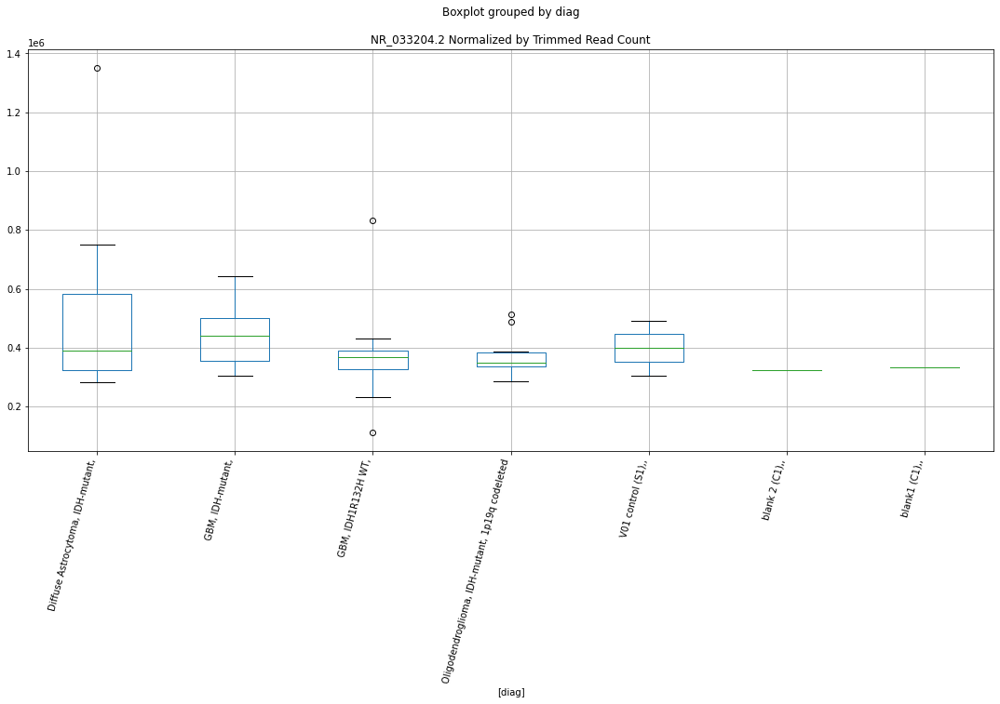

NR_033204.2 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7541193404063329
	p = 0.09641941669312871
NR_033204.2 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.7541193404063329
	p = 0.09641941669312871


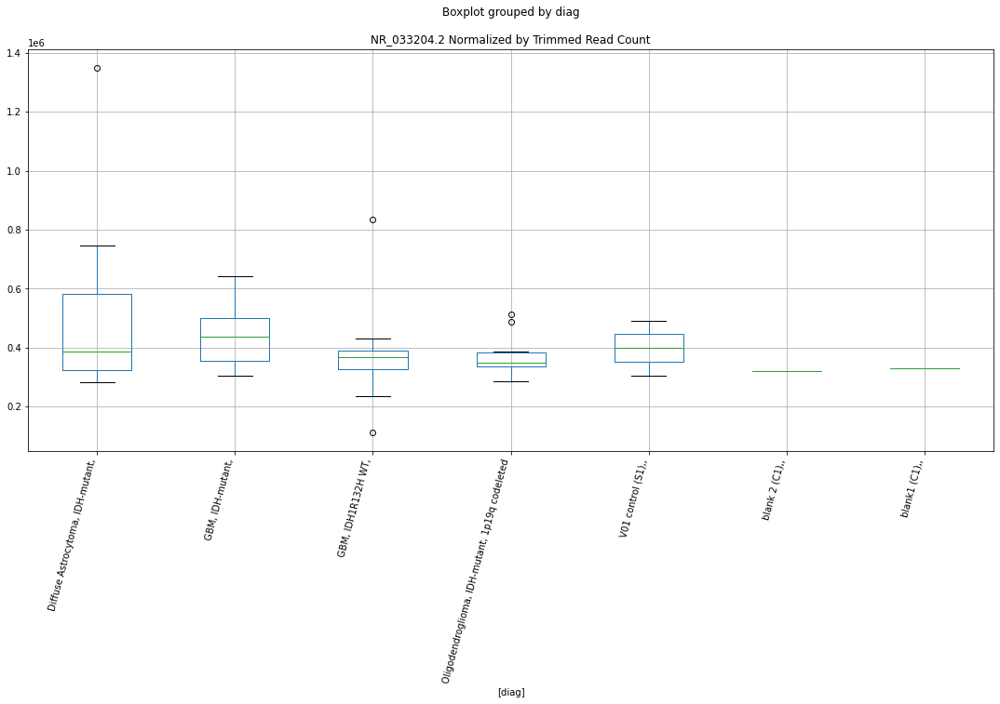

NR_039980.1 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9842085029920449
	p = 0.06269358843318827
NR_039980.1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.9842085029920449
	p = 0.06269358843318827
NR_039980.1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.9562017535708744
	p = 0.06614125101295236
NR_039980.1 D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9562017535708744
	p = 0.06614125101295236


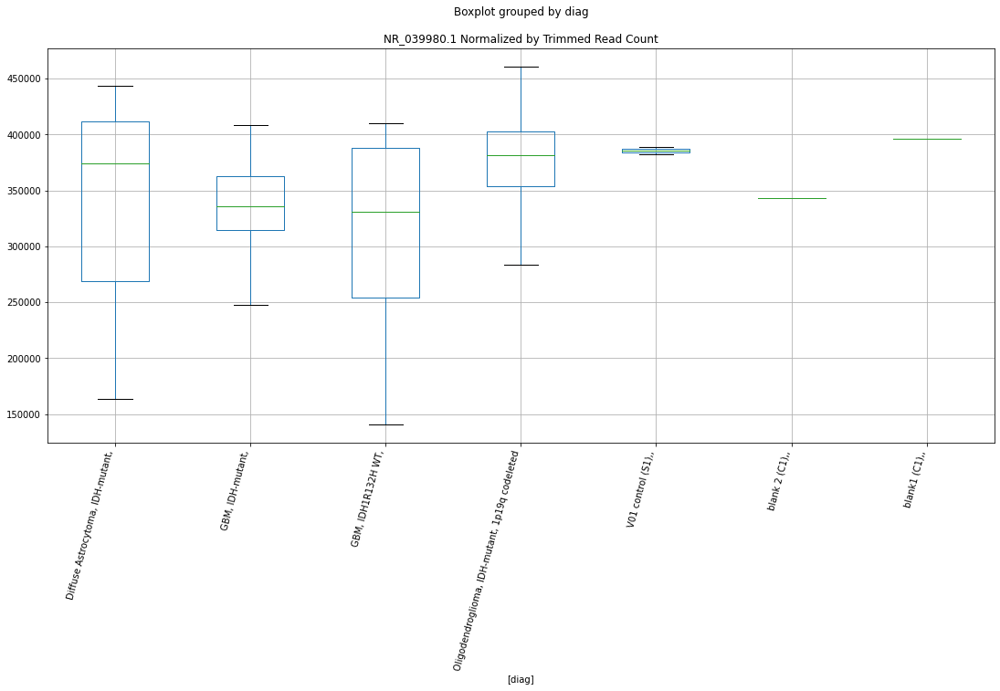

NR_039980.1 D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -3.1210349936990585
	p = 0.005901285432641022
NR_039980.1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 3.1210349936990585
	p = 0.005901285432641022
NR_039980.1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 2.113734000300966
	p = 0.04875905183416577
NR_039980.1 D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.113734000300966
	p = 0.04875905183416577


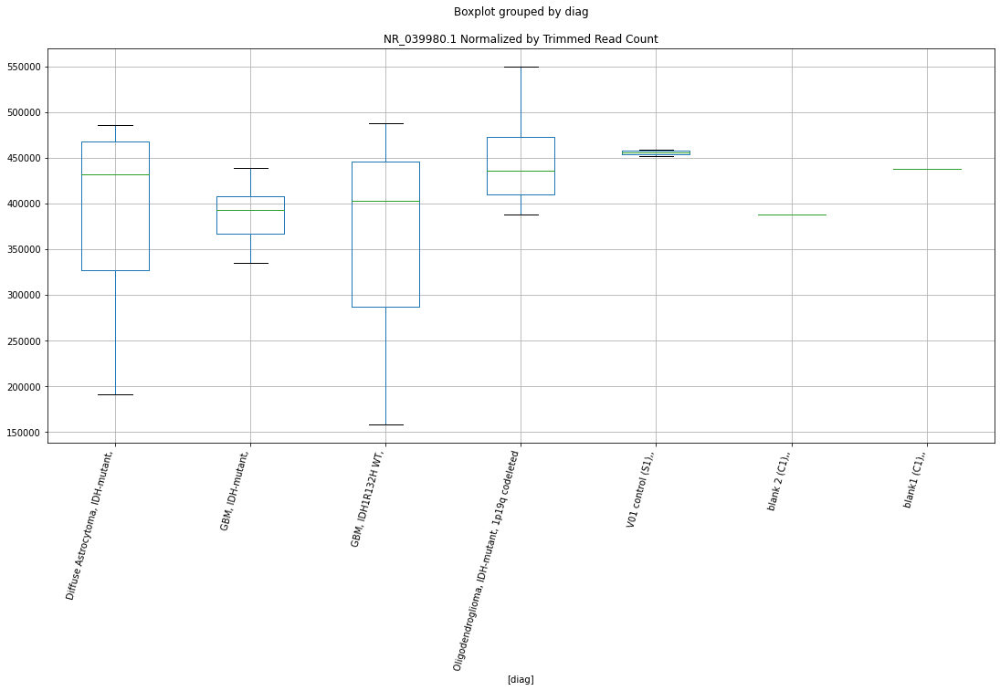

NR_039980.1 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.766648020057421
	p = 0.0942395367537373
NR_039980.1 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.766648020057421
	p = 0.0942395367537373


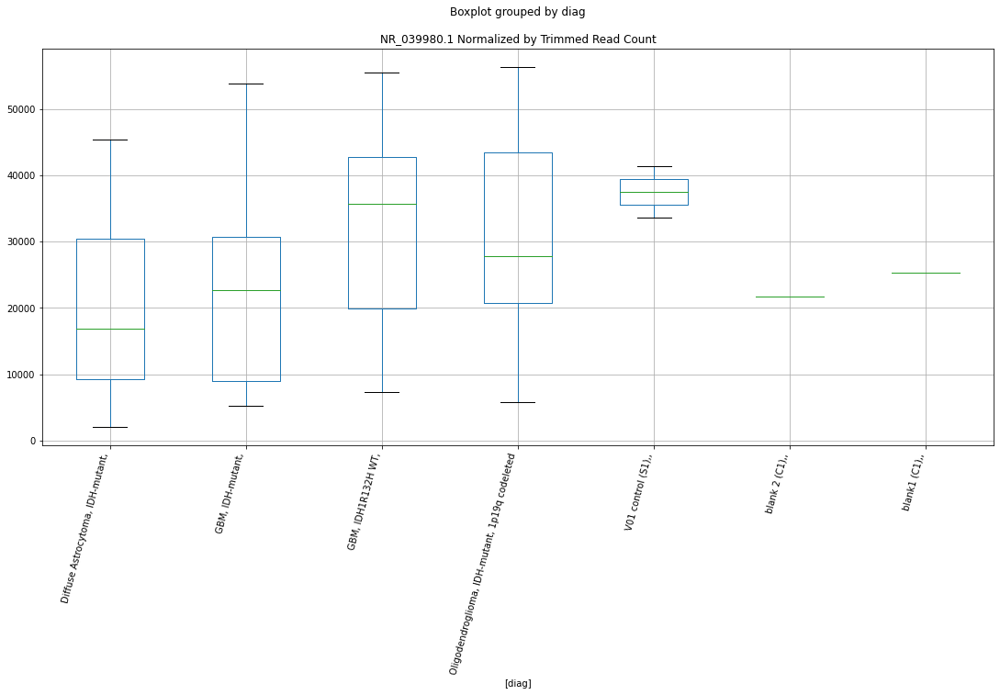

NR_039980.1 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9644463668061378
	p = 0.06510912906239652
NR_039980.1 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.178790638237795
	p = 0.042880143505528164
NR_039980.1 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9644463668061378
	p = 0.06510912906239652
NR_039980.1 D-plex cutadapt2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.178790638237795
	p = 0.042880143505528164


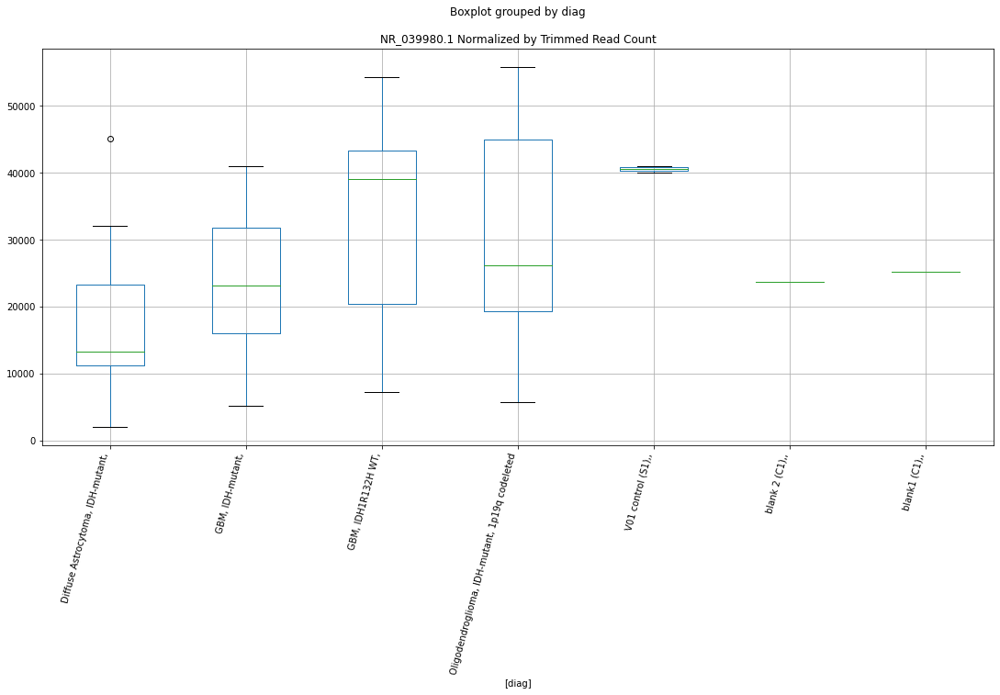

NR_146117.1 D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9085450986006889
	p = 0.0723984187659507
NR_146117.1 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 1.9085450986006889
	p = 0.0723984187659507
NR_146117.1 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0636494187899697
	p = 0.05377503002961623
NR_146117.1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.0636494187899697
	p = 0.05377503002961623


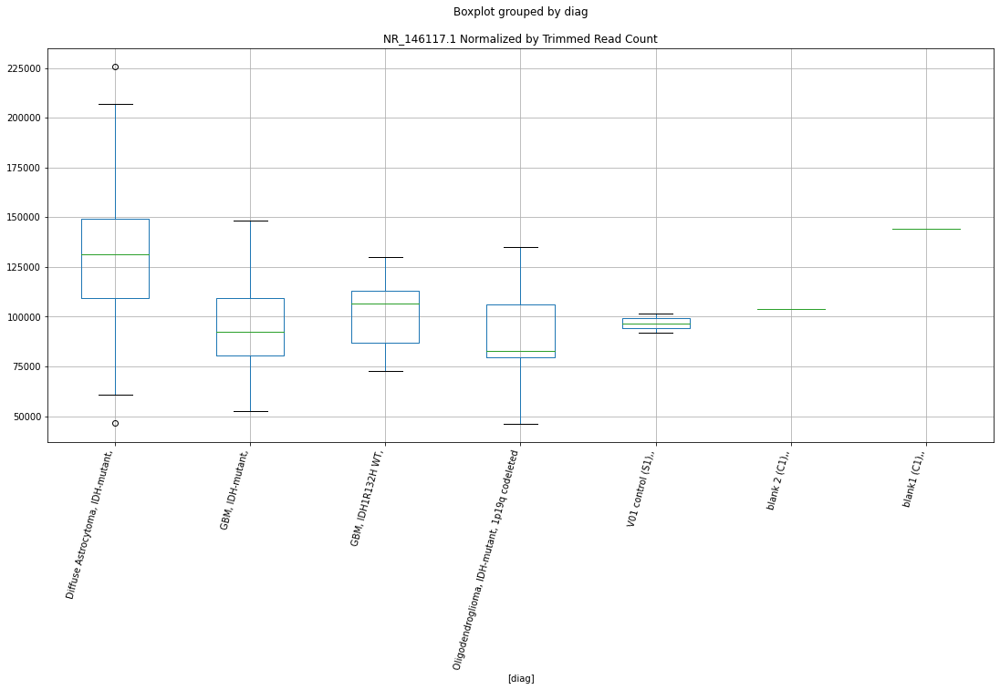

NR_146117.1 D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.923491645968031
	p = 0.07038155798809971
NR_146117.1 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = 1.923491645968031
	p = 0.07038155798809971
NR_146117.1 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.9694190345233462
	p = 0.06449359944783345
NR_146117.1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.9694190345233462
	p = 0.06449359944783345


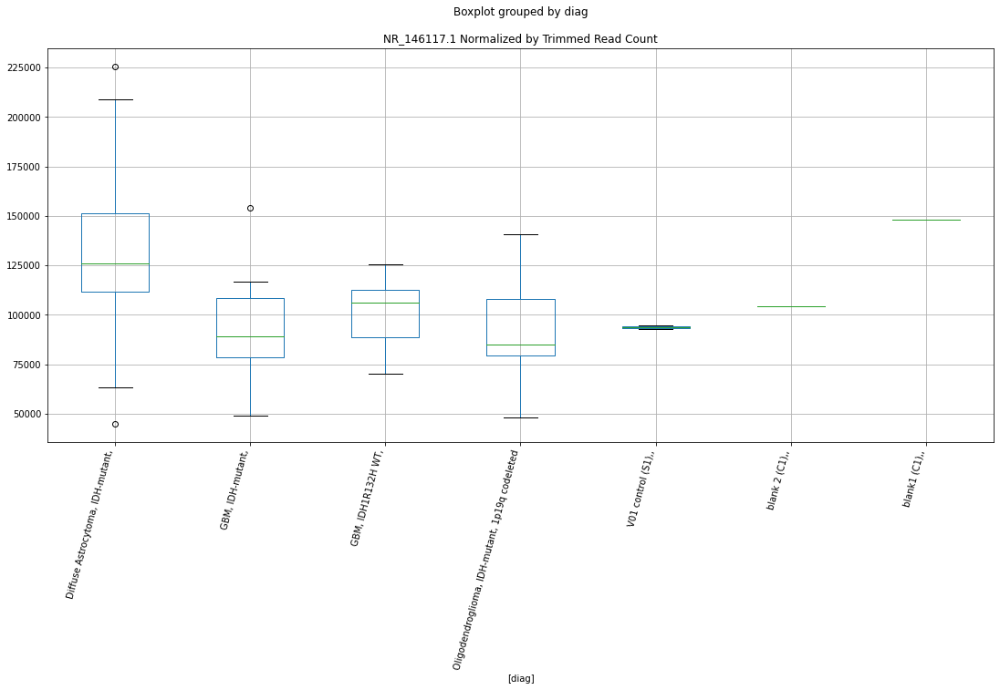

In [81]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in mrnas:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Trimmed Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


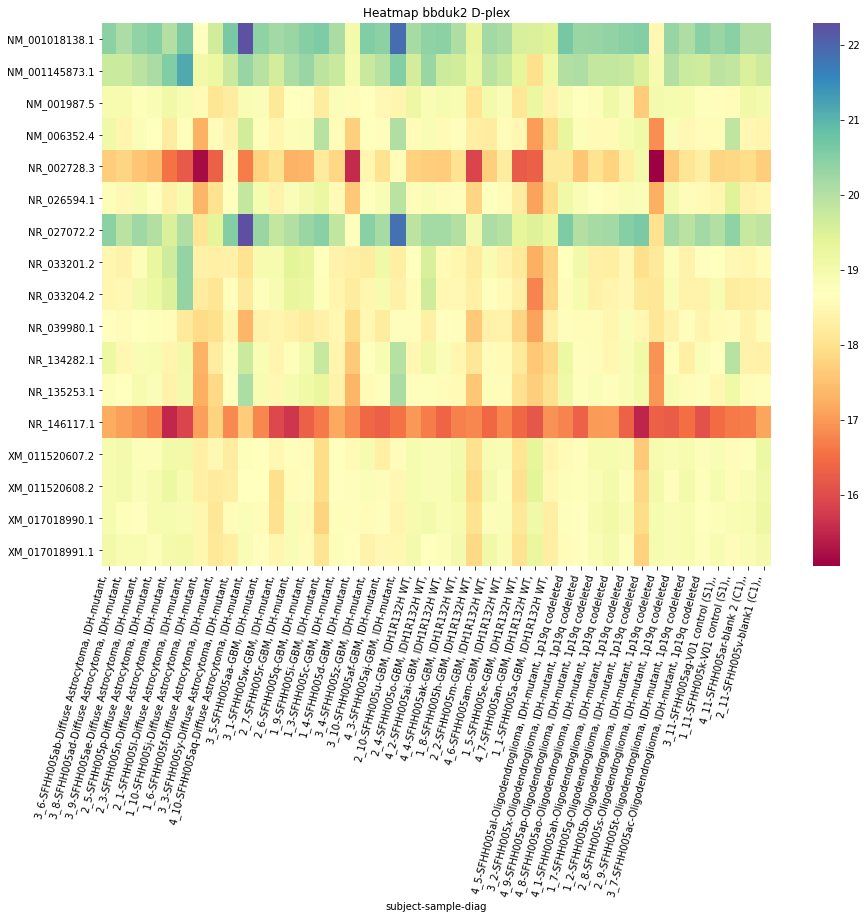

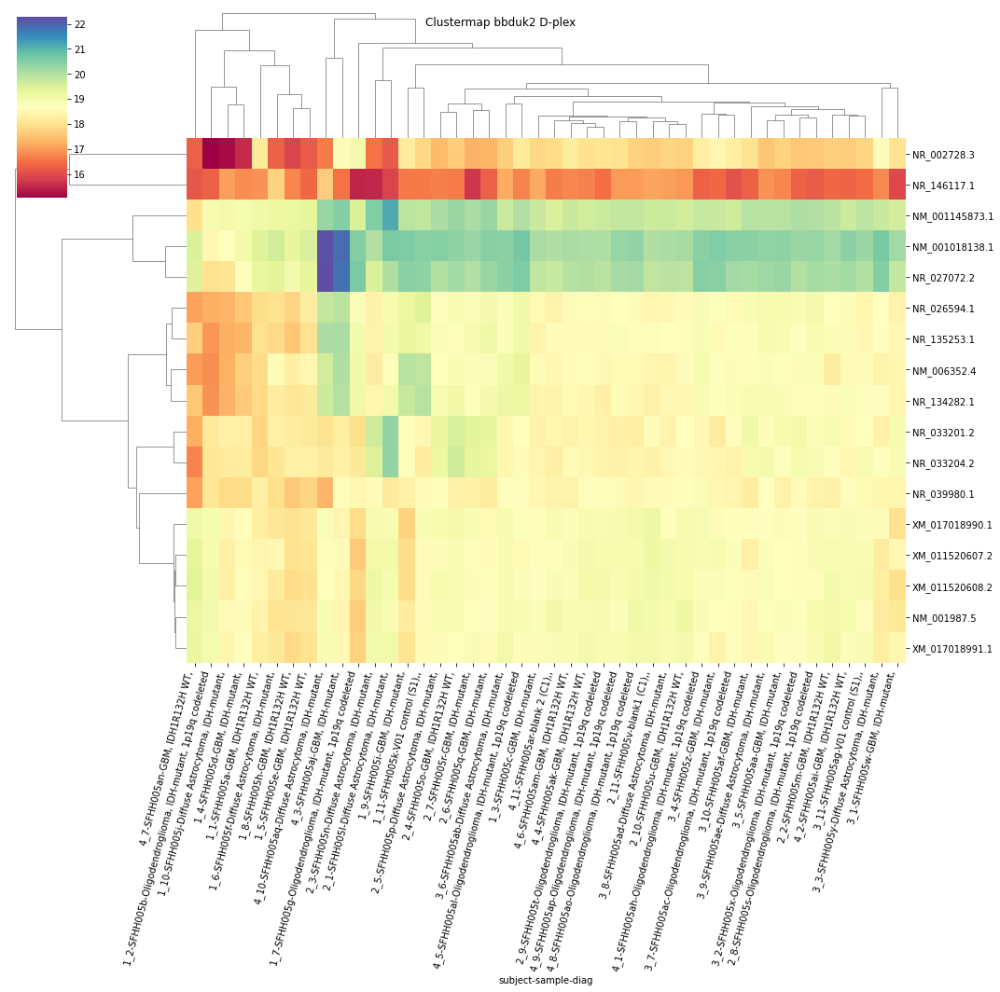

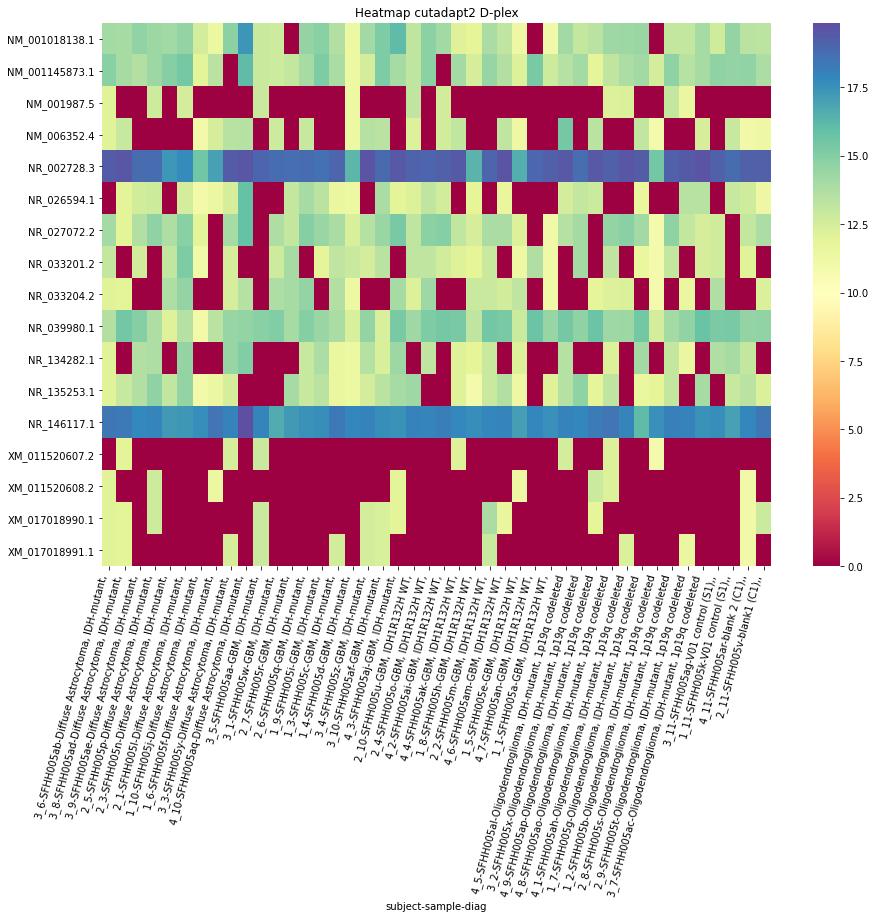

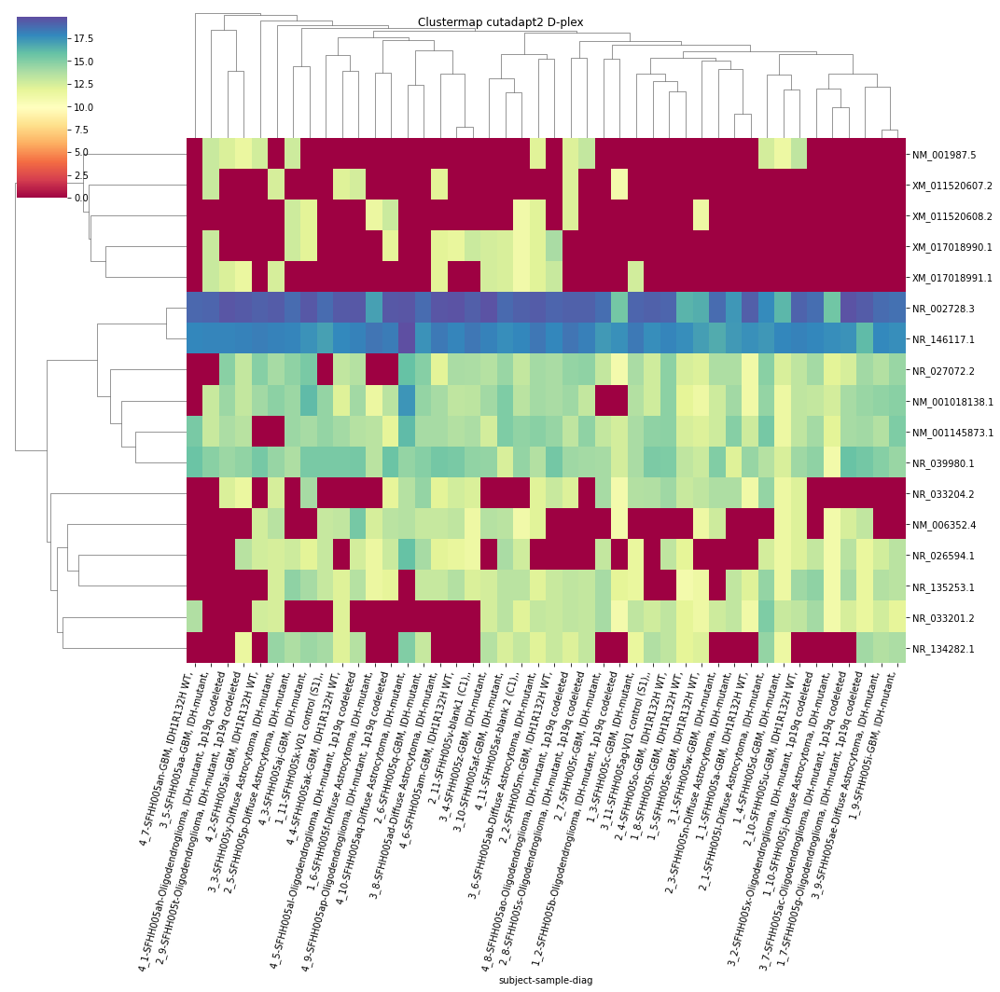

In [82]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

Hominidae D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7603788034472514
	p = 0.09532491341600327
Hominidae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7603788034472514
	p = 0.09532491341600327


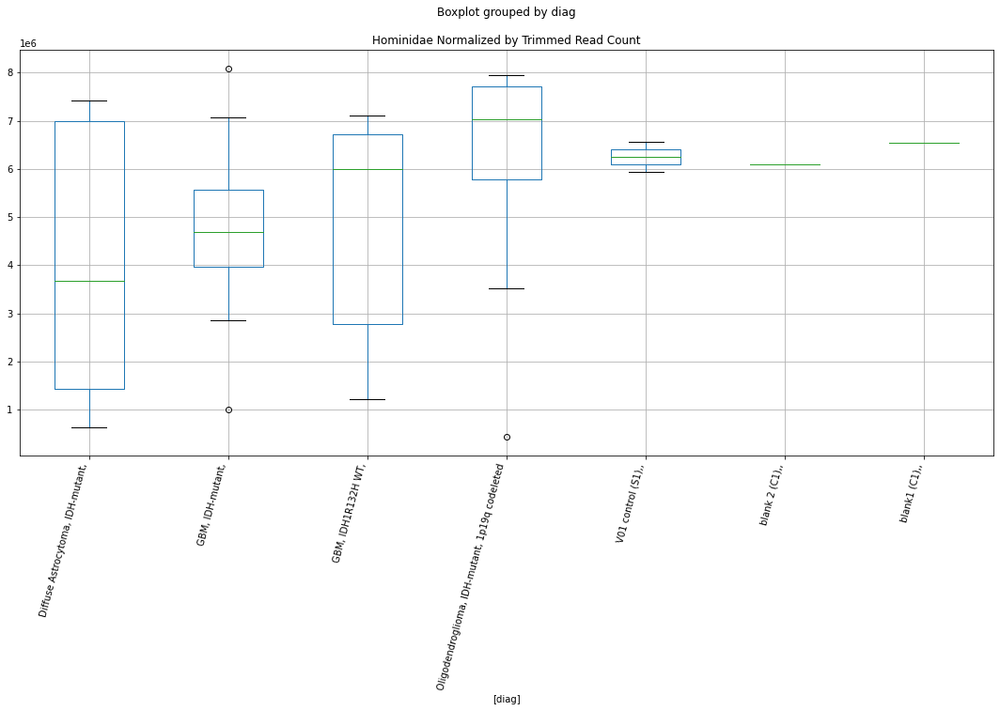

Hominidae D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7583336240629326
	p = 0.09568133231112974
Hominidae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7583336240629326
	p = 0.09568133231112974


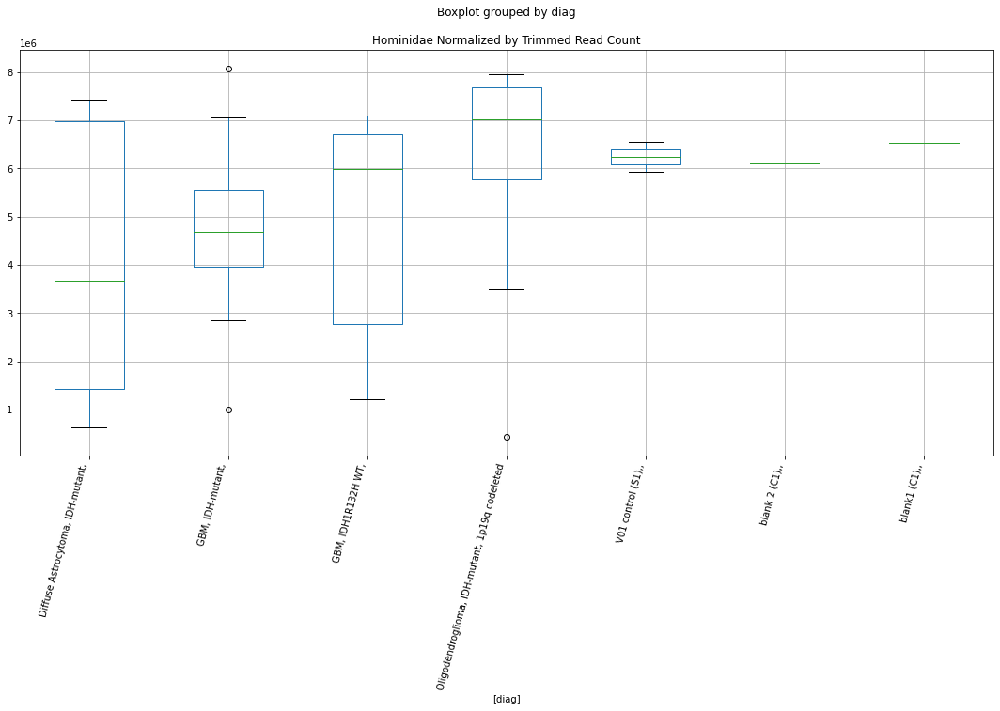

Cercopithecidae D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7351587772585078
	p = 0.09980154815097537
Cercopithecidae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7351587772585078
	p = 0.09980154815097537


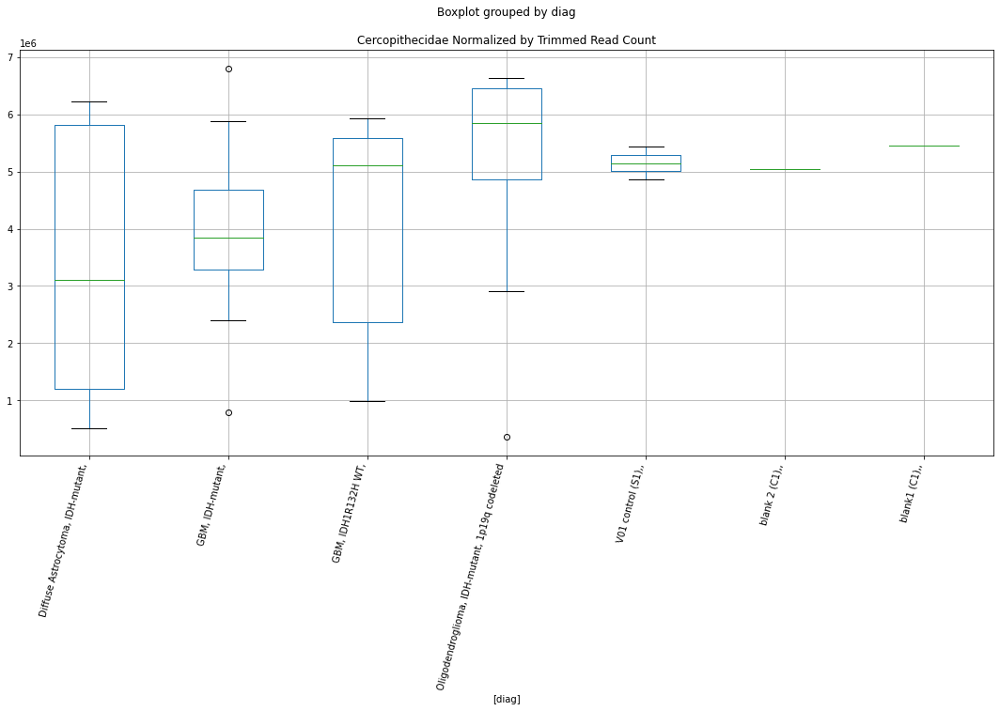

Alcaligenaceae D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.2321111943427905
	p = 0.038554064138040564
Alcaligenaceae D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.2321111943427905
	p = 0.038554064138040564


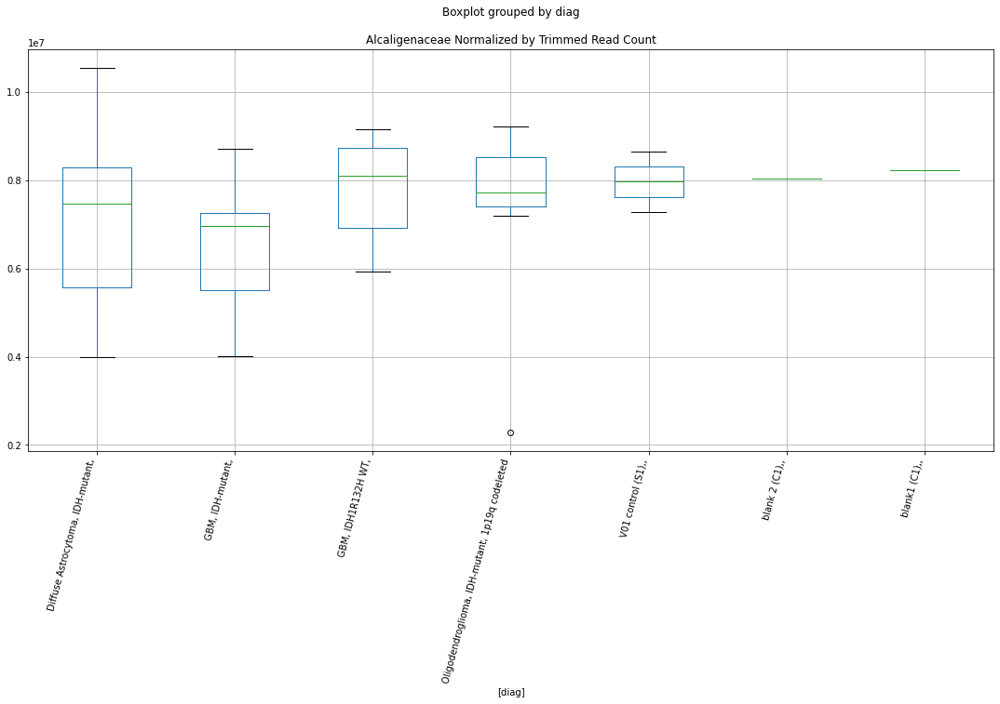

Alcaligenaceae D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7417758539569437
	p = 0.09860972537786424
Alcaligenaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.7417758539569437
	p = 0.09860972537786424


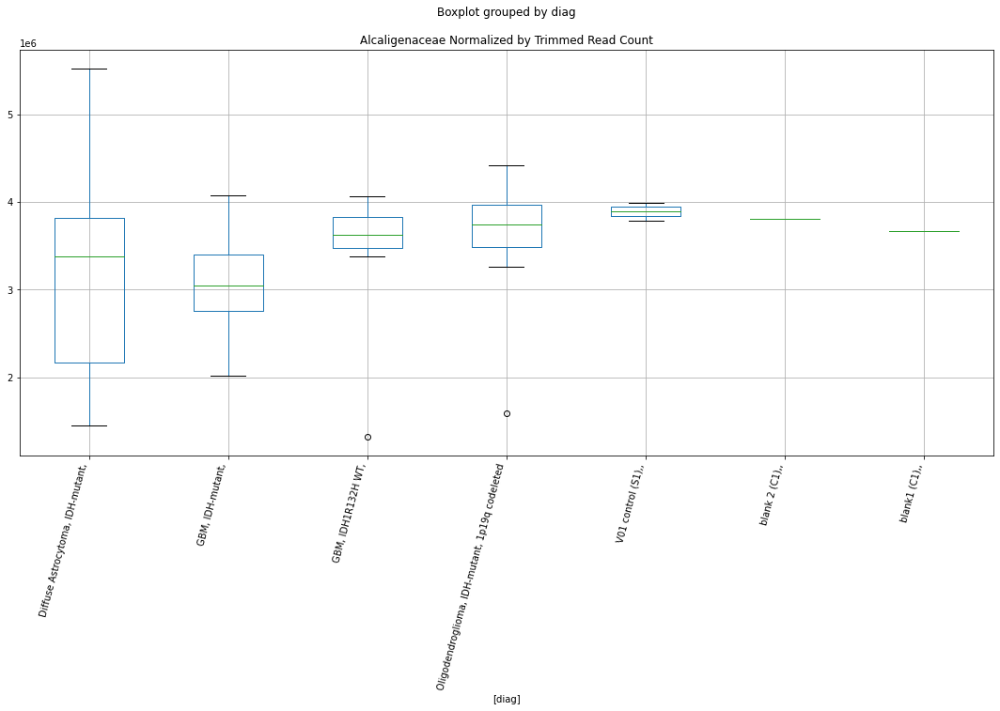

Alcaligenaceae D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.926637988492928
	p = 0.06996341747605728
Alcaligenaceae D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.926637988492928
	p = 0.06996341747605728


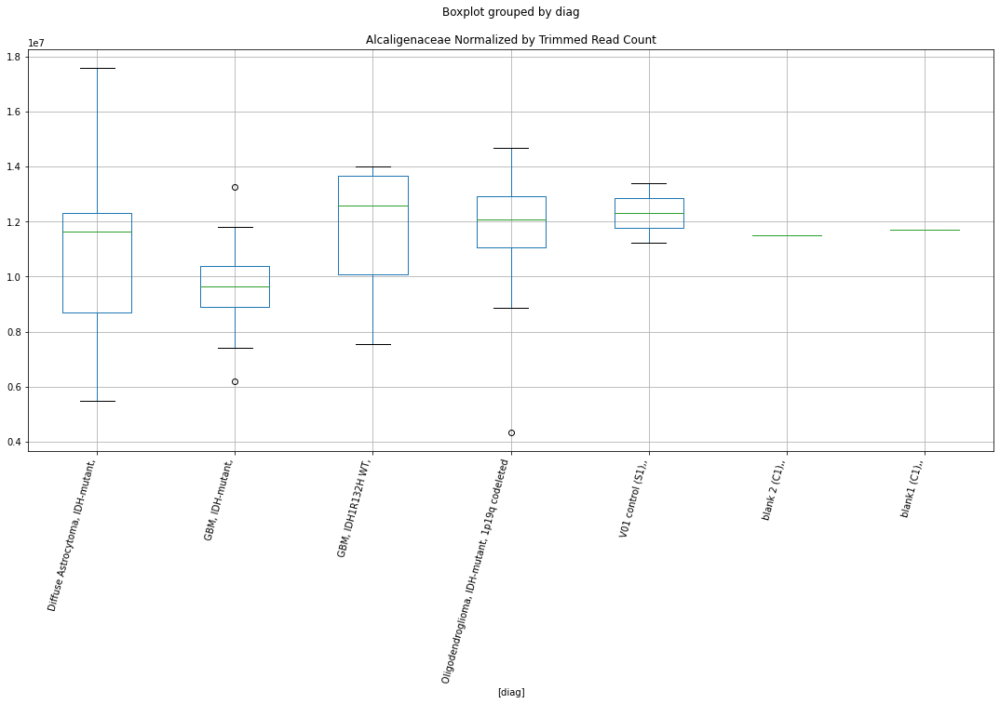

Alcaligenaceae D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.9161858318677631
	p = 0.07136106550638295
Alcaligenaceae D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.9161858318677631
	p = 0.07136106550638295


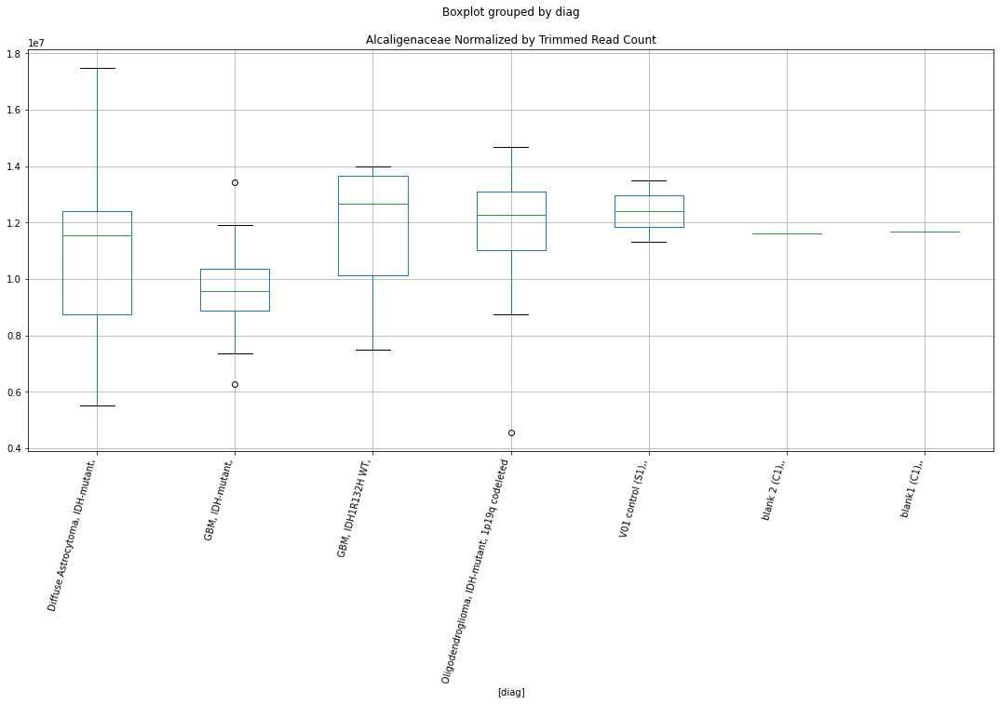

Alcaligenaceae D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.9338661673652007
	p = 0.06901117541000923
Alcaligenaceae D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.9338661673652007
	p = 0.06901117541000923


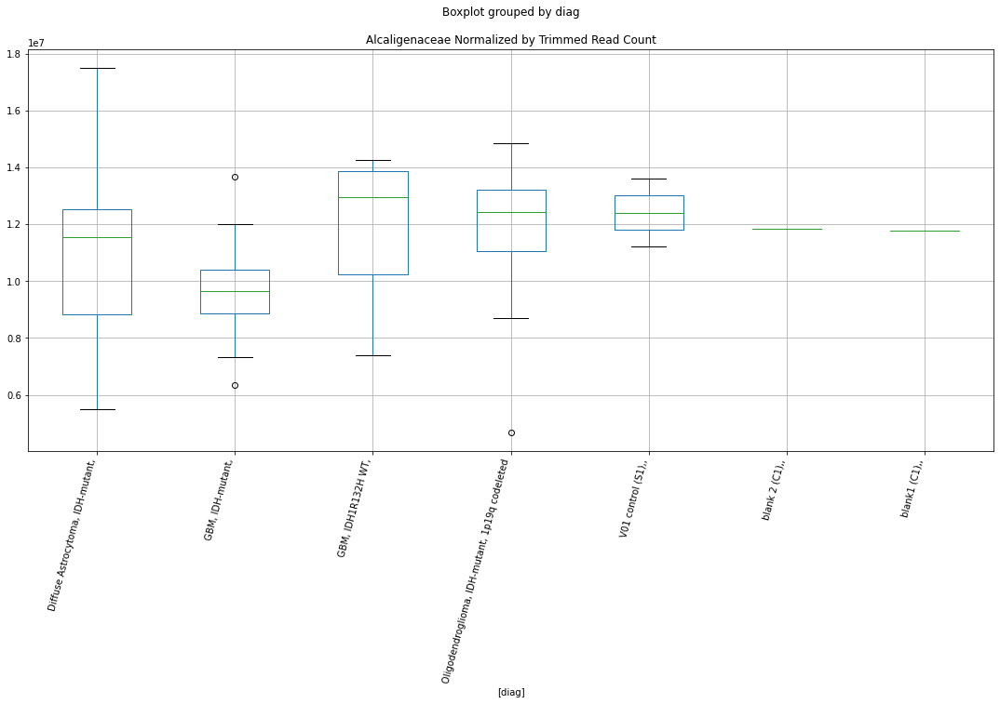

Fabaceae D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.0821533910497467
	p = 0.05186976771525399
Fabaceae D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.0821533910497467
	p = 0.05186976771525399


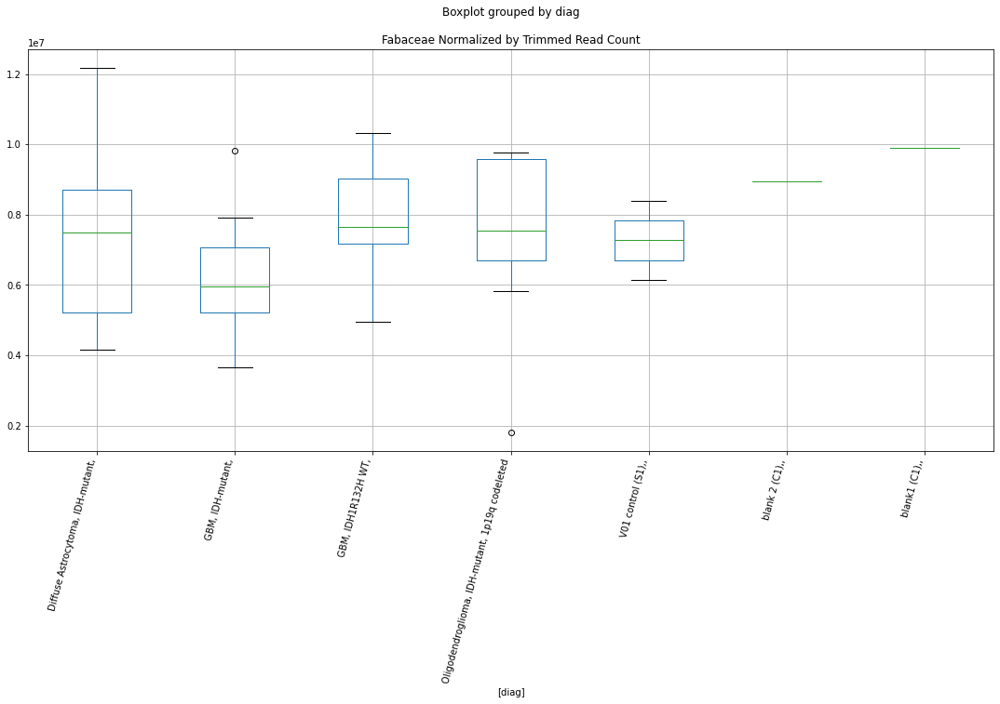

Fabaceae D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.0443369041074813
	p = 0.05583089284327381
Fabaceae D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.0443369041074813
	p = 0.05583089284327381


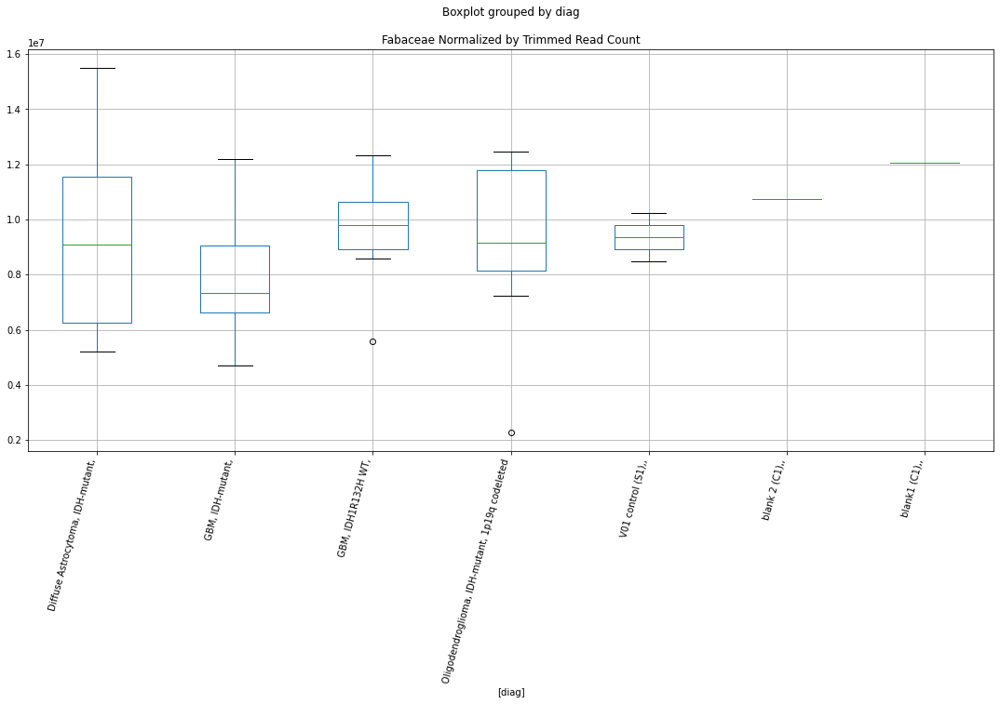

Fabaceae D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.017697852444339
	p = 0.058783148379966045
Fabaceae D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.017697852444339
	p = 0.058783148379966045


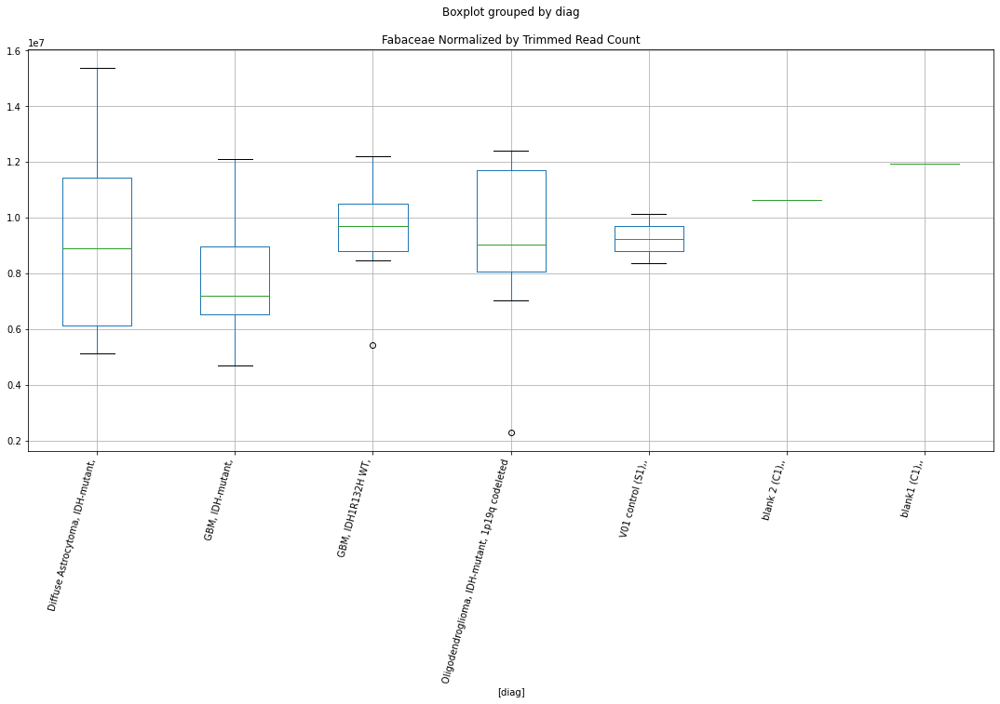

Fabaceae D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.029809464235838
	p = 0.0574238729050241
Fabaceae D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.029809464235838
	p = 0.0574238729050241


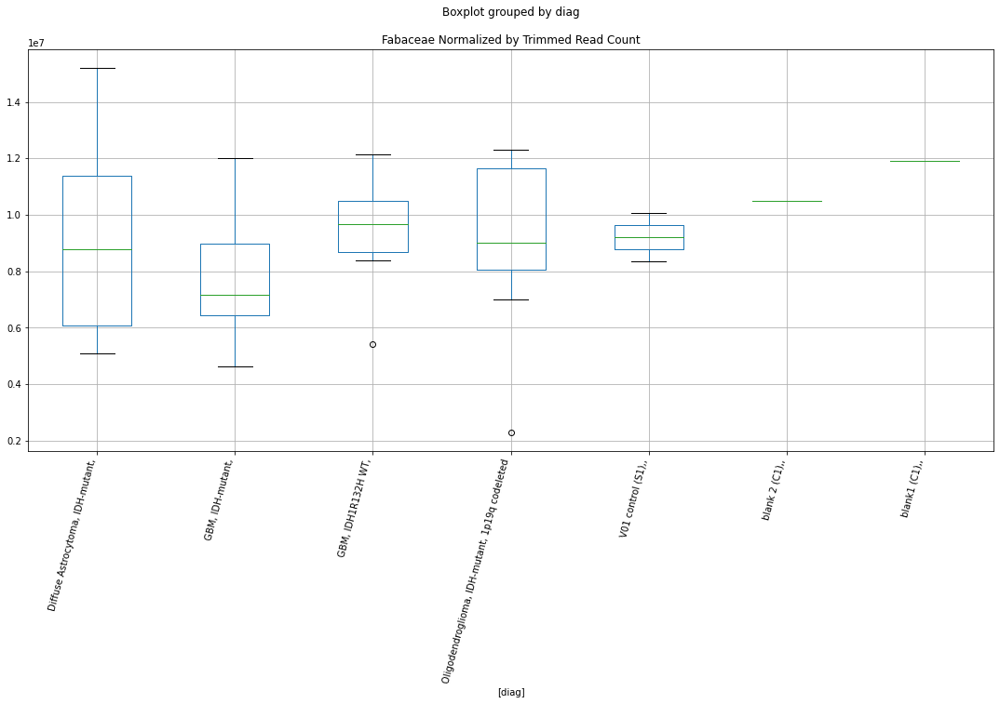

Bacillaceae D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7977648753942508
	p = 0.08901001904412041
Bacillaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7977648753942508
	p = 0.08901001904412041


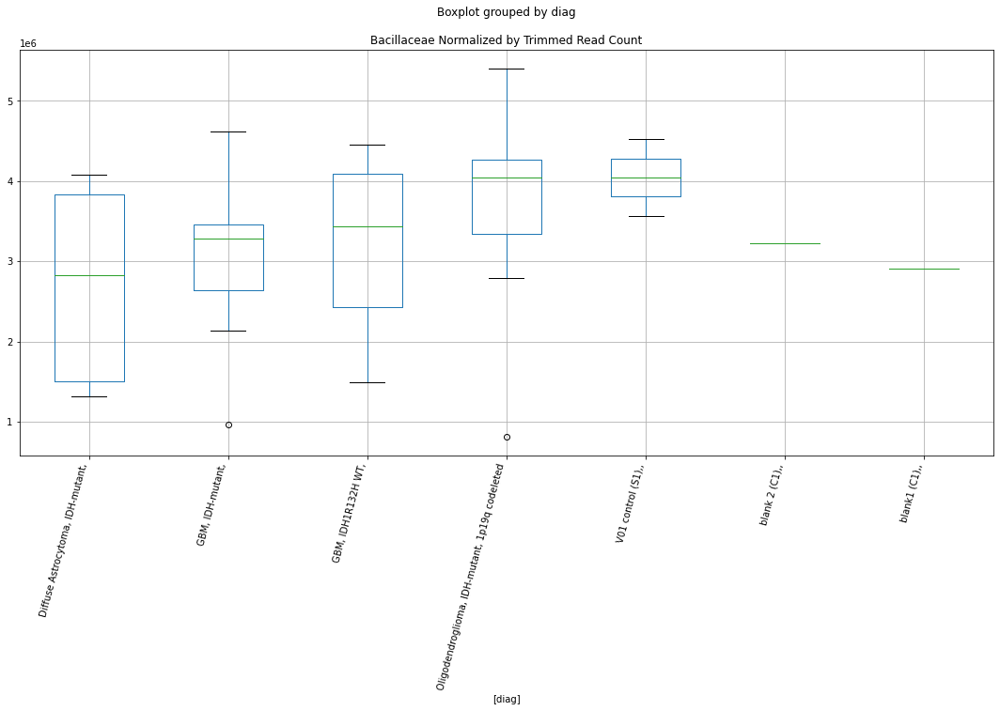

Bacillaceae D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.789882410192714
	p = 0.09031021967608151
Bacillaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.789882410192714
	p = 0.09031021967608151


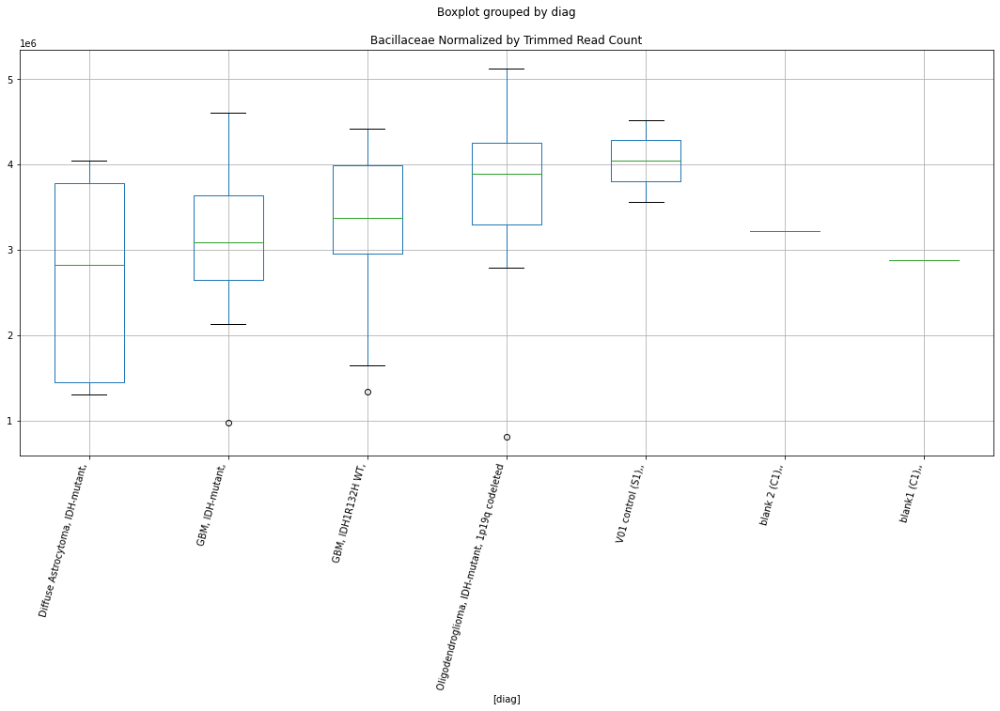

Staphylococcaceae D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7473239460926346
	p = 0.09761995838522373
Staphylococcaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7473239460926346
	p = 0.09761995838522373


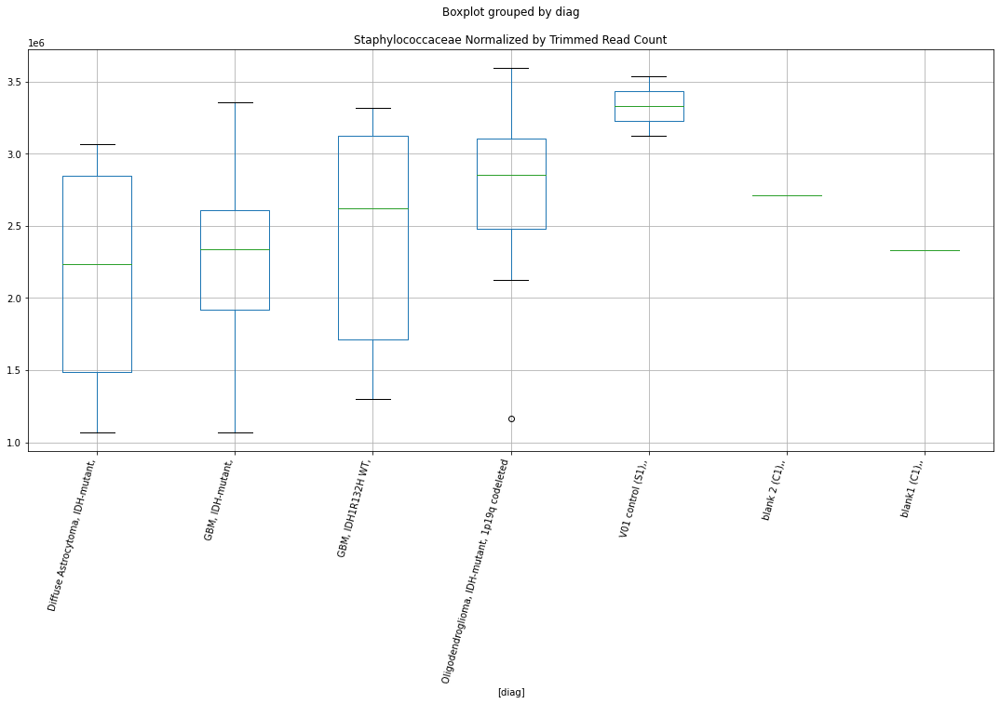

Staphylococcaceae D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.752149621450018
	p = 0.09676608162799007
Staphylococcaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.752149621450018
	p = 0.09676608162799007


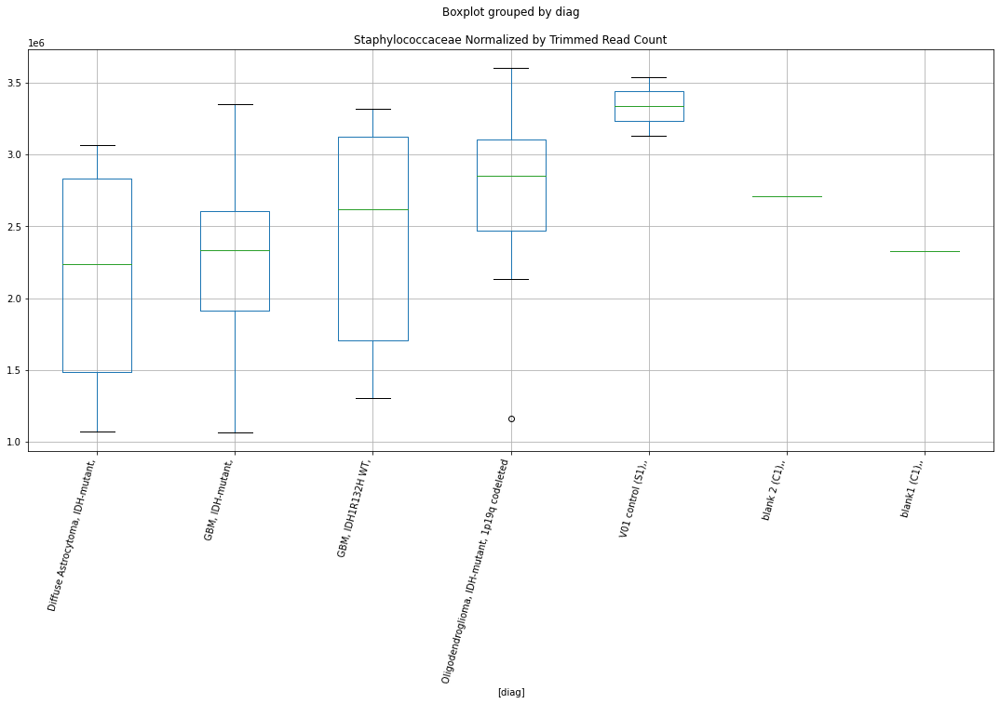

Moraxellaceae D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.17205993801643
	p = 0.04345680207196621
Moraxellaceae D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.17205993801643
	p = 0.04345680207196621


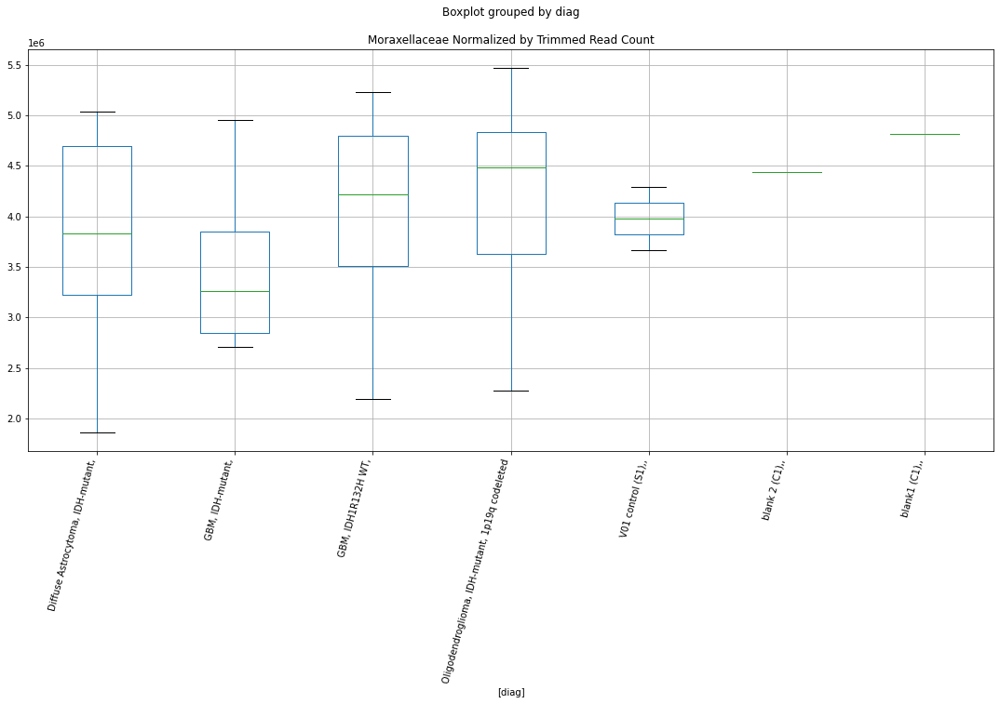

Moraxellaceae D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.6466625934787658
	p = 0.016404154650248616
Moraxellaceae D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9817624432158112
	p = 0.06298815308371761
Moraxellaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.6466625934787658
	p = 0.016404154650248616
Moraxellaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9817624432158112
	p = 0.06298815308371761


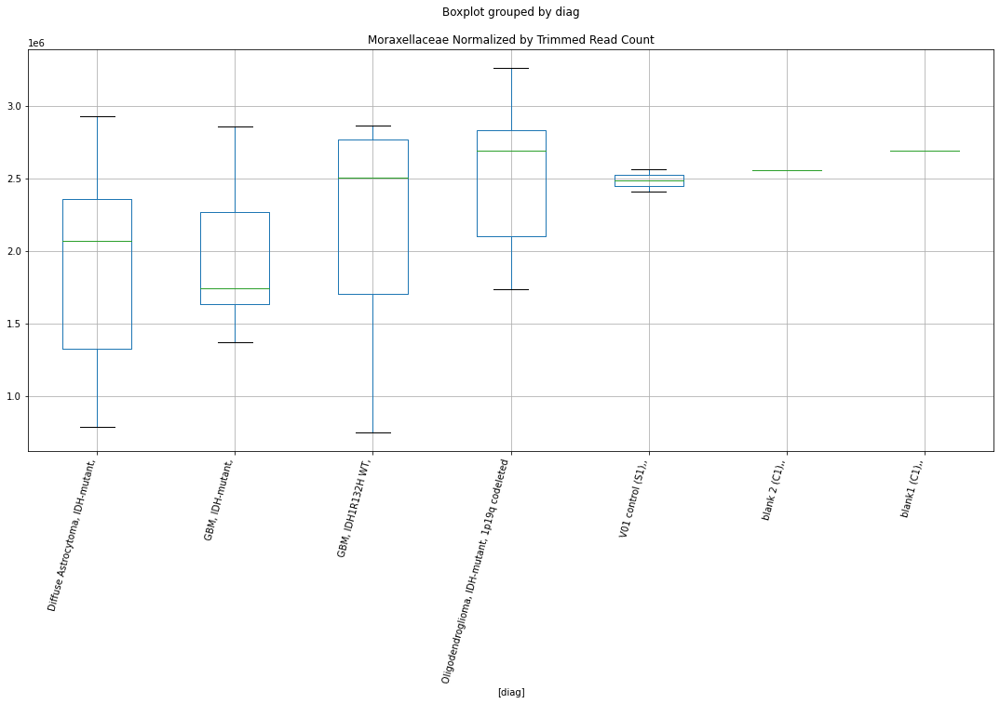

Moraxellaceae D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.6420720899835843
	p = 0.016563977979170835
Moraxellaceae D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9655646784085972
	p = 0.06497024539456357
Moraxellaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.6420720899835843
	p = 0.016563977979170835
Moraxellaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9655646784085972
	p = 0.06497024539456357


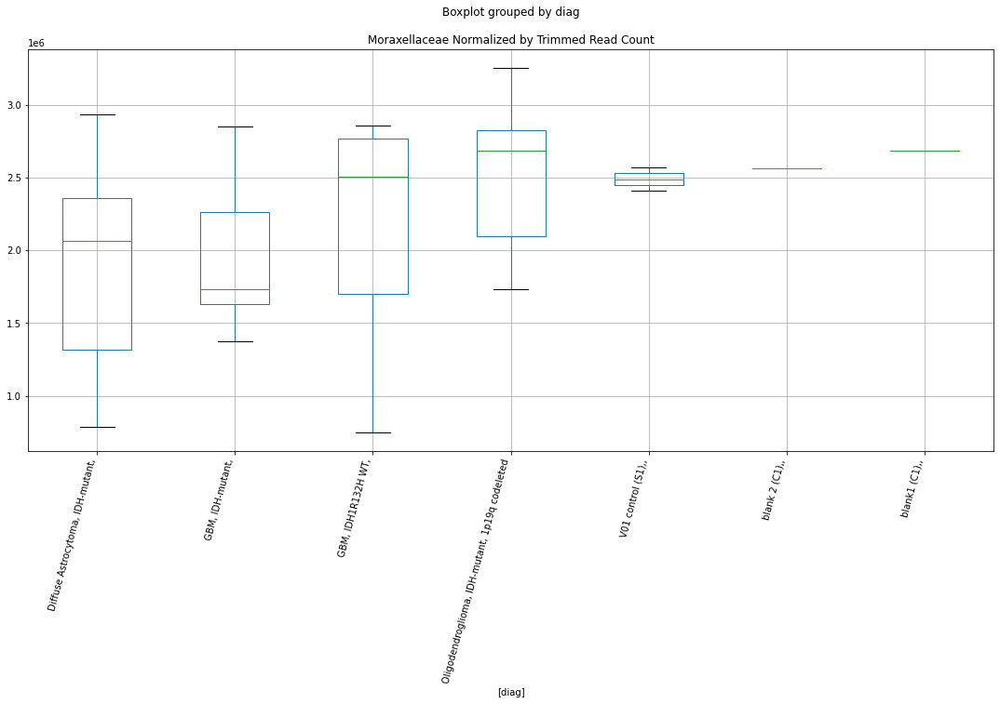

Moraxellaceae D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.868048134665685
	p = 0.07812295396249687
Moraxellaceae D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.868048134665685
	p = 0.07812295396249687


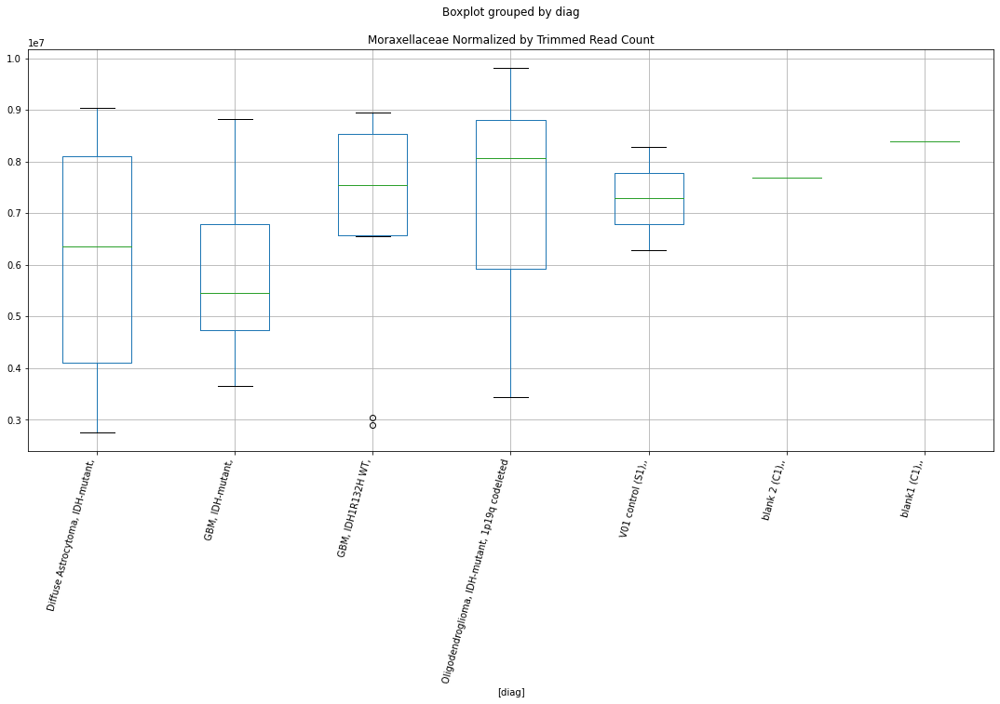

Moraxellaceae D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8414484909802222
	p = 0.08209715467045715
Moraxellaceae D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8414484909802222
	p = 0.08209715467045715


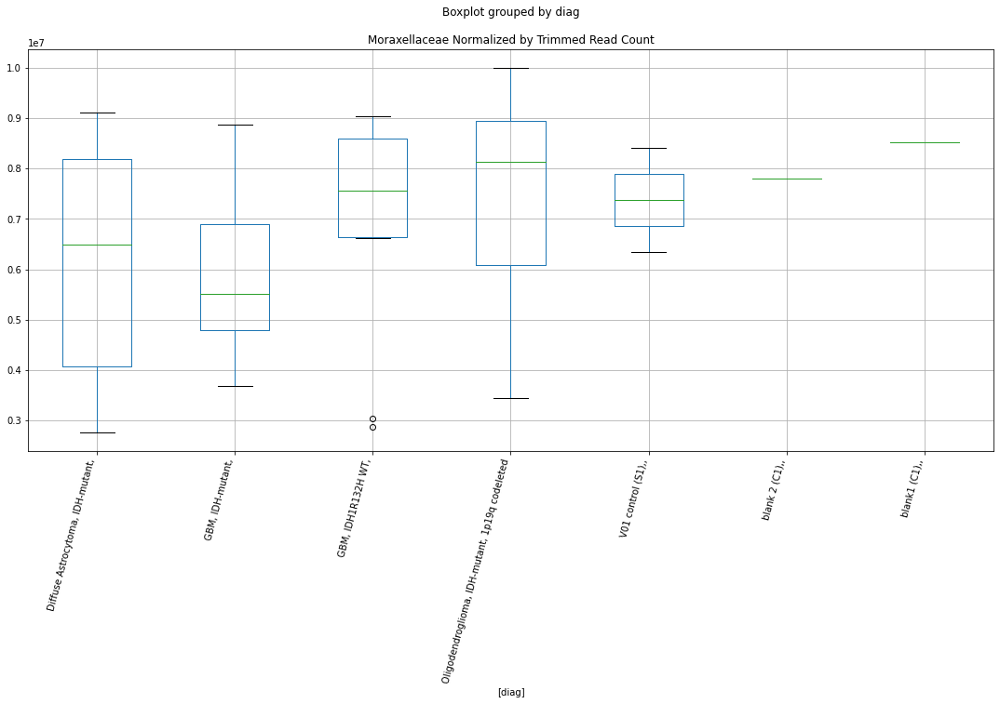

Moraxellaceae D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7857467933561353
	p = 0.09099898951368404
Moraxellaceae D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.7857467933561353
	p = 0.09099898951368404


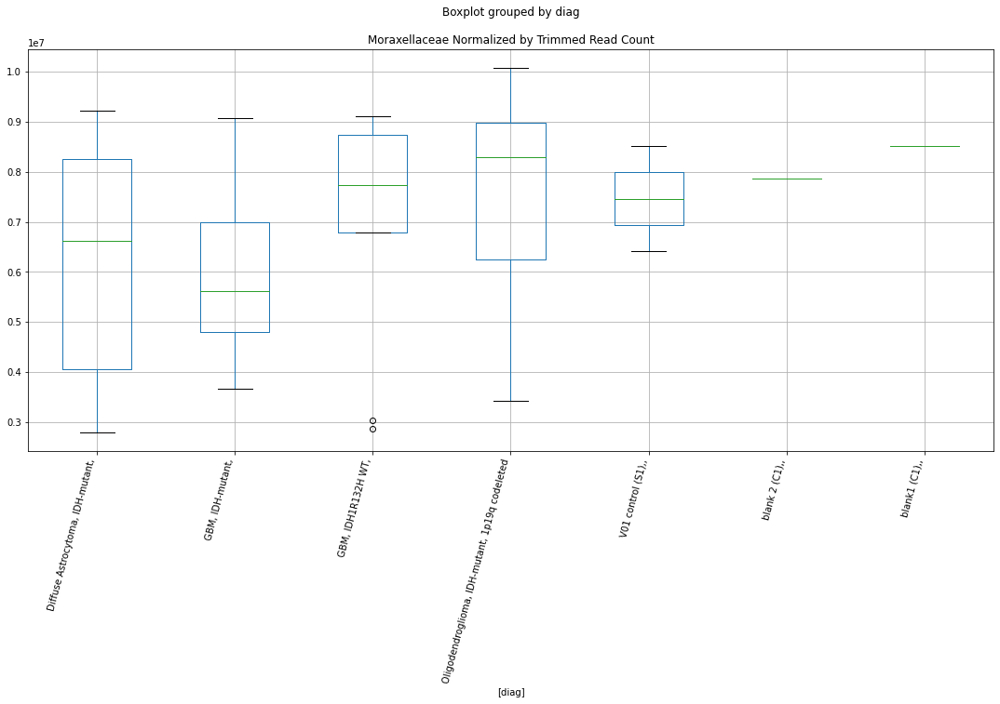

Enterococcaceae D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8174767347641763
	p = 0.08582994794950158
Enterococcaceae D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0041241563046572
	p = 0.06034087745298833
Enterococcaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8174767347641763
	p = 0.08582994794950158
Enterococcaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0041241563046572
	p = 0.06034087745298833


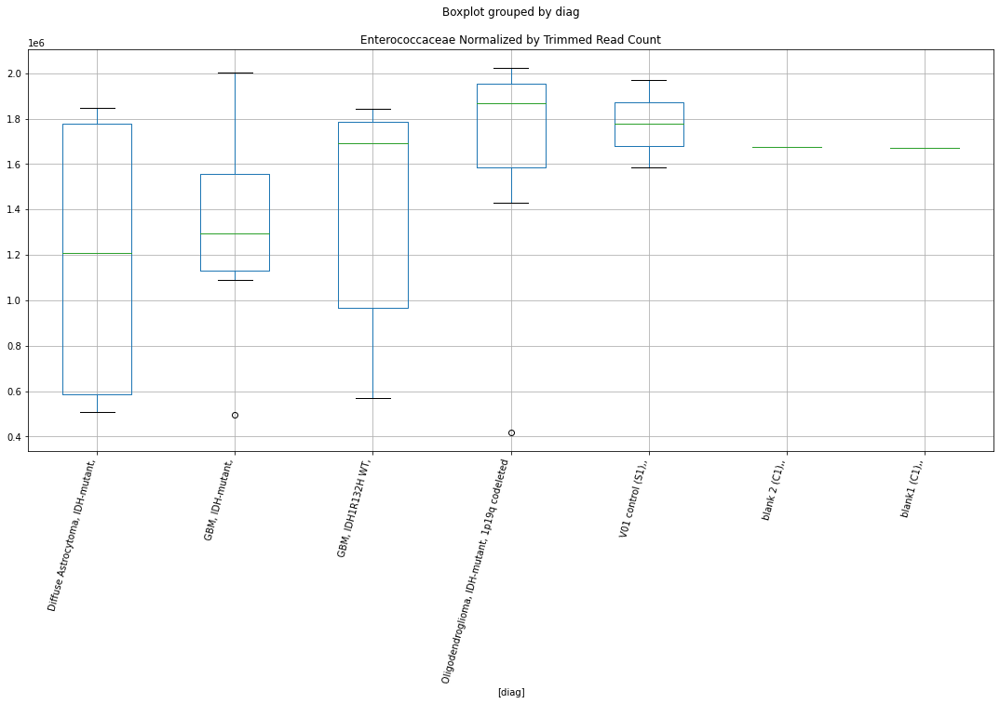

Enterococcaceae D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8210390074860265
	p = 0.08526599460422374
Enterococcaceae D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0028477847284067
	p = 0.06048924720796061
Enterococcaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8210390074860265
	p = 0.08526599460422374
Enterococcaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0028477847284067
	p = 0.06048924720796061


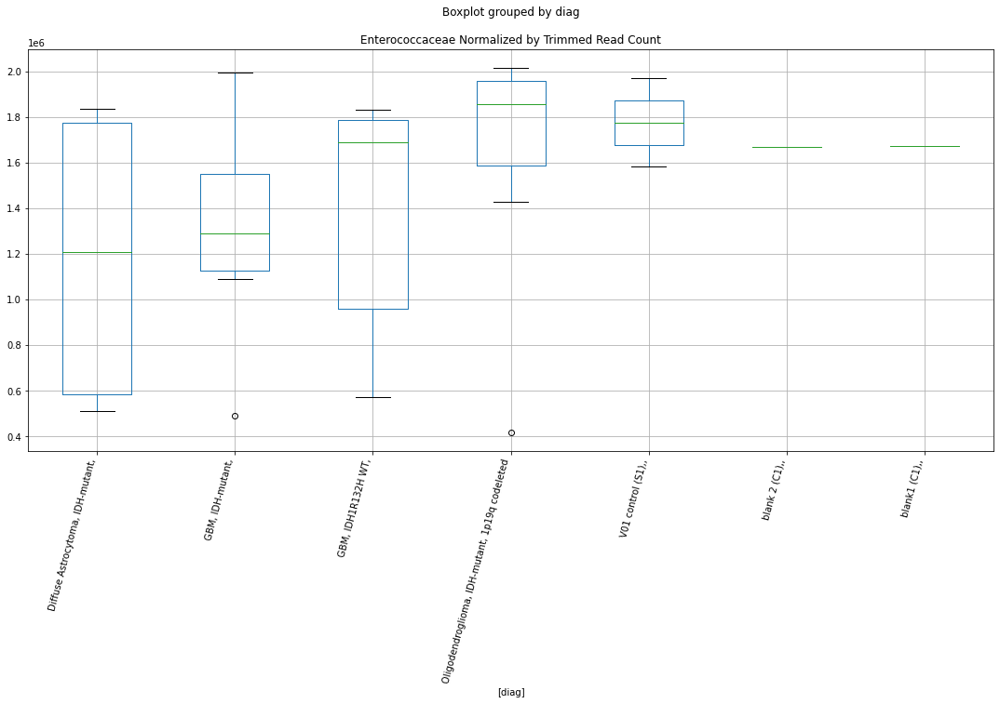

Comamonadaceae D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7584863046528012
	p = 0.09565468434471666
Comamonadaceae D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.8861957912268992
	p = 0.0755099244765267
Comamonadaceae D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.7584863046528012
	p = 0.09565468434471666
Comamonadaceae D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.8861957912268992
	p = 0.0755099244765267


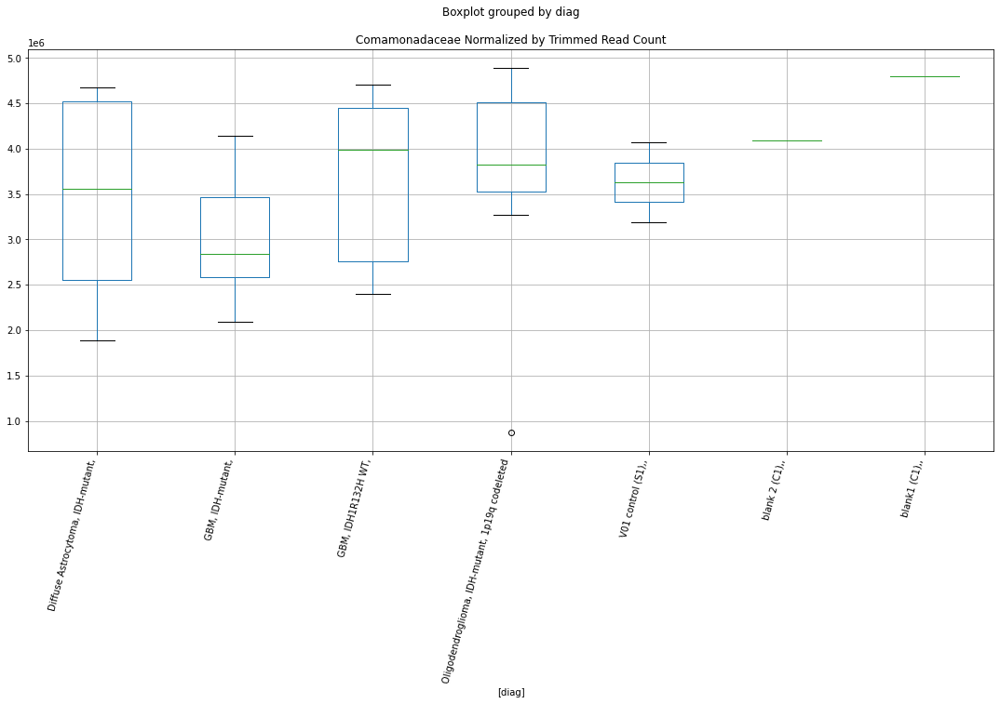

Comamonadaceae D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0309160735388425
	p = 0.057301102635194924
Comamonadaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.0309160735388425
	p = 0.057301102635194924


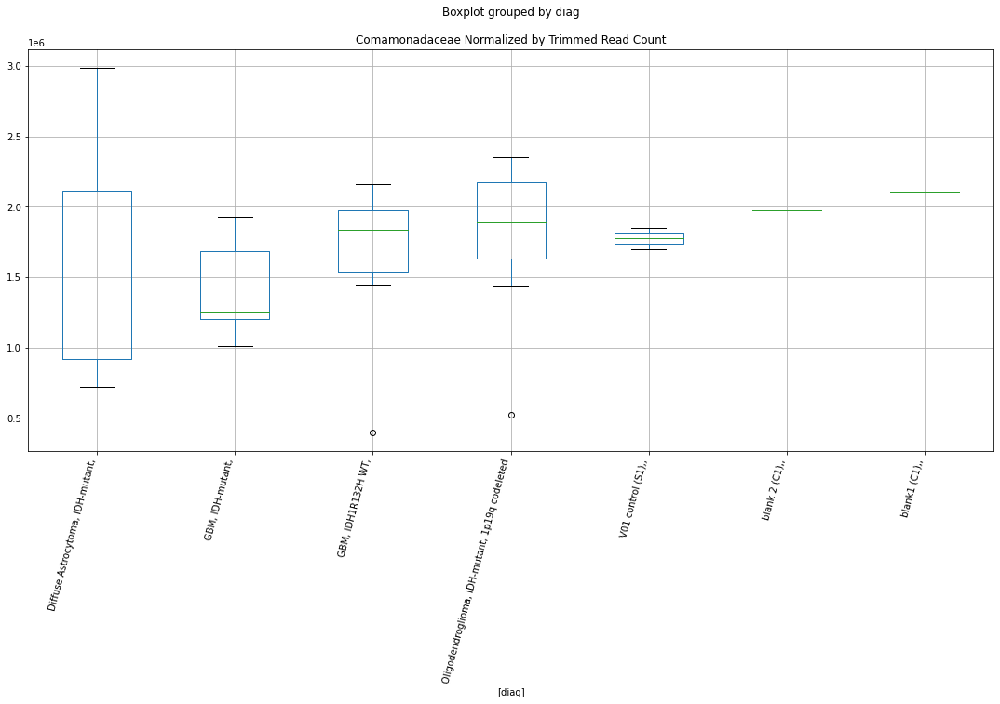

Comamonadaceae D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.014848255099501
	p = 0.05910713705838732
Comamonadaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.014848255099501
	p = 0.05910713705838732


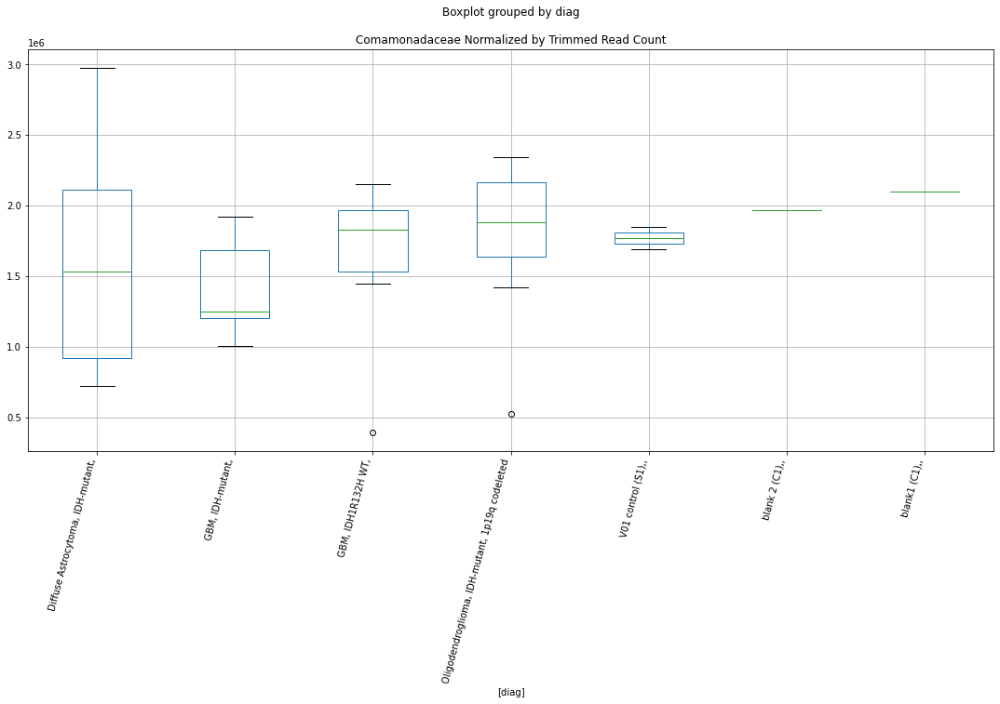

Comamonadaceae D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.7452493376067202
	p = 0.09798905162224668
Comamonadaceae D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.7452493376067202
	p = 0.09798905162224668


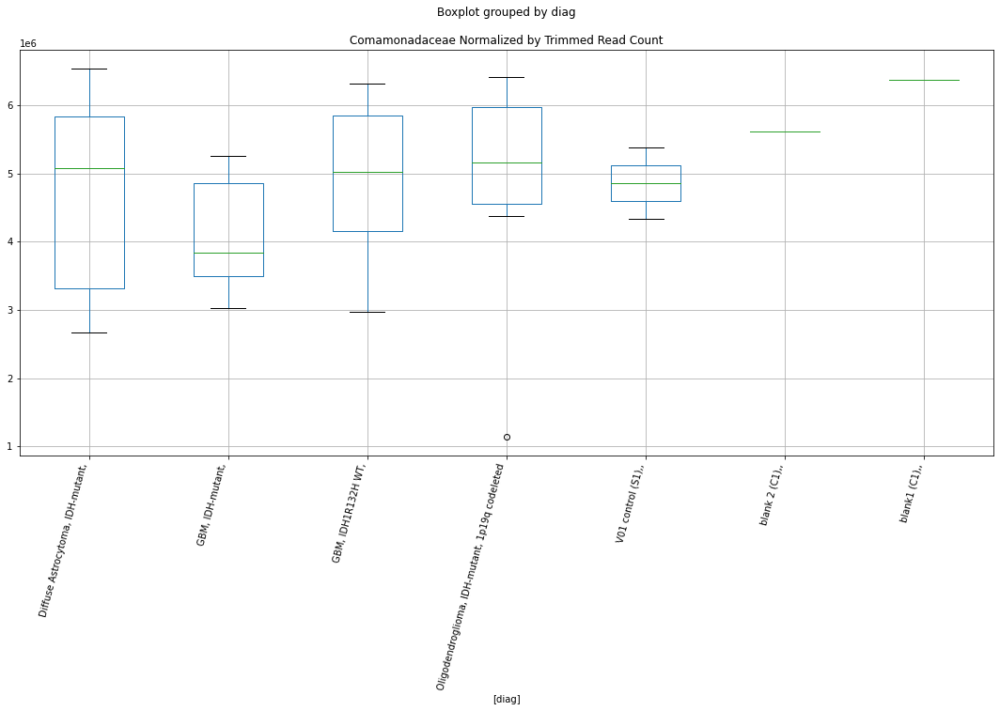

Comamonadaceae D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.7604153139944039
	p = 0.09531856111499705
Comamonadaceae D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.7604153139944039
	p = 0.09531856111499705


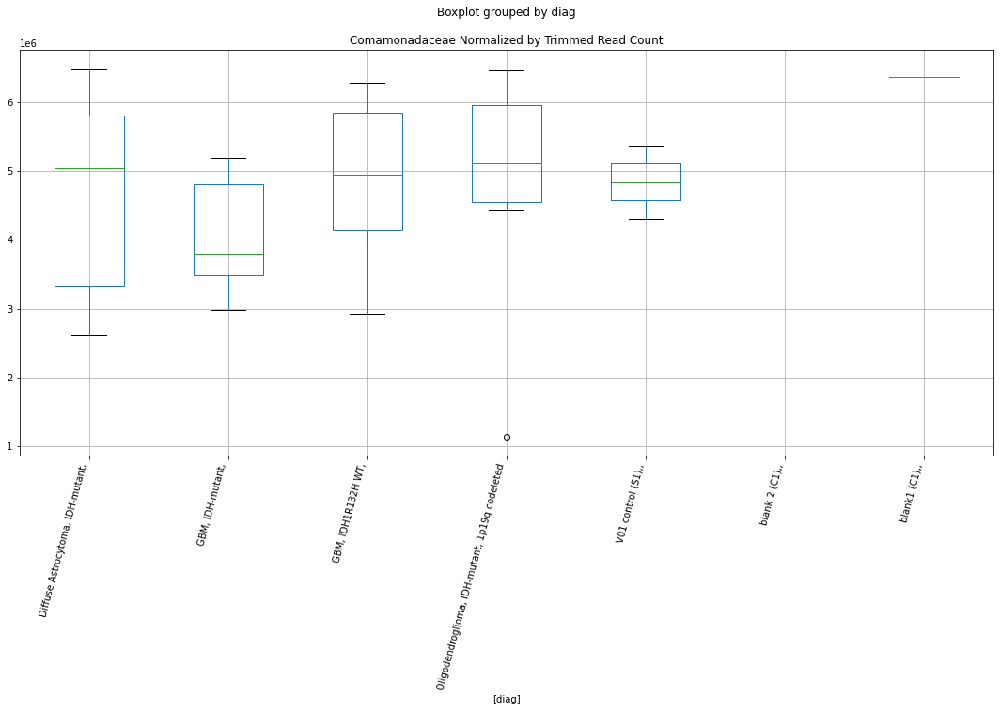

Mycobacteriaceae D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8926841765159639
	p = 0.0745946208935366
Mycobacteriaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8926841765159639
	p = 0.0745946208935366


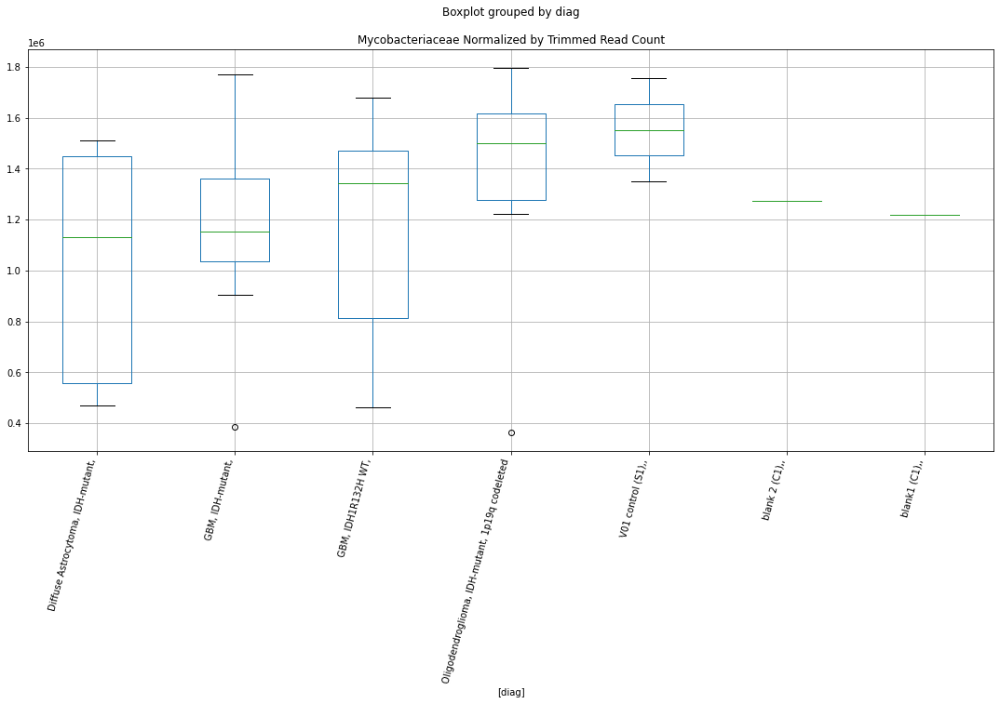

Mycobacteriaceae D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.882296173154405
	p = 0.07606480609283929
Mycobacteriaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.882296173154405
	p = 0.07606480609283929


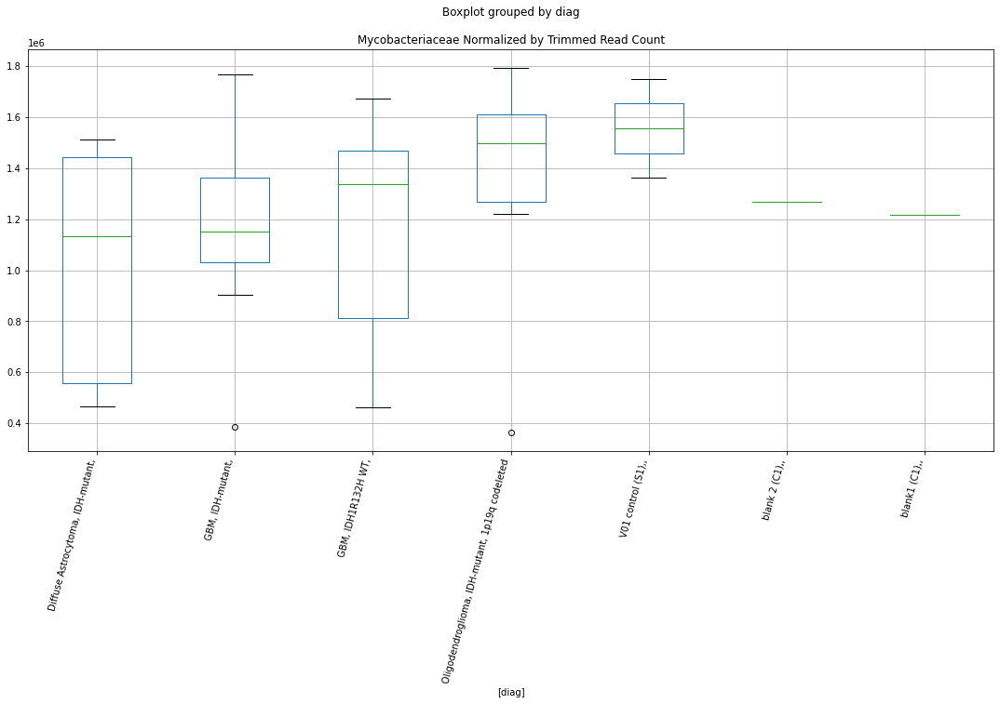

Onchocercidae D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.3141338035767647
	p = 0.03267886040695264
Onchocercidae D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.3141338035767647
	p = 0.03267886040695264


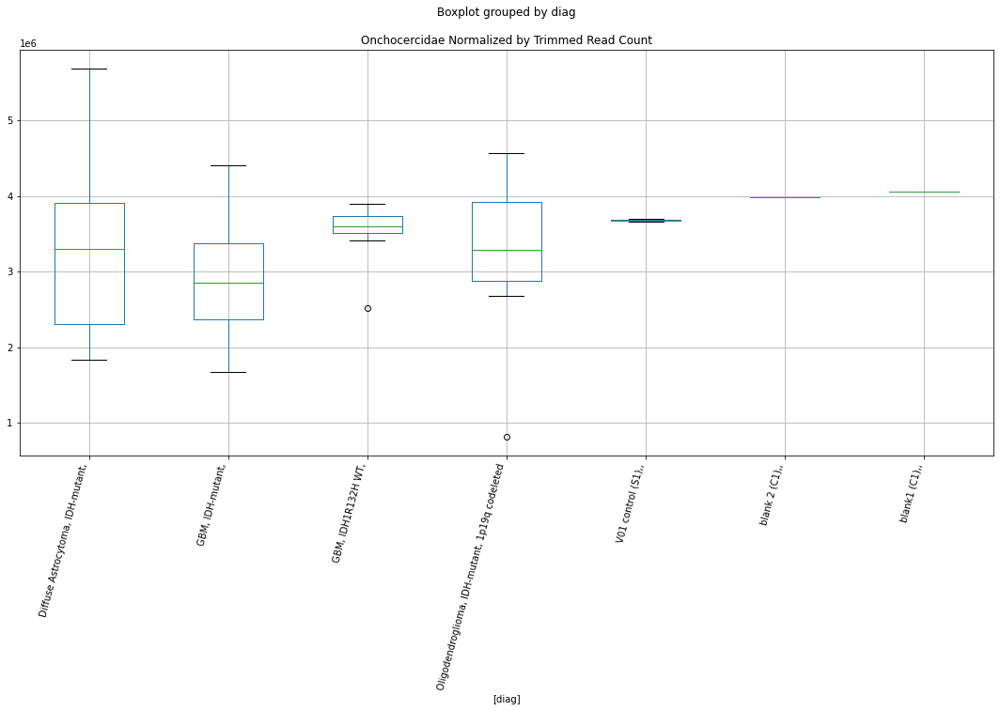

Onchocercidae D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.9478638494688614
	p = 0.008606401725873944
Onchocercidae D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.9478638494688614
	p = 0.008606401725873944


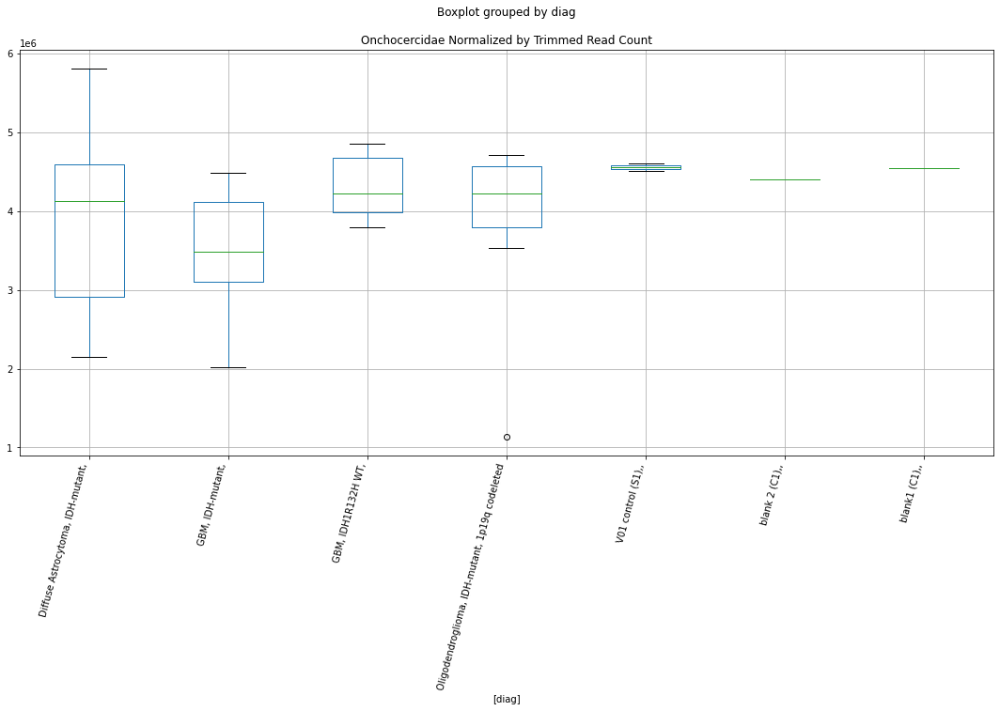

Onchocercidae D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.944467947404852
	p = 0.008669965142984966
Onchocercidae D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.944467947404852
	p = 0.008669965142984966


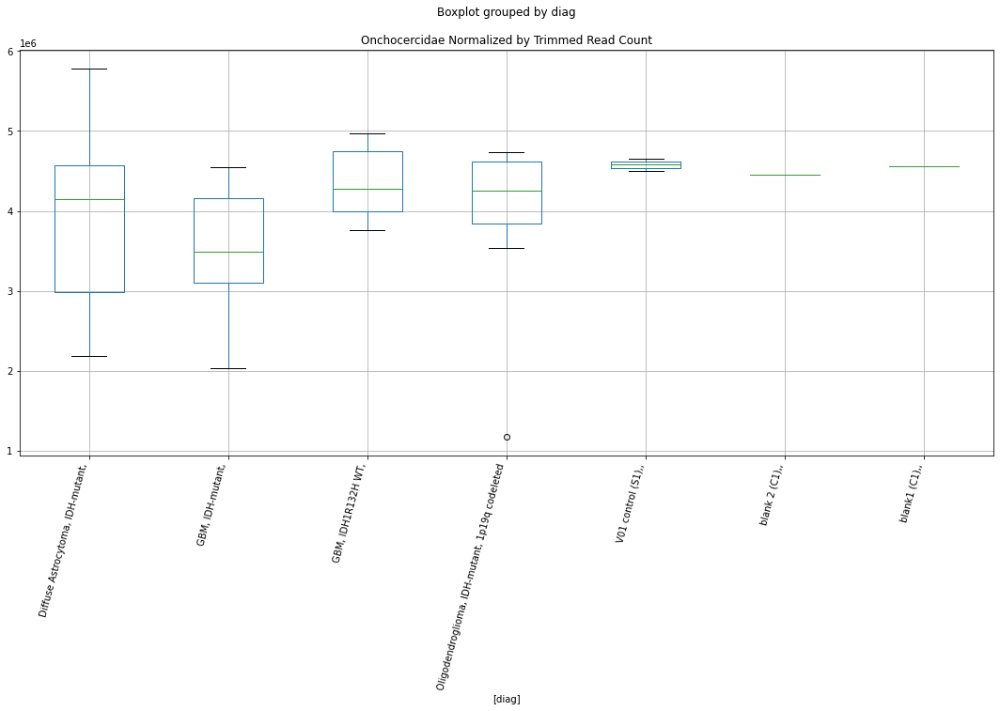

Onchocercidae D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.954309086305892
	p = 0.008487000628150327
Onchocercidae D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.954309086305892
	p = 0.008487000628150327


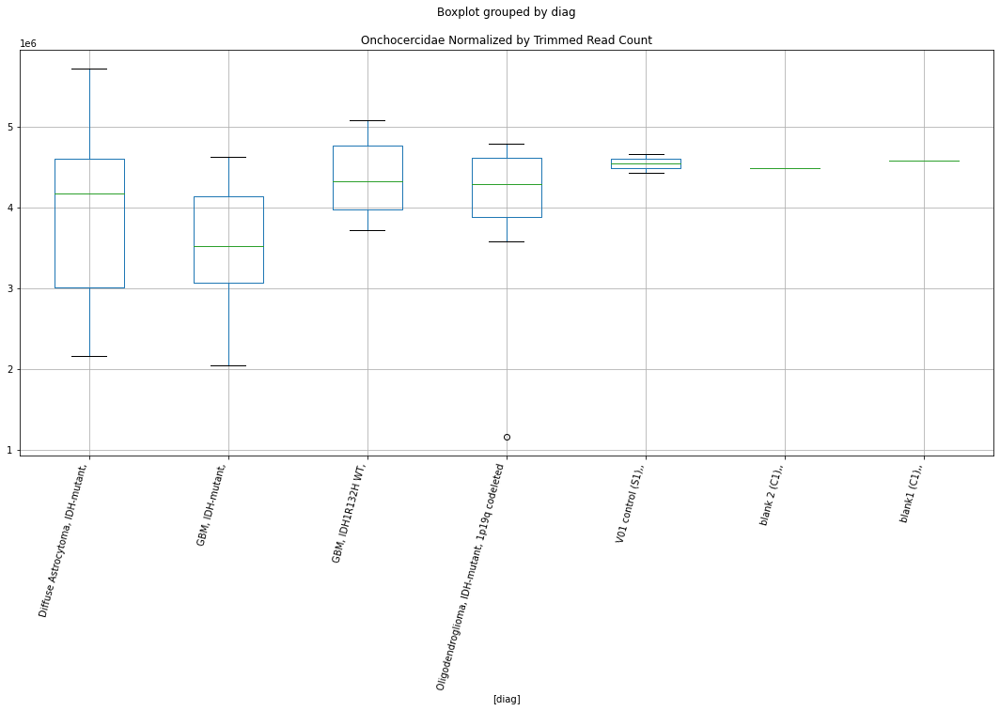

Sutterellaceae D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.9129479041007504
	p = 0.07179904344621697
Sutterellaceae D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.9129479041007504
	p = 0.07179904344621697


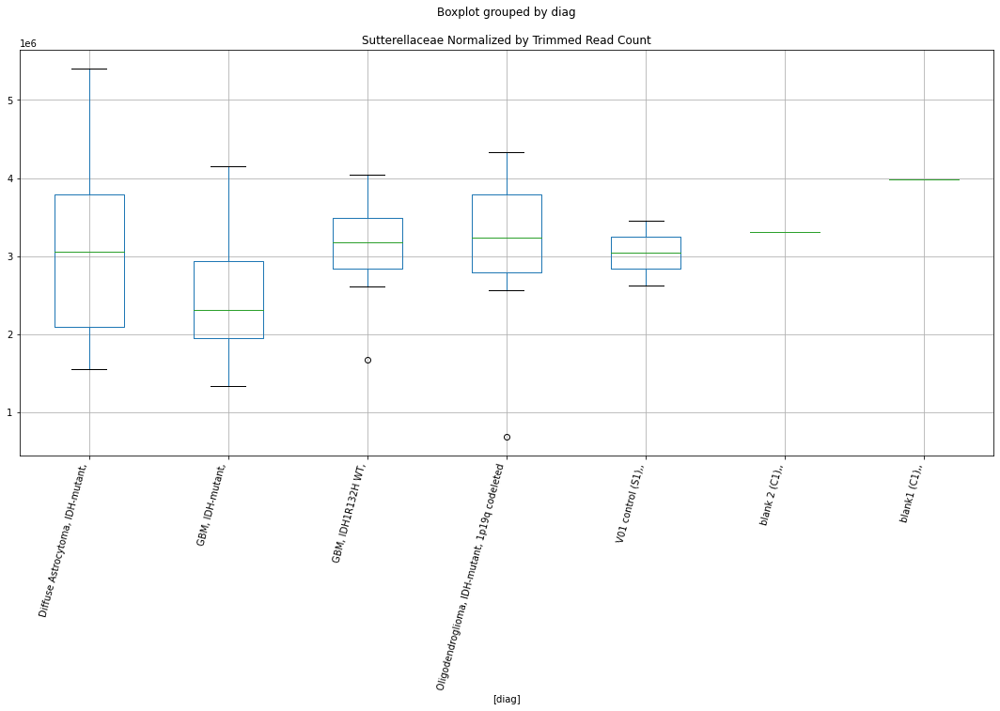

Sutterellaceae D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.8491318356355777
	p = 0.08093131333438128
Sutterellaceae D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.8491318356355777
	p = 0.08093131333438128


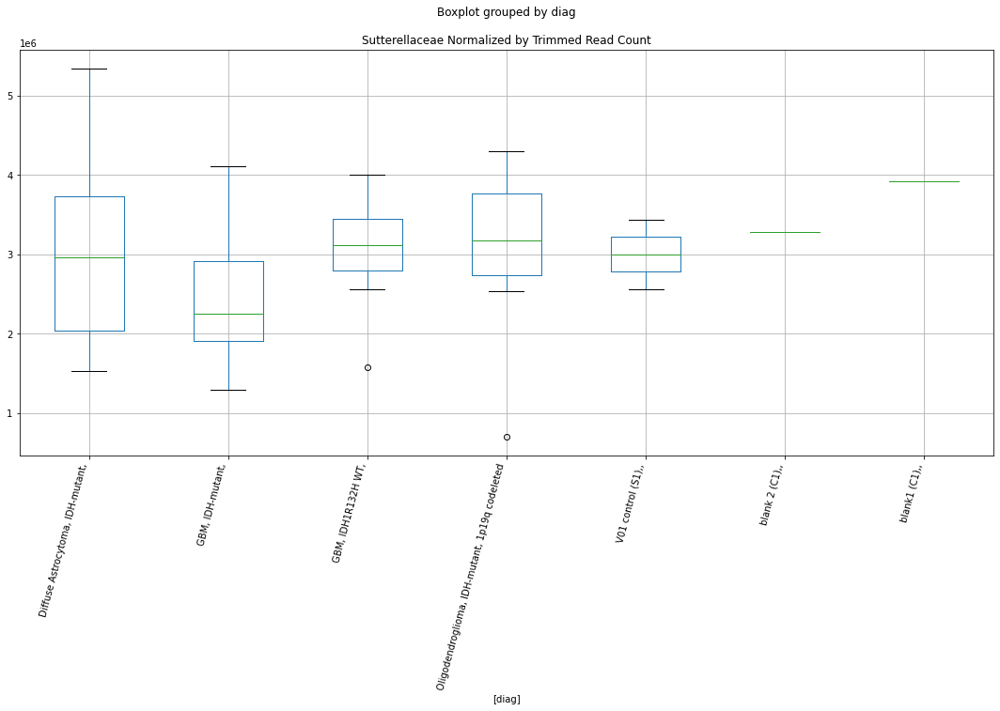

Sutterellaceae D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.8827991295510829
	p = 0.07599303774610565
Sutterellaceae D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.8827991295510829
	p = 0.07599303774610565


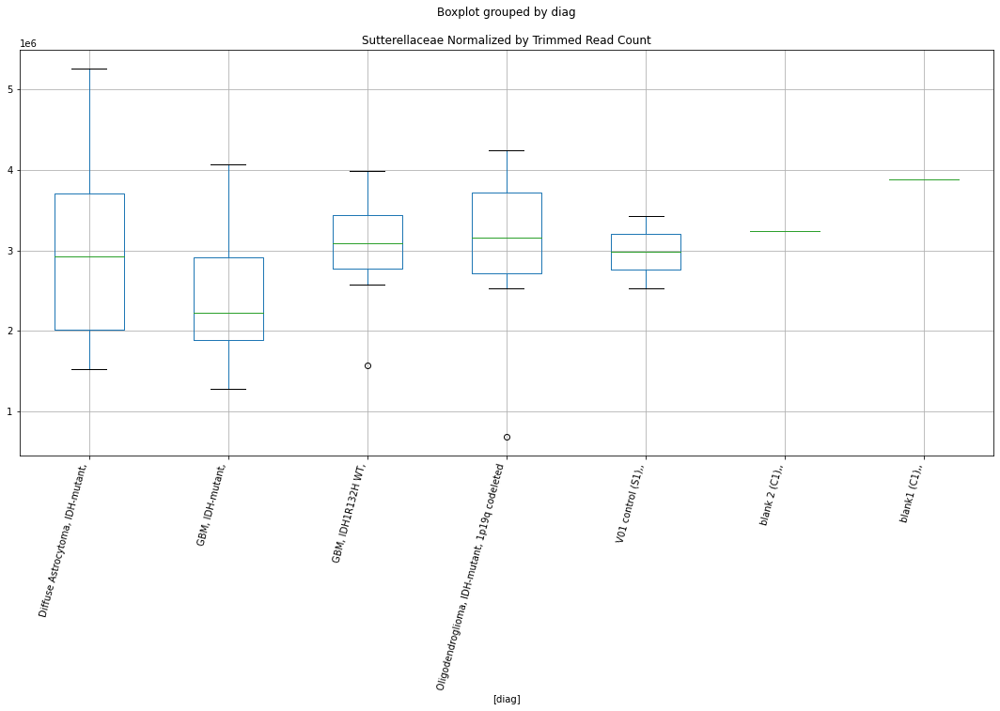

Lachnospiraceae D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.585499693339151
	p = 0.018659178886594203
Lachnospiraceae D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 2.585499693339151
	p = 0.018659178886594203


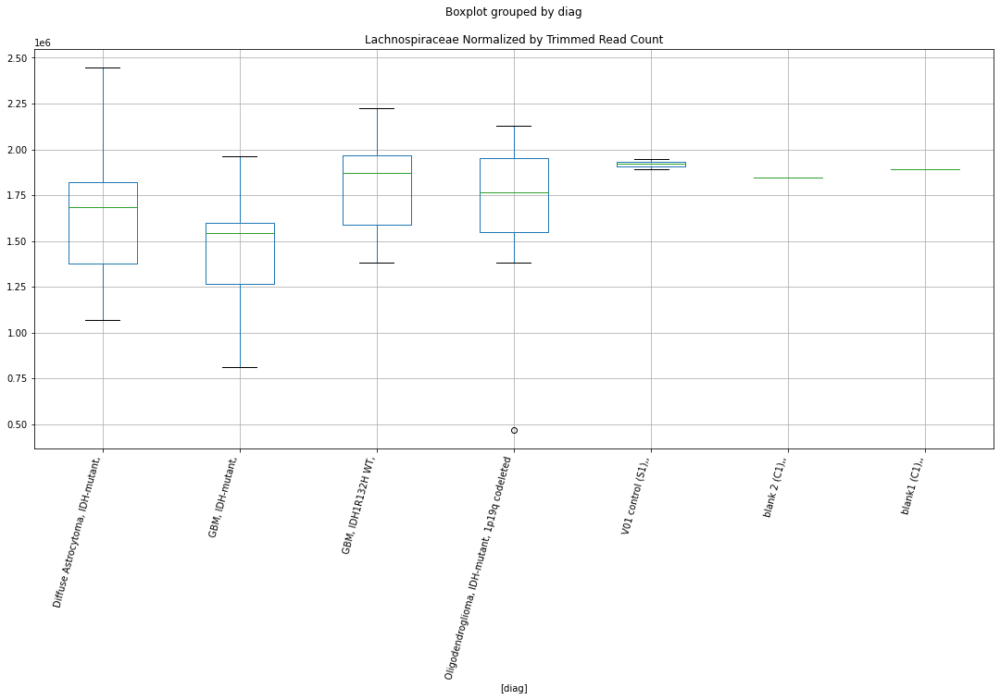

Listeriaceae D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8572992218712627
	p = 0.0797080314004092
Listeriaceae D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.069836316545402
	p = 0.053131055695439446
Listeriaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8572992218712627
	p = 0.0797080314004092
Listeriaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.069836316545402
	p = 0.053131055695439446


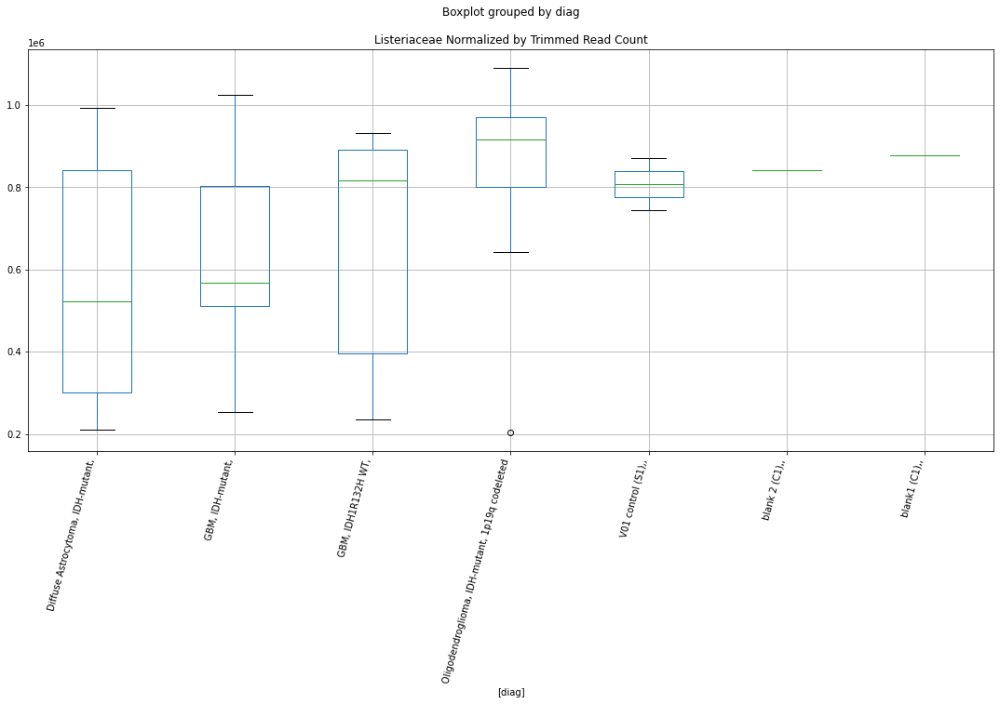

Listeriaceae D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8614356947950697
	p = 0.07909472449892783
Listeriaceae D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.0751589676257747
	p = 0.052582636342800027
Listeriaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8614356947950697
	p = 0.07909472449892783
Listeriaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0751589676257747
	p = 0.052582636342800027


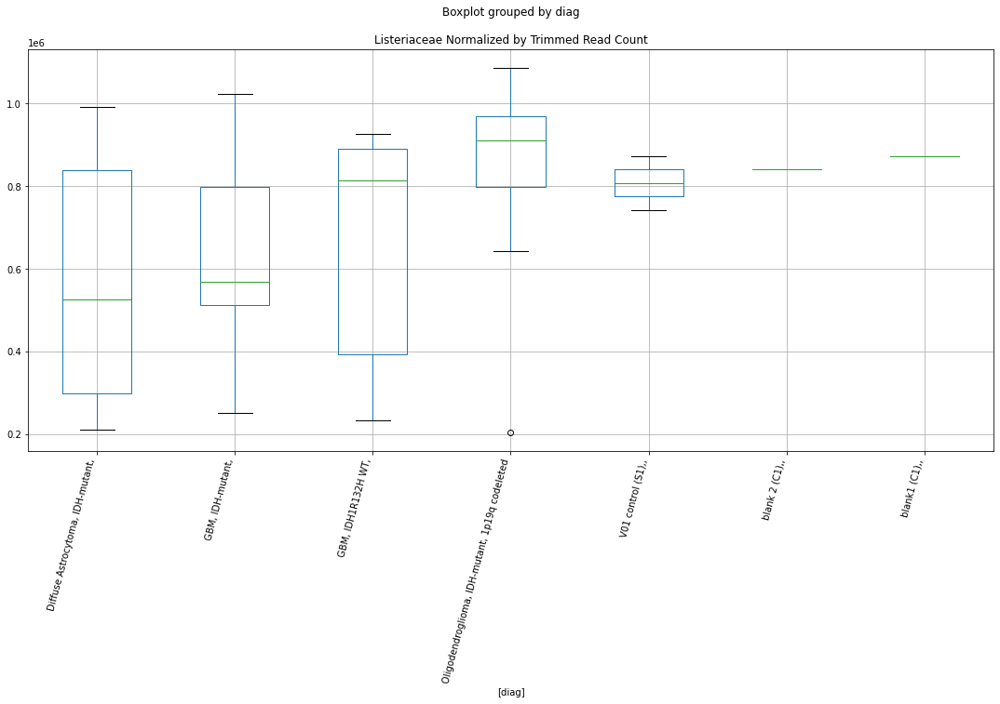

Morganellaceae D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.748311946642248
	p = 0.0974446073164871
Morganellaceae D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.748311946642248
	p = 0.0974446073164871


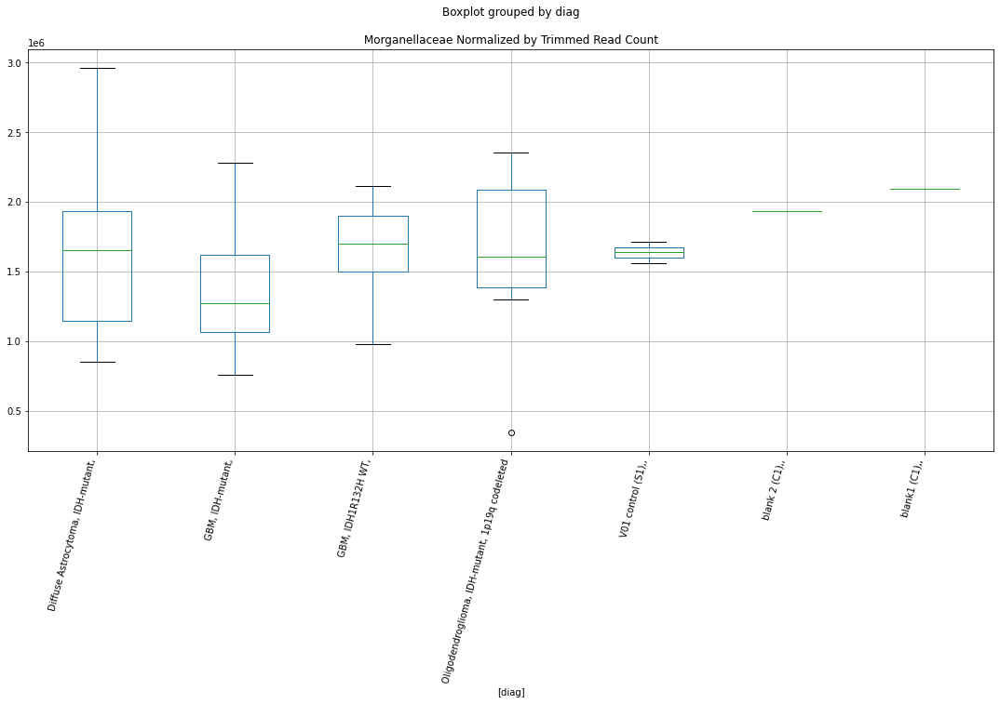

Rhodospirillaceae D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7728748110091916
	p = 0.09317215652698398
Rhodospirillaceae D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.7728748110091916
	p = 0.09317215652698398


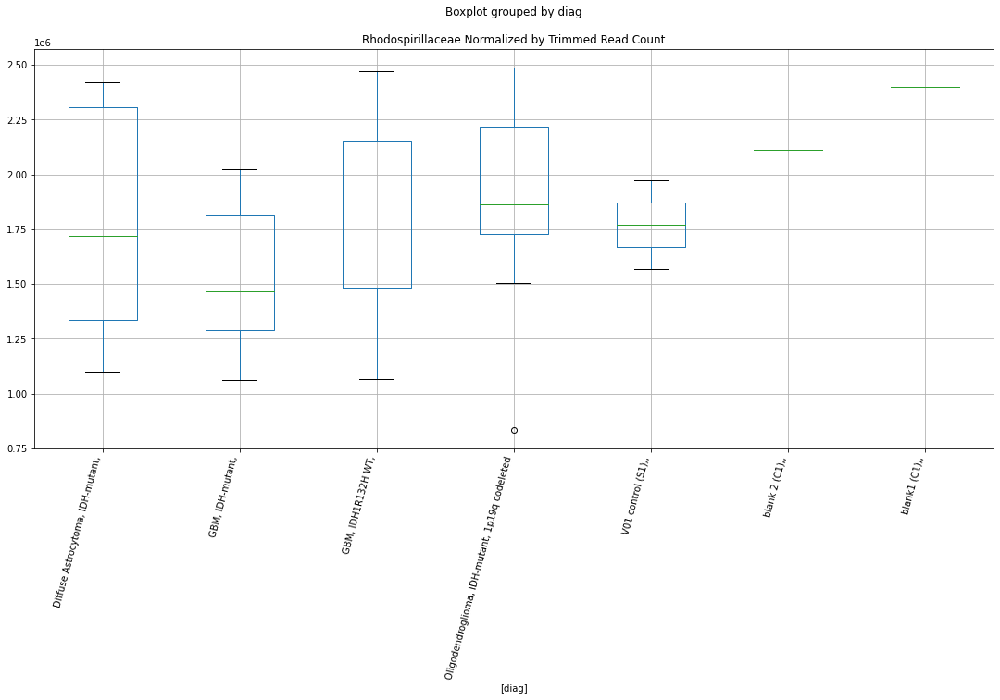

Rhodospirillaceae D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8019883233250882
	p = 0.08832011881906413
Rhodospirillaceae D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8019883233250882
	p = 0.08832011881906413


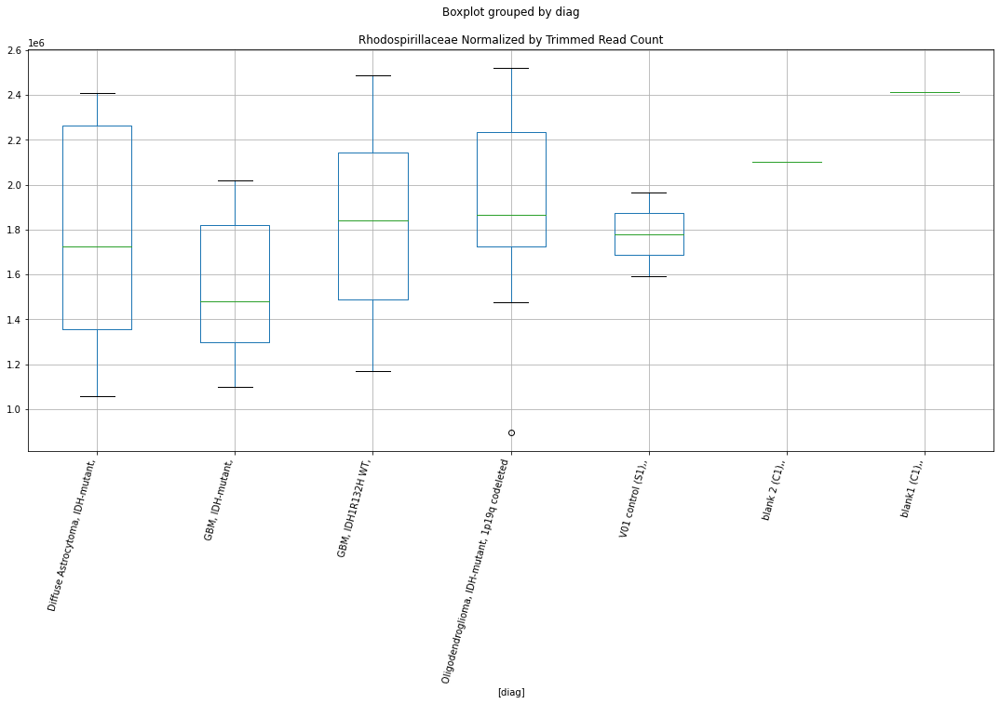

Rhodospirillaceae D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7713087061157649
	p = 0.09343961929297703
Rhodospirillaceae D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.7713087061157649
	p = 0.09343961929297703


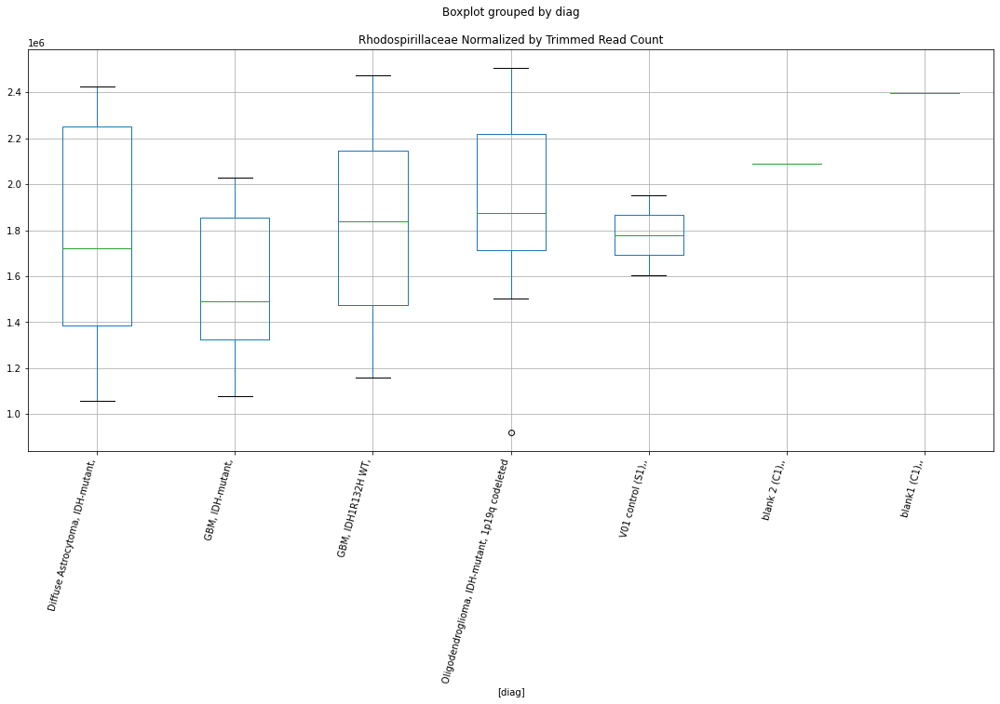

Erwiniaceae D-plex bbduk1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.941548007554771
	p = 0.06801183902302978
Erwiniaceae D-plex bbduk1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.941548007554771
	p = 0.06801183902302978


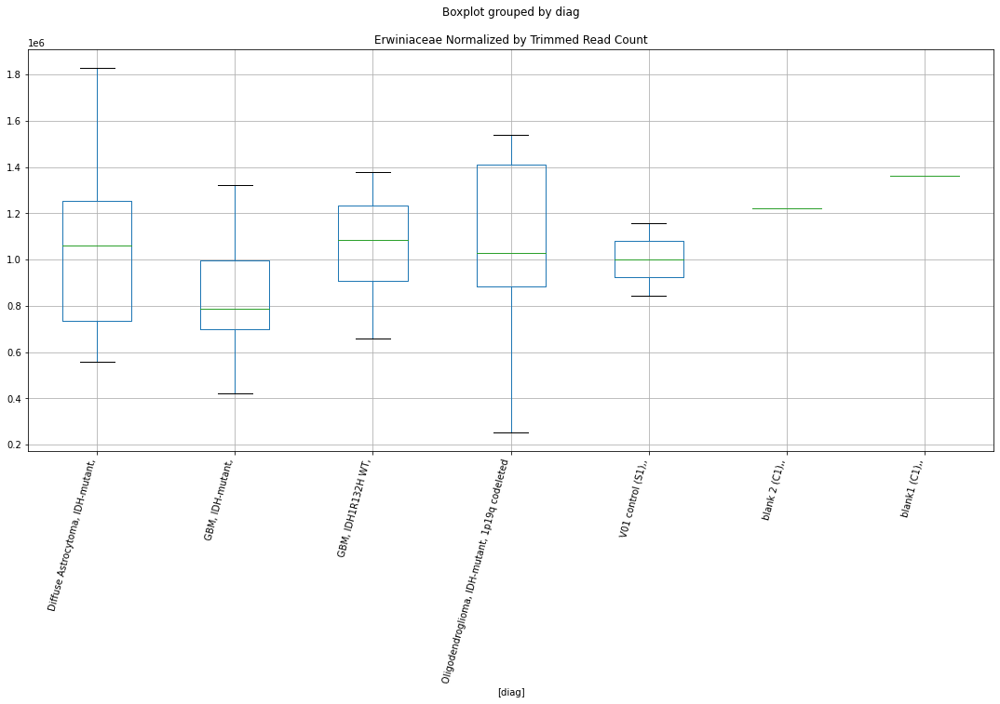

Chromobacteriaceae D-plex bbduk1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.930528151049927
	p = 0.0694494827936287
Chromobacteriaceae D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.930528151049927
	p = 0.0694494827936287


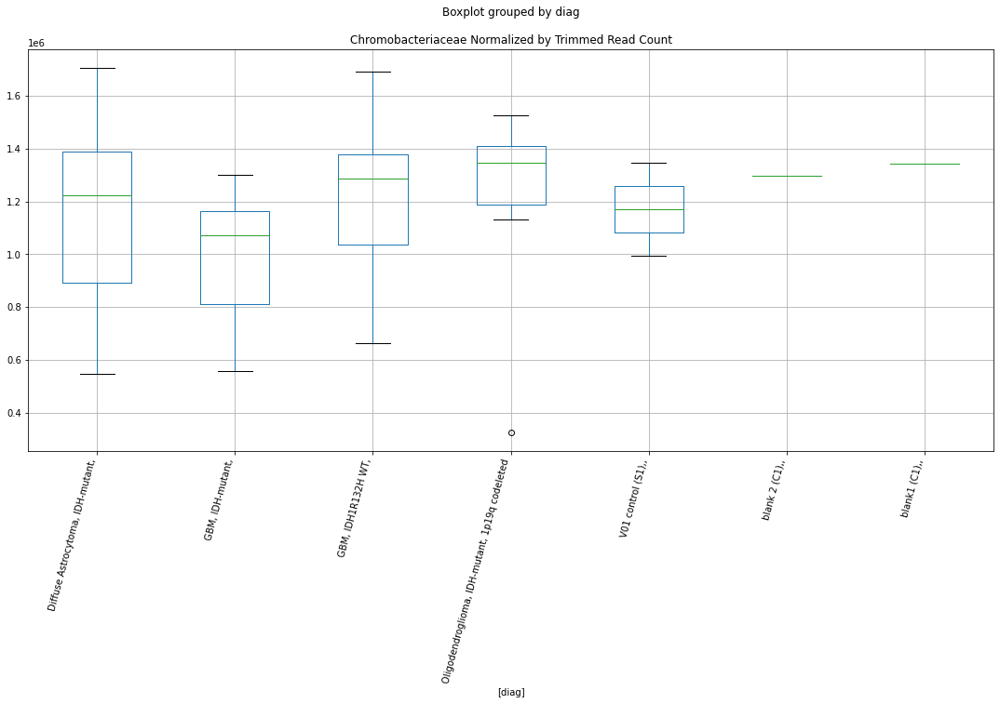

Chromobacteriaceae D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8838628795421781
	p = 0.07584144538964761
Chromobacteriaceae D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8838628795421781
	p = 0.07584144538964761


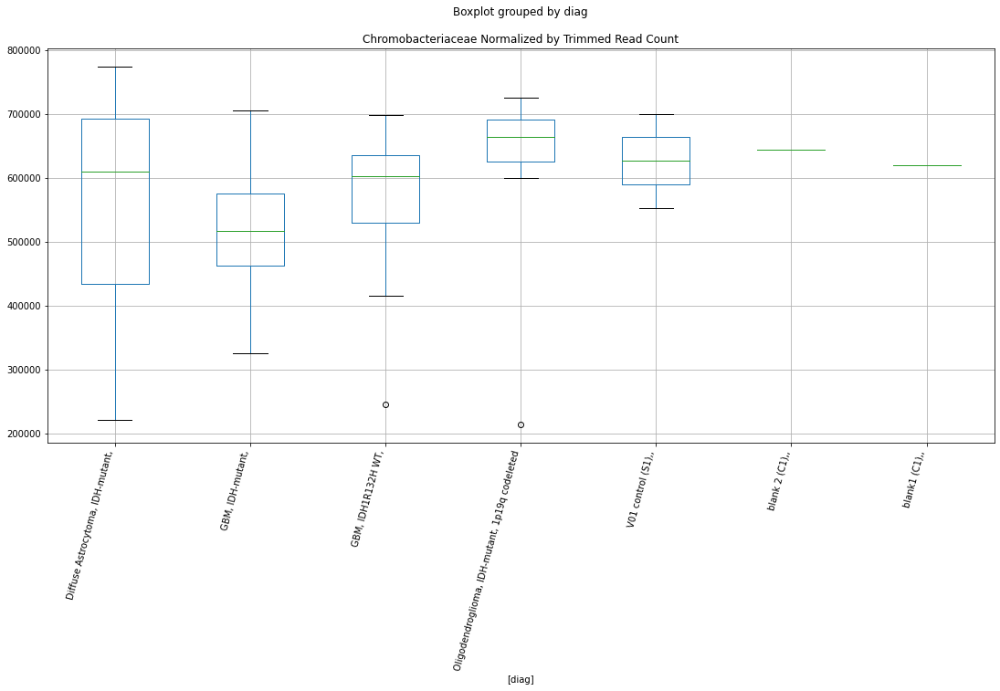

Chromobacteriaceae D-plex bbduk3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8861582701655881
	p = 0.07551524628328081
Chromobacteriaceae D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.8861582701655881
	p = 0.07551524628328081


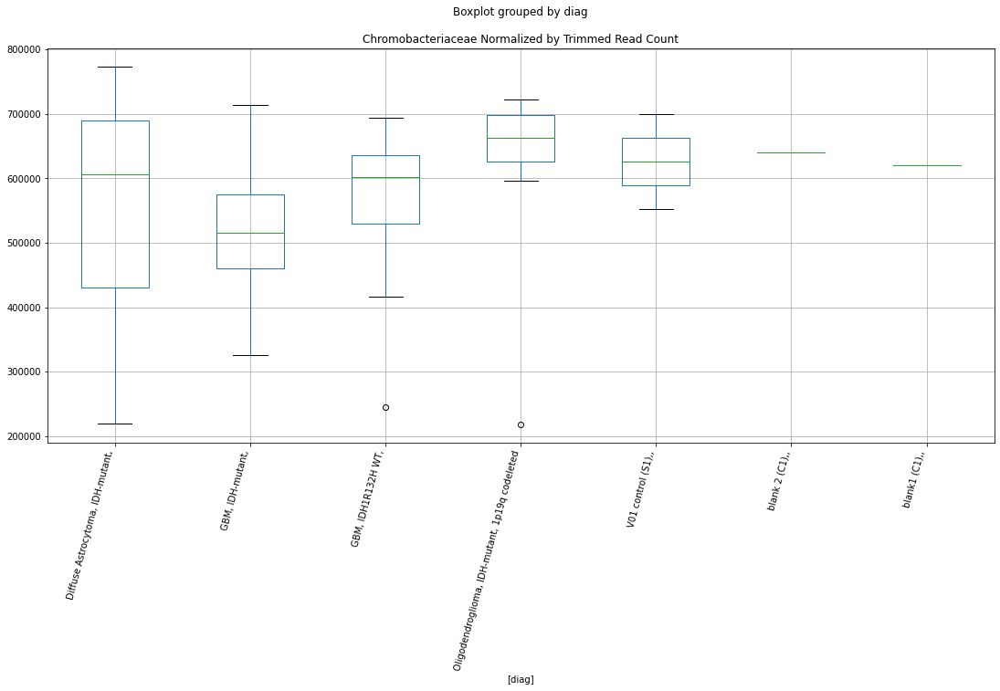

Chromobacteriaceae D-plex cutadapt1 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.7846265892852464
	p = 0.09118634157064172
Chromobacteriaceae D-plex cutadapt1 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.7846265892852464
	p = 0.09118634157064172


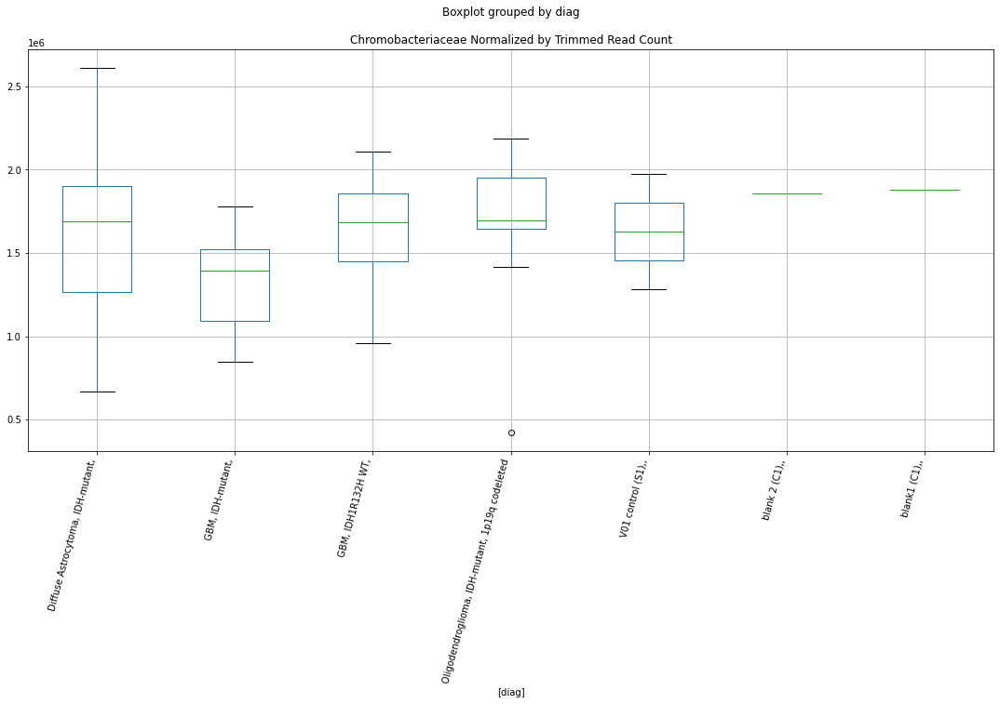

Chromobacteriaceae D-plex cutadapt2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.8554171519691725
	p = 0.07998846720376386
Chromobacteriaceae D-plex cutadapt2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.8554171519691725
	p = 0.07998846720376386


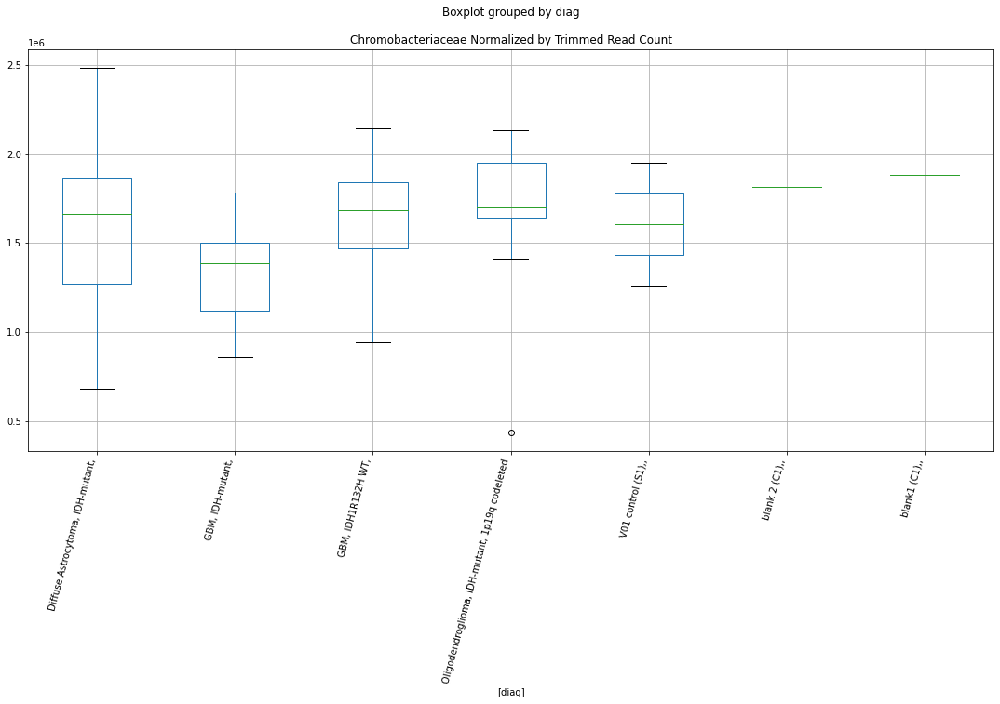

Chromobacteriaceae D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.7834204916630925
	p = 0.09138843505342033
Chromobacteriaceae D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = 1.7834204916630925
	p = 0.09138843505342033


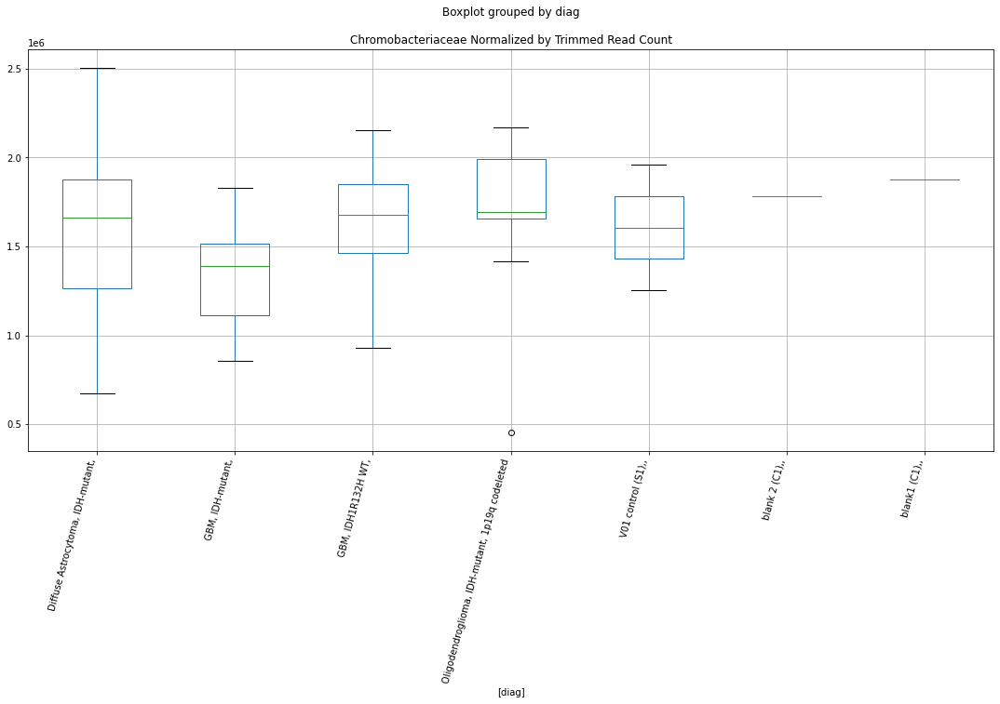

In [83]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in diamond_families:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Trimmed Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


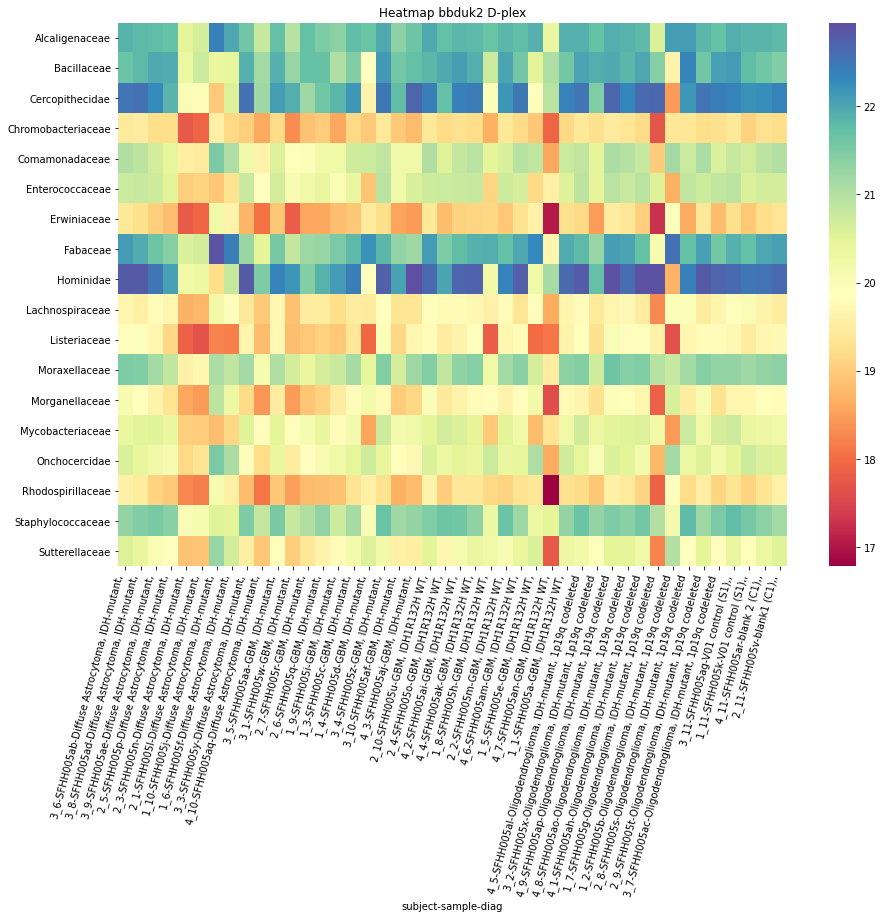

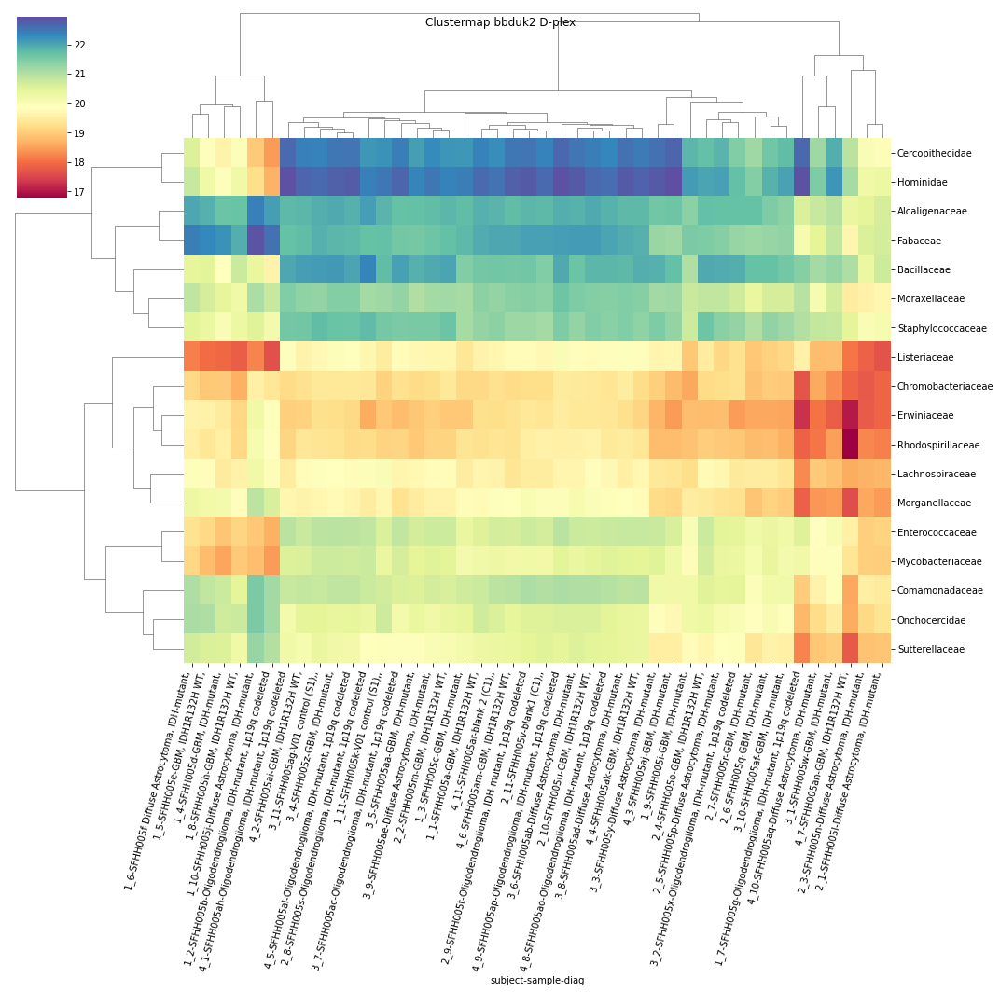

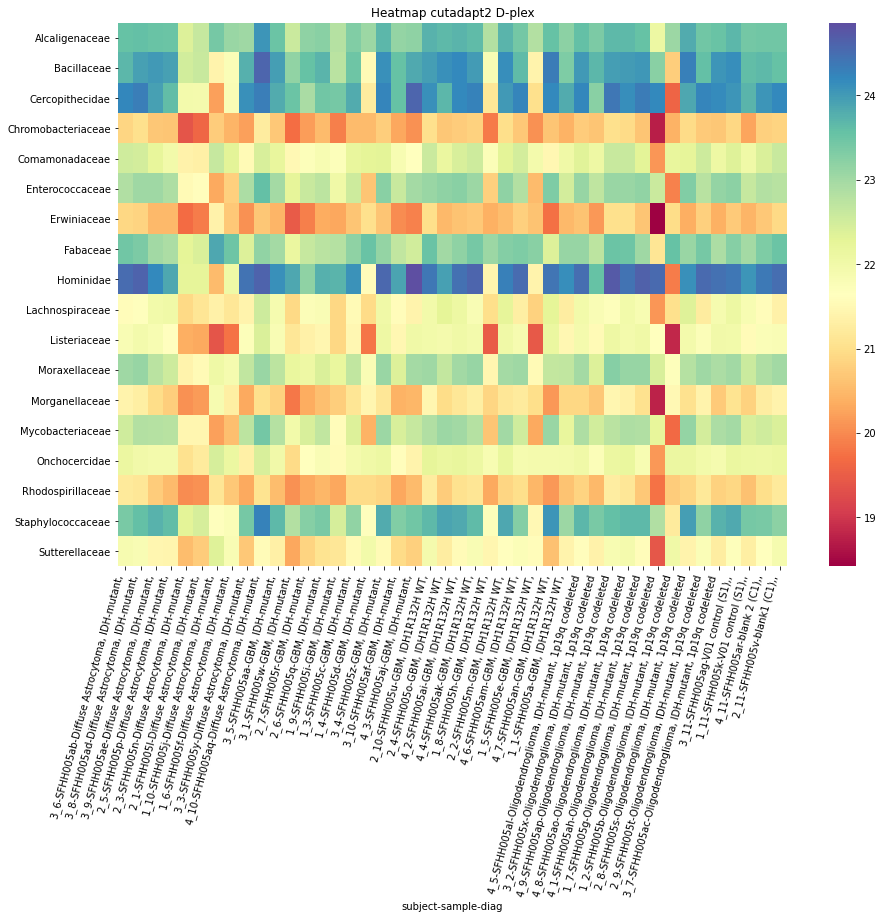

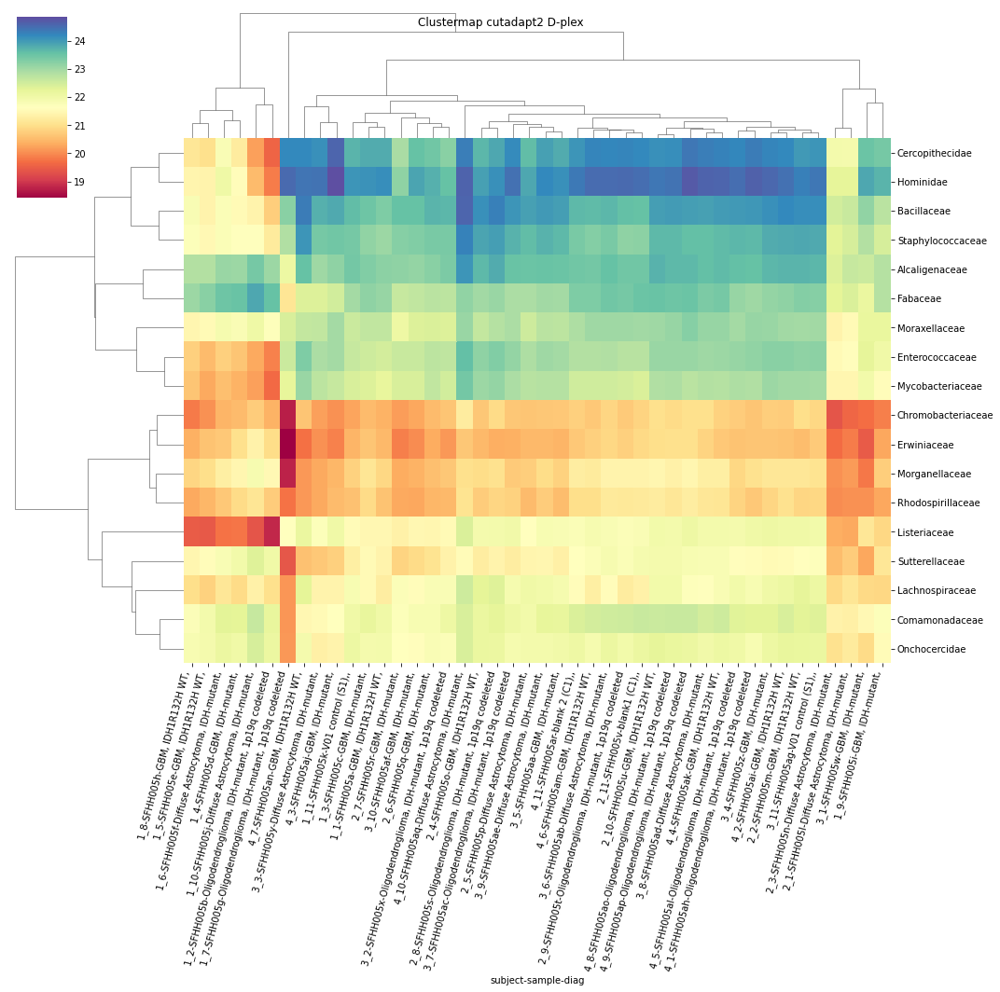

In [84]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

rfAlu D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9615152861448204
	p = 0.06547440212011787
rfAlu D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9615152861448204
	p = 0.06547440212011787


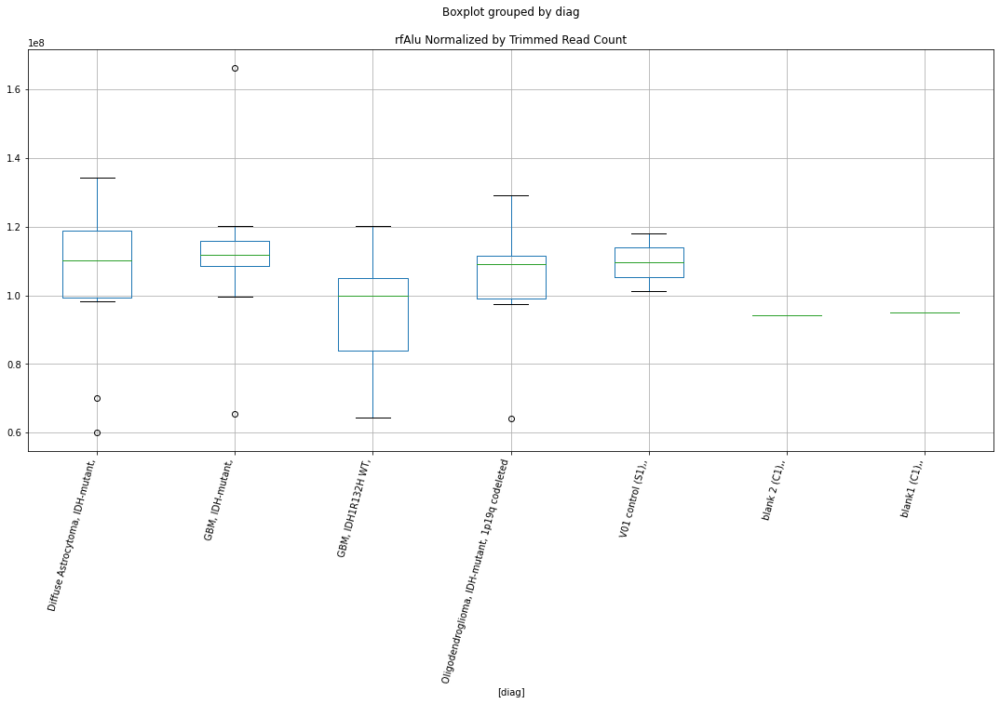

rfAlu D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9595766285249985
	p = 0.06571700434956373
rfAlu D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9595766285249985
	p = 0.06571700434956373


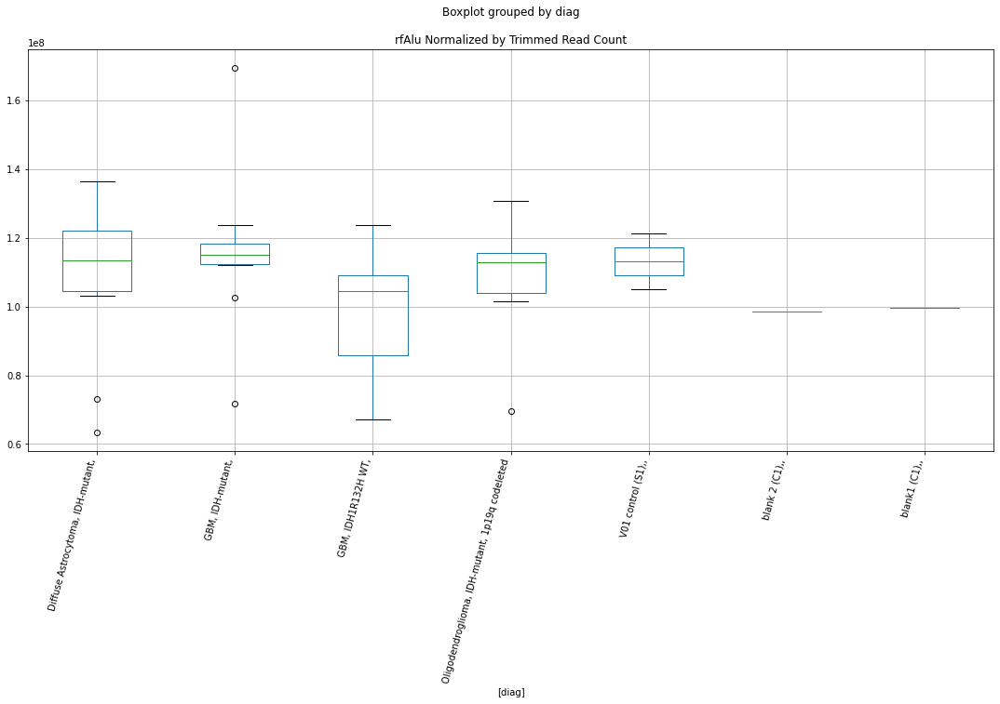

rfERVL-MaLR D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.758375722629607
	p = 0.09567398403296841
rfERVL-MaLR D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.758375722629607
	p = 0.09567398403296841


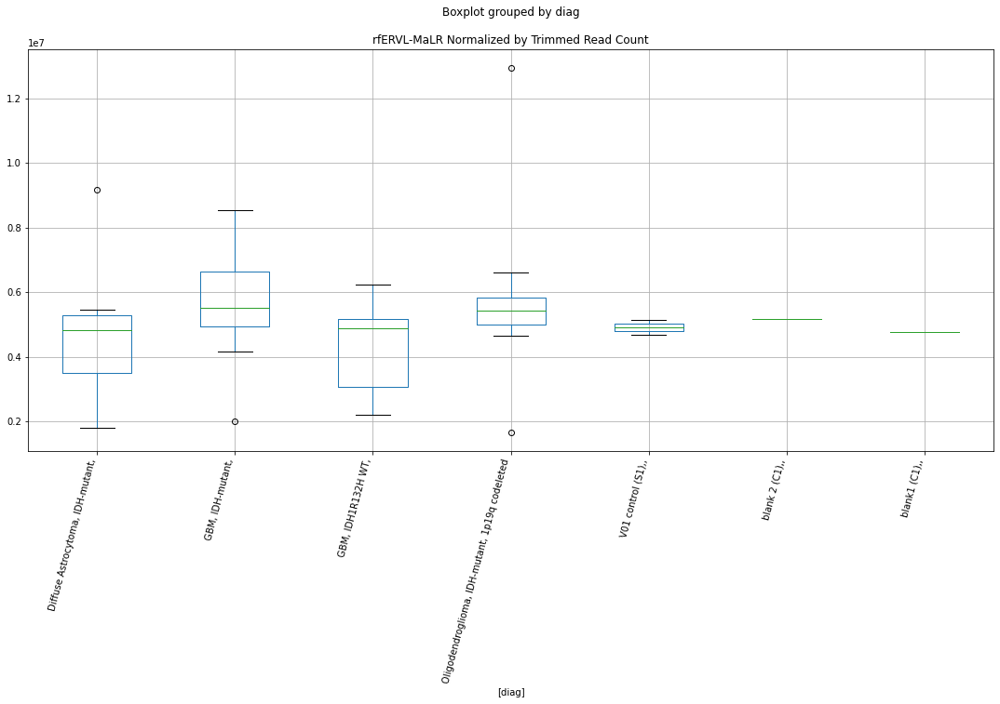

rfERVL-MaLR D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7777086168428593
	p = 0.09235082664632728
rfERVL-MaLR D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7777086168428593
	p = 0.09235082664632728


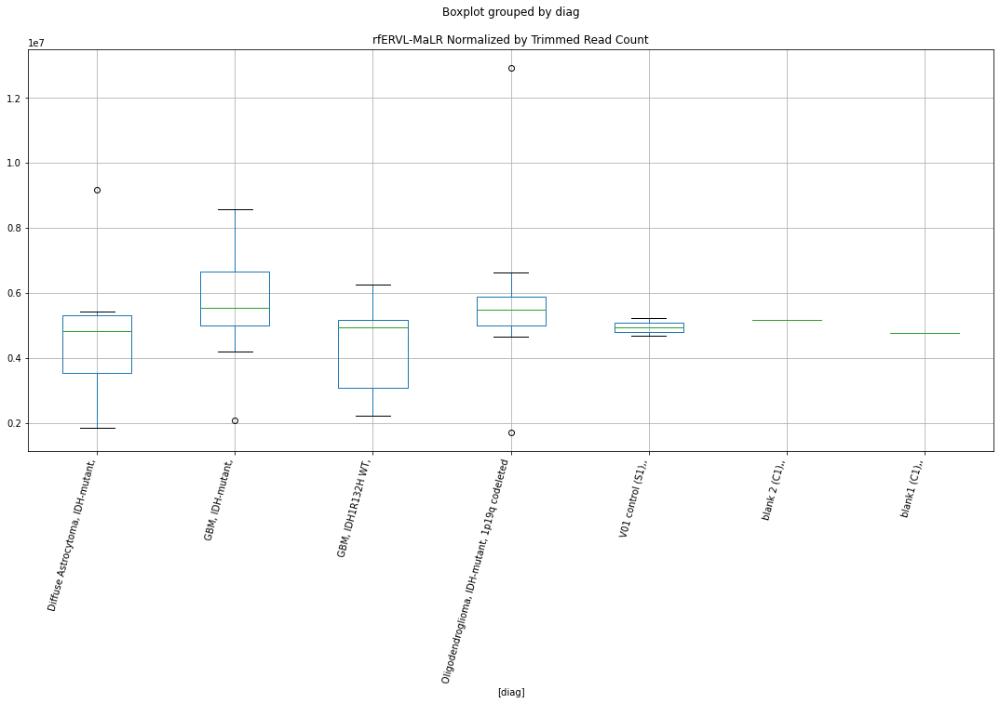

rfERV1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.172243062824775
	p = 0.04344101915072877
rfERV1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.172243062824775
	p = 0.04344101915072877


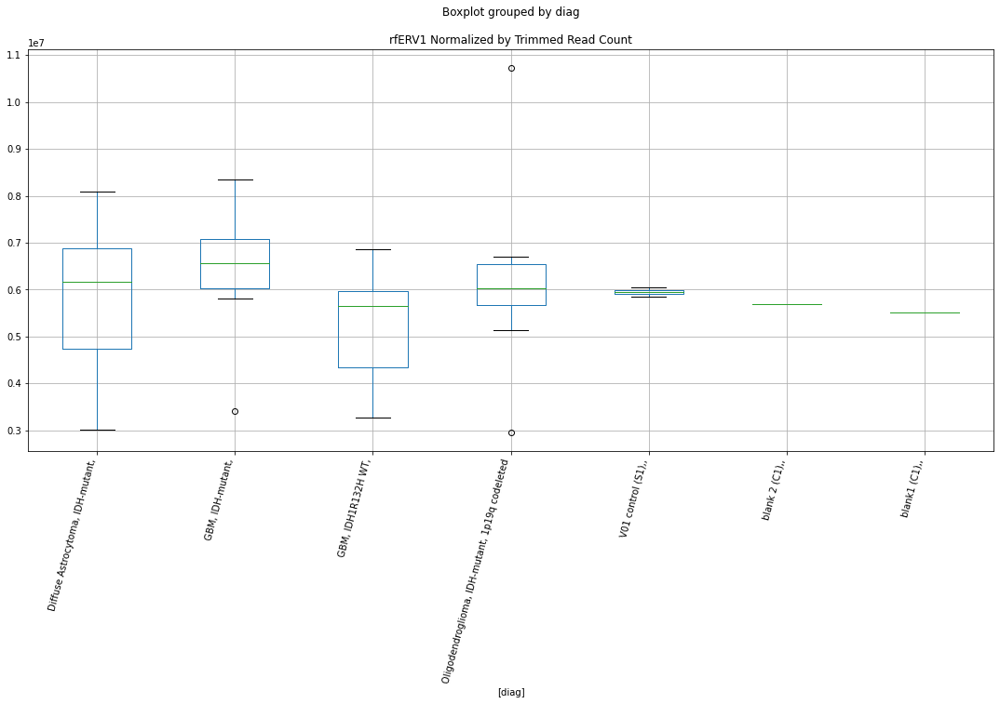

rfERV1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1600217826780908
	p = 0.04450592057604513
rfERV1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1600217826780908
	p = 0.04450592057604513


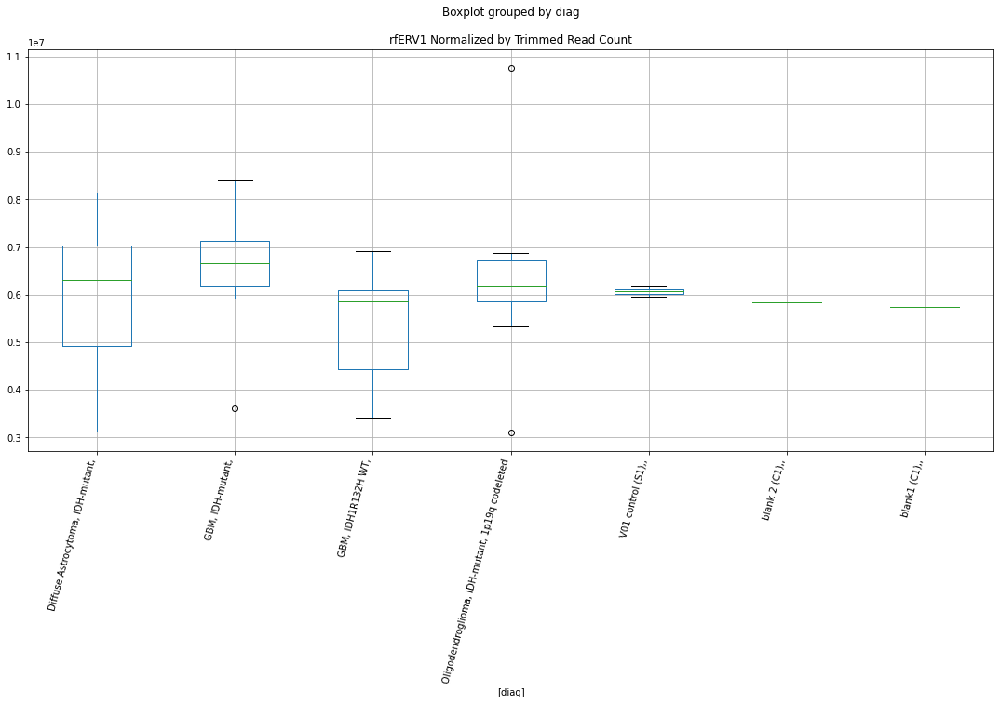

rfhAT-Charlie D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9728804854567226
	p = 0.06406821146211976
rfhAT-Charlie D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9728804854567226
	p = 0.06406821146211976


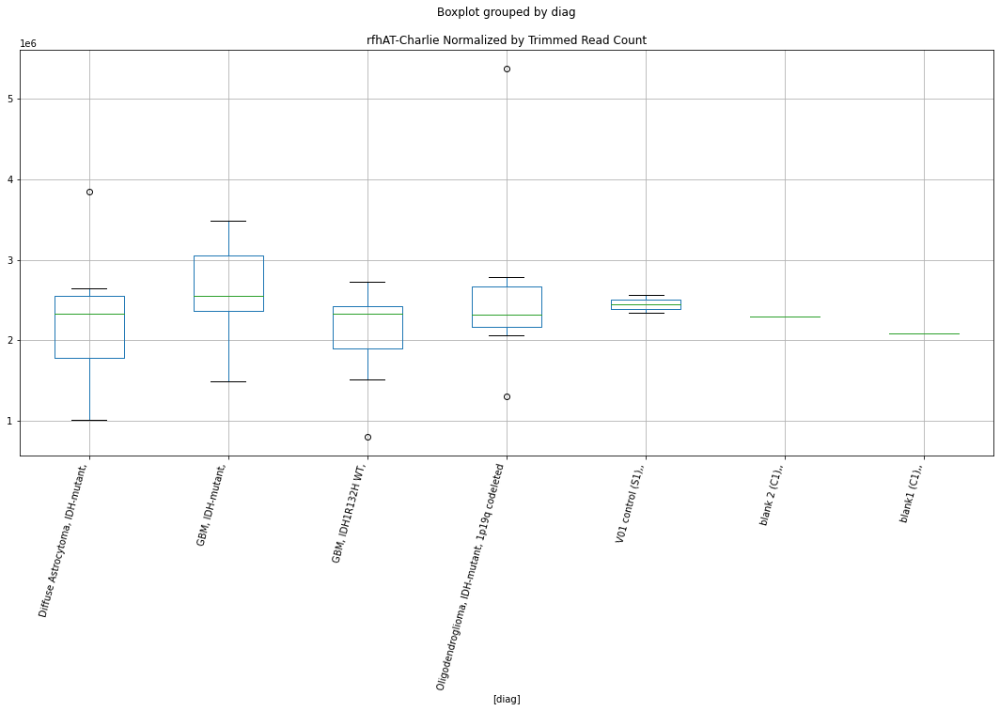

rfhAT-Charlie D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9205429678661308
	p = 0.07077544588400955
rfhAT-Charlie D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9205429678661308
	p = 0.07077544588400955


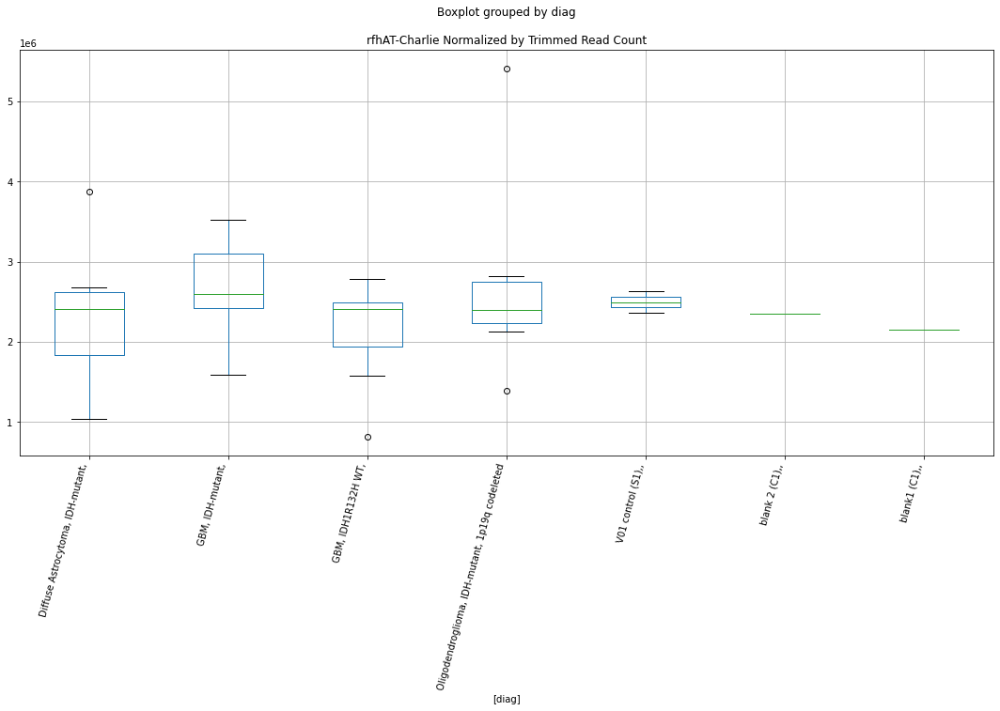

rfTcMar-Tigger D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.822876241262299
	p = 0.08497640880605287
rfTcMar-Tigger D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.822876241262299
	p = 0.08497640880605287


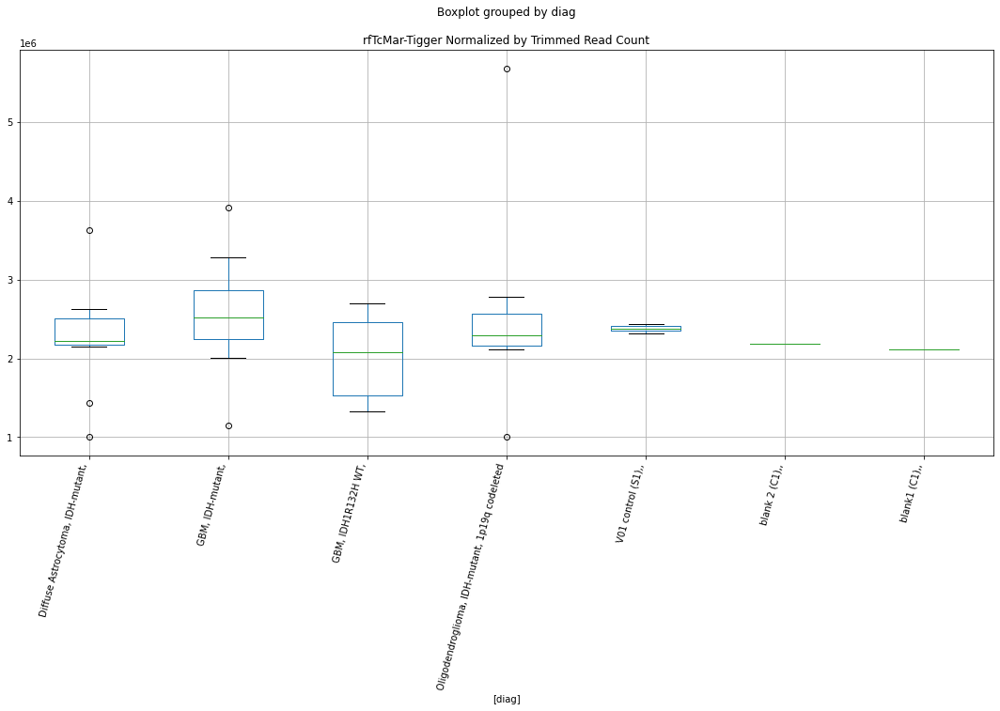

rfTcMar-Tigger D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7811052594153407
	p = 0.09177746918525885
rfTcMar-Tigger D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7811052594153407
	p = 0.09177746918525885


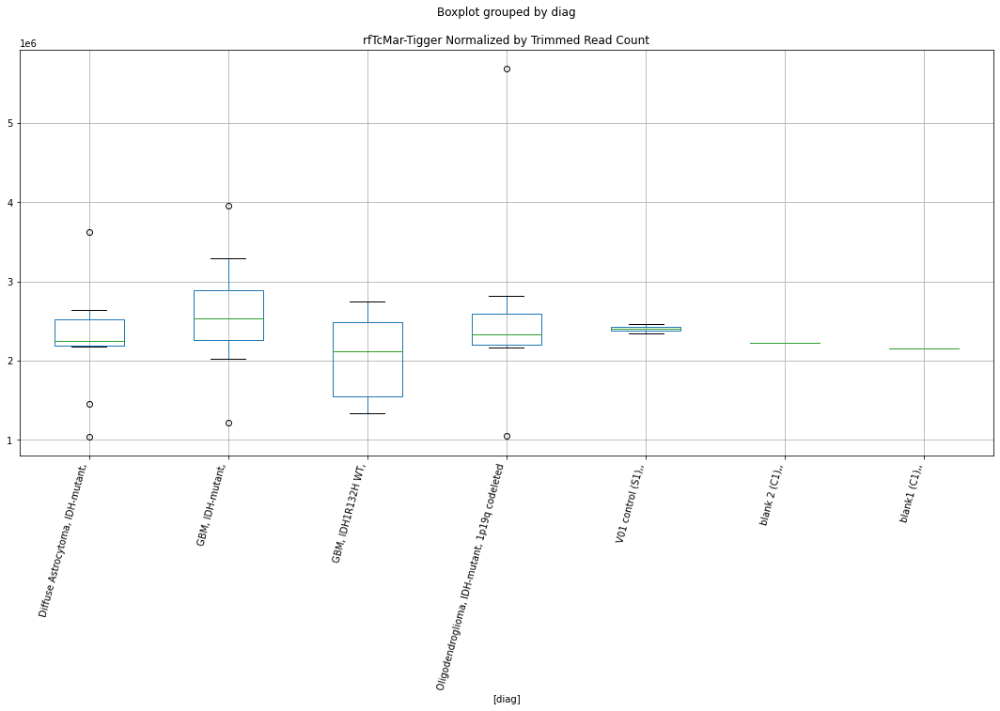

rfhAT-Tip100 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.287809426141512
	p = 0.03446738449781473
rfhAT-Tip100 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.287809426141512
	p = 0.03446738449781473


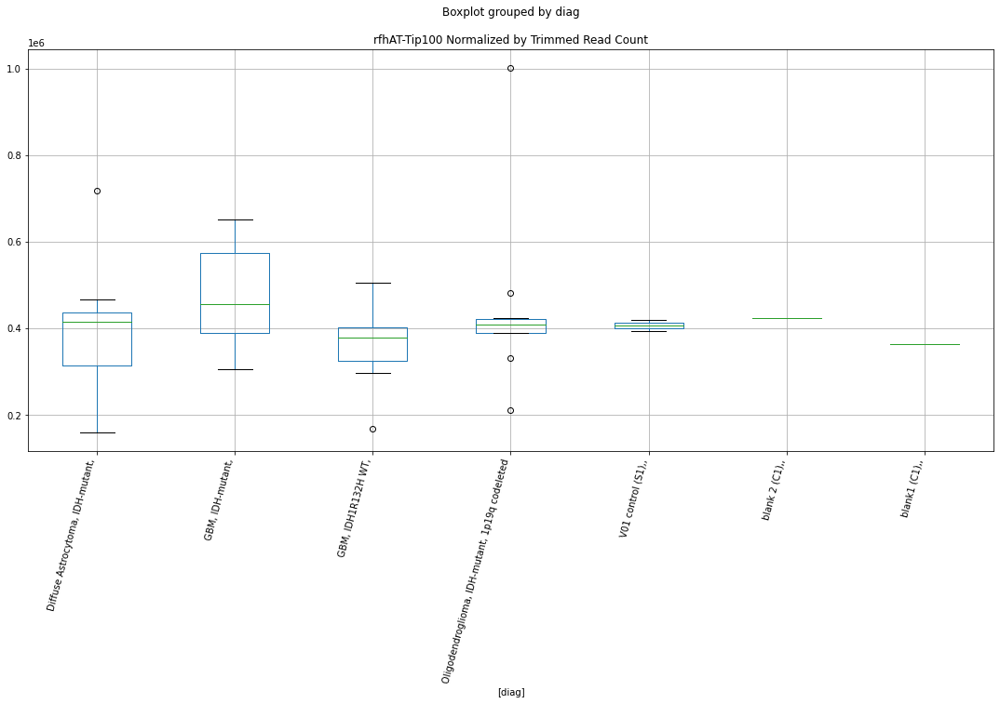

rfhAT-Tip100 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.284942535855432
	p = 0.03466754826684197
rfhAT-Tip100 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.284942535855432
	p = 0.03466754826684197


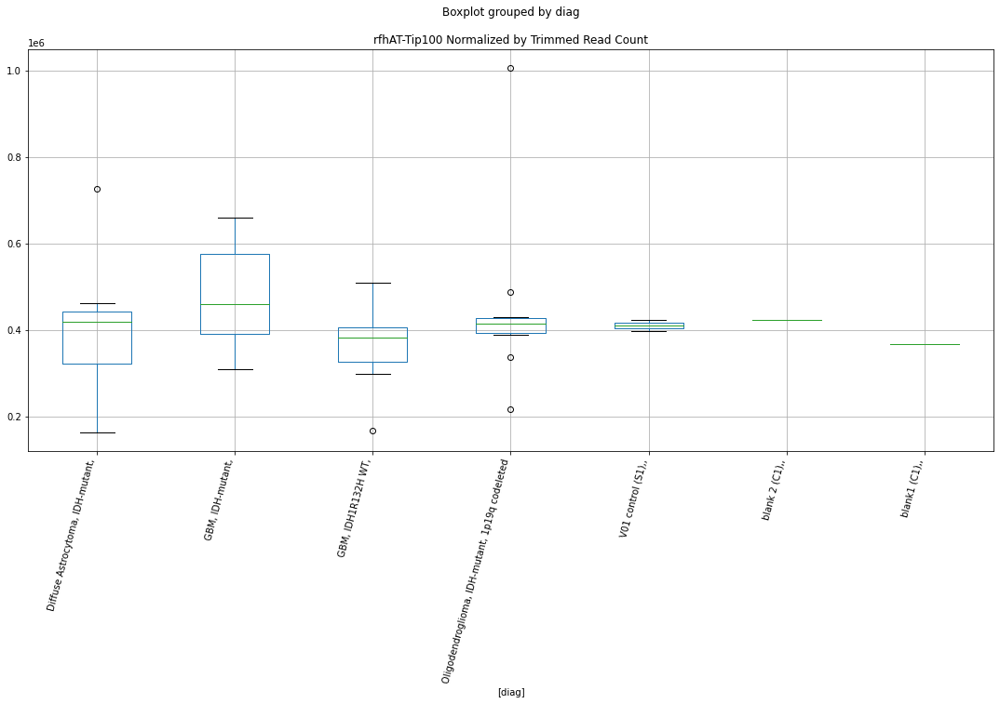

rfERVK D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7963621303072703
	p = 0.08924019679051556
rfERVK D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7963621303072703
	p = 0.08924019679051556


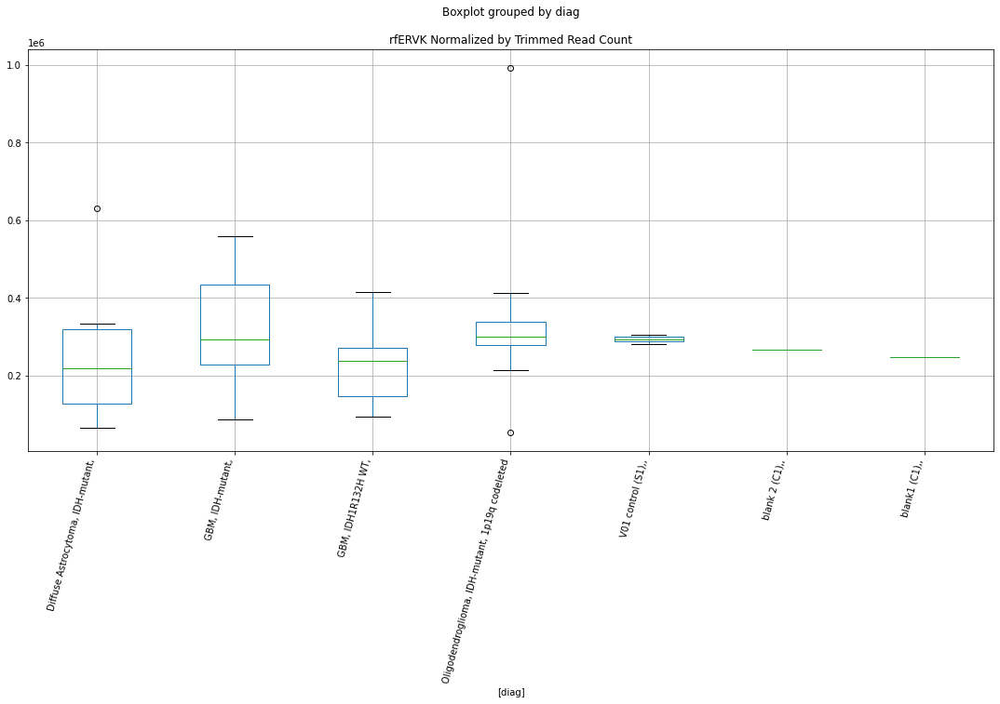

rfERVK D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.805869724981452
	p = 0.08769021862543358
rfERVK D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.805869724981452
	p = 0.08769021862543358


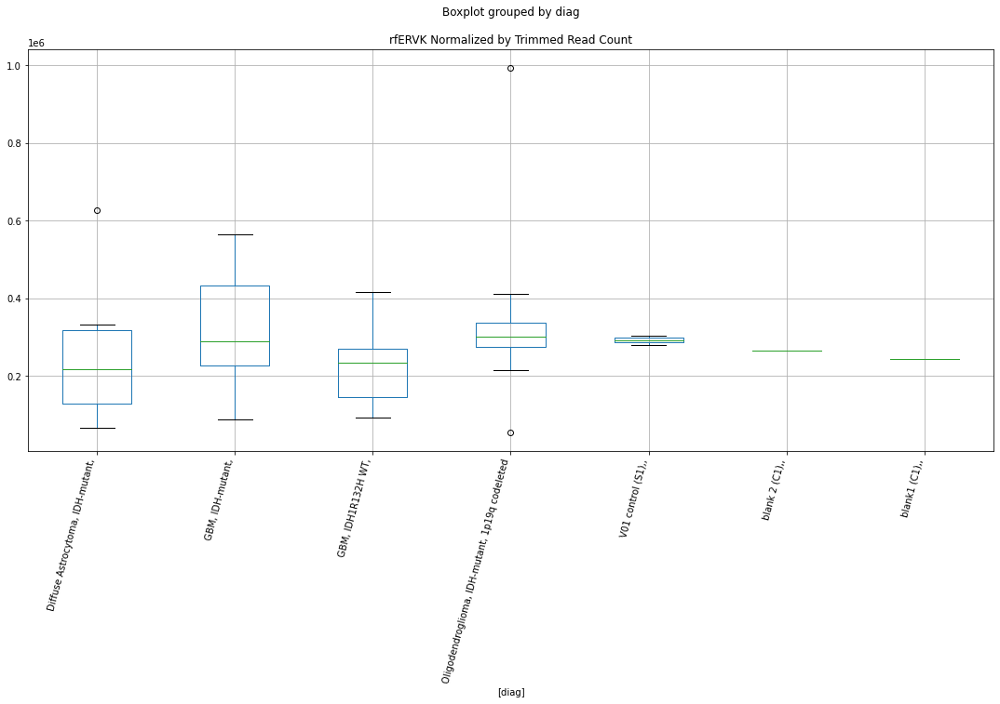

rfGypsy D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.787631871051142
	p = 0.09068447144219084
rfGypsy D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.787631871051142
	p = 0.09068447144219084


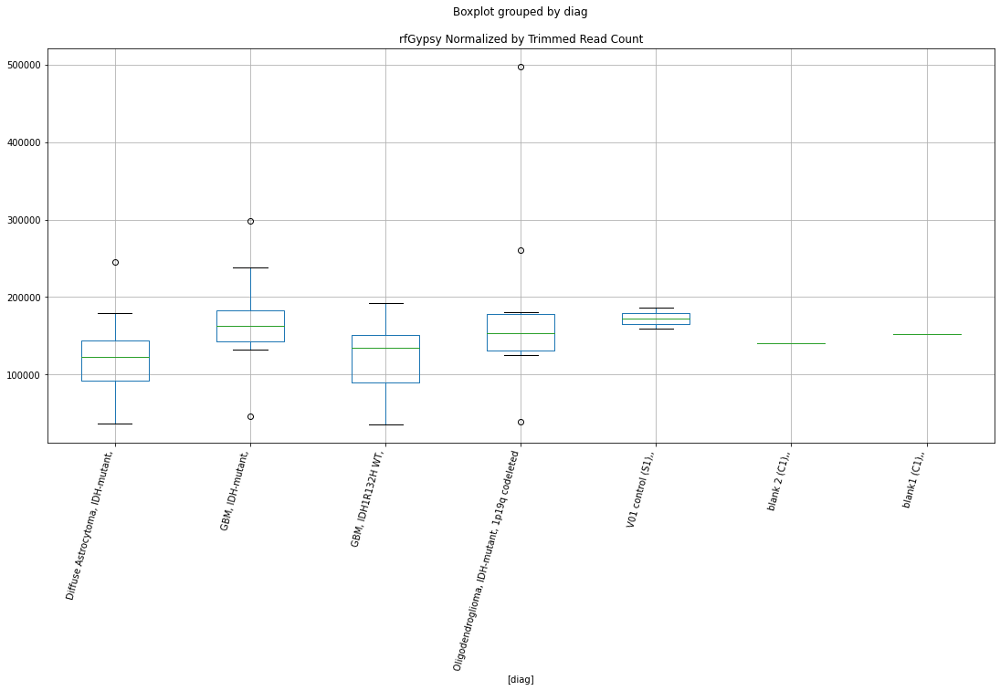

rfGypsy D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7557393901925675
	p = 0.09613510062662735
rfGypsy D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7557393901925675
	p = 0.09613510062662735


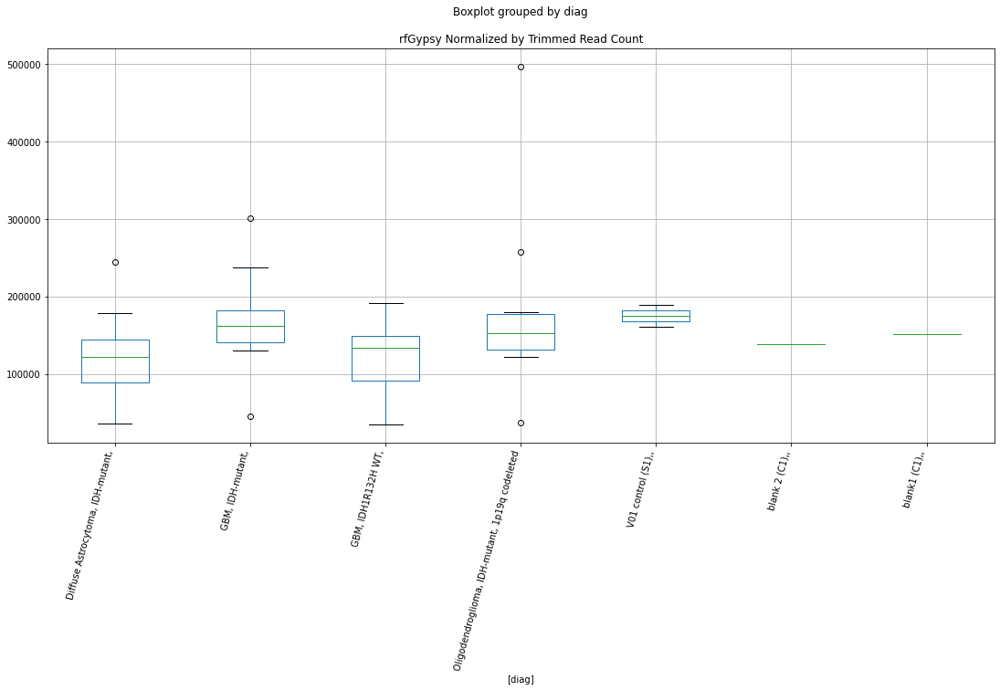

rfGypsy D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.77607699216926
	p = 0.09262735441705139
rfGypsy D-plex cutadapt1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.77607699216926
	p = 0.09262735441705139


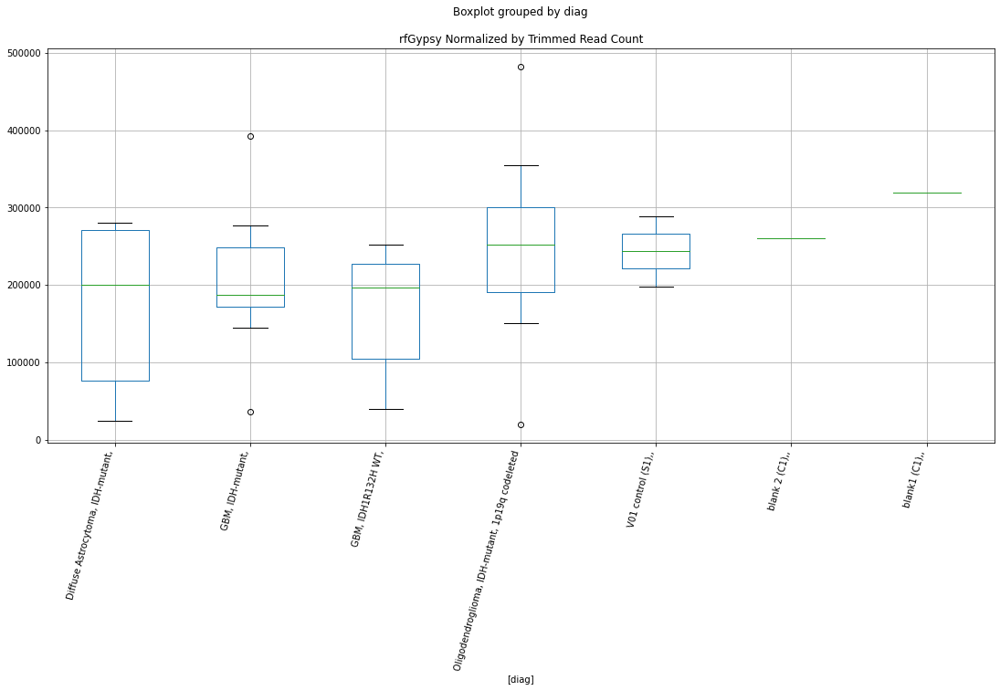

rfTcMar-Tc2 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1977407451288515
	p = 0.04129404743186969
rfTcMar-Tc2 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1977407451288515
	p = 0.04129404743186969


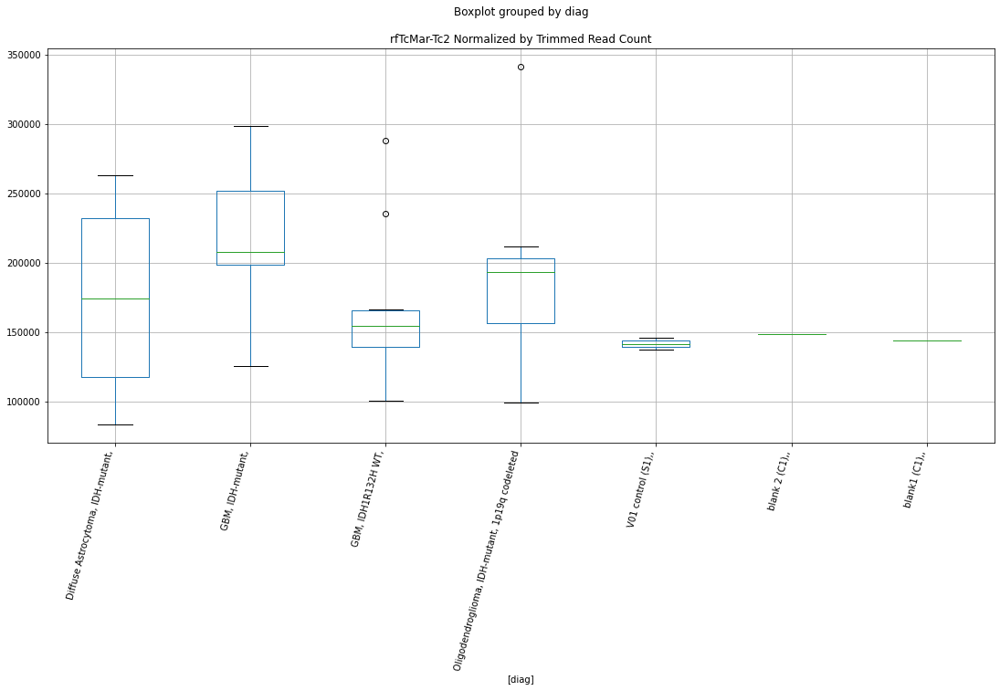

rfTcMar-Tc2 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.2530324277531717
	p = 0.0369692638098832
rfTcMar-Tc2 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.2530324277531717
	p = 0.0369692638098832


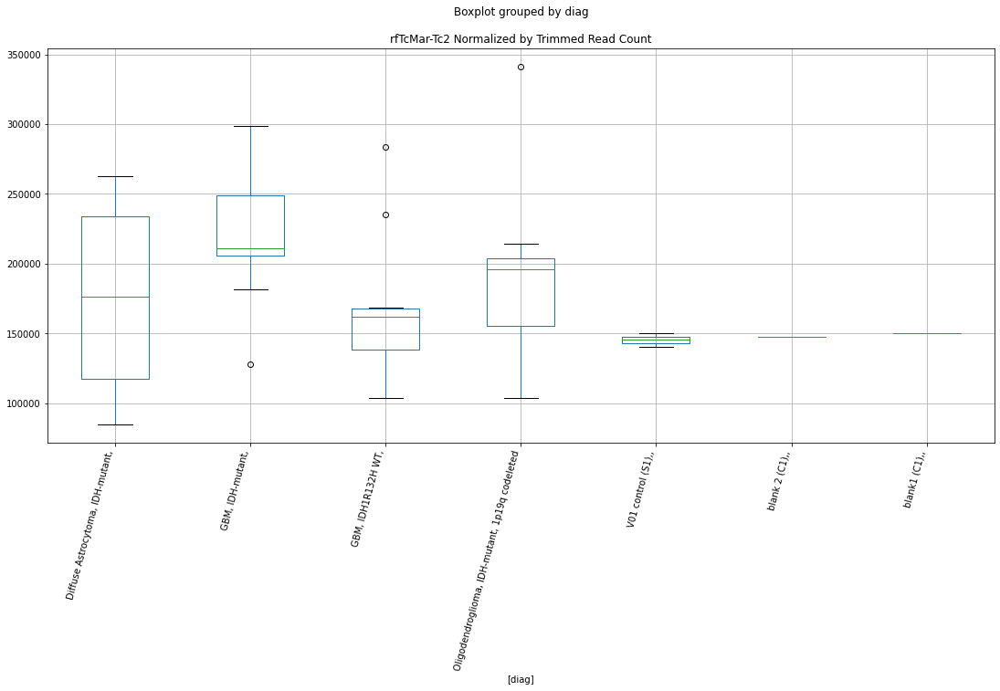

rfhAT D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1037924102762107
	p = 0.04971950998503305
rfhAT D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1037924102762107
	p = 0.04971950998503305


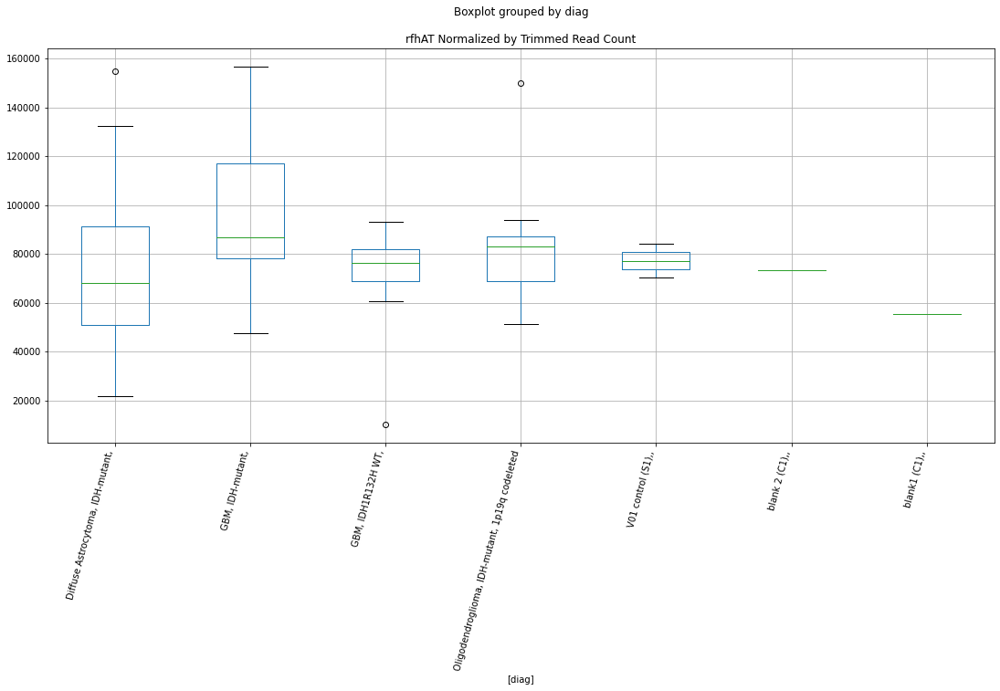

rfhAT D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1360919644188234
	p = 0.046660466890011215
rfhAT D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1360919644188234
	p = 0.046660466890011215


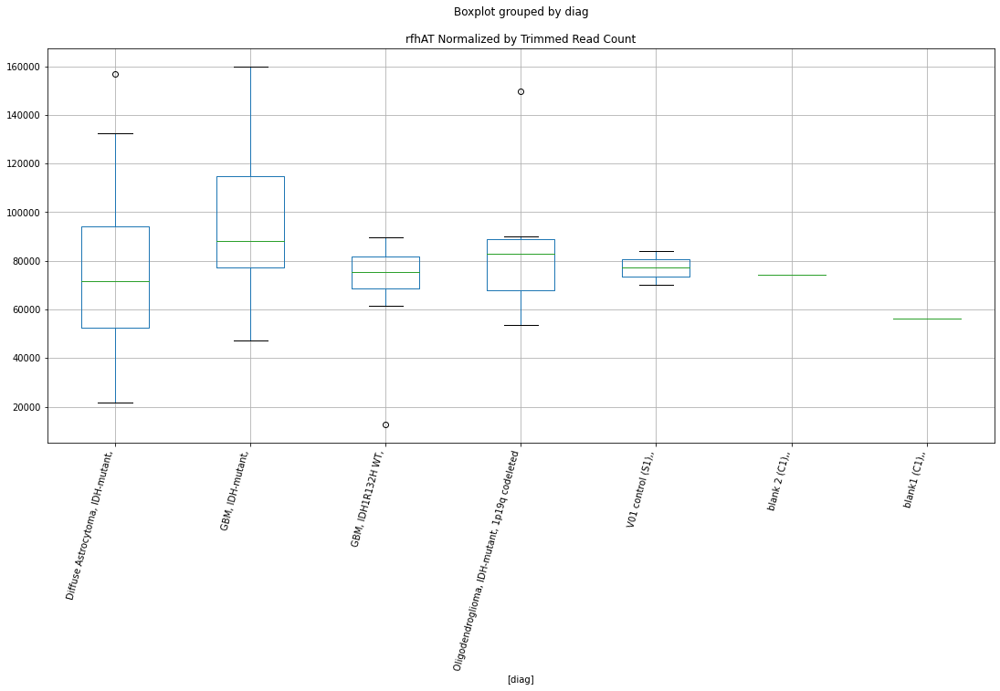

rfhAT D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = -2.0315573214681515
	p = 0.05723006918675334
rfhAT D-plex cutadapt1 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = 2.0315573214681515
	p = 0.05723006918675334


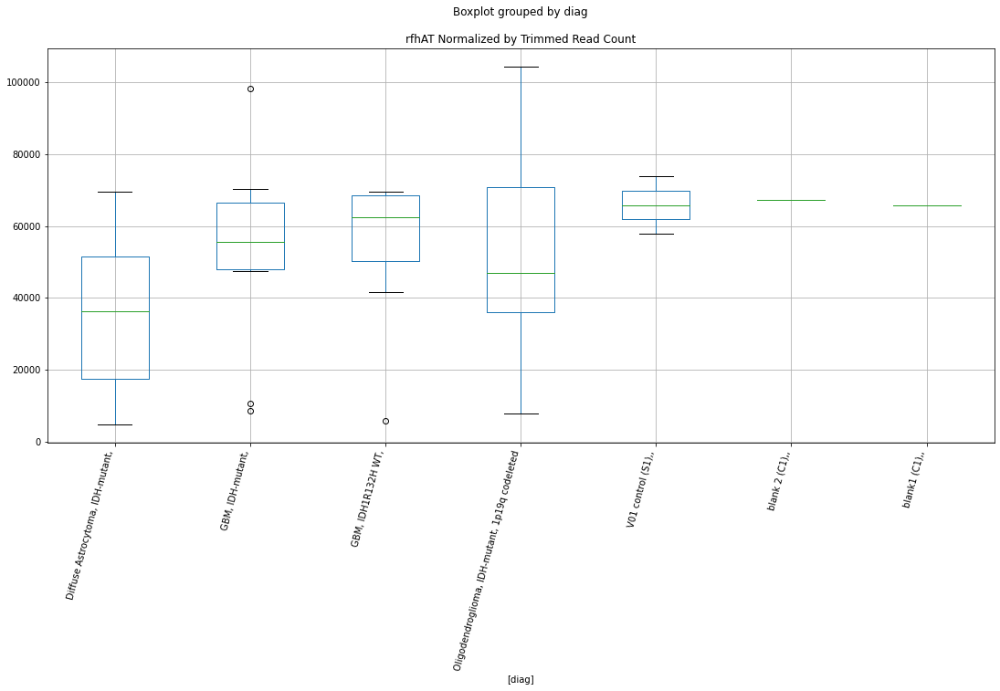

rfhAT D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = -1.93705350051633
	p = 0.06859495543965681
rfhAT D-plex cutadapt3 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.93705350051633
	p = 0.06859495543965681


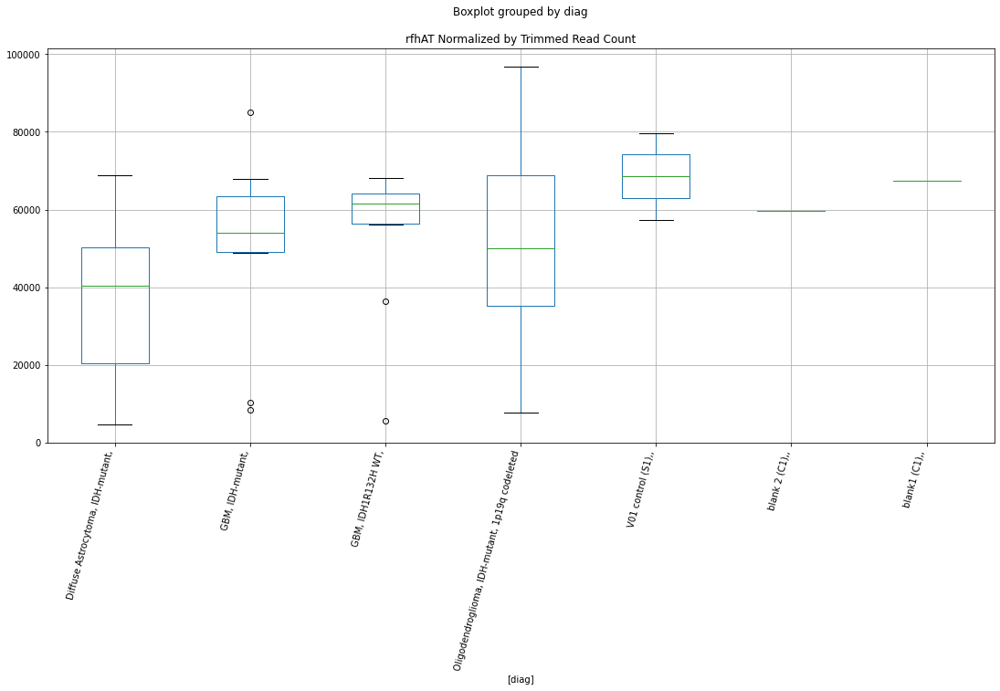

rfGypsy? D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8614014427744252
	p = 0.0790997858450715
rfGypsy? D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8614014427744252
	p = 0.0790997858450715


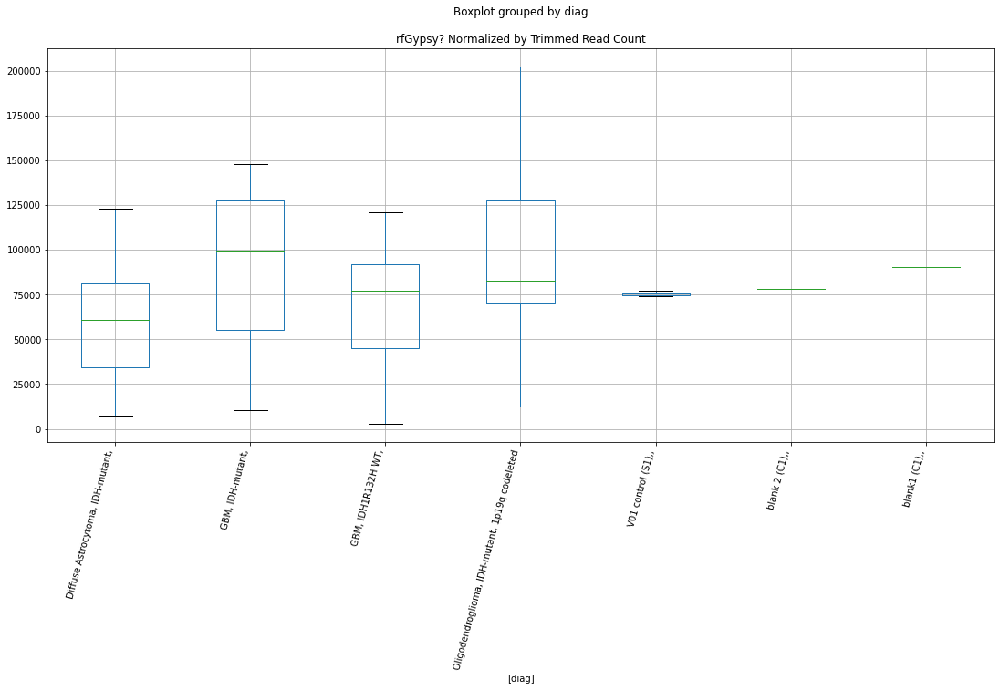

rfGypsy? D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7912265228152546
	p = 0.09008734484891487
rfGypsy? D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7912265228152546
	p = 0.09008734484891487


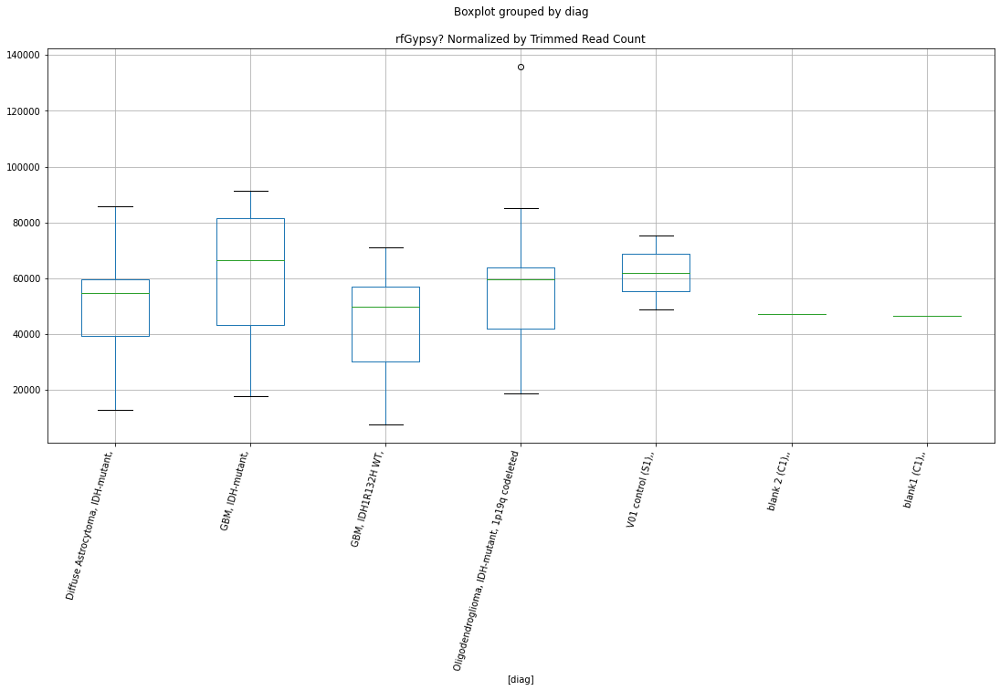

rfGypsy? D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.735873611069461
	p = 0.09967219955197455
rfGypsy? D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.735873611069461
	p = 0.09967219955197455


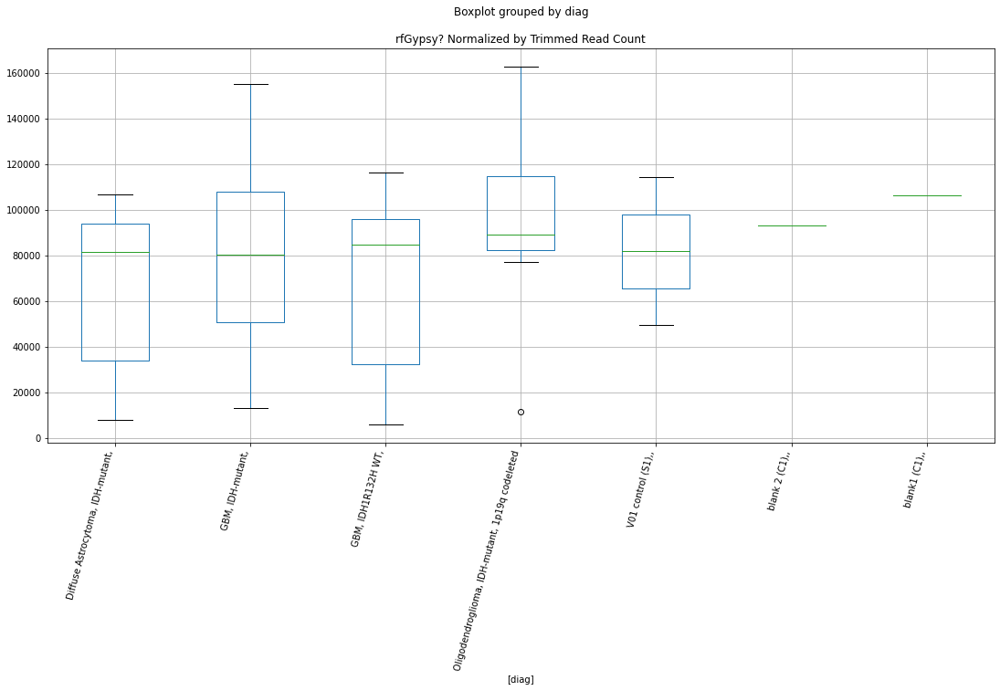

rfGypsy? D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.834334351955616
	p = 0.08318976943564485
rfGypsy? D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.834334351955616
	p = 0.08318976943564485


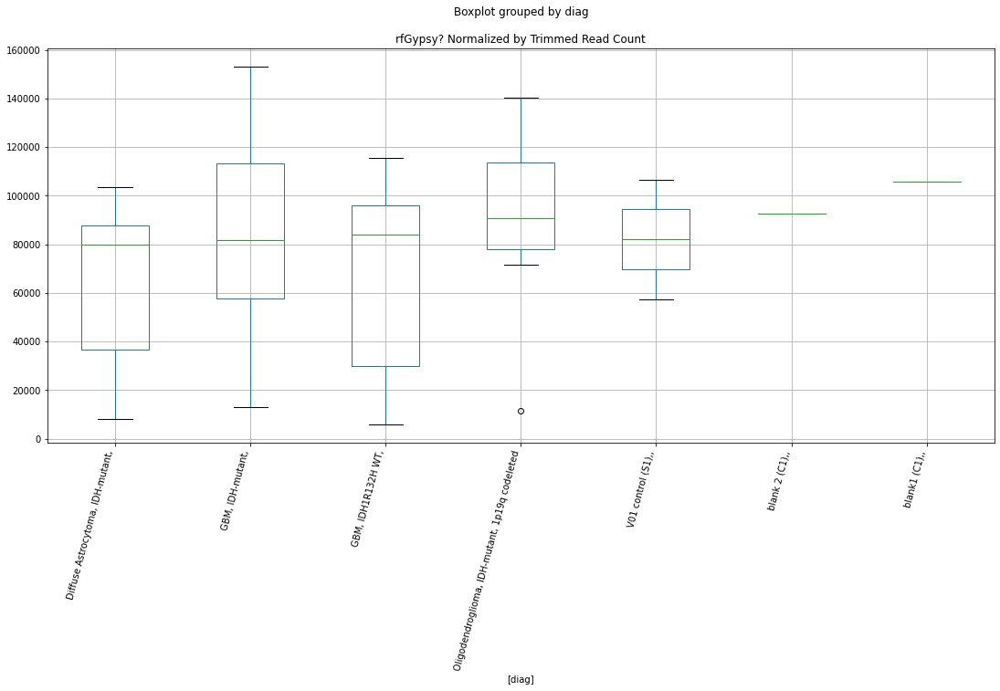

rfGypsy? D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.752587524129583
	p = 0.09668891867936318
rfGypsy? D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.752587524129583
	p = 0.09668891867936318


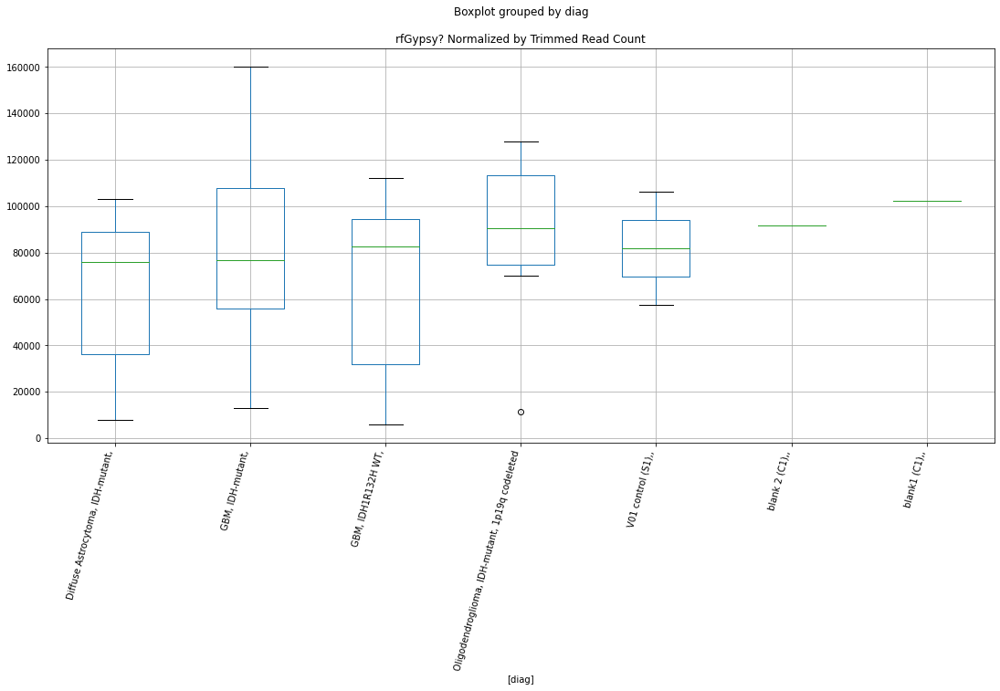

rftRNA D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.7410651329754043
	p = 0.09873714221395793
rftRNA D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7410651329754043
	p = 0.09873714221395793


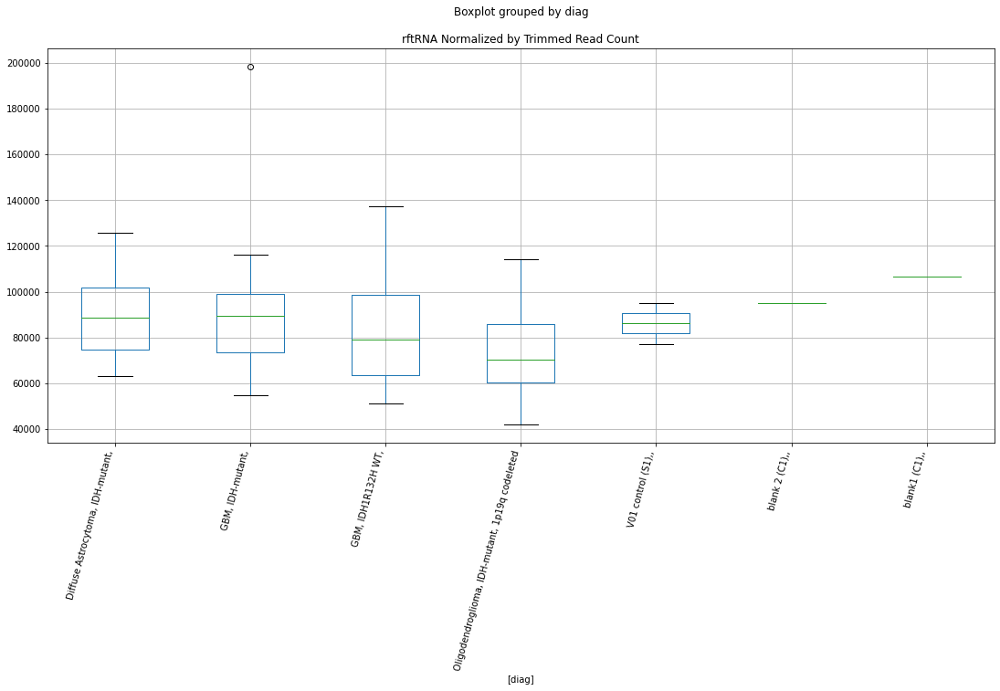

rfRTE-BovB D-plex bbduk1 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8258633250519063
	p = 0.0845074241091166
rfRTE-BovB D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.8258633250519063
	p = 0.0845074241091166
rfRTE-BovB D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7620456982048338
	p = 0.09503527265918005
rfRTE-BovB D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7620456982048338
	p = 0.09503527265918005


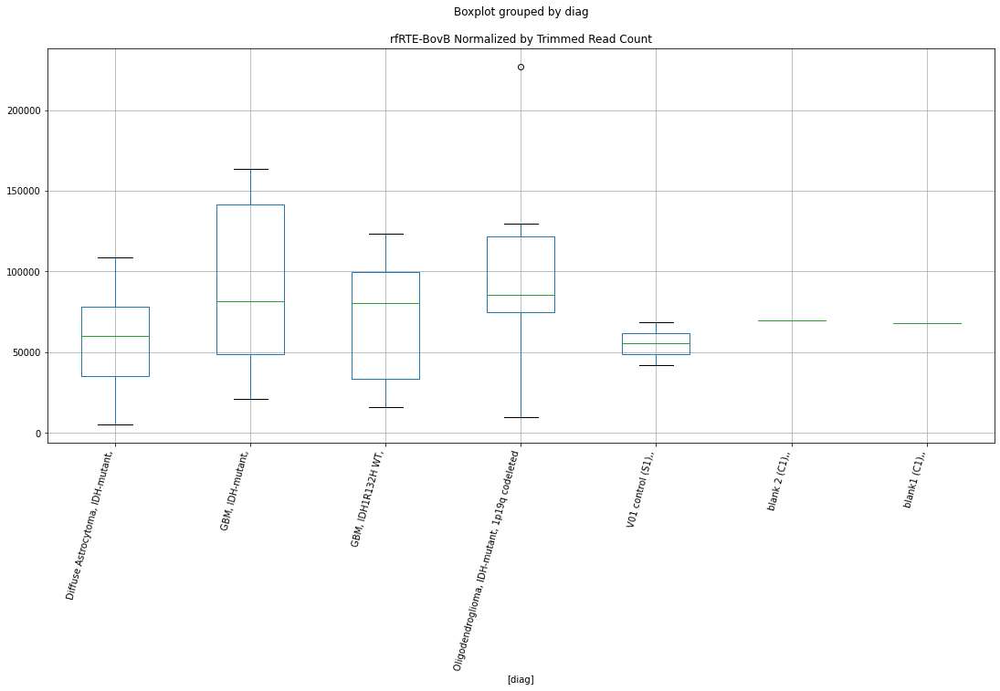

rfRTE-BovB D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.921641878669603
	p = 0.07062842350517594
rfRTE-BovB D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.921641878669603
	p = 0.07062842350517594


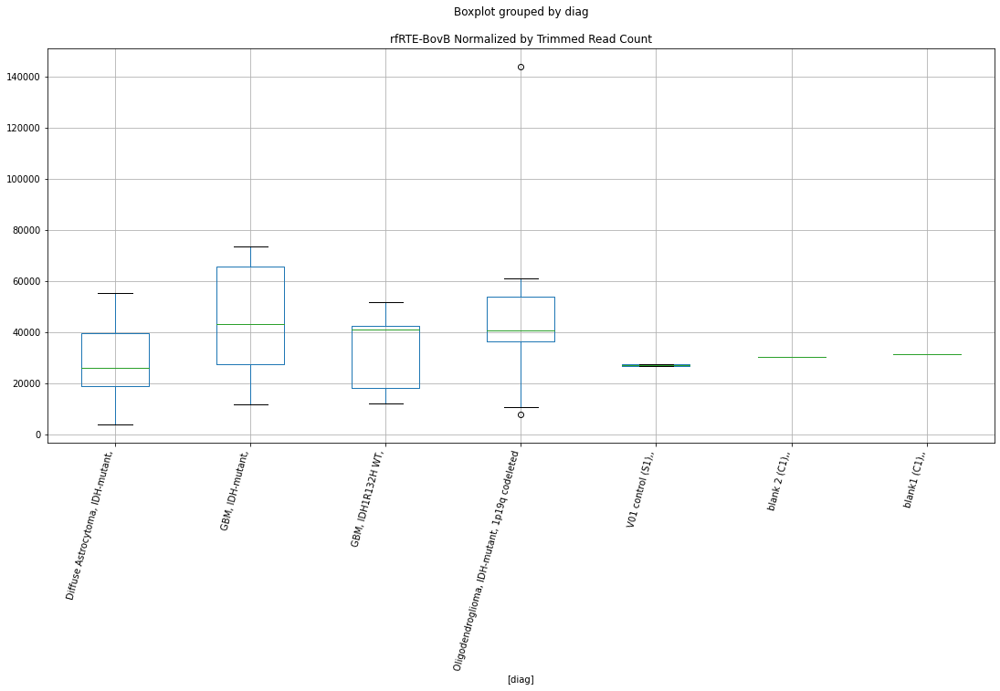

rfRTE-BovB D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9217491468760335
	p = 0.0706140867399682
rfRTE-BovB D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.9217491468760335
	p = 0.0706140867399682


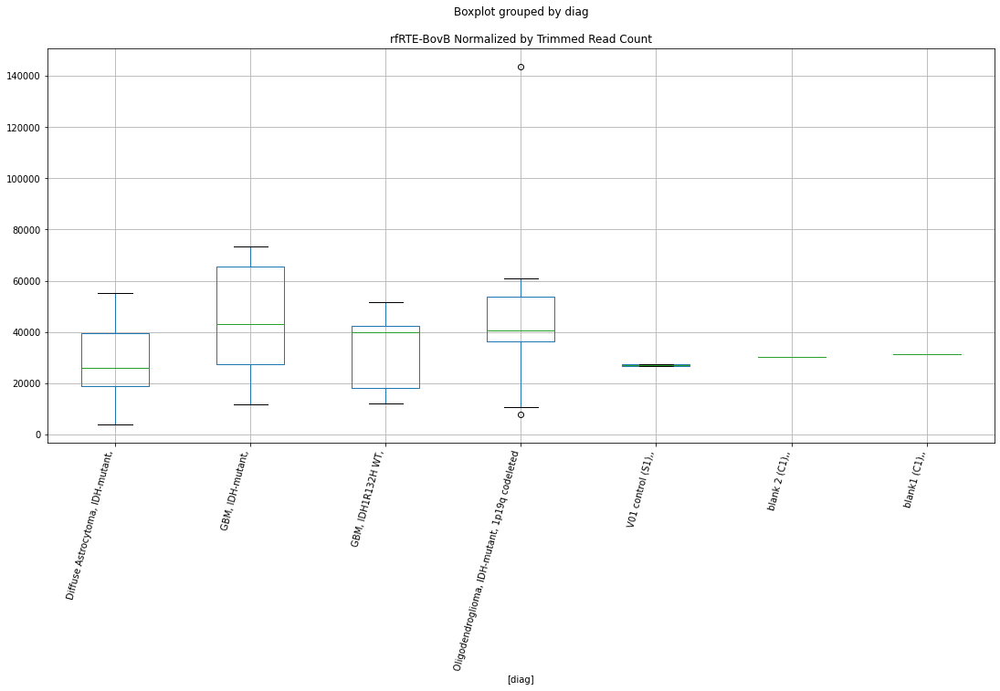

rfRTE-BovB D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7506447338185696
	p = 0.09703166558896702
rfRTE-BovB D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7506447338185696
	p = 0.09703166558896702


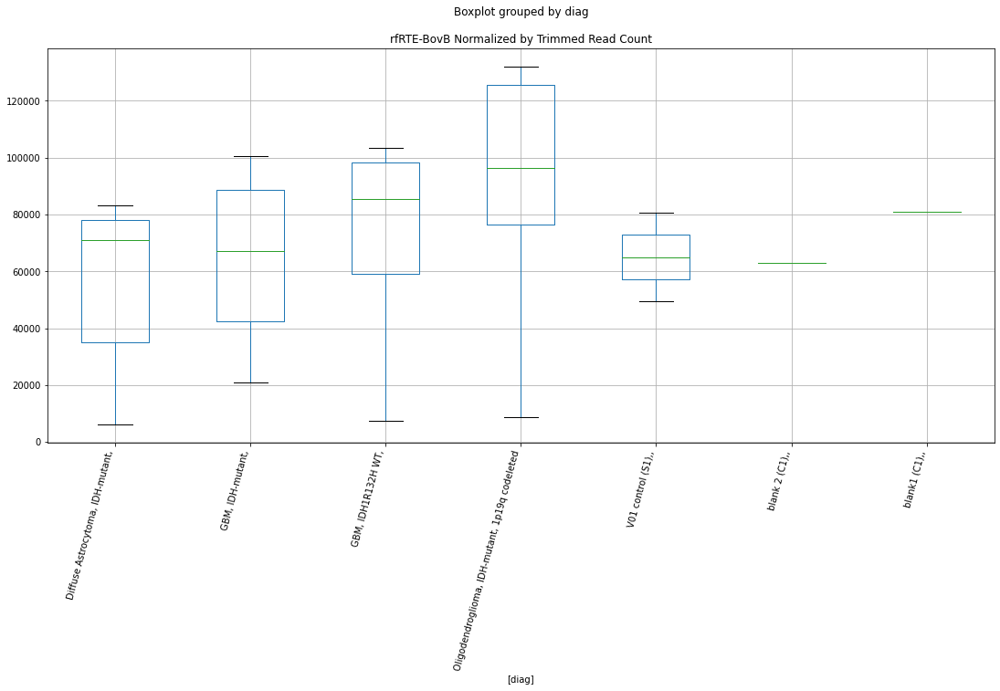

rfRTE-BovB D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7412323403423717
	p = 0.09870715274833779
rfRTE-BovB D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7412323403423717
	p = 0.09870715274833779


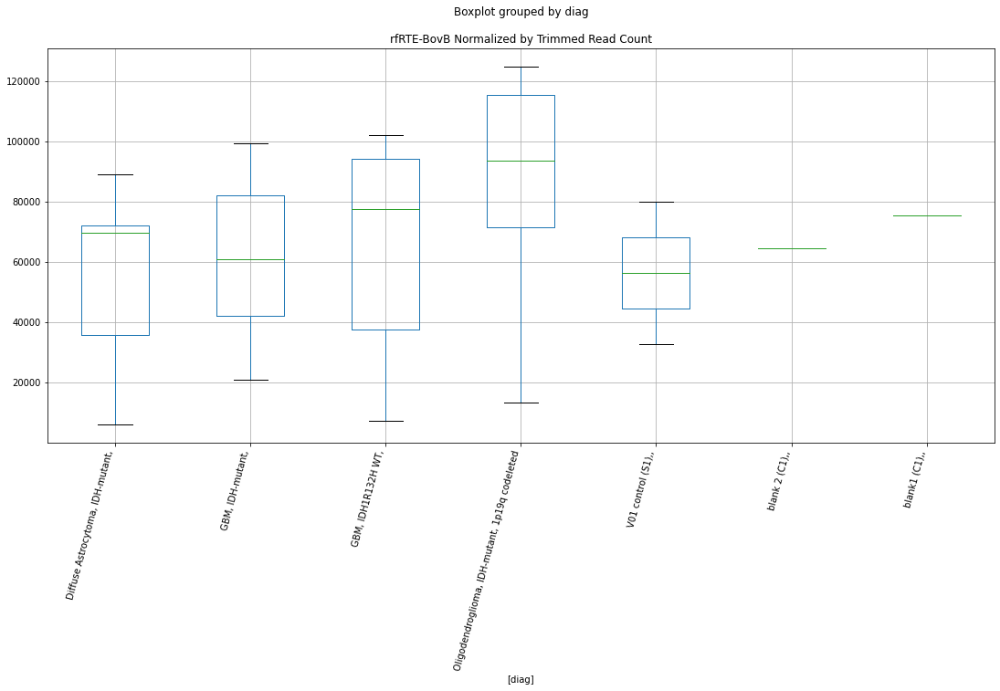

rfMULE-MuDR D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7575349205063175
	p = 0.0958208383767438
rfMULE-MuDR D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7575349205063175
	p = 0.0958208383767438


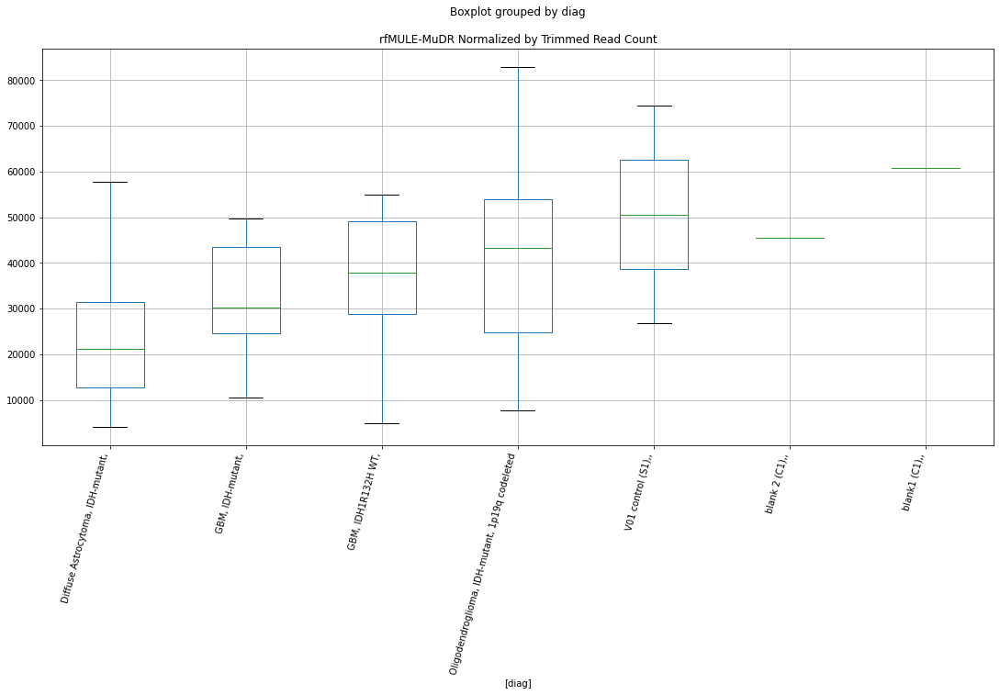

rfMULE-MuDR D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9357786011525475
	p = 0.06876116983345092
rfMULE-MuDR D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9357786011525475
	p = 0.06876116983345092


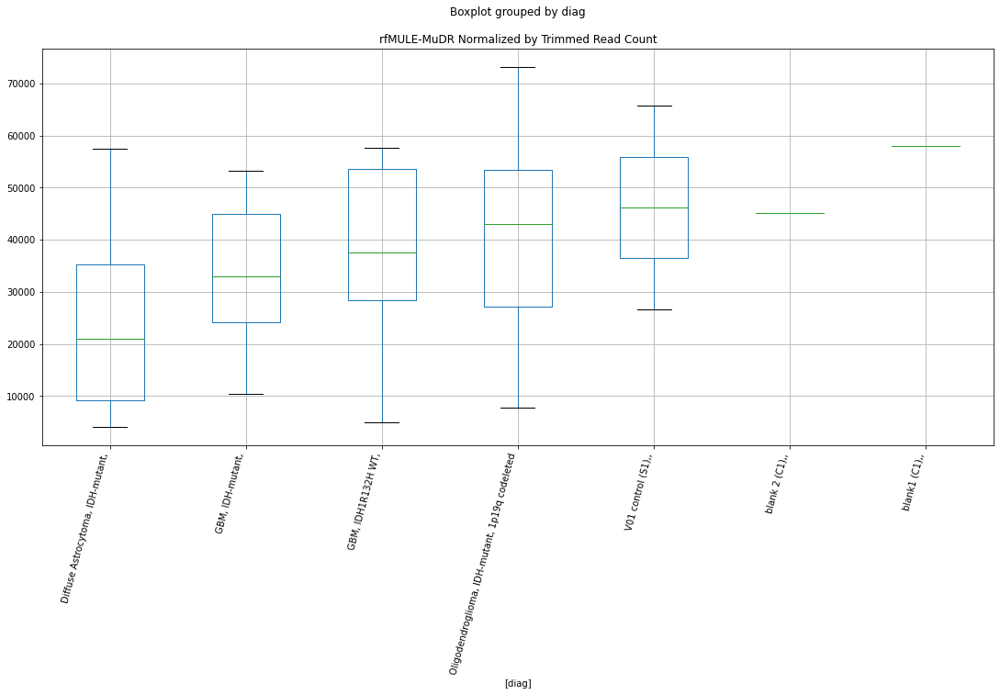

rfMULE-MuDR D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.893859495482283
	p = 0.07442987632326274
rfMULE-MuDR D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.893859495482283
	p = 0.07442987632326274


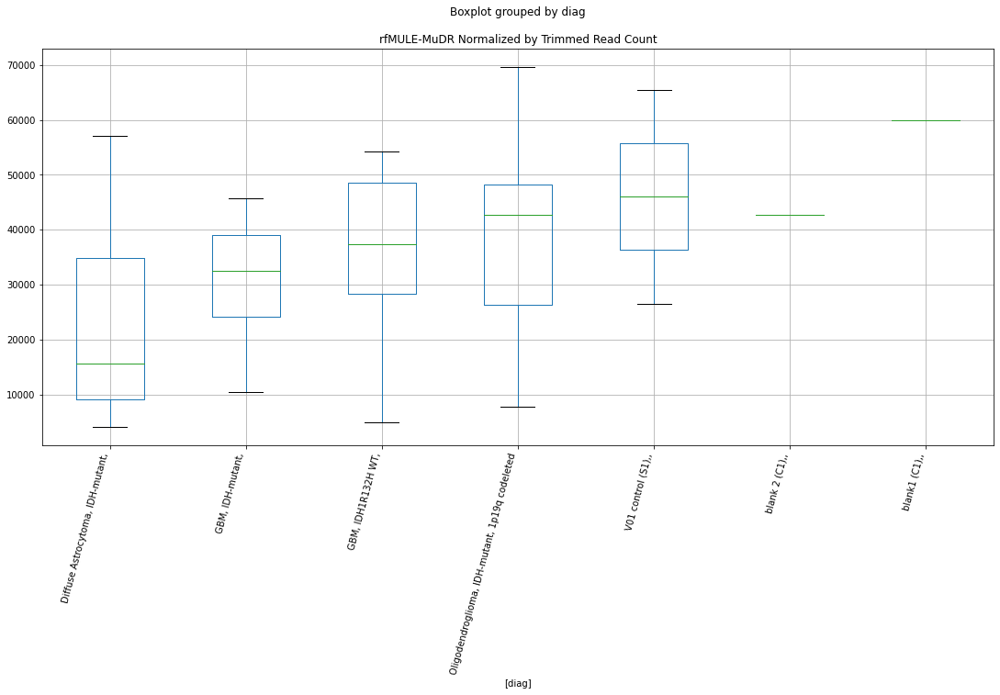

rftRNA-RTE D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9269789362677463
	p = 0.06991823944636087
rftRNA-RTE D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 1.9269789362677463
	p = 0.06991823944636087


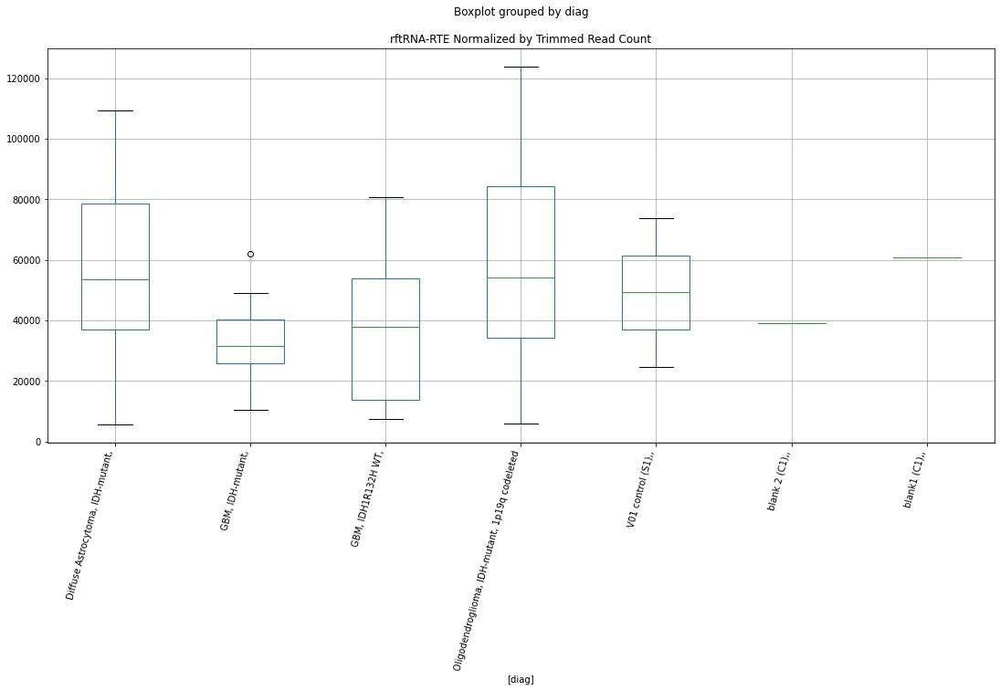

rftRNA-RTE D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.054205171572613
	p = 0.05477168068944061
rftRNA-RTE D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.054205171572613
	p = 0.05477168068944061


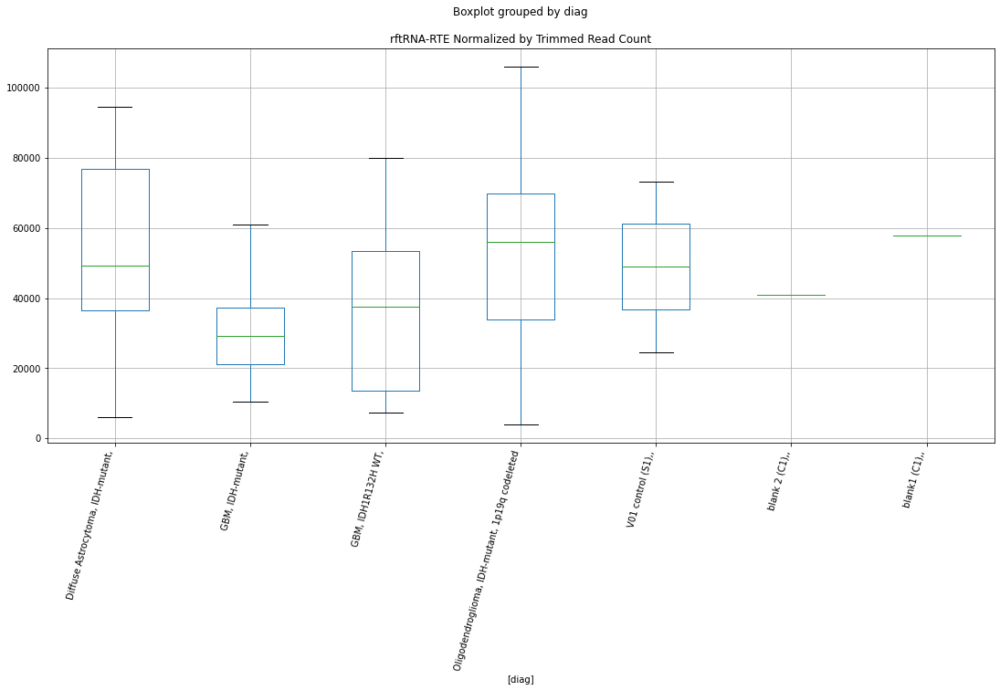

rftRNA-RTE D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.045137740176682
	p = 0.055744250089319596
rftRNA-RTE D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.045137740176682
	p = 0.055744250089319596


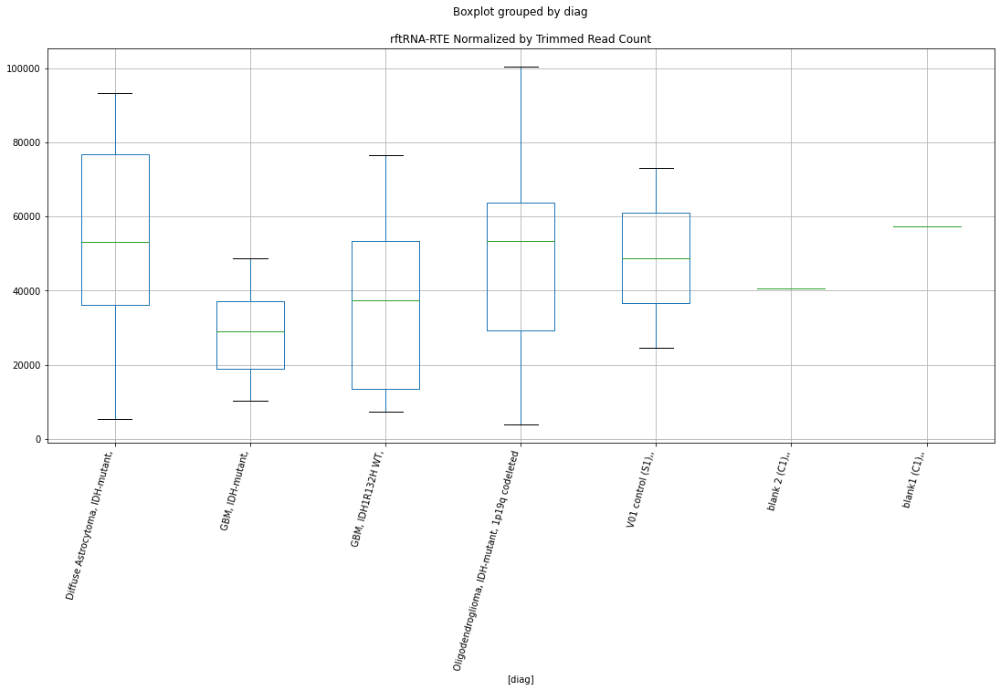

rfPiggyBac D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7409806364265805
	p = 0.09875230008682107
rfPiggyBac D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7409806364265805
	p = 0.09875230008682107


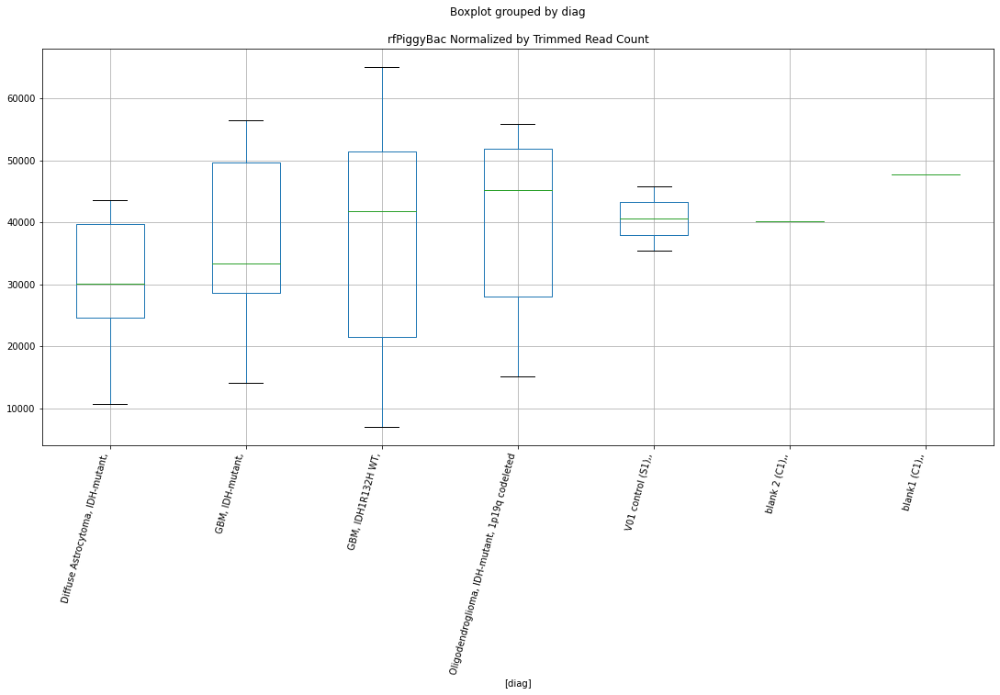

rfPiggyBac D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.198040043513818
	p = 0.04126943424820591
rfPiggyBac D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.198040043513818
	p = 0.04126943424820591


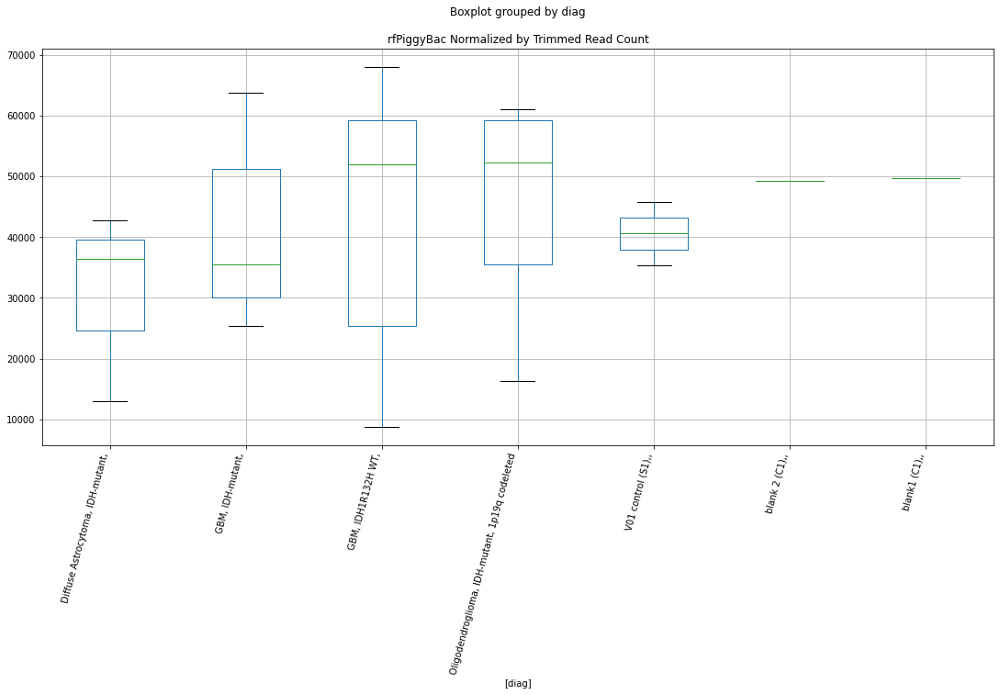

rfacro D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7560371595723838
	p = 0.09608292182125974
rfacro D-plex bbduk1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7560371595723838
	p = 0.09608292182125974


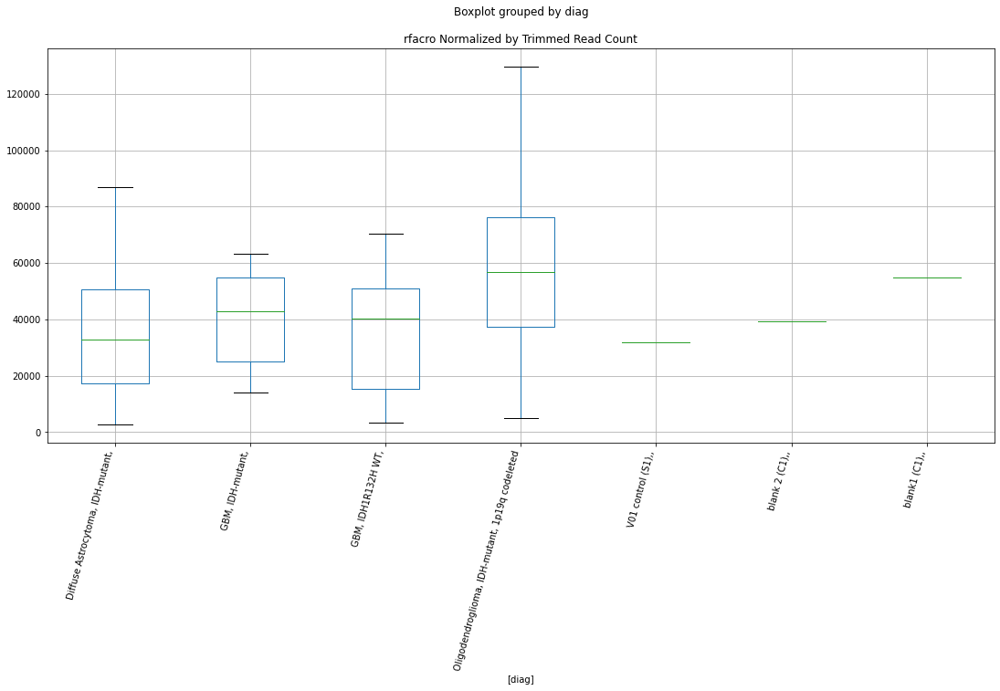

rfacro D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7567575671298676
	p = 0.09595678482771294
rfacro D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7567575671298676
	p = 0.09595678482771294
rfacro D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7511654890156803
	p = 0.0969396907934082
rfacro D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7511654890156803
	p = 0.0969396907934082


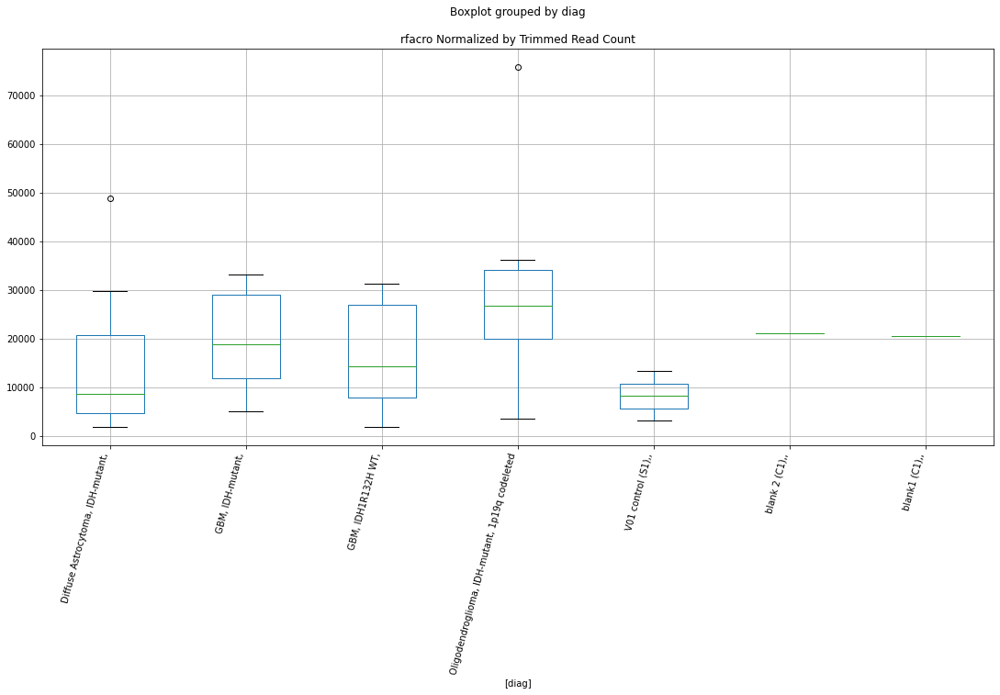

rfacro D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7559925448648432
	p = 0.09609073819205527
rfacro D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7559925448648432
	p = 0.09609073819205527
rfacro D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.750620105098504
	p = 0.09703601734024456
rfacro D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.750620105098504
	p = 0.09703601734024456


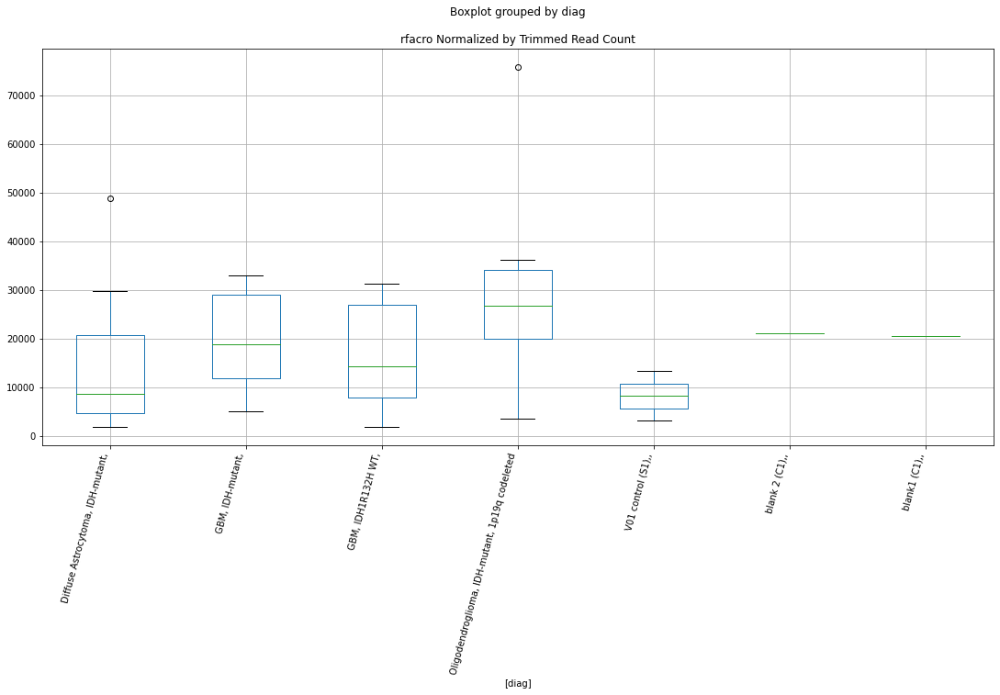

rfacro D-plex cutadapt1 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.4303151110410988
	p = 0.025769118786005518
rfacro D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.209501153559532
	p = 0.04033699130830451
rfacro D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.4303151110410988
	p = 0.025769118786005518
rfacro D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.209501153559532
	p = 0.04033699130830451


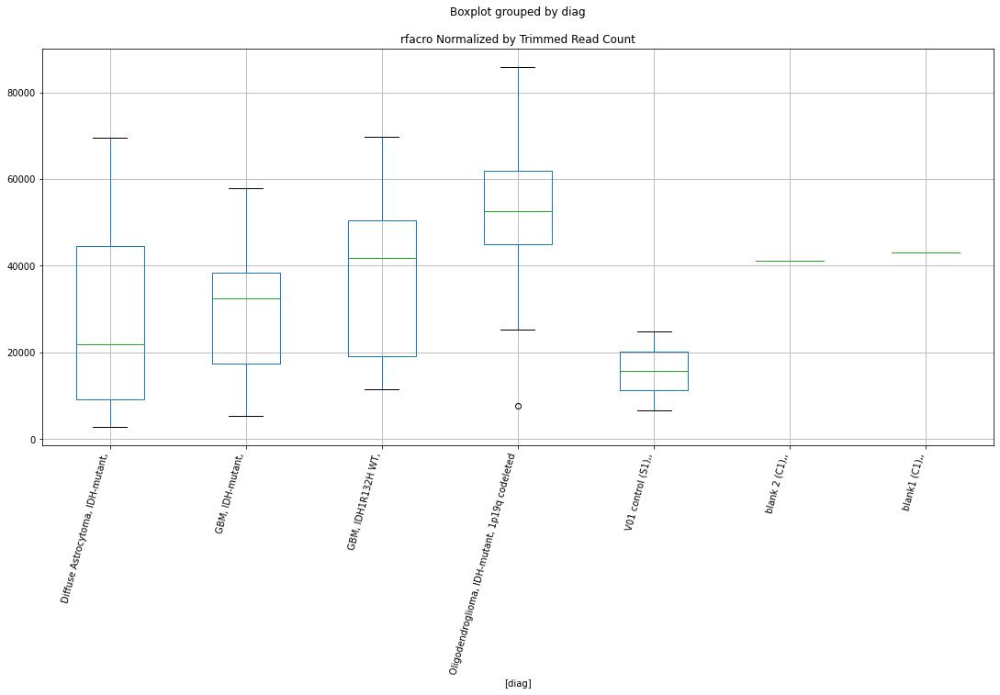

rfacro D-plex cutadapt2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.509198517321994
	p = 0.02188530546114818
rfacro D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.595007928499135
	p = 0.018290275585009955
rfacro D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.509198517321994
	p = 0.02188530546114818
rfacro D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.595007928499135
	p = 0.018290275585009955


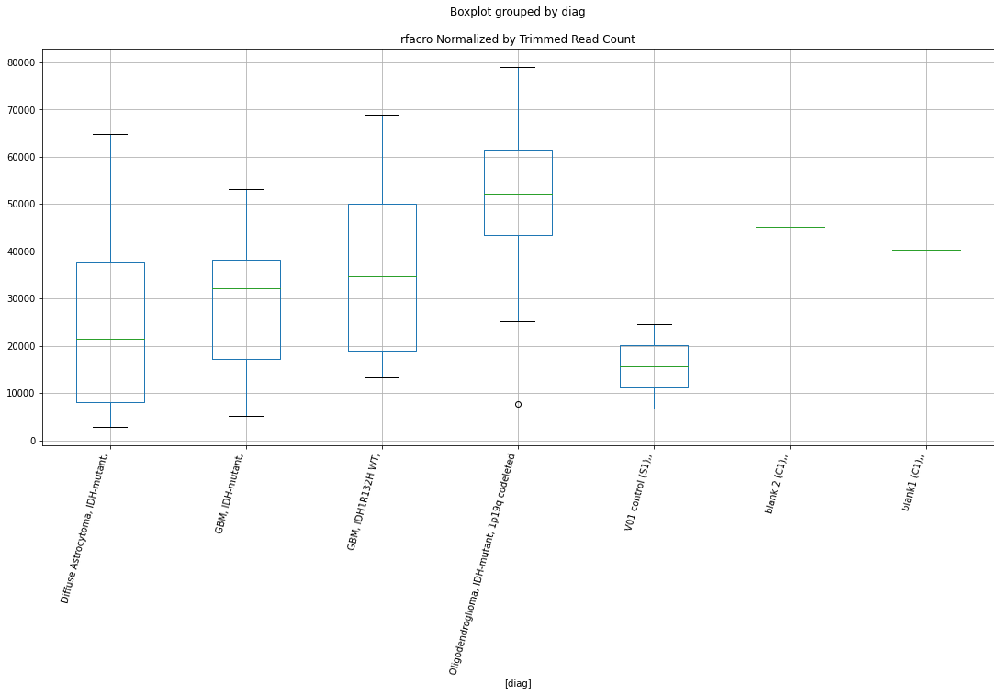

rfacro D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.644076846059553
	p = 0.016493998793195307
rfacro D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.5622467896921517
	p = 0.01959128999126579
rfacro D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.644076846059553
	p = 0.016493998793195307
rfacro D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 2.5622467896921517
	p = 0.01959128999126579


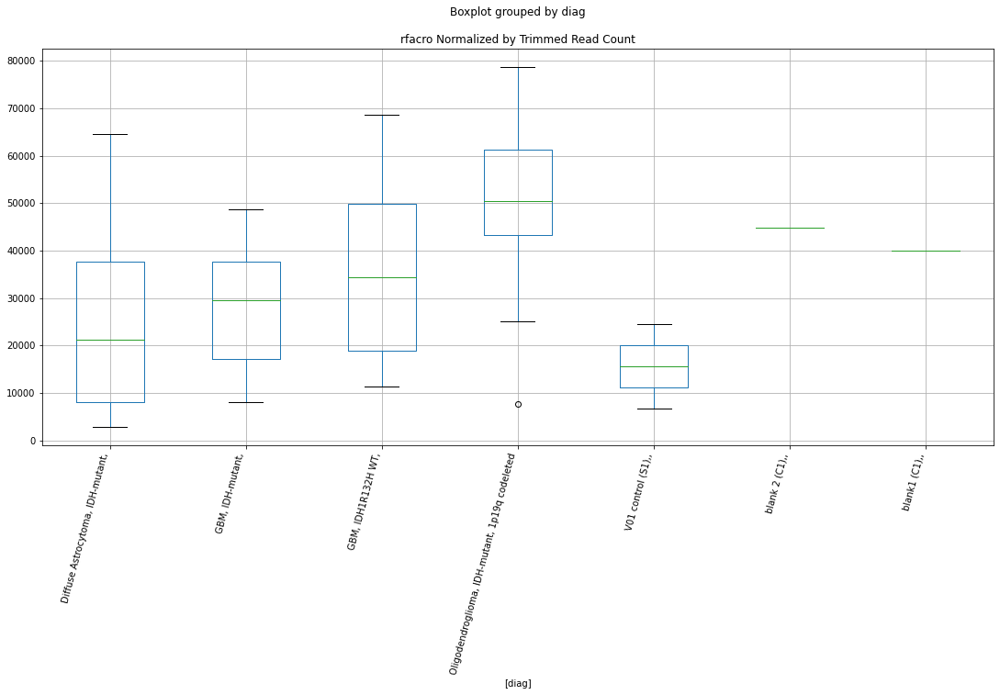

In [85]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmsk_families:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Trimmed Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


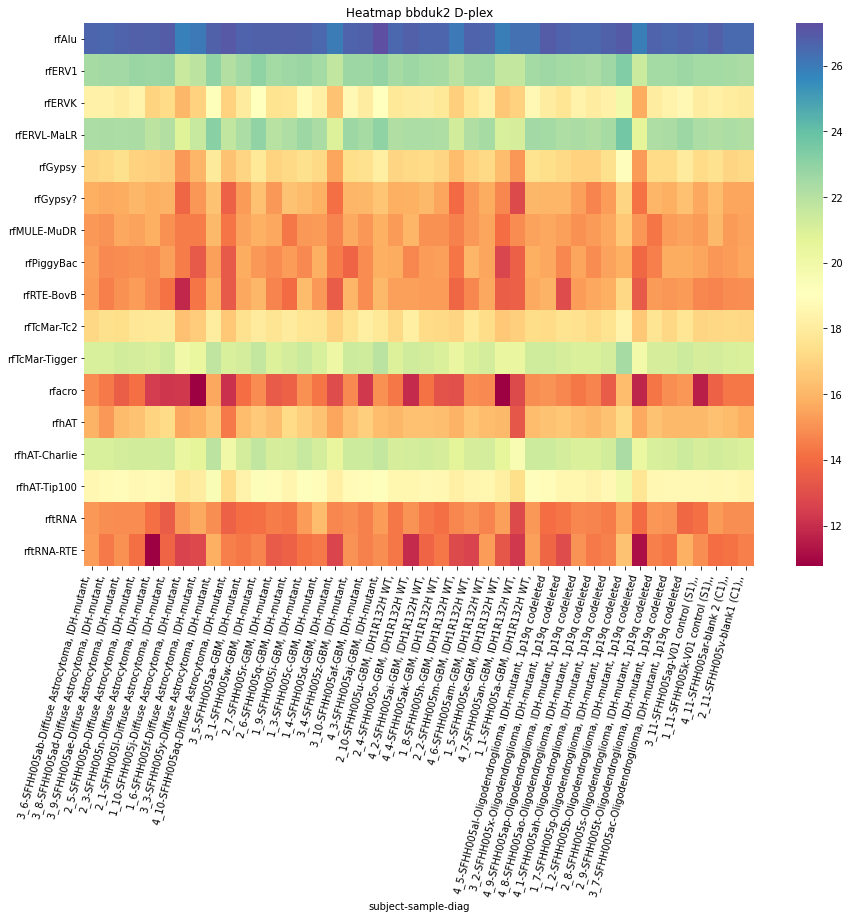

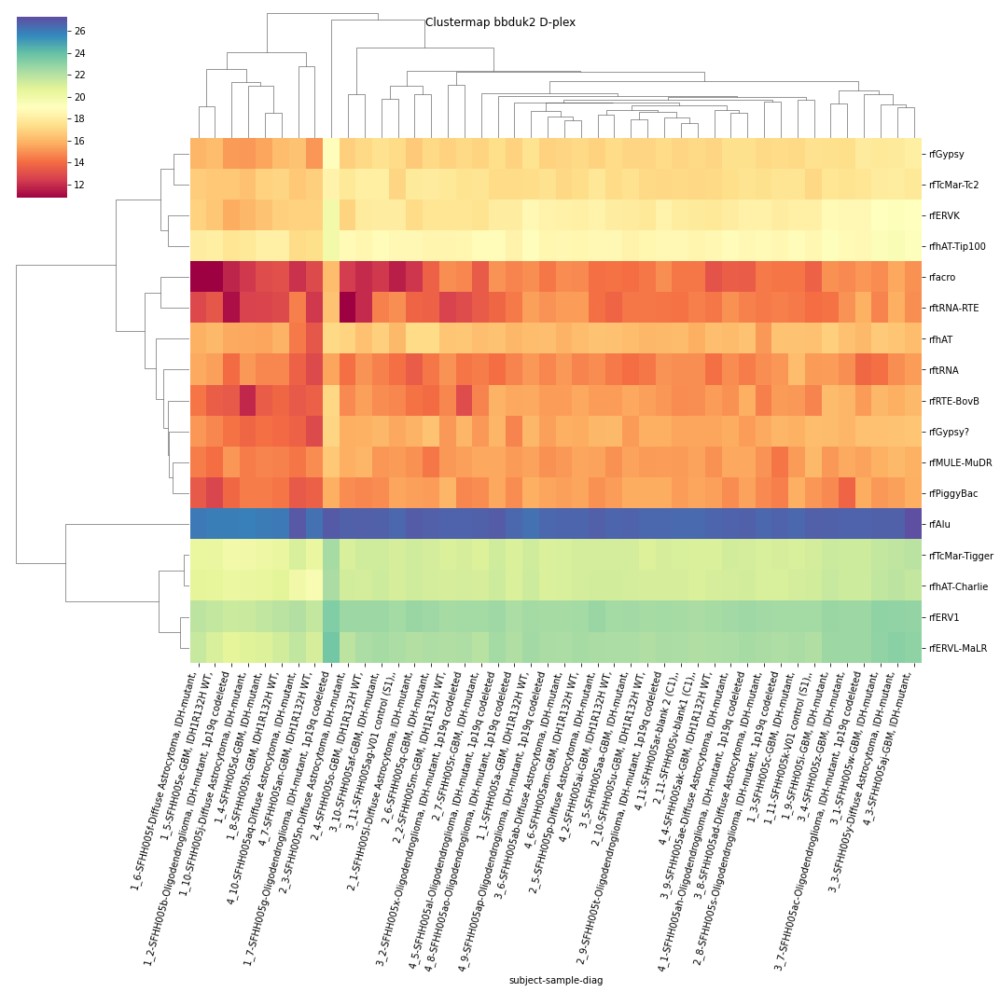

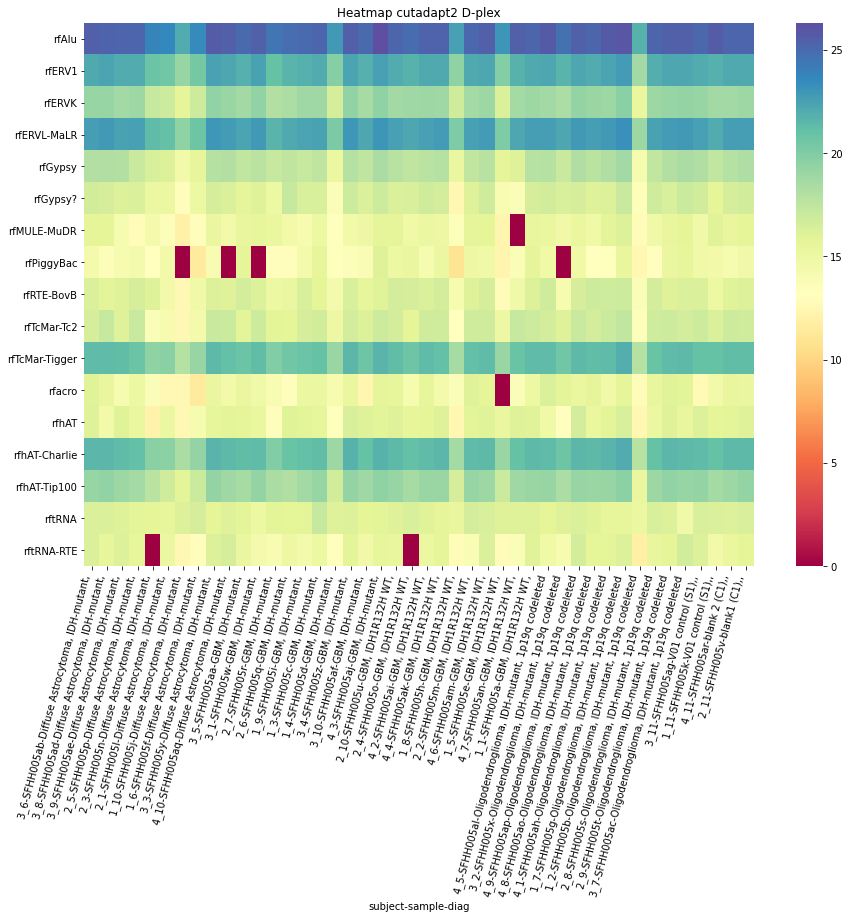

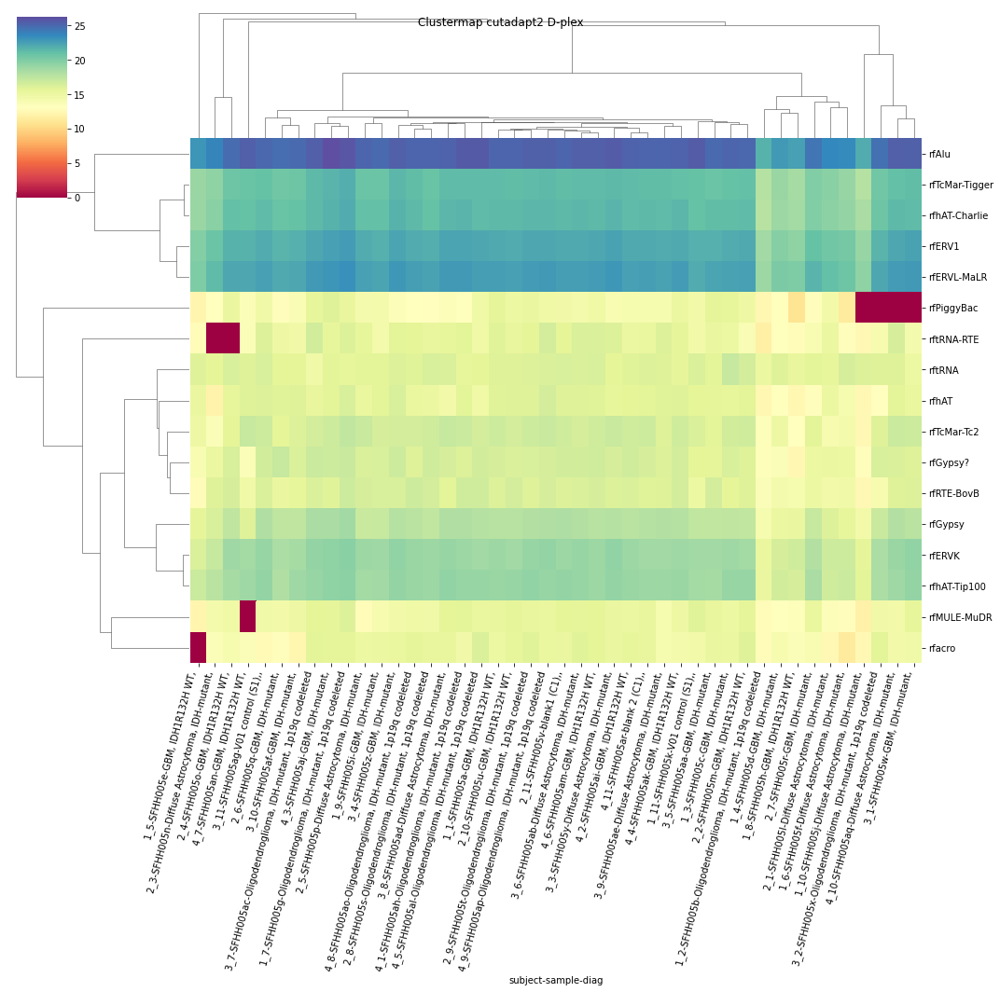

In [86]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

rcSINE D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9763383488863646
	p = 0.06364577419405375
rcSINE D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9763383488863646
	p = 0.06364577419405375


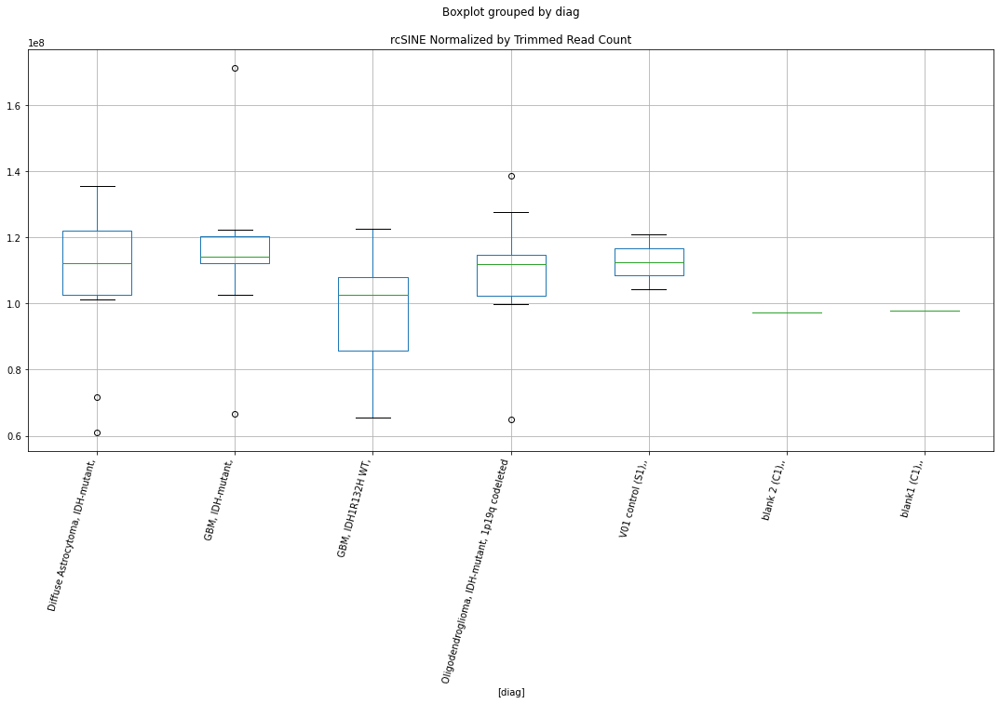

rcSINE D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.97386978878524
	p = 0.06394709545376447
rcSINE D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.97386978878524
	p = 0.06394709545376447


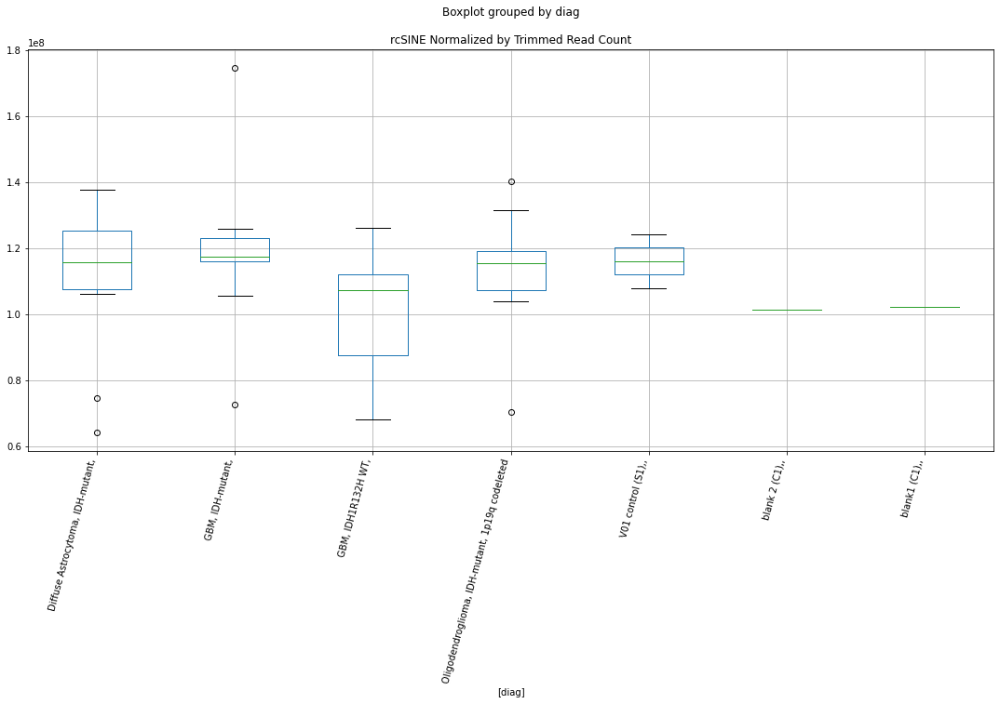

rcLTR D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8423722198737218
	p = 0.08195621468873006
rcLTR D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8423722198737218
	p = 0.08195621468873006


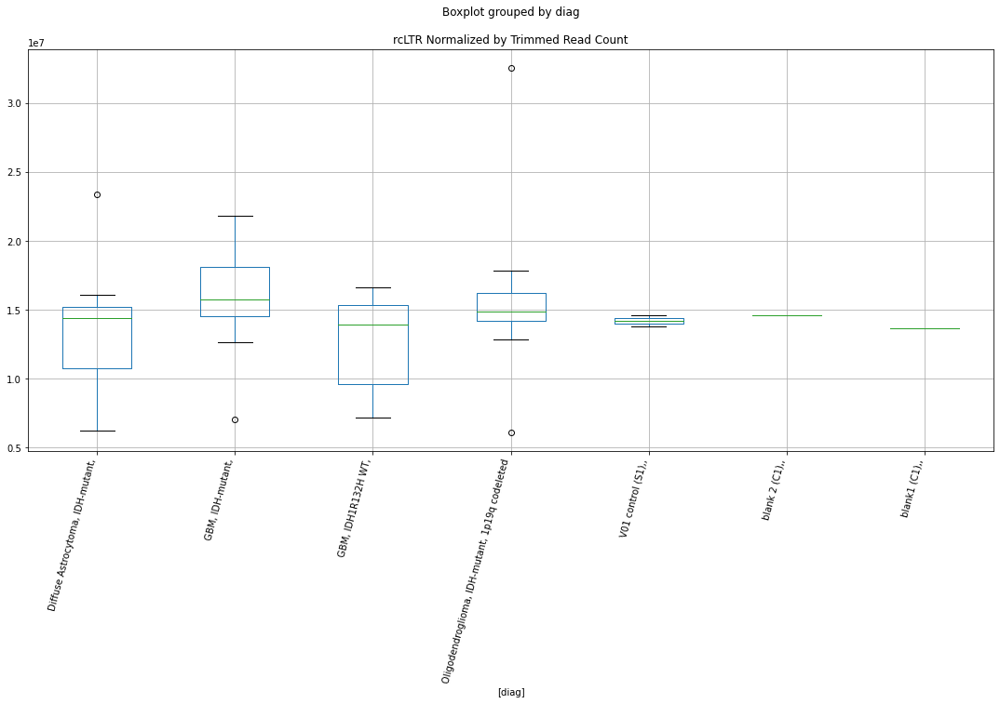

rcLTR D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8618655122711987
	p = 0.07903123558841497
rcLTR D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8618655122711987
	p = 0.07903123558841497


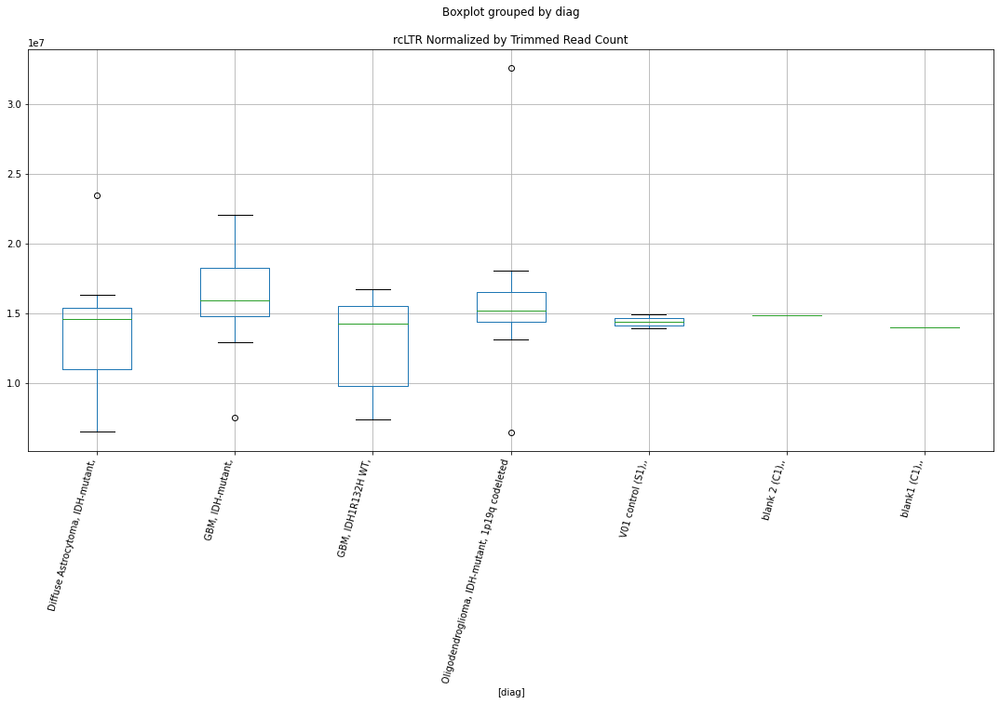

rcDNA D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9896032771852403
	p = 0.06204828925084287
rcDNA D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9896032771852403
	p = 0.06204828925084287


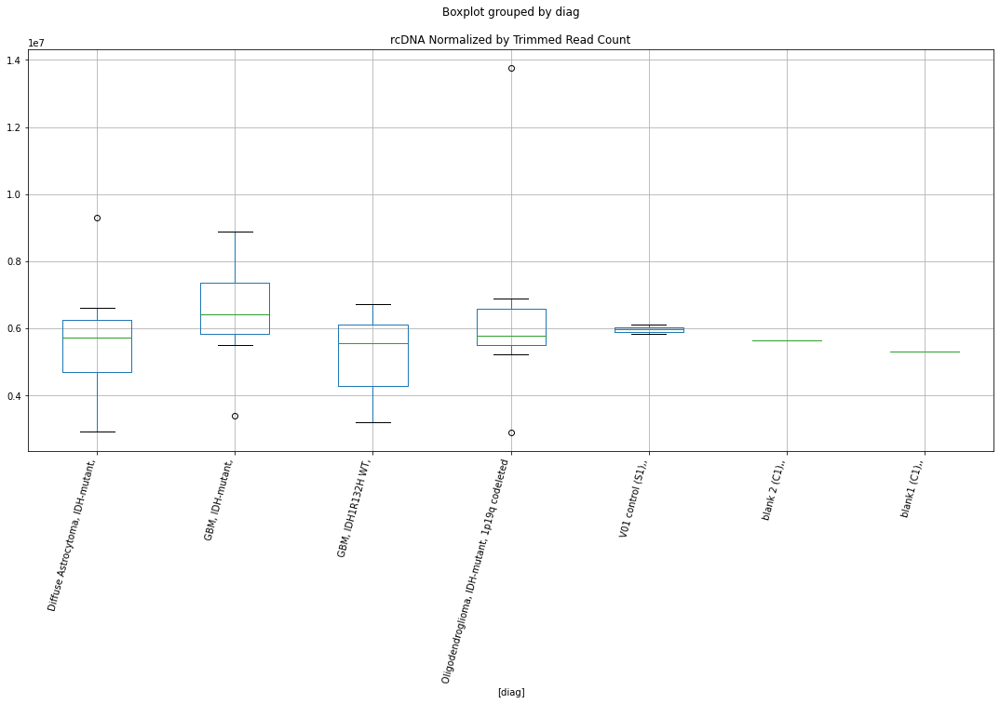

rcDNA D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9401683469558753
	p = 0.06819036405541824
rcDNA D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9401683469558753
	p = 0.06819036405541824


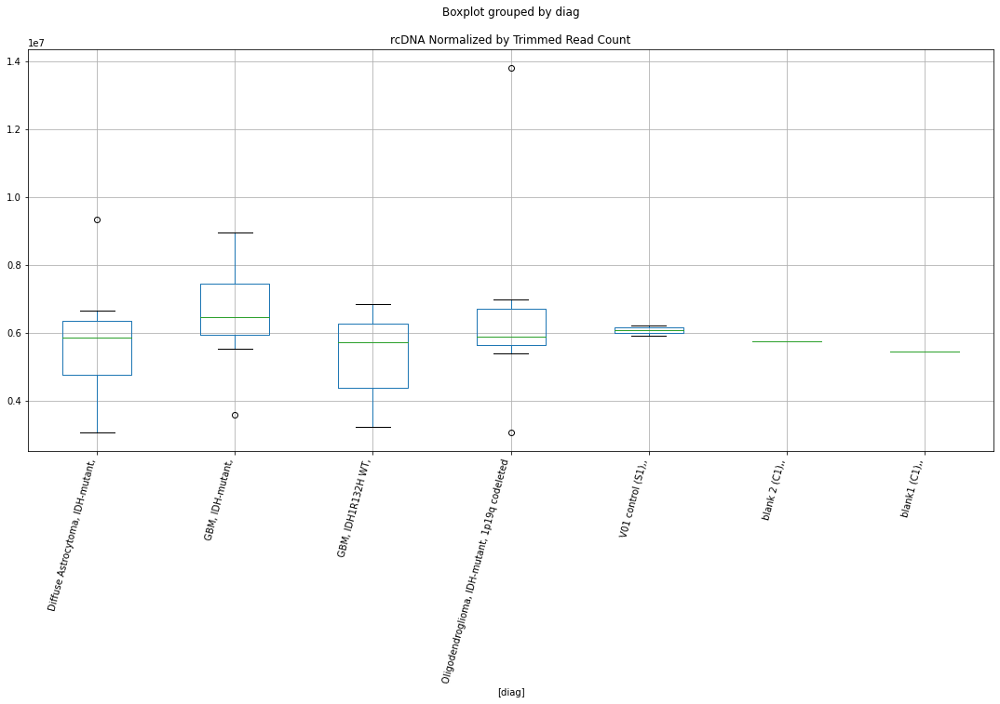

rctRNA D-plex bbduk1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.140742394471921
	p = 0.04623444930264102
rctRNA D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.140742394471921
	p = 0.04623444930264102
rctRNA D-plex bbduk1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -2.0443272198143037
	p = 0.055831941334429355
rctRNA D-plex bbduk1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0443272198143037
	p = 0.055831941334429355


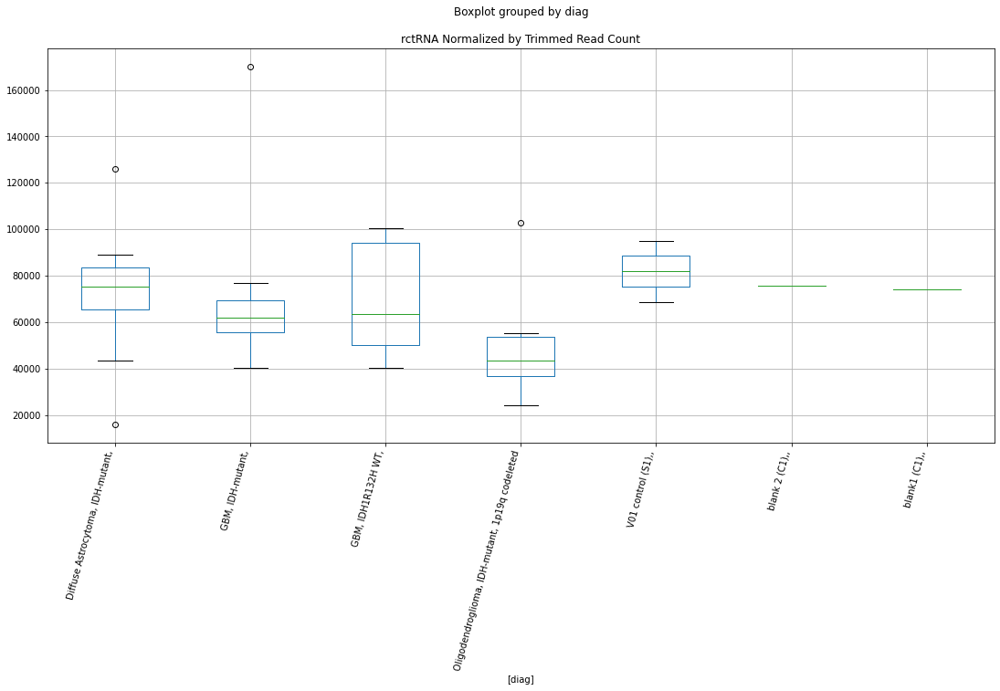

rctRNA D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0069916708940765
	p = 0.06000874012098234
rctRNA D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.0069916708940765
	p = 0.06000874012098234


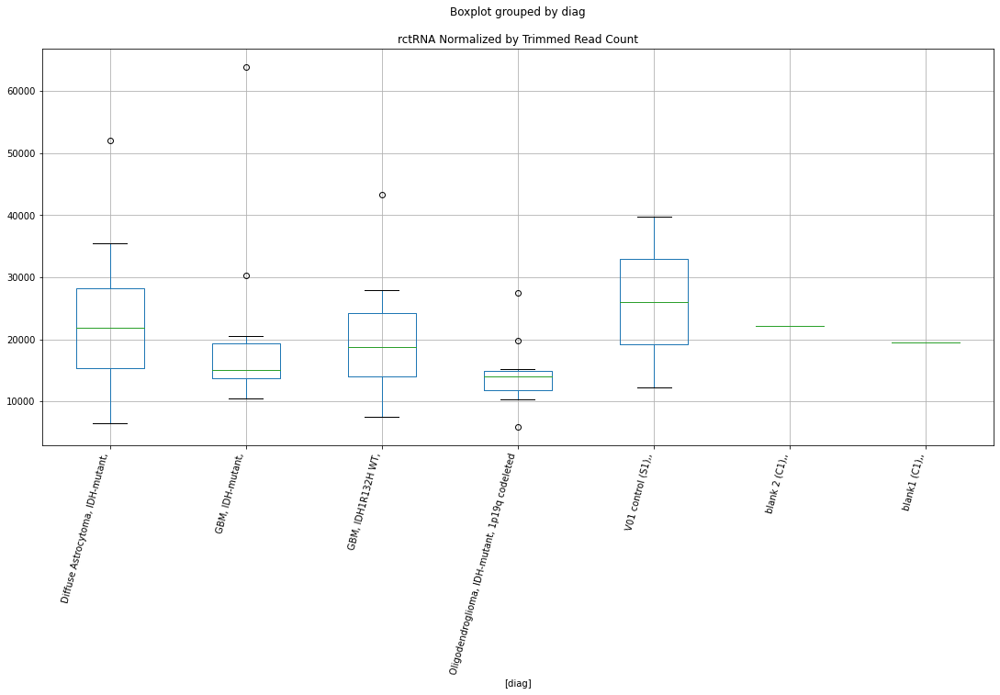

rctRNA D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0606024021377394
	p = 0.054094773733957345
rctRNA D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.0606024021377394
	p = 0.054094773733957345


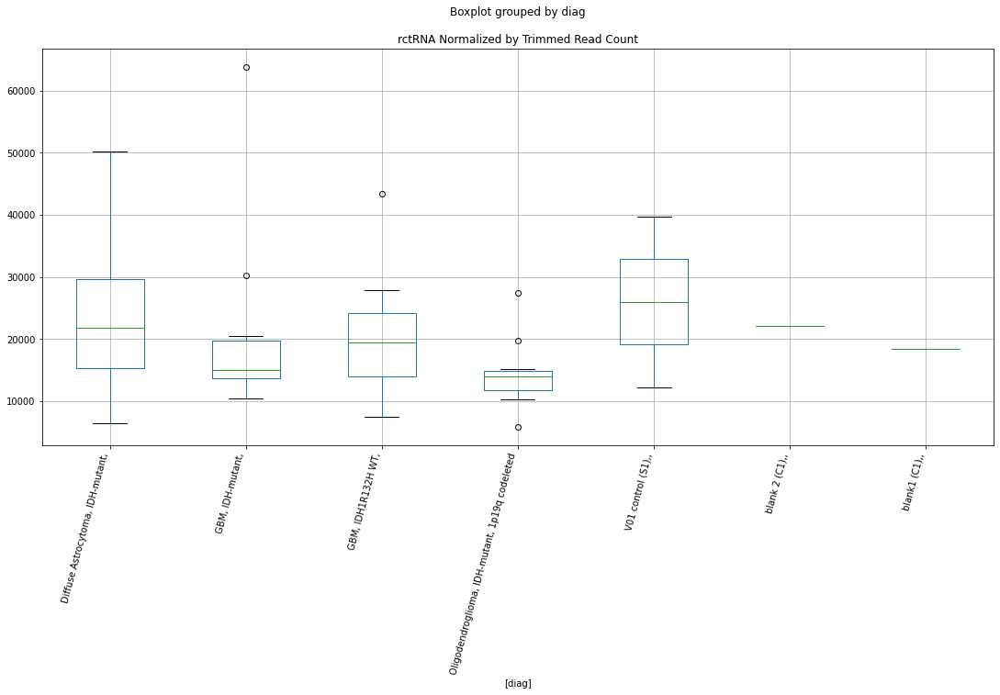

rctRNA D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.5344502655974424
	p = 0.020763375566700177
rctRNA D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.5344502655974424
	p = 0.020763375566700177
rctRNA D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -2.967844524721744
	p = 0.008241451332669316
rctRNA D-plex cutadapt1 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.967844524721744
	p = 0.008241451332669316


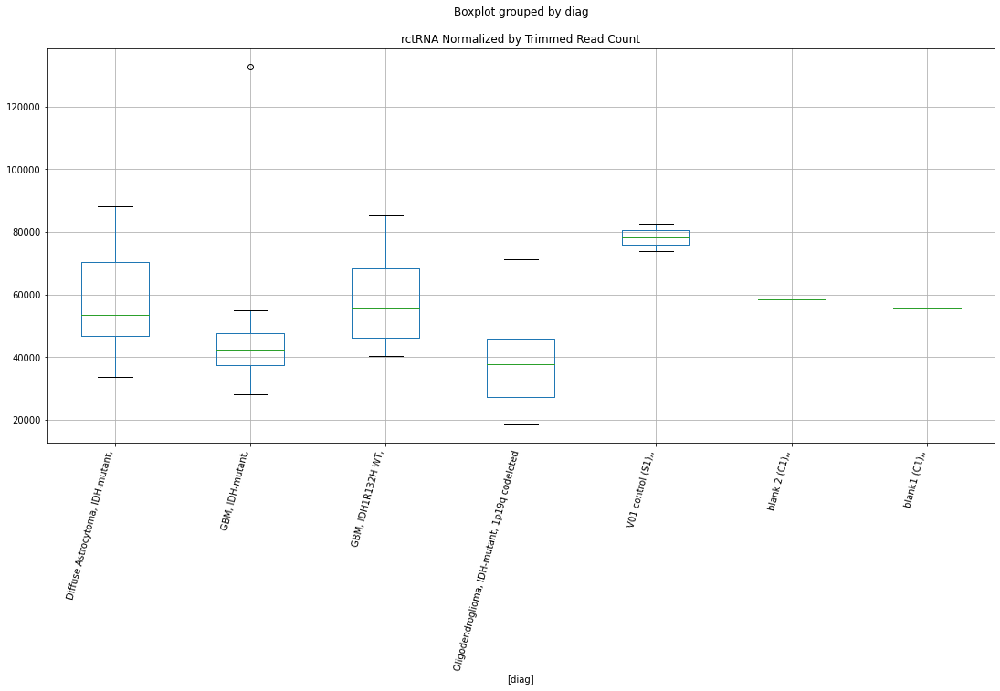

rctRNA D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.063066090047301
	p = 0.05383610988499123
rctRNA D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.063066090047301
	p = 0.05383610988499123
rctRNA D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -2.944637537098002
	p = 0.008666780062380254
rctRNA D-plex cutadapt2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.944637537098002
	p = 0.008666780062380254


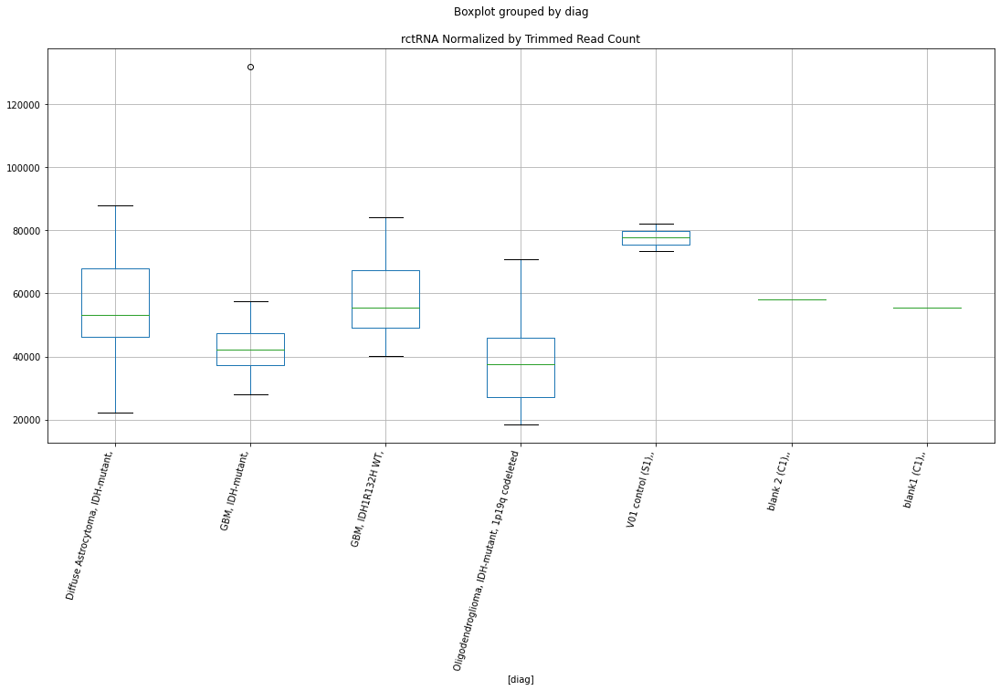

rctRNA D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.0327241081623257
	p = 0.05710102349125425
rctRNA D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = -2.0327241081623257
	p = 0.05710102349125425
rctRNA D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = -2.5712262187847688
	p = 0.01922623296196611
rctRNA D-plex cutadapt3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 2.5712262187847688
	p = 0.01922623296196611


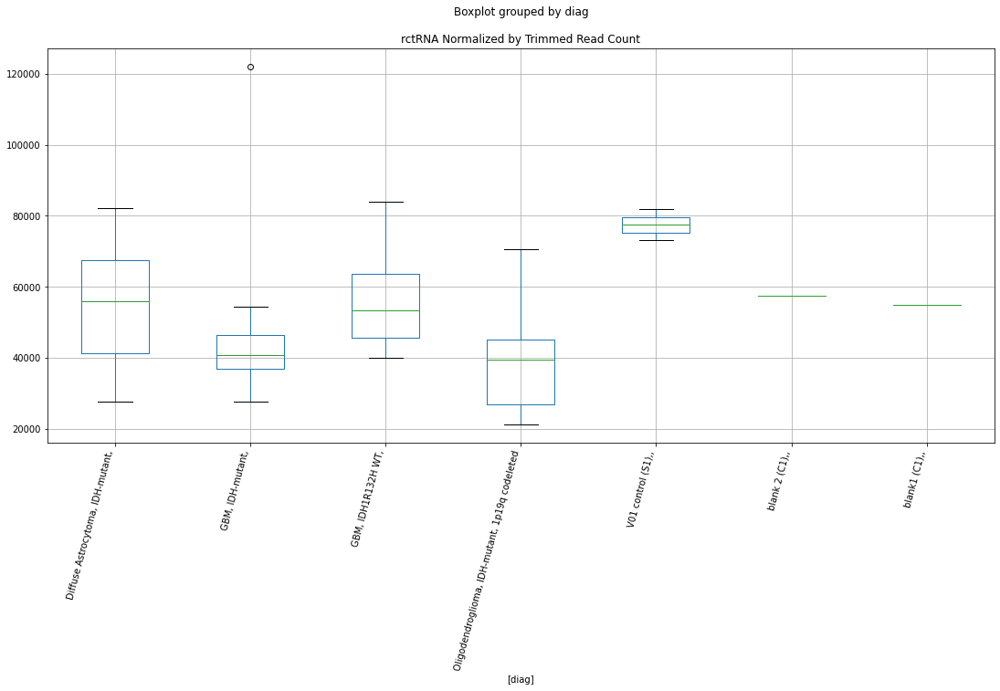

In [87]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmsk_classes:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Trimmed Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


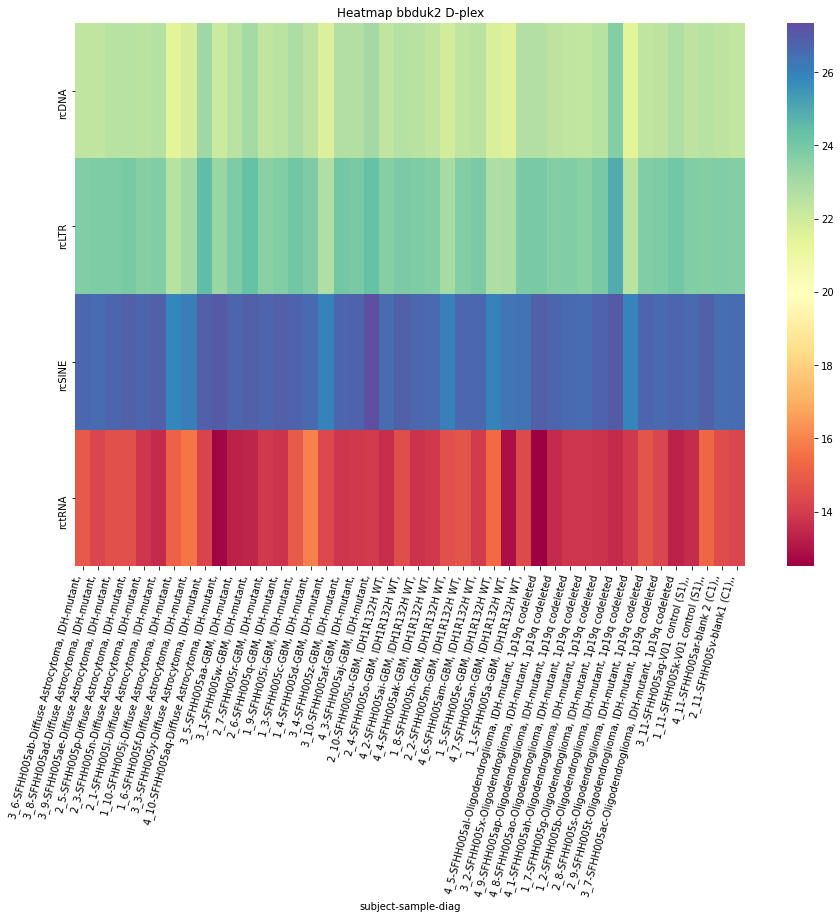

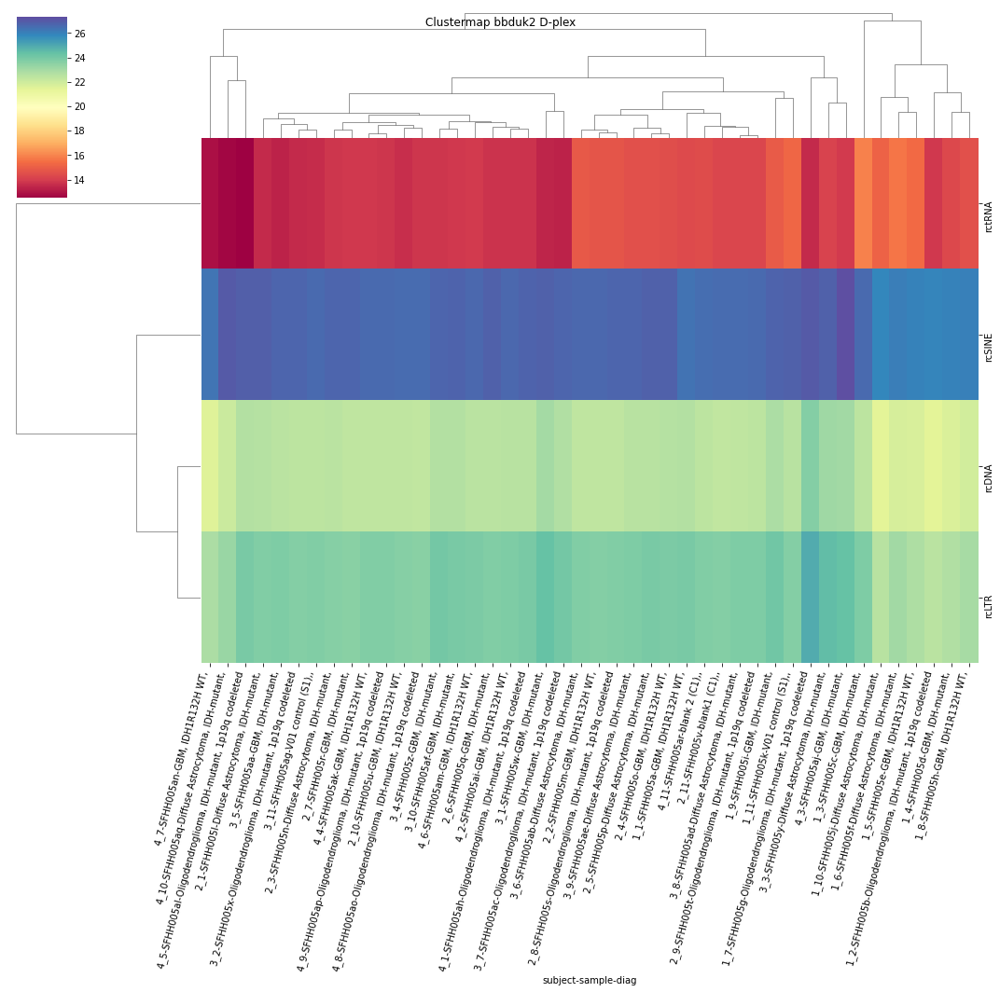

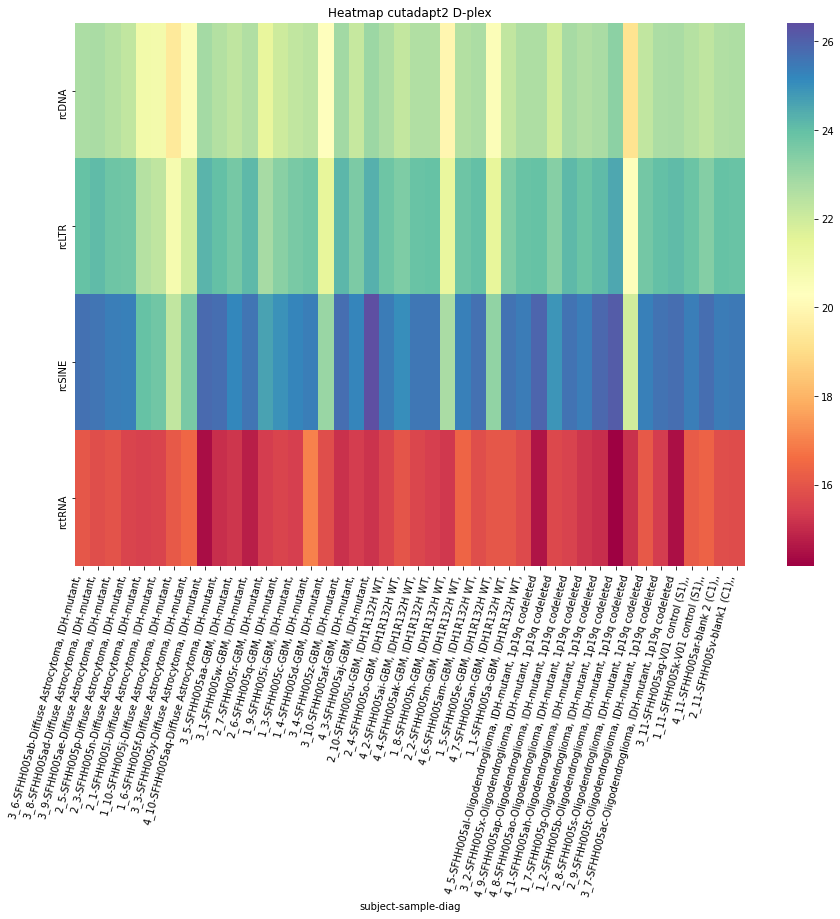

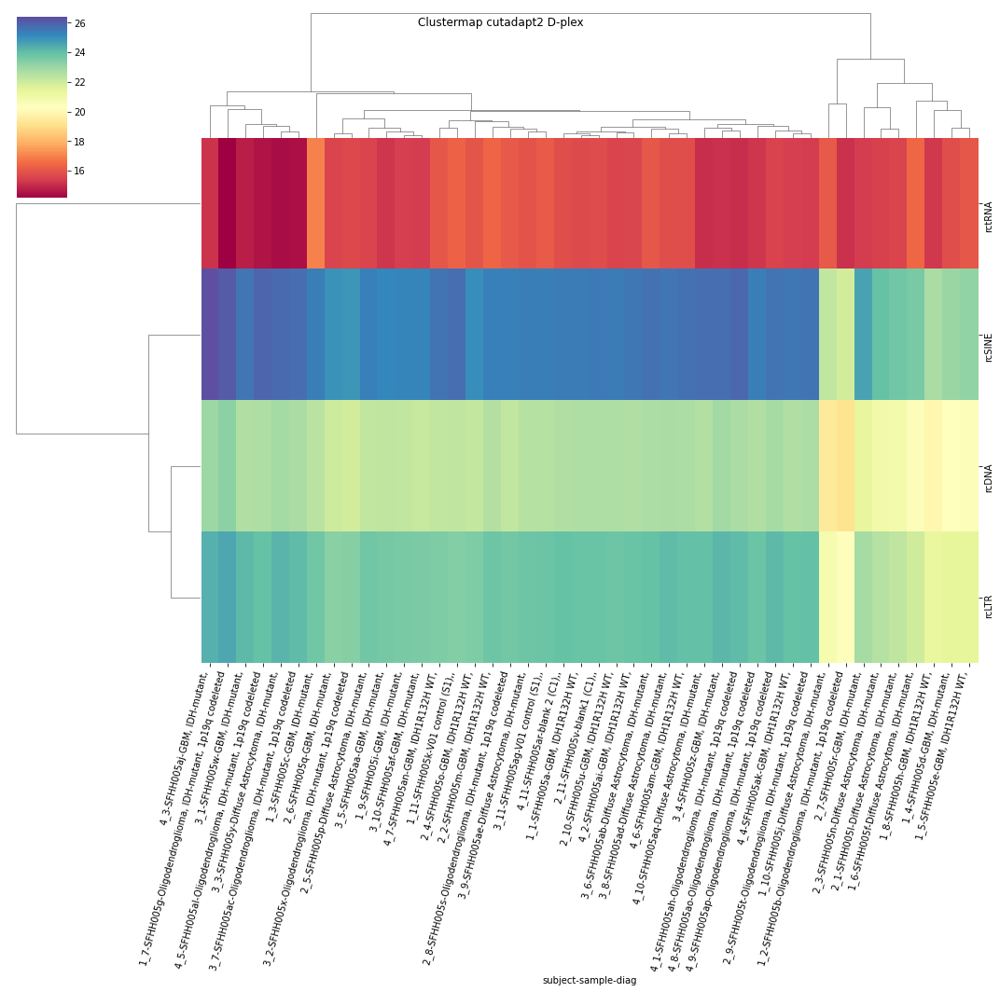

In [88]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

rn(T)n D-plex cutadapt3 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = 1.8117833199626525
	p = 0.08673807541324714
rn(T)n D-plex cutadapt3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8670075570146973
	p = 0.07827517612838539
rn(T)n D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = -1.8117833199626525
	p = 0.08673807541324714
rn(T)n D-plex cutadapt3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8670075570146973
	p = 0.07827517612838539


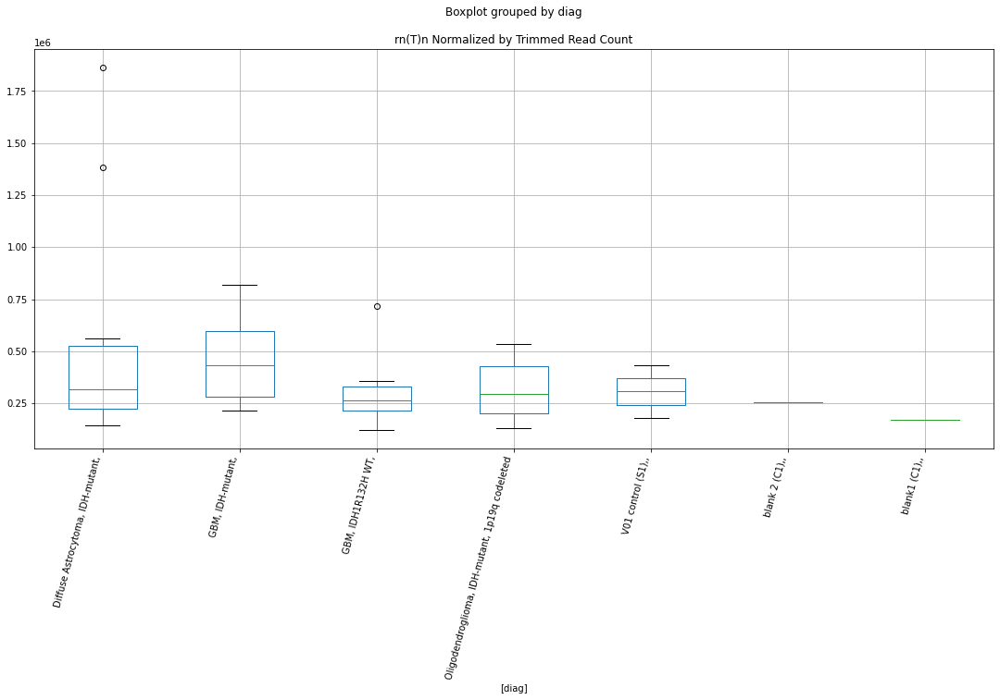

rnAluJb D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.036951521502468
	p = 0.05663566999811735
rnAluJb D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.82386977120098
	p = 0.08482016768480075
rnAluJb D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.036951521502468
	p = 0.05663566999811735
rnAluJb D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.82386977120098
	p = 0.08482016768480075


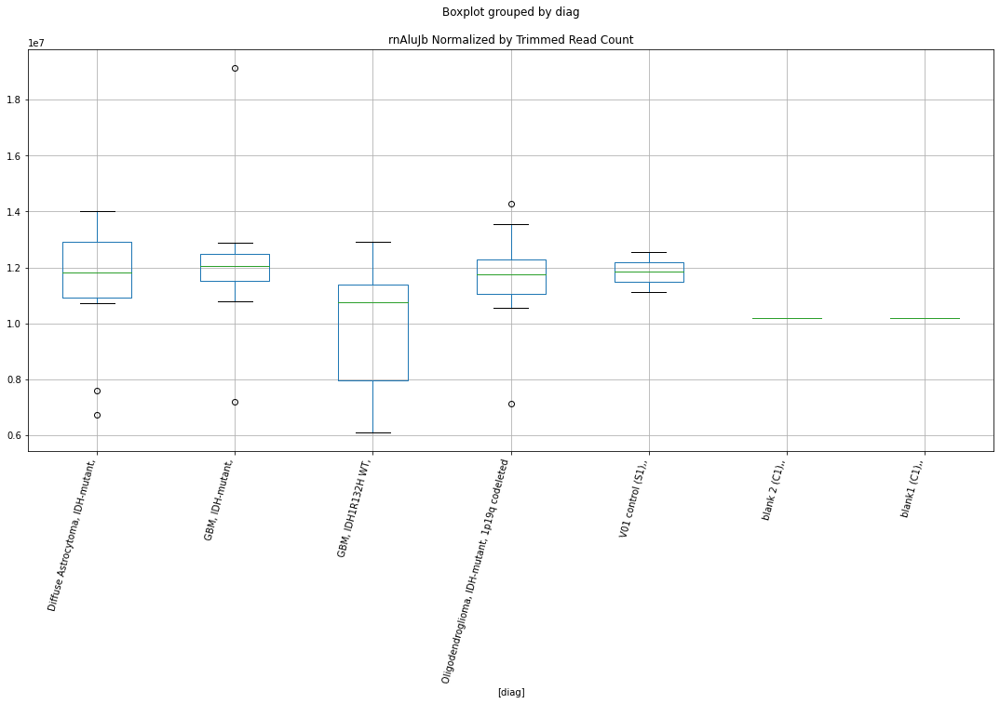

rnAluJb D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0344754372297498
	p = 0.05690782040569134
rnAluJb D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.8535500459557344
	p = 0.08026753206560067
rnAluJb D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0344754372297498
	p = 0.05690782040569134
rnAluJb D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8535500459557344
	p = 0.08026753206560067


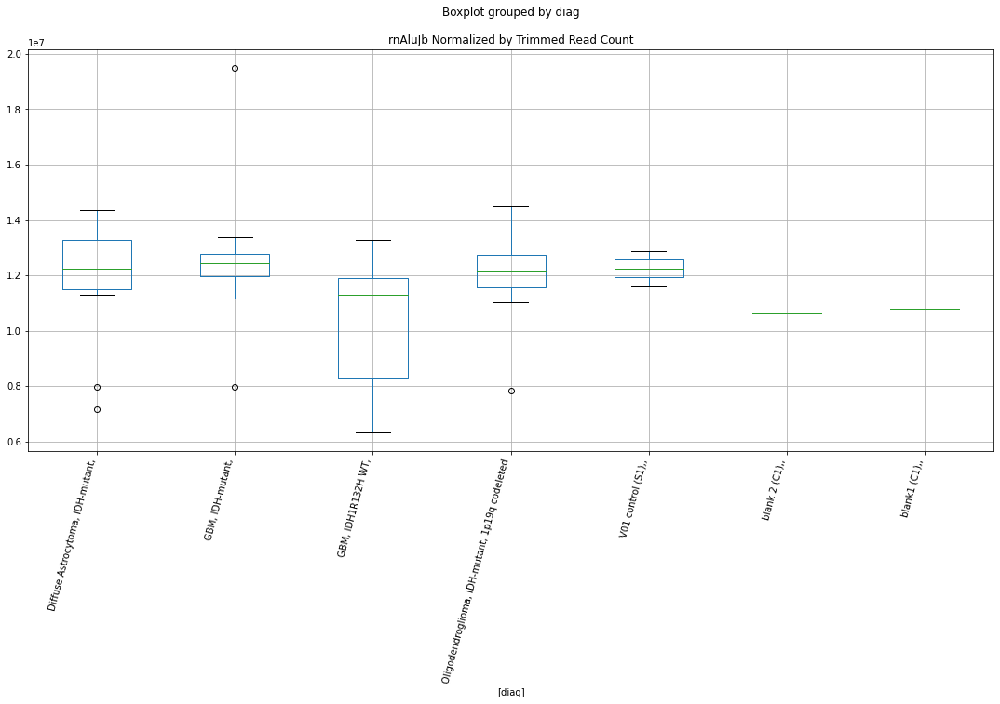

rnAluSx1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.248551151444045
	p = 0.03730357796405542
rnAluSx1 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.928928971402953
	p = 0.06966034436847972
rnAluSx1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.248551151444045
	p = 0.03730357796405542
rnAluSx1 D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.928928971402953
	p = 0.06966034436847972


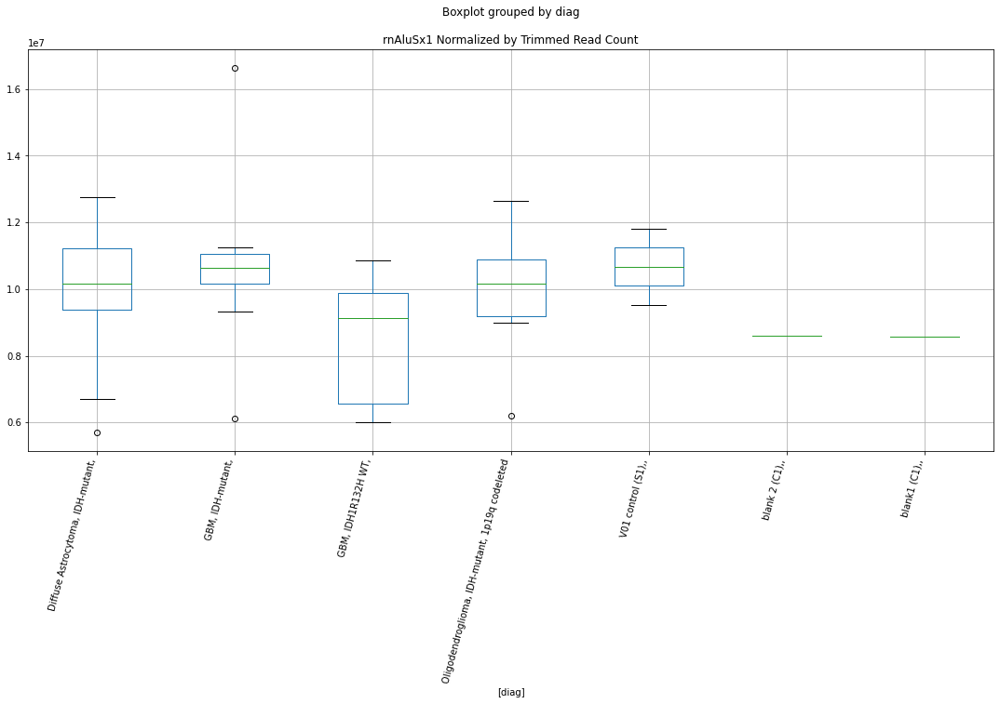

rnAluSx1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.2482001437632007
	p = 0.03732988145920051
rnAluSx1 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.9985800169194157
	p = 0.060987730506241934
rnAluSx1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.2482001437632007
	p = 0.03732988145920051
rnAluSx1 D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9985800169194157
	p = 0.060987730506241934


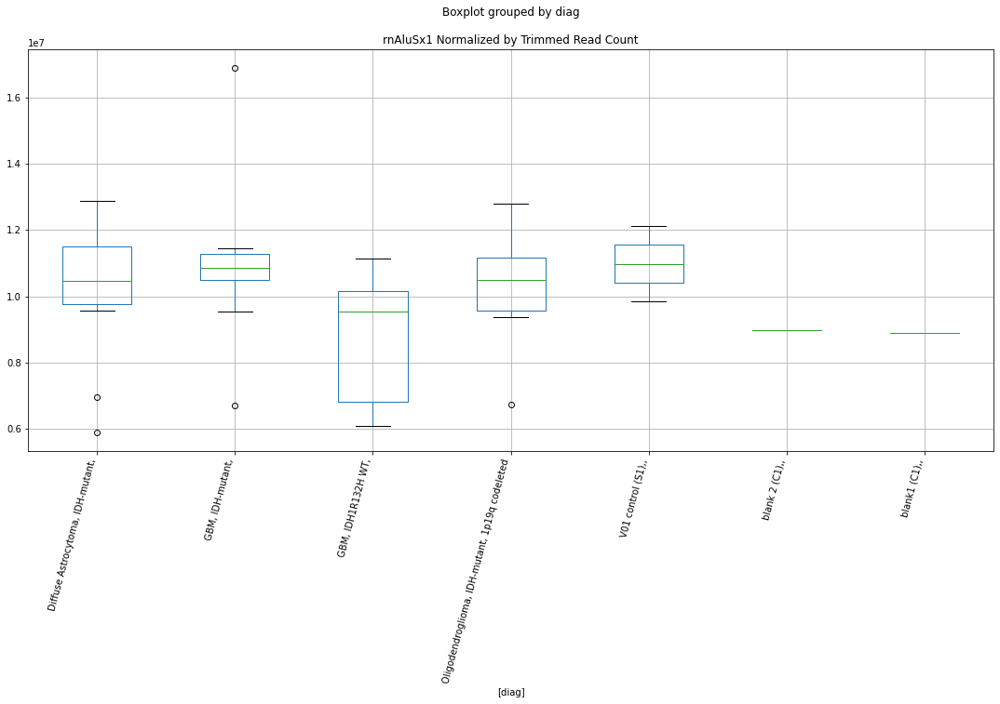

rnAluSx D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8161918072482988
	p = 0.08603416912770322
rnAluSx D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8161918072482988
	p = 0.08603416912770322


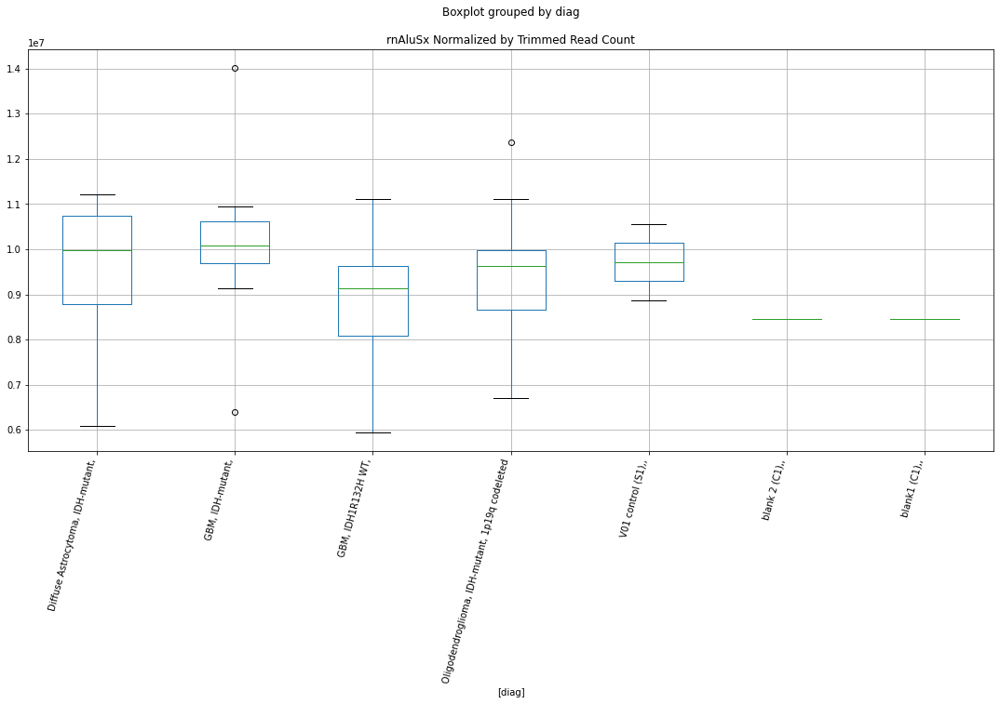

rnAluSx D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8100362358160473
	p = 0.0870184257246242
rnAluSx D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8100362358160473
	p = 0.0870184257246242


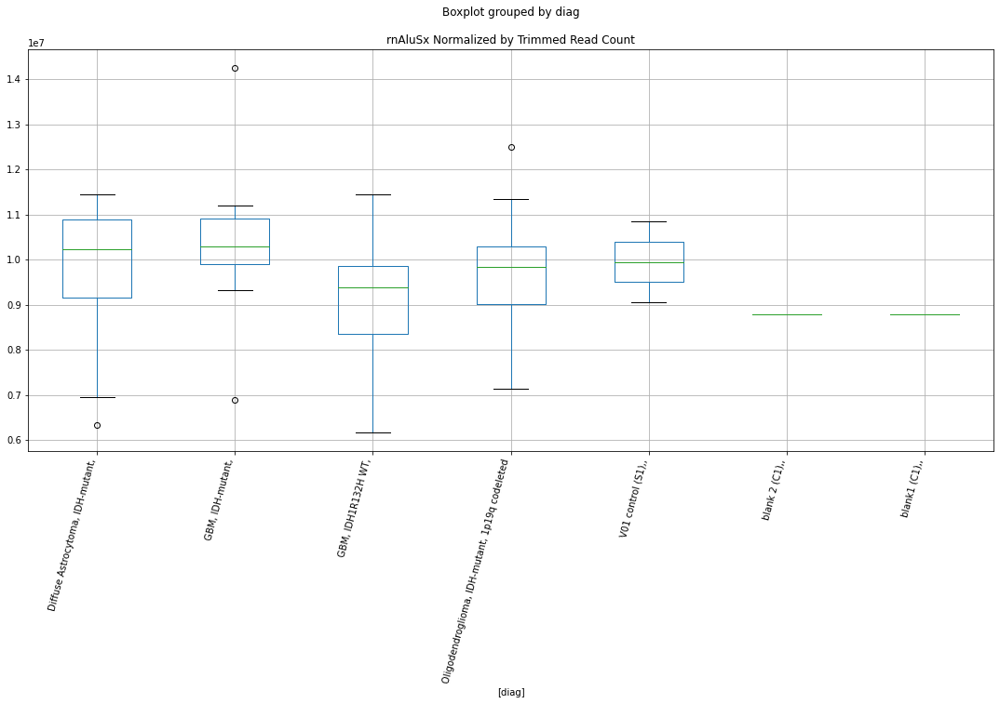

rnL1P4 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9213548049954334
	p = 0.07066680462548766
rnL1P4 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9213548049954334
	p = 0.07066680462548766


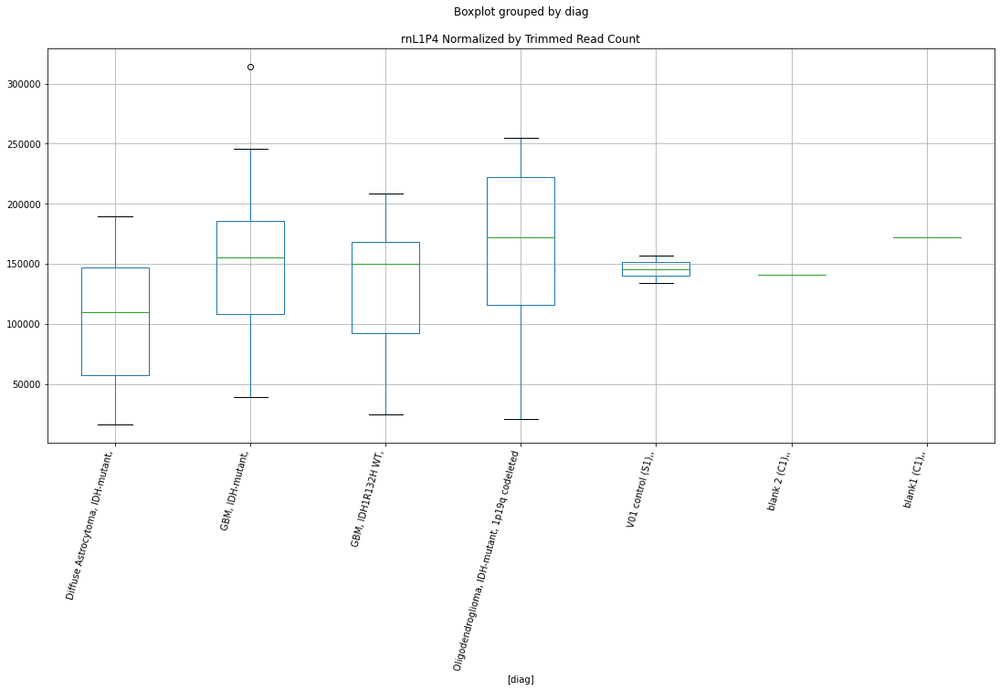

rnAluJr D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.3562435503145647
	p = 0.029996110887826364
rnAluJr D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.8192653203854277
	p = 0.08554638463818504
rnAluJr D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.3562435503145647
	p = 0.029996110887826364
rnAluJr D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8192653203854277
	p = 0.08554638463818504


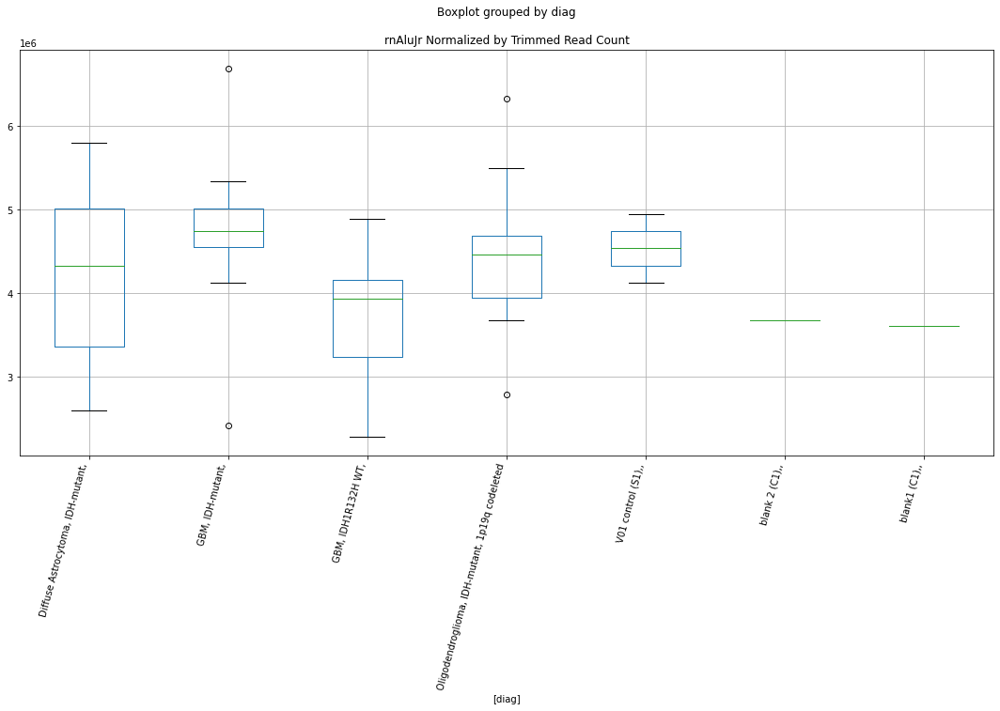

rnAluJr D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.3223132275222436
	p = 0.032140919707681195
rnAluJr D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.8232917352759233
	p = 0.08491103812097078
rnAluJr D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.3223132275222436
	p = 0.032140919707681195
rnAluJr D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8232917352759233
	p = 0.08491103812097078


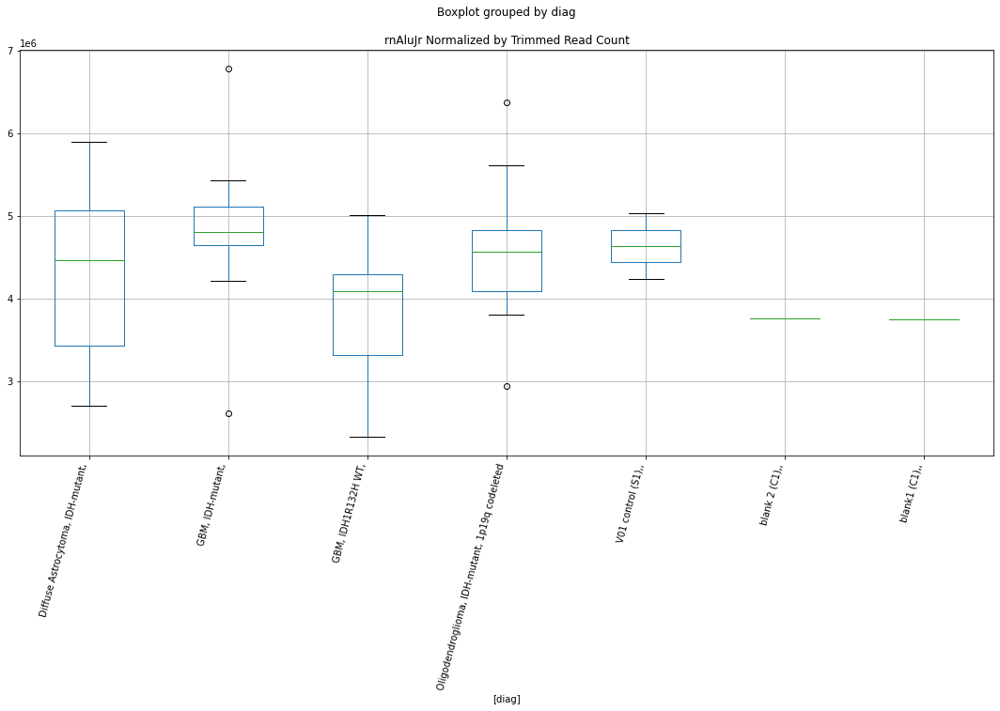

rnAluJo D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.250824104364649
	p = 0.03713366300355907
rnAluJo D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.250824104364649
	p = 0.03713366300355907


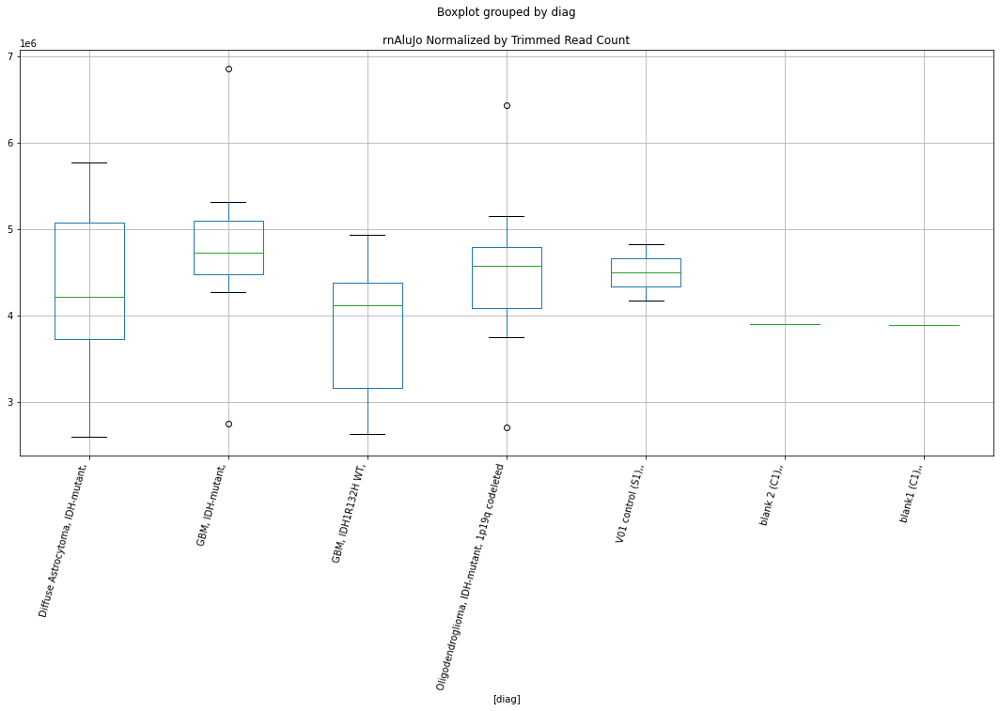

rnAluJo D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.2089933228966863
	p = 0.04037789357475846
rnAluJo D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.2089933228966863
	p = 0.04037789357475846


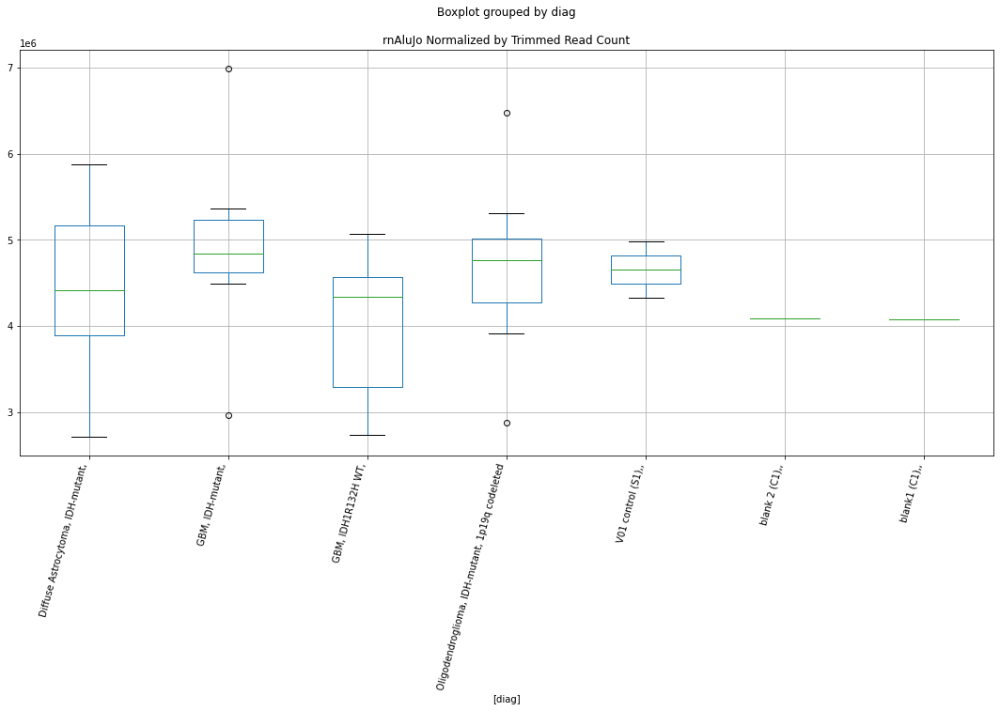

rnAluSg D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.151060717620299
	p = 0.04530185856256783
rnAluSg D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.151060717620299
	p = 0.04530185856256783


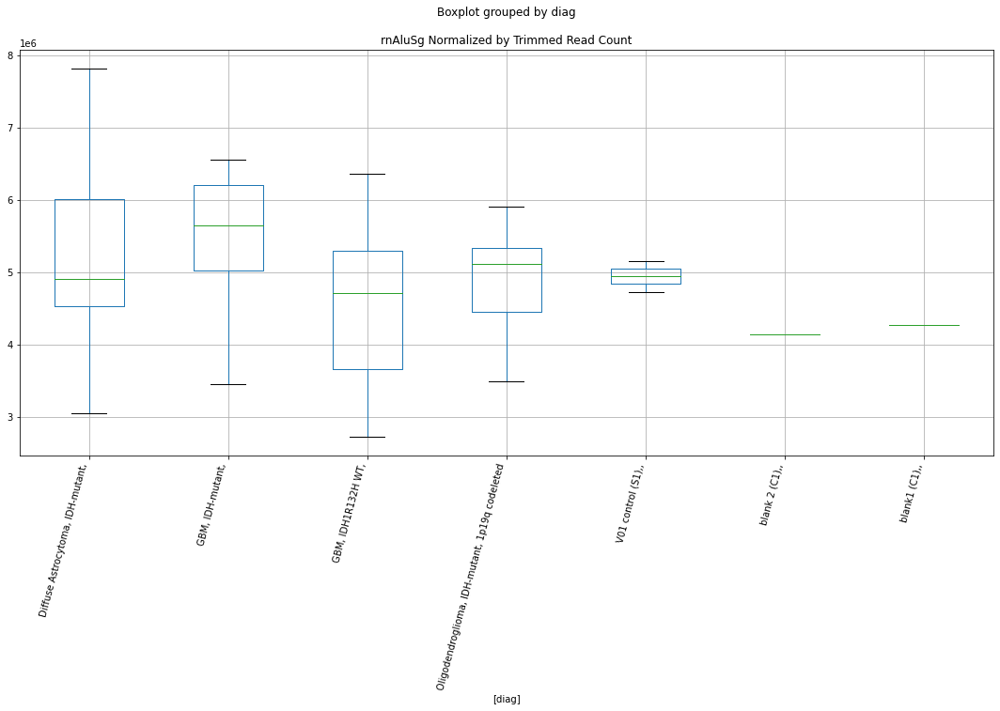

rnAluSg D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.044107538501135
	p = 0.0558557303890894
rnAluSg D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.044107538501135
	p = 0.0558557303890894


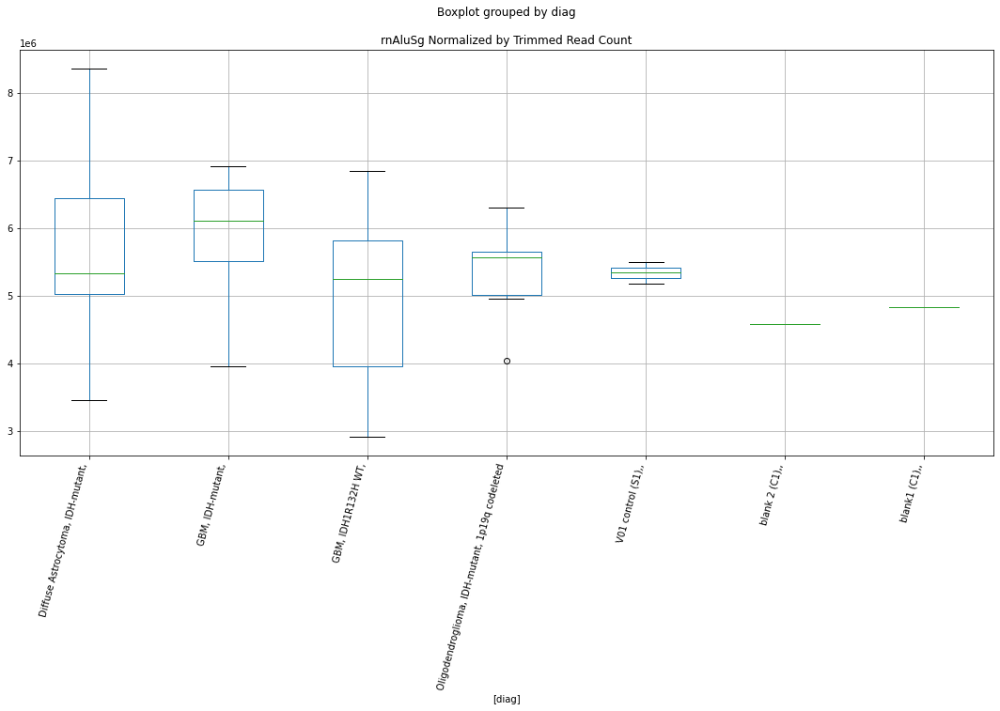

rnAluSq2 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.846409639318525
	p = 0.08134269152485613
rnAluSq2 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.846409639318525
	p = 0.08134269152485613


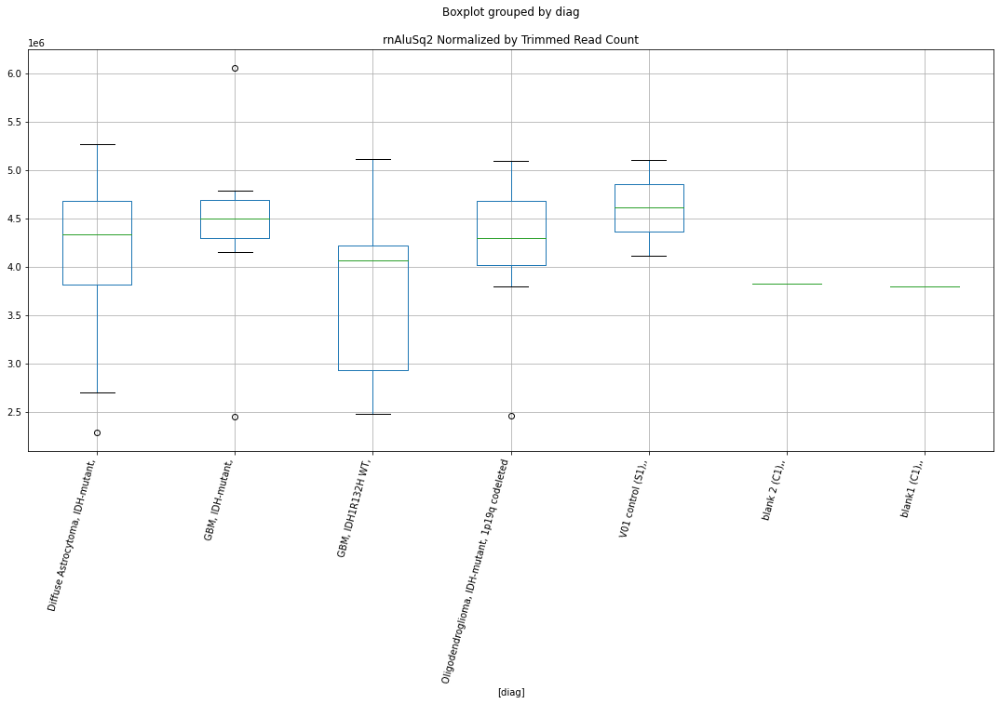

rnAluSq2 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8521512402969829
	p = 0.08047716460537203
rnAluSq2 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8521512402969829
	p = 0.08047716460537203


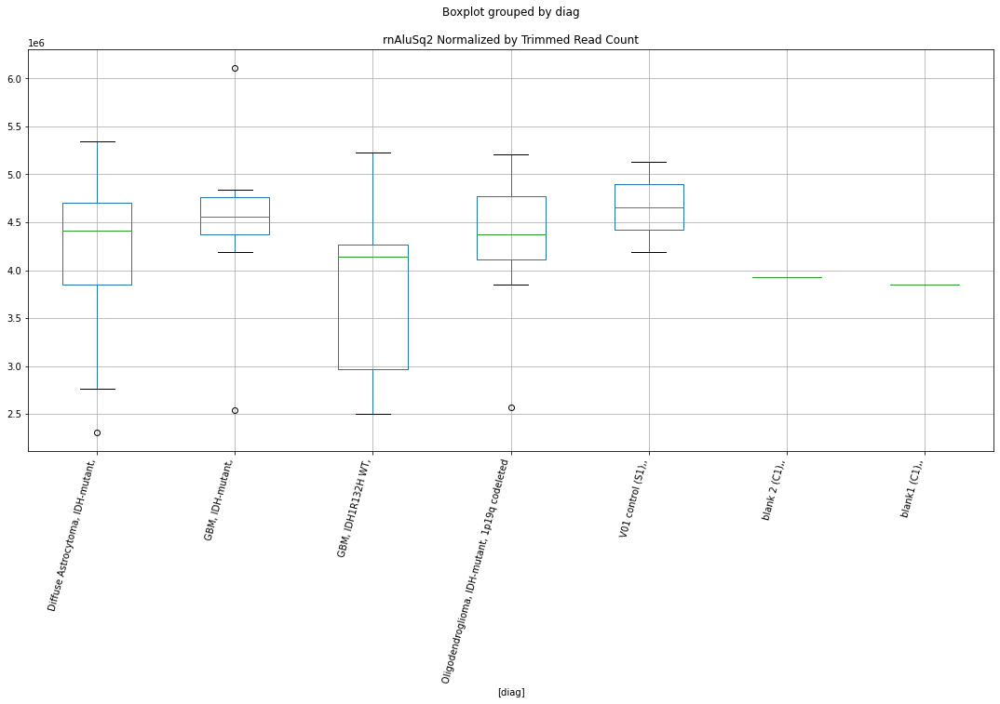

rn(A)n D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8746244055920003
	p = 0.07716696780515774
rn(A)n D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8746244055920003
	p = 0.07716696780515774


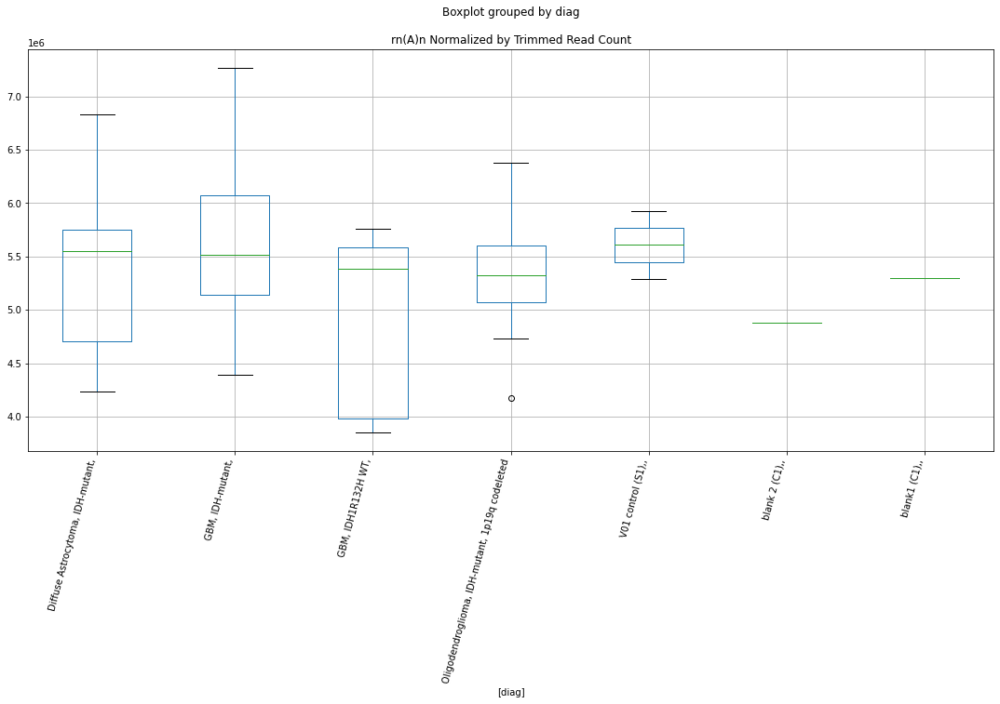

rn(A)n D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7938987814630316
	p = 0.08964566831295706
rn(A)n D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7938987814630316
	p = 0.08964566831295706


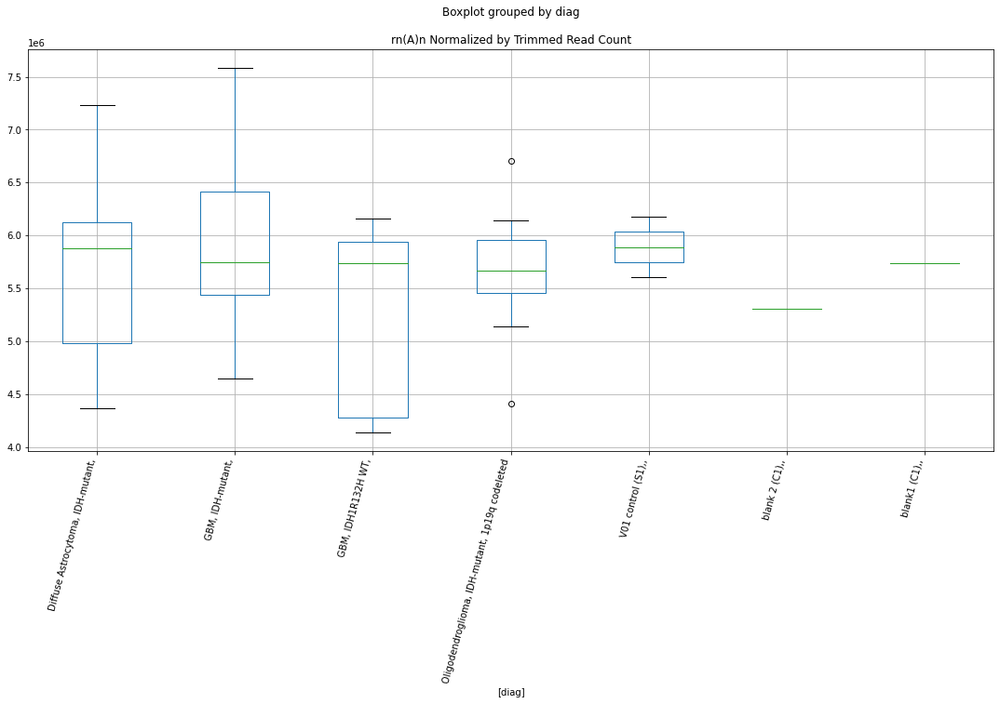

rnAluSp D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1249274645319005
	p = 0.0476978836709865
rnAluSp D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.7744706871416314
	p = 0.09290029499075321
rnAluSp D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1249274645319005
	p = 0.0476978836709865
rnAluSp D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7744706871416314
	p = 0.09290029499075321


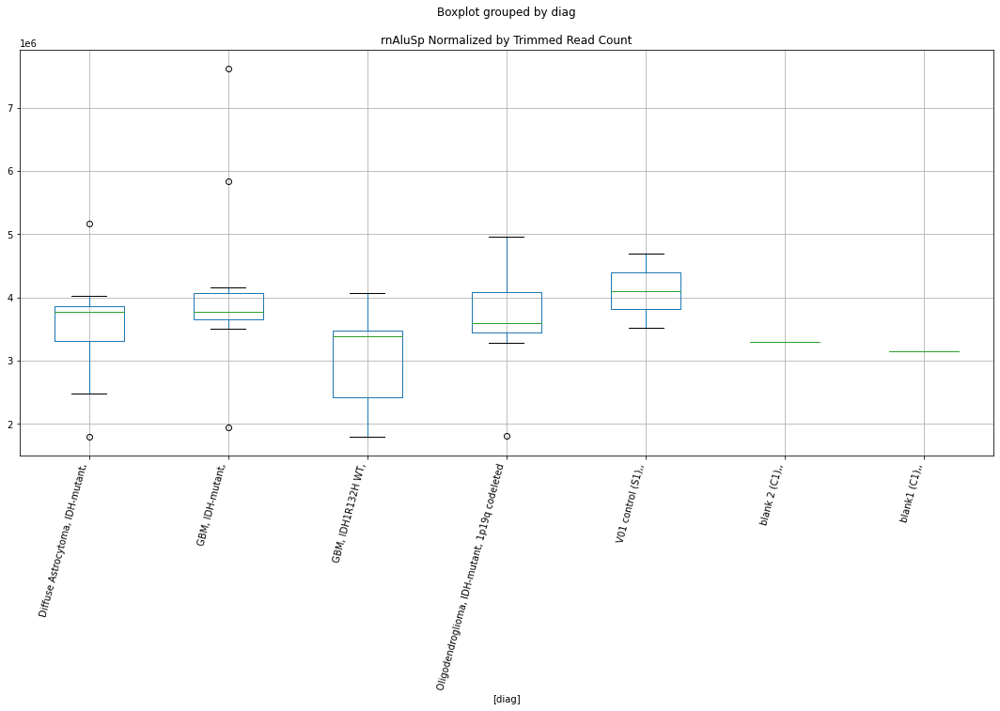

rnAluSp D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1752439064127316
	p = 0.043183133162331445
rnAluSp D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.8008248213884255
	p = 0.0885097088549631
rnAluSp D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1752439064127316
	p = 0.043183133162331445
rnAluSp D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8008248213884255
	p = 0.0885097088549631


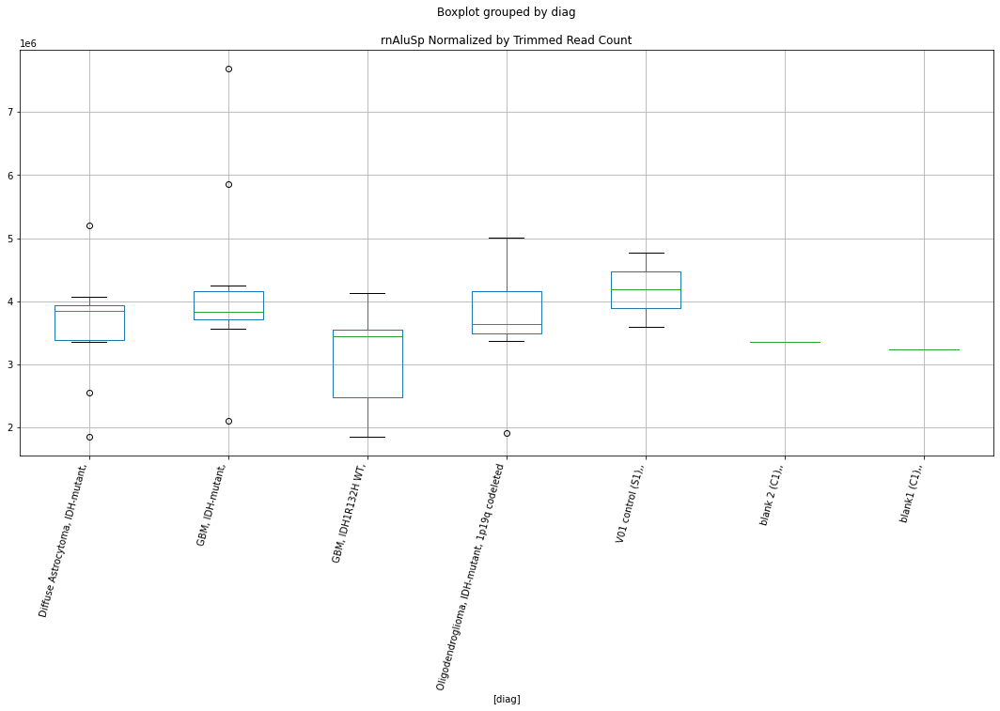

rnAluSx3 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.145432686431701
	p = 0.04580837917540946
rnAluSx3 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.145432686431701
	p = 0.04580837917540946


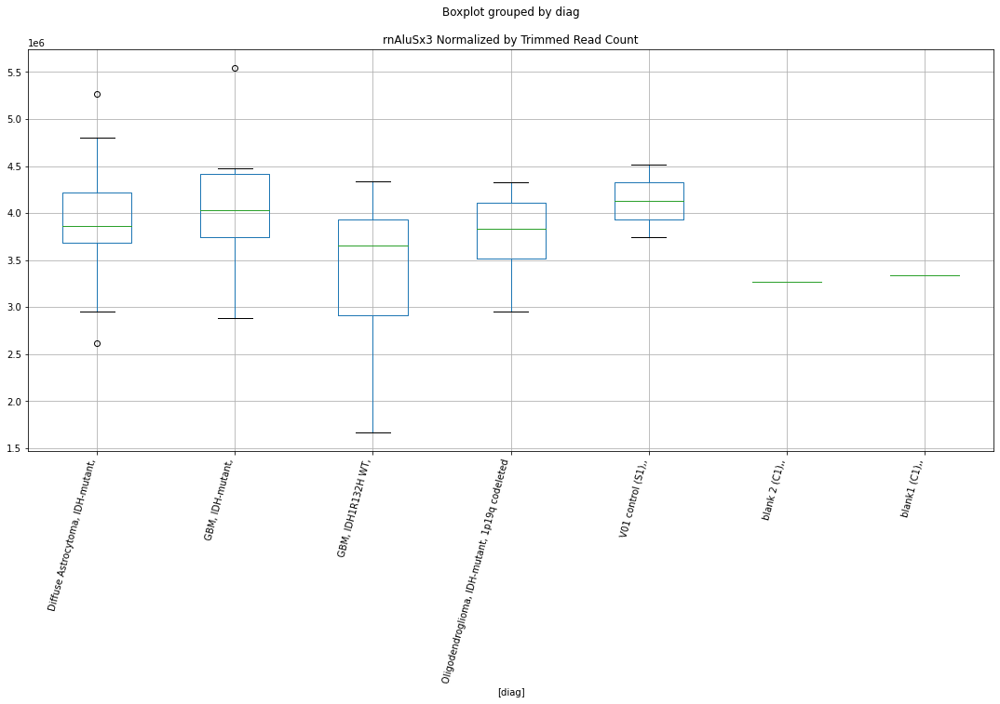

rnAluSx3 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.109815655332126
	p = 0.04913556973820342
rnAluSx3 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.109815655332126
	p = 0.04913556973820342


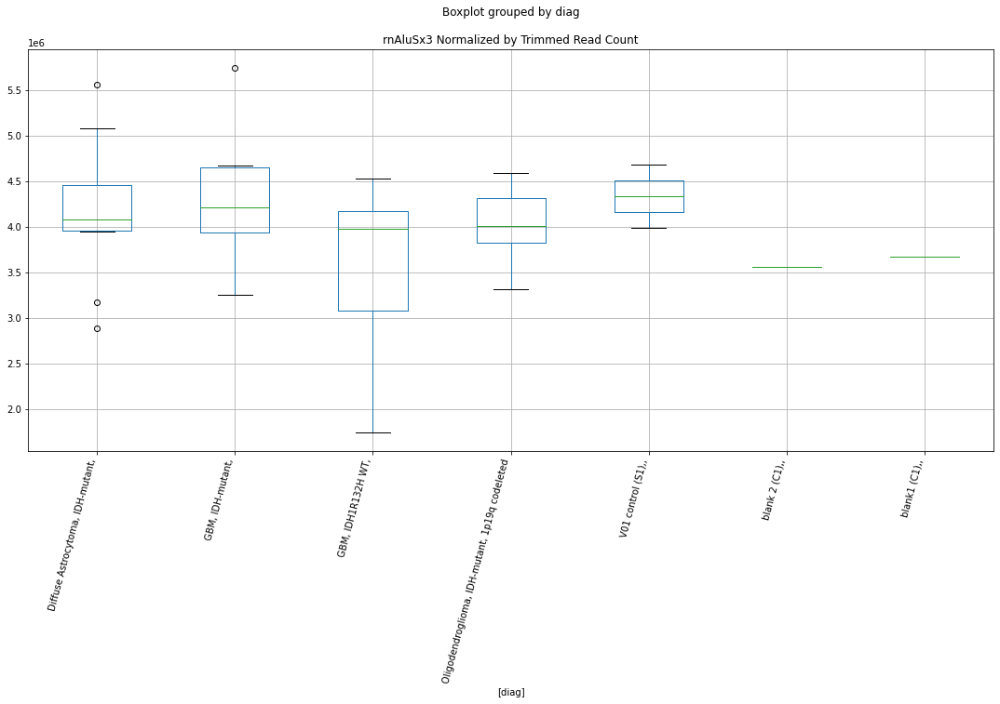

rnAluSz6 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.0809003477162817
	p = 0.051996829382079626
rnAluSz6 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.0809003477162817
	p = 0.051996829382079626


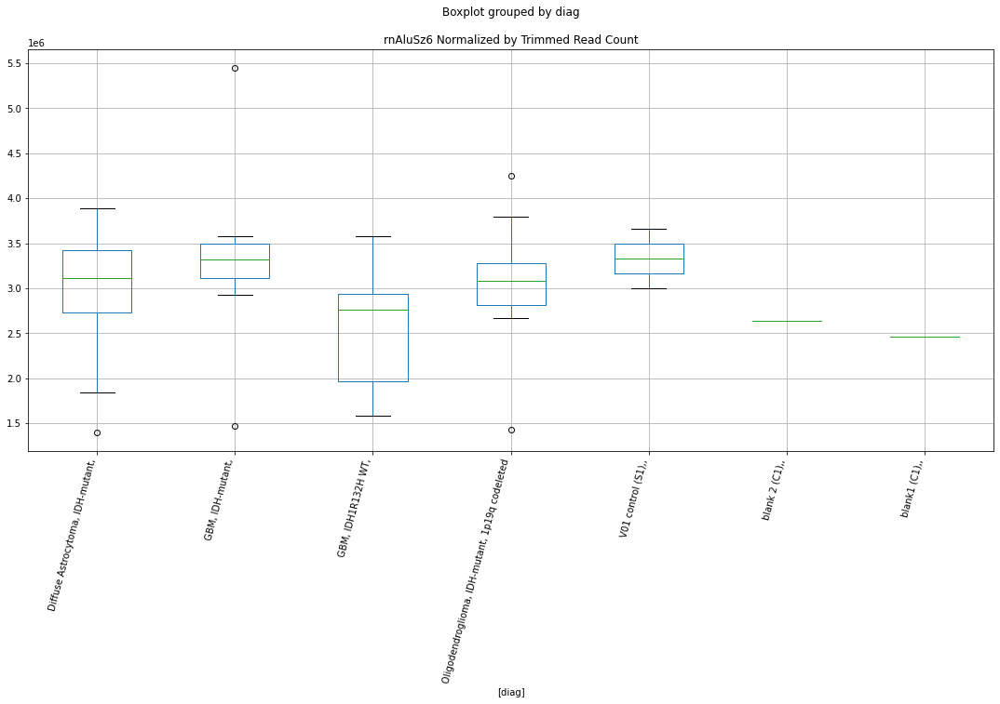

rnAluSz6 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.1267130621433
	p = 0.04753056404087301
rnAluSz6 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.1267130621433
	p = 0.04753056404087301


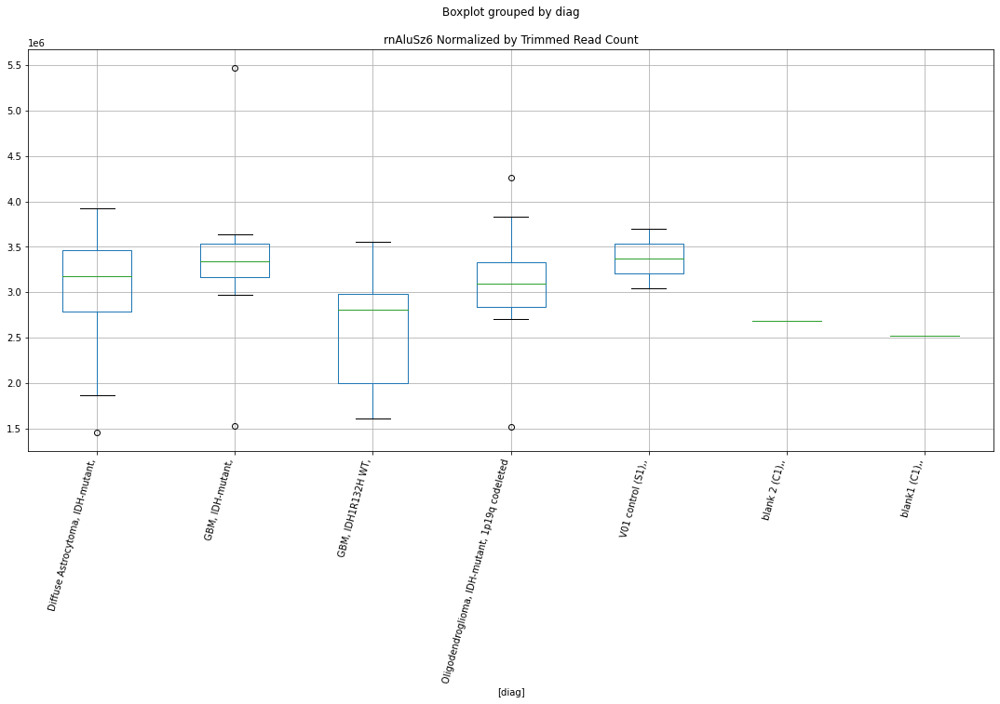

rnAluSc D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.4477892652415445
	p = 0.024856711404834787
rnAluSc D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.80288500380993
	p = 0.08817424907114596
rnAluSc D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.4477892652415445
	p = 0.024856711404834787
rnAluSc D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.80288500380993
	p = 0.08817424907114596


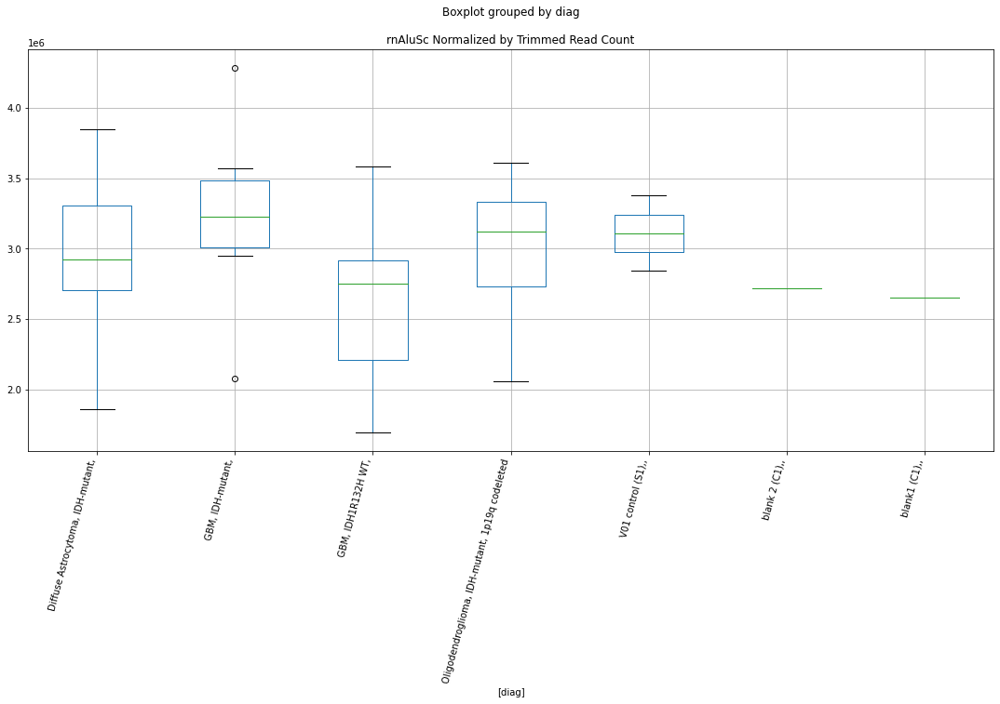

rnAluSc D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.4513666416734305
	p = 0.024673697360432477
rnAluSc D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.873794434665624
	p = 0.07728704726624405
rnAluSc D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.4513666416734305
	p = 0.024673697360432477
rnAluSc D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.873794434665624
	p = 0.07728704726624405


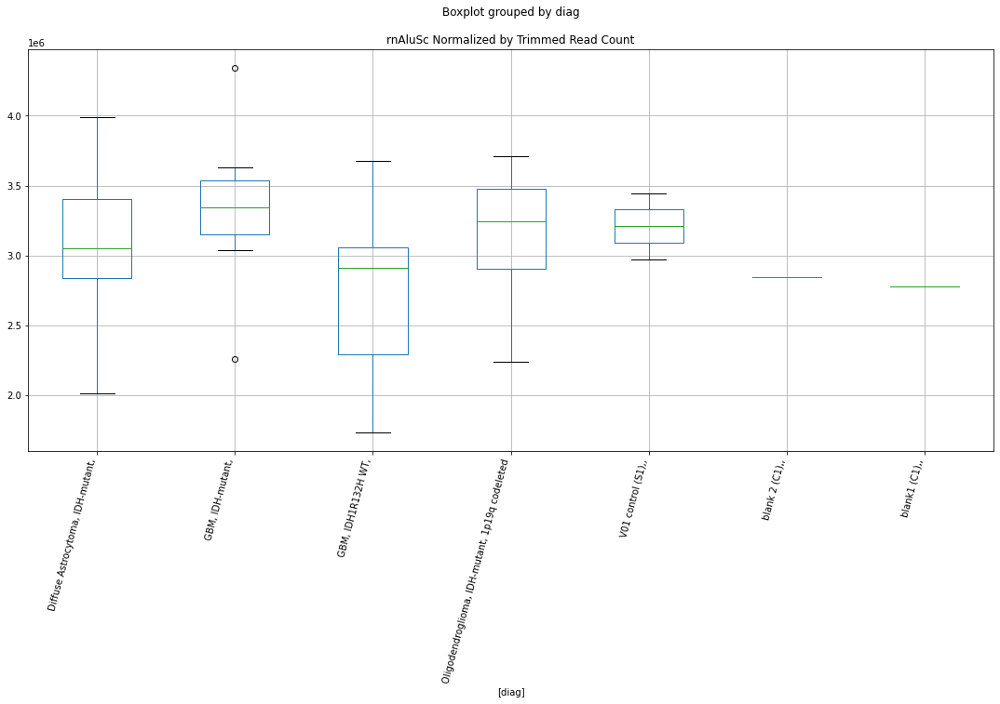

rnAluSc8 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.973072989379206
	p = 0.06404462798125514
rnAluSc8 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.973072989379206
	p = 0.06404462798125514


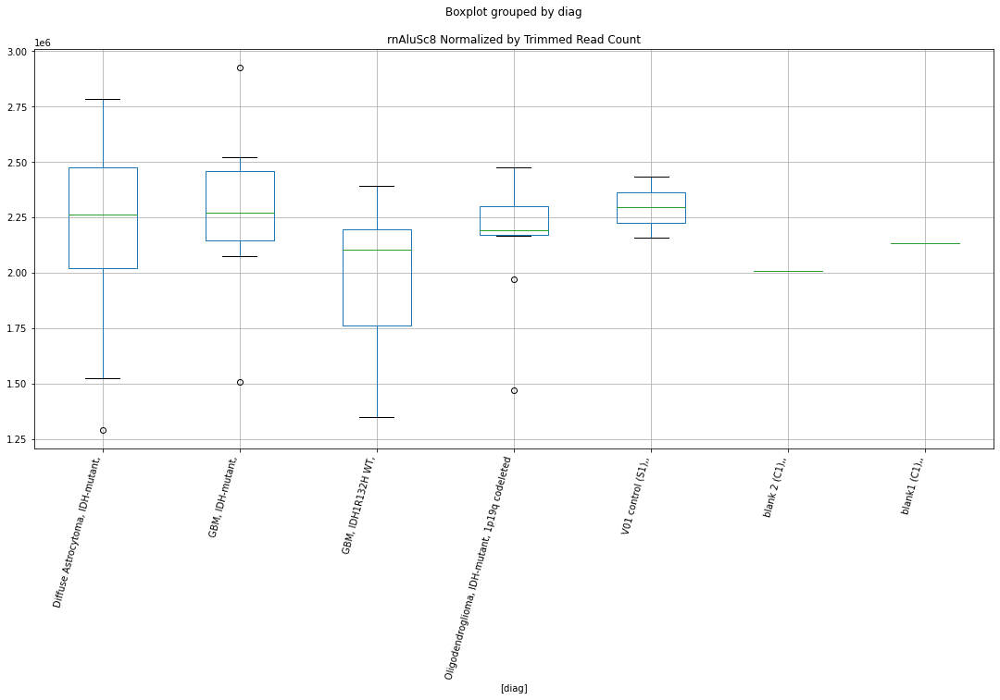

rnAluSc8 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7531030331961563
	p = 0.09659814909397868
rnAluSc8 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7531030331961563
	p = 0.09659814909397868


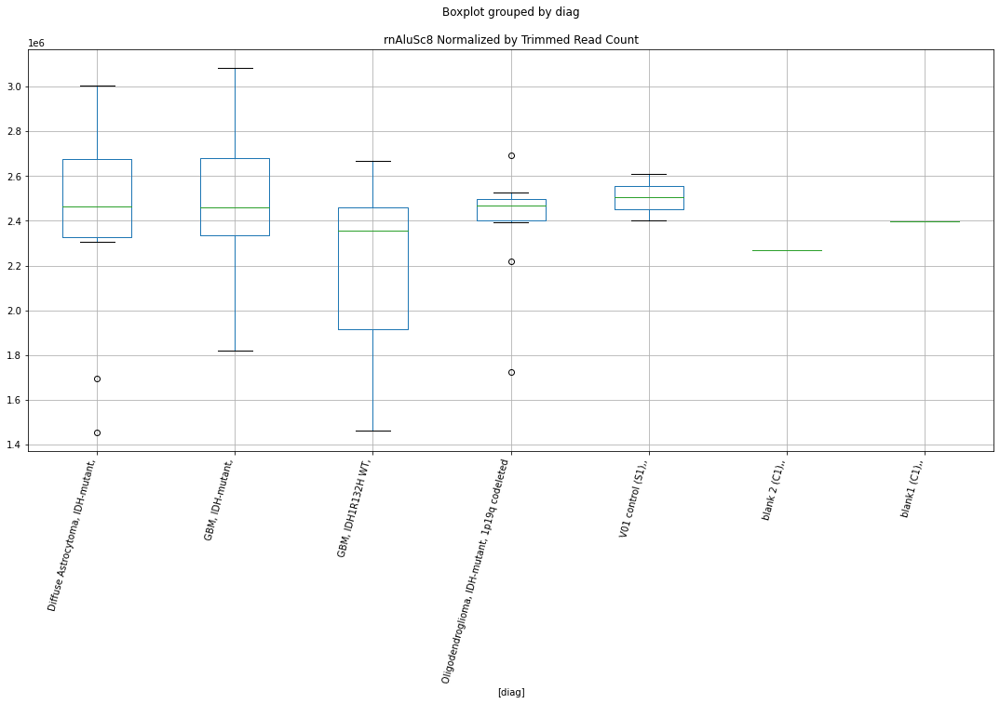

rnAluJr4 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.9115824560661034
	p = 0.07198445534381566
rnAluJr4 D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9115824560661034
	p = 0.07198445534381566


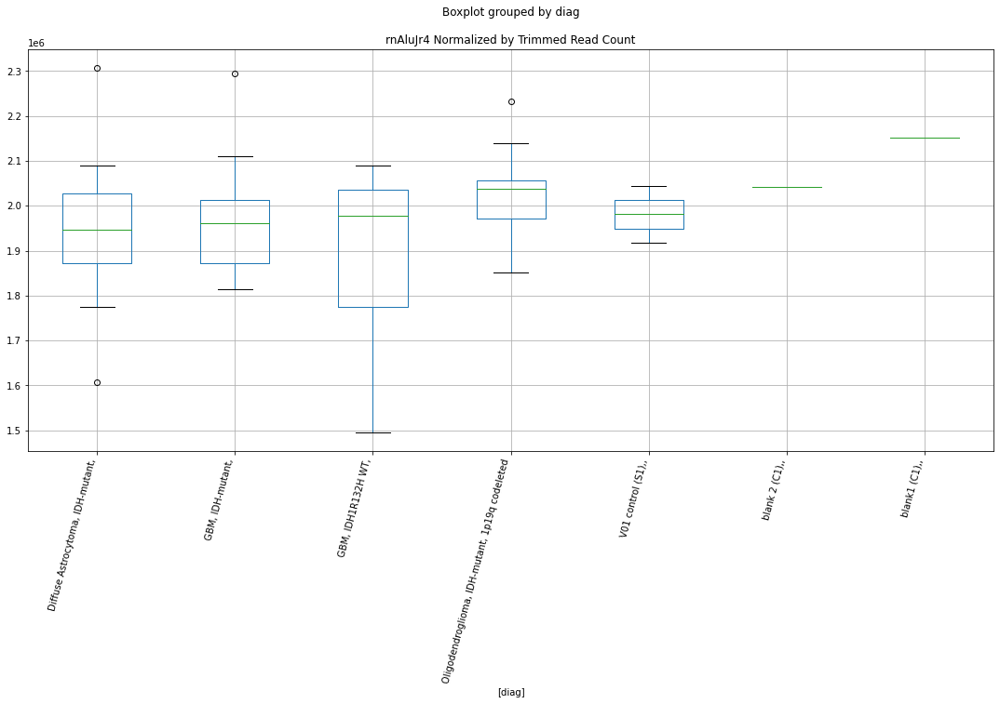

rnL1PB1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9491732182538757
	p = 0.06703265155010339
rnL1PB1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9491732182538757
	p = 0.06703265155010339


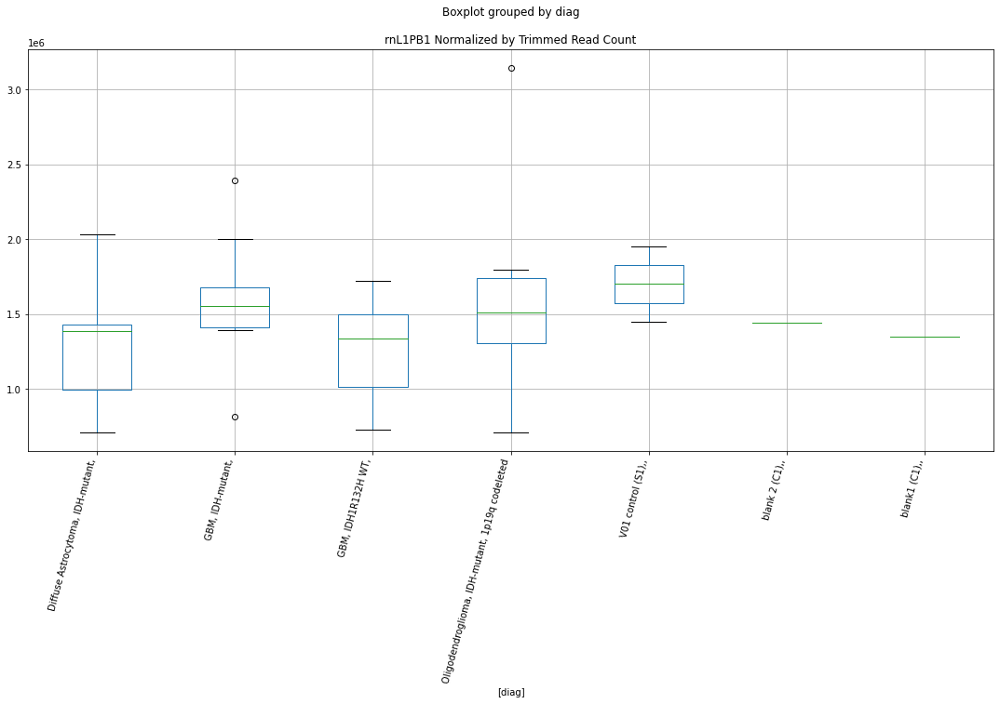

rnL1PB1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.9685388604418137
	p = 0.06460216896287745
rnL1PB1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.9685388604418137
	p = 0.06460216896287745


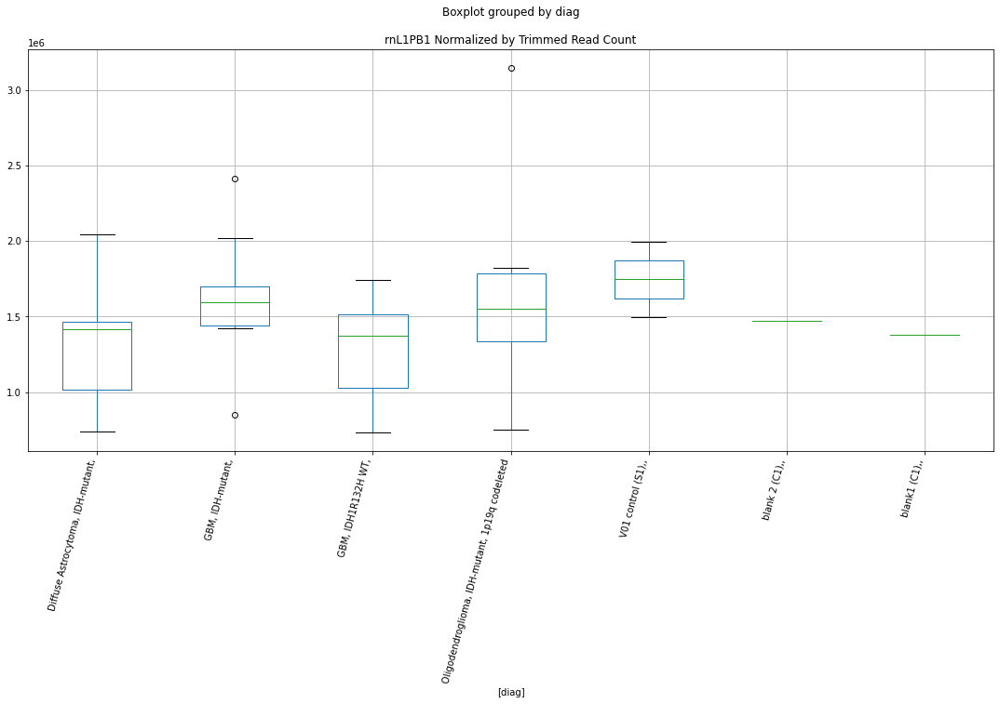

rnL1PB1 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8987336997770714
	p = 0.07375009451240137
rnL1PB1 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8987336997770714
	p = 0.07375009451240137


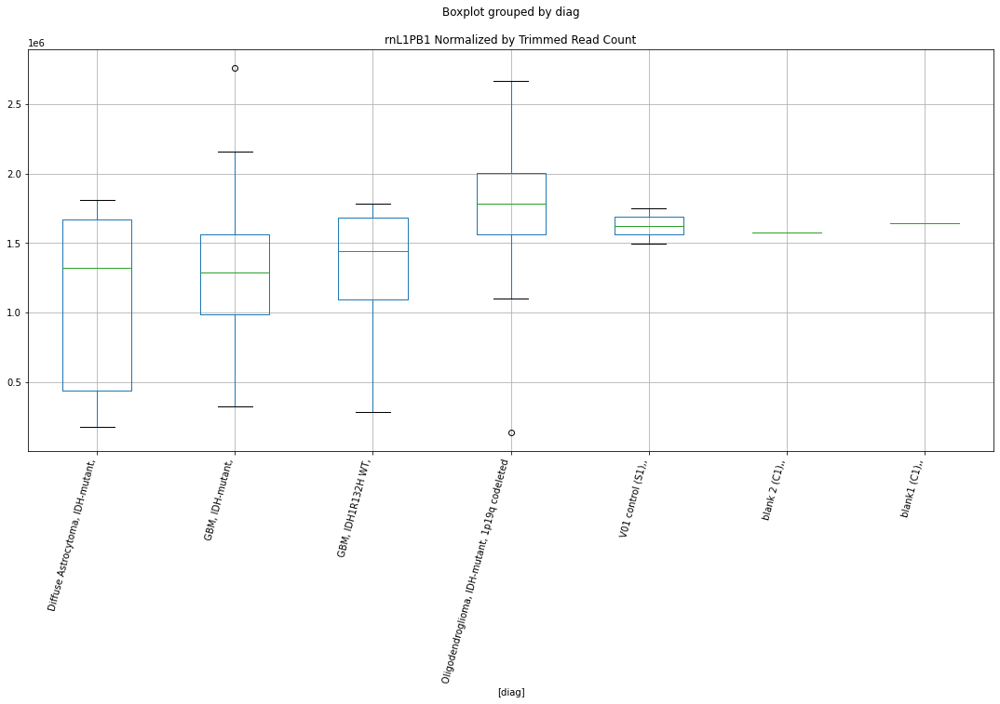

rnL1PB1 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9540866809996884
	p = 0.06640837689273726
rnL1PB1 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9540866809996884
	p = 0.06640837689273726


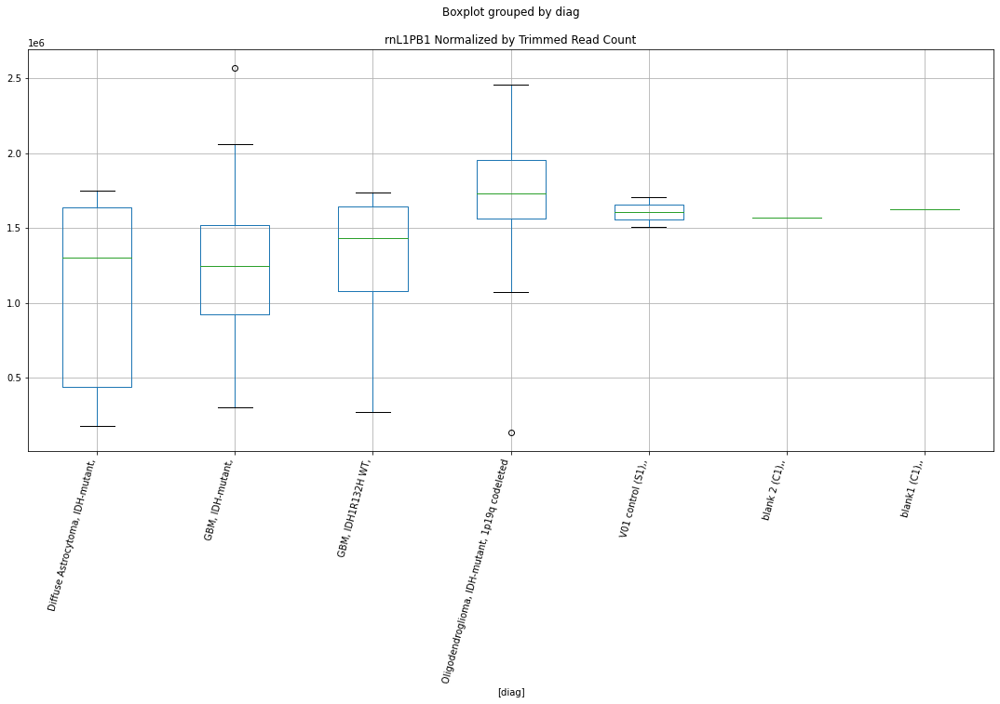

rnL1PB1 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.9885114614567916
	p = 0.062178404515683086
rnL1PB1 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9885114614567916
	p = 0.062178404515683086


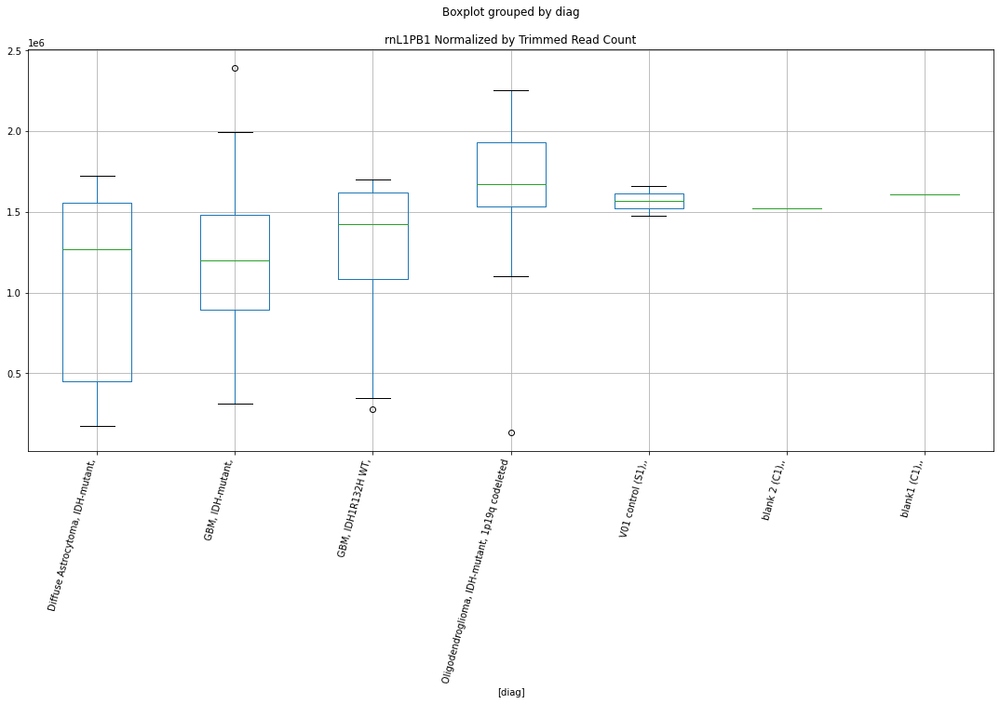

rnL1PA8 D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.94218415876169
	p = 0.0679296629370527
rnL1PA8 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 3.264268711840234
	p = 0.004307804391168774
rnL1PA8 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.94218415876169
	p = 0.0679296629370527
rnL1PA8 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 1.8344263648231847
	p = 0.08317555660663489
rnL1PA8 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -3.264268711840234
	p = 0.004307804391168774
rnL1PA8 D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8344263648231847
	p = 0.08317555660663489


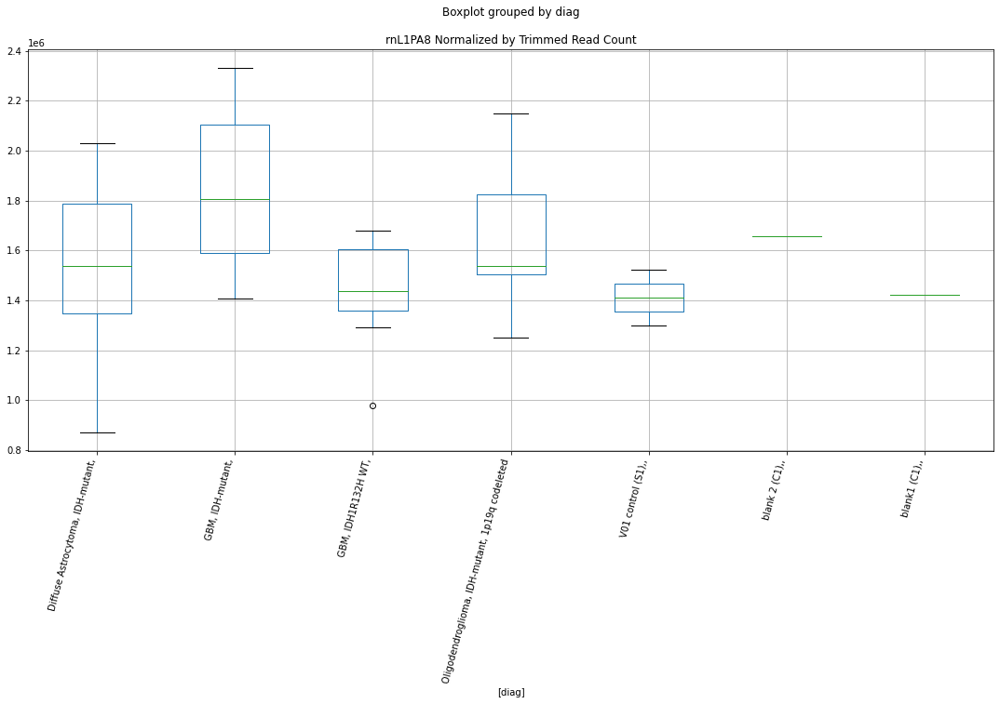

rnL1PA8 D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9839211095078162
	p = 0.06272813340432544
rnL1PA8 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 3.3670263318509437
	p = 0.003433169692837935
rnL1PA8 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.9839211095078162
	p = 0.06272813340432544
rnL1PA8 D-plex bbduk3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 2.1886938222107566
	p = 0.04204442258759517
rnL1PA8 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -3.3670263318509437
	p = 0.003433169692837935
rnL1PA8 D-plex bbduk3 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.1886938222107566
	p = 0.04204442258759517


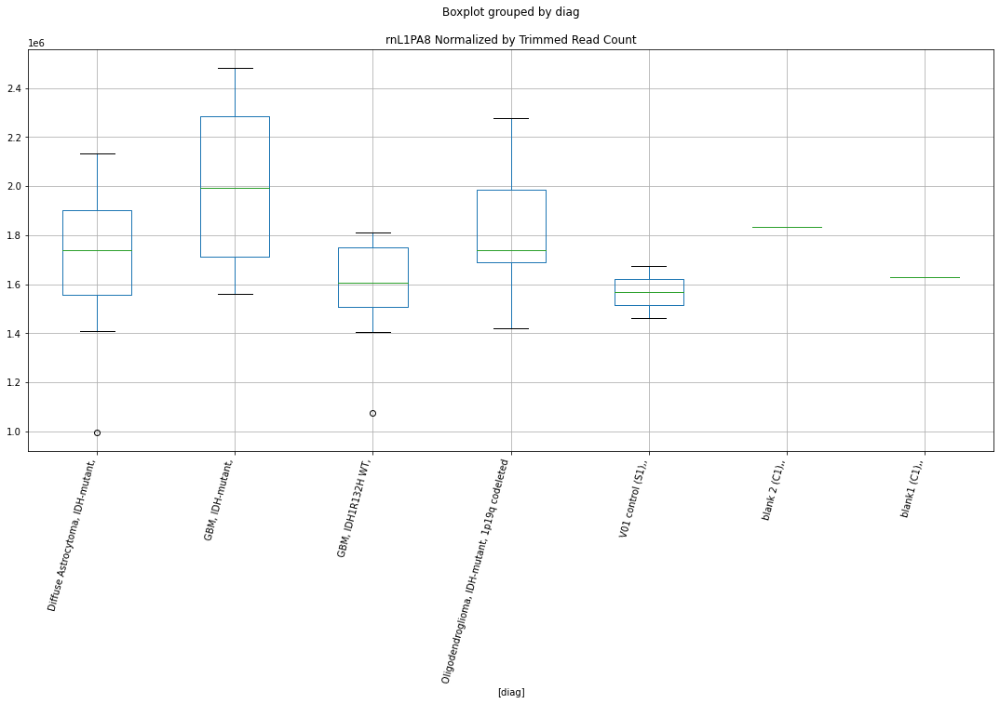

rnL2 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.8846364813765109
	p = 0.07573136942211306
rnL2 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.8846364813765109
	p = 0.07573136942211306


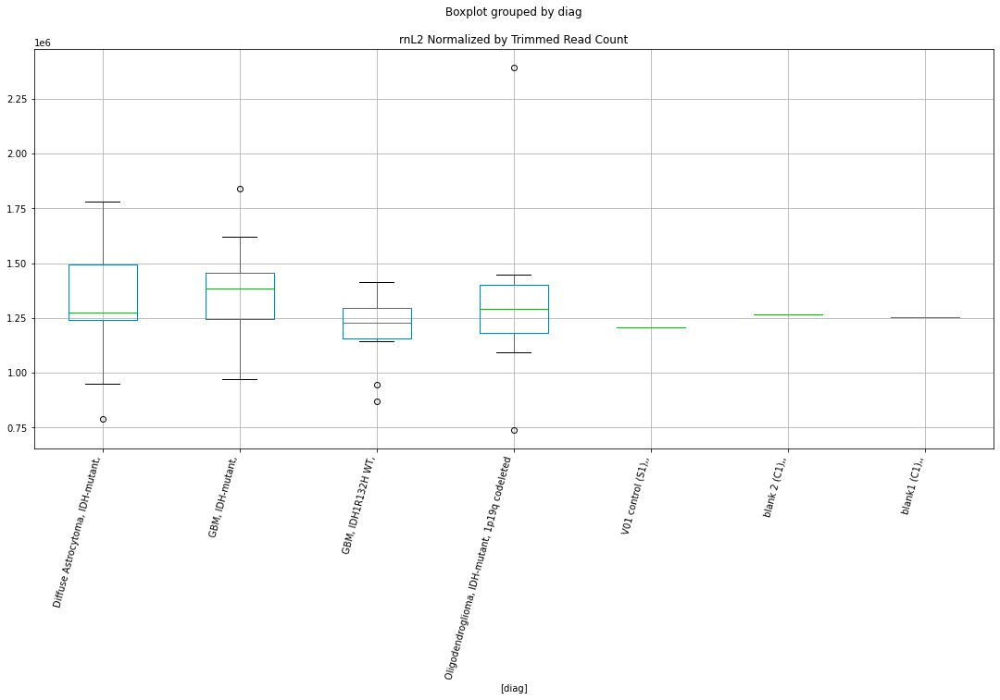

rnL2 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7559036004065522
	p = 0.09610632265684074
rnL2 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7559036004065522
	p = 0.09610632265684074


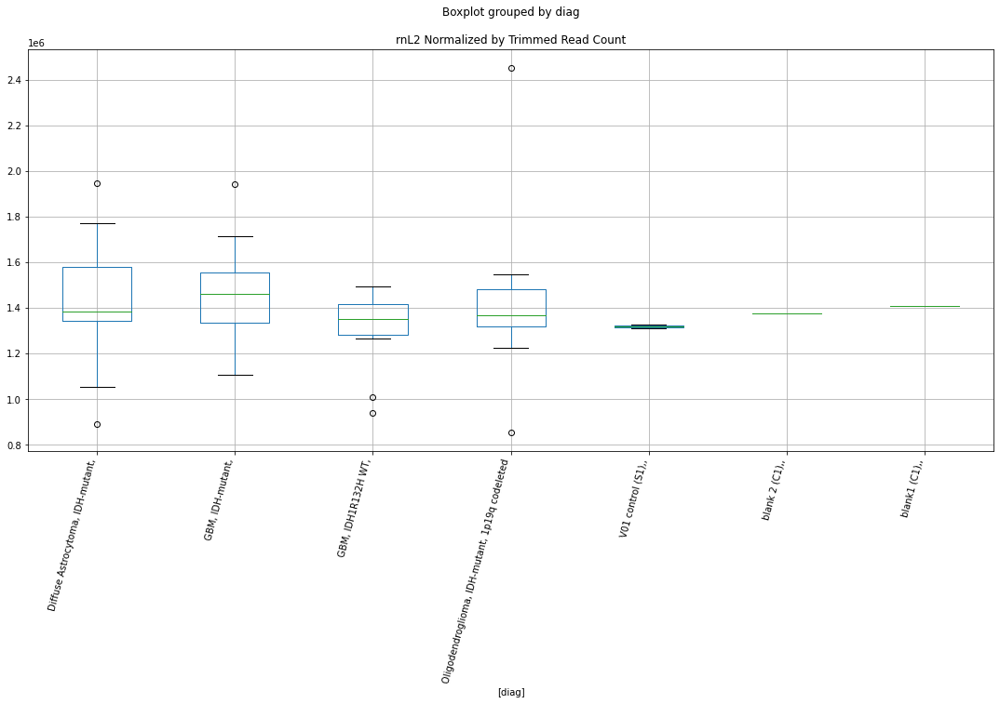

rnAluSg7 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7991556774616593
	p = 0.08878231329185461
rnAluSg7 D-plex bbduk2 : GBM, IDH1R132H WT, - Diffuse Astrocytoma, IDH-mutant,
	t = -1.7991556774616593
	p = 0.08878231329185461


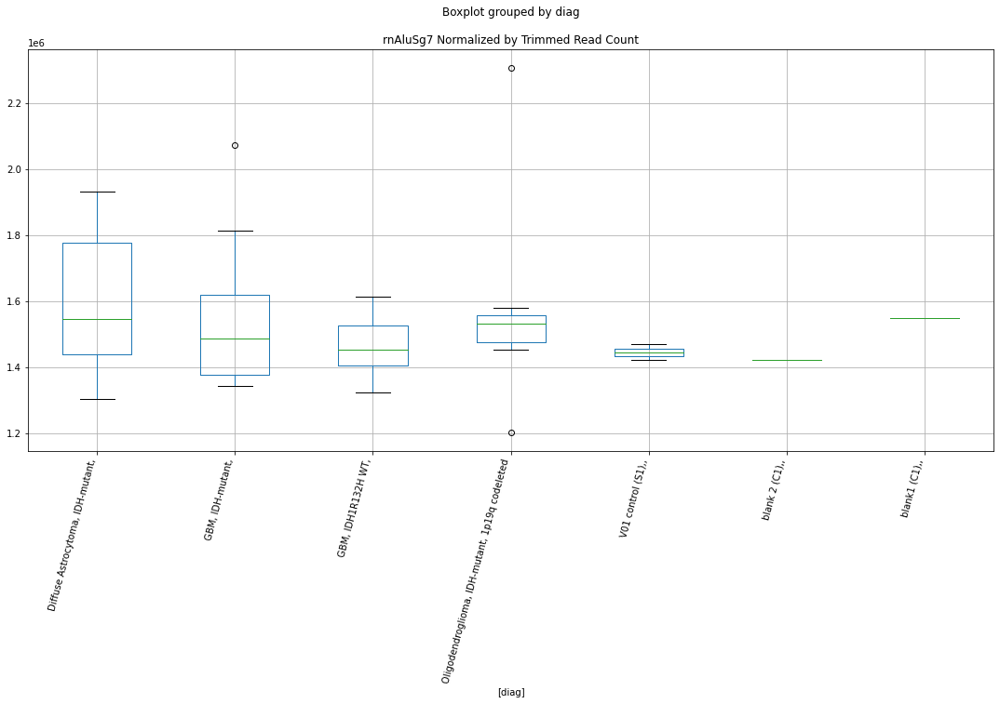

rnL1M1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.320533304380822
	p = 0.032257275965467215
rnL1M1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.320533304380822
	p = 0.032257275965467215


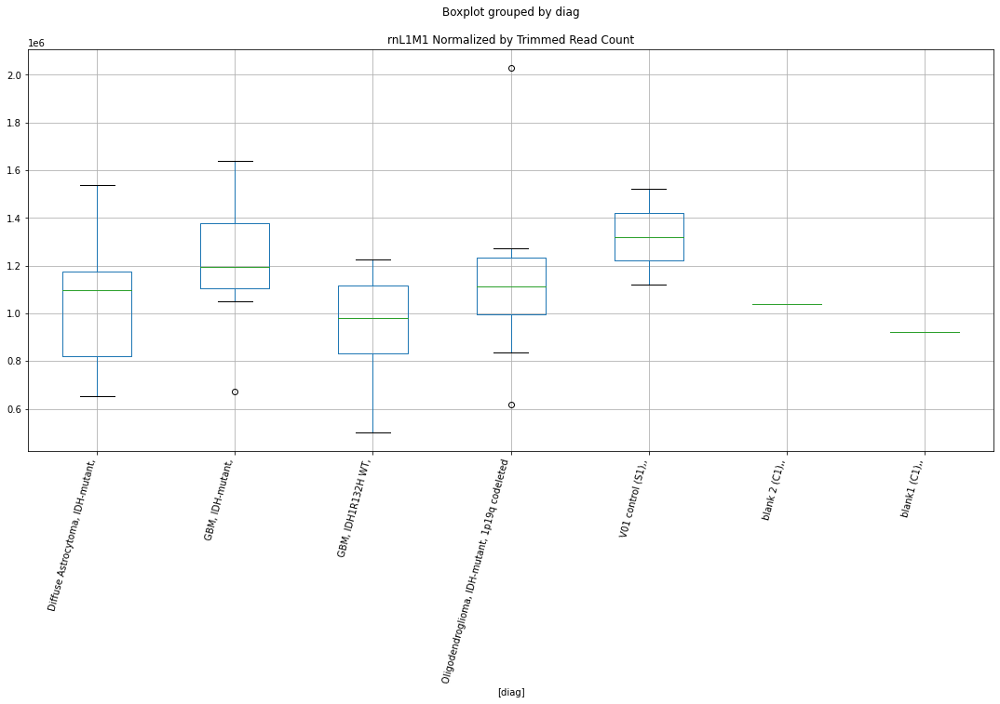

rnL1M1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.282176080951349
	p = 0.0348617195455264
rnL1M1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.282176080951349
	p = 0.0348617195455264


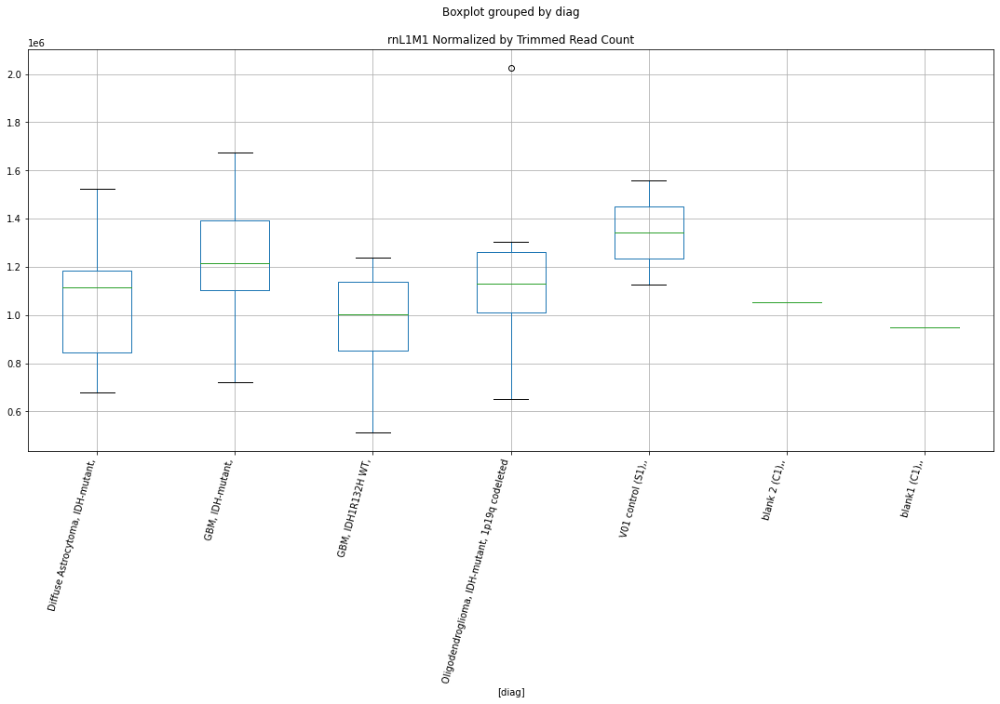

rnAluSq D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.2388810245270414
	p = 0.0380345174383784
rnAluSq D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.2388810245270414
	p = 0.0380345174383784


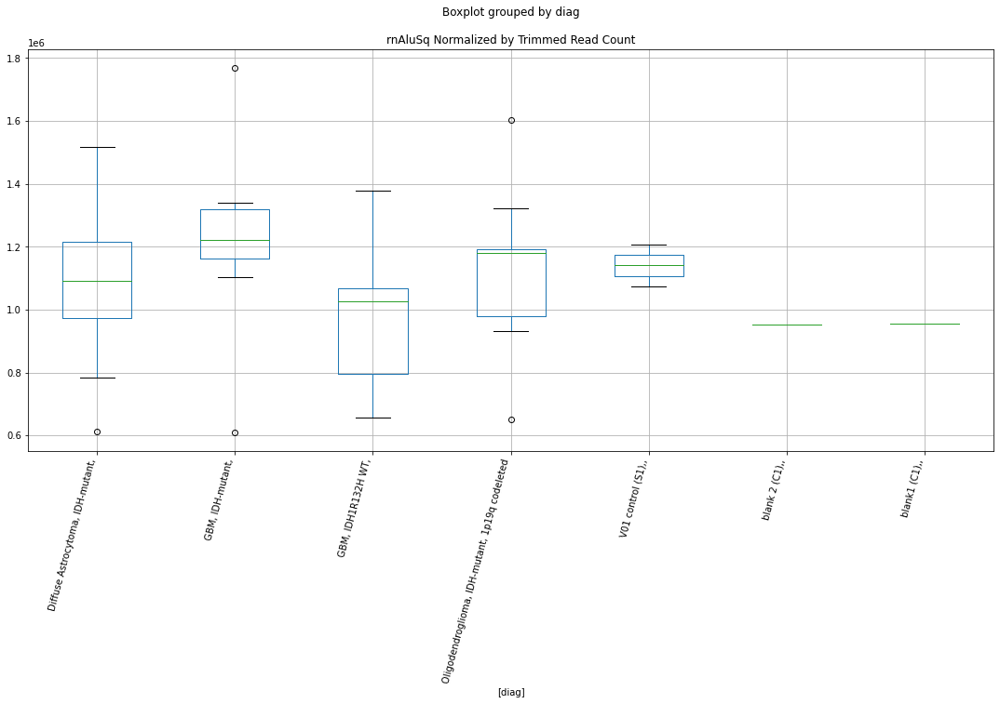

rnAluSq D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.2289219243972096
	p = 0.03880108168679981
rnAluSq D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.2289219243972096
	p = 0.03880108168679981


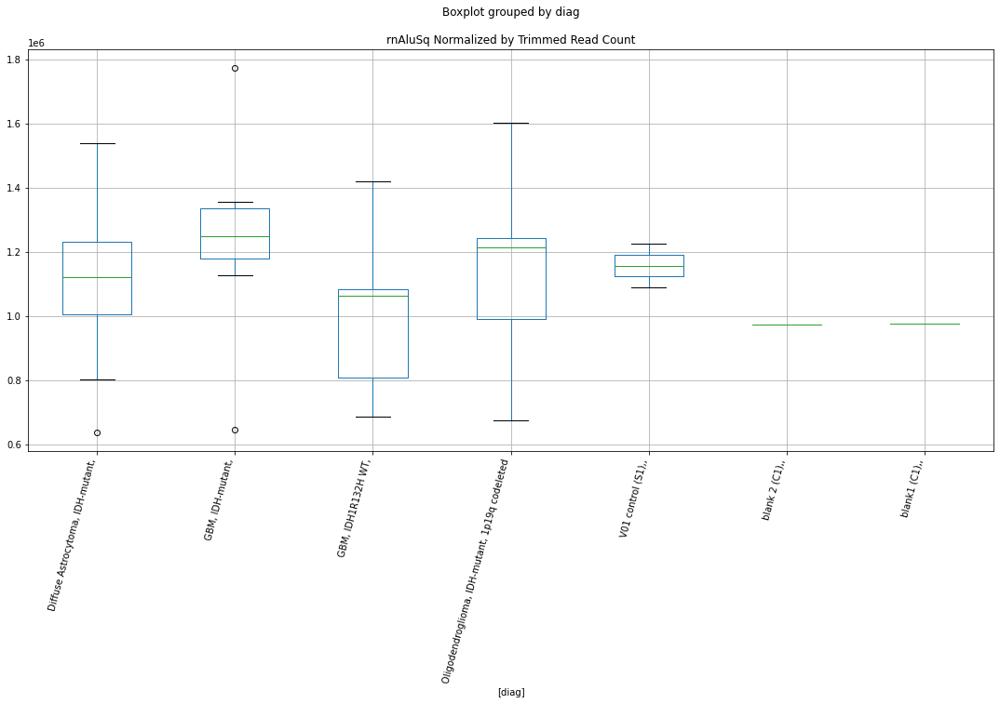

rnL1MA7 D-plex bbduk2 : GBM, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.290985820261614
	p = 0.034246861593425576
rnL1MA7 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH-mutant,
	t = 2.290985820261614
	p = 0.034246861593425576
rnL1MA7 D-plex bbduk2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - GBM, IDH1R132H WT,
	t = 2.2250289163512305
	p = 0.03910458092282478
rnL1MA7 D-plex bbduk2 : GBM, IDH1R132H WT, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -2.2250289163512305
	p = 0.03910458092282478


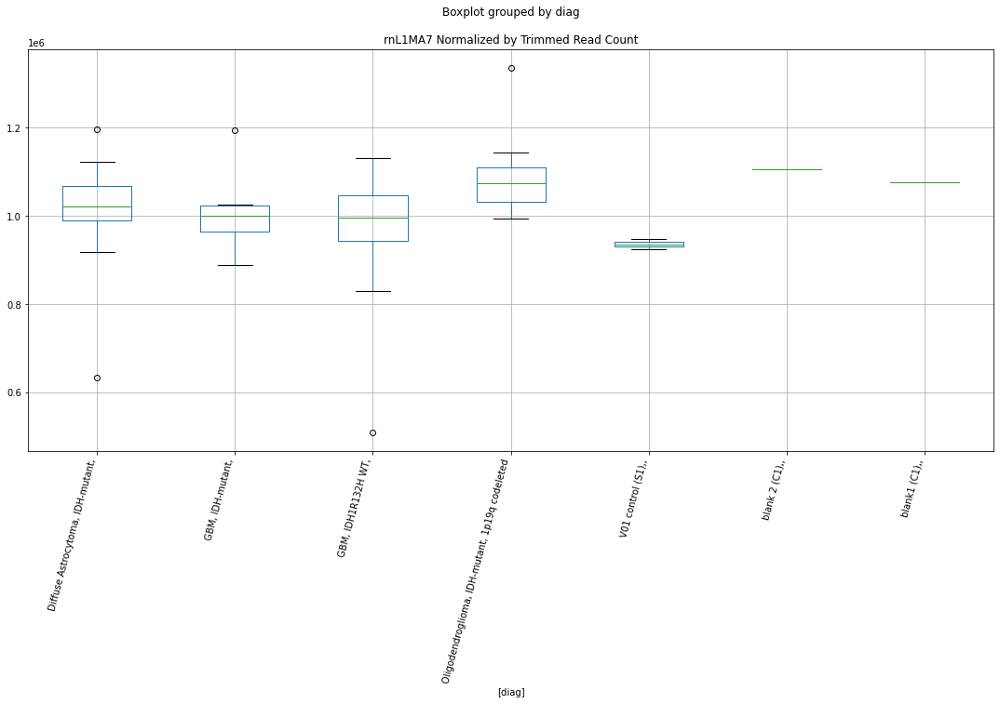

rnHAL1 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.4241703217289374
	p = 0.026097361913952673
rnHAL1 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.4241703217289374
	p = 0.026097361913952673


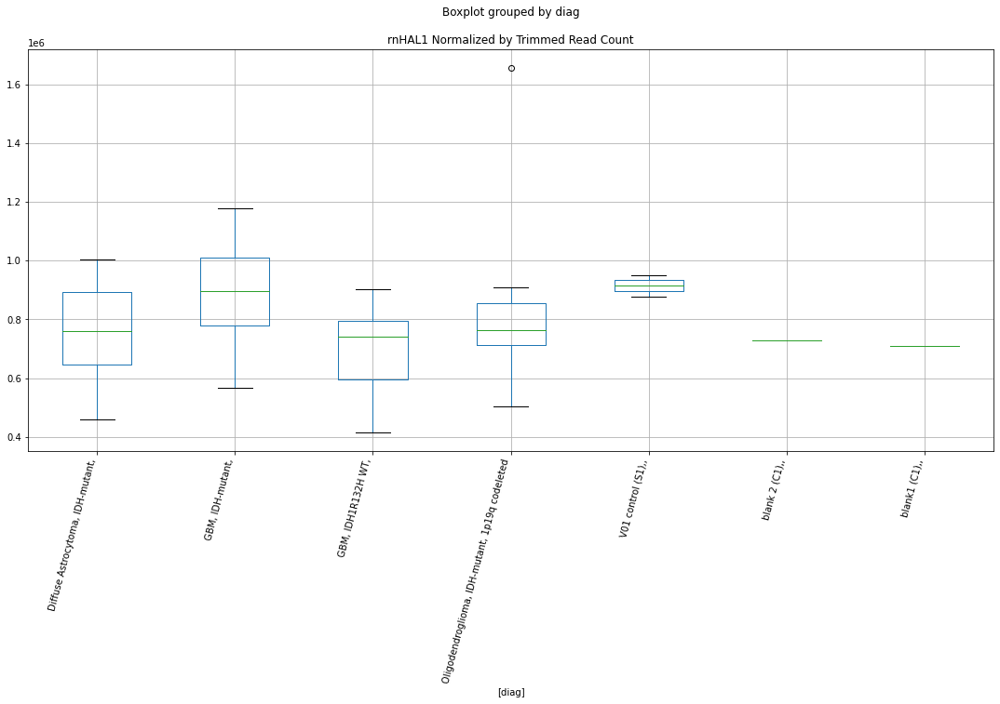

rnHAL1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.3464976612679176
	p = 0.0305981211751072
rnHAL1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.3464976612679176
	p = 0.0305981211751072


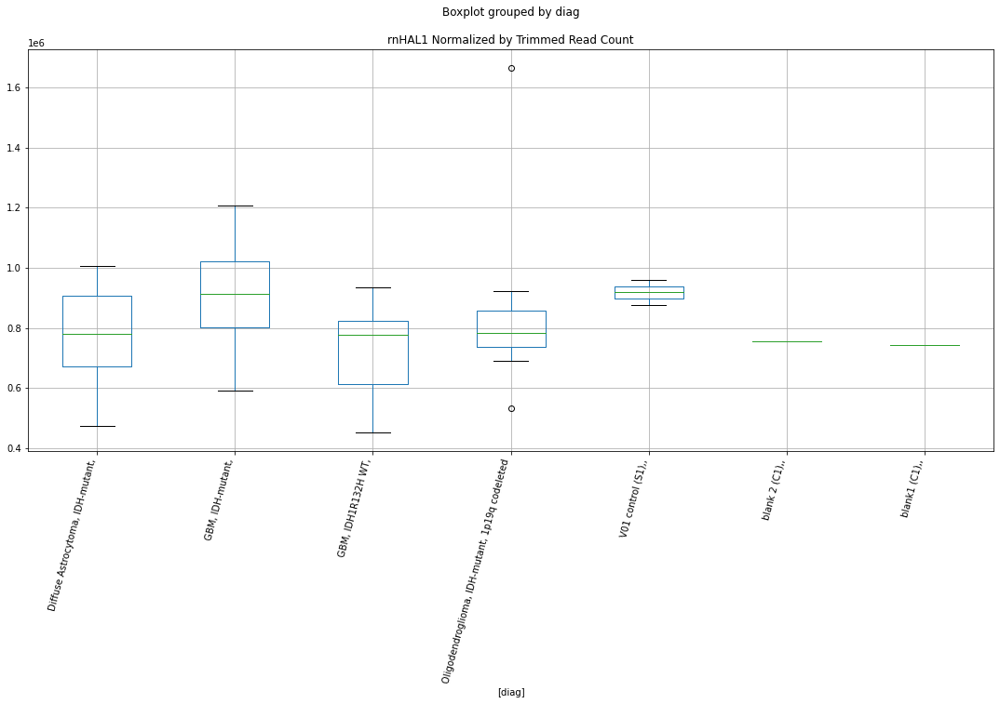

rnL1MC1 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 1.7634917878669776
	p = 0.0947846187951495
rnL1MC1 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -1.7634917878669776
	p = 0.0947846187951495


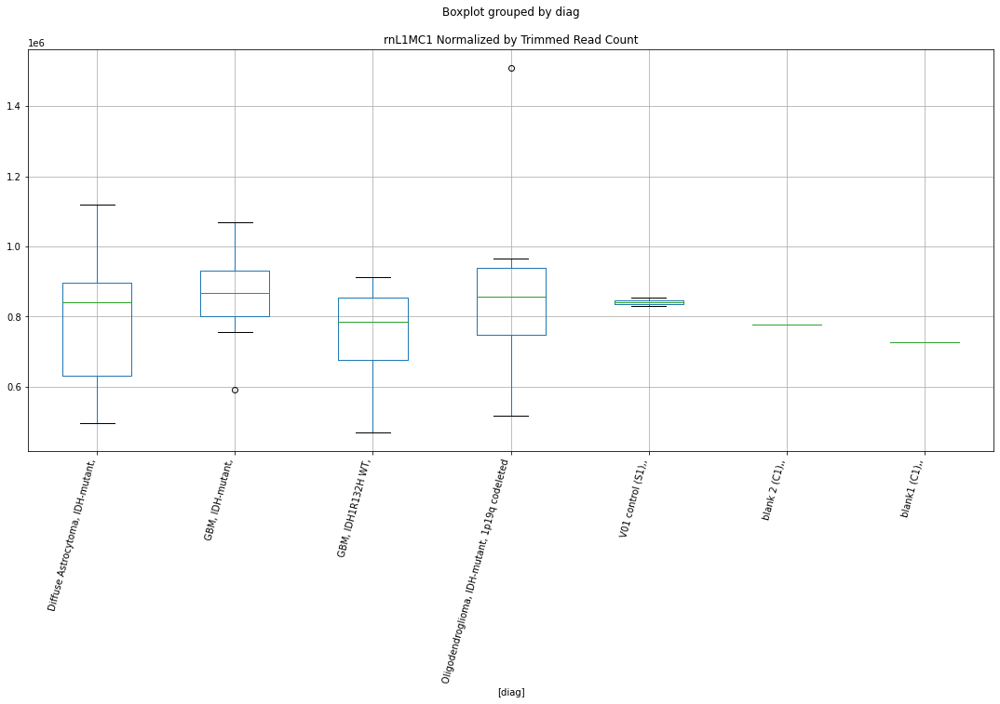

rnL1MA9 D-plex bbduk2 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9161627928169058
	p = 0.0713641734761635
rnL1MA9 D-plex bbduk2 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.2529584459585825
	p = 0.036974760509130525
rnL1MA9 D-plex bbduk2 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.9161627928169058
	p = 0.0713641734761635
rnL1MA9 D-plex bbduk2 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.2529584459585825
	p = 0.036974760509130525


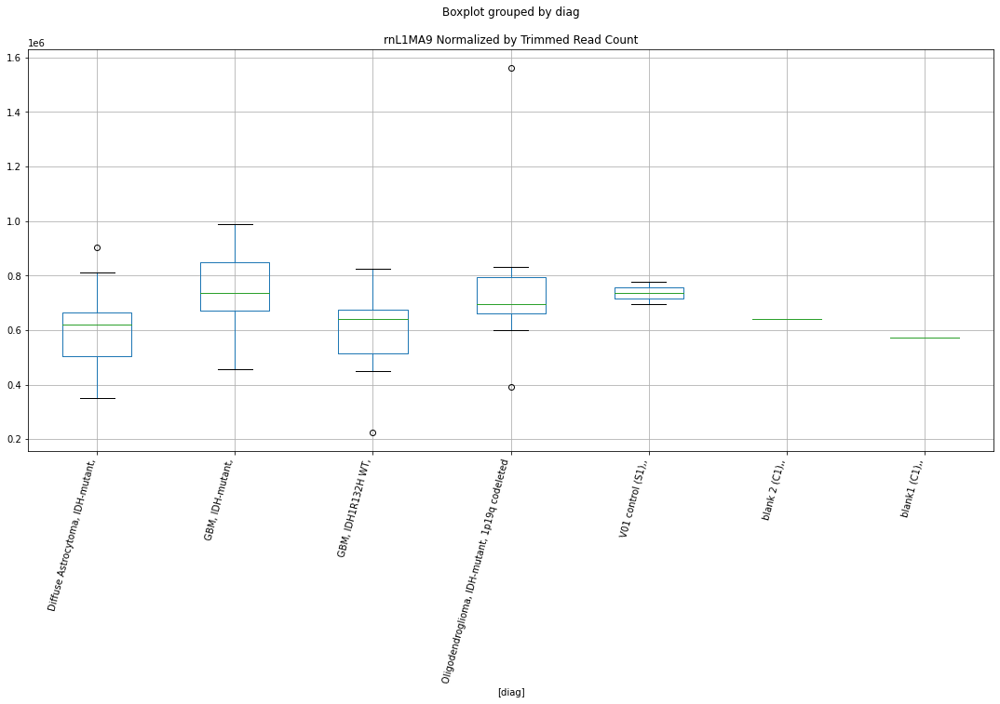

rnL1MA9 D-plex bbduk3 : GBM, IDH-mutant, - Diffuse Astrocytoma, IDH-mutant,
	t = 1.9104937443953147
	p = 0.07213259425231436
rnL1MA9 D-plex bbduk3 : GBM, IDH-mutant, - GBM, IDH1R132H WT,
	t = 2.258133643818196
	p = 0.03659206795704586
rnL1MA9 D-plex bbduk3 : Diffuse Astrocytoma, IDH-mutant, - GBM, IDH-mutant,
	t = -1.9104937443953147
	p = 0.07213259425231436
rnL1MA9 D-plex bbduk3 : GBM, IDH1R132H WT, - GBM, IDH-mutant,
	t = -2.258133643818196
	p = 0.03659206795704586


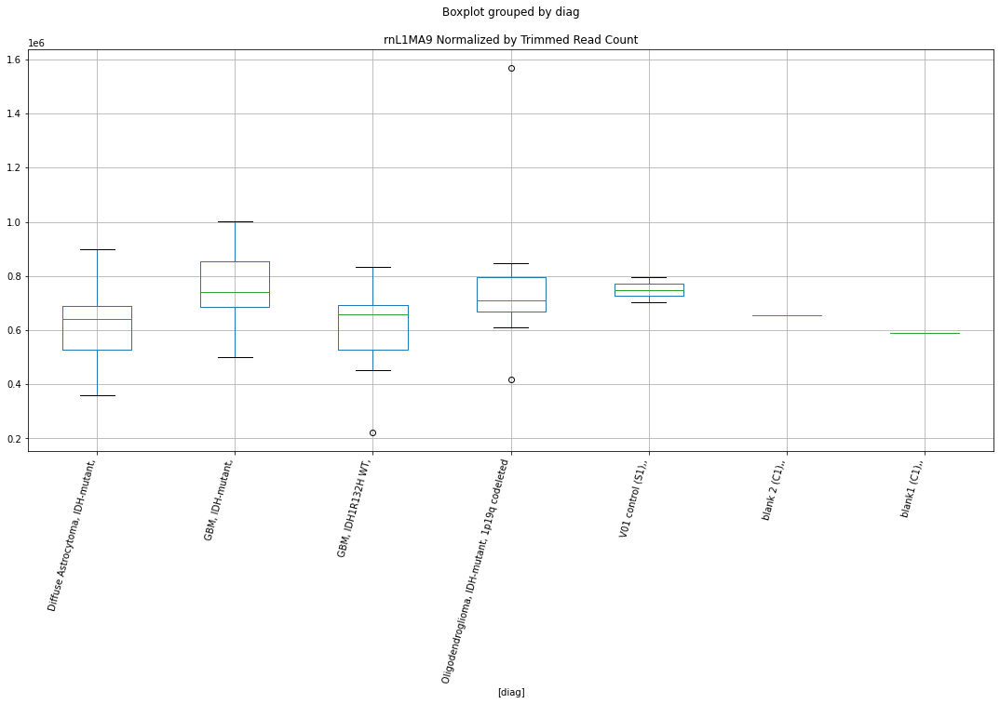

rnL1MA9 D-plex cutadapt1 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.7859465368696634
	p = 0.09096561806645279
rnL1MA9 D-plex cutadapt1 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.7859465368696634
	p = 0.09096561806645279


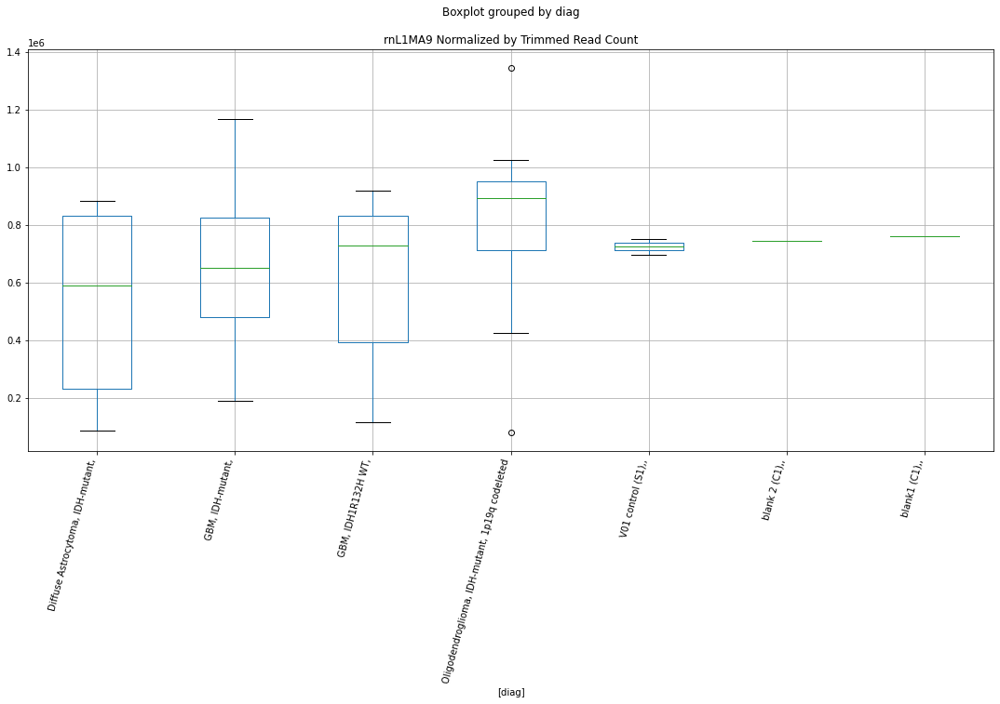

rnL1MA9 D-plex cutadapt2 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.8399762072457941
	p = 0.08232223222985684
rnL1MA9 D-plex cutadapt2 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.8399762072457941
	p = 0.08232223222985684


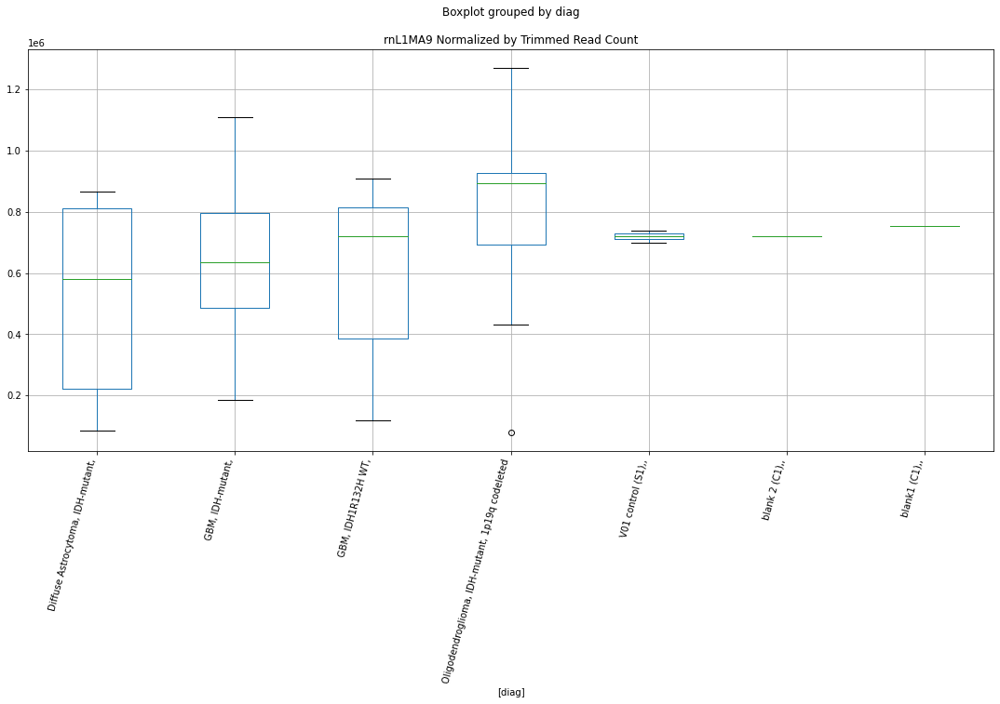

rnL1MA9 D-plex cutadapt3 : Diffuse Astrocytoma, IDH-mutant, - Oligodendroglioma, IDH-mutant, 1p19q codeleted
	t = -1.82941131828045
	p = 0.0839533262512521
rnL1MA9 D-plex cutadapt3 : Oligodendroglioma, IDH-mutant, 1p19q codeleted - Diffuse Astrocytoma, IDH-mutant,
	t = 1.82941131828045
	p = 0.0839533262512521


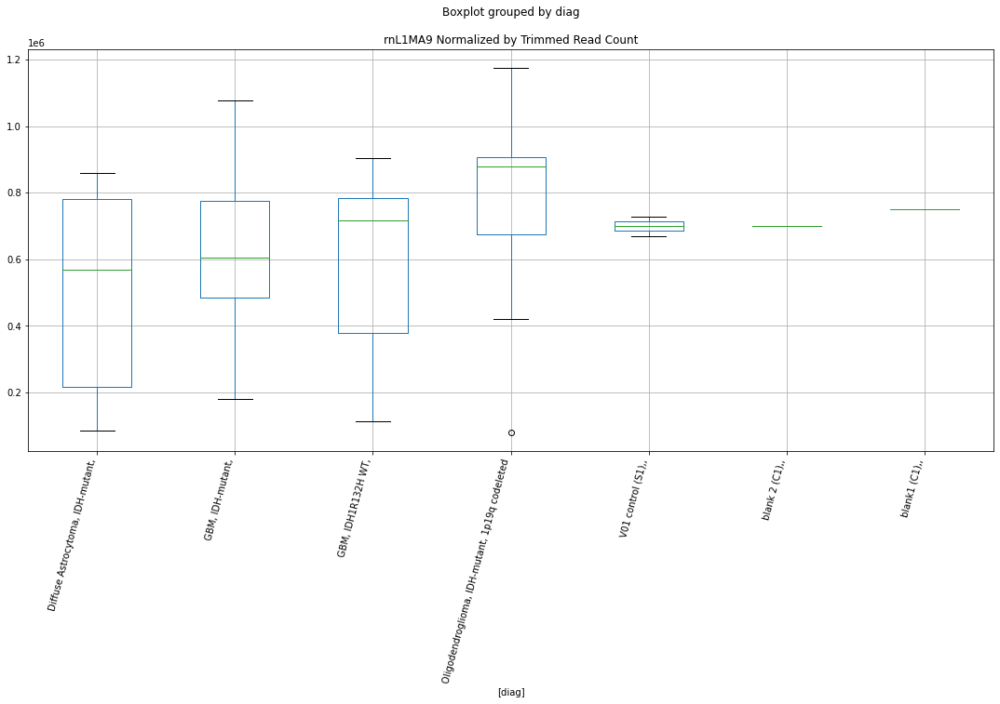

In [89]:
selected=['subject','sample','Lab kit','Trimmer','diag']
for col in rmsk_names:
    for labkit in "D-plex","Lexogen":
        for trimmer in "bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
            ps=[]
            for diag in diags:
                others=diags.copy()
                others.remove(diag)
                for other in others:
                    t, p = stats.ttest_ind(
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==diag))][col],
                        dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer) & 
                            (dfn["diag"]==other))][col])
                    if p < 0.10:
                        print(col+" "+labkit+" "+trimmer+" : "+diag+" - "+other)
                        print("\tt = " + str(t))
                        print("\tp = " + str(p))
                    ps=np.append(ps,p)
            if(any(p < 0.10 for p in ps)):
                selected=np.append(selected,col)
                dfn[((dfn["Lab kit"]==labkit) & (dfn["Trimmer"]==trimmer))].boxplot(column=col,by=['diag'])
                plt.title(col + " Normalized by Trimmed Read Count")
                plt.xticks(rotation=75,ha='right')
                plt.show()
selected=np.unique(selected)


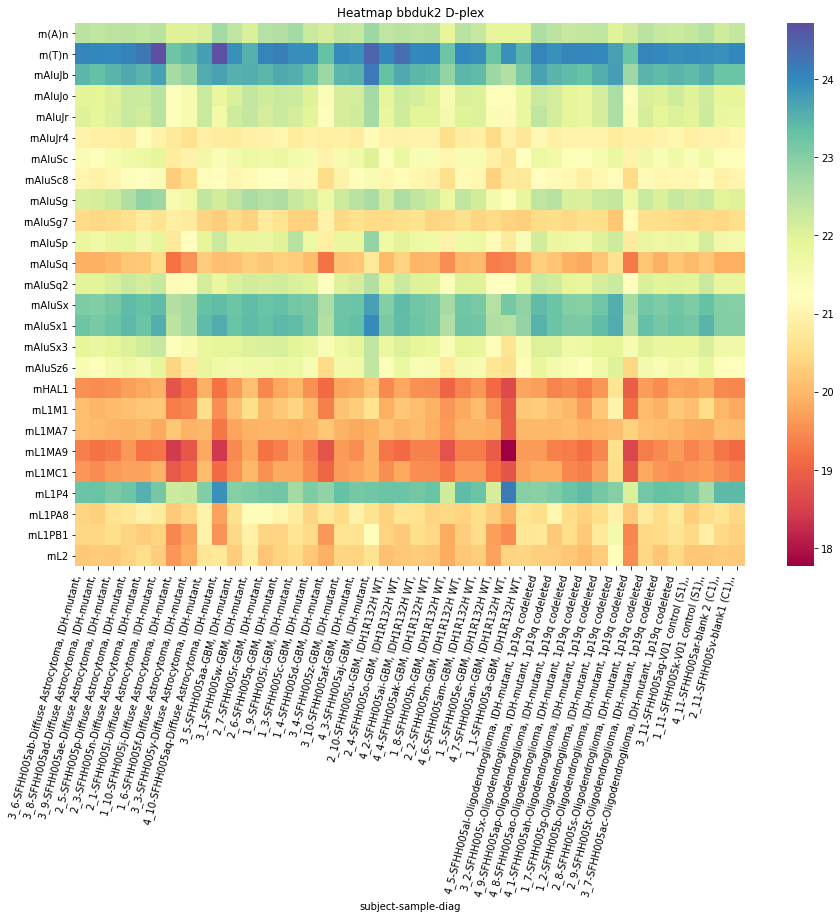

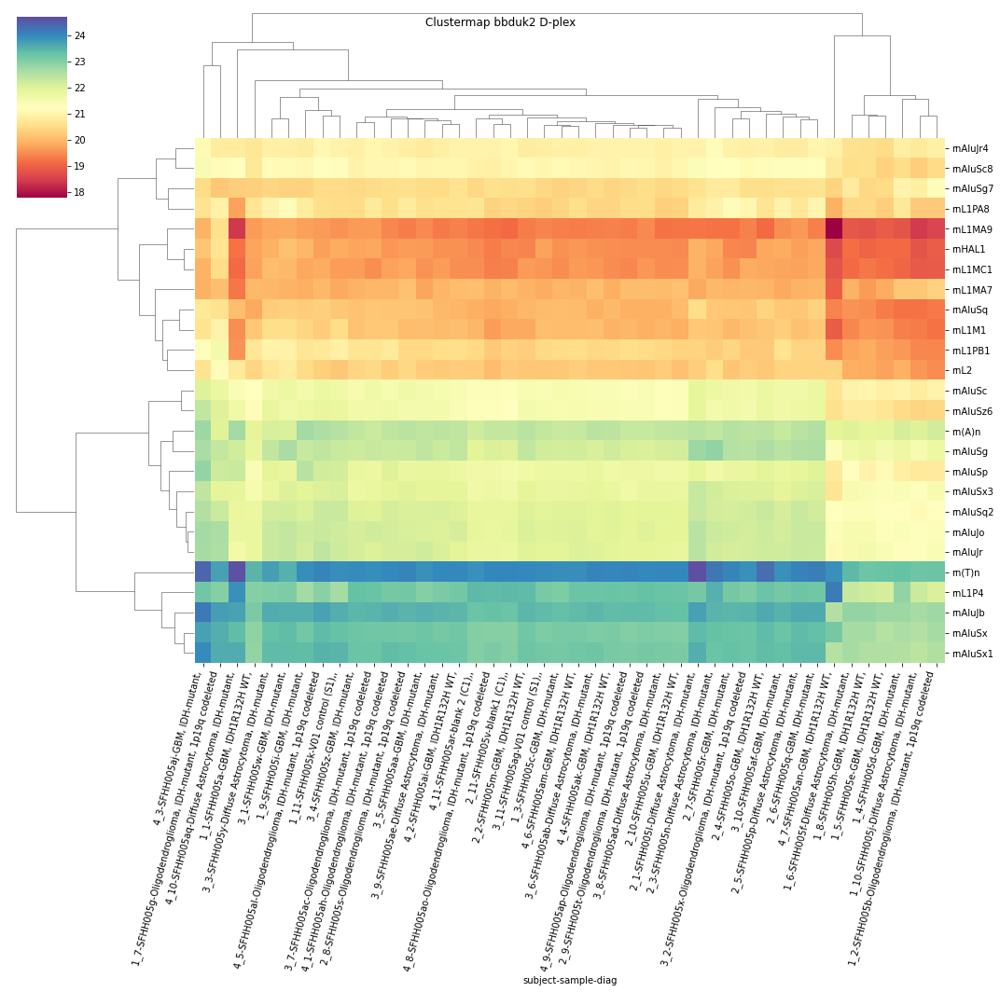

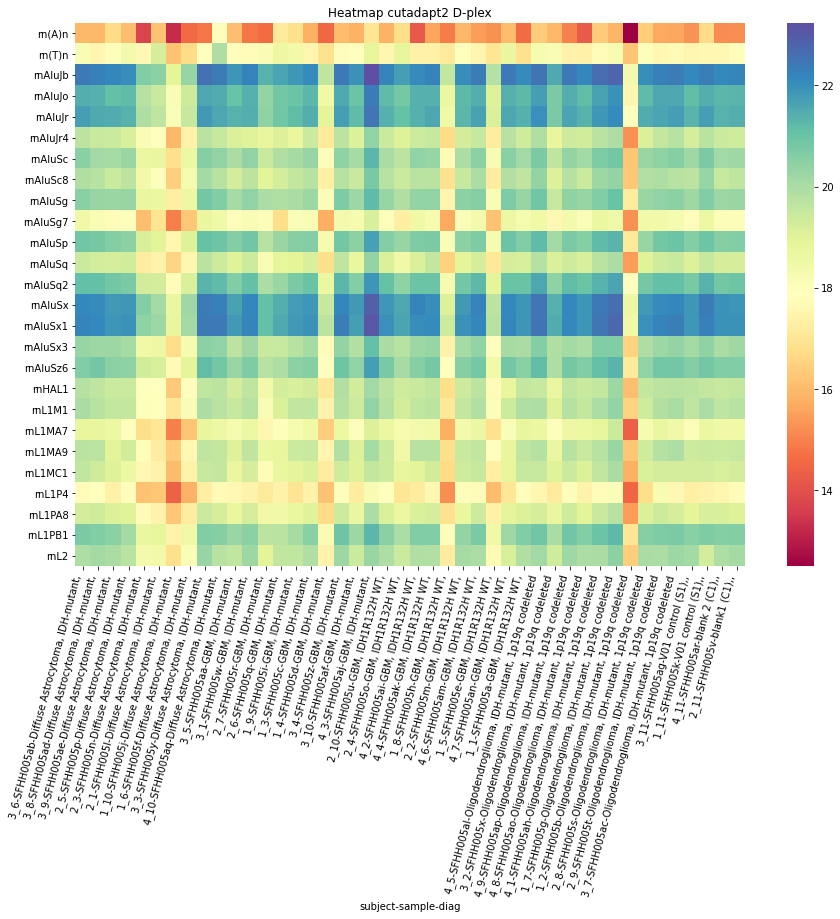

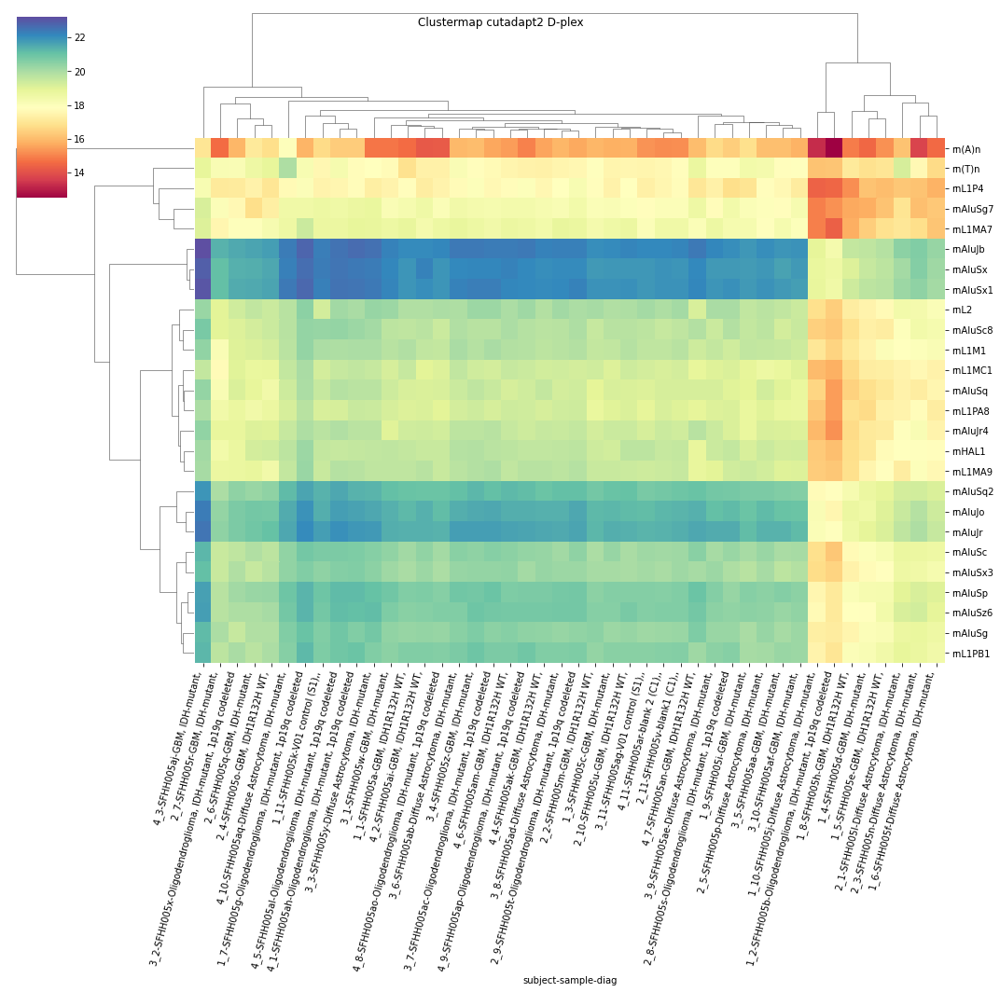

In [90]:
#for trimmer in dfn['Trimmer'].unique():
for trimmer in 'bbduk2','cutadapt2':
    for labkit in dfn['Lab kit'].unique():
        tmp=dfn[selected]
        tmp=tmp[(tmp['Trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
        tmp=tmp.drop('Trimmer',axis='columns')
        tmp=tmp.drop('Lab kit',axis='columns')
        tmp.set_index(['subject','sample','diag'],inplace=True)
        tmp=tmp.transform(lambda x: np.log2(x))
        tmp=tmp.fillna(0).sort_values(['diag']).T
        plt.subplots(figsize=(15,10))
        sns.heatmap(tmp,cmap="Spectral")
        plt.xticks(rotation=75,ha='right')
        plt.title("Heatmap "+trimmer+" "+labkit)
        plt.show()
        g=sns.clustermap(tmp,mask=False,figsize=(15,15),cmap="Spectral")
        g.fig.suptitle("Clustermap "+trimmer+" "+labkit)
        plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')
        plt.show()

In [91]:
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [92]:
pd.set_option('display.max_columns', default_max_columns)

In [93]:
pd.set_option('display.max_rows',default_max_rows)

In [94]:
pd.set_option('display.precision', default_precision)